# Install

In [ ]:
!pip install git+https://github.com/neelnanda-io/TransformerLens.git@d9802474cddd24d02c9e43c8a5f8ecbc4eb004cf --quiet

  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done


In [ ]:
pip install concept-erasure

In [ ]:
pip install tuned-lens

In [ ]:
#!git clone https://github.com/kmrasmussen/pythia_tools.git pythia_tools
#!pip install -e pythia_tools

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# Import

In [ ]:
#
#from sklearn.pipeline import make_pipeline
#from sklearn.preprocessing import StandardScaler
#import itertools
#import torch.optim as optim
#import random

In [ ]:
import pickle
import torch
from tqdm import tqdm
import torch.nn.functional as F
import matplotlib.pyplot as plt
device = 'cuda' if torch.cuda.is_available() else 'cpu'
import pandas as pd
from torch.utils.data import Dataset, DataLoader, TensorDataset
import numpy as np
import torch.nn as nn
from sklearn.linear_model import LogisticRegression
from os.path import join, exists
import pandas as pd
from scipy.stats import ttest_rel
from sklearn.decomposition import PCA
from concept_erasure import LeaceEraser
from transformers import GPTNeoXForCausalLM, AutoTokenizer
from transformer_lens import HookedTransformer
from sklearn.metrics import log_loss as sklearn_log_loss
import gc
from dataclasses import dataclass
from typing import Union
from torch import Tensor
from sklearn.metrics import f1_score, accuracy_score
import os
from os.path import join, exists

In [ ]:
#from transformers import GPTNeoXForCausalLM
#from pythia_tools.models import get_model, yield_models, get_n_layers, get_tokenizer
#from pythia_tools.utils import mem_size, get_similarity_cross
#from pythia_tools.visualization import hist_and_box
#from transformer_lens import HookedTransformer
#from pythia_tools.data import get_token_mat
#from pythia_tools.nonstatic import get_many_hooks_all_layers
#from pythia_tools.qh import get_similarity_matrix
#from pythia_tools.deembedding import decode_vocab_pmf
#from tuned_lens import TunedLens

# Helper functions

In [ ]:
def cossim(vec1, vec2):
  return F.cosine_similarity(vec1.unsqueeze(0),vec2.unsqueeze(0))

def delete_dict(d):
    for key in list(d.keys()):
        if isinstance(d[key], dict):
            delete_dict(d[key])
        del d[key]
    gc.collect()

def mem_size(tensor):
  element_size = tensor.element_size() # size of one element in bytes
  num_elements = tensor.numel() # total number of elements in the tensor
  total_size = element_size * num_elements # total size of the tensor in bytes
  return total_size / (1024 ** 2)

def get_similarity_cross(A1, A2):
    norms_A1 = torch.norm(A1, dim=1)
    norms_A2 = torch.norm(A2, dim=1)
    dot_products = A1 @ A2.t()
    B = dot_products / torch.ger(norms_A1, norms_A2)
    return B

def get_model(size, rev, lens=False):
    if lens:
        print('Not using rev for transformerlens, something weird with rev please fix')
        model = HookedTransformer.from_pretrained(f"pythia-{size}-deduped-v0",
                                                  center_writing_weights=False,
                                                  center_unembed=False, fold_ln=False)
    else:
        model = GPTNeoXForCausalLM.from_pretrained(f"EleutherAI/pythia-{size}-deduped-v0", revision=f"step{rev}000", cache_dir=f"./pythia-{size}-deduped/step{rev}000").to(device)
    return model
def get_tokenizer():
    tokenizer = AutoTokenizer.from_pretrained("EleutherAI/pythia-70m-deduped")
    return tokenizer

def rank_in(L, index):
    if len(L.shape) != 1:
        return "Input tensor must be 1D"
    if index >= len(L) or index < 0:
        return "Invalid index"
    # Sort the tensor in descending order and get the indices
    sorted_indices = torch.argsort(L, descending=True)
    # Find the rank of the element at the given index
    rank = (sorted_indices == index).nonzero().item()
    return rank

def load_pkl(path):
  with open(path, 'rb') as file:
    # Load data from the file
    loaded_data = pickle.load(file)
  return loaded_data

def generate_tensor(n, A, B, C, D):
    np.random.seed(42)
    # Generate n random integers between A and B for the first column
    col1 = np.random.randint(A, B, n)
    # Generate n random integers between C and D for the second column
    col2 = np.random.randint(C, D, n)
    # Combine the two columns to form a n x 2 matrix
    tensor = np.column_stack((col1, col2))
    return torch.from_numpy(tensor)

def compute_nll(y_true, y_pred_proba):
    return sklearn_log_loss(y_true, y_pred_proba)

def plot_confusion_matrix(TN, FP, FN, TP):
    # Create a 2x2 confusion matrix
    cm = np.array([[TN, FP],
                   [FN, TP]])

    fig, ax = plt.subplots()
    im = ax.imshow(cm, interpolation='nearest', cmap=plt.cm.Blues)
    ax.figure.colorbar(im, ax=ax)

    # Show all ticks and label them with the respective list entries
    classes = ["Negative", "Positive"]
    ax.set(xticks=np.arange(cm.shape[1]),
           yticks=np.arange(cm.shape[0]),
           xticklabels=classes, yticklabels=classes,
           title="Confusion Matrix",
           ylabel='True label',
           xlabel='Predicted label')

    # Loop over data dimensions and create text annotations
    for i in range(cm.shape[0]):
        for j in range(cm.shape[1]):
            ax.text(j, i, format(cm[i, j]),
                    ha="center", va="center",
                    color="white" if cm[i, j] > cm.max() / 2. else "black")

    plt.show()

def get_metrics(y_data, y_pred, print_stuff=True):
  y_pred_binary = (y_pred > 0).float()

  # Flatten tensors to 1D
  y_pred_binary = y_pred_binary.view(-1)
  y_data = y_data.view(-1)

  # Convert to numpy arrays for scikit-learn
  y_pred_np = y_pred_binary.numpy()
  y_data_np = y_data.numpy()

  # Calculate metrics
  f1 = f1_score(y_data_np, y_pred_np)
  accuracy = accuracy_score(y_data_np, y_pred_np)

  # Count True Negatives, False Positives, True Positives, False Negatives
  TN = ((y_pred_binary == 0) & (y_data == 0)).sum().float()
  FP = ((y_pred_binary == 1) & (y_data == 0)).sum().float()
  TP = ((y_pred_binary == 1) & (y_data == 1)).sum().float()
  FN = ((y_pred_binary == 0) & (y_data == 1)).sum().float()
  if print_stuff: plot_confusion_matrix(TN, FP, FN, TP)

  sensitivity = TP / (TP + FN)
  specificity = TN / (TN + FP)
  metrics_dict = {
      'f1': f1,
      'accuracy': accuracy,
      'sensitivity': sensitivity,
      'specificity': specificity
  }
  if print_stuff:
    print(f"F1 Score: {f1}")
    print(f"Accuracy: {accuracy}")
    print(f"Sensitivity: {sensitivity}")
    print(f"Specificity: {specificity}")

  return metrics_dict

In [ ]:

class UnfrozenLeaceEraser():
    """LEACE eraser that surgically erases a concept from a representation.

    Since the LEACE projection matrix is guaranteed to be a rank k - 1 perturbation of
    the identity, we store it implicitly in the d x k matrices `proj_left` and
    `proj_right`. The full matrix is given by `torch.eye(d) - proj_left @ proj_right`.
    """

    proj_left: Tensor
    proj_right: Tensor
    bias: Tensor | None

    def __init__(self, proj_left, proj_right, bias):
      self.proj_left = proj_left.to(device)
      self.proj_right = proj_right.to(device)
      self.bias = bias.to(device)

    @classmethod
    def fit(cls, x: Tensor, z: Tensor, **kwargs) -> "LeaceEraser":
        """Convenience method to fit a LeaceEraser on data and return it."""
        return LeaceFitter.fit(x, z, **kwargs).eraser

    @property
    def P(self) -> Tensor:
        """The projection matrix."""
        eye = torch.eye(
            self.proj_left.shape[0],
            device=self.proj_left.device,
            dtype=self.proj_left.dtype,
        )
        return eye - self.proj_left @ self.proj_right

    def __call__(self, x: Tensor) -> Tensor:
        """Apply the projection to the input tensor."""
        delta = x - self.bias if self.bias is not None else x

        # Ensure we do the matmul in the most efficient order.
        x_ = x - (delta @ self.proj_right.mH) @ self.proj_left.mH
        return x_.type_as(x)

def unfreeze_leace_eraser(frozen_instance):
    """Convert a frozen LeaceEraser instance into an unfrozen one."""
    return UnfrozenLeaceEraser(
        proj_left=frozen_instance.proj_left.clone(),
        proj_right=frozen_instance.proj_right.clone(),
        bias=frozen_instance.bias.clone() if frozen_instance.bias is not None else None
    )

In [ ]:
def eval_probe_on_val(probe, X_val, y_val, print_stuff=False):
  y_pred_proba = probe.predict_proba(X_val)[:,1]
  y_pred = torch.from_numpy(probe.predict(X_val))
  eval_dict = get_metrics(y_val, y_pred, print_stuff=print_stuff)
  eval_dict['nll'] = sklearn_log_loss(y_val, y_pred_proba)
  return eval_dict

# Load stuff

In [ ]:
TL = torch.load('/content/drive/MyDrive/thesis/data/token_mats/train_322k_600.pt')

In [ ]:
tokenizer = get_tokenizer()

In [ ]:
model_size = '410m'

In [ ]:
model = get_model(model_size, 143, True)

Not using rev for transformerlens, something weird with rev please fix
Loaded pretrained model pythia-410m-deduped-v0 into HookedTransformer


In [ ]:
E_in = model.embed.W_E.detach()

In [ ]:
n_layers = model.cfg.n_layers

In [ ]:
ALL_RESID_HOOKS = [f'blocks.{i}.hook_resid_pre' for i in range(n_layers)]
some_resid_hooks = [f'blocks.{i}.hook_resid_pre' for i in [1,2,3,4,5,6,8,11,14]]
some_resid_hooks2 = [f'blocks.{i}.hook_resid_pre' for i in [1,2,3,4]] + ['blocks.1.mlp.hook_post', 'blocks.1.hook_mlp_out']

In [ ]:
some_resid_hooks3 = [f'blocks.{i}.hook_resid_pre' for i in range(n_layers)] + ['blocks.1.mlp.hook_post', 'blocks.2.mlp.hook_post']

In [ ]:
Tv = torch.load('/content/drive/MyDrive/thesis/data/token_mats/val_10k_600.pt')
Tv_dset = TensorDataset(Tv)
Tv_loader = DataLoader(Tv_dset, shuffle=False, batch_size=10)
Tv_loader50 = DataLoader(Tv_dset, shuffle=False, batch_size=50)
Tv.shape

torch.Size([10000, 600])

In [ ]:
def occ_to_seq(T, occ, before=22, after=2, decode=False):
  occ_seq, occ_pos = occ
  seq = T[occ_seq][max(occ_pos-before,0):occ_pos+after]
  #if after == 2:
  #  assert seq[-1] == bigram[1]
  #  assert seq[-2] == bigram[0]
  if decode:
    return tokenizer.decode(seq)
  else: return seq

In [ ]:
bigrams_dict = torch.load('/content/drive/MyDrive/thesis/data/bigrams/bigrams_dict_77k.pt')
bigrams = bigrams_dict['sorted_bigrams']

In [ ]:
def find_matching_row(large_tensor, target_tensor):
    return (large_tensor == target_tensor).all(dim=1).nonzero(as_tuple=True)[0].item() if (large_tensor == target_tensor).any(dim=1).sum() > 0 else -1


In [ ]:
find_matching_row(bigrams_dict['sorted_bigrams'], torch.tensor(tokenizer.encode('\n4')))

680

In [ ]:

import pickle

# Load data from a pickle file
with open('/content/drive/MyDrive/thesis/derived_data/probing/occurence_dicts/bigrams_322k_dope_occ_dicts_14k.pkl', 'rb') as file:
    occ_dicts = pickle.load(file)


In [ ]:
def bigram_id_to_tuple(bigram_id):
  bigram = tuple(bigrams_dict['sorted_bigrams'][bigram_id].tolist())
  return bigram

In [ ]:
def print_bigram_id(bigram_id,extended=False):
  bigram = bigrams_dict['sorted_bigrams'][bigram_id]
  bigram_str = tokenizer.decode(bigram)

  if extended:
    print(bigram, repr(bigram_str), repr(tokenizer.decode(bigram[0])), repr(tokenizer.decode(bigram[1])))
    return f'({tokenizer.decode(bigram[0])},{tokenizer.decode(bigram[1])})'
  else:
    print(bigram, bigram_str)
  return bigram_str

In [ ]:
occ_dicts_dict = {bigram_id : occ_dict for (bigram_id, occ_dict) in occ_dicts}

In [ ]:
dope_bigram_ids = torch.tensor([key for (key, _) in occ_dicts_dict.items()])

In [ ]:
len(dope_bigram_ids)

14557

In [ ]:
#q_dict = torch.load('/content/drive/MyDrive/thesis/data/bigrams/consequent_sets_bigrams_77k_10k.pt')

In [ ]:
#len(q_dict)

In [ ]:
#tokenizer.decode(q_dict[541])

# Load old probes

In [ ]:
len(dope_bigram_ids)

14557

In [ ]:
dope_bigram_ids.max()

tensor(24887)

In [ ]:
exists_bids = []
for bid in dope_bigram_ids:
  path = join('/content/drive/MyDrive/thesis/derived_data/probing/sk_halfadv_probes', f'probes_and_preds_{bid}_mod{model_size}.pkl')
  if exists(path):
    exists_bids.append(bid)
#if exists(path):

#    for hook_name in hook_names:
      #hook_probe = loaded_dict[hook_name]['probes']['halfadv']
#      coef = loaded_dict[hook_name]['weights']['coef'] #torch.tensor(hook_probe.coef_).cpu()
#      bias = loaded_dict[hook_name]['weights']['bias']
#      coeffs[hook_name].append(coef)
#      biases[hook_name].append(bias)

In [ ]:
len(exists_bids)

335

# Getting on-distribution resids

In [ ]:
import os

def create_folders_from_list(folder_names, parent_dir):
    for folder in folder_names:
        path = os.path.join(parent_dir, folder)
        os.makedirs(path, exist_ok=True)

In [ ]:
run = 1
Tv_resids_dir = f'/content/drive/MyDrive/thesis/Tv_resids/70m/run{run}'
os.makedirs(Tv_resids_dir, exist_ok=True)

In [ ]:
create_folders_from_list(some_resid_hooks2, Tv_resids_dir)

In [ ]:
resid_cache_values = { hook_name : [] for hook_name in some_resid_hooks2}
def cache_allpos_hook_fc(value, hook):
  #print('caching', hook.name)
  global current_values_dict
  resid_cache_values[hook.name].append(value)
  #print('cached', hook.name)
  return value

In [ ]:
resid_hook_cache_tuples = [(hook_name, cache_allpos_hook_fc) for hook_name in some_resid_hooks2]

In [ ]:
len(Tv_loader)

1000

In [ ]:
resid_cache_values = { hook_name : [] for hook_name in some_resid_hooks2}
batch_cache = []
batch_ids = []
for od_batch_i, od_batch_list in tqdm(enumerate(Tv_loader)):
  #print('od_batch_i', od_batch_i)
  od_batch = od_batch_list[0]
  batch_cache.append(od_batch)
  batch_ids.append(od_batch_i)
  with torch.no_grad():
    _ = model.run_with_hooks(
        od_batch,
        fwd_hooks = resid_hook_cache_tuples,
        stop_at_layer=15
    )
  if od_batch_i > 1 and od_batch_i % 8 == 1:
    batch_cache_catted = torch.cat(batch_cache,dim=0)
    batch_cache = []
    for hook_name, _ in resid_cache_values.items():
      #print('hookname', hook_name)
      resid_cache_values_catted = torch.cat(resid_cache_values[hook_name],dim=0)
      #del resid_cache_values[hook_name]
      save_filename_batches_hook = f'[{min(batch_ids)},{max(batch_ids)}]_batches_{hook_name}.pt'
      save_path_batches_hook = join(Tv_resids_dir,hook_name,save_filename_batches_hook)
      #assert batch_cache_catted.shape[0] ==
      batches_hook_saved_dict = {
          'values': resid_cache_values_catted,
          'tokens': batch_cache_catted
      }
      torch.save(batches_hook_saved_dict,save_path_batches_hook)
    for hook_names in some_resid_hooks2:
      del resid_cache_values[hook_names]
    for hook_names in some_resid_hooks2:
      resid_cache_values[hook_names] = []
    batch_ids = []
    gc.collect()
    torch.cuda.empty_cache()

454it [04:46,  1.58it/s]


KeyboardInterrupt: ignored

In [ ]:
def get_batches_hook(hookname, start, stop):
  filepath = join(Tv_resids_dir, hookname, f'[{start},{stop}]_batches_{hookname}.pt')
  batches_hook_loaded_dict = torch.load(filepath, map_location='cpu')
  return batches_hook_loaded_dict['tokens'], batches_hook_loaded_dict['values']

In [ ]:
my_hookname = 'blocks.11.hook_resid_pre'
my_start = 0
my_stop = 9

In [ ]:
a,b = get_batches_hook(my_hookname, 0, 9)

In [ ]:
tokens_list = [a]
values_list = [b]

In [ ]:
for my_start in tqdm(range(10,1000,8)):
  print(my_start)
  my_a, my_b = get_batches_hook(my_hookname,my_start,my_start+7)
  tokens_list.append(my_a)
  values_list.append(my_b)

In [ ]:
def inplace_cat_on_disk_3d(tensor_list, filename):
    total_length = sum([t.shape[0] for t in tensor_list])
    shape = (total_length, tensor_list[0].shape[1], tensor_list[0].shape[2])

    # Create an empty tensor backed by a file on disk
    big_tensor = torch.Storage(filename, mode='w+', size=shape[0]*shape[1]*dtype().element_size()).new().resize_(shape)

    current_idx = 0
    for t in tensor_list:
        end_idx = current_idx + t.shape[0]
        big_tensor[current_idx:end_idx] = t.storage()
        current_idx = end_idx
        del t  # Delete the original tensor to free up memory

    return big_tensor.new().set_(big_tensor).resize_(shape)

big_tensor = inplace_cat_on_disk_3d(values_list, "/content/drive/MyDrive/thesis/Tv_resids/run7/blocks.11.hook_resid_pre/cats/cat1.bin")

In [ ]:
my_filepath

In [ ]:
exists(my_filepath)

In [ ]:
/content/drive/MyDrive/thesis/Tv_resids/run7/blocks.11.hook_resid_pre/cats

In [ ]:
.shape

In [ ]:
batches_hook_loaded_dict['values'].shape

In [ ]:

mem_size(current_values_dict[some_resid_hooks[0]]) * len(some_resid_hooks)

# Create train-val-test split

In [ ]:
def generate_permutation(d, n):
    # Create a random generator object with a specific seed
    rng = np.random.default_rng(42 + d)

    # Generate a random permutation using the seeded generator
    perm = rng.permutation(n)

    return perm

def get_splits(bigram_id, occ_dicts_dict, precise_train_n=400, neg_train_n=800):
  bigram = tuple(bigrams_dict['sorted_bigrams'][bigram_id].tolist())
  occ_dict = occ_dicts_dict[bigram_id]

  #precise_train_n = 400 #800
  precise_val_n = 100 #100
  precise_test_n = 100 #100
  #neg_train_n = 800 #1600
  neg_val_n = 200 #50 #200
  neg_test_n = 200 #200

  perm = generate_permutation(bigram_id + 1, 1000)
  precise_array = np.array(occ_dict[bigram])
  precise_train = precise_array[perm[:precise_train_n]]
  precise_val = precise_array[perm[precise_train_n:precise_train_n + precise_val_n]]
  precise_test = precise_array[perm[precise_train_n + precise_val_n:precise_train_n + precise_val_n + precise_test_n]]

  perm = generate_permutation(bigram_id + 2, 2000)
  negative_a_array = np.array(occ_dict[(bigram[0], None)])
  neg_a_train = negative_a_array[perm[:neg_train_n]]
  neg_a_val = negative_a_array[perm[neg_train_n:neg_train_n+neg_val_n]]
  neg_a_test = negative_a_array[perm[neg_train_n+neg_val_n:neg_train_n+neg_val_n+neg_test_n]]

  perm = generate_permutation(bigram_id + 3, 2000)
  negative_b_array = np.array(occ_dict[(None, bigram[1])])
  neg_b_train = negative_b_array[perm[:neg_train_n]]
  neg_b_val = negative_b_array[perm[neg_train_n:neg_train_n+neg_val_n]]
  neg_b_test = negative_b_array[perm[neg_train_n+neg_val_n:neg_train_n+neg_val_n+neg_train_n]]

  train_labels = np.concatenate((np.ones(len(precise_train)), 2 * np.ones(len(neg_a_train)), 3 * np.ones(len(neg_b_train))))
  val_labels = np.concatenate((np.ones(len(precise_val)), 2 * np.ones(len(neg_a_val)), 3 * np.ones(len(neg_b_val))))
  test_labels = np.concatenate((np.ones(len(precise_test)), 2 * np.ones(len(neg_a_test)), 3 * np.ones(len(neg_b_test))))

  train_cat = np.concatenate((precise_train,neg_a_train,neg_b_train))
  val_cat = np.concatenate((precise_val,neg_a_val,neg_b_val))
  test_cat = np.concatenate((precise_test,neg_a_test,neg_b_test))

  return train_cat, train_labels, val_cat, val_labels, test_cat, test_labels #train_dset, val_dset, test_dset

# Probing dataset module and eval

In [ ]:
def get_hidden_states_vector_dset(loader, hook_names, model, max_i = None, stop_at_layer=None, use_tqdm=False):
  hook_vector_dsets = {hook_name: [] for hook_name in hook_names}
  hook_vector_dsets_labels = {hook_name: [] for hook_name in hook_names}
  thing_to_enumerate = enumerate(loader) if use_tqdm == False else tqdm(enumerate(loader))
  for i, (seqs, _, labels) in thing_to_enumerate:  # 1000 samples with 10 features
    with torch.no_grad():
      _, cache = model.run_with_cache(seqs, stop_at_layer=stop_at_layer)

    for hook_name in hook_names:
      acts = cache[hook_name][:,-1,:]
      hook_vector_dsets[hook_name].append(acts)
      hook_vector_dsets_labels[hook_name].append(labels)

    if max_i is not None:
      if i >= max_i: break
    del cache
    torch.cuda.empty_cache()
  for key, item in hook_vector_dsets.items():
    hook_vector_dsets[key] = torch.cat(item,dim=0)
  for key, item in hook_vector_dsets_labels.items():
    hook_vector_dsets_labels[key] = torch.cat(item,dim=0)
  torch.cuda.empty_cache()
  return hook_vector_dsets #, hook_vector_dsets_labels

'''
def evaluate_probe(probe, hook_name, probe_type, val_fixed_hookname, val_fixed_labels_hookname, print_stuff=False, return_labels=False):
  if probe_type == 'sk':
    y_pred = torch.tensor(probe.predict(val_fixed_hookname.cpu()))
  elif probe_type == 'pt':
    y_pred_logits = probe.forward(val_fixed_hookname).reshape(-1)
    y_pred = (y_pred_logits > 0).float().cpu()
  else:
    raise Exception('Unknown probe type')

  f1 = get_metrics(val_fixed_labels_hookname, y_pred, print_stuff=print_stuff)

  if return_labels == False:
    return f1
  else:
    return f1, val_fixed_labels_hookname, y_pred
'''


class HalfAdversarialOccDataset(Dataset):
  def __init__(self, data, labels, bigram_id, E_in, adv_theta, k_similars, use_adv=True):
    self.data = data
    self.a, self.b = bigram_id_to_tuple(bigram_id)
    self.labels = torch.tensor(labels)
    self.binary_labels = (self.labels == 1.).float()
    self.a_sim, self.b_sim = self.get_similars(bigram_id, E_in, k_similars)
    self.adv_theta = adv_theta
    self.k_similars = k_similars
    self.dohalfadv_labels = torch.rand(len(self.binary_labels)) < self.adv_theta
    self.adv_index_useds = torch.randint(0, k_similars, (len(self.binary_labels),))
    self.use_adv = use_adv

  def get_similars(self, bigram_id, E_in, k_similars):
    (a,b) = bigram_id_to_tuple(bigram_id)
    a_vec = E_in[a]
    b_vec = E_in[b]
    a_sims = get_similarity_cross(E_in,a_vec.reshape(1,-1)).reshape(-1)
    b_sims = get_similarity_cross(E_in,b_vec.reshape(1,-1)).reshape(-1)
    a_sims_sort = torch.sort(a_sims, descending=True)
    b_sims_sort = torch.sort(b_sims, descending=True)
    a_similars = a_sims_sort.indices[1:k_similars+1].to(device)
    b_similars = b_sims_sort.indices[1:k_similars+1].to(device)
    return a_similars, b_similars

  def __len__(self):
    return len(self.data)

  def __getitem__(self, idx):
    sample = self.data[idx]
    label = self.labels[idx]
    do_halfadv = self.dohalfadv_labels[idx]
    #print('dohalfadv', do_halfadv)
    adv_index_used = self.adv_index_useds[idx]
    #print('adv_index_used', adv_index_used)
    binary_label = (label == 1.).float()

    # Convert numpy array to PyTorch tensor
    (occ_seq, occ_pos) = tuple(sample.tolist())

    if label.item() == 2.:
      seq = occ_to_seq(TL, (occ_seq, occ_pos + 1))
    else:
      seq = occ_to_seq(TL, (occ_seq, occ_pos))

    if len(seq) >= 22:
      seq = seq[-22:]
    elif len(seq) < 22:
      raise Exception('seq shorter than 22')

    if self.use_adv and binary_label == 0:
      #print('its a negative')
      if do_halfadv:
        #print('doing adv')
        if label == 2:
          #print('doing adv on (a,None)')
          substitute = self.b_sim[adv_index_used]
          #print('replacing', self.b, 'with', substitute)
          #print('before', seq)
          seq[-1] = substitute
          #print('now', seq)
        if label == 3:
          #print('doing adv on (None,b)')
          substitute = self.a_sim[adv_index_used]
          #print('replacing', self.a, 'with', substitute)
          #print('before', seq)
          seq[-2] = substitute
          #print('now', seq)

    return seq, label, binary_label #idx, sample, seq, binary_label, label #sample, seq, label, binary_label

  def print_dset(self):
    for i, (idx, sample, seq, binary_label, label) in enumerate(self):
      print(idx, label.item(), binary_label.item(), repr(tokenizer.decode(seq.reshape(-1))))

# Get probing data set for a bigram

In [ ]:
bigram_probing_datasets_dir70m = '/content/drive/MyDrive/thesis/zoomin/bigram_probing_datasets/70m/run1'

In [ ]:
#for did, bid in enumerate(dope_bigram_ids[:1000]):
#  print('did', did)
#  print_bigram_id(bid)

In [ ]:
def get_dset_dict_from_bigram_id(bigram_id, hook_names, get_hidden_states = True, batch_size = 50, n_pos=800, n_neg=1600, k_similars=20, adv_theta=0.0):
  train_cat, train_labels, val_cat, val_labels, test_cat, test_labels = get_splits(bigram_id, occ_dicts_dict, precise_train_n=n_pos, neg_train_n=n_neg)
  use_adv = (adv_theta != 0.0)
  #print('useadv', use_adv)
  train_dset = HalfAdversarialOccDataset(train_cat, train_labels, bigram_id, E_in, adv_theta=adv_theta, k_similars=k_similars, use_adv=use_adv)
  val_dset = HalfAdversarialOccDataset(val_cat, val_labels, bigram_id, E_in, adv_theta=0.0, k_similars=k_similars, use_adv=False)
  train_loader = DataLoader(train_dset, batch_size=batch_size, shuffle=False)
  val_loader = DataLoader(val_dset, batch_size=batch_size, shuffle=False)
  if get_hidden_states:
    train_hidden_states = get_hidden_states_vector_dset(train_loader, hook_names, model, stop_at_layer=None,use_tqdm=False)
    val_hidden_states = get_hidden_states_vector_dset(val_loader, hook_names, model, stop_at_layer=None,use_tqdm=False)
  else:
    train_hidden_states = None
    val_hidden_states = None

  dset_dict = {}
  dset_dict['train_dset'] = train_dset
  dset_dict['val_dset'] = val_dset
  if get_hidden_states:
    dset_dict['train_hidden_states'] = train_hidden_states
    dset_dict['val_hidden_states'] = val_hidden_states

  dset_dict['bigram_id'] = bigram_id
  dset_dict['bigram'] = bigram_id_to_tuple(bigram_id)
  dset_dict['hook_names'] = hook_names
  dset_dict['n_pos'] = n_pos
  dset_dict['n_neg'] = n_neg
  dset_dict['k_similars'] = k_similars
  dset_dict['adv_theta'] = adv_theta
  dset_dict['get_hidden_states'] = get_hidden_states

  return dset_dict

def load_dset_dict_from_bigram_id(bigram_id, bigram_probing_datasets_dir='/content/drive/MyDrive/thesis/zoomin/bigram_probing_datasets/run1'):
  dset_dict = torch.load(join(bigram_probing_datasets_dir,f'{bigram_id}.pt'),map_location=torch.device(device))
  return dset_dict
def save_probing_dset_if_not_exists(dset_dict, bigram_probing_datasets_dir='/content/drive/MyDrive/thesis/zoomin/bigram_probing_datasets/run1'):
  dset_path = join(bigram_probing_datasets_dir,f'{dset_dict["bigram_id"]}.pt')
  if exists(dset_path):
    print('Dset already saved, not saving')
  else:
    #print('Dset not already saved, saving')
    torch.save(dset_dict, dset_path)
    #print('Saved')
def select_dset_dict_by_bigram_id(bigram_id, hook_names, bigram_probing_datasets_dir='/content/drive/MyDrive/thesis/zoomin/bigram_probing_datasets/run1', skip_load_if_exists=False, pol=False, adv_theta=0.0):
  dset_path = join(bigram_probing_datasets_dir,f'{bigram_id}.pt')
  if exists(dset_path):
    if pol: print('Dset already saved')
    if skip_load_if_exists:
      print('skip_load_if_exists enabled, returning None')
      return None
    dset_dict = load_dset_dict_from_bigram_id(bigram_id)
    if pol: print('hook names same?', hook_names == dset_dict['hook_names'])
    return dset_dict
  else:
    #print('Dset not already exists, creating')
    dset_dict = get_dset_dict_from_bigram_id(bigram_id, hook_names, adv_theta=adv_theta)
    save_probing_dset_if_not_exists(dset_dict, bigram_probing_datasets_dir=bigram_probing_datasets_dir)
    return dset_dict

In [ ]:
s2_f1s = torch.load('/content/drive/MyDrive/thesis/zoomin/od_eval/logreg/plotting/f1aucpr_s123a.pt')['s2']['f1']

In [ ]:
adv_bigram_dset_dir = '/content/drive/MyDrive/thesis/zoomin/bigram_probing_datasets/adversarial1'

In [ ]:
adv_probes_dir = '/content/drive/MyDrive/thesis/zoomin/bigram_probes/halfadv/run1'

In [ ]:
for i, bid in tqdm(enumerate(dope_bigram_ids)): #torch.sort(s2_f1s,descending=False).indices[:2]:
  if i < 1730: continue
  bid = bid.item()
  dset_dict = select_dset_dict_by_bigram_id(bid, some_resid_hooks2, bigram_probing_datasets_dir=bigram_probing_datasets_dir70m) #get_dset_dict_from_bigram_id(bid, some_resid_hooks2, adv_theta=0.2)
  #probes_dict = train_probes(dset_dict)
  #print(probes_dict)
  #torch.save(probes_dict, f'/content/drive/MyDrive/thesis/zoomin/bigram_probes/halfadv/run1/{bid}.pt')
  delete_dict(dset_dict)

3578it [3:55:19,  3.95s/it]


RuntimeError: ignored

In [ ]:
dset_dict = torch.load('/content/drive/MyDrive/thesis/zoomin/bigram_probing_datasets/adversarial1/115.pt')

In [ ]:
probes_dict = train_probes(dset_dict)

In [ ]:
probes_dict

In [ ]:
od_batches_probe_preds_logits_list = []
od_batches_dict_tokens_list = []
for i, od_batches_dict in enumerate(od_batches_dict_list):
  od_batches_probe_preds_logits = probe_predict_log_proba(probes_dict, hook_name, od_batches_dict['values'],batched=True)
  od_batches_y_true = find_bigram_occurrences(od_batches_dict['tokens'],torch.tensor(dset_dict['bigram']))
  od_batches_probe_preds_logits_list.append(od_batches_probe_preds_logits)
  od_batches_dict_tokens_list.append(od_batches_dict['tokens'])
  if i == 10:
    break
od_batches_probe_preds_logits_total = torch.cat(od_batches_probe_preds_logits_list,dim=0) #.shape
od_batches_dict_tokens_total = torch.cat(od_batches_dict_tokens_list,dim=0) #.shape
od_batches_y_true_total = find_bigram_occurrences(od_batches_dict_tokens_total,torch.tensor(dset_dict['bigram']))
od_batches_trivial_preds_total = torch.full_like(od_batches_probe_preds_logits_total,get_empirical_logproba_of_bigram(dset_dict['bigram_id']))
od_eval_dict_total = get_od_eval(od_batches_probe_preds_logits_total, od_batches_y_true_total, od_batches_trivial_preds_total)
od_eval_dict_total['bid'] = bid
od_eval_dict_total['hook_name'] = hook_name
od_eval_dict_total['logits_total'] = od_batches_probe_preds_logits_total
od_eval_dict_total['y_true_total'] = od_batches_y_true_total

#bid_to_od_eval_dict_total2[bid] = od_eval_dict_total


In [ ]:
od_eval_dict_total

In [ ]:
od_batches_probe_preds_logits_total.numel()

In [ ]:
print_bigram_id(dset_dict['bigram_id'])

In [ ]:
torch.exp(get_empirical_logproba_of_bigram(dset_dict['bigram_id']))

NameError: ignored

In [ ]:
od_batches_y_true_total.sum()

In [ ]:
(od_eval_dict_total['logits_total'] > 0).sum()

# Traing logistic regression probes on a bigram probing dataset

In [ ]:
def train_probes(dset_dict, print_eval = False):
  probes_dict = {}
  for hook_name in dset_dict['hook_names']:
    if print_eval: print(hook_name)
    X_train = dset_dict['train_hidden_states'][hook_name] #layernorm(dset_dict['train_hidden_states'][hook_name]).cpu()
    X_val = dset_dict['val_hidden_states'][hook_name]
    y_train = dset_dict['train_dset'].binary_labels
    y_val = dset_dict['val_dset'].binary_labels
    probe = LogisticRegression(random_state=0, max_iter=10000).fit(X_train.cpu(), y_train.cpu())
    probe_eval = eval_probe_on_val(probe, X_val.cpu(), y_val.cpu(), print_stuff=print_eval) #evaluate_probe(probe, hook_name, 'sk', X_val.cpu(), halfadv_val_fixed_labels_A[hook_name].cpu(), return_labels=True, print_stuff=True)
    eraser_local = unfreeze_leace_eraser(LeaceEraser.fit(X_train.cpu(), y_train.cpu()))
    hook_probe_dict = {
        'probe': probe,
        'eval': probe_eval,
        'eraser': eraser_local
    }
    probes_dict[hook_name] = hook_probe_dict
  return probes_dict
def load_probes_from_bigram_id(bigram_id, bigram_probes_dir='/content/drive/MyDrive/thesis/zoomin/bigram_probes/run1'):
  probes_dict = torch.load(join(bigram_probes_dir,f'{bigram_id}.pt'),map_location=torch.device(device))
  return probes_dict

def save_probes_if_not_exists(probes_dict, dset_dict, bigram_probes_dir='/content/drive/MyDrive/thesis/zoomin/bigram_probes/run1', pol=False):
  probes_path = join(bigram_probes_dir,f'{dset_dict["bigram_id"]}.pt')
  if exists(probes_path):
    if pol: print('Probes Already exists, not saving')
  else:
    if pol: print('Probes Does not exist, saving')
    torch.save(probes_dict, probes_path)
    if pol: print('Saved probes', probes_path)
def select_probes_by_dset_dict(dset_dict, bigram_probes_dir='/content/drive/MyDrive/thesis/zoomin/bigram_probes/run1', pol=False):
  bigram_id = dset_dict['bigram_id']
  probes_path = join(bigram_probes_dir,f'{bigram_id}.pt')
  if exists(probes_path):
    if pol: print('Probes Already exists, loading')
    return load_probes_from_bigram_id(bigram_id)
  else:
    #dset_dict = select_dset_dict_by_bigram_id(bigram_id, dset_dict['hook_names'], pol=pol)
    probes_dict = train_probes(dset_dict)
    save_probes_if_not_exists(probes_dict, dset_dict, bigram_probes_dir, pol=pol)
    return probes_dict

In [ ]:
bigram_probes_dir70m = '/content/drive/MyDrive/thesis/zoomin/bigram_probes/70m/run1'

In [ ]:
bigram_probing_datasets_dir70m

NameError: ignored

In [ ]:
hej['train_hidden_states']

In [ ]:
dset_dict = select_dset_dict_by_bigram_id(0, some_resid_hooks2, bigram_probing_datasets_dir=bigram_probing_datasets_dir70m)

In [ ]:
dset_dict['train_hidden_states']

In [ ]:
for i, bid in tqdm(enumerate(dope_bigram_ids)): #torch.sort(s2_f1s,descending=False).indices[:2]:
  if i < 1300: continue
  bid = bid.item()
  dset_dict = torch.load(f'/content/drive/MyDrive/thesis/zoomin/bigram_probing_datasets/70m/run1/{bid}.pt', map_location=torch.device('cpu')) #select_dset_dict_by_bigram_id(bid, some_resid_hooks2, bigram_probing_datasets_dir=bigram_probing_datasets_dir70m) #get_dset_dict_from_bigram_id(bid, some_resid_hooks2, adv_theta=0.2)
  probes_dict = select_probes_by_dset_dict(dset_dict, bigram_probes_dir=bigram_probes_dir70m)
  #print(probes_dict)
  #torch.save(probes_dict, f'/content/drive/MyDrive/thesis/zoomin/bigram_probes/halfadv/run1/{bid}.pt')
  delete_dict(dset_dict)
  #delete_dict(probes_dict)

# Training lots of probes

In [ ]:
bid = dope_bigram_ids[0]
for bid in dope_bigram_ids:
  print(bid)
  dset_dict = select_dset_dict_by_bigram_id(bid.item(), some_resid_hooks, skip_load_if_exists=True)
  if dset_dict is not None:
    probes_dict = select_probes_by_dset_dict(dset_dict)

tensor(0)


KeyboardInterrupt: ignored

In [ ]:
()

# V-information

In [ ]:
def get_empirical_logproba_of_bigram(bid):
  all_sum = bigrams_dict['counts'].sum()
  log_p_bid = torch.log(bigrams_dict['counts'][bid]) - torch.log(all_sum)
  return log_p_bid
def get_entropy_of_bigram(bid):
  all_sum = bigrams_dict['counts'].sum()
  p_bid = bigrams_dict['counts'][bid] / all_sum
  log_p_bid = torch.log(bigrams_dict['counts'][bid]) - torch.log(all_sum)
  p_1minusbid = (all_sum - bigrams_dict['counts'][bid]) / all_sum
  log_p_1minusbid = torch.log(all_sum - bigrams_dict['counts'][bid]) - torch.log(all_sum)
  h_bid = - p_bid * log_p_bid - p_1minusbid * log_p_1minusbid
  return h_bid
def probe_predict_log_proba(probes_dict, hook_name, X, batched=False):
  my_probe = probes_dict[hook_name]['probe']
  my_probe_w = torch.from_numpy(my_probe.coef_).reshape(-1).float()
  my_probe_b = torch.from_numpy(my_probe.intercept_).float()
  if batched:
    #print('batched', X.shape)
    result = torch.einsum('d,btd->bt',my_probe_w,X) + my_probe_b
  else:
    result = torch.einsum('d,nd->n',my_probe_w,X) + my_probe_b
  return result

def probe_obj_predict_log_proba(my_probe, X, batched=False):
  my_probe_w = torch.from_numpy(my_probe.coef_).reshape(-1).float()
  my_probe_b = torch.from_numpy(my_probe.intercept_).float()
  if batched:
    #print('batched', X.shape)
    result = torch.einsum('d,btd->bt',my_probe_w,X) + my_probe_b
  else:
    result = torch.einsum('d,nd->n',my_probe_w,X) + my_probe_b
  return result
def find_bigram_occurrences(SEQS, BIGRAM):
    N, T = SEQS.shape
    OCCS = torch.zeros((N, T), dtype=torch.int64)
    for t in range(1, T):
        bigram_match = (SEQS[:, t-1:t+1] == BIGRAM).all(dim=-1)
        OCCS[:, t] = bigram_match
    return OCCS
import numpy as np
from sklearn.metrics import (accuracy_score, precision_score, recall_score, f1_score, roc_auc_score,
                             matthews_corrcoef, log_loss, cohen_kappa_score, confusion_matrix,
                             hamming_loss, jaccard_score)

def sigmoid(x):
    return 1 / (1 + np.exp(-x))

def get_metrics2(y_data, y_pred_proba, print_stuff=True):
  y_pred_binary = (y_pred > 0).float()

  # Flatten tensors to 1D
  y_pred_binary = y_pred_binary.view(-1)
  y_data = y_data.view(-1)

  # Convert to numpy arrays for scikit-learn
  y_pred_np = y_pred_binary.numpy()
  y_data_np = y_data.numpy()

  # Calculate metrics
  f1 = f1_score(y_data_np, y_pred_np)
  accuracy = accuracy_score(y_data_np, y_pred_np)

  # Count True Negatives, False Positives, True Positives, False Negatives
  TN = ((y_pred_binary == 0) & (y_data == 0)).sum().float()
  FP = ((y_pred_binary == 1) & (y_data == 0)).sum().float()
  TP = ((y_pred_binary == 1) & (y_data == 1)).sum().float()
  FN = ((y_pred_binary == 0) & (y_data == 1)).sum().float()
  if print_stuff: plot_confusion_matrix(TN, FP, FN, TP)

  sensitivity = TP / (TP + FN)
  specificity = TN / (TN + FP)
  metrics_dict = {
      'f1': f1,
      'accuracy': accuracy,
      'sensitivity': sensitivity,
      'specificity': specificity
  }
  if print_stuff:
    print(f"F1 Score: {f1}")
    print(f"Accuracy: {accuracy}")
    print(f"Sensitivity: {sensitivity}")
    print(f"Specificity: {specificity}")

  return metrics_dict

# Example usage:
# y_data = [0, 1, 1, 0, 1]
# y_pred_logits = [-1.2, 2.4, 1.8, -0.9, 1.6]
# metrics = evals_new(y_data, y_pred_logits)
# print(metrics)

from sklearn.metrics import roc_auc_score
import torch

def compute_auc_roc(logits, targets):
    # Convert logits to probabilities
    probabilities = torch.sigmoid(logits).detach().cpu().numpy()

    # Convert targets to numpy array
    targets = targets.detach().cpu().numpy()

    # Compute AUC-ROC
    auc_roc = roc_auc_score(targets, probabilities)

    return auc_roc

from sklearn.metrics import average_precision_score
import torch

def compute_auc_pr(logits, targets):
    # Convert logits to probabilities
    probabilities = torch.sigmoid(logits).detach().cpu().numpy()

    # Convert targets to numpy array
    targets = targets.detach().cpu().numpy()

    # Compute AUC-PR
    auc_pr = average_precision_score(targets, probabilities)

    return auc_pr


from sklearn.metrics import roc_auc_score
import torch

def compute_auc_roc(logits, targets):
    # Convert logits to probabilities
    probabilities = torch.sigmoid(logits).detach().cpu().numpy()

    # Convert targets to numpy array
    targets = targets.detach().cpu().numpy()

    # Compute AUC-ROC
    auc_roc = roc_auc_score(targets, probabilities)

    return auc_roc

from sklearn.metrics import average_precision_score
import torch

def compute_auc_pr(logits, targets):
    # Convert logits to probabilities
    probabilities = torch.sigmoid(logits).detach().cpu().numpy()

    # Convert targets to numpy array
    targets = targets.detach().cpu().numpy()

    # Compute AUC-PR
    auc_pr = average_precision_score(targets, probabilities)

    return auc_pr


from sklearn.metrics import f1_score, precision_score, recall_score, matthews_corrcoef, confusion_matrix, hamming_loss, jaccard_score, cohen_kappa_score
from sklearn.exceptions import UndefinedMetricWarning
import warnings

def get_od_eval(od_batches_probe_preds_logits, od_batches_y_true, od_batches_trivial_preds=None):
    y_pred_logits = od_batches_probe_preds_logits.reshape(-1)
    binary_preds = (od_batches_probe_preds_logits > 0).reshape(-1)
    y_trues = od_batches_y_true.float().reshape(-1)

    eval_dict = {}
    eval_dict['f1'] = f1_score(y_trues, binary_preds)
    eval_dict['precision'] = precision_score(y_trues, binary_preds)
    eval_dict['recall'] = recall_score(y_trues, binary_preds)

    unique_classes = len(np.unique(y_trues))
    if unique_classes > 1:
        eval_dict['auc_roc'] = compute_auc_roc(y_pred_logits, y_trues)
        eval_dict['auc_pr'] = compute_auc_pr(y_pred_logits, y_trues)
    else:
        print('Only one unique class')
        eval_dict['auc_roc'] = None
        eval_dict['auc_pr'] = None

    eval_dict['matthews'] = matthews_corrcoef(y_trues, binary_preds)
    eval_dict['bce'] = bcel_criterion(y_pred_logits,y_trues).item()
    if od_batches_trivial_preds is not None:
      eval_dict['bce_trivial'] = bcel_criterion(od_batches_trivial_preds.reshape(-1),y_trues).item()
    eval_dict['cohens_kappa'] = cohen_kappa_score(y_trues, binary_preds)
    #
    eval_dict["confusion_matrix"] = confusion_matrix(y_trues, binary_preds) # {"tn": tn, "fp": fp, "fn": fn, "tp": tp}
    #print(eval_dict["confusion_matrix"], eval_dict["confusion_matrix"].sum(), binary_preds.numel())
    #assert eval_dict["confusion_matrix"]
    try:
        tn, fp, fn, tp = confusion_matrix(y_trues, binary_preds).ravel()
        eval_dict["sensitivity"] = tp / (tp + fn)
        eval_dict["specificity"] = tn / (tn + fp)
    except:
        pass
    eval_dict["hamming_loss"] = hamming_loss(y_trues, binary_preds)
    eval_dict["jaccard_score"] = jaccard_score(y_trues, binary_preds)
    return eval_dict

import os
import torch

def load_batches(hook_name, start=10, step=7, max_batch=1000, dir_path='/content/drive/MyDrive/thesis/Tv_resids/run7/'):
    current_batch = start
    while current_batch < max_batch:
        next_batch = current_batch + step
        file_name = f"{dir_path}{hook_name}/[{current_batch},{next_batch}]_batches_{hook_name}.pt"
        if os.path.exists(file_name):
            yield torch.load(file_name, map_location=torch.device('cpu'))
        else:
            print(f"Does not exist, stopping {file_name}")
            break
        current_batch = next_batch + 1

bcel_criterion = torch.nn.BCEWithLogitsLoss()

In [ ]:
hook_name = some_resid_hooks2[2]
hook_name

'blocks.3.hook_resid_pre'

In [ ]:
od_batches_dict_list = []
for i, od_batches_dict in enumerate(load_batches(hook_name)):
  od_batches_dict_list.append(od_batches_dict)
  if i == 40:
    break

In [ ]:
bid_to_od_eval_dict_total2 = {}

In [ ]:
for bid in tqdm(dope_bigram_ids):
  if len(bid_to_od_eval_dict_total2) == 4000: break
  bid = bid.item()
  if bid in bid_to_od_eval_dict_total2:
    #print('already, skipping')
    continue
  #print('bid', bid)
  dset_dict = select_dset_dict_by_bigram_id(bid, some_resid_hooks2, bigram_probing_datasets_dir=bigram_probing_datasets_dir70m) #116
  probes_dict = select_probes_by_dset_dict(dset_dict, bigram_probes_dir=bigram_probes_dir70m)
  od_batches_probe_preds_logits_list = []
  od_batches_dict_tokens_list = []
  for i, od_batches_dict in enumerate(od_batches_dict_list):
    od_batches_probe_preds_logits = probe_predict_log_proba(probes_dict, hook_name, od_batches_dict['values'],batched=True)
    od_batches_y_true = find_bigram_occurrences(od_batches_dict['tokens'],torch.tensor(dset_dict['bigram']))
    od_batches_probe_preds_logits_list.append(od_batches_probe_preds_logits)
    od_batches_dict_tokens_list.append(od_batches_dict['tokens'])
  od_batches_probe_preds_logits_total = torch.cat(od_batches_probe_preds_logits_list,dim=0) #.shape
  od_batches_dict_tokens_total = torch.cat(od_batches_dict_tokens_list,dim=0) #.shape
  od_batches_y_true_total = find_bigram_occurrences(od_batches_dict_tokens_total,torch.tensor(dset_dict['bigram']))
  od_batches_trivial_preds_total = torch.full_like(od_batches_probe_preds_logits_total,get_empirical_logproba_of_bigram(dset_dict['bigram_id']))
  od_eval_dict_total = get_od_eval(od_batches_probe_preds_logits_total, od_batches_y_true_total, od_batches_trivial_preds_total)
  od_eval_dict_total['bid'] = bid
  od_eval_dict_total['hook_name'] = hook_name
  od_eval_dict_total['logits_total'] = None #od_batches_probe_preds_logits_total
  od_eval_dict_total['y_true_total'] = None #od_batches_y_true_total

  bid_to_od_eval_dict_total2[bid] = od_eval_dict_total
  #print(bid, od_eval_dict_total)
  if bid % 100 == 1:
    print('saving partial')
    torch.save(bid_to_od_eval_dict_total2, f'/content/drive/MyDrive/thesis/zoomin/od_eval/logreg/70m/partial/bid_current{bid}_{len(bid_to_od_eval_dict_total2)}_hook{hook_name}.pt')


  0%|          | 2/14557 [00:25<51:56:16, 12.85s/it]

saving partial



  1%|          | 77/14557 [16:24<53:01:49, 13.18s/it]

saving partial



  1%|          | 155/14557 [32:43<47:28:10, 11.87s/it]

saving partial



  2%|▏         | 227/14557 [47:53<50:18:23, 12.64s/it]

saving partial



  2%|▏         | 312/14557 [1:05:18<52:00:55, 13.15s/it]

saving partial



  3%|▎         | 400/14557 [1:24:10<49:07:03, 12.49s/it]

saving partial



  3%|▎         | 490/14557 [1:43:08<50:24:00, 12.90s/it]

saving partial



  4%|▍         | 582/14557 [2:02:30<48:29:47, 12.49s/it]

saving partial



  5%|▍         | 673/14557 [2:22:02<49:44:58, 12.90s/it]

saving partial



  6%|▌         | 851/14557 [2:59:57<48:47:23, 12.82s/it]

saving partial



  6%|▋         | 937/14557 [3:18:02<45:52:57, 12.13s/it]

saving partial



  7%|▋         | 1028/14557 [3:37:24<47:04:02, 12.52s/it]

saving partial



  8%|▊         | 1119/14557 [3:56:41<47:13:44, 12.65s/it]

saving partial



  9%|▉         | 1299/14557 [4:35:10<45:25:44, 12.34s/it]

saving partial



 10%|▉         | 1390/14557 [4:54:11<46:56:00, 12.83s/it]

saving partial



 10%|█         | 1483/14557 [5:13:48<45:36:38, 12.56s/it]

saving partial



 11%|█▏        | 1658/14557 [5:51:21<45:08:51, 12.60s/it]

saving partial



 12%|█▏        | 1753/14557 [6:11:35<44:41:46, 12.57s/it]

saving partial



 13%|█▎        | 1841/14557 [6:30:12<45:52:42, 12.99s/it]

saving partial



 13%|█▎        | 1931/14557 [6:49:33<50:04:19, 14.28s/it]

saving partial



 14%|█▎        | 1980/14557 [6:59:41<44:25:51, 12.72s/it]


FileNotFoundError: ignored

In [ ]:
bid_to_od_eval_dict_total2[0]

{'f1': 0.16465379732413166,
 'precision': 0.5026833631484794,
 'recall': 0.09845063843039552,
 'auc_roc': 0.9937155264643985,
 'auc_pr': 0.5290359723424309,
 'matthews': 0.21839332876139572,
 'bce': 0.08446656167507172,
 'bce_trivial': 0.06960364431142807,
 'cohens_kappa': 0.16106697612519683,
 'confusion_matrix': array([[1939810,    2502],
        [  23159,    2529]]),
 'sensitivity': 0.09845063843039552,
 'specificity': 0.9987118444410579,
 'hamming_loss': 0.013039126016260163,
 'jaccard_score': 0.08971266406527137,
 'bid': 0,
 'hook_name': 'blocks.1.hook_resid_pre',
 'logits_total': tensor([[-49.0796, -37.6104, -41.5926,  ..., -22.9445, -23.2734, -26.1735],
         [-51.4108, -41.5651, -29.0902,  ..., -35.4783, -21.3034, -22.3336],
         [-51.6429, -41.2601, -36.1482,  ..., -33.6802, -22.3402, -21.7034],
         ...,
         [-46.2073, -40.0258, -36.1511,  ..., -20.8372, -24.1214, -19.6625],
         [-42.0494, -37.7336, -43.4318,  ..., -21.0788, -23.6634, -19.3012],
         

In [ ]:
for key, _ in bid_to_od_eval_dict_total2.items():
  del bid_to_od_eval_dict_total2[key]['logits_total']
  del bid_to_od_eval_dict_total2[key]['y_true_total']

gc.collect()

613

In [ ]:
torch.save(bid_to_od_eval_dict_total2, f'/content/drive/MyDrive/thesis/zoomin/od_eval/logreg/70m/{len(bid_to_od_eval_dict_total2)}.pt')

In [ ]:
od_eval_f1s = torch.tensor([elem['f1'] for _, elem in bid_to_od_eval_dict_total2.items()])
od_eval_auc_rocs = torch.tensor([elem['auc_roc'] for _, elem in bid_to_od_eval_dict_total2.items()])

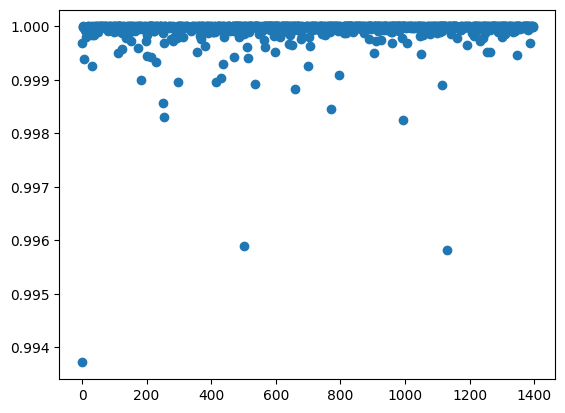

In [ ]:
plt.scatter(torch.arange(len(od_eval_auc_rocs)),od_eval_auc_rocs)

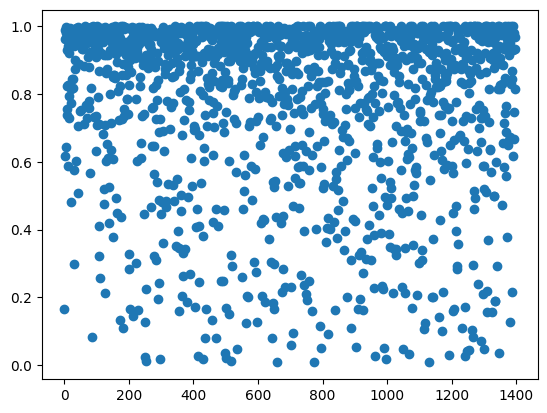

In [ ]:
plt.scatter(torch.arange(len(od_eval_f1s)),od_eval_f1s)

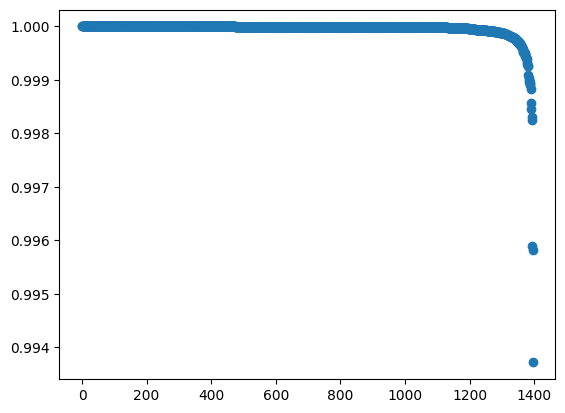

In [ ]:
plt.scatter(torch.arange(len(od_eval_auc_rocs)),torch.sort(od_eval_auc_rocs,descending=True).values)

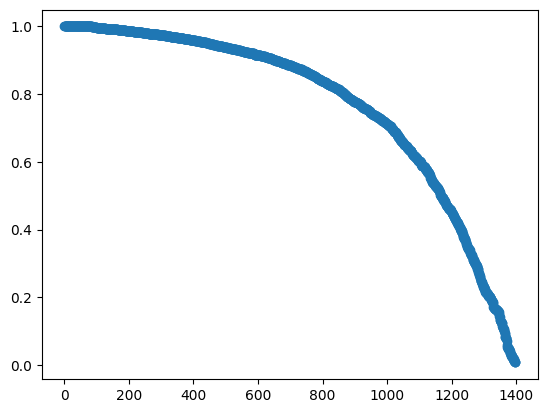

In [ ]:
plt.scatter(torch.arange(len(od_eval_f1s)),torch.sort(od_eval_f1s,descending=True).values)

In [ ]:
adv_dict = torch.load('/content/drive/MyDrive/thesis/data/chapters/chapter2/advantages_dict.pt')

In [ ]:
for key, val in adv_dict.items():
  print(key)

advantages_bigram_ids
advantages
weighted_advantages


In [ ]:
od_eval_bids = torch.tensor([elem['bid'] for _, elem in bid_to_od_eval_dict_total2.items()])

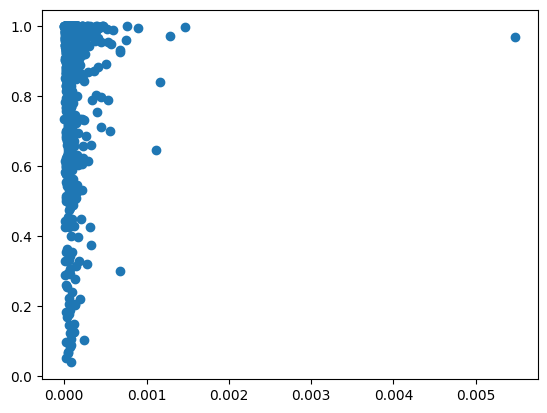

In [ ]:
plt.scatter(adv_dict['weighted_advantages'][od_eval_bids], od_eval_f1s)

In [ ]:
(adv_dict['advantages_bigram_ids'].unique() == adv_dict['advantages_bigram_ids']).sum()

tensor(10000)

In [ ]:
plt.scatter(torch.arange(len(auc_rocs)),torch.sort(auc_rocs,descending=True).values)

NameError: ignored

In [ ]:
(auc_rocs > 0.90).float().mean()

tensor(0.6955)

In [ ]:
torch.sort(auc_rocs,descending=True).values

tensor([1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 

In [ ]:
get_entropy_of_bigram(dset_dict['bigram_id'])

tensor(0.0691)

In [ ]:
(od_batches_probe_preds > 0).sum(), od_batches_y_true.float().sum()

(tensor(650), tensor(650.))

In [ ]:
falses = torch.argwhere((od_batches_probe_preds > 0) != od_batches_y_true.float())
falses

tensor([], size=(0, 2), dtype=torch.int64)

In [ ]:
false_seq, false_pos = falses[0,0].item(), falses[0,1].item()

IndexError: ignored

In [ ]:
print_bigram_id(bid)

tensor([187, 187]) 




'\n\n'

In [ ]:
od_batches_dict['tokens'][false_seq,false_pos-5:false_pos+5]

tensor([  266, 18324,   683,    67,  1797,  9318,    67,   740,  6660,   285])

In [ ]:
false_a, false_b = od_batches_dict['tokens'][false_seq,false_pos-1].item(), od_batches_dict['tokens'][false_seq,false_pos].item()

In [ ]:
tokenizer.decode((false_a, false_b))

'21][@'

In [ ]:
tokenizer.decode((false_b))

'][@'

In [ ]:
def token_similarity(type_a, type_b):
  return cossim(E_in[type_a],E_in[type_b])

In [ ]:
def get_token_k_neighbors(type_a,k=20):
  type_a_sims = get_similarity_cross(E_in, E_in[type_a].reshape(1,-1)).reshape(-1)
  topk = torch.topk(type_a_sims,k=k)
  return topk.indices, topk.values

In [ ]:
get_token_k_neighbors(true_a), false_a

((tensor([  187,  2379, 13769,  2490,   996, 21304, 19668,   535,    64,   988,
            346,  2657,   275, 22417,  7951,  2664,   418,    10,    27, 15267]),
  tensor([1.0000, 0.4099, 0.4072, 0.3756, 0.3192, 0.3113, 0.2580, 0.2526, 0.2385,
          0.2349, 0.2188, 0.2184, 0.2118, 0.2114, 0.2095, 0.2090, 0.1987, 0.1967,
          0.1950, 0.1941])),
 1797)

In [ ]:
token_similarity(true_a, false_a)

tensor([0.0455])

In [ ]:
get_token_k_neighbors(true_b), false_b

((tensor([  187,  2379, 13769,  2490,   996, 21304, 19668,   535,    64,   988,
            346,  2657,   275, 22417,  7951,  2664,   418,    10,    27, 15267]),
  tensor([1.0000, 0.4099, 0.4072, 0.3756, 0.3192, 0.3113, 0.2580, 0.2526, 0.2385,
          0.2349, 0.2188, 0.2184, 0.2118, 0.2114, 0.2095, 0.2090, 0.1987, 0.1967,
          0.1950, 0.1941])),
 9318)

In [ ]:
token_similarity(true_b, false_b)

tensor([-0.0055])

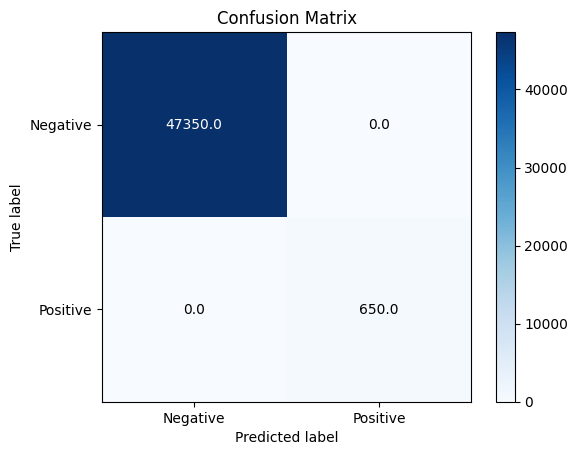

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0


{'f1': 1.0,
 'accuracy': 1.0,
 'sensitivity': tensor(1.),
 'specificity': tensor(1.)}

In [ ]:
get_metrics((od_batches_probe_preds > 0).reshape(-1), od_batches_y_true.float().reshape(-1), print_stuff=True)

In [ ]:
old_dict = load_pkl('/content/drive/MyDrive/thesis/derived_data/probing/sk_halfadv_probes/probes_and_preds_79_mod410m.pkl')

In [ ]:
renewed_dict = {}
for key, val in old_dict.items():
  print(key)
  print(val)
  renewed_dict[key] = {'probe': val['probes']['halfadv']}

blocks.1.mlp.hook_post
{'probes': {'halfadv': LogisticRegression(max_iter=100000, random_state=0)}, 'weights': {'coef': tensor([[-0.0967,  0.2407,  0.1165,  ..., -0.0088, -0.2069, -0.1420]],
       dtype=torch.float64), 'bias': tensor([-6.1903], dtype=torch.float64)}, 'eval': {'halfadv_on_nonadv': (0.9128205128205129, tensor([1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
        1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
        1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
        1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
        1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
        1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 

In [ ]:
loaded_dict

{'blocks.1.mlp.hook_post': {'probes': {'halfadv': LogisticRegression(max_iter=100000, random_state=0)},
  'weights': {'coef': tensor([[-0.0967,  0.2407,  0.1165,  ..., -0.0088, -0.2069, -0.1420]],
          dtype=torch.float64),
   'bias': tensor([-6.1903], dtype=torch.float64)},
  'eval': {'halfadv_on_nonadv': (0.9128205128205129,
    tensor([1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
            1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
            1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
            1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
            1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
            1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 0., 0., 0., 0., 0., 0., 0., 0.,
            0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
            0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.

# Feature dimensionality

In [ ]:
probes_collected = {hook_name : [] for hook_name in some_resid_hooks}
probes_collected_bids = []

In [ ]:
for bid in tqdm(dope_bigram_ids[:1980]):
  #dset_dict = select_dset_dict_by_bigram_id(bid, some_resid_hooks)
  probes_dict = load_probes_from_bigram_id(bid.item())
  probes_collected_bids.append(bid.item())
  for hook_name in some_resid_hooks:
    ws = probes_dict[hook_name]['probe'].coef_.reshape(-1)
    probes_collected[hook_name].append(ws)


100%|██████████| 1980/1980 [17:34<00:00,  1.88it/s]


In [ ]:
len(probes_collected_bids)

1980

In [ ]:
len(probes_collected[some_resid_hooks[0]])

1980

In [ ]:
probest_collected = {hook_name : torch.stack([torch.from_numpy(elem) for elem in val]) for hook_name, val in probes_collected.items()}

In [ ]:
probest_collected[some_resid_hooks[0]].shape

torch.Size([1980, 1024])

In [ ]:
sims_dict = {hook_name : get_similarity_cross(val,val) for hook_name, val in probest_collected.items()}

In [ ]:
torch.save({
    'probest': probest_collected,
    'sims_dict': sims_dict,
    'bids': probes_collected_bids
}, '/content/drive/MyDrive/thesis/zoomin/featuredim/nonadv/1980dopes.pt')

In [ ]:
sims_dict[some_resid_hooks[0]].shape

torch.Size([1980, 1980])

In [ ]:
def compute_feature_dimensionalities(W):
  Wnorm = F.normalize(W, dim=1)
  num = (W ** 2.).sum(dim=-1) #torch.pow(torch.norm(W, dim=-1),2)
  denom = torch.pow((Wnorm @ W.T), 2.).sum(dim=-1)
  feature_dimensionality = num / denom
  return feature_dimensionality

In [ ]:
Cn = F.normalize(probest_collected[some_resid_hooks[0]],dim=-1)

In [ ]:
Cn.shape

torch.Size([1980, 1024])

In [ ]:
nfds = {hook_name : compute_feature_dimensionalities(F.normalize(C,dim=-1)) for hook_name, C in probest_collected.items() } # torch.stack([compute_feature_dimensionalities(F.normalize(C,dim=-1)) for C in probest_collected])

tensor([1.2929e-02, 7.8470e-03, 3.7549e-03,  ..., 2.7340e-05, 2.7340e-05,
        2.7319e-05])

[0,
 1,
 2,
 3,
 4,
 6,
 7,
 8,
 10,
 13,
 14,
 15,
 16,
 17,
 18,
 20,
 21,
 22,
 23,
 25,
 26,
 27,
 28,
 30,
 31,
 32,
 33,
 34,
 35,
 36,
 38,
 39,
 40,
 41,
 43,
 44,
 45,
 46,
 47,
 49,
 50,
 51,
 52,
 54,
 55,
 57,
 58,
 59,
 60,
 66,
 68,
 69,
 70,
 72,
 73,
 74,
 75,
 76,
 77,
 78,
 79,
 80,
 81,
 82,
 83,
 84,
 86,
 87,
 88,
 94,
 95,
 96,
 97,
 98,
 99,
 100,
 101,
 103,
 104,
 105,
 106,
 107,
 109,
 110,
 112,
 113,
 115,
 116,
 118,
 119,
 120,
 121,
 123,
 127,
 128,
 129,
 130,
 131,
 132,
 133,
 135,
 136,
 137,
 138,
 140,
 141,
 142,
 143,
 144,
 145,
 146,
 147,
 149,
 151,
 152,
 153,
 154,
 155,
 156,
 157,
 158,
 159,
 160,
 161,
 162,
 163,
 164,
 165,
 166,
 167,
 168,
 169,
 170,
 171,
 172,
 173,
 174,
 175,
 176,
 177,
 178,
 179,
 182,
 183,
 185,
 189,
 190,
 191,
 192,
 193,
 194,
 195,
 196,
 198,
 201,
 202,
 204,
 205,
 206,
 207,
 208,
 209,
 210,
 211,
 213,
 214,
 216,
 217,
 219,
 221,
 222,
 223,
 225,
 226,
 227,
 230,
 231,
 232,
 233,
 234,
 23

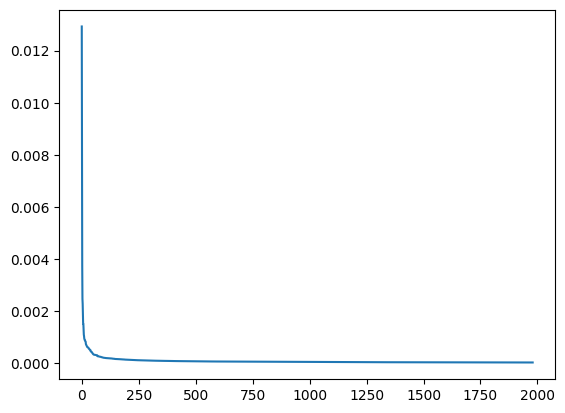

In [ ]:
plt.plot(bigrams_dict['pmf'][torch.tensor(probes_collected_bids).reshape(-1)])

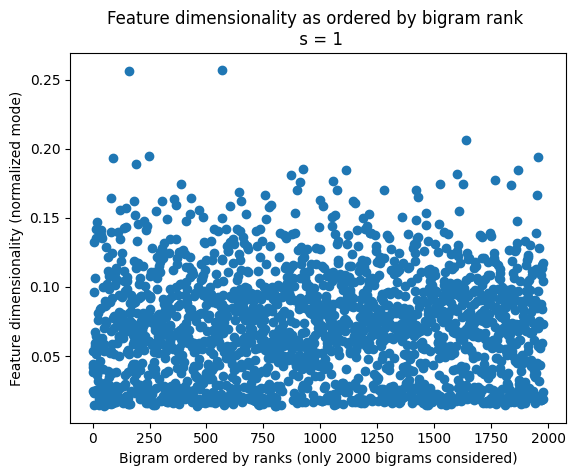

In [ ]:
plt.scatter(torch.arange(len(nfds['blocks.1.hook_resid_pre'])),nfds['blocks.1.hook_resid_pre'])
plt.xlabel('Bigram ordered by ranks (only 2000 bigrams considered)')
plt.ylabel('Feature dimensionality (normalized mode)')
plt.title('Feature dimensionality as ordered by bigram rank \n s = 1')
plt.savefig('feature_dim_s1_bigram_rank.png',dpi=300)

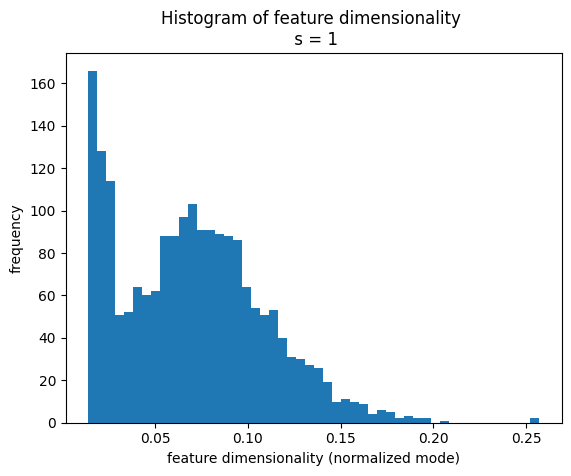

In [ ]:
_ = plt.hist(nfds['blocks.1.hook_resid_pre'],bins=50)
plt.title('Histogram of feature dimensionality \n s = 1')
plt.xlabel('feature dimensionality (normalized mode)')
plt.ylabel('frequency')
plt.savefig('feature_dim_s1_histogram.png',dpi=300)

In [ ]:
topk = torch.topk(nfds['blocks.1.hook_resid_pre'],k=100)

In [ ]:
mink = torch.topk(-nfds['blocks.1.hook_resid_pre'],k=100)

In [ ]:
for i, fd in zip(topk.indices,topk.values):
  print(i, fd)
  bid_i = probes_collected_bids[i.item()]
  print_bigram_id(bid_i,extended=True)

tensor(568) tensor(0.2571, dtype=torch.float64)
tensor([2654,  568]) ' id="' ' id' '="'
tensor(158) tensor(0.2567, dtype=torch.float64)
tensor([966, 568]) ' class="' ' class' '="'
tensor(1638) tensor(0.2062, dtype=torch.float64)
tensor([20, 69]) '3d' '3' 'd'
tensor(246) tensor(0.1950, dtype=torch.float64)
tensor([457,  78]) '’m' '’' 'm'
tensor(1957) tensor(0.1941, dtype=torch.float64)
tensor([50254, 50270]) '                                ' '                        ' '        '
tensor(89) tensor(0.1936, dtype=torch.float64)
tensor([50, 27]) 'Q:' 'Q' ':'
tensor(189) tensor(0.1893, dtype=torch.float64)
tensor([  28, 1214]) '; @' ';' ' @'
tensor(922) tensor(0.1856, dtype=torch.float64)
tensor([50254, 50274]) '                            ' '                        ' '    '
tensor(1865) tensor(0.1847, dtype=torch.float64)
tensor([2866,  187]) '…\n' '…' '\n'
tensor(1112) tensor(0.1843, dtype=torch.float64)
tensor([965,  31]) 'li>' 'li' '>'
tensor(1599) tensor(0.1815, dtype=torch.float64)
te

In [ ]:
for i, fd in zip(mink.indices,mink.values):
  print(i, fd)
  bid_i = probes_collected_bids[i.item()]
  print_bigram_id(bid_i,extended=True)

tensor(802) tensor(-0.0139, dtype=torch.float64)
tensor([ 13, 512]) ', all' ',' ' all'
tensor(458) tensor(-0.0140, dtype=torch.float64)
tensor([ 13, 581]) ', one' ',' ' one'
tensor(52) tensor(-0.0141, dtype=torch.float64)
tensor([ 13, 275]) ', in' ',' ' in'
tensor(806) tensor(-0.0142, dtype=torch.float64)
tensor([ 13, 751]) ', like' ',' ' like'
tensor(1473) tensor(-0.0143, dtype=torch.float64)
tensor([  13, 1097]) ', both' ',' ' both'
tensor(27) tensor(-0.0143, dtype=torch.float64)
tensor([ 13, 247]) ', a' ',' ' a'
tensor(1550) tensor(-0.0143, dtype=torch.float64)
tensor([ 13, 849]) ', how' ',' ' how'
tensor(7) tensor(-0.0143, dtype=torch.float64)
tensor([ 13, 253]) ', the' ',' ' the'
tensor(576) tensor(-0.0144, dtype=torch.float64)
tensor([ 13, 752]) ', what' ',' ' what'
tensor(828) tensor(-0.0145, dtype=torch.float64)
tensor([ 13, 846]) ', after' ',' ' after'
tensor(731) tensor(-0.0146, dtype=torch.float64)
tensor([ 13, 432]) ', from' ',' ' from'
tensor(1059) tensor(-0.0146, dtype=to

In [ ]:
typeembds_fd = torch.load('/content/drive/MyDrive/thesis/zoomin/featuredim/typeembds/efds_enfds.pt')

In [ ]:
stopwords = torch.tensor([512,581,275,751,1097,247])

In [ ]:
get_similarity

In [ ]:
torch.norm(E_in,dim=-1)[stopwords]

tensor([0.7528, 0.7847, 0.5662, 0.7626, 0.8043, 0.5608])

In [ ]:
(torch.norm(E_in,dim=-1) < 0.80).float().mean()

tensor(0.0143)

(array([1.4000e+01, 1.1400e+02, 9.9000e+01, 1.6000e+01, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 2.0000e+00, 0.0000e+00,
        0.0000e+00, 1.0000e+00, 1.0000e+00, 1.0000e+00, 1.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 1.0000e+00, 1.0000e+00, 2.0000e+00, 0.0000e+00,
        0.0000e+00, 1.0000e+00, 2.0000e+00, 1.0000e+00, 1.0000e+00,
        2.0000e+00, 0.0000e+00, 2.0000e+00, 1.0000e+00, 3.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 3.0000e+00,
        1.0000e+00, 2.0000e+00, 2.0000e+00, 2.0000e+00, 1.0000e+00,
        5.0000e+00, 1.0000e+00, 3.0000e+00, 1.0000e+00, 2.0000e+00,
        1.0000e+00, 6.0000e+00, 1.0000e+00, 3.0000e+00, 3.0000e+00,
        0.0000e+00, 3.0000e+00, 0.0000e+00, 3.0000e+00, 3.0000e+00,
        2.0000e+00, 5.0000e+00, 5.0000e+00, 6.0000e+00, 4.0000e+00,
        7.0000e+00, 6.0000e+00, 1.0000e+01, 8.0000e+00, 7.0000e+00,
        1.0000e+01, 1.2000e+01, 6.0000e+00, 1.20

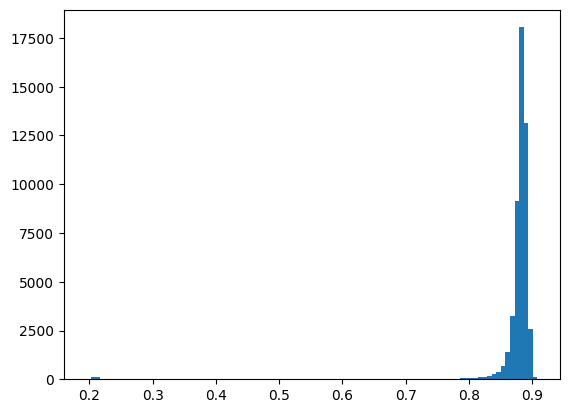

In [ ]:
plt.hist(torch.norm(E_in,dim=-1),bins=100)

In [ ]:
torch.norm(E_in,dim=-1)[13]

tensor(0.5211)

In [ ]:
enormsort = torch.sort(torch.norm(E_in,dim=-1),descending=False)#.indices[:30]

In [ ]:
enormsort

torch.return_types.sort(
values=tensor([0.1950, 0.1970, 0.1993,  ..., 0.9058, 0.9064, 0.9074]),
indices=tensor([14352, 14222, 21898,  ..., 10986,  5267,  6340]))

In [ ]:
for i, (idx, val) in enumerate(zip(enormsort.indices,enormsort.values)):
  print(i, idx, val, repr(tokenizer.decode((idx.item()))))
  if idx == 187:
    break
  if i > 10000:
    break

0 tensor(14352) tensor(0.1950) '\n\t   '
1 tensor(14222) tensor(0.1970) '\n                                   '
2 tensor(21898) tensor(0.1993) ' \n  '
3 tensor(50295) tensor(0.1996) ''
4 tensor(23893) tensor(0.1999) '           \n '
5 tensor(24245) tensor(0.1999) '                                                             '
6 tensor(21024) tensor(0.2004) ' \n           '
7 tensor(43833) tensor(0.2005) '                                                                           '
8 tensor(50298) tensor(0.2011) ''
9 tensor(2463) tensor(0.2013) '\n         '
10 tensor(2580) tensor(0.2015) '\n                   '
11 tensor(7828) tensor(0.2016) '                          '
12 tensor(8044) tensor(0.2018) '                           '
13 tensor(22597) tensor(0.2019) '\n                              '
14 tensor(5144) tensor(0.2022) '                     '
15 tensor(40960) tensor(0.2022) '                                                                    '
16 tensor(12826) tensor(0.2023) '\n 

In [ ]:
torch.topk(get_similarity_cross(E_in[stopwords],E_in),k=30).values

tensor([[1.0000, 0.6529, 0.5961, 0.5567, 0.5547, 0.3723, 0.3061, 0.2989, 0.2713,
         0.2675, 0.2617, 0.2444, 0.2393, 0.2338, 0.2330, 0.2330, 0.2303, 0.2251,
         0.2248, 0.2243, 0.2235, 0.2232, 0.2207, 0.2082, 0.2079, 0.2074, 0.2072,
         0.2058, 0.2054, 0.2050],
        [1.0000, 0.6937, 0.6328, 0.5552, 0.5397, 0.4379, 0.3478, 0.3228, 0.2798,
         0.2789, 0.2752, 0.2697, 0.2654, 0.2617, 0.2612, 0.2565, 0.2550, 0.2549,
         0.2455, 0.2409, 0.2399, 0.2395, 0.2384, 0.2380, 0.2365, 0.2326, 0.2325,
         0.2324, 0.2314, 0.2283],
        [1.0000, 0.5046, 0.4479, 0.3784, 0.3587, 0.3277, 0.3113, 0.2619, 0.2543,
         0.2292, 0.2118, 0.2100, 0.2093, 0.1987, 0.1985, 0.1952, 0.1913, 0.1817,
         0.1771, 0.1762, 0.1759, 0.1748, 0.1711, 0.1703, 0.1664, 0.1644, 0.1641,
         0.1635, 0.1594, 0.1571],
        [1.0000, 0.6213, 0.5785, 0.5512, 0.5147, 0.4543, 0.4531, 0.3173, 0.2979,
         0.2693, 0.2684, 0.2631, 0.2629, 0.2603, 0.2588, 0.2525, 0.2445, 0.2424,
       

(array([ 1086.,   858.,  2582., 15014., 20891.,  8623.,   897.,   119.,
          200.,    34.]),
 array([0.00489026, 0.00664836, 0.00840645, 0.01016455, 0.01192265,
        0.01368074, 0.01543884, 0.01719693, 0.01895503, 0.02071312,
        0.02247122]),
 <BarContainer object of 10 artists>)

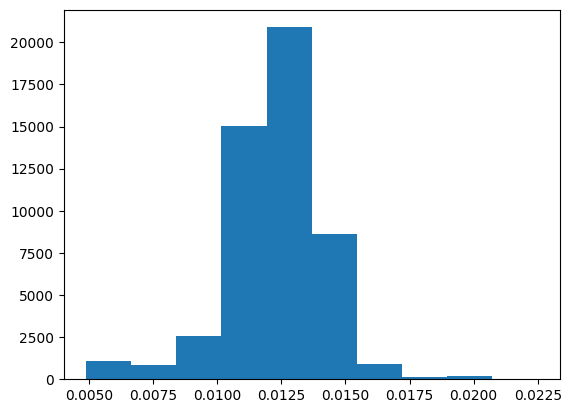

In [ ]:
plt.hist(typeembds_fd[0])

In [ ]:
def upper_triangle_values(tensor):
    assert tensor.dim() == 2, "Input should be a 2D tensor"
    assert tensor.size(0) == tensor.size(1), "Input should be a square tensor"

    n = tensor.size(0)
    indices = torch.triu_indices(n, n, offset=1)

    upper_triangle_values = tensor[indices[0], indices[1]]

    return upper_triangle_values

In [ ]:
upper_triangle_values(sims_dict[some_resid_hooks[0]]).max()

tensor(0.9445, dtype=torch.float64)

In [ ]:
upper_triangle_values(sims_dict[some_resid_hooks[0]]).median()

tensor(0.0087, dtype=torch.float64)

In [ ]:
upper_triangle_values(sims_dict[some_resid_hooks[1]]).max()

tensor(0.8658, dtype=torch.float64)

In [ ]:
upper_triangle_values(sims_dict[some_resid_hooks[1]]).median()

tensor(0.0077, dtype=torch.float64)

0.017869748439683954 0.008576108025845242


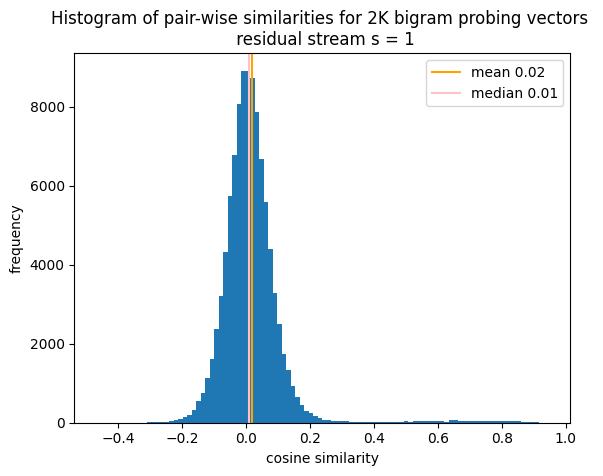

In [ ]:
hook_name = some_resid_hooks[0]
plotted_sims = upper_triangle_values(sims_dict[hook_name])[torch.randperm(1959210)[:100000]]
smean = plotted_sims.mean().item()
smedian = plotted_sims.median().item()
print(smean, smedian)
plt.hist(plotted_sims,bins=100) #.shape
plt.axvline(x=smean, label=f'mean {round(smean,2)}',color='orange')
plt.axvline(x=smedian, label=f'median {round(smedian,2)}',color='pink')

plt.xlabel('cosine similarity')
plt.ylabel('frequency')
plt.title(f'Histogram of pair-wise similarities for 2K bigram probing vectors \n residual stream s = 1')
plt.legend()
#plt.show()
plt.savefig(f'{hook_name}_probing_sim.png',dpi=300)
plt.show()

In [ ]:
(plotted_sims > 0.4).float().mean()

tensor(0.0119)

In [ ]:
import torch

def top_k_indices_upper_triangular(matrix, k):
    n = matrix.size(0)
    mask = torch.triu(torch.ones(n, n), diagonal=1)
    upper_triangular_values = matrix[mask == 1]

    _, top_k_indices = torch.topk(upper_triangular_values, k)
    rows, cols = torch.where(mask == 1)

    return torch.stack([rows[top_k_indices], cols[top_k_indices]], dim=1)

In [ ]:
for row in top_k_indices_upper_triangular(sims_dict[hook_name],k=10):
  print(row)
  print('bids:', sims_bids[row[0].item()], sims_bids[row[1].item()])
  print(sims_dict[hook_name][row[0].item(),row[1].item()].item())
  print(print_bigram_id(sims_bids[row[0].item()],extended=True))
  print(print_bigram_id(sims_bids[row[1].item()],extended=True))


tensor([ 46, 421])
bids: tensor(58) tensor(526)
0.9445097479816065
tensor([281, 247]) ' to a' ' to' ' a'
(' to',' a')
tensor([281, 271]) ' to an' ' to' ' an'
(' to',' an')
tensor([ 169, 1791])
bids: tensor(221) tensor(2045)
0.9320288002160079
tensor([432, 247]) ' from a' ' from' ' a'
(' from',' a')
tensor([432, 271]) ' from an' ' from' ' an'
(' from',' an')
tensor([ 399, 1975])
bids: tensor(501) tensor(2251)
0.9282356502348164
tensor([253, 767]) ' the two' ' the' ' two'
(' the',' two')
tensor([ 253, 1264]) ' the three' ' the' ' three'
(' the',' three')
tensor([ 144, 1621])
bids: tensor(185) tensor(1857)
0.927262470051227
tensor([407, 247]) ' by a' ' by' ' a'
(' by',' a')
tensor([407, 271]) ' by an' ' by' ' an'
(' by',' an')
tensor([441, 895])
bids: tensor(549) tensor(1055)
0.926909373974895
tensor([275, 616]) ' in their' ' in' ' their'
(' in',' their')
tensor([275, 697]) ' in its' ' in' ' its'
(' in',' its')
tensor([266, 348])
bids: tensor(349) tensor(441)
0.9236315896036221
tensor([27

In [ ]:
 sims_bids = torch.tensor(probes_collected_bids)

In [ ]:
sims_bids.shape

torch.Size([1980])

In [ ]:
probes_dict = load_probes_from_bigram_id(58) #select_probes_by_dset_dict(dset_dict)
od_batches_probe_preds_logits_list = []
od_batches_dict_tokens_list = []
for i, od_batches_dict in enumerate(od_batches_dict_list):
  od_batches_probe_preds_logits = probe_predict_log_proba(probes_dict, hook_name, od_batches_dict['values'],batched=True)
  od_batches_y_true = find_bigram_occurrences(od_batches_dict['tokens'],torch.tensor(dset_dict['bigram']))
  od_batches_probe_preds_logits_list.append(od_batches_probe_preds_logits)
  od_batches_dict_tokens_list.append(od_batches_dict['tokens'])
  if i == 10:
    break
od_batches_probe_preds_logits_total = torch.cat(od_batches_probe_preds_logits_list,dim=0) #.shape
od_batches_dict_tokens_total = torch.cat(od_batches_dict_tokens_list,dim=0) #.shape
od_batches_y_true_total = find_bigram_occurrences(od_batches_dict_tokens_total,torch.tensor(dset_dict['bigram']))
od_batches_trivial_preds_total = torch.full_like(od_batches_probe_preds_logits_total,get_empirical_logproba_of_bigram(dset_dict['bigram_id']))
od_eval_dict_total = get_od_eval(od_batches_probe_preds_logits_total, od_batches_y_true_total, od_batches_trivial_preds_total)


In [ ]:
od_eval_dict_total

{'f1': 0.0,
 'precision': 0.0,
 'recall': 0.0,
 'auc_roc': 0.8678227150613964,
 'auc_pr': 0.007868825858038182,
 'matthews': -0.0009894273592389229,
 'bce': 0.04040513560175896,
 'bce_trivial': 0.016407085582613945,
 'cohens_kappa': -0.0007124924674051236,
 'confusion_matrix': {'tn': 526552, 'fp': 222, 'fn': 1226, 'tp': 0},
 'sensitivity': 0.0,
 'specificity': 0.9995785668996572,
 'hamming_loss': 0.0027424242424242424,
 'jaccard_score': 0.0}

In [ ]:
0.2 == 0.0

False

In [ ]:
dset_dict_adv = get_dset_dict_from_bigram_id(58, some_resid_hooks, get_hidden_states = True, batch_size = 50, n_pos=800, n_neg=1600, k_similars=20, adv_theta=0.2)


useadv True


80it [06:17,  4.72s/it]
10it [00:45,  4.52s/it]


In [ ]:
save_probing_dset_if_not_exists(dset_dict_adv, bigram_probing_datasets_dir='/content/drive/MyDrive/thesis/zoomin/bigram_probing_datasets/adversarial1')

Dset already saved, not saving


In [ ]:
probes_dict_adv = train_probes(dset_dict_adv)

100%|██████████| 9/9 [00:11<00:00,  1.28s/it]


In [ ]:
probes_dict_adv

{'blocks.1.hook_resid_pre': {'probe': LogisticRegression(max_iter=10000, random_state=0),
  'eval': {'f1': 1.0,
   'accuracy': 1.0,
   'sensitivity': tensor(1.),
   'specificity': tensor(1.),
   'nll': 0.02285007349467534},
  'eraser': <__main__.UnfrozenLeaceEraser at 0x7e97154e9f00>},
 'blocks.2.hook_resid_pre': {'probe': LogisticRegression(max_iter=10000, random_state=0),
  'eval': {'f1': 1.0,
   'accuracy': 1.0,
   'sensitivity': tensor(1.),
   'specificity': tensor(1.),
   'nll': 0.005291711913729823},
  'eraser': <__main__.UnfrozenLeaceEraser at 0x7e95d0ca2fb0>},
 'blocks.3.hook_resid_pre': {'probe': LogisticRegression(max_iter=10000, random_state=0),
  'eval': {'f1': 1.0,
   'accuracy': 1.0,
   'sensitivity': tensor(1.),
   'specificity': tensor(1.),
   'nll': 0.00480261217673277},
  'eraser': <__main__.UnfrozenLeaceEraser at 0x7e95cbfff0a0>},
 'blocks.4.hook_resid_pre': {'probe': LogisticRegression(max_iter=10000, random_state=0),
  'eval': {'f1': 1.0,
   'accuracy': 1.0,
   'se

In [ ]:
hook_name

'blocks.1.hook_resid_pre'

In [ ]:
dset_dict_adv['bigram_id']

58

In [ ]:
od_batches_probe_preds_logits_list = []
od_batches_dict_tokens_list = []
for i, od_batches_dict in enumerate(od_batches_dict_list):
  od_batches_probe_preds_logits = probe_predict_log_proba(probes_dict_adv, hook_name, od_batches_dict['values'],batched=True)
  od_batches_y_true = find_bigram_occurrences(od_batches_dict['tokens'],torch.tensor(dset_dict_adv['bigram']))
  od_batches_probe_preds_logits_list.append(od_batches_probe_preds_logits)
  od_batches_dict_tokens_list.append(od_batches_dict['tokens'])
  if i == 10:
    break
od_batches_probe_preds_logits_total = torch.cat(od_batches_probe_preds_logits_list,dim=0) #.shape
od_batches_dict_tokens_total = torch.cat(od_batches_dict_tokens_list,dim=0) #.shape
od_batches_y_true_total = find_bigram_occurrences(od_batches_dict_tokens_total,torch.tensor(dset_dict_adv['bigram']))
od_batches_trivial_preds_total = torch.full_like(od_batches_probe_preds_logits_total,get_empirical_logproba_of_bigram(dset_dict_adv['bigram_id']))
od_eval_dict_total_adv = get_od_eval(od_batches_probe_preds_logits_total, od_batches_y_true_total, od_batches_trivial_preds_total)


In [ ]:
od_eval_dict_total_adv

{'f1': 0.9819004524886878,
 'precision': 0.9730941704035875,
 'recall': 0.9908675799086758,
 'auc_roc': 0.9999988060635258,
 'auc_pr': 0.9968664348828122,
 'matthews': 0.9819331180611324,
 'bce': 0.00027391925686970353,
 'bce_trivial': 0.003645382123067975,
 'cohens_kappa': 0.9818928741798327,
 'confusion_matrix': {'tn': 527775, 'fp': 6, 'fn': 2, 'tp': 217},
 'sensitivity': 0.9908675799086758,
 'specificity': 0.9999886316483542,
 'hamming_loss': 1.5151515151515151e-05,
 'jaccard_score': 0.9644444444444444}

# Find empirical next-tokens


In [ ]:
def ordered_set_difference(pos_top_nexts, neg2_top_nexts):
    return [item for item in pos_top_nexts if item not in neg2_top_nexts]

def get_nexts_per_category(category, dset_dict, dset_name, k=10, pol=False):
  a, b = dset_dict['bigram']
  if pol: print('Bigram:', a, b, repr(tokenizer.decode((a,b))))
  dset = dset_dict[dset_name]
  assert category in ['pos', '2neg']
  category_to_number_map = {'pos': 1., '1neg': 2., '2neg': 3.}
  idx = torch.argwhere(dset.labels == category_to_number_map[category]).reshape(-1).tolist()
  nexts = []
  for id in idx:
    tok_row = dset.data[id]
    id_seq, id_pos = tok_row[0].item(), tok_row[1].item()
    seq = occ_to_seq(TL, (id_seq, id_pos))
    id_a, id_b = seq[-2].item(), seq[-1].item()
    id_next = TL[id_seq,id_pos+2].item()
    if category == 'pos':
      assert id_a == a
      assert id_b == b
    elif category == '2neg':
      assert id_a != a
      assert id_b == b
    elif category == '1neg':
      assert id_a == a
      assert id_b != b
    assert id_next == occ_to_seq(TL, (id_seq, id_pos), after=3)[-1]
    nexts.append(id_next)
  nexts = torch.tensor(nexts)
  nexts_tokens, nexts_counts = torch.unique(nexts, return_counts=True)
  nexts_counts_top = torch.topk(nexts_counts,k=min(k,len(nexts_counts)))
  nexts_freq_top = nexts_counts_top.values / nexts_counts.sum()
  if pol:
    print('Counts', nexts_counts_top.values)
    print('Freq', nexts_freq_top)
  nexts_top = nexts_tokens[nexts_counts_top.indices]
  if pol: print(repr(tokenizer.decode(nexts_top)), repr(nexts_top))
  return nexts_top.tolist(), nexts_freq_top

In [ ]:
def find_bigram_next_tokens():
  bid_consequent_elems = []
  for did in tqdm(range(0,1000)):
    #print(did)
    bid = dope_bigram_ids[did].item()
    #print(did, bid)

    dset_dict2 = get_dset_dict_from_bigram_id(bid, ALL_RESID_HOOKS, get_hidden_states = False)
    pos_top_nexts, pos_top_nexts_freqs = get_nexts_per_category('pos', dset_dict2, 'train_dset', k = 3, pol=False)
    neg2_top_nexts, neg2_top_nexts_freqs = get_nexts_per_category('2neg', dset_dict2, 'train_dset', k = 10, pol=False)
    sufficient_criterium_1 = pos_top_nexts_freqs[0] > 2 * neg2_top_nexts_freqs[0]
    sufficient_criterium_2 = pos_top_nexts[0] not in neg2_top_nexts
    if sufficient_criterium_1 or sufficient_criterium_2:
      #print('Top is upregulated')
      #print(pos_top_nexts[0], pos_top_nexts_freqs[0])
      bid_consequent_elem = {
          'bid': bid,
          'did': did,
          'pos_top_next': pos_top_nexts[0],
          'neg2_top_next': neg2_top_nexts[0],
          'pos_top_next_freq': pos_top_nexts_freqs[0],
          'neg2_top_next_freq': neg2_top_nexts_freqs[0],
          'pos_top_nexts_all': pos_top_nexts,
          'neg2_top_nexts_all': neg2_top_nexts,
          'pos_top_nexts_freqs': pos_top_nexts_freqs,
          'neg2_top_nexts_freqs': neg2_top_nexts_freqs,
          'criterium_1': sufficient_criterium_1,
          'criterium_2': sufficient_criterium_2,
      }
      #print_bigram_id(bid)
      bid_consequent_elems.append(bid_consequent_elem)

def display_bid_consequent_elems(bid_consequent_elems):
  for elem in bid_consequent_elems:
    print_bigram_id(elem['bid'])
    print('next:', repr(tokenizer.decode((elem['pos_top_next']))))

In [ ]:
#torch.save(bid_consequent_elems, '/content/drive/MyDrive/thesis/zoomin/behavioral_nexts/bid_consequent_elems1.pt')
bid_consequent_elems = torch.load('/content/drive/MyDrive/thesis/zoomin/behavioral_nexts/bid_consequent_elems1.pt')

In [ ]:
'''
for bid_consequent_elem in bid_consequent_elems:
  dset_dict = select_dset_dict_by_bigram_id(bid_consequent_elem['bid'], ALL_RESID_HOOKS, skip_load_if_exists=False)
  my_bid_probes = select_probes_by_dset_dict(dset_dict)
  delete_dict(dset_dict)
'''

"\nfor bid_consequent_elem in bid_consequent_elems:\n  dset_dict = select_dset_dict_by_bigram_id(bid_consequent_elem['bid'], ALL_RESID_HOOKS, skip_load_if_exists=False)\n  my_bid_probes = select_probes_by_dset_dict(dset_dict)\n  delete_dict(dset_dict)\n"

In [ ]:
cid_dict = bid_consequent_elems[0]

In [ ]:
for cid, cid_dict in enumerate(bid_consequent_elems):
  print('cid', cid)
  print_bigram_id(cid_dict['bid'],extended=True)
  print('next', repr(tokenizer.decode((cid_dict['pos_top_next']))))
  print('')

cid 0
tensor([187, 187]) '\n\n' '\n' '\n'
next 'The'

cid 1
tensor([ 15, 187]) '.\n' '.' '\n'
next '\n'

cid 2
tensor([275, 253]) ' in the' ' in' ' the'
next ' United'

cid 3
tensor([457,  84]) '’s' '’' 's'
next ' a'

cid 4
tensor([281, 253]) ' to the' ' to' ' the'
next ' United'

cid 5
tensor([ 28, 187]) ';\n' ';' '\n'
next 'import'

cid 6
tensor([327, 253]) ' on the' ' on' ' the'
next ' ground'

cid 7
tensor([  187, 50276]) '\n  ' '\n' '  '
next 'var'

cid 8
tensor([285, 253]) ' and the' ' and' ' the'
next ' following'

cid 9
tensor([310, 247]) ' is a' ' is' ' a'
next ' big'

cid 10
tensor([342, 253]) ' with the' ' with' ' the'
next ' License'

cid 11
tensor([310, 253]) ' is the' ' is' ' the'
next ' second'

cid 12
tensor([387, 253]) ' at the' ' at' ' the'
next ' time'

cid 13
tensor([432, 253]) ' from the' ' from' ' the'
next ' United'

cid 14
tensor([ 13, 247]) ', a' ',' ' a'
next ' former'

cid 15
tensor([275, 247]) ' in a' ' in' ' a'
next ' statement'

cid 16
tensor([457,  85]) '

In [ ]:
great_cids = [473, 472, 449, 443, 437, 416, 410, 406, 394, 374, 368, 363, 333, 319, 306, 297, 283, 257, 247, 227, 220, 194, 173, 165, 140, 98, 79, 55, ]

In [ ]:
logsoftmax = nn.LogSoftmax(dim=-1)

In [ ]:
model_1b = get_model('1b', 143, True)

Not using rev for transformerlens, something weird with rev please fix
Loaded pretrained model pythia-1b-deduped-v0 into HookedTransformer


In [ ]:
great_mnt_cids = []
for cid in tqdm(range(len(bid_consequent_elems))):
  min_lf = 3
  with torch.no_grad():
    mnt_ab_logits = model(
        bigrams[bid_consequent_elems[cid]['bid']],
        return_type='logits'
    )[0,-1]
    mnt_b_logits = model(
        bigrams[bid_consequent_elems[cid]['bid']][1:],
        return_type='logits'
    )[0,-1]
  mnt_lfs = logsoftmax(mnt_ab_logits) - logsoftmax(mnt_b_logits)
  mnt_topk = torch.topk(mnt_lfs,k=10)
  if mnt_topk.values[0] > min_lf:
    bid_consequent_elems[cid]['mnt'] = mnt_topk.indices[0].item()
    great_mnt_cids.append(cid)
    #print(len(great_mnt_cids))

100%|██████████| 474/474 [01:00<00:00,  7.89it/s]


In [ ]:
len(great_mnt_cids)

429

In [ ]:
dope_qsets = {}

In [ ]:
for bid in tqdm(dope_bigram_ids):
  with torch.no_grad():
      mnt_ab_logits = model(
          bigrams[bid],
          return_type='logits'
      )[0,-1]
      mnt_b_logits = model(
          bigrams[bid][1:],
          return_type='logits'
      )[0,-1]
  mnt_lfs = logsoftmax(mnt_ab_logits) - logsoftmax(mnt_b_logits)
  upregulated_set = set(torch.argwhere(mnt_lfs > 2.).reshape(-1).tolist())
  ab_topk_set = set(torch.topk(mnt_ab_logits,k=20).indices.reshape(-1).tolist())
  qset = list(upregulated_set & ab_topk_set)
  if len(qset) > 0:
    dope_qsets[bid] = qset

 14%|█▎        | 2001/14557 [04:22<27:24,  7.64it/s]


KeyboardInterrupt: ignored

In [ ]:
#torch.save(dope_qsets, '/content/drive/MyDrive/thesis/zoomin/dope_qsets_410m_1980_min2_k20.pt')

In [ ]:
dope_qsets = torch.load('/content/drive/MyDrive/thesis/zoomin/dope_qsets_410m_1980_min2_k20.pt')

# Get ablation vectors for a bigram

In [ ]:
def get_latvec_dict(dset_dict):
  latvec_dict = {}
  for hook_name, X in dset_dict['train_hidden_states'].items():
    xpos = X[torch.argwhere(dset_dict['train_dset'].labels == 1.).reshape(-1)] #.mean(dim=0)
    xneg2 = X[torch.argwhere(dset_dict['train_dset'].labels == 3.).reshape(-1)] #.mean(dim=0)
    xneg2 = xneg2[:len(xpos)]
    latvec = torch.from_numpy(PCA(n_components=1).fit((xpos - xneg2).cpu()).components_[0]).to(device)
    latvec_dict[hook_name] = latvec
  return latvec_dict

In [ ]:
def get_latvec2_dict(dset_dict):
  latvec_dict = {}
  for hook_name, X in dset_dict['train_hidden_states'].items():
    xpos = X[torch.argwhere(dset_dict['train_dset'].labels == 1.).reshape(-1)] #.mean(dim=0)
    xneg = X[torch.argwhere(dset_dict['train_dset'].labels != 1.).reshape(-1)][torch.randperm(2*1600)] #.mean(dim=0)
    xneg = xneg[:len(xpos)]
    latvec = torch.from_numpy(PCA(n_components=1).fit((xpos - xneg).cpu()).components_[0]).to(device)
    latvec_dict[hook_name] = latvec
  return latvec_dict

In [ ]:
def normalize_dict(abl_vec_dict):
  return {key : F.normalize(val,dim=-1) for key, val in abl_vec_dict.items()}

In [ ]:
def get_xpos_mean_dict(dset_dict):
  xposmean_dict = {}
  for hook_name, X in dset_dict['train_hidden_states'].items():
    xposmean_dict[hook_name] = X[torch.argwhere(dset_dict['train_dset'].labels == 1.).reshape(-1)].mean(dim=0)
  return xposmean_dict

In [ ]:
def get_neg2diff_mean_dict(dset_dict):
  neg2diff_dict = {}
  for hook_name, X in dset_dict['train_hidden_states'].items():
    xposmean = X[torch.argwhere(dset_dict['train_dset'].labels == 1.).reshape(-1)].mean(dim=0)
    xneg2mean = X[torch.argwhere(dset_dict['train_dset'].labels == 3.).reshape(-1)].mean(dim=0)
    neg2diff_dict[hook_name] = xposmean - xneg2mean
  return neg2diff_dict

In [ ]:
def get_neg2diff_mean_dict(dset_dict):
  neg2diff_dict = {}
  for hook_name, X in dset_dict['train_hidden_states'].items():
    xposmean = X[torch.argwhere(dset_dict['train_dset'].labels == 1.).reshape(-1)].mean(dim=0)
    xneg2mean = X[torch.argwhere(dset_dict['train_dset'].labels == 3.).reshape(-1)].mean(dim=0)
    neg2diff_dict[hook_name] = xposmean - xneg2mean
  return neg2diff_dict

In [ ]:
def get_short_dict(dset_dict, add_bos):
  short_dict = {}
  def short_cache_lastpos_hook_fc(value, hook):
    global current_values_dict
    short_dict[hook.name] = value[:,-1].reshape(-1)
    #print('cached', hook.name)
    return value
  a,b = dset_dict['bigram']
  if add_bos == True:
    short_seq = torch.tensor([0,a,b])
  else:
    short_seq = torch.tensor([a,b])
  with torch.no_grad():
    model.run_with_hooks(
        short_seq,
        fwd_hooks=[(hook_name, short_cache_lastpos_hook_fc) for hook_name in ALL_RESID_HOOKS])
  return short_dict.copy()

In [ ]:
def get_logreg_weights_dict(dset_dict, normalize=False):
  probes = select_probes_by_dset_dict(dset_dict)
  logreg_weights_dict = {
      key : torch.from_numpy(val['probe'].coef_).reshape(-1).to(device)
      for key, val in probes.items()
  }
  return logreg_weights_dict

In [ ]:
def get_randvec_dict(dset_dict, normalize=False):
  probes = select_probes_by_dset_dict(dset_dict)
  randvec_dict = {
      key : torch.randn_like(torch.from_numpy(val['probe'].coef_).reshape(-1).to(device))
      for key, val in probes.items()
  }
  return randvec_dict

# Plot PCA of bigram probing dataset

In [ ]:
pca_triple_list = []
for i in range(24):
  my_hook_name = hook_names[i]
  print(i, my_hook_name)
  dset_labels = torch.cat((torch.ones(800),2*torch.ones(1600),3*torch.ones(1600)))
  vdset_labels = torch.cat((torch.ones(100),2*torch.ones(200),3*torch.ones(200)))
  dset = halfadv_train_dset_A
  vdset = halfadv_val_dset_A
  X_all = halfadv_train_fixed_A[my_hook_name]
  y_all = halfadv_train_fixed_labels_A[my_hook_name]
  vX_all = halfadv_val_fixed_A[my_hook_name]
  vy_all = halfadv_val_fixed_labels_A[my_hook_name]
  pos_idx = torch.argwhere(dset_labels == 1.).reshape(-1)
  neg1_idx = torch.argwhere(dset_labels == 2.).reshape(-1)
  neg2_idx = torch.argwhere(dset_labels == 3.).reshape(-1)

  vpos_idx = torch.argwhere(vdset_labels == 1.).reshape(-1)
  vneg1_idx = torch.argwhere(vdset_labels == 2.).reshape(-1)
  vneg2_idx = torch.argwhere(vdset_labels == 3.).reshape(-1)
  X_pos = X_all[pos_idx]
  X_neg1 = X_all[neg1_idx]
  X_neg2 = X_all[neg2_idx]

  vX_pos = vX_all[vpos_idx]
  vX_neg1 = vX_all[vneg1_idx]
  vX_neg2 = vX_all[vneg2_idx]
  y_pos = y_all[pos_idx]
  y_neg1 = y_all[neg1_idx]
  y_neg2 = y_all[neg2_idx]

  vy_pos = vy_all[vpos_idx]
  vy_neg1 = vy_all[vneg1_idx]
  vy_neg2 = vy_all[vneg2_idx]

  pca_X_all = PCA(n_components=4).fit(X_all)

  X_pos_pca = pca_X_all.transform(X_pos)
  X_neg1_pca = pca_X_all.transform(X_neg1)
  X_neg2_pca = pca_X_all.transform(X_neg2)
  vX_pos_pca = pca_X_all.transform(vX_pos)
  vX_neg1_pca = pca_X_all.transform(vX_neg1)
  vX_neg2_pca = pca_X_all.transform(vX_neg2)

  X_all_pca = pca_X_all.transform(X_all)

  alpha = 1
  scatter_s = 2
  pcx = 0
  pcy = 1
  plt.scatter(X_neg1_pca[:,pcx], X_neg1_pca[:,pcy],label='1-negatives (_type,*)',alpha=alpha,s=scatter_s)
  plt.scatter(X_neg2_pca[:,pcx], X_neg2_pca[:,pcy],label='2-negatives (*,=")',alpha=alpha,s=scatter_s)
  plt.scatter(X_pos_pca[:,pcx], X_pos_pca[:,pcy],label='Positives (_type,=")',alpha=alpha,s=scatter_s)
  plt.xlabel(f'PCA{pcx+1}')
  plt.ylabel(f'PCA{pcy+1}')
  plt.legend()
  plt.savefig(f'/content/drive/MyDrive/thesis/zoomin/pca/layer{i}_pca{pcx+1}_{pcy+1}.png',dpi=300)
  plt.title(f'PCA of training probing dataset for bigram (_type,=") after layer {i}')
  plt.show()
  pca_triple_list.append((X_neg1_pca,X_neg2_pca,X_pos_pca))

NameError: ignored

In [ ]:
from matplotlib.animation import FuncAnimation

def create_pca_animation(pca_triple_list, pcx=0, pcy=1, filename='pca_animation.gif', interval=500):
    """
    Create an animated gif from a list of PCA triples.

    Parameters:
    - pca_triple_list: list of tuples, where each tuple contains the PCA data for X_neg1, X_neg2, and X_pos.
    - pcx, pcy: indices for the PCA dimensions to plot.
    - filename: the name of the output GIF file.
    - interval: the duration for which each frame is displayed, in milliseconds.
    """

    fig, ax = plt.subplots()

    def update(frame):
        ax.clear()
        X_neg1_pca, X_neg2_pca, X_pos_pca = pca_triple_list[frame]
        plt.scatter(X_neg1_pca[:,pcx], X_neg1_pca[:,pcy], label='1-negatives (_type,*)', alpha=1, s=2)
        plt.scatter(X_neg2_pca[:,pcx], X_neg2_pca[:,pcy], label='2-negatives (*,=")', alpha=1, s=2)
        plt.scatter(X_pos_pca[:,pcx], X_pos_pca[:,pcy], label='Positives (_type,=")', alpha=1, s=2)
        plt.xlabel(f'PCA{pcx+1}')
        plt.ylabel(f'PCA{pcy+1}')
        plt.legend()
        plt.title(f'PCA of training probing dataset for bigram (_type,=") after layer {frame}')

    ani = FuncAnimation(fig, update, frames=range(len(pca_triple_list)), blit=False, interval=interval)
    ani.save(filename, writer='imagemagick')

# Example usage:
# create_pca_animation(pca_triple_list, interval=1000)  # 1 second per frame


In [ ]:
create_pca_animation(pca_triple_list, filename='pca_animation_pc3and4.gif',pcx=2,pcy=3)

In [ ]:
for tok in torch.argwhere(torch.from_numpy(X_neg1_pca[:,0]) > 100).reshape(-1):
  tok = tok+800
  print(dset.labels[tok].item())
  print(dset[tok][0][-3:])
  print(repr(tokenizer.decode(dset[tok][0])))

In [ ]:
 #.shape

In [ ]:
for tok in torch.argwhere(torch.from_numpy(X_all_pca[:,0]) < -5).reshape(-1):
  print(dset.labels[tok].item())
  print(dset[tok][0][-3:])
  print(repr(tokenizer.decode(dset[tok][0])))

In [ ]:
alpha = 1
scatter_s = 2
plt.scatter(vX_neg1_pca[:,0], vX_neg1_pca[:,1],label='1-negatives',alpha=alpha,s=scatter_s)
plt.scatter(vX_neg2_pca[:,0], vX_neg2_pca[:,1],label='2-negatives',alpha=alpha,s=scatter_s)
plt.scatter(vX_pos_pca[:,0], vX_pos_pca[:,1],label='Positives',alpha=alpha,s=scatter_s)
plt.xlabel('PCA1')
plt.ylabel('PCA2')
plt.legend()

In [ ]:
plt.scatter(X_all_pca[:,0], X_all_pca[:,1],c=dset.labels,s=0.3,alpha=0.3)

In [ ]:
X_pos.shape

In [ ]:
X_neg2.shape

In [ ]:
X_posneg2 = torch.cat((X_pos, X_neg2[:800]),dim=0)
X_posneg2.shape

In [ ]:
y_posneg2 = torch.cat((y_pos, y_neg2[:800]),dim=0)

In [ ]:
y_posneg2.shape

In [ ]:
posneg2_pca = PCA(n_components=4).fit(X_posneg2)

In [ ]:
X_posneg2_pca = posneg2_pca.transform(X_posneg2)

In [ ]:
X_posneg2_pca_pos = posneg2_pca.transform(X_pos)
X_posneg2_pca_neg2 = posneg2_pca.transform(X_neg2)

In [ ]:
plt.scatter(X_posneg2_pca_pos[:,0], X_posneg2_pca_pos[:,1],s=0.3,alpha=0.3,label='pos')
plt.scatter(X_posneg2_pca_neg2[:,0], X_posneg2_pca_neg2[:,1],s=0.3,alpha=0.3,label='neg2')
plt.legend()

In [ ]:
X_diff = X_pos - X_neg2[:800]

In [ ]:
plt.scatter(X_posneg2_pca[:,0], X_posneg2_pca[:,1],c=y_posneg2,s=0.3,alpha=0.3)

In [ ]:
X_all_pca = PCA(n_components=4).fit_transform(X_all)

In [ ]:
plt.scatter(X_all_pca[:1600,0], X_all_pca[:1600,1],c=dset.labels[:1600],s=0.3,alpha=0.3)

# Zoom in - sparse prope on postact

In [ ]:
halfadv_train_fixed_A[my_hook_name].shape

torch.Size([4000, 4096])

In [ ]:
halfadv_train_fixed_A[my_hook_name]

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


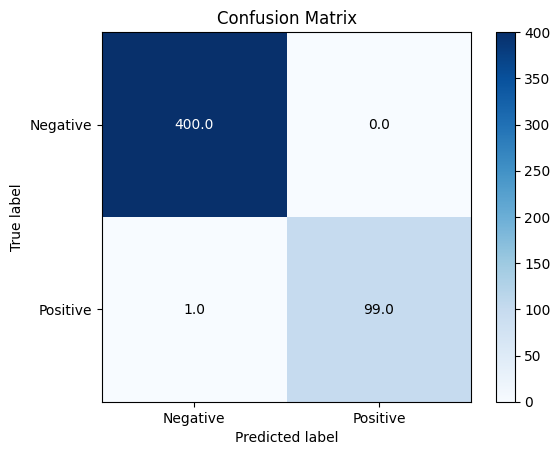

F1 Score: 0.9949748743718593
Accuracy: 0.998
Sensitivity: 0.9900000095367432
Specificity: 1.0


In [ ]:
X_train = halfadv_train_fixed_A[my_hook_name] #layernorm(halfadv_train_fixed_A[hook_name]).cpu()
X_val = halfadv_val_fixed_A[my_hook_name]
halfadv_hook_probe_A = LogisticRegression(random_state=0, max_iter=1000, penalty='l1', solver='saga').fit(X_train.cpu(), halfadv_train_fixed_labels_A[my_hook_name].cpu())
halfadv_on_nonadv_eval = evaluate_probe(halfadv_hook_probe_A, my_hook_name, 'sk', X_val.cpu(), halfadv_val_fixed_labels_A[my_hook_name], return_labels=True, print_stuff=True)

In [ ]:
xsp = torch.tensor(halfadv_hook_probe_A.coef_)

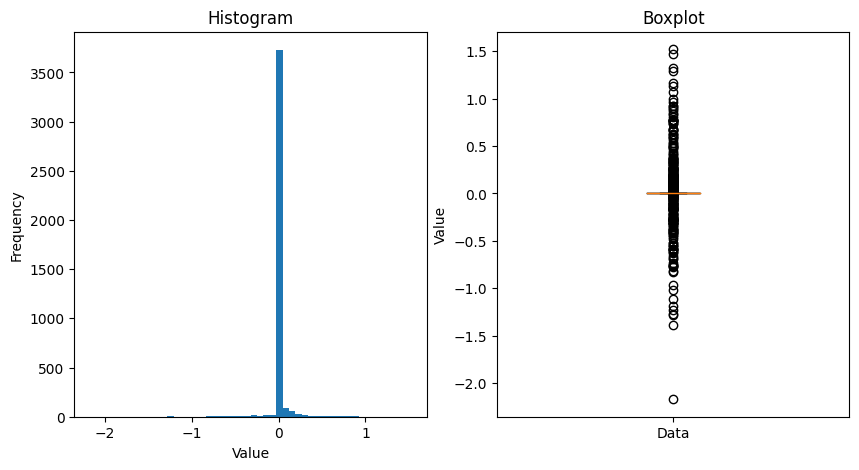

In [ ]:
hist_and_box(xsp)

In [ ]:
xsp.median()

tensor(0., dtype=torch.float64)

In [ ]:
(xsp > 0.1).float().sum()

tensor(176.)

In [ ]:
halfadv_hook_probe_A.coef_

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim

# Generate some synthetic data for demonstration
torch.manual_seed(0)

X = halfadv_train_fixed_A[my_hook_name] #torch.randn(n_samples, n_features)
y = halfadv_train_fixed_labels_A[my_hook_name] #torch.randint(0, 2, (n_samples,))
n_samples, n_features = X.shape[0], X.shape[1]

# Define the logistic regression model with L1 regularization
class L1LogisticRegression(nn.Module):
    def __init__(self, input_dim):
        super(L1LogisticRegression, self).__init__()
        self.linear = nn.Linear(input_dim, 1)

    def forward(self, x):
        return torch.sigmoid(self.linear(x))

# Hyperparameters
learning_rate = 0.01
lambda_l1 = 0.1  # L1 regularization term
num_epochs = 100

# Initialize the model
model = L1LogisticRegression(n_features)
criterion = nn.BCELoss()  # Binary Cross Entropy Loss
optimizer = optim.SGD(model.parameters(), lr=learning_rate)

# Training loop
for epoch in range(num_epochs):
    # Forward pass
    outputs = model(X).squeeze()
    loss = criterion(outputs, y.float())

    # L1 regularization term
    l1_reg = 0.0
    for param in model.parameters():
        l1_reg += torch.norm(param, 1)

    # Total loss
    loss += lambda_l1 * l1_reg

    # Backward pass and optimization
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()

    #hist_and_box(model.linear.weight)



    if (epoch+1) % 10 == 0:
        print(f'Epoch [{epoch+1}/{num_epochs}], Loss: {loss.item():.4f}')

print("Training complete.")


Epoch [10/100], Loss: 1.3493
Epoch [20/100], Loss: 0.8852
Epoch [30/100], Loss: 0.8843
Epoch [40/100], Loss: 0.8791
Epoch [50/100], Loss: 0.8755
Epoch [60/100], Loss: 0.8707
Epoch [70/100], Loss: 0.8662
Epoch [80/100], Loss: 0.8684
Epoch [90/100], Loss: 0.8664
Epoch [100/100], Loss: 0.8620
Training complete.


In [ ]:
model.linear.weight

Parameter containing:
tensor([[ 1.3655e-01,  1.1562e-04,  1.3764e-01, -2.2080e-04, -1.2228e-01]],
       requires_grad=True)

In [ ]:
torch.tensor(halfadv_hook_probe_A.coef_).shape

torch.Size([1, 4096])

# Zooming in - shortie probe

In [ ]:
print_bigram_id(my_bid)

NameError: ignored

In [ ]:
shortie_seq = torch.tensor([1511, 568])

In [ ]:
with torch.no_grad():
  shortie_logits, shortie_cache = model.run_with_cache(
    shortie_seq,
    prepend_bos=False,
    return_type="logits",
    stop_at_layer=2
  )

In [ ]:
shortie_cache['blocks.1.hook_resid_pre'].shape

torch.Size([1, 2, 1024])

In [ ]:
shortie_vec = shortie_cache['blocks.1.hook_resid_pre'][0,-1]

In [ ]:
shortie_vec

tensor([-0.0969, -0.2997,  0.3791,  ..., -0.4779, -0.1702,  0.0886],
       device='cuda:0')

In [ ]:
torch.norm(shortie_vec,dim=-1)

tensor(13.7343, device='cuda:0')

In [ ]:
get_similarity_cross(X_pos, shortie_vec.reshape(1,-1)).median(), get_similarity_cross(X_pos, shortie_vec.reshape(1,-1)).min()

(tensor(0.8942, device='cuda:0'), tensor(0.8305, device='cuda:0'))

In [ ]:
get_similarity_cross(X_neg2, shortie_vec.reshape(1,-1)).median()

tensor(0.8576, device='cuda:0')

In [ ]:
get_similarity_cross(X_neg1, shortie_vec.reshape(1,-1)).median(), get_similarity_cross(X_neg1, shortie_vec.reshape(1,-1)).max()

(tensor(0.6048, device='cuda:0'), tensor(0.7906, device='cuda:0'))

In [ ]:
cossim(X_pos.mean(dim=0), shortie_vec)

tensor([0.9170], device='cuda:0')

# LEACE - scaling

In [ ]:
X_train = halfadv_train_fixed_A[my_hook_name]
y_train = halfadv_train_fixed_labels_A[my_hook_name] #layernorm(halfadv_train_fixed_A[hook_name]).cpu()
X_val = halfadv_val_fixed_A[my_hook_name]
y_val = halfadv_val_fixed_labels_A[my_hook_name]

In [ ]:
len(X_train)

4000

In [ ]:
dset_idx_perm = torch.randperm(len(X_train))

In [ ]:
eval_dict_list = []
a_size_max = 3000
b_size = len(X_train) - a_size_max
print('asizemax', a_size_max)
print('bsize', b_size)
for a_size in tqdm(range(10,a_size_max,10)):
  dset_idx_a = dset_idx_perm[:a_size] #[:len(X_train)//2]
  dset_idx_b = dset_idx_perm[len(X_train)-b_size:]

  X_train_a = X_train[dset_idx_a]
  y_train_a = y_train[dset_idx_a]
  X_train_b = X_train[dset_idx_b]
  y_train_b = y_train[dset_idx_b]

  eval_dict = {}

  eval_dict['dset_idx_a'] = dset_idx_a
  eval_dict['dset_idx_b'] = dset_idx_b
  eval_dict['a_size'] = a_size
  eval_dict['dset_idx_perm'] = dset_idx_perm

  Ca = LogisticRegression(random_state=0,max_iter=10000).fit(X_train_a.cpu(), y_train_a.cpu())
  eraser_A = LeaceEraser.fit(X_train_a, y_train_a)
  X_train_a_erasedA = eraser_A(X_train_a)
  X_train_b_erasedA = eraser_A(X_train_b)
  X_val_erasedA = eraser_A(X_val)
  Cb = LogisticRegression(random_state=0,max_iter=10000).fit(X_train_b_erasedA, y_train_b)

  eval_dict['Ca_X_train_a'] = eval_probe_on_val(Ca, X_train_a, y_train_a)
  eval_dict['Ca_X_val'] = eval_probe_on_val(Ca, X_val, y_val)
  eval_dict['Ca_X_train_b'] = eval_probe_on_val(Ca, X_train_b, y_train_b)
  eval_dict['Ca_X_train_b_erasedA'] = eval_probe_on_val(Ca, X_train_b_erasedA, y_train_b)
  eval_dict['Ca_X_train_a_erasedA'] = eval_probe_on_val(Ca, X_train_a_erasedA, y_train_a)
  eval_dict['Ca_X_val_erasedA'] = eval_probe_on_val(Ca, X_val_erasedA, y_val)

  eval_dict['Cb_X_train_a'] = eval_probe_on_val(Cb, X_train_a, y_train_a)
  eval_dict['Cb_X_val'] = eval_probe_on_val(Cb, X_val, y_val)
  eval_dict['Cb_X_train_b'] = eval_probe_on_val(Cb, X_train_b, y_train_b)
  eval_dict['Cb_X_train_b_erasedA'] = eval_probe_on_val(Cb, X_train_b_erasedA, y_train_b)
  eval_dict['Cb_X_train_a_erasedA'] = eval_probe_on_val(Cb, X_train_a_erasedA, y_train_a)
  eval_dict['Cb_X_val_erasedA'] = eval_probe_on_val(Cb, X_val_erasedA, y_val)

  eval_dict_list.append(eval_dict)

asizemax 3000
bsize 1000


100%|██████████| 299/299 [04:14<00:00,  1.18it/s]


In [ ]:
gamma_df = pd.DataFrame([eval_dict['Cb_X_train_b_erasedA'] for eval_dict in eval_dict_list])

In [ ]:
omega_df = pd.DataFrame([eval_dict['Cb_X_val_erasedA'] for eval_dict in eval_dict_list])

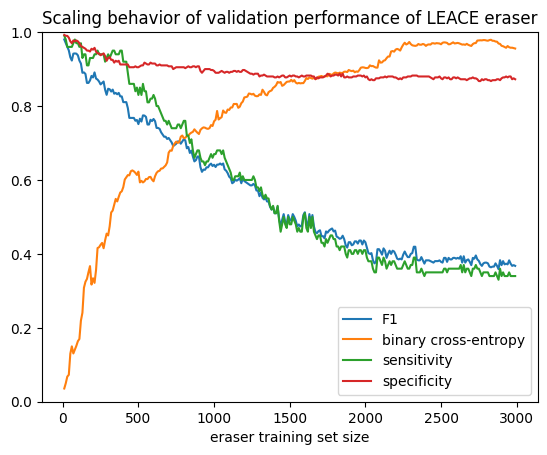

In [ ]:
a_sizes = [eval_dict['a_size'] for eval_dict in eval_dict_list]
plt.plot(a_sizes,omega_df['f1'],label='F1')
plt.plot(a_sizes,omega_df['nll'],label='binary cross-entropy')
plt.plot(a_sizes,omega_df['sensitivity'],label='sensitivity')
plt.plot(a_sizes,omega_df['specificity'],label='specificity')
plt.ylim((0,1))
plt.legend()
plt.xlabel('eraser training set size')
plt.title('Scaling behavior of validation performance of LEACE eraser')
plt.savefig('leace_scaling1.png',dpi=300)

# Target consolidation

In [ ]:
logsoftmax = torch.nn.LogSoftmax(dim=-1)

In [ ]:
from tuned_lens import TunedLens

from transformers import AutoModelForCausalLM
model_nolens = AutoModelForCausalLM.from_pretrained('EleutherAI/pythia-410m-deduped-v0')

tuned_lens = TunedLens.from_model_and_pretrained(model_nolens)


In [ ]:
def project_out(value, xlr):
    projection = torch.matmul(value, xlr.unsqueeze(1)) * xlr
    return value - projection
def project_and_adjust(value, xlr, t):
    # Project out xlr from each row in value
    projection = torch.matmul(value, xlr.unsqueeze(-1)) * xlr
    projected_value = value - projection
    # Shift the projected vectors so that their dot product with xlr is t
    shift = t * xlr
    shifted_value = projected_value + shift
    return shifted_value
def projadj_hook_fc(value, hook):
  lastpos_values = value[:,-1,:]
  #print('lastposvalues', lastpos_values.shape)
  lastpos_values_projadj = project_and_adjust(lastpos_values, xlr, pos_mda)
  #print('pa ', value[:,-1,:].shape, lastpos_values_projadj.shape)
  value[:,-1,:] = lastpos_values_projadj
  return value
current_values_dict = {}
def cache_lastpos_hook_fc(value, hook):
  #print('cachinglast', hook.name)
  global current_values_dict
  current_values_dict[hook.name] = value[:,-1].cpu()
  #print('cached', hook.name)
  return value

In [ ]:
def get_next(dset, id):
  tok_row = dset.data[id]
  id_seq, id_pos = tok_row[0].item(), tok_row[1].item()
  seq = occ_to_seq(TL, (id_seq, id_pos))
  id_a, id_b = seq[-2].item(), seq[-1].item()
  id_next = TL[id_seq,id_pos+2].item()
  return id_next

In [ ]:
def get_pos_ids_subset(dset_dict, target_i):
  pos_ids_subset = []
  for id in range(800):
    if get_next(dset_dict['train_dset'],id) == target_i:
      pos_ids_subset.append(id)
  return torch.tensor(pos_ids_subset)

bid 0
tensor(3.9641, device='cuda:0') tensor(-0.1954, device='cuda:0')


80it [00:05, 13.99it/s]
80it [00:04, 16.48it/s]


tensor([187, 187]) '\n\n' '\n' '\n'


100%|██████████| 5/5 [00:07<00:00,  1.48s/it]


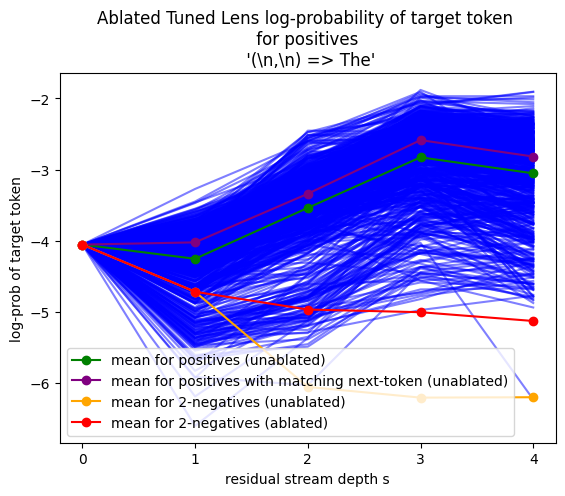

ratio tensor(0.4322)
bid 1
tensor(2.0066, device='cuda:0') tensor(0.0914, device='cuda:0')


80it [00:05, 14.20it/s]
80it [00:04, 16.29it/s]


tensor([ 15, 187]) '.\n' '.' '\n'


100%|██████████| 5/5 [00:07<00:00,  1.56s/it]


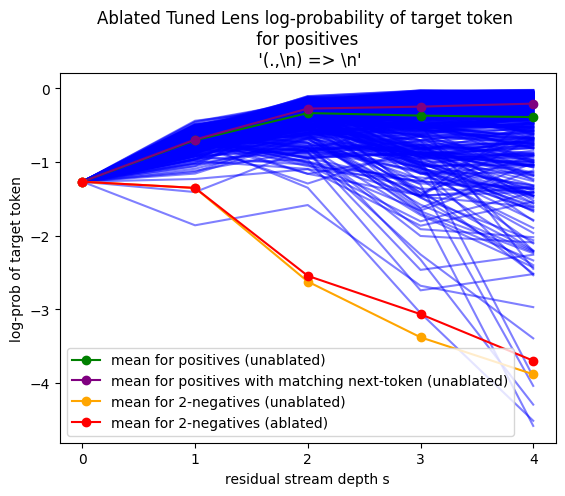

ratio tensor(0.0341)
bid 3
tensor(7.6632, device='cuda:0') tensor(5.0562, device='cuda:0')


80it [00:05, 14.22it/s]
80it [00:04, 16.44it/s]


tensor([275, 253]) ' in the' ' in' ' the'


100%|██████████| 5/5 [00:07<00:00,  1.46s/it]


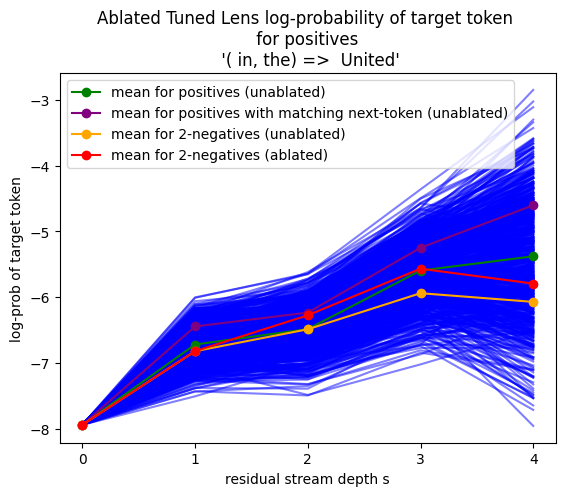

ratio tensor(90.2495)
bid 6
tensor(4.2691, device='cuda:0') tensor(-0.2993, device='cuda:0')


80it [00:05, 14.33it/s]
80it [00:04, 16.50it/s]


tensor([457,  84]) '’s' '’' 's'


100%|██████████| 5/5 [00:05<00:00,  1.17s/it]


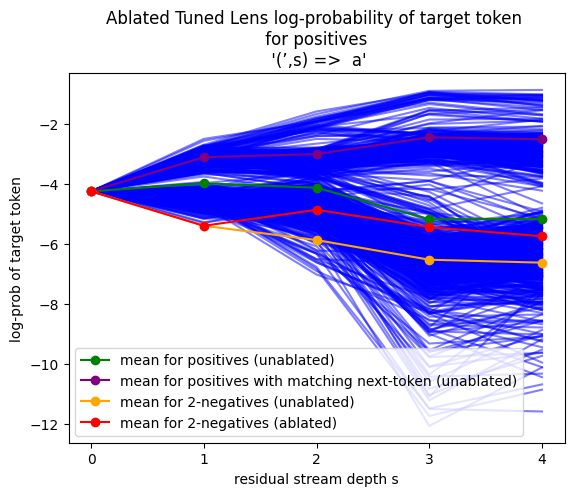

ratio tensor(0.5783)
bid 7
tensor(5.7272, device='cuda:0') tensor(3.4491, device='cuda:0')


80it [00:05, 14.30it/s]
80it [00:04, 16.38it/s]


tensor([281, 253]) ' to the' ' to' ' the'


100%|██████████| 5/5 [00:07<00:00,  1.49s/it]


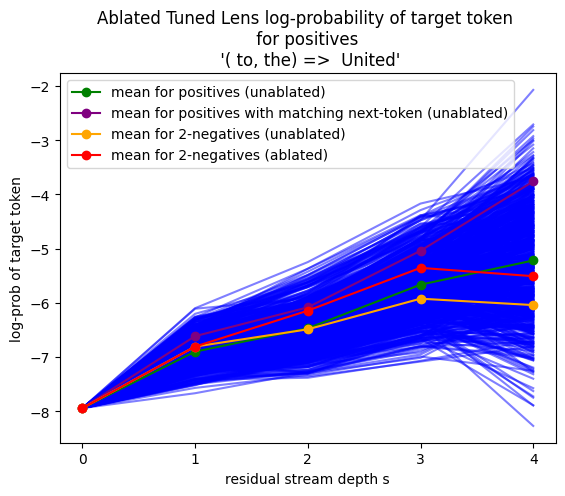

ratio tensor(18.8086)
bid 13
tensor(2.7292, device='cuda:0') tensor(0.8917, device='cuda:0')


80it [00:05, 14.44it/s]
80it [00:04, 16.46it/s]


tensor([ 28, 187]) ';\n' ';' '\n'


100%|██████████| 5/5 [00:07<00:00,  1.52s/it]


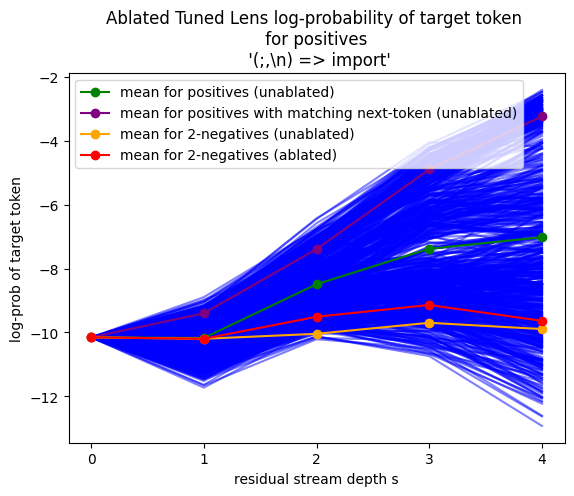

ratio tensor(0.3443)
bid 14
tensor(6.5900, device='cuda:0') tensor(4.5271, device='cuda:0')


80it [00:05, 14.35it/s]
80it [00:04, 16.64it/s]


tensor([327, 253]) ' on the' ' on' ' the'


100%|██████████| 5/5 [00:07<00:00,  1.46s/it]


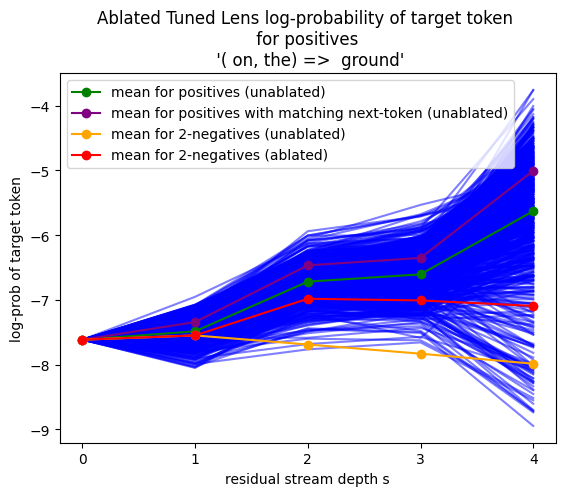

ratio tensor(0.7281)
bid 16
tensor(3.4066, device='cuda:0') tensor(1.1845, device='cuda:0')


80it [00:05, 14.32it/s]
80it [00:04, 16.48it/s]


tensor([  187, 50276]) '\n  ' '\n' '  '


100%|██████████| 5/5 [00:07<00:00,  1.44s/it]


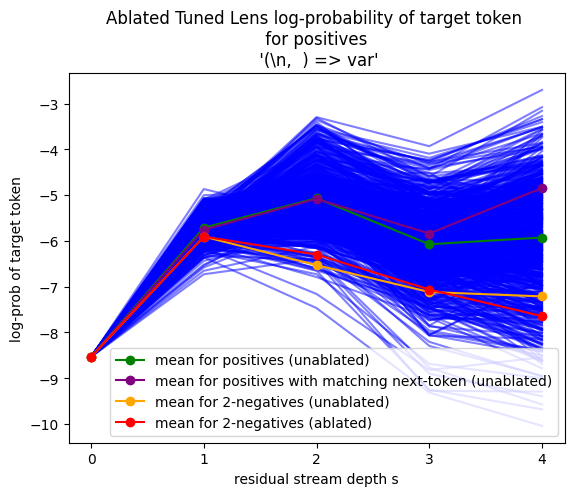

ratio tensor(0.1586)
bid 20
tensor(7.0843, device='cuda:0') tensor(3.7792, device='cuda:0')


80it [00:05, 14.32it/s]
80it [00:04, 16.45it/s]


tensor([285, 253]) ' and the' ' and' ' the'


100%|██████████| 5/5 [00:06<00:00,  1.20s/it]


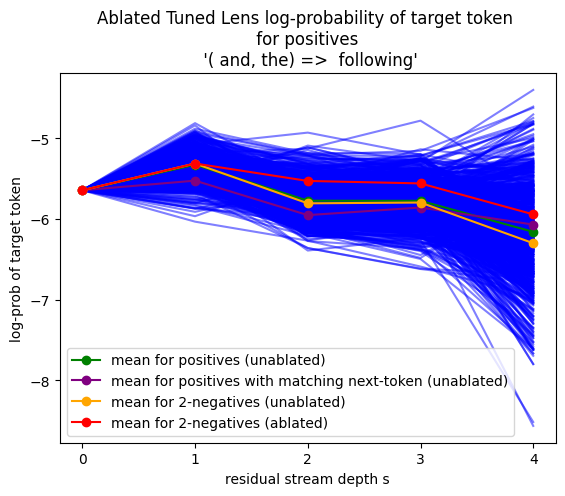

ratio tensor(8.4866)
bid 25
tensor(4.0471, device='cuda:0') tensor(2.0595, device='cuda:0')


80it [00:05, 14.26it/s]
80it [00:04, 16.46it/s]


tensor([310, 247]) ' is a' ' is' ' a'


100%|██████████| 5/5 [00:06<00:00,  1.40s/it]


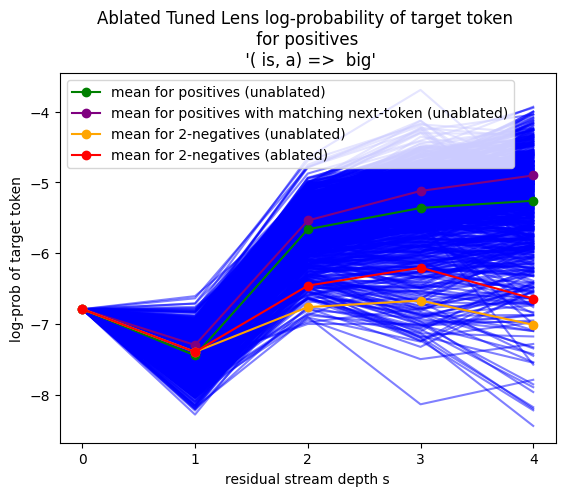

ratio tensor(0.2755)
bid 27
tensor(7.0427, device='cuda:0') tensor(4.3845, device='cuda:0')


80it [00:05, 14.26it/s]
80it [00:04, 16.39it/s]


tensor([342, 253]) ' with the' ' with' ' the'


100%|██████████| 5/5 [00:07<00:00,  1.48s/it]


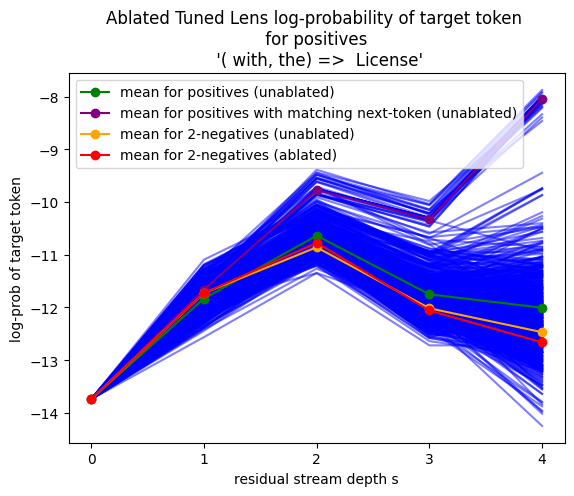

ratio tensor(0.3847)
bid 28
tensor(4.6033, device='cuda:0') tensor(2.2245, device='cuda:0')


80it [00:05, 14.29it/s]
80it [00:04, 16.39it/s]


tensor([310, 253]) ' is the' ' is' ' the'


100%|██████████| 5/5 [00:07<00:00,  1.48s/it]


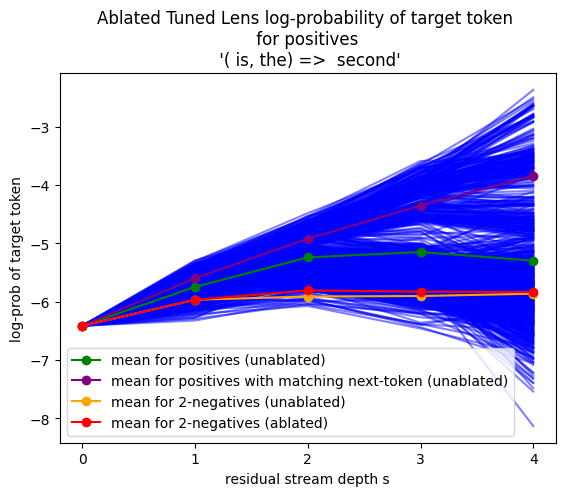

ratio tensor(0.1555)
bid 30
tensor(7.9201, device='cuda:0') tensor(4.9084, device='cuda:0')


80it [00:05, 14.34it/s]
80it [00:04, 16.40it/s]


tensor([387, 253]) ' at the' ' at' ' the'


100%|██████████| 5/5 [00:06<00:00,  1.29s/it]


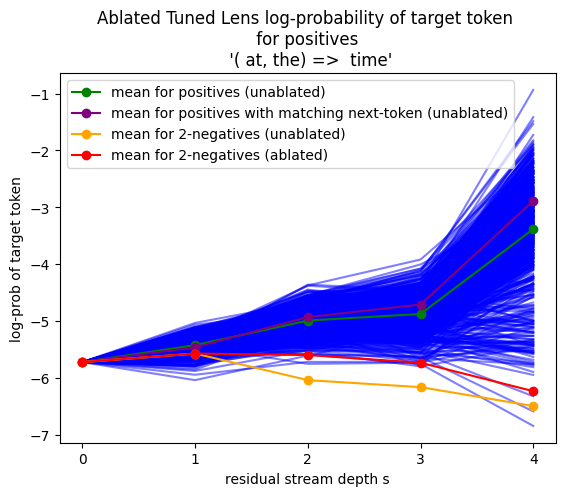

ratio tensor(0.4212)
bid 32
tensor(6.4546, device='cuda:0') tensor(4.2704, device='cuda:0')


80it [00:05, 14.34it/s]
80it [00:04, 16.42it/s]


tensor([432, 253]) ' from the' ' from' ' the'


100%|██████████| 5/5 [00:06<00:00,  1.27s/it]


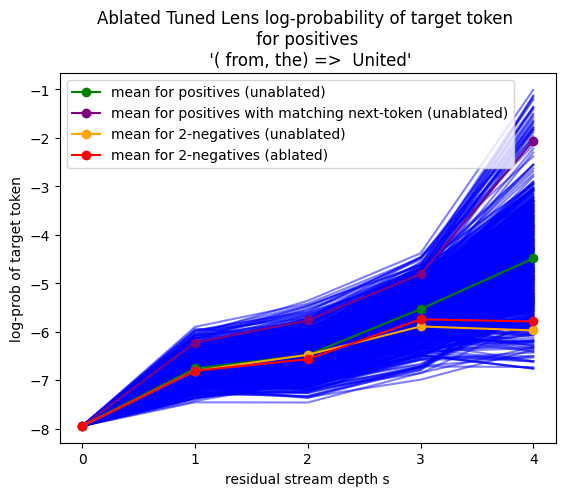

ratio tensor(21.5105)
bid 34
tensor(3.1317, device='cuda:0') tensor(0.9216, device='cuda:0')


80it [00:05, 14.21it/s]
80it [00:04, 16.41it/s]


tensor([ 13, 247]) ', a' ',' ' a'


100%|██████████| 5/5 [00:06<00:00,  1.25s/it]


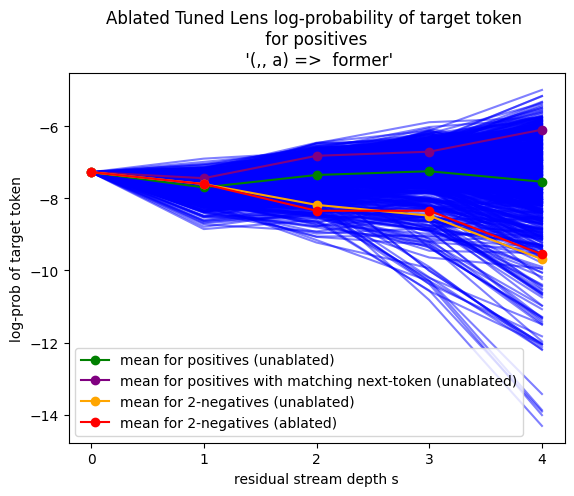

ratio tensor(-0.1975)
bid 35
tensor(5.6499, device='cuda:0') tensor(3.3842, device='cuda:0')


80it [00:05, 14.29it/s]
80it [00:04, 16.38it/s]


tensor([275, 247]) ' in a' ' in' ' a'


100%|██████████| 5/5 [00:06<00:00,  1.40s/it]


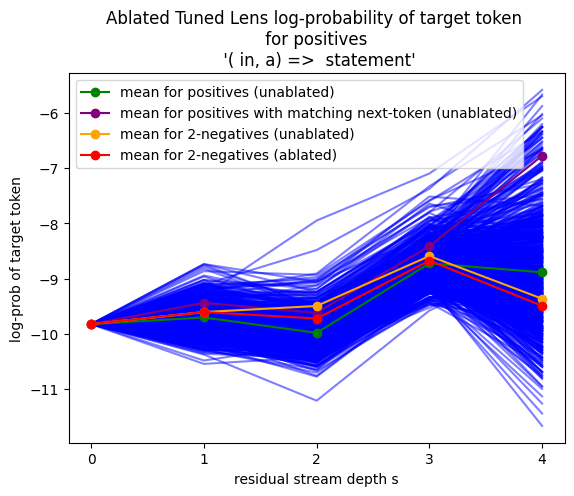

ratio tensor(0.4661)
bid 38
tensor(5.3859, device='cuda:0') tensor(0.2395, device='cuda:0')


80it [00:05, 14.34it/s]
80it [00:04, 16.49it/s]


tensor([457,  85]) '’t' '’' 't'


100%|██████████| 5/5 [00:06<00:00,  1.39s/it]


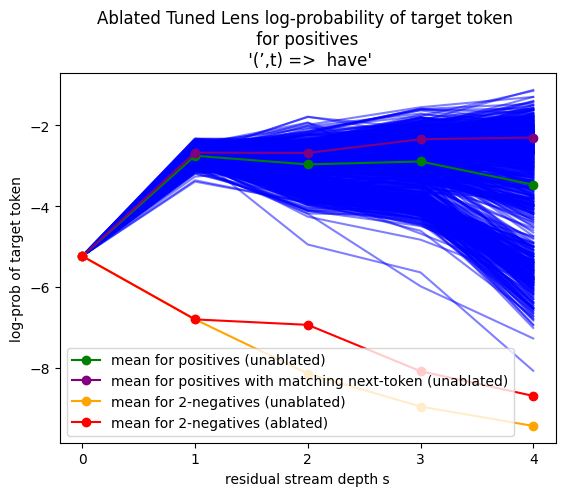

ratio tensor(0.2331)
bid 40
tensor(3.6893, device='cuda:0') tensor(1.4708, device='cuda:0')


80it [00:05, 14.33it/s]
80it [00:04, 16.41it/s]


tensor([187, 186]) '\n\t' '\n' '\t'


100%|██████████| 5/5 [00:06<00:00,  1.20s/it]


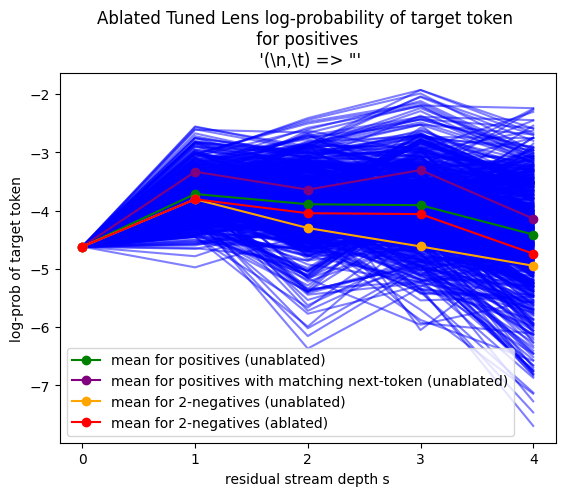

ratio tensor(0.6213)
bid 41
tensor(7.8964, device='cuda:0') tensor(4.8341, device='cuda:0')


80it [00:05, 14.17it/s]
80it [00:04, 16.41it/s]


tensor([326, 253]) ' that the' ' that' ' the'


100%|██████████| 5/5 [00:06<00:00,  1.25s/it]


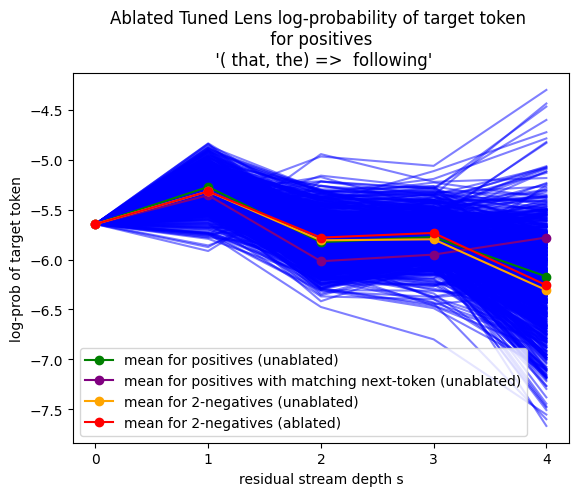

ratio tensor(-1.4953)
bid 44
tensor(4.1764, device='cuda:0') tensor(0.3144, device='cuda:0')


80it [00:05, 14.25it/s]
80it [00:04, 16.47it/s]


tensor([449, 346]) '." "' '."' ' "'


100%|██████████| 5/5 [00:06<00:00,  1.39s/it]


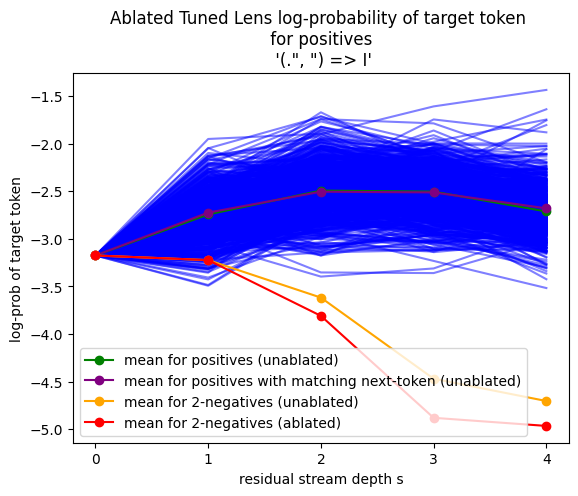

ratio tensor(-0.1705)
bid 45
tensor(7.0124, device='cuda:0') tensor(3.9067, device='cuda:0')


80it [00:05, 14.23it/s]
80it [00:04, 16.46it/s]


tensor([347, 247]) ' as a' ' as' ' a'


100%|██████████| 5/5 [00:06<00:00,  1.32s/it]


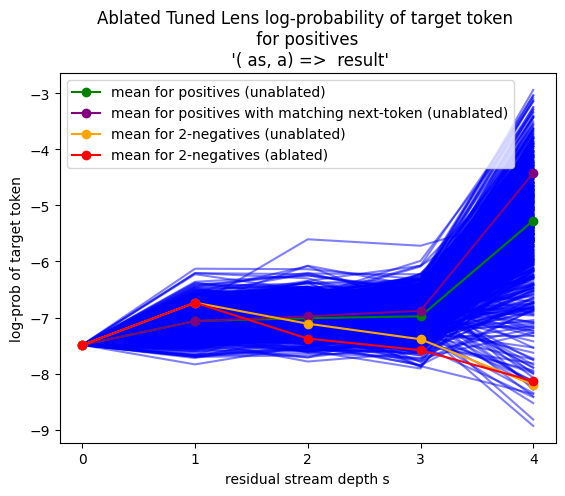

ratio tensor(-2.6966)
bid 46
tensor(6.3670, device='cuda:0') tensor(4.0689, device='cuda:0')


80it [00:05, 14.49it/s]
80it [00:04, 16.51it/s]


tensor([407, 253]) ' by the' ' by' ' the'


100%|██████████| 5/5 [00:07<00:00,  1.52s/it]


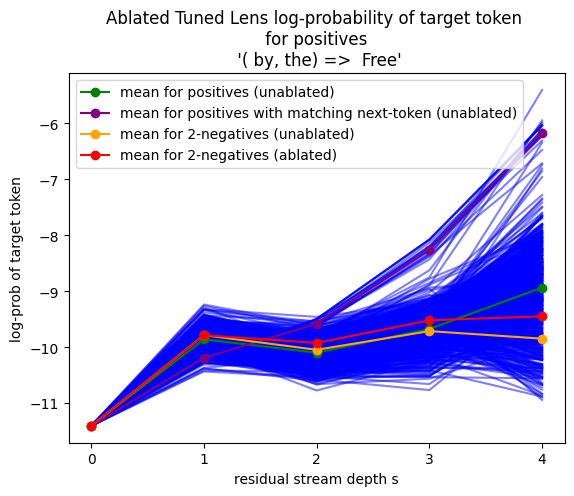

ratio tensor(-2.3360)
bid 49
tensor(7.4337, device='cuda:0') tensor(2.7691, device='cuda:0')


80it [00:05, 14.15it/s]
80it [00:04, 16.43it/s]


tensor([187,  14]) '\n-' '\n' '-'


100%|██████████| 5/5 [00:06<00:00,  1.23s/it]


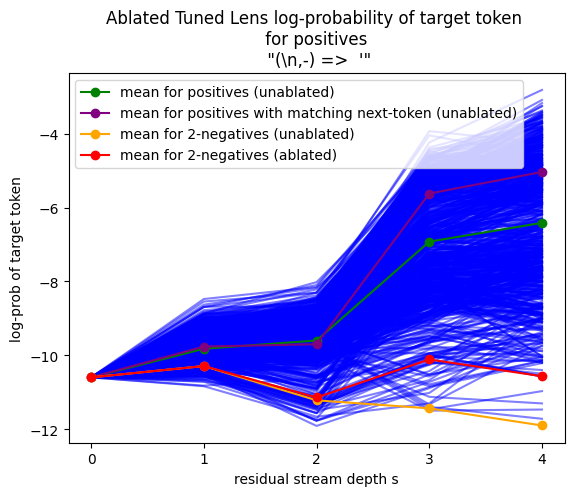

ratio tensor(0.0473)
bid 50
tensor(3.4705, device='cuda:0') tensor(1.3043, device='cuda:0')


80it [00:05, 14.32it/s]
80it [00:04, 16.53it/s]


tensor([ 13, 352]) ', it' ',' ' it'


100%|██████████| 5/5 [00:06<00:00,  1.31s/it]


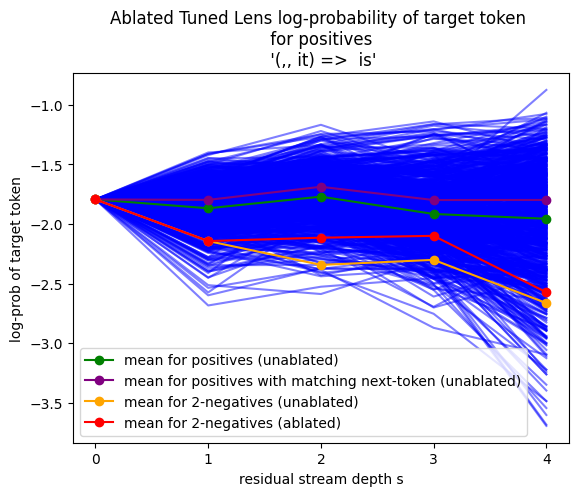

ratio tensor(0.3985)
bid 51
tensor(3.2062, device='cuda:0') tensor(1.1062, device='cuda:0')


80it [00:05, 14.17it/s]
80it [00:04, 16.42it/s]


tensor([  3, 187]) '"\n' '"' '\n'


100%|██████████| 5/5 [00:06<00:00,  1.37s/it]


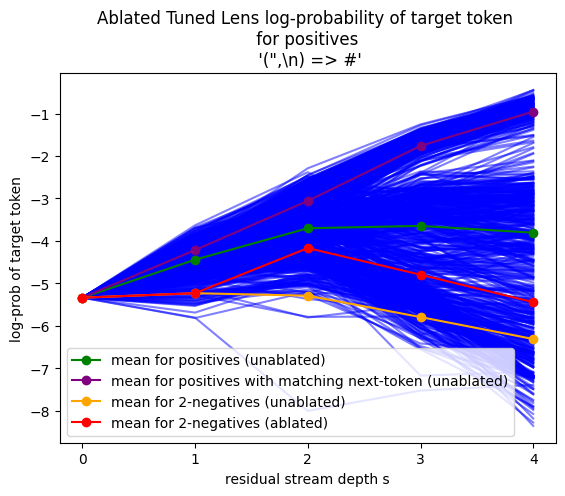

ratio tensor(0.7060)
bid 52
tensor(5.2179, device='cuda:0') tensor(2.1361, device='cuda:0')


80it [00:05, 14.43it/s]
80it [00:04, 16.53it/s]


tensor([187, 605]) '\n//' '\n' '//'


100%|██████████| 5/5 [00:06<00:00,  1.23s/it]


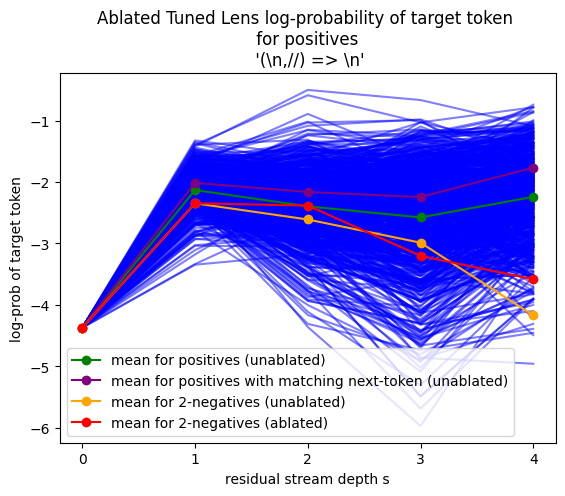

ratio tensor(1.0575)
bid 55
tensor(5.4202, device='cuda:0') tensor(2.1379, device='cuda:0')


80it [00:05, 14.30it/s]
80it [00:04, 16.45it/s]


tensor([187,  34]) '\nA' '\n' 'A'


100%|██████████| 5/5 [00:06<00:00,  1.25s/it]


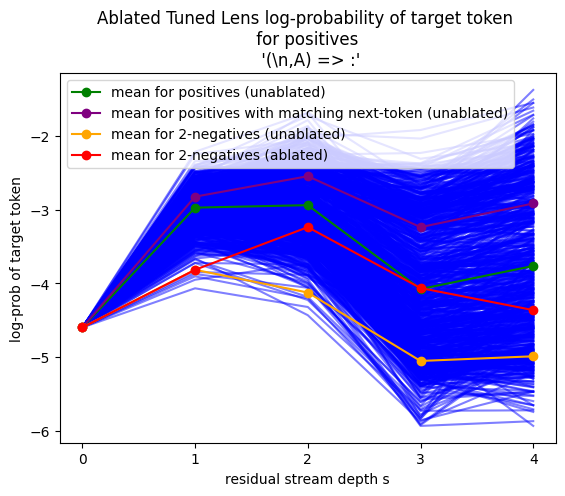

ratio tensor(0.7483)
bid 57
tensor(3.4756, device='cuda:0') tensor(1.4162, device='cuda:0')


80it [00:05, 14.28it/s]
80it [00:04, 16.40it/s]


tensor([   15, 50276]) '.  ' '.' '  '


100%|██████████| 5/5 [00:07<00:00,  1.44s/it]


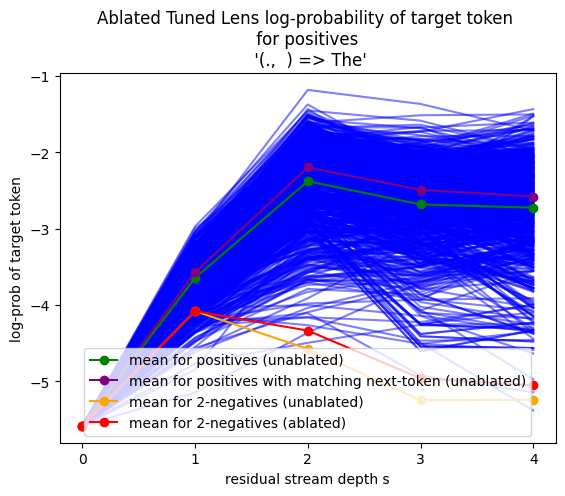

ratio tensor(0.1093)
bid 68
tensor(4.7437, device='cuda:0') tensor(0.8730, device='cuda:0')


80it [00:05, 14.30it/s]
80it [00:04, 16.42it/s]


tensor([187,   3]) '\n"' '\n' '"'


100%|██████████| 5/5 [00:07<00:00,  1.42s/it]


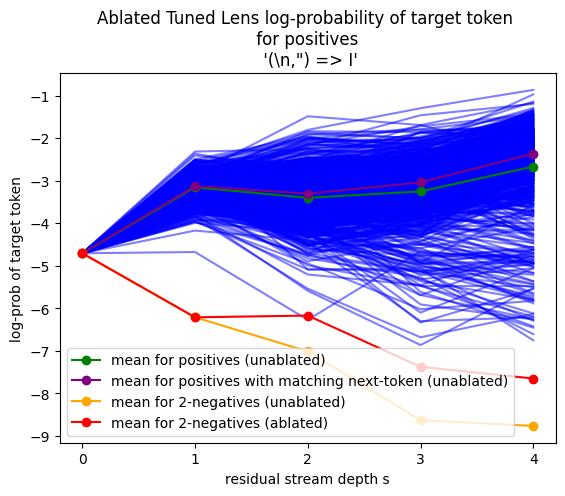

ratio tensor(0.2334)
bid 73
tensor(6.6621, device='cuda:0') tensor(2.1096, device='cuda:0')


80it [00:05, 14.30it/s]
80it [00:04, 16.41it/s]


tensor([15, 52]) '.S' '.' 'S'


100%|██████████| 5/5 [00:06<00:00,  1.22s/it]


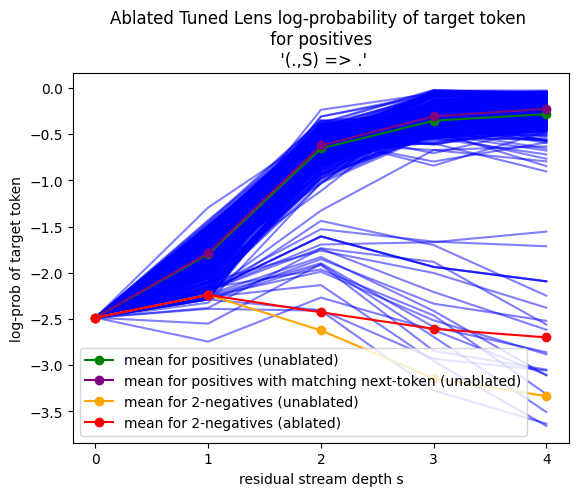

ratio tensor(0.0994)
bid 74
tensor(3.2546, device='cuda:0') tensor(0.9153, device='cuda:0')


80it [00:05, 14.32it/s]
80it [00:04, 16.46it/s]


tensor([18, 15]) '1.' '1' '.'


100%|██████████| 5/5 [00:06<00:00,  1.29s/it]


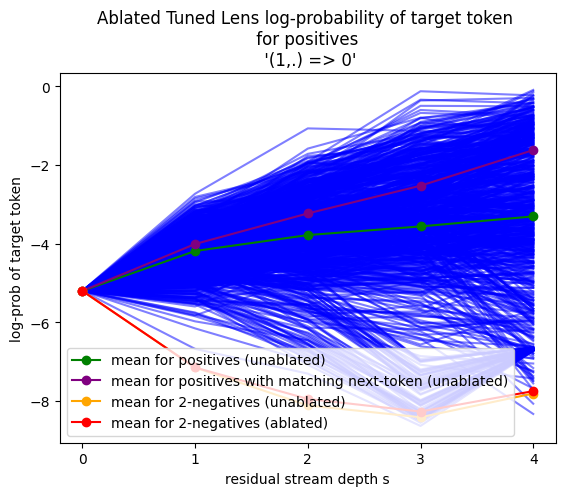

ratio tensor(0.0383)
bid 75
tensor(6.0249, device='cuda:0') tensor(2.4933, device='cuda:0')


80it [00:05, 14.19it/s]
80it [00:04, 16.42it/s]


tensor([581, 273]) ' one of' ' one' ' of'


100%|██████████| 5/5 [00:06<00:00,  1.24s/it]


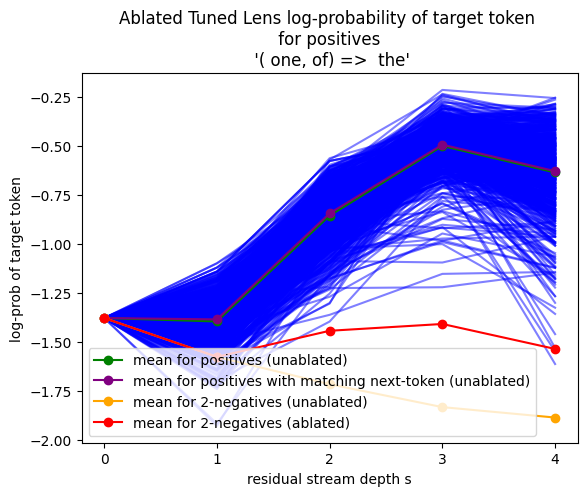

ratio tensor(0.3170)
bid 76
tensor(7.3727, device='cuda:0') tensor(4.6721, device='cuda:0')


80it [00:05, 14.28it/s]
80it [00:04, 16.47it/s]


tensor([347, 253]) ' as the' ' as' ' the'


100%|██████████| 5/5 [00:06<00:00,  1.37s/it]


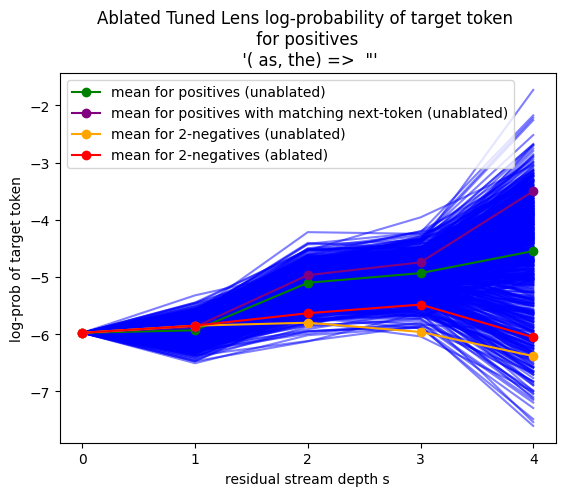

ratio tensor(0.2371)
bid 77
tensor(2.6768, device='cuda:0') tensor(0.9201, device='cuda:0')


80it [00:05, 14.37it/s]
80it [00:04, 16.50it/s]


tensor([253, 806]) ' the first' ' the' ' first'


100%|██████████| 5/5 [00:07<00:00,  1.52s/it]


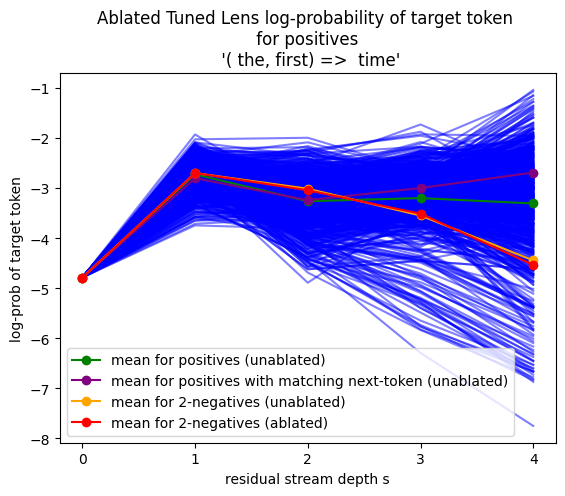

ratio tensor(0.1228)
bid 78
tensor(4.4006, device='cuda:0') tensor(1.0805, device='cuda:0')


80it [00:05, 14.34it/s]
80it [00:04, 16.40it/s]


tensor([52, 15]) 'S.' 'S' '.'


100%|██████████| 5/5 [00:06<00:00,  1.27s/it]


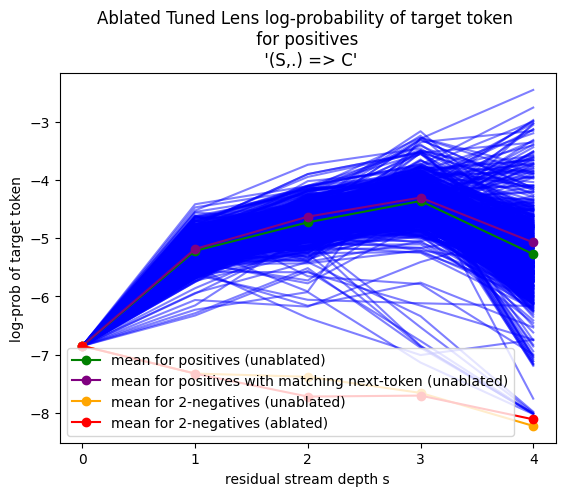

ratio tensor(-0.1284)
bid 80
tensor(5.5573, device='cuda:0') tensor(2.5898, device='cuda:0')


80it [00:05, 14.31it/s]
80it [00:04, 16.49it/s]


tensor([285, 247]) ' and a' ' and' ' a'


100%|██████████| 5/5 [00:06<00:00,  1.23s/it]


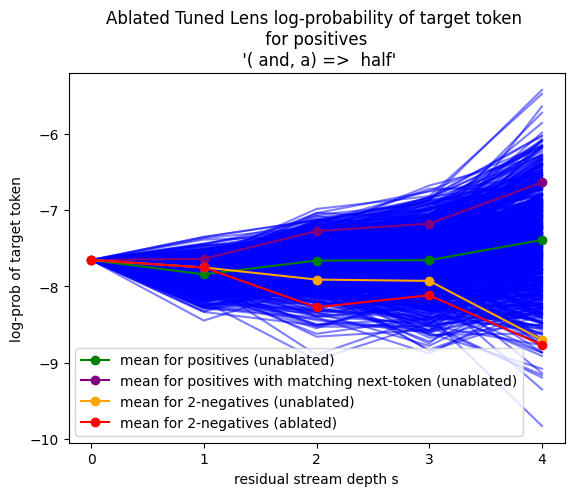

ratio tensor(-1.4531)
bid 86
tensor(4.2329, device='cuda:0') tensor(0.9682, device='cuda:0')


80it [00:05, 14.21it/s]
80it [00:04, 16.48it/s]


tensor([17, 15]) '0.' '0' '.'


100%|██████████| 5/5 [00:06<00:00,  1.22s/it]


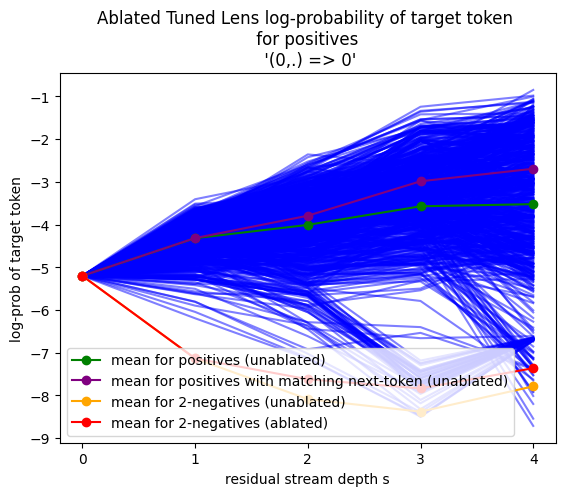

ratio tensor(0.1143)
bid 87
tensor(5.1479, device='cuda:0') tensor(1.8469, device='cuda:0')


80it [00:05, 14.20it/s]
80it [00:04, 16.50it/s]


tensor([ 92, 187]) '{\n' '{' '\n'


100%|██████████| 5/5 [00:06<00:00,  1.35s/it]


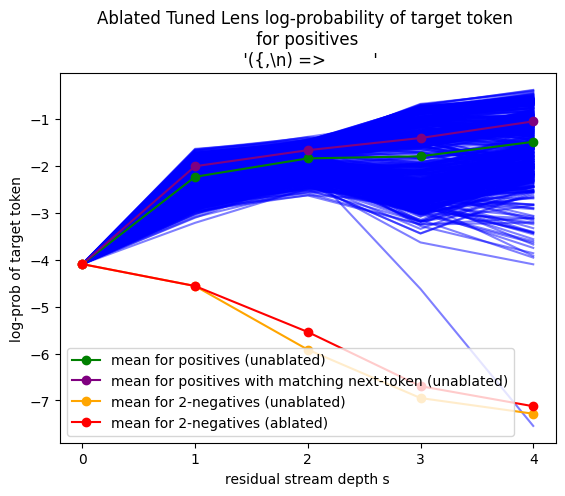

ratio tensor(0.0925)
bid 94
tensor(3.0150, device='cuda:0') tensor(0.8348, device='cuda:0')


80it [00:05, 14.29it/s]
80it [00:04, 16.45it/s]


tensor([ 13, 368]) ', you' ',' ' you'


100%|██████████| 5/5 [00:07<00:00,  1.55s/it]


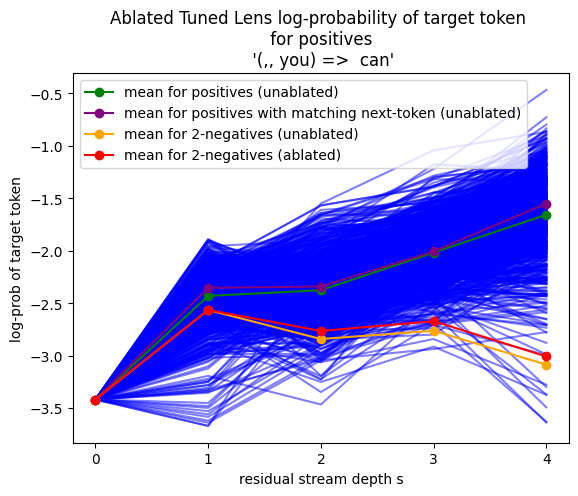

ratio tensor(0.1649)
bid 95
tensor(2.9871, device='cuda:0') tensor(1.1683, device='cuda:0')


80it [00:05, 14.24it/s]
80it [00:04, 16.39it/s]


tensor([19, 15]) '2.' '2' '.'


100%|██████████| 5/5 [00:07<00:00,  1.46s/it]


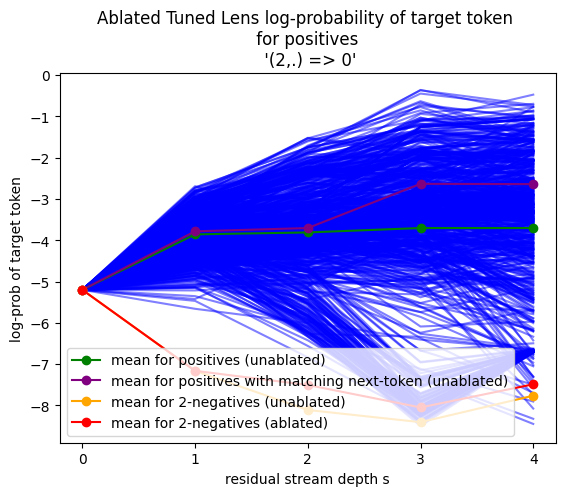

ratio tensor(0.1408)
bid 97
tensor(7.2558, device='cuda:0') tensor(2.2811, device='cuda:0')


80it [00:05, 14.34it/s]
80it [00:04, 16.44it/s]


tensor([15, 73]) '.h' '.' 'h'


100%|██████████| 5/5 [00:07<00:00,  1.53s/it]


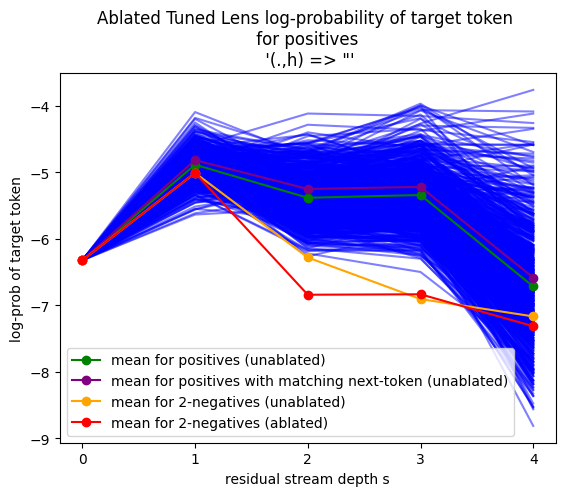

ratio tensor(-0.6234)
bid 99
tensor(4.4850, device='cuda:0') tensor(1.9740, device='cuda:0')


80it [00:05, 14.28it/s]
80it [00:04, 16.44it/s]


tensor([187,  29]) '\n<' '\n' '<'


100%|██████████| 5/5 [00:06<00:00,  1.30s/it]


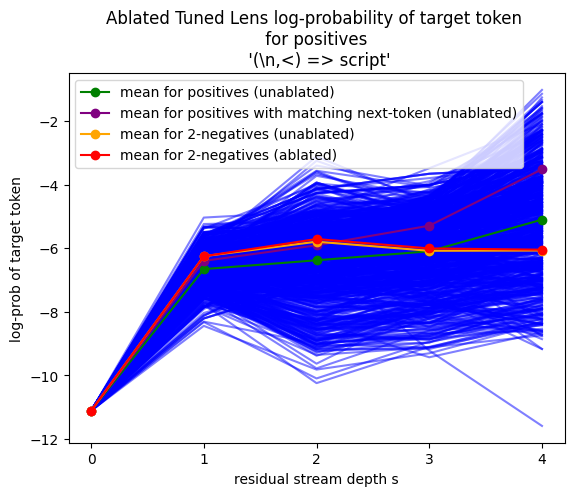

ratio tensor(-0.1430)
bid 104
tensor(5.7118, device='cuda:0') tensor(3.4846, device='cuda:0')


80it [00:05, 14.20it/s]
80it [00:04, 16.50it/s]


tensor([327, 247]) ' on a' ' on' ' a'


100%|██████████| 5/5 [00:06<00:00,  1.35s/it]


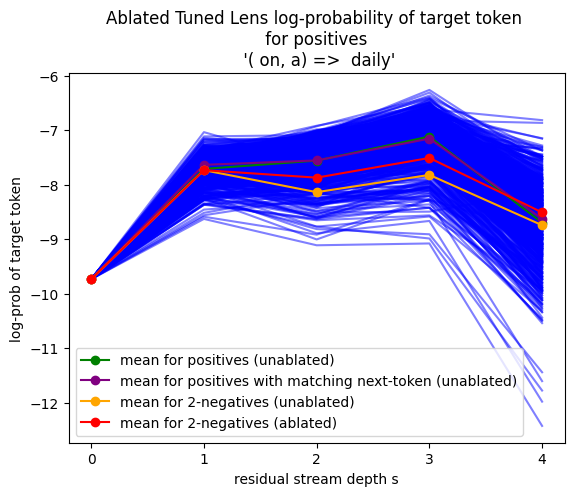

ratio tensor(0.4595)
bid 109
tensor(4.7333, device='cuda:0') tensor(2.7833, device='cuda:0')


80it [00:05, 14.19it/s]
80it [00:04, 16.52it/s]


tensor([452, 247]) ' have a' ' have' ' a'


100%|██████████| 5/5 [00:08<00:00,  1.63s/it]


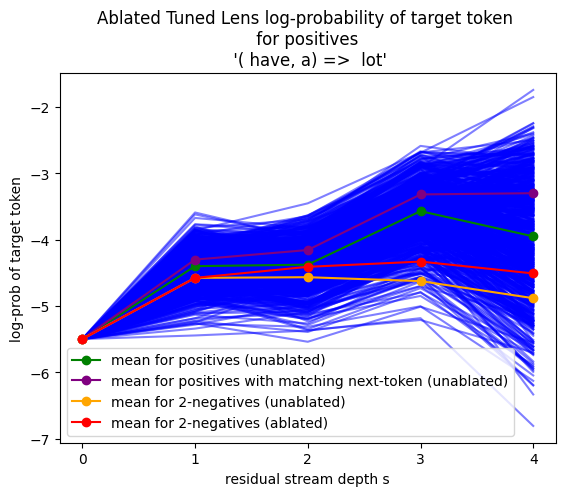

ratio tensor(0.8272)
bid 110
tensor(6.6344, device='cuda:0') tensor(1.7006, device='cuda:0')


80it [00:05, 14.29it/s]
80it [00:04, 16.51it/s]


tensor([424,  19]) '**2' '**' '2'


100%|██████████| 5/5 [00:06<00:00,  1.30s/it]


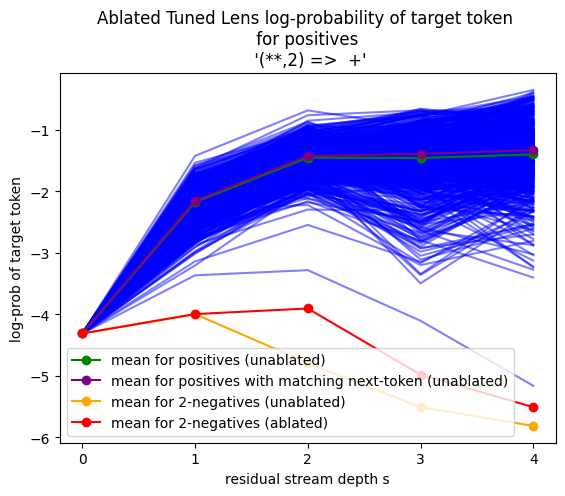

ratio tensor(0.2653)
bid 113
tensor(3.0753, device='cuda:0') tensor(1.2410, device='cuda:0')


80it [00:05, 14.20it/s]
80it [00:04, 16.50it/s]


tensor([368, 476]) ' you can' ' you' ' can'


100%|██████████| 5/5 [00:06<00:00,  1.26s/it]


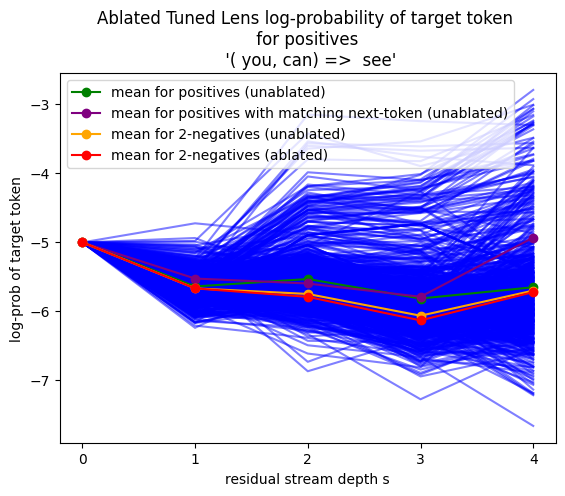

ratio tensor(-0.1957)
bid 115
tensor(5.8082, device='cuda:0') tensor(2.2239, device='cuda:0')


80it [00:05, 14.31it/s]
80it [00:04, 16.46it/s]


tensor([470,  15]) ' 0.' ' 0' '.'


100%|██████████| 5/5 [00:06<00:00,  1.22s/it]


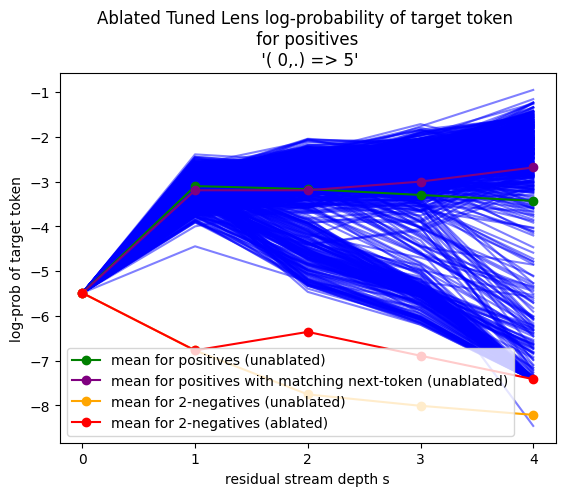

ratio tensor(0.3045)
bid 118
tensor(4.0395, device='cuda:0') tensor(2.0991, device='cuda:0')


80it [00:05, 14.24it/s]
80it [00:04, 16.49it/s]


tensor([369, 247]) ' was a' ' was' ' a'


100%|██████████| 5/5 [00:07<00:00,  1.48s/it]


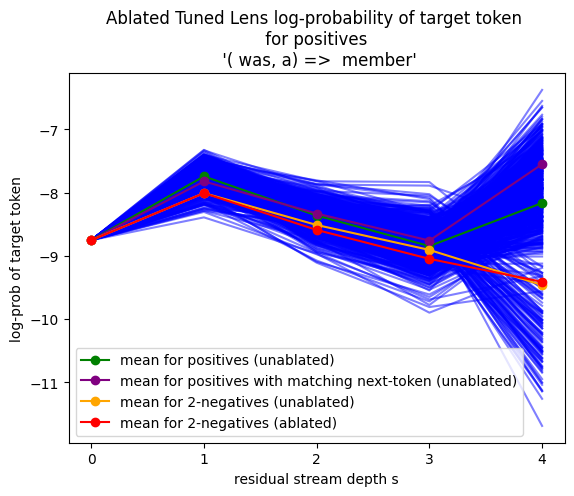

ratio tensor(-0.5223)
bid 119
tensor(10.5083, device='cuda:0') tensor(2.9168, device='cuda:0')


80it [00:05, 14.27it/s]
80it [00:04, 16.46it/s]


tensor([50, 27]) 'Q:' 'Q' ':'


100%|██████████| 5/5 [00:07<00:00,  1.58s/it]


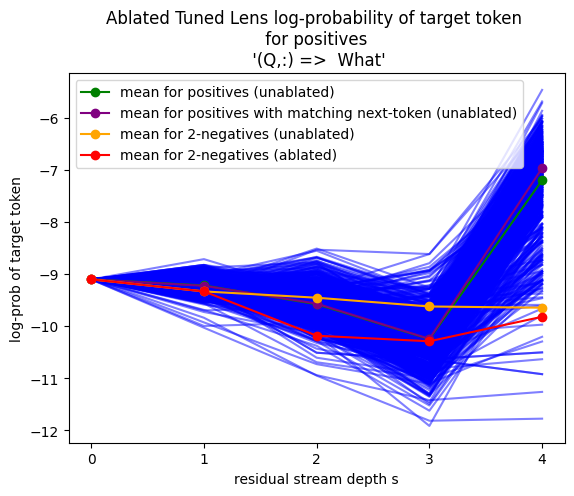

ratio tensor(5.8079)
bid 121
tensor(3.3107, device='cuda:0') tensor(1.0555, device='cuda:0')


80it [00:05, 14.23it/s]
80it [00:04, 16.42it/s]


tensor([ 13, 323]) ', for' ',' ' for'


100%|██████████| 5/5 [00:08<00:00,  1.66s/it]


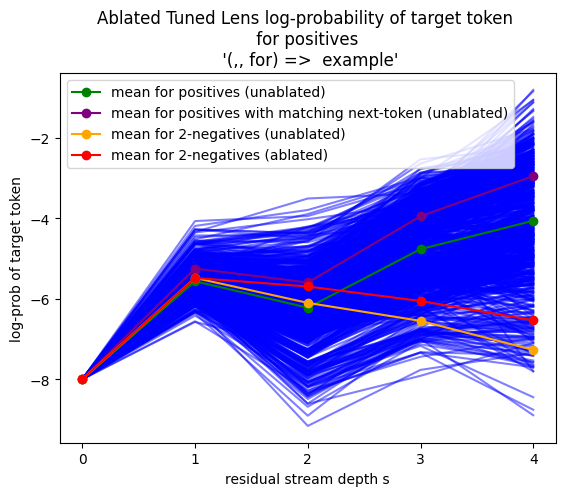

ratio tensor(-3.3782)
bid 128
tensor(5.0388, device='cuda:0') tensor(2.6198, device='cuda:0')


80it [00:05, 14.31it/s]
80it [00:04, 16.47it/s]


tensor([273, 436]) ' of this' ' of' ' this'


  0%|          | 0/5 [00:01<?, ?it/s]


KeyboardInterrupt: ignored

In [ ]:
for bid_consequent_dict in bid_consequent_elems:
  bid = bid_consequent_dict['bid']
  print('bid', bid)
  dset_dict = select_dset_dict_by_bigram_id(bid, some_resid_hooks)
  probes_dict = select_probes_by_dset_dict(dset_dict)
  hook = some_resid_hooks[1]
  xlr = F.normalize(get_logreg_weights_dict(dset_dict)[hook],dim=-1).reshape(-1).float() #F.normalize(torch.from_numpy(probes_dict[hook]['probe'].coef_).float(),dim=-1).reshape(-1)
  values = dset_dict['train_hidden_states'][hook]
  diracts = torch.einsum('nd,d->n',values,xlr)
  pos_mda = diracts[:800].mean()
  neg2_mda = diracts[-1600:].mean()
  print(pos_mda, neg2_mda)
  assert pos_mda > neg2_mda
  dset = dset_dict['train_dset']
  dset_A_T = torch.stack([dset[i][0] for i in range(4000)])
  dset_A_T_dset = TensorDataset(dset_A_T)
  dset_A_T_loader = DataLoader(dset_A_T_dset, batch_size=50)
  dset_snext_train = {hook_name : [] for hook_name in ALL_RESID_HOOKS}
  for i, batchlist in tqdm(enumerate(dset_A_T_loader)):
    batch = batchlist[0]
    with torch.no_grad():
      model.run_with_hooks(
          batch,
          return_type='loss',
          stop_at_layer=7,
          fwd_hooks=[(hook, projadj_hook_fc)] + [(hook_name, cache_lastpos_hook_fc) for hook_name in ALL_RESID_HOOKS[:5]]
      )
    for hook_name, val in current_values_dict.items():
      dset_snext_train[hook_name].append(val.cpu())
  delete_dict(current_values_dict)
  dset_snext_train_clean = {hook_name : [] for hook_name in ALL_RESID_HOOKS}
  for i, batchlist in tqdm(enumerate(dset_A_T_loader)):
    batch = batchlist[0]
    with torch.no_grad():
      model.run_with_hooks(
          batch,
          return_type='loss',
          stop_at_layer=6,
          fwd_hooks=[(hook_name, cache_lastpos_hook_fc) for hook_name in ALL_RESID_HOOKS[:5]]
      )
    for hook_name, val in current_values_dict.items():
      dset_snext_train_clean[hook_name].append(val.cpu())
  dset_proj_clean = {key : torch.cat(dset_snext_train_clean[key],dim=0) for key in ALL_RESID_HOOKS[:5]}
  dset_proj = {key : torch.cat(dset_snext_train[key],dim=0) for key in ALL_RESID_HOOKS[:5]}

  target_i = bid_consequent_dict['pos_top_next']
  empirical_next_token = bid_consequent_dict['pos_top_next']
  example_name = print_bigram_id(bid_consequent_dict['bid'], extended=True) + ' => ' + tokenizer.decode((bid_consequent_dict['pos_top_next']))
  pos_ids_subset = get_pos_ids_subset(dset_dict, target_i)

  with torch.no_grad():
    trajs_possub_abl = []
    trajs_pos_abl = []
    trajs_2neg_abl = []
    for s in tqdm(range(5)):
      logprobs = logsoftmax(tuned_lens(dset_proj[f'blocks.{s}.hook_resid_pre'],s))[:,target_i]
      trajs_possub_abl.append(logprobs[pos_ids_subset])
      trajs_pos_abl.append(logprobs[:800])
      trajs_2neg_abl.append(logprobs[800+1600:])

    trajs_possub_abl = torch.stack(trajs_possub_abl)
    trajs_pos_abl = torch.stack(trajs_pos_abl)
    trajs_2neg_abl = torch.stack(trajs_2neg_abl)
    torch.cuda.empty_cache()
    gc.collect()


  with torch.no_grad():
    trajs_possub_clean = []
    trajs_pos_clean = []
    trajs_2neg_clean = []
    for s in tqdm(range(5)):
      logprobs = logsoftmax(tuned_lens(dset_proj_clean[f'blocks.{s}.hook_resid_pre'],s))[:,target_i]
      trajs_possub_clean.append(logprobs[pos_ids_subset])
      trajs_pos_clean.append(logprobs[:800])
      trajs_2neg_clean.append(logprobs[800+1600:])

    trajs_possub_clean = torch.stack(trajs_possub_clean)
    trajs_pos_clean = torch.stack(trajs_pos_clean)
    trajs_2neg_clean = torch.stack(trajs_2neg_clean)
    torch.cuda.empty_cache()
    gc.collect()


  for traj in trajs_pos_clean.T:
    plt.plot(traj.detach(), c='b', alpha=0.5)
  #plt.plot((trajs_pos.T)[-1].detach(), c='b', alpha=0.5, label='individual positives (ablated)')
  plt.plot(trajs_pos_clean.mean(dim=-1).detach(),c='green',marker='o',label='mean for positives (unablated)')
  plt.plot(trajs_possub_clean.mean(dim=-1).detach(),c='purple',marker='o',label='mean for positives with matching next-token (unablated)')
  plt.plot(trajs_2neg_clean.mean(dim=-1).detach(),c='orange',marker='o',label='mean for 2-negatives (unablated)')
  plt.plot(trajs_2neg_abl.mean(dim=-1).detach(),c='red',marker='o',label='mean for 2-negatives (ablated)')

  plt.title(f'Ablated Tuned Lens log-probability of target token \n for positives \n {repr(example_name)}')
  plt.xlabel('residual stream depth s')
  plt.ylabel('log-prob of target token')
  plt.legend()
  plt.xticks(torch.arange(5))
  plt.savefig(f'tuned_cons_bid{bid}_abl.png', dpi=300)
  plt.show()

  inc = trajs_2neg_abl.mean(dim=-1)[2] - trajs_2neg_clean.mean(dim=-1)[2]
  full_gap = trajs_pos_clean.mean(dim=-1)[2] - trajs_2neg_clean.mean(dim=-1)[2]
  ratio = inc/full_gap
  print('ratio', ratio)
  tunedcons_dict = {
      'dirtype': 'logreg',
      'trajs_pos_clean': trajs_pos_clean,
      'trajs_possub_clean': trajs_possub_clean,
      'trajs_2neg_clean': trajs_2neg_clean,
      'trajs_2neg_abl': trajs_2neg_abl,
      'bid': bid,
      'example_name': example_name,
      'ratio': ratio
  }
  torch.save(tunedcons_dict, f'/content/drive/MyDrive/thesis/zoomin/tunedcons/{bid}.pt')

tensor([ 28, 187]) ';\n' ';' '\n'


100%|██████████| 5/5 [00:07<00:00,  1.47s/it]


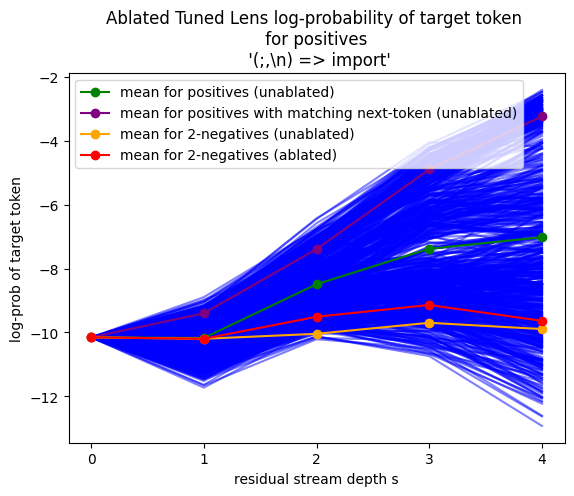

tensor(1.5535)

tensor(0.3443)

In [ ]:
bid_consequent_dict

NameError: ignored

bid 1
bid 3
bid 6
bid 7
bid 13
bid 14
bid 16
bid 20
bid 25
bid 27
bid 28
bid 30
tensor([387, 253]) ' at the' ' at' ' the'


100%|██████████| 24/24 [00:56<00:00,  2.37s/it]


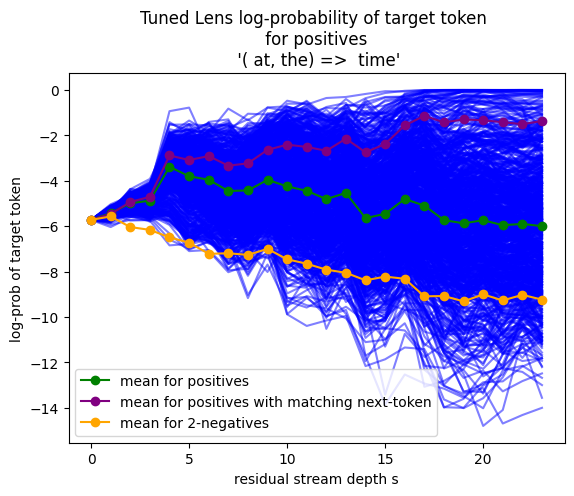

NameError: ignored

In [ ]:
for bid_consequent_dict in bid_consequent_elems[1:]:
  bid = bid_consequent_dict['bid']
  print('bid', bid)
  if bid != 30: continue
  target_i = bid_consequent_dict['pos_top_next']
  dset_dict = select_dset_dict_by_bigram_id(bid, some_resid_hooks)
  empirical_next_token = bid_consequent_dict['pos_top_next']
  example_name = print_bigram_id(bid_consequent_dict['bid'], extended=True) + ' => ' + tokenizer.decode((bid_consequent_dict['pos_top_next']))
  pos_ids_subset = get_pos_ids_subset(dset_dict, target_i)
  with torch.no_grad():
    trajs_possub = []
    trajs_pos = []
    trajs_2neg = []
    for s in tqdm(range(24)):
      logprobs = logsoftmax(tuned_lens(dset_dict['train_hidden_states'][f'blocks.{s}.hook_resid_pre'],s))[:,target_i]
      trajs_possub.append(logprobs[pos_ids_subset])
      trajs_pos.append(logprobs[:800])
      trajs_2neg.append(logprobs[800+1600:])
    trajs_possub = torch.stack(trajs_possub)
    trajs_pos = torch.stack(trajs_pos)
    trajs_2neg = torch.stack(trajs_2neg)
    torch.cuda.empty_cache()
    gc.collect()
  for traj in trajs_pos.T:
    plt.plot(traj.detach(), c='b', alpha=0.5)
  #plt.plot((trajs_pos.T)[-1].detach(), c='b', alpha=0.5, label='individual positives')
  plt.plot(trajs_pos.mean(dim=-1).detach(),c='green',marker='o',label='mean for positives')
  plt.plot(trajs_possub.mean(dim=-1).detach(),c='purple',marker='o',label='mean for positives with matching next-token')
  plt.plot(trajs_2neg.mean(dim=-1).detach(),c='orange',marker='o',label='mean for 2-negatives')
  plt.title(f'Tuned Lens log-probability of target token \n for positives \n {repr(example_name)}')
  plt.xlabel('residual stream depth s')
  plt.ylabel('log-prob of target token')
  plt.legend()
  plt.savefig(f'tuned_cons_bid{bid}.png', dpi=300)
  plt.show()
  pos_mean = trajs_pos.mean(dim=-1).detach()
  pos_mean_d = pos_mean[1:] - pos_mean[:-1]
  #plt.plot(pos_mean_d)
  tconsdict = {
      'trajs_pos': trajs_pos,
      'trajs_2neg': trajs_2neg,
      'pos_mean': pos_mean,
      'pos_mean_d': pos_mean_d
  }
  bid_t_conses[bid] = tconsdict

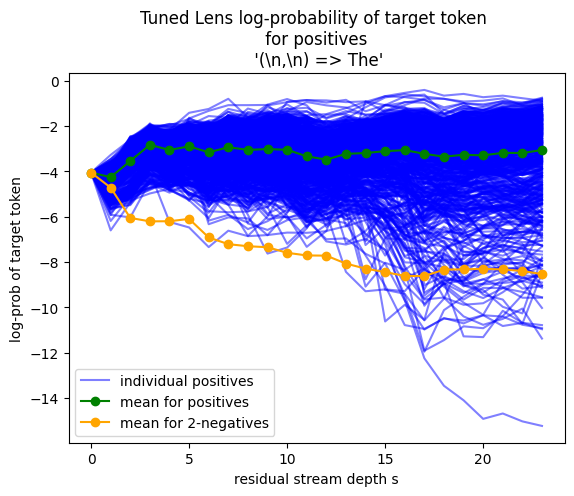

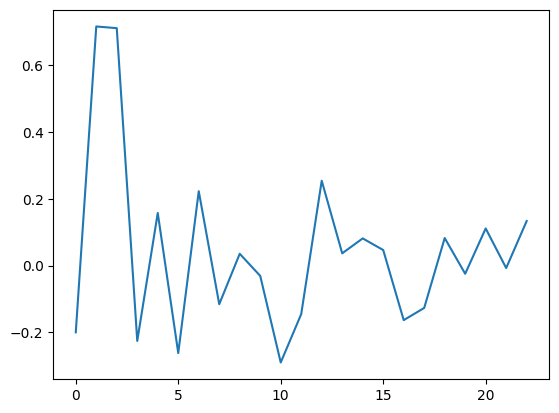

In [ ]:
for traj in trajs_pos.T:
  plt.plot(traj.detach(), c='b', alpha=0.5)
plt.plot((trajs_pos.T)[-1].detach(), c='b', alpha=0.5, label='individual positives')
plt.plot(trajs_pos.mean(dim=-1).detach(),c='green',marker='o',label='mean for positives')
plt.plot(trajs_2neg.mean(dim=-1).detach(),c='orange',marker='o',label='mean for 2-negatives')
plt.title(f'Tuned Lens log-probability of target token \n for positives \n {repr(example_name)}')
plt.xlabel('residual stream depth s')
plt.ylabel('log-prob of target token')
plt.legend()
plt.savefig(f'tuned_cons_bid{bid}.png', dpi=300)
plt.show()
pos_mean = trajs_pos.mean(dim=-1).detach()
pos_mean_d = pos_mean[1:] - pos_mean[:-1]
plt.plot(pos_mean_d)
tconsdict = {
    'trajs_pos': trajs_pos,
    'trajs_2neg': trajs_2neg,
    'pos_mean': pos_mean,
    'pos_mean_d': pos_mean_d
}
bid_t_conses[bid] = tconsdict

# Zooming in - LEACE downstream

In [ ]:
def leace_allpos_hook_fc(value, hook):
  #print('leacing', hook.name)
  erased_value = probes_dict[hook.name]['eraser'](value)
  #print(value.mean(), erased_value.mean())
  return erased_value

In [ ]:
#€def leace_lastpos_hook_fc(value, hook):
  #print('leacing', hook.name)
 # erased_value = probes_dict[hook.name]['eraser'](value)
  #print(value.mean(), erased_value.mean())
 # return erased_value

In [ ]:
def meanabl_lastpos_hook_fc(value, hook):
  d = value.shape[-1]
  mean_vec = value.mean(dim=0).mean(dim=0)
  assert len(mean_vec) == d
  value[:,-1] = mean_vec
  return value

In [ ]:
current_values_dict = {}
def cache_lastpos_hook_fc(value, hook):
  #print('cachinglast', hook.name)
  global current_values_dict
  current_values_dict[hook.name] = value[:,-1]
  #print('cached', hook.name)
  return value

In [ ]:
def cache_allpos_hook_fc(value, hook):
  #print('cachingall', hook.name)
  global current_values_dict
  current_values_dict[hook.name] = value
  #print('cached', hook.name)
  return value

In [ ]:
torch.cumsum(torch.tensor([600,200,1200,400,1200,400]),dim=-1)

tensor([ 600,  800, 2000, 2400, 3600, 4000])

In [ ]:
dset_A_pos_idx = torch.arange(0,600)
dset_B_pos_idx = torch.arange(600,800)
dset_A_1neg_idx = torch.arange(800,2000)
dset_B_1neg_idx = torch.arange(2000,2400)
dset_A_2neg_idx = torch.arange(2400,3600)
dset_B_2neg_idx = torch.arange(3600,4000)

In [ ]:
def get_snext_set(loader, cache_hook_tuples):
  dset_snext_train = {hook_name : [] for hook_name, _ in cache_hook_tuples}
  for i, batchlist in tqdm(enumerate(loader)):
    batch = batchlist[0]
    with torch.no_grad():
      model.run_with_hooks(
          batch,
          return_type='loss',
          stop_at_layer=s_max+2,
          fwd_hooks=[(erase_s_hookname,leace_allpos_hook_fc)] + cache_hook_tuples
      )
    for hook_name, val in current_values_dict.items():
      dset_snext_train[hook_name].append(val.cpu())
  return {key : torch.cat(val,dim=0) for key, val in dset_snext_train.items()}

In [ ]:
def get_clean(loader, cache_hook_tuples, s_max):
  dset_snext_train = {hook_name : [] for hook_name, _ in cache_hook_tuples}
  for i, batchlist in tqdm(enumerate(loader)):
    batch = batchlist[0]
    with torch.no_grad():
      model.run_with_hooks(
          batch,
          return_type='loss',
          stop_at_layer=s_max+2,
          fwd_hooks=cache_hook_tuples
      )
    for hook_name, val in current_values_dict.items():
      dset_snext_train[hook_name].append(val.cpu())
    delete_dict(current_values_dict)
  dset_snext_train_t = {key : torch.cat(val,dim=0) for key, val in dset_snext_train.items()}
  delete_dict(current_values_dict)
  delete_dict(dset_snext_train)
  gc.collect()
  torch.cuda.empty_cache()
  return dset_snext_train_t

In [ ]:
def get_erases(loader, cache_hook_tuples, s_max):
  dset_snext_train = {hook_name : [] for hook_name, _ in cache_hook_tuples}
  for i, batchlist in tqdm(enumerate(loader)):
    batch = batchlist[0]
    with torch.no_grad():
      model.run_with_hooks(
          batch,
          return_type='loss',
          stop_at_layer=s_max+2,
          fwd_hooks=[(erase_s_hookname, leace_allpos_hook_fc)] + cache_hook_tuples
      )
    for hook_name, val in current_values_dict.items():
      dset_snext_train[hook_name].append(val.cpu())
  delete_dict(current_values_dict)
  dset_snext_train_t = {key : torch.cat(val,dim=0) for key, val in dset_snext_train.items()}
  delete_dict(dset_snext_train)
  gc.collect()
  torch.cuda.empty_cache()
  return dset_snext_train_t

In [ ]:
def get_erases_plusattabl(loader, cache_hook_tuples, s_max):
  dset_snext_train = {hook_name : [] for hook_name, _ in cache_hook_tuples}
  for i, batchlist in tqdm(enumerate(loader)):
    batch = batchlist[0]
    with torch.no_grad():
      model.run_with_hooks(
          batch,
          return_type='loss',
          stop_at_layer=s_max+2,
          fwd_hooks=[(erase_s_hookname, leace_allpos_hook_fc)] + [(f'blocks.{s}.hook_attn_out', meanabl_lastpos_hook_fc) for s in range(erase_s, s_max)] + cache_hook_tuples
      )
    for hook_name, val in current_values_dict.items():
      dset_snext_train[hook_name].append(val.cpu())
  delete_dict(current_values_dict)
  dset_snext_train_t = {key : torch.cat(val,dim=0) for key, val in dset_snext_train.items()}
  delete_dict(dset_snext_train)
  gc.collect()
  torch.cuda.empty_cache()
  return dset_snext_train_t

In [ ]:
def get_evals(B_dict, vdset_dict, od_dict):
  od_evals = []
  ofd_evals = []
  for hook_name, _ in B_dict.items(): #some_resid_hooks[:s_max-1]:
    #print('hook_name', hook_name)
    CB_s = LogisticRegression(random_state=0, max_iter=10000).fit(B_dict[hook_name].cpu(), dset_B_bin_labels.cpu())
    #CBs.append(CB_s)
    ofd_logits = probe_obj_predict_log_proba(CB_s, vdset_dict[hook_name], batched=False)
    ofd_eval = get_od_eval(ofd_logits.cpu(), vdset_bin_labels.cpu())
    ofd_eval['hook_name'] = hook_name
    ofd_evals.append(ofd_eval)

    od_logits = probe_obj_predict_log_proba(CB_s, od_dict[hook_name], batched=True)
    od_eval = get_od_eval(od_logits, od_y_true) # eval_probe_on_val(CB_s, X_od_snext[hook_name].reshape(-1,X_od_snext[hook_name].shape[-1]).cpu(), od_y_true.reshape(-1).cpu())
    od_eval['hook_name'] = hook_name
    od_evals.append(od_eval)
  return od_evals, ofd_evals

In [ ]:
bid_evals_per_erase_s = {}

In [ ]:
erase_s = 3

In [ ]:
bid_od_evals = {}
bid_ofd_evals = {}

In [ ]:
erase_s_hookname = f'blocks.{erase_s}.hook_resid_pre'

In [ ]:
fmlp_ofd_dict_elems = []
fmlp_od_dict_elems = []

In [ ]:
erasesatt_ofd_dict_elems = []
erasesatt_od_dict_elems = []

erases_ofd_dict_elems = []
erases_od_dict_elems = []

In [ ]:
for did in range(0,1000,10):
  bid = dope_bigram_ids[did].item()
  print('bid', bid)
  #if bid in bid_od_evals: continue
  dset_dict = select_dset_dict_by_bigram_id(bid, ALL_RESID_HOOKS)
  probes_dict = select_probes_by_dset_dict(dset_dict)
  dset_A_cat_idx = torch.cat((dset_A_pos_idx,dset_A_1neg_idx,dset_A_2neg_idx))
  dset_B_cat_idx = torch.cat((dset_B_pos_idx,dset_B_1neg_idx,dset_B_2neg_idx))
  dset = dset_dict['train_dset']
  dset_A_bin_labels = dset.binary_labels[dset_A_cat_idx]
  dset_B_bin_labels = dset.binary_labels[dset_B_cat_idx]
  dset_A_T = torch.stack([dset[i][0] for i in dset_A_cat_idx])
  dset_A_T_dset = TensorDataset(dset_A_T)
  dset_A_T_loader = DataLoader(dset_A_T_dset, batch_size=50)

  dset_B_T = torch.stack([dset[i][0] for i in dset_B_cat_idx])
  dset_B_T_dset = TensorDataset(dset_B_T)
  dset_B_T_loader = DataLoader(dset_B_T_dset, batch_size=50)

  dset_od_T = Tv[:200]
  dset_od_T_dset = TensorDataset(dset_od_T)
  dset_od_T_loader = DataLoader(dset_od_T_dset, batch_size=10)

  od_y_true = find_bigram_occurrences(dset_od_T,bigrams[bid])
  od_y_true.sum()
  dset_T = torch.stack([dset[i][0] for i in range(len(dset))])
  dset_T_dset = TensorDataset(dset_T)
  dset_T_loader = DataLoader(dset_T_dset, batch_size=50)
  vdset = dset_dict['val_dset']
  vdset_T = torch.stack([vdset[i][0] for i in range(len(vdset))])
  vdset_T_dset = TensorDataset(vdset_T)
  vdset_T_loader = DataLoader(vdset_T_dset, batch_size=50)
  vdset_bin_labels = vdset.binary_labels
  extrahooks = [f'blocks.{erase_s}.hook_mlp_out',
                        f'blocks.{erase_s}.mlp.hook_pre',
                        f'blocks.{erase_s}.mlp.hook_post',
                        f'blocks.{erase_s}.ln2.hook_scale',
                        f'blocks.{erase_s}.ln2.hook_normalized']
  s_max = erase_s + 1 #min(erase_s + 5,23)
  cache_hook_tuples = [(f'blocks.{i}.hook_resid_pre',cache_lastpos_hook_fc) for i in range(s_max)] + [(hookname,cache_lastpos_hook_fc) for hookname in extrahooks]
  cacheall_hook_tuples = [(f'blocks.{i}.hook_resid_pre',cache_allpos_hook_fc) for i in range(s_max)] + [(hookname,cache_allpos_hook_fc) for hookname in extrahooks]

  flmp_cache_hook_tuples = [(f'blocks.{i}.hook_resid_pre',cache_lastpos_hook_fc) for i in range(erase_s, s_max)] + [(hookname,cache_lastpos_hook_fc) for hookname in extrahooks]
  flmp_cacheall_hook_tuples = [(f'blocks.{i}.hook_resid_pre',cache_allpos_hook_fc) for i in range(erase_s,s_max)] + [(hookname,cache_allpos_hook_fc) for hookname in extrahooks]

  erasesatt_cache_hook_tuples = [(f'blocks.{i}.hook_resid_pre',cache_lastpos_hook_fc) for i in range(erase_s, s_max+1)] #+ [(hookname,cache_lastpos_hook_fc) for hookname in extrahooks]
  erasesatt_cacheall_hook_tuples = [(f'blocks.{i}.hook_resid_pre',cache_allpos_hook_fc) for i in range(erase_s,s_max+1)] #+ [(hookname,cache_allpos_hook_fc) for hookname in extrahooks]


  erasesatt_B = get_erases_plusattabl(dset_B_T_loader, erasesatt_cache_hook_tuples, s_max)
  erasesatt_vdset = get_erases_plusattabl(vdset_T_loader, erasesatt_cache_hook_tuples, s_max)
  erasesatt_od = get_erases_plusattabl(dset_od_T_loader, erasesatt_cacheall_hook_tuples, s_max)

  erasesatt_od_evals, erasesatt_ofd_evals = get_evals(erasesatt_B, erasesatt_vdset, erasesatt_od)
  delete_dict(erasesatt_B)
  delete_dict(erasesatt_vdset)
  delete_dict(erasesatt_od)
  gc.collect()
  torch.cuda.empty_cache()

  erasesatt_od_dict_elem = {elem['hook_name']: elem['f1'] for elem in erasesatt_od_evals}
  erasesatt_od_dict_elem['bid'] = bid
  erasesatt_od_dict_elems.append(erasesatt_od_dict_elem)

  erasesatt_ofd_dict_elem = {elem['hook_name']: elem['f1'] for elem in erasesatt_ofd_evals}
  erasesatt_ofd_dict_elem['bid'] = bid
  erasesatt_ofd_dict_elems.append(erasesatt_ofd_dict_elem)


  erases_B = get_erases(dset_B_T_loader, erasesatt_cache_hook_tuples, s_max)
  erases_vdset = get_erases(vdset_T_loader, erasesatt_cache_hook_tuples, s_max)
  erases_od = get_erases(dset_od_T_loader, erasesatt_cacheall_hook_tuples, s_max)

  erases_od_evals, erases_ofd_evals = get_evals(erases_B, erases_vdset, erases_od)
  delete_dict(erases_B)
  delete_dict(erases_vdset)
  delete_dict(erases_od)
  gc.collect()
  torch.cuda.empty_cache()

  erases_od_dict_elem = {elem['hook_name']: elem['f1'] for elem in erases_od_evals}
  erases_od_dict_elem['bid'] = bid
  erases_od_dict_elems.append(erases_od_dict_elem)

  erases_ofd_dict_elem = {elem['hook_name']: elem['f1'] for elem in erases_ofd_evals}
  erases_ofd_dict_elem['bid'] = bid
  erases_ofd_dict_elems.append(erases_ofd_dict_elem)
  print(len(erases_od_dict_elems))

'''
  fmlp_B = get_erases(dset_B_T_loader, flmp_cache_hook_tuples, s_max)
  fmlp_vdset = get_erases(vdset_T_loader, flmp_cache_hook_tuples, s_max)
  fmlp_od = get_erases(dset_od_T_loader, flmp_cacheall_hook_tuples, s_max)

  fmlp_od_evals, fmlp_ofd_evals = get_evals(fmlp_B, fmlp_vdset, fmlp_od)
  delete_dict(fmlp_B)
  delete_dict(fmlp_vdset)
  delete_dict(fmlp_od)
  gc.collect()
  torch.cuda.empty_cache()

  fmlp_od_dict_elem = {elem['hook_name']: elem['f1'] for elem in fmlp_od_evals}
  fmlp_od_dict_elem['bid'] = bid
  fmlp_od_dict_elems.append(fmlp_od_dict_elem)

  fmlp_ofd_dict_elem = {elem['hook_name']: elem['f1'] for elem in fmlp_ofd_evals}
  fmlp_ofd_dict_elem['bid'] = bid
  fmlp_ofd_dict_elems.append(fmlp_ofd_dict_elem)
  print(len(fmlp_od_dict_elems))
'''

bid 0


20it [00:01, 15.35it/s]
10it [00:00, 14.62it/s]
20it [00:07,  2.62it/s]
20it [00:01, 15.53it/s]
10it [00:00, 14.89it/s]
20it [00:07,  2.58it/s]


1
bid 14


20it [00:01, 15.59it/s]
10it [00:00, 14.60it/s]
20it [00:07,  2.55it/s]
20it [00:01, 15.04it/s]
10it [00:00, 14.84it/s]
20it [00:07,  2.55it/s]


2
bid 26


20it [00:01, 15.56it/s]
10it [00:00, 14.70it/s]
20it [00:07,  2.58it/s]
20it [00:01, 15.30it/s]
10it [00:00, 14.32it/s]
20it [00:07,  2.58it/s]


3
bid 38


20it [00:01, 15.47it/s]
10it [00:00, 14.91it/s]
20it [00:07,  2.57it/s]
20it [00:01, 15.49it/s]
10it [00:00, 14.92it/s]
20it [00:07,  2.56it/s]


4
bid 50


20it [00:01, 15.79it/s]
10it [00:00, 14.44it/s]
20it [00:07,  2.60it/s]
20it [00:01, 15.53it/s]
10it [00:00, 14.15it/s]
20it [00:07,  2.57it/s]


5
bid 68


20it [00:01, 15.48it/s]
10it [00:00, 14.41it/s]
20it [00:07,  2.57it/s]
20it [00:01, 15.42it/s]
10it [00:00, 14.20it/s]
20it [00:07,  2.57it/s]


6
bid 79


20it [00:01, 15.26it/s]
10it [00:00, 14.44it/s]
20it [00:07,  2.59it/s]
20it [00:01, 15.69it/s]
10it [00:00, 14.46it/s]
20it [00:07,  2.56it/s]


7
bid 95


20it [00:01, 15.49it/s]
10it [00:00, 14.89it/s]
20it [00:07,  2.57it/s]
20it [00:01, 15.65it/s]
10it [00:00, 14.03it/s]
20it [00:07,  2.57it/s]


8
bid 106


20it [00:01, 15.54it/s]
10it [00:00, 14.99it/s]
20it [00:07,  2.59it/s]
20it [00:01, 15.09it/s]
10it [00:00, 14.93it/s]
20it [00:07,  2.57it/s]


9
bid 120


20it [00:01, 15.41it/s]
10it [00:00, 14.58it/s]
20it [00:07,  2.57it/s]
20it [00:01, 15.38it/s]
10it [00:00, 14.38it/s]
20it [00:07,  2.58it/s]


10
bid 135


20it [00:01, 15.76it/s]
10it [00:00, 14.78it/s]
20it [00:07,  2.57it/s]
20it [00:01, 15.55it/s]
10it [00:00, 14.52it/s]
20it [00:07,  2.57it/s]


11
bid 146


20it [00:01, 15.79it/s]
10it [00:00, 14.53it/s]
20it [00:07,  2.59it/s]
20it [00:01, 15.07it/s]
10it [00:00, 14.98it/s]
20it [00:07,  2.56it/s]


12
bid 158


20it [00:01, 15.57it/s]
10it [00:00, 14.72it/s]
20it [00:07,  2.58it/s]
20it [00:01, 15.29it/s]
10it [00:00, 14.57it/s]
20it [00:07,  2.59it/s]


13
bid 168


20it [00:01, 15.69it/s]
10it [00:00, 14.24it/s]
20it [00:07,  2.59it/s]
20it [00:01, 15.38it/s]
10it [00:00, 14.23it/s]
20it [00:07,  2.57it/s]


14
bid 178


20it [00:01, 15.56it/s]
10it [00:00, 14.77it/s]
20it [00:07,  2.58it/s]
20it [00:01, 15.63it/s]
10it [00:00, 14.15it/s]
20it [00:07,  2.59it/s]


15
bid 194


20it [00:01, 15.71it/s]
10it [00:00, 14.46it/s]
20it [00:07,  2.59it/s]
20it [00:01, 15.36it/s]
10it [00:00, 14.79it/s]
20it [00:07,  2.58it/s]


16
bid 208


20it [00:01, 15.34it/s]
10it [00:00, 14.29it/s]
20it [00:07,  2.57it/s]
20it [00:01, 15.46it/s]
10it [00:00, 15.05it/s]
20it [00:07,  2.57it/s]


17
bid 222


20it [00:01, 15.52it/s]
10it [00:00, 14.64it/s]
20it [00:07,  2.58it/s]
20it [00:01, 15.49it/s]
10it [00:00, 14.65it/s]
20it [00:07,  2.58it/s]


18
bid 235


20it [00:01, 15.37it/s]
10it [00:00, 14.43it/s]
20it [00:07,  2.59it/s]
20it [00:01, 15.35it/s]
10it [00:00, 14.48it/s]
20it [00:07,  2.58it/s]


19
bid 250


20it [00:01, 15.57it/s]
10it [00:00, 14.82it/s]
20it [00:07,  2.58it/s]
20it [00:01, 15.69it/s]
10it [00:00, 15.18it/s]
20it [00:07,  2.58it/s]


20
bid 262


20it [00:01, 15.32it/s]
10it [00:00, 14.67it/s]
20it [00:07,  2.58it/s]
20it [00:01, 15.32it/s]
10it [00:00, 14.89it/s]
20it [00:07,  2.59it/s]


21
bid 279


20it [00:01, 15.64it/s]
10it [00:00, 14.88it/s]
20it [00:07,  2.58it/s]
20it [00:01, 15.27it/s]
10it [00:00, 14.72it/s]
20it [00:07,  2.57it/s]


22
bid 293


20it [00:01, 15.42it/s]
10it [00:00, 14.86it/s]
20it [00:07,  2.59it/s]
20it [00:01, 15.36it/s]
10it [00:00, 14.97it/s]
20it [00:07,  2.58it/s]


23
bid 307


20it [00:01, 15.55it/s]
10it [00:00, 14.77it/s]
20it [00:07,  2.57it/s]
20it [00:01, 15.59it/s]
10it [00:00, 14.95it/s]
20it [00:07,  2.58it/s]


24
bid 319


20it [00:01, 15.65it/s]
10it [00:00, 14.44it/s]
20it [00:07,  2.60it/s]
20it [00:01, 15.46it/s]
10it [00:00, 14.51it/s]
20it [00:07,  2.58it/s]


25
bid 332


20it [00:01, 15.45it/s]
10it [00:00, 14.84it/s]
20it [00:07,  2.57it/s]
20it [00:01, 15.26it/s]
10it [00:00, 14.63it/s]
20it [00:07,  2.59it/s]


26
bid 342


20it [00:01, 15.43it/s]
10it [00:00, 14.67it/s]
20it [00:07,  2.58it/s]
20it [00:01, 15.62it/s]
10it [00:00, 14.79it/s]
20it [00:07,  2.57it/s]


27
bid 353


20it [00:01, 15.45it/s]
10it [00:00, 14.95it/s]
20it [00:07,  2.59it/s]
20it [00:01, 15.45it/s]
10it [00:00, 14.76it/s]
20it [00:07,  2.59it/s]


28
bid 365


20it [00:01, 15.83it/s]
10it [00:00, 14.84it/s]
20it [00:07,  2.57it/s]
20it [00:01, 15.14it/s]
10it [00:00, 14.66it/s]
20it [00:07,  2.58it/s]


29
bid 377


20it [00:01, 15.57it/s]
10it [00:00, 14.22it/s]
20it [00:07,  2.59it/s]
20it [00:01, 15.72it/s]
10it [00:00, 15.03it/s]
20it [00:07,  2.59it/s]


30
bid 387


20it [00:01, 15.55it/s]
10it [00:00, 14.19it/s]
20it [00:07,  2.58it/s]
20it [00:01, 15.67it/s]
10it [00:00, 15.27it/s]
20it [00:07,  2.58it/s]


31
bid 400


20it [00:01, 15.55it/s]
10it [00:00, 14.96it/s]
20it [00:07,  2.58it/s]
20it [00:01, 15.17it/s]
10it [00:00, 14.42it/s]
20it [00:07,  2.58it/s]


32
bid 412


20it [00:01, 15.62it/s]
10it [00:00, 14.22it/s]
20it [00:07,  2.58it/s]
20it [00:01, 15.29it/s]
10it [00:00, 14.55it/s]
20it [00:07,  2.58it/s]


33
bid 422


20it [00:01, 15.34it/s]
10it [00:00, 14.76it/s]
20it [00:07,  2.57it/s]
20it [00:01, 15.33it/s]
10it [00:00, 14.57it/s]
20it [00:07,  2.57it/s]


34
bid 433


20it [00:01, 15.48it/s]
10it [00:00, 15.18it/s]
20it [00:07,  2.58it/s]
20it [00:01, 15.42it/s]
10it [00:00, 14.22it/s]
20it [00:07,  2.58it/s]


35
bid 443


20it [00:01, 15.29it/s]
10it [00:00, 14.94it/s]
20it [00:07,  2.58it/s]
20it [00:01, 15.40it/s]
10it [00:00, 15.13it/s]
20it [00:07,  2.58it/s]


36
bid 455


20it [00:01, 15.67it/s]
10it [00:00, 15.18it/s]
20it [00:07,  2.58it/s]
20it [00:01, 15.48it/s]
10it [00:00, 14.37it/s]
20it [00:07,  2.58it/s]


37
bid 468


20it [00:01, 15.72it/s]
10it [00:00, 14.34it/s]
20it [00:07,  2.59it/s]
20it [00:01, 15.20it/s]
10it [00:00, 14.96it/s]
20it [00:07,  2.58it/s]


38
bid 479


20it [00:01, 15.39it/s]
10it [00:00, 14.39it/s]
20it [00:07,  2.58it/s]
20it [00:01, 15.31it/s]
10it [00:00, 14.25it/s]
20it [00:07,  2.58it/s]


39
bid 489


20it [00:01, 15.53it/s]
10it [00:00, 14.99it/s]
20it [00:07,  2.60it/s]
20it [00:01, 15.34it/s]
10it [00:00, 14.87it/s]
20it [00:07,  2.59it/s]


40
bid 502


20it [00:01, 15.66it/s]
10it [00:00, 14.55it/s]
20it [00:07,  2.58it/s]
20it [00:01, 15.63it/s]
10it [00:00, 14.34it/s]
20it [00:07,  2.57it/s]


41
bid 514


20it [00:01, 15.38it/s]
10it [00:00, 14.41it/s]
20it [00:07,  2.59it/s]
20it [00:01, 15.53it/s]
10it [00:00, 14.76it/s]
20it [00:07,  2.57it/s]


42
bid 525


20it [00:01, 15.80it/s]
10it [00:00, 14.88it/s]
20it [00:07,  2.59it/s]
20it [00:01, 15.73it/s]
10it [00:00, 14.77it/s]
20it [00:07,  2.59it/s]


43
bid 536


20it [00:01, 15.48it/s]
10it [00:00, 15.14it/s]
20it [00:07,  2.59it/s]
20it [00:01, 15.57it/s]
10it [00:00, 14.41it/s]
20it [00:07,  2.58it/s]


44
bid 548


20it [00:01, 15.47it/s]
10it [00:00, 14.80it/s]
20it [00:07,  2.58it/s]
20it [00:01, 15.49it/s]
10it [00:00, 14.76it/s]
20it [00:07,  2.58it/s]


45
bid 559


20it [00:01, 15.72it/s]
10it [00:00, 14.49it/s]
20it [00:07,  2.59it/s]
20it [00:01, 15.43it/s]
10it [00:00, 14.28it/s]
20it [00:07,  2.58it/s]


46
bid 569


20it [00:01, 15.49it/s]
10it [00:00, 15.02it/s]
20it [00:07,  2.60it/s]
20it [00:01, 15.21it/s]
10it [00:00, 15.00it/s]
20it [00:07,  2.58it/s]


47
bid 580


20it [00:01, 15.55it/s]
10it [00:00, 14.53it/s]
20it [00:07,  2.58it/s]
20it [00:01, 15.32it/s]
10it [00:00, 14.91it/s]
20it [00:07,  2.58it/s]


48
bid 591


20it [00:01, 15.39it/s]
10it [00:00, 14.59it/s]
20it [00:07,  2.59it/s]
20it [00:01, 15.37it/s]
10it [00:00, 14.96it/s]
20it [00:07,  2.59it/s]


49
bid 602


20it [00:01, 15.42it/s]
10it [00:00, 14.37it/s]
20it [00:07,  2.59it/s]
20it [00:01, 15.16it/s]
10it [00:00, 14.84it/s]
20it [00:07,  2.58it/s]


50
bid 612


20it [00:01, 15.79it/s]
10it [00:00, 14.46it/s]
20it [00:07,  2.59it/s]
20it [00:01, 15.47it/s]
10it [00:00, 14.53it/s]
20it [00:07,  2.58it/s]


51
bid 622


20it [00:01, 15.28it/s]
10it [00:00, 15.00it/s]
20it [00:07,  2.59it/s]
20it [00:01, 15.54it/s]
10it [00:00, 14.86it/s]
20it [00:07,  2.58it/s]


52
bid 632


20it [00:01, 15.44it/s]
10it [00:00, 14.99it/s]
Exception ignored in: <function _xla_gc_callback at 0x7c22740e6f80>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/jax/_src/lib/__init__.py", line 101, in _xla_gc_callback
    def _xla_gc_callback(*args):
KeyboardInterrupt: 
20it [00:07,  2.58it/s]
20it [00:01, 15.29it/s]
10it [00:00, 14.27it/s]
20it [00:07,  2.56it/s]


53
bid 644


20it [00:01, 15.83it/s]
10it [00:00, 14.56it/s]
1it [00:00,  1.22it/s]


KeyboardInterrupt: ignored

In [ ]:
df_erases_ofd = pd.DataFrame(erases_ofd_dict_elems)
df_erases_od = pd.DataFrame(erases_od_dict_elems)

In [ ]:
df_erasesatt_ofd = pd.DataFrame(erasesatt_ofd_dict_elems)
df_erasesatt_od = pd.DataFrame(erasesatt_od_dict_elems)

In [ ]:
df_erasesatt_od

,blocks.3.hook_resid_pre,blocks.4.hook_resid_pre,bid
0,0.021378,0.126933,0
1,0.000722,0.190269,14


In [ ]:
df_erases_od

,blocks.3.hook_resid_pre,blocks.4.hook_resid_pre,bid
0,0.021378,0.880510,0
1,0.000722,0.552743,14


In [ ]:
df_fmlp_ofd = pd.DataFrame(fmlp_ofd_dict_elems)
df_fmlp_od = pd.DataFrame(fmlp_od_dict_elems)

In [ ]:
#df_fmlp_od.to_csv('/content/drive/MyDrive/thesis/zoomin/leacedown/df_fmlp_od.csv')

In [ ]:
#df_fmlp_ofd.to_csv('/content/drive/MyDrive/thesis/zoomin/leacedown/df_fmlp_ofd.csv')

In [ ]:
df_fmlp_ofd #_dict_elems[0]

,blocks.3.hook_resid_pre,blocks.3.hook_mlp_out,blocks.3.mlp.hook_pre,blocks.3.mlp.hook_post,blocks.3.ln2.hook_scale,blocks.3.ln2.hook_normalized,bid
0,0.387931,0.994975,0.995025,0.994975,0.0,0.995025,0
1,0.371901,1.000000,0.990099,1.000000,0.0,1.000000,14
2,0.159509,1.000000,0.994975,1.000000,0.0,0.994975,26
3,0.191919,1.000000,0.995025,0.995025,0.0,0.989899,38
4,0.380952,0.995025,0.985222,0.995025,0.0,0.995025,50
...,...,...,...,...,...,...,...
95,0.236453,0.990099,0.985075,0.990099,0.0,0.985222,1116
96,0.184332,1.000000,0.995025,1.000000,0.0,1.000000,1127
97,0.271493,0.994975,0.990000,0.994975,0.0,0.994975,1137
98,0.431034,0.970297,0.565056,0.970297,0.0,0.534351,1147


In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

def plot_numeric_boxplots(df):
    numeric_cols = df.select_dtypes(include=[np.number]).columns
    plt.figure(figsize=(10, 6))
    plt.boxplot([df[col] for col in numeric_cols], labels=numeric_cols)
    plt.xticks(rotation=90)  # Rotates x-axis labels vertically
    plt.title("Boxplots for Numeric Fields")
    plt.ylabel("Values")
    plt.show()


In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

def create_beautiful_boxplots(df, columns, rename_columns, title):
    df_for_plot = df[columns].rename(columns=dict(zip(columns, rename_columns)))
    plt.figure(figsize=(10, 6))
    sns.boxplot(data=df_for_plot)
    plt.xticks(rotation=45)
    #sns.set(style="whitegrid")
    plt.xlabel('hidden state spaces (hook names)')
    plt.ylabel('F1')
    plt.title(title)
    plt.savefig(f'{title}.png',dpi=300)
    plt.show()


In [ ]:
df_fmlp_ofd_cols = df_fmlp_ofd.columns.tolist()[:-1]
df_fmlp_ofd_colsnew = [elem.split(f'blocks.{erase_s}.')[-1] for elem in df_fmlp_ofd_cols]

In [ ]:
df_fmlp_od_cols = df_fmlp_od.columns.tolist()[:-1]
df_fmlp_od_colsnew = [elem.split(f'blocks.{erase_s}.')[-1] for elem in df_fmlp_od_cols]

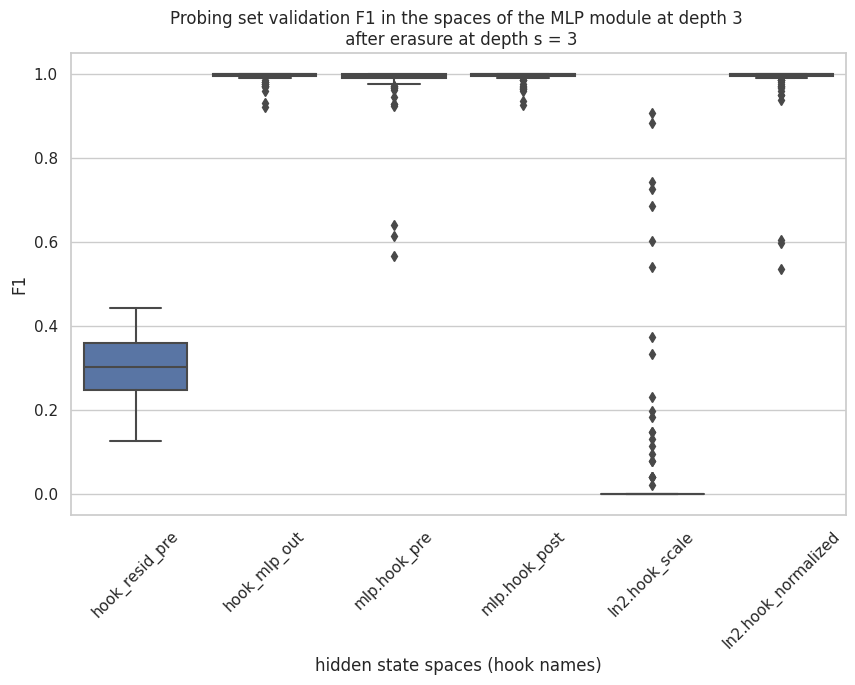

In [ ]:
create_beautiful_boxplots(df_fmlp_ofd, df_fmlp_ofd_cols, df_fmlp_ofd_colsnew, title=f'Probing set validation F1 in the spaces of the MLP module at depth {erase_s} \n after erasure at depth s = {erase_s}')

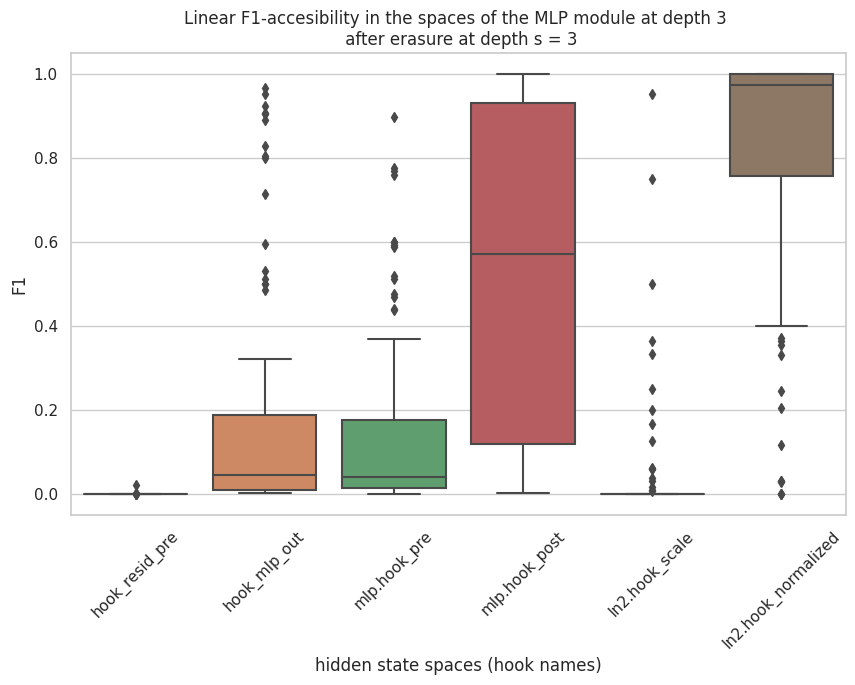

In [ ]:
create_beautiful_boxplots(df_fmlp_od, df_fmlp_od_cols, df_fmlp_od_colsnew, title=f'Linear F1-accesibility in the spaces of the MLP module at depth {erase_s} \n after erasure at depth s = {erase_s}')

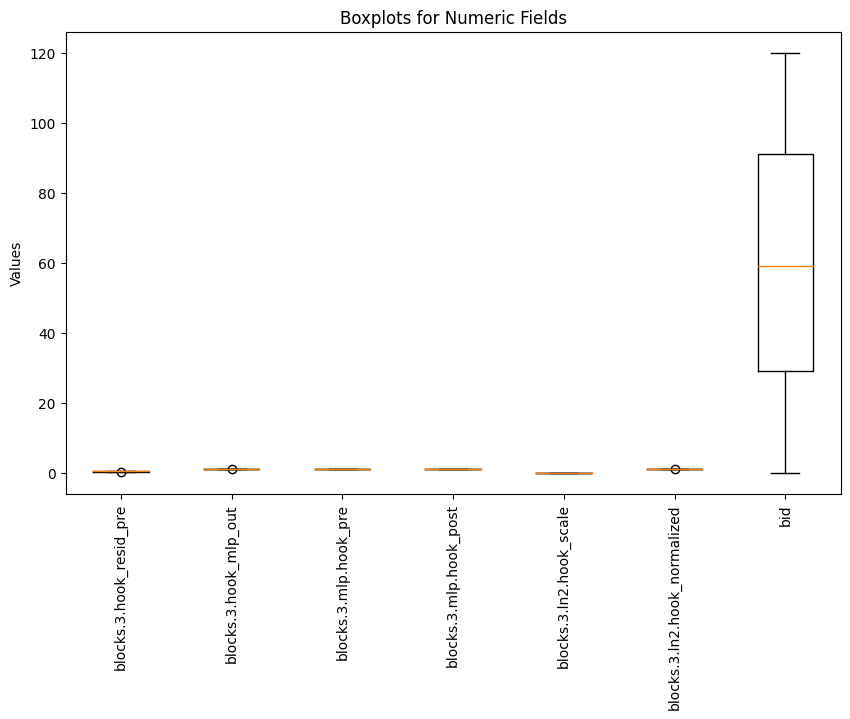

In [ ]:
plot_numeric_boxplots(df_fmlp_ofd)

{'blocks.3.hook_resid_pre': 0.27649769585253453,
 'blocks.3.hook_mlp_out': 0.9949748743718593,
 'blocks.3.mlp.hook_pre': 0.9797979797979798,
 'blocks.3.mlp.hook_post': 0.9949748743718593,
 'blocks.3.ln2.hook_scale': 0.0,
 'blocks.3.ln2.hook_normalized': 0.9949748743718593,
 'bid': 16}

In [ ]:
fmlp_od_evals

[{'f1': 0.0,
  'precision': 0.0,
  'recall': 0.0,
  'auc_roc': 0.9991446500993041,
  'auc_pr': 0.4474393530997305,
  'matthews': 0.0,
  'bce': 0.0196517501026392,
  'cohens_kappa': 0.0,
  'confusion_matrix': array([[119834,      0],
         [   166,      0]]),
  'sensitivity': 0.0,
  'specificity': 1.0,
  'hamming_loss': 0.0013833333333333334,
  'jaccard_score': 0.0,
  'hook_name': 'blocks.0.hook_resid_pre'},
 {'f1': 0.9044585987261146,
  'precision': 0.9594594594594594,
  'recall': 0.8554216867469879,
  'auc_roc': 0.999955209123625,
  'auc_pr': 0.9684905079108331,
  'matthews': 0.9058273037245802,
  'bce': 0.0008350340649485588,
  'cohens_kappa': 0.9043338468125526,
  'confusion_matrix': array([[119828,      6],
         [    24,    142]]),
  'sensitivity': 0.8554216867469879,
  'specificity': 0.9999499307375203,
  'hamming_loss': 0.00025,
  'jaccard_score': 0.8255813953488372,
  'hook_name': 'blocks.1.hook_resid_pre'},
 {'f1': 0.9847094801223241,
  'precision': 1.0,
  'recall': 0.96

In [ ]:
clean_B = get_clean(dset_B_T_loader, cache_hook_tuples, s_max)

20it [00:29,  1.47s/it]


In [ ]:
clean_vdset = get_clean(vdset_T_loader, cache_hook_tuples, s_max)

10it [00:14,  1.47s/it]


In [ ]:
clean_od = get_clean(dset_od_T_loader, cacheall_hook_tuples, s_max)

20it [00:59,  2.97s/it]


In [ ]:
od_evals = []
ofd_evals = []
for hook_name, _ in cache_hook_tuples: #some_resid_hooks[:s_max-1]:
  #print('hook_name', hook_name)
  CB_s = LogisticRegression(random_state=0, max_iter=10000).fit(clean_B[hook_name].cpu(), dset_B_bin_labels.cpu())
  #CBs.append(CB_s)
  ofd_logits = probe_obj_predict_log_proba(CB_s, clean_vdset[hook_name], batched=False)
  ofd_eval = get_od_eval(ofd_logits.cpu(), vdset_bin_labels.cpu())
  ofd_eval['hook_name'] = hook_name
  ofd_evals.append(ofd_eval)

  od_logits = probe_obj_predict_log_proba(CB_s, clean_od[hook_name], batched=True)
  od_eval = get_od_eval(od_logits, od_y_true) # eval_probe_on_val(CB_s, X_od_snext[hook_name].reshape(-1,X_od_snext[hook_name].shape[-1]).cpu(), od_y_true.reshape(-1).cpu())
  od_eval['hook_name'] = hook_name
  od_evals.append(od_eval)

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defin

In [ ]:
delete_dict(clean_B)
delete_dict(clean_vdset)
delete_dict(clean_od)
gc.collect()
torch.cuda.empty_cache()

In [ ]:
erases_B = get_erases(dset_B_T_loader, cache_hook_tuples, s_max)
erases_vdset = get_erases(vdset_T_loader, cache_hook_tuples, s_max)
erases_od = get_erases(dset_od_T_loader, cacheall_hook_tuples, s_max)

20it [00:29,  1.46s/it]


In [ ]:
erases_od_evals, erases_ofd_evals = get_evals(erases_B, erases_vdset, erases_od)

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
delete_dict(erases_B)
delete_dict(erases_vdset)
delete_dict(erases_od)
gc.collect()
torch.cuda.empty_cache()

In [ ]:
erasesatt_B = get_erases_plusattabl(dset_B_T_loader, cache_hook_tuples, s_max)

20it [00:29,  1.45s/it]


In [ ]:
erasesatt_vdset = get_erases_plusattabl(vdset_T_loader, cache_hook_tuples, s_max)

10it [00:14,  1.46s/it]


In [ ]:
erasesatt_od = get_erases_plusattabl(dset_od_T_loader, cacheall_hook_tuples, s_max)

20it [00:59,  3.00s/it]


In [ ]:
erasesatt_od_evals, erasesatt_ofd_evals = get_evals(erasesatt_B, erasesatt_vdset, erasesatt_od)
delete_dict(erasesatt_B)
delete_dict(erasesatt_vdset)
delete_dict(erasesatt_od)
gc.collect()
torch.cuda.empty_cache()

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


tensor([327, 253]) ' on the' ' on' ' the'


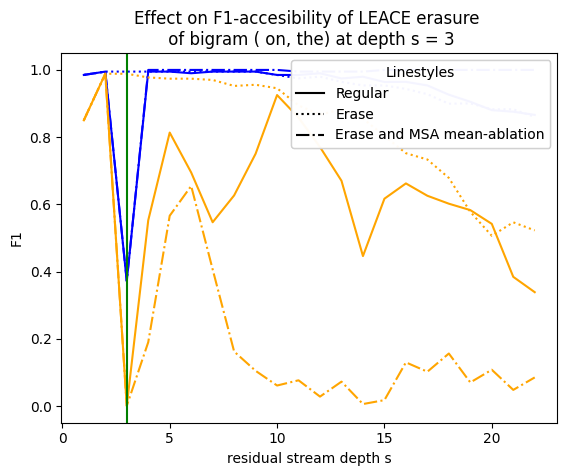

In [ ]:
import matplotlib.lines as mlines
xs = torch.arange(1,len(ofd_evals[1:-5])+1)
bigram_str = print_bigram_id(bid,extended=True)
plt.plot(xs,[elem['f1'] for elem in ofd_evals[1:-5]],linestyle='dotted',color='blue')
plt.plot(xs,[elem['f1'] for elem in erases_ofd_evals[1:-5]],color='blue',label='probing set val. F1')
plt.plot(xs,[elem['f1'] for elem in erasesatt_ofd_evals[1:-5]],linestyle='dashdot',color='blue')

plt.plot(xs,[elem['f1'] for elem in od_evals[1:-5]],linestyle='dotted',color='orange')
plt.plot(xs,[elem['f1'] for elem in erases_od_evals[1:-5]],color='orange',label='on-distribution F1')
plt.plot(xs,[elem['f1'] for elem in erasesatt_od_evals[1:-5]],linestyle='dashdot',color='orange')

plt.axvline(x=erase_s,label=f'erasure at s = {erase_s}',color='green')
plt.xlabel('residual stream depth s')
plt.ylabel('F1')
plt.title(f'Effect on F1-accesibility of LEACE erasure \n of bigram {bigram_str} at depth s = {erase_s}')
plt.legend(loc='upper left')

# Create custom legend handles for the linestyles
solid_line = mlines.Line2D([], [], color='black', linestyle='solid', label='Regular')
dotted_line = mlines.Line2D([], [], color='black', linestyle='dotted', label='Erase')
dashdot_line = mlines.Line2D([], [], color='black', linestyle='dashdot', label='Erase and MSA mean-ablation')

# Create the second legend (for linestyles)
linestyle_legend = plt.legend(handles=[solid_line, dotted_line, dashdot_line],
                              loc='upper right', title="Linestyles")

# Add the linestyle legend back to the plot
plt.gca().add_artist(linestyle_legend)

# Display the plot

plt.savefig(f'leacedownstream_bid{bid}_s{erase_s}.png',dpi=300)

plt.show()


In [ ]:
erase_s = 2

tensor([ 13, 285]) ', and' ',' ' and'


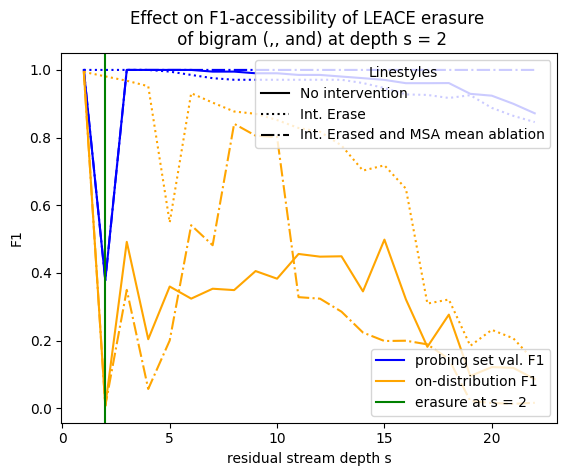

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.lines as mlines
import torch

# Assuming ofd_evals, erases_ofd_evals, erasesatt_ofd_evals, od_evals, erases_od_evals,
# erasesatt_od_evals, erase_s, bid are defined elsewhere in your code

xs = torch.arange(1, len(ofd_evals[1:-5]) + 1)
bigram_str = print_bigram_id(bid, extended=True)

# Plotting with various linestyles and colors
plt.plot(xs, [elem['f1'] for elem in ofd_evals[1:-5]], linestyle='dotted', color='blue')
plt.plot(xs, [elem['f1'] for elem in erases_ofd_evals[1:-5]], color='blue', label='probing set val. F1')
plt.plot(xs, [elem['f1'] for elem in erasesatt_ofd_evals[1:-5]], linestyle='dashdot', color='blue')

plt.plot(xs, [elem['f1'] for elem in od_evals[1:-5]], linestyle='dotted', color='orange')
plt.plot(xs, [elem['f1'] for elem in erases_od_evals[1:-5]], color='orange', label='on-distribution F1')
plt.plot(xs, [elem['f1'] for elem in erasesatt_od_evals[1:-5]], linestyle='dashdot', color='orange')

plt.axvline(x=erase_s, label=f'erasure at s = {erase_s}', color='green')
plt.xlabel('residual stream depth s')
plt.ylabel('F1')
plt.title(f'Effect on F1-accessibility of LEACE erasure \n of bigram {bigram_str} at depth s = {erase_s}')

# Create the first legend for colors
color_legend = plt.legend(loc='lower right')

# Create custom legend handles for the linestyles
solid_line = mlines.Line2D([], [], color='black', linestyle='solid', label='No intervention')
dotted_line = mlines.Line2D([], [], color='black', linestyle='dotted', label='Int. Erase')
dashdot_line = mlines.Line2D([], [], color='black', linestyle='dashdot', label='Int. Erased and MSA mean ablation')

# Create the second legend for linestyles
linestyle_legend = plt.legend(handles=[solid_line, dotted_line, dashdot_line], loc='upper right', title="Linestyles")

# Add the linestyle legend back to the plot
plt.gca().add_artist(color_legend)

# Saving the figure
plt.savefig(f'leacedownstream_bid{bid}_s{erase_s}.png', dpi=300)

# Show the plot
plt.show()


tensor([ 13, 285]) ', and' ',' ' and'


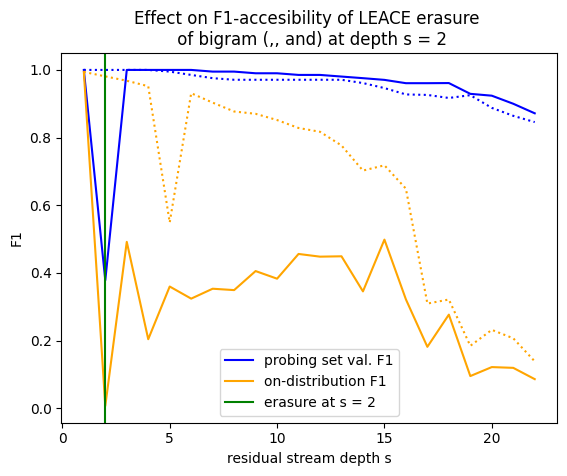

In [ ]:
xs = torch.arange(1,len(ofd_evals[1:-5])+1)
bigram_str = print_bigram_id(bid,extended=True)
plt.plot(xs,[elem['f1'] for elem in ofd_evals[1:-5]],linestyle='dotted',color='blue')
plt.plot(xs,[elem['f1'] for elem in erases_ofd_evals[1:-5]],color='blue',label='probing set val. F1')

plt.plot(xs,[elem['f1'] for elem in od_evals[1:-5]],linestyle='dotted',color='orange')
plt.plot(xs,[elem['f1'] for elem in erases_od_evals[1:-5]],color='orange',label='on-distribution F1')

plt.axvline(x=erase_s,label=f'erasure at s = {erase_s}',color='green')
plt.xlabel('residual stream depth s')
plt.ylabel('F1')
plt.legend()
plt.title(f'Effect on F1-accesibility of LEACE erasure \n of bigram {bigram_str} at depth s = {erase_s}')
plt.savefig(f'leacedownstream_bid{bid}_s{erase_s}.png',dpi=300)
plt.show()


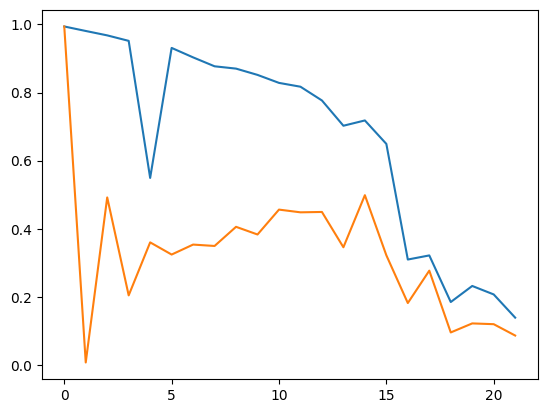

In [ ]:
plt.plot([elem['f1'] for elem in od_evals[1:-5]])
plt.plot([elem['f1'] for elem in erases_od_evals[1:-5]])

TypeError: ignored

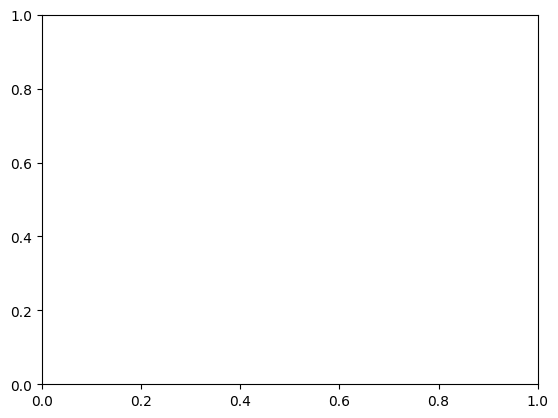

In [ ]:
X_train_A_snext = get_snext_set(dset_A_T_loader, cache_hook_tuples)
X_train_B_snext = get_snext_set(dset_B_T_loader, cache_hook_tuples)
X_val_snext = get_snext_set(vdset_T_loader, cache_hook_tuples)
X_od_snext = get_snext_set(dset_od_T_loader, cacheall_hook_tuples)


CB_probes_metrics_resids = []
CBs = []
od_evals = []
ofd_evals = []
for hook_name, _ in cache_hook_tuples: #some_resid_hooks[:s_max-1]:
  #print('hook_name', hook_name)
  CB_s = LogisticRegression(random_state=0, max_iter=10000).fit(X_train_B_snext[hook_name].cpu(), dset_B_bin_labels.cpu())
  CBs.append(CB_s)
  ofd_logits = probe_obj_predict_log_proba(CB_s, X_val_snext[hook_name], batched=False)
  ofd_eval = get_od_eval(ofd_logits.cpu(), vdset_bin_labels.cpu())
  ofd_eval['hook_name'] = hook_name
  #print('ofdnew', ofd_eval)
  ofd_evals.append(ofd_eval)
  #CB_s_eraser_validation_performance_dict = eval_probe_on_val(CB_s, X_val_snext[hook_name].cpu(), vdset_bin_labels.cpu())
  #CB_s_eraser_validation_performance_dict['hook_name'] = hook_name
  #CB_probes_metrics_resids.append(CB_s_eraser_validation_performance_dict)
  #print('ofd', CB_s_eraser_validation_performance_dict)
  od_logits = probe_obj_predict_log_proba(CB_s, X_od_snext[hook_name], batched=True)
  #print(od_logits.shape, X_od_snext[hook_name].shape[-1])
  od_eval = get_od_eval(od_logits, od_y_true) # eval_probe_on_val(CB_s, X_od_snext[hook_name].reshape(-1,X_od_snext[hook_name].shape[-1]).cpu(), od_y_true.reshape(-1).cpu())
  od_eval['hook_name'] = hook_name
  od_evals.append(od_eval)
  #print('od', od_eval)
  #print('')
  #if hook_name == 'blocks.22.hook_resid_pre': break
  #del X
delete_dict(X_train_A_snext)
delete_dict(X_od_snext)
torch.cuda.empty_cache()
gc.collect()
ofd_df = pd.DataFrame(ofd_evals)
od_df = pd.DataFrame(od_evals)
bid_od_evals[bid] = od_evals
bid_ofd_evals[bid] = ofd_evals

In [ ]:
for erase_s in [1,2,3,4,6,8,10]:
  delete_dict(current_values_dict)
  print('a', erase_s)
  erase_s_hookname = f'blocks.{erase_s}.hook_resid_pre'
  #erase_snext_hookname = f'blocks.{erase_s+1}.hook_resid_pre'

  for did in range(0,1000,100):

  bid_evals = {
    'bid_ofd_evals': bid_ofd_evals,
    'bid_od_evals': bid_od_evals
  }
  torch.save(bid_evals, f'/content/drive/MyDrive/thesis/zoomin/leace_downstream/s{erase_s}_bid_evals_dicts_10bids.pt')
  bid_evals_per_erase_s[erase_s] = bid_evals
  delete_dict(current_values_dict)

a 2
bid 0


60it [00:12,  4.70it/s]
20it [00:04,  4.70it/s]
10it [00:02,  4.71it/s]
20it [00:33,  1.68s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-

bid 135


60it [00:13,  4.46it/s]
20it [00:04,  4.41it/s]
10it [00:02,  4.40it/s]
20it [00:34,  1.75s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


bid 262


60it [00:13,  4.48it/s]
20it [00:04,  4.50it/s]
10it [00:02,  4.49it/s]
20it [00:34,  1.74s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-

bid 387


60it [00:13,  4.37it/s]
20it [00:04,  4.32it/s]
10it [00:02,  4.28it/s]
20it [00:36,  1.84s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


bid 502


60it [00:14,  4.21it/s]
20it [00:04,  4.09it/s]
10it [00:02,  4.05it/s]
20it [00:37,  1.86s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-

bid 612


60it [00:14,  4.28it/s]
20it [00:04,  4.17it/s]
10it [00:02,  4.11it/s]
20it [00:36,  1.83s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


bid 723


60it [00:13,  4.29it/s]
20it [00:04,  4.17it/s]
10it [00:02,  4.13it/s]
20it [00:36,  1.82s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


bid 833


60it [00:14,  4.25it/s]
20it [00:04,  4.12it/s]
10it [00:02,  4.07it/s]
20it [00:37,  1.86s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


bid 947


60it [00:13,  4.29it/s]
20it [00:04,  4.15it/s]
10it [00:02,  4.08it/s]
20it [00:37,  1.86s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-

bid 1060


60it [00:14,  4.23it/s]
20it [00:04,  4.10it/s]
10it [00:02,  4.06it/s]
20it [00:37,  1.85s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


a 3
bid 0


60it [00:13,  4.33it/s]
20it [00:04,  4.23it/s]
10it [00:02,  4.18it/s]
20it [00:36,  1.82s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-

bid 135


60it [00:14,  4.25it/s]
20it [00:04,  4.15it/s]
10it [00:02,  4.10it/s]
20it [00:36,  1.81s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


bid 262


60it [00:14,  4.28it/s]
20it [00:04,  4.15it/s]
10it [00:02,  4.09it/s]
20it [00:36,  1.81s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-

bid 387


60it [00:14,  4.26it/s]
20it [00:04,  4.15it/s]
10it [00:02,  4.09it/s]
20it [00:37,  1.86s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


bid 502


60it [00:14,  4.26it/s]
20it [00:04,  4.18it/s]
10it [00:02,  4.14it/s]
20it [00:37,  1.86s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-

bid 612


60it [00:14,  4.26it/s]
20it [00:04,  4.18it/s]
10it [00:02,  4.12it/s]
20it [00:37,  1.86s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


bid 723


60it [00:14,  4.23it/s]
20it [00:04,  4.16it/s]
10it [00:02,  4.09it/s]
20it [00:37,  1.86s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


bid 833


60it [00:14,  4.23it/s]
20it [00:04,  4.14it/s]
10it [00:02,  4.08it/s]
20it [00:37,  1.86s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


bid 947


60it [00:14,  4.25it/s]
20it [00:04,  4.13it/s]
10it [00:02,  4.07it/s]
20it [00:36,  1.83s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-

bid 1060


60it [00:14,  4.18it/s]
20it [00:04,  4.08it/s]
10it [00:02,  4.05it/s]
20it [00:37,  1.85s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


a 4
bid 0


60it [00:14,  4.29it/s]
20it [00:04,  4.18it/s]
10it [00:02,  4.15it/s]
20it [00:37,  1.86s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-

bid 135


60it [00:13,  4.29it/s]
20it [00:04,  4.19it/s]
10it [00:02,  4.14it/s]
20it [00:37,  1.86s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


bid 262


60it [00:14,  4.27it/s]
20it [00:04,  4.16it/s]
10it [00:02,  4.13it/s]
20it [00:37,  1.86s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-

bid 387


60it [00:14,  4.28it/s]
20it [00:04,  4.18it/s]
10it [00:02,  4.15it/s]
20it [00:36,  1.83s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


bid 502


60it [00:14,  4.25it/s]
20it [00:04,  4.16it/s]
10it [00:02,  4.11it/s]
20it [00:37,  1.86s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-

bid 612


60it [00:14,  4.26it/s]
20it [00:04,  4.16it/s]
10it [00:02,  4.11it/s]
20it [00:36,  1.82s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


bid 723


60it [00:14,  4.26it/s]
20it [00:04,  4.12it/s]
10it [00:02,  4.07it/s]
20it [00:36,  1.83s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


bid 833


60it [00:14,  4.26it/s]
20it [00:04,  4.14it/s]
10it [00:02,  4.08it/s]
20it [00:37,  1.87s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


bid 947


60it [00:14,  4.27it/s]
20it [00:04,  4.15it/s]
10it [00:02,  4.13it/s]
20it [00:37,  1.86s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-

bid 1060


60it [00:14,  4.25it/s]
20it [00:04,  4.17it/s]
10it [00:02,  4.14it/s]
20it [00:35,  1.79s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-

a 6
bid 0


60it [00:13,  4.38it/s]
20it [00:04,  4.35it/s]
10it [00:02,  4.34it/s]
20it [00:35,  1.77s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-

bid 135


60it [00:13,  4.46it/s]
20it [00:04,  4.43it/s]
10it [00:02,  4.44it/s]
20it [00:34,  1.73s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


bid 262


60it [00:13,  4.44it/s]
20it [00:04,  4.44it/s]
10it [00:02,  4.44it/s]
20it [00:34,  1.74s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-

bid 387


60it [00:13,  4.49it/s]
20it [00:04,  4.50it/s]
10it [00:02,  4.50it/s]
20it [00:34,  1.75s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


bid 502


60it [00:13,  4.49it/s]
20it [00:04,  4.50it/s]
10it [00:02,  4.47it/s]
20it [00:34,  1.75s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-

bid 612


60it [00:13,  4.49it/s]
20it [00:04,  4.50it/s]
10it [00:02,  4.48it/s]
20it [00:35,  1.75s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


bid 723


60it [00:13,  4.44it/s]
20it [00:04,  4.47it/s]
10it [00:02,  4.46it/s]
20it [00:35,  1.75s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


bid 833


60it [00:13,  4.45it/s]
20it [00:04,  4.47it/s]
10it [00:02,  4.45it/s]
20it [00:34,  1.75s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


bid 947


60it [00:13,  4.46it/s]
20it [00:04,  4.49it/s]
10it [00:02,  4.47it/s]
20it [00:35,  1.75s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-

bid 1060


60it [00:13,  4.46it/s]
20it [00:04,  4.38it/s]
10it [00:02,  4.31it/s]
20it [00:35,  1.79s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


a 8
bid 0


60it [00:14,  4.14it/s]
20it [00:04,  4.01it/s]
10it [00:02,  3.98it/s]
20it [00:37,  1.85s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-

bid 135


60it [00:14,  4.21it/s]
20it [00:04,  4.14it/s]
10it [00:02,  4.07it/s]
20it [00:37,  1.87s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


bid 262


60it [00:14,  4.25it/s]
20it [00:04,  4.15it/s]
10it [00:02,  4.09it/s]
20it [00:37,  1.87s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-

bid 387


60it [00:14,  4.25it/s]
20it [00:04,  4.19it/s]
10it [00:02,  4.14it/s]
20it [00:37,  1.85s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


bid 502


60it [00:13,  4.41it/s]
20it [00:04,  4.38it/s]
10it [00:02,  4.35it/s]
20it [00:35,  1.78s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-

bid 612


60it [00:13,  4.47it/s]
20it [00:04,  4.44it/s]
10it [00:02,  4.42it/s]
20it [00:34,  1.74s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


bid 723


60it [00:13,  4.43it/s]
20it [00:04,  4.42it/s]
10it [00:02,  4.40it/s]
20it [00:35,  1.76s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


bid 833


60it [00:13,  4.47it/s]
20it [00:04,  4.46it/s]
10it [00:02,  4.44it/s]
20it [00:35,  1.76s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


bid 947


60it [00:13,  4.48it/s]
20it [00:04,  4.47it/s]
10it [00:02,  4.47it/s]
20it [00:35,  1.76s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-

bid 1060


60it [00:13,  4.53it/s]
20it [00:04,  4.51it/s]
10it [00:02,  4.49it/s]
20it [00:34,  1.74s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


a 10
bid 0


60it [00:13,  4.51it/s]
20it [00:04,  4.50it/s]
10it [00:02,  4.49it/s]
20it [00:34,  1.74s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-

bid 135


60it [00:13,  4.49it/s]
20it [00:04,  4.50it/s]
10it [00:02,  4.50it/s]
20it [00:34,  1.74s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


bid 262


0it [00:00, ?it/s]


KeyError: ignored

In [ ]:
import os

def kill_colab_runtime():
    os.kill(os.getpid(), 9)
kill_colab_runtime()

In [ ]:
s1_bidevals = torch.load('/content/drive/MyDrive/thesis/zoomin/leace_downstream/s1_bid_evals_dicts_10bids.pt')

In [ ]:
bid_od_evals = s1_bidevals['bid_od_evals']
bid_ofd_evals = s1_bidevals['bid_ofd_evals']

In [ ]:
erase_s = 1

In [ ]:
hookw = f'blocks.{erase_s}.ln2.hook_normalized'
hookb = f'blocks.{erase_s}.hook_resid_pre'

In [ ]:
od_f1_per_hook = {}
ofd_f1_per_hook = {}

In [ ]:
for bid, od_eval in bid_od_evals.items():
  for elem in od_eval:
    if elem['hook_name'] not in od_f1_per_hook:
      od_f1_per_hook[elem['hook_name']] = [elem['f1']]
    else:
      od_f1_per_hook[elem['hook_name']].append(elem['f1'])

for bid, ofd_eval in bid_ofd_evals.items():
  for elem in ofd_eval:
    if elem['hook_name'] not in ofd_f1_per_hook:
      ofd_f1_per_hook[elem['hook_name']] = [elem['f1']]
    else:
      ofd_f1_per_hook[elem['hook_name']].append(elem['f1'])

In [ ]:
od_f1_per_hook

{'blocks.0.hook_resid_pre': [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0],
 'blocks.1.hook_resid_pre': [0.0023844164241836403,
  2.7841581401823627e-05,
  0.00015062509414068382,
  0.00017191977077363898,
  2.5007814942169428e-05,
  3.164506890713754e-05,
  0.0,
  0.0,
  0.0,
  0.0],
 'blocks.2.hook_resid_pre': [0.16862929816297692,
  0.3076923076923077,
  0.2807017543859649,
  0.8571428571428571,
  0.039301310043668124,
  0.3076923076923077,
  0.0639269406392694,
  0.013008130081300813,
  0.0031999999999999997,
  0.007469654528478058],
 'blocks.3.hook_resid_pre': [0.17688073394495413,
  0.1391304347826087,
  0.5333333333333333,
  0.8571428571428571,
  0.6206896551724138,
  0.8,
  0.16666666666666669,
  0.3076923076923077,
  0.007194244604316546,
  0.006837606837606837],
 'blocks.4.hook_resid_pre': [0.1737012987012987,
  0.37647058823529417,
  0.33333333333333337,
  0.8571428571428571,
  0.2117647058823529,
  0.019851116625310174,
  0.07142857142857142,
  0.38095238095238093,
  0.

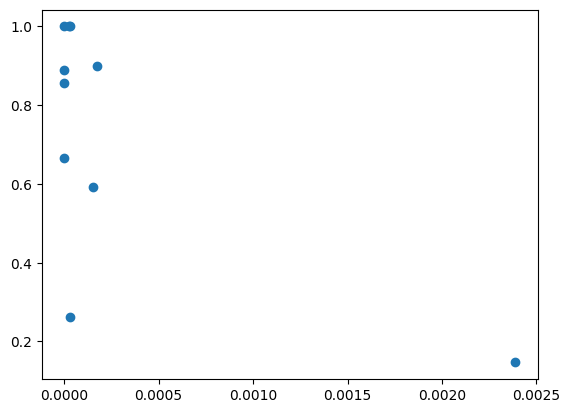

In [ ]:
plt.scatter(f1_per_hook[hookb], f1_per_hook[hookw])

          f1  precision    recall   auc_roc    auc_pr  matthews       bce  \
0   0.000000   0.000000  0.000000  0.982488  0.274318  0.000000  0.063995   
1   0.002388   0.001233  0.037628  0.486442  0.012056 -0.084861  2.137272   
2   0.168629   0.322523  0.114158  0.855107  0.134139  0.185753  0.077180   
3   0.176881   0.208297  0.153699  0.816683  0.110873  0.169630  0.078866   
4   0.173701   0.238839  0.136480  0.856822  0.113988  0.172439  0.072341   
5   0.162449   0.225624  0.126913  0.843109  0.105821  0.161063  0.075477   
6   0.164637   0.241082  0.125000  0.836774  0.120580  0.165832  0.071494   
7   0.166806   0.243276  0.126913  0.846418  0.128845  0.167946  0.069214   
8   0.176286   0.295352  0.125638  0.868378  0.152406  0.185843  0.063088   
9   0.209167   0.301683  0.160077  0.891777  0.199230  0.212362  0.057364   
10  0.216867   0.264706  0.183673  0.876004  0.179309  0.211960  0.062827   
11  0.177264   0.178525  0.176020  0.869243  0.143679  0.166453  0.070747   

          f1  precision  recall   auc_roc    auc_pr  matthews       bce  \
0   0.000000   0.000000     0.0  0.982408  0.000237  0.000000  0.043777   
1   0.000000   0.000000     0.0  0.399353  0.000014 -0.002987  2.803287   
2   0.003200   0.001603     1.0  0.999983  0.333333  0.039928  0.020516   
3   0.007194   0.003610     1.0  1.000000  1.000000  0.060015  0.012874   
4   0.007634   0.003831     1.0  1.000000  1.000000  0.061831  0.011297   
5   0.036364   0.018519     1.0  1.000000  1.000000  0.136053  0.004854   
6   0.021978   0.011111     1.0  1.000000  1.000000  0.105370  0.008122   
7   0.023810   0.012048     1.0  1.000000  1.000000  0.109727  0.006738   
8   0.019417   0.009804     1.0  1.000000  1.000000  0.098973  0.008455   
9   0.017094   0.008621     1.0  1.000000  1.000000  0.092803  0.007456   
10  0.014184   0.007143     1.0  1.000000  1.000000  0.084466  0.008104   
11  0.015267   0.007692     1.0  1.000000  1.000000  0.087659  0.007039   
12  0.015504   0.007812  

Text(0.5, 0, 'residual stream depth s')

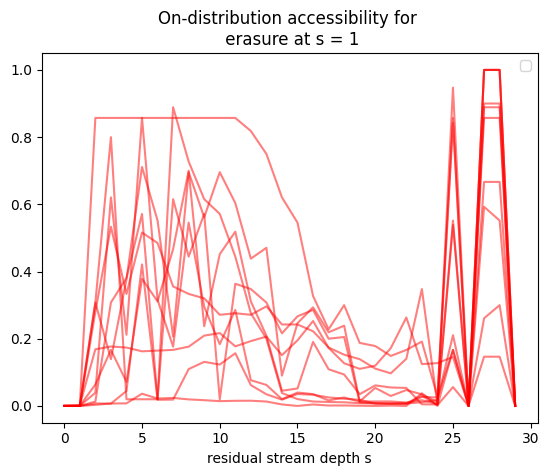

In [ ]:
plt.title(f'On-distribution accessibility for \n erasure at s = {1}')
#plt.plot(od_df['f1'],label='f1')
od_f1s = []
od_aucprs = []
for bid, od_eval in bid_od_evals.items():
  od_df = pd.DataFrame(od_eval)
  print(od_df.head(30))
  plt.plot(od_df['f1'], color='r',alpha=0.5)
  od_f1s.append(torch.from_numpy(od_df['f1'].to_numpy()))
  #od_aucprs.append(torch.from_numpy(od_df['auc_pr'].to_numpy()))
plt.legend()
plt.xlabel('residual stream depth s')

Text(0.5, 0, 'residual stream depth s')

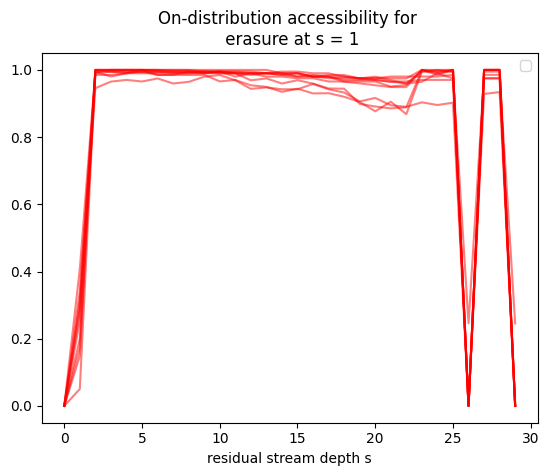

In [ ]:
plt.title(f'On-distribution accessibility for \n erasure at s = {1}')
#plt.plot(od_df['f1'],label='f1')
ofd_f1s = []
ofd_aucprs = []
for bid, ofd_eval in bid_ofd_evals.items():
  ofd_df = pd.DataFrame(ofd_eval)
  plt.plot(ofd_df['f1'], color='r',alpha=0.5)
  ofd_f1s.append(torch.from_numpy(ofd_df['f1'].to_numpy()))
  #od_aucprs.append(torch.from_numpy(od_df['auc_pr'].to_numpy()))
plt.legend()
plt.xlabel('residual stream depth s')

In [ ]:
len(bid_ofd_evals)

50

In [ ]:
torch.save({
    'bid_ofd_evals': bid_ofd_evals,
    'bid_od_evals': bid_od_evals
}, '/content/drive/MyDrive/thesis/zoomin/leace_downstream/od_ofd_evals_dicts_50bids.pt')

In [ ]:
bid_evals = torch.load('/content/drive/MyDrive/thesis/zoomin/leace_downstream/od_ofd_evals_dicts_50bids.pt')

In [ ]:
bid_ofd_evals = bid_evals['bid_ofd_evals']

In [ ]:
len(bid_ofd_evals[0])

28

In [ ]:
ofd_f1s = []
ofd_aucprs = []
od_f1s = []
od_aucprs = []
for (bid, ofd_eval), (bid, od_eval) in zip(bid_evals['bid_ofd_evals'].items(),bid_evals['bid_od_evals'].items()):
  ofd_df = pd.DataFrame(ofd_eval)
  od_df = pd.DataFrame(od_eval)
  plt.plot(ofd_df['f1'], color='r',alpha=0.5)
  ofd_f1s.append(torch.from_numpy(ofd_df['f1'].to_numpy()))

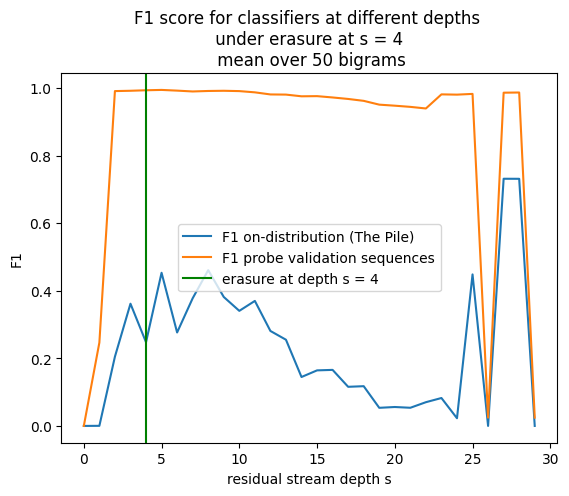

In [ ]:
plt.plot(torch.stack(od_f1s).mean(dim=0),label='F1 on-distribution (The Pile)')
plt.plot(torch.stack(ofd_f1s).mean(dim=0),label='F1 probe validation sequences')
plt.axvline(x=4,c='green',label='erasure at depth s = 4')
plt.title('F1 score for classifiers at different depths \n under erasure at s = 4 \n mean over 50 bigrams')
plt.legend()
plt.xlabel('residual stream depth s')
plt.ylabel('F1')
plt.savefig('f1_leacedownstream.png',dpi=300)

Text(0.5, 0, 'residual stream depth s')

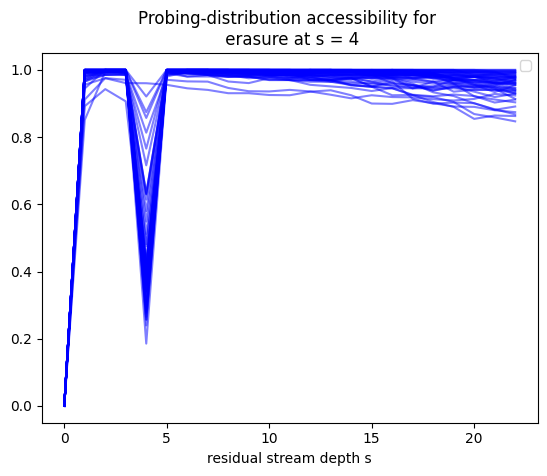

In [ ]:
plt.title(f'Probing-distribution accessibility for \n erasure at s = {erase_s}')
#plt.plot(od_df['f1'],label='f1')
for bid, ofd_eval in bid_ofd_evals.items():
  ofd_df = pd.DataFrame(ofd_eval)
  plt.plot(ofd_df['f1'], color='blue',alpha=0.5)
plt.legend()
plt.xlabel('residual stream depth s')

Text(0.5, 0, 'residual stream depth s')

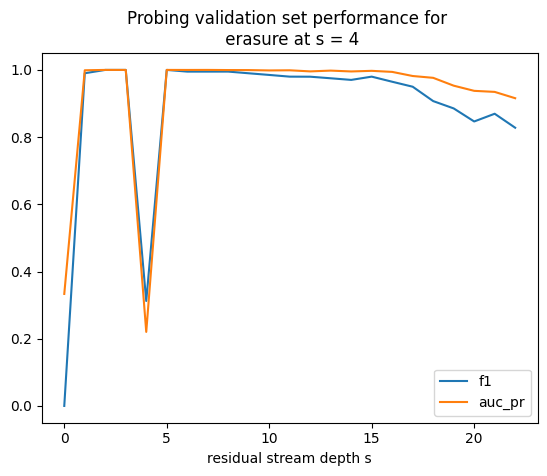

In [ ]:
plt.title(f'Probing validation set performance for \n erasure at s = {erase_s}')
plt.plot(ofd_df['f1'],label='f1')
plt.plot(ofd_df['auc_pr'],label='auc_pr')
plt.legend()
plt.xlabel('residual stream depth s')

In [ ]:
CB_probes_resids_metrics_df.head(10)

,f1,accuracy,sensitivity,specificity,nll,hook_name
0,0.851064,0.944,tensor(0.8000),tensor(0.9800),0.162063,blocks.1.hook_resid_pre
1,0.995025,0.998,tensor(1.),tensor(0.9975),0.007172,blocks.2.hook_resid_pre
2,0.995025,0.998,tensor(1.),tensor(0.9975),0.007292,blocks.3.hook_resid_pre
3,0.377682,0.710,tensor(0.4400),tensor(0.7775),1.301127,blocks.4.hook_resid_pre
4,0.995025,0.998,tensor(1.),tensor(0.9975),0.003886,blocks.5.hook_resid_pre


In [ ]:
X_train_B_snext['blocks.4.ln2.hook_normalized'].shape

torch.Size([1000, 1024])

In [ ]:
randproj = torch.randn(1024,4*1024)

In [ ]:
projected_trainb = torch.einsum('nd,df->nf', X_train_B_snext['blocks.4.ln2.hook_normalized'], randproj)
projected_val = torch.einsum('nd,df->nf', X_val_snext['blocks.4.ln2.hook_normalized'], randproj)

In [ ]:
X_train_B_snext['blocks.4.mlp.hook_pre'].shape

torch.Size([1000, 4096])

In [ ]:
CB_s = LogisticRegression(random_state=1, max_iter=10000).fit(X_train_B_snext['blocks.4.mlp.hook_pre'].cpu(), dset_B_bin_labels.cpu())

In [ ]:
eval_probe_on_val(CB_s, X_val_snext['blocks.4.mlp.hook_pre'].cpu(), vdset_bin_labels.cpu())

{'f1': 0.9950248756218906,
 'accuracy': 0.998,
 'sensitivity': tensor(1.),
 'specificity': tensor(0.9975),
 'nll': 0.0074705578228999965}

In [ ]:
CB_proj = LogisticRegression(random_state=1, max_iter=10000, C=1e-3).fit(projected_trainb.cpu(), dset_B_bin_labels.cpu())

In [ ]:
eval_probe_on_val(CB_proj, projected_val.cpu(), vdset_bin_labels.cpu())

{'f1': 0.9950248756218906,
 'accuracy': 0.998,
 'sensitivity': tensor(1.),
 'specificity': tensor(0.9975),
 'nll': 0.013488399620137613}

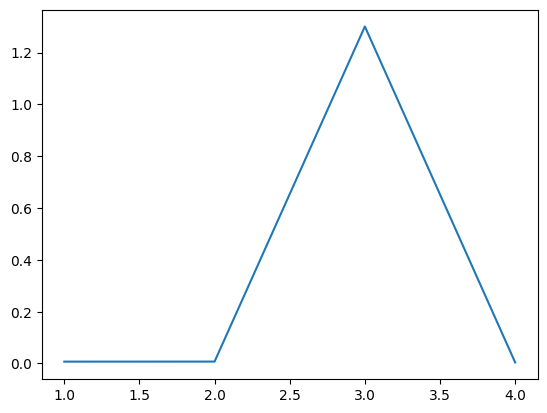

In [ ]:
plt.plot(CB_probes_resids_metrics_df['nll'][1:])

In [ ]:
CB_probes_metrics_df

,f1,accuracy,sensitivity,specificity,nll
0,0.000000,0.800,tensor(0.),tensor(1.),0.388107
1,1.000000,1.000,tensor(1.),tensor(1.),0.018960
2,0.995025,0.998,tensor(1.),tensor(0.9975),0.012405
3,0.995025,0.998,tensor(1.),tensor(0.9975),0.011408
4,0.415385,0.696,tensor(0.5400),tensor(0.7350),1.159058
5,0.995025,0.998,tensor(1.),tensor(0.9975),0.010864
6,0.995025,0.998,tensor(1.),tensor(0.9975),0.011425
7,0.995025,0.998,tensor(1.),tensor(0.9975),0.012951
8,0.995025,0.998,tensor(1.),tensor(0.9975),0.012382
9,0.995025,0.998,tensor(1.),tensor(0.9975),0.011046


In [ ]:
plt.plot(post_probes_metrics_df['f1'][1:],marker='o',alpha=0.5,label='Validation F1 for probes trained \n on ablated distribution on ablated distribution')
plt.plot(pre_probes_metrics_df['f1'][1:],marker='o',alpha=0.5,label='Validation F1 for probes trained \n on unablated distribution on ablated distribution')
plt.axvline(x=current_s, color='red', label='ablation depth position s = 4')
plt.ylabel('F1 score')
plt.xlabel('residual stream depth (s)')


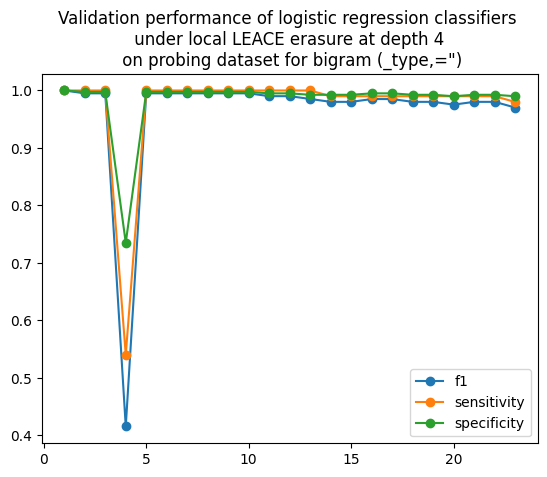

In [ ]:
for metric in ['f1', 'sensitivity', 'specificity']:
  plt.plot(CB_probes_metrics_df[metric][1:], marker='o', label=metric)
  plt.legend()
plt.title('Validation performance of logistic regression classifiers \n under local LEACE erasure at depth 4 \n on probing dataset for bigram (_type,=")')
plt.legend()
#plt.ylim((0,1.0))
#plt.setyticks()
plt.savefig('leace_3_depth4_valid.png',dpi=300)

In [ ]:
pre_probes_metrics = []
post_probes_metrics = []
for hook_name, pre_erase_probe in probes.items():
  print('hook_name', hook_name)
  print('Pre erase probe')
  pre_erase_probe_metrics, _, _ = evaluate_probe(pre_erase_probe, hook_name, 'sk', X_val_snext[hook_name].cpu(), halfadv_val_fixed_labels_A[hook_name].cpu(), return_labels=True, print_stuff=False)
  post_erase_probe = LogisticRegression(random_state=0, max_iter=10000).fit(X_train_snext[hook_name].cpu(), halfadv_train_fixed_labels_A[hook_name].cpu())
  print('Post erase probe')
  post_erase_probe_metrics, _, _ = evaluate_probe(post_erase_probe, erase_snext_hookname, 'sk', X_val_snext[hook_name].cpu(), halfadv_val_fixed_labels_A[hook_name].cpu(), return_labels=True, print_stuff=False)
  pre_probes_metrics.append(pre_erase_probe_metrics)
  post_probes_metrics.append(post_erase_probe_metrics)
  #pre_erase_probe_snext_metrics = evaluate_probe(pre_erase_probe_snext, erase_snext_hookname, 'sk', X_val_snext.squeeze().cpu(), halfadv_val_fixed_labels_A[erase_snext_hookname].cpu(), return_labels=True, print_stuff=True)

hook_name blocks.0.hook_resid_pre
Pre erase probe


NameError: ignored

In [ ]:
pre_probes_metrics_df = pd.DataFrame(pre_probes_metrics)
post_probes_metrics_df = pd.DataFrame(post_probes_metrics)

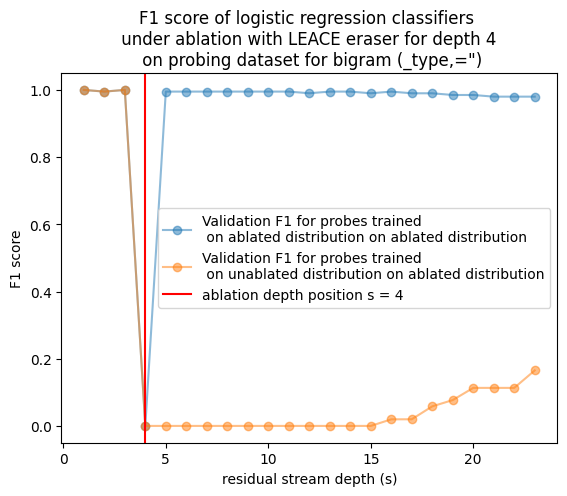

In [ ]:
plt.plot(post_probes_metrics_df['f1'][1:],marker='o',alpha=0.5,label='Validation F1 for probes trained \n on ablated distribution on ablated distribution')
plt.plot(pre_probes_metrics_df['f1'][1:],marker='o',alpha=0.5,label='Validation F1 for probes trained \n on unablated distribution on ablated distribution')
plt.axvline(x=current_s, color='red', label='ablation depth position s = 4')
plt.ylabel('F1 score')
plt.xlabel('residual stream depth (s)')
plt.title('F1 score of logistic regression classifiers \n under ablation with LEACE eraser for depth 4 \n on probing dataset for bigram (_type,=")')
plt.legend()
plt.savefig('leace_3_depth4.png',dpi=300)

In [ ]:
plt.plot(pre_probes_metrics_df['f1'][1:],label='F1 of new probes')
plt.plot(post_probes_metrics_df['f1'][1:],label='F1 of existing probes')
plt.legend()

In [ ]:
plt.plot(pre_probes_metrics_df['f1'])

In [ ]:
pre_probes_metrics_df

,f1,accuracy,sensitivity,specificity
0,0.000000,0.800,tensor(0.),tensor(1.)
1,1.000000,1.000,tensor(1.),tensor(1.)
2,0.995025,0.998,tensor(1.),tensor(0.9975)
3,1.000000,1.000,tensor(1.),tensor(1.)
4,0.000000,0.800,tensor(0.),tensor(1.)
5,0.000000,0.800,tensor(0.),tensor(1.)
6,0.000000,0.800,tensor(0.),tensor(1.)
7,0.000000,0.800,tensor(0.),tensor(1.)
8,0.000000,0.800,tensor(0.),tensor(1.)
9,0.000000,0.800,tensor(0.),tensor(1.)


In [ ]:
pre_probes_metrics_df

,0,1,2
0,"{'f1': 0.0, 'accuracy': 0.8, 'sensitivity': te...","[tensor(1.), tensor(1.), tensor(1.), tensor(1....","[tensor(0.), tensor(0.), tensor(0.), tensor(0...."
1,"{'f1': 1.0, 'accuracy': 1.0, 'sensitivity': te...","[tensor(1.), tensor(1.), tensor(1.), tensor(1....","[tensor(1.), tensor(1.), tensor(1.), tensor(1...."
2,"{'f1': 0.9950248756218906, 'accuracy': 0.998, ...","[tensor(1.), tensor(1.), tensor(1.), tensor(1....","[tensor(1.), tensor(1.), tensor(1.), tensor(1...."
3,"{'f1': 1.0, 'accuracy': 1.0, 'sensitivity': te...","[tensor(1.), tensor(1.), tensor(1.), tensor(1....","[tensor(1.), tensor(1.), tensor(1.), tensor(1...."
4,"{'f1': 0.0, 'accuracy': 0.8, 'sensitivity': te...","[tensor(1.), tensor(1.), tensor(1.), tensor(1....","[tensor(0.), tensor(0.), tensor(0.), tensor(0...."
5,"{'f1': 0.0, 'accuracy': 0.8, 'sensitivity': te...","[tensor(1.), tensor(1.), tensor(1.), tensor(1....","[tensor(0.), tensor(0.), tensor(0.), tensor(0...."
6,"{'f1': 0.0, 'accuracy': 0.8, 'sensitivity': te...","[tensor(1.), tensor(1.), tensor(1.), tensor(1....","[tensor(0.), tensor(0.), tensor(0.), tensor(0...."
7,"{'f1': 0.0, 'accuracy': 0.8, 'sensitivity': te...","[tensor(1.), tensor(1.), tensor(1.), tensor(1....","[tensor(0.), tensor(0.), tensor(0.), tensor(0...."
8,"{'f1': 0.0, 'accuracy': 0.8, 'sensitivity': te...","[tensor(1.), tensor(1.), tensor(1.), tensor(1....","[tensor(0.), tensor(0.), tensor(0.), tensor(0...."
9,"{'f1': 0.0, 'accuracy': 0.8, 'sensitivity': te...","[tensor(1.), tensor(1.), tensor(1.), tensor(1....","[tensor(0.), tensor(0.), tensor(0.), tensor(0...."


In [ ]:
y_train = halfadv_train_fixed_labels_A[erase_snext_hookname]
y_val = halfadv_val_fixed_labels_A[erase_snext_hookname]

In [ ]:
X_val_snext.shape

torch.Size([500, 1, 1024])

In [ ]:
pre_erase_probe_snext.predict(X_val_snext.squeeze().cpu())

array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0.

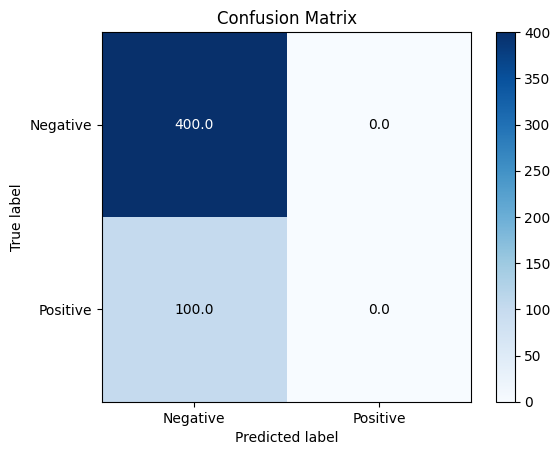

F1 Score: 0.0
Accuracy: 0.8
Sensitivity: 0.0
Specificity: 1.0


In [ ]:
pre_erase_probe_snext_metrics = evaluate_probe(pre_erase_probe_snext, erase_snext_hookname, 'sk', X_val_snext.squeeze().cpu(), halfadv_val_fixed_labels_A[erase_snext_hookname].cpu(), return_labels=True, print_stuff=True)
post_erase_probe_snext = LogisticRegression(random_state=0, max_iter=10000).fit(X_train_erased.squeeze().cpu(), halfadv_train_fixed_labels_A[logreg_hook_name].cpu())
post_erase_probe_snext_metrics = evaluate_probe(post_erase_probe_snext, erase_snext_hookname, 'sk', X_val_snext.squeeze().cpu(), halfadv_val_fixed_labels_A[erase_snext_hookname].cpu(), return_labels=True, print_stuff=True)

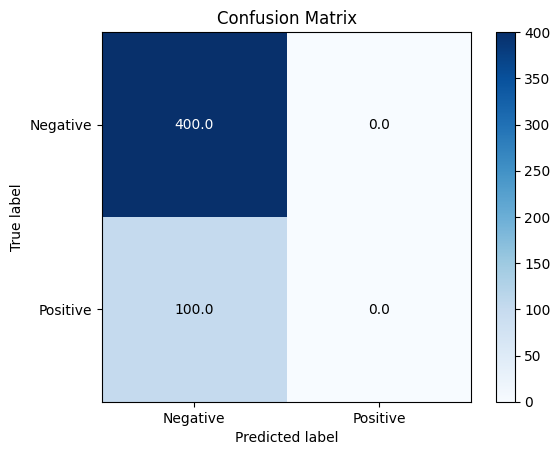

F1 Score: 0.0
Accuracy: 0.8
Sensitivity: 0.0
Specificity: 1.0


In [ ]:
pre_erase_probe_s.predict(current_values_dict[erase_s_hookname].cpu())

array([0.], dtype=float32)

In [ ]:
pre_erase_probe_snext.predict(current_values_dict[erase_snext_hookname].cpu())

array([0.], dtype=float32)

# Zooming in - LEACE

In [ ]:
bid = 123

In [ ]:
print_bigram_id(bid)

tensor([352, 369])  it was


' it was'

In [ ]:
dset_dict = select_dset_dict_by_bigram_id(bid, some_resid_hooks)
probes_dict = select_probes_by_dset_dict(dset_dict)

In [ ]:
def leace_hook_fc(value, hook):
  #print('leacing', hook.name)
  global probes_dict
  erased_value = probes_dict[hook.name]['eraser'](value)
  #print(value.mean(), erased_value.mean())
  return erased_value

In [ ]:
loss_cleans = []
loss_eraseds = {hook_name : [] for hook_name in some_resid_hooks}
for i, batch_list in tqdm(enumerate(Tv_loader)):
  batch = batch_list[0]
  with torch.no_grad():
    loss_clean = model.run_with_hooks(
        batch.to(device),
        return_type = 'loss',
        fwd_hooks=[]
    )
    loss_cleans.append(loss_clean)
  for hook_name in some_resid_hooks:
    with torch.no_grad():
      loss_erased = model.run_with_hooks(
          batch.to(device),
          return_type = 'loss',
          fwd_hooks=[(hook_name, leace_hook_fc)]
      )
    print(hook_name, loss_clean, loss_erased)
    loss_eraseds[hook_name].append(loss_erased)


0it [00:00, ?it/s]

blocks.1.hook_resid_pre tensor(2.1925, device='cuda:0') tensor(2.3193, device='cuda:0')
blocks.2.hook_resid_pre tensor(2.1925, device='cuda:0') tensor(2.2451, device='cuda:0')
blocks.3.hook_resid_pre tensor(2.1925, device='cuda:0') tensor(2.2231, device='cuda:0')
blocks.4.hook_resid_pre tensor(2.1925, device='cuda:0') tensor(2.2778, device='cuda:0')
blocks.5.hook_resid_pre tensor(2.1925, device='cuda:0') tensor(2.3017, device='cuda:0')
blocks.6.hook_resid_pre tensor(2.1925, device='cuda:0') tensor(2.2680, device='cuda:0')
blocks.8.hook_resid_pre tensor(2.1925, device='cuda:0') tensor(2.2843, device='cuda:0')
blocks.11.hook_resid_pre tensor(2.1925, device='cuda:0') tensor(2.3172, device='cuda:0')
blocks.14.hook_resid_pre 

1it [00:15, 15.62s/it]

tensor(2.1925, device='cuda:0') tensor(2.2667, device='cuda:0')
blocks.1.hook_resid_pre tensor(1.7777, device='cuda:0') tensor(1.9094, device='cuda:0')
blocks.2.hook_resid_pre tensor(1.7777, device='cuda:0') tensor(1.8582, device='cuda:0')
blocks.3.hook_resid_pre tensor(1.7777, device='cuda:0') tensor(1.8055, device='cuda:0')
blocks.4.hook_resid_pre tensor(1.7777, device='cuda:0') tensor(1.9438, device='cuda:0')
blocks.5.hook_resid_pre tensor(1.7777, device='cuda:0') tensor(1.9373, device='cuda:0')
blocks.6.hook_resid_pre tensor(1.7777, device='cuda:0') tensor(1.8690, device='cuda:0')
blocks.8.hook_resid_pre tensor(1.7777, device='cuda:0') tensor(1.8838, device='cuda:0')
blocks.11.hook_resid_pre tensor(1.7777, device='cuda:0') tensor(1.9440, device='cuda:0')
blocks.14.hook_resid_pre 

2it [00:31, 15.78s/it]

tensor(1.7777, device='cuda:0') tensor(1.8881, device='cuda:0')
blocks.1.hook_resid_pre tensor(2.2612, device='cuda:0') tensor(2.3666, device='cuda:0')
blocks.2.hook_resid_pre tensor(2.2612, device='cuda:0') tensor(2.3138, device='cuda:0')
blocks.3.hook_resid_pre tensor(2.2612, device='cuda:0') tensor(2.2810, device='cuda:0')
blocks.4.hook_resid_pre tensor(2.2612, device='cuda:0') tensor(2.3326, device='cuda:0')
blocks.5.hook_resid_pre tensor(2.2612, device='cuda:0') tensor(2.3487, device='cuda:0')
blocks.6.hook_resid_pre tensor(2.2612, device='cuda:0') tensor(2.3198, device='cuda:0')
blocks.8.hook_resid_pre tensor(2.2612, device='cuda:0') tensor(2.3432, device='cuda:0')
blocks.11.hook_resid_pre tensor(2.2612, device='cuda:0') tensor(2.3977, device='cuda:0')
blocks.14.hook_resid_pre 

3it [00:47, 15.97s/it]

tensor(2.2612, device='cuda:0') tensor(2.3527, device='cuda:0')
blocks.1.hook_resid_pre tensor(2.2477, device='cuda:0') tensor(2.4089, device='cuda:0')
blocks.2.hook_resid_pre tensor(2.2477, device='cuda:0') tensor(2.3423, device='cuda:0')
blocks.3.hook_resid_pre tensor(2.2477, device='cuda:0') tensor(2.2850, device='cuda:0')
blocks.4.hook_resid_pre tensor(2.2477, device='cuda:0') tensor(2.4370, device='cuda:0')
blocks.5.hook_resid_pre tensor(2.2477, device='cuda:0') tensor(2.4583, device='cuda:0')
blocks.6.hook_resid_pre tensor(2.2477, device='cuda:0') tensor(2.3874, device='cuda:0')
blocks.8.hook_resid_pre tensor(2.2477, device='cuda:0') tensor(2.4099, device='cuda:0')
blocks.11.hook_resid_pre tensor(2.2477, device='cuda:0') tensor(2.4945, device='cuda:0')
blocks.14.hook_resid_pre 

4it [01:04, 16.16s/it]

tensor(2.2477, device='cuda:0') tensor(2.3969, device='cuda:0')
blocks.1.hook_resid_pre tensor(1.9213, device='cuda:0') tensor(2.0066, device='cuda:0')
blocks.2.hook_resid_pre tensor(1.9213, device='cuda:0') tensor(1.9606, device='cuda:0')
blocks.3.hook_resid_pre tensor(1.9213, device='cuda:0') tensor(1.9365, device='cuda:0')
blocks.4.hook_resid_pre tensor(1.9213, device='cuda:0') tensor(2.0026, device='cuda:0')
blocks.5.hook_resid_pre tensor(1.9213, device='cuda:0') tensor(2.0129, device='cuda:0')
blocks.6.hook_resid_pre tensor(1.9213, device='cuda:0') tensor(1.9790, device='cuda:0')
blocks.8.hook_resid_pre tensor(1.9213, device='cuda:0') tensor(2.0000, device='cuda:0')
blocks.11.hook_resid_pre tensor(1.9213, device='cuda:0') tensor(2.0318, device='cuda:0')
blocks.14.hook_resid_pre 

5it [01:21, 16.44s/it]

tensor(1.9213, device='cuda:0') tensor(1.9891, device='cuda:0')
blocks.1.hook_resid_pre tensor(2.3683, device='cuda:0') tensor(2.4837, device='cuda:0')
blocks.2.hook_resid_pre tensor(2.3683, device='cuda:0') tensor(2.4274, device='cuda:0')
blocks.3.hook_resid_pre tensor(2.3683, device='cuda:0') tensor(2.3877, device='cuda:0')
blocks.4.hook_resid_pre tensor(2.3683, device='cuda:0') tensor(2.4609, device='cuda:0')
blocks.5.hook_resid_pre tensor(2.3683, device='cuda:0') tensor(2.4815, device='cuda:0')
blocks.6.hook_resid_pre tensor(2.3683, device='cuda:0') tensor(2.4446, device='cuda:0')
blocks.8.hook_resid_pre tensor(2.3683, device='cuda:0') tensor(2.4700, device='cuda:0')
blocks.11.hook_resid_pre tensor(2.3683, device='cuda:0') tensor(2.5045, device='cuda:0')
blocks.14.hook_resid_pre 

6it [01:38, 16.68s/it]

tensor(2.3683, device='cuda:0') tensor(2.4619, device='cuda:0')
blocks.1.hook_resid_pre tensor(2.6904, device='cuda:0') tensor(2.8104, device='cuda:0')
blocks.2.hook_resid_pre tensor(2.6904, device='cuda:0') tensor(2.7434, device='cuda:0')
blocks.3.hook_resid_pre tensor(2.6904, device='cuda:0') tensor(2.7100, device='cuda:0')
blocks.4.hook_resid_pre tensor(2.6904, device='cuda:0') tensor(2.7804, device='cuda:0')
blocks.5.hook_resid_pre tensor(2.6904, device='cuda:0') tensor(2.7946, device='cuda:0')
blocks.6.hook_resid_pre tensor(2.6904, device='cuda:0') tensor(2.7597, device='cuda:0')
blocks.8.hook_resid_pre tensor(2.6904, device='cuda:0') tensor(2.7626, device='cuda:0')
blocks.11.hook_resid_pre tensor(2.6904, device='cuda:0') tensor(2.8140, device='cuda:0')
blocks.14.hook_resid_pre 

7it [01:54, 16.70s/it]

tensor(2.6904, device='cuda:0') tensor(2.7627, device='cuda:0')
blocks.1.hook_resid_pre tensor(2.2532, device='cuda:0') tensor(2.3524, device='cuda:0')
blocks.2.hook_resid_pre tensor(2.2532, device='cuda:0') tensor(2.3062, device='cuda:0')
blocks.3.hook_resid_pre tensor(2.2532, device='cuda:0') tensor(2.2768, device='cuda:0')
blocks.4.hook_resid_pre tensor(2.2532, device='cuda:0') tensor(2.3322, device='cuda:0')
blocks.5.hook_resid_pre tensor(2.2532, device='cuda:0') tensor(2.3433, device='cuda:0')
blocks.6.hook_resid_pre tensor(2.2532, device='cuda:0') tensor(2.3157, device='cuda:0')
blocks.8.hook_resid_pre tensor(2.2532, device='cuda:0') tensor(2.3359, device='cuda:0')
blocks.11.hook_resid_pre tensor(2.2532, device='cuda:0') tensor(2.3695, device='cuda:0')
blocks.14.hook_resid_pre 

8it [02:11, 16.66s/it]

tensor(2.2532, device='cuda:0') tensor(2.3227, device='cuda:0')
blocks.1.hook_resid_pre tensor(2.3052, device='cuda:0') tensor(2.4681, device='cuda:0')
blocks.2.hook_resid_pre tensor(2.3052, device='cuda:0') tensor(2.3635, device='cuda:0')
blocks.3.hook_resid_pre tensor(2.3052, device='cuda:0') tensor(2.3271, device='cuda:0')
blocks.4.hook_resid_pre tensor(2.3052, device='cuda:0') tensor(2.4052, device='cuda:0')
blocks.5.hook_resid_pre tensor(2.3052, device='cuda:0') tensor(2.4068, device='cuda:0')
blocks.6.hook_resid_pre tensor(2.3052, device='cuda:0') tensor(2.3698, device='cuda:0')
blocks.8.hook_resid_pre tensor(2.3052, device='cuda:0') tensor(2.3810, device='cuda:0')
blocks.11.hook_resid_pre tensor(2.3052, device='cuda:0') tensor(2.4306, device='cuda:0')
blocks.14.hook_resid_pre 

9it [02:28, 16.63s/it]

tensor(2.3052, device='cuda:0') tensor(2.3916, device='cuda:0')
blocks.1.hook_resid_pre tensor(2.4754, device='cuda:0') tensor(2.5867, device='cuda:0')
blocks.2.hook_resid_pre tensor(2.4754, device='cuda:0') tensor(2.5207, device='cuda:0')
blocks.3.hook_resid_pre tensor(2.4754, device='cuda:0') tensor(2.4915, device='cuda:0')
blocks.4.hook_resid_pre tensor(2.4754, device='cuda:0') tensor(2.5608, device='cuda:0')
blocks.5.hook_resid_pre tensor(2.4754, device='cuda:0') tensor(2.5621, device='cuda:0')
blocks.6.hook_resid_pre tensor(2.4754, device='cuda:0') tensor(2.5342, device='cuda:0')
blocks.8.hook_resid_pre tensor(2.4754, device='cuda:0') tensor(2.5314, device='cuda:0')
blocks.11.hook_resid_pre tensor(2.4754, device='cuda:0') tensor(2.5889, device='cuda:0')
blocks.14.hook_resid_pre 

10it [02:44, 16.65s/it]

tensor(2.4754, device='cuda:0') tensor(2.5519, device='cuda:0')
blocks.1.hook_resid_pre tensor(2.3930, device='cuda:0') tensor(2.5109, device='cuda:0')
blocks.2.hook_resid_pre tensor(2.3930, device='cuda:0') tensor(2.4520, device='cuda:0')
blocks.3.hook_resid_pre tensor(2.3930, device='cuda:0') tensor(2.4117, device='cuda:0')
blocks.4.hook_resid_pre tensor(2.3930, device='cuda:0') tensor(2.4873, device='cuda:0')
blocks.5.hook_resid_pre tensor(2.3930, device='cuda:0') tensor(2.5139, device='cuda:0')
blocks.6.hook_resid_pre tensor(2.3930, device='cuda:0') tensor(2.4630, device='cuda:0')
blocks.8.hook_resid_pre tensor(2.3930, device='cuda:0') tensor(2.4904, device='cuda:0')
blocks.11.hook_resid_pre tensor(2.3930, device='cuda:0') tensor(2.5203, device='cuda:0')
blocks.14.hook_resid_pre 

11it [03:01, 16.69s/it]

tensor(2.3930, device='cuda:0') tensor(2.4725, device='cuda:0')
blocks.1.hook_resid_pre tensor(2.1801, device='cuda:0') tensor(2.3271, device='cuda:0')
blocks.2.hook_resid_pre tensor(2.1801, device='cuda:0') tensor(2.2425, device='cuda:0')
blocks.3.hook_resid_pre tensor(2.1801, device='cuda:0') tensor(2.2054, device='cuda:0')
blocks.4.hook_resid_pre tensor(2.1801, device='cuda:0') tensor(2.2933, device='cuda:0')
blocks.5.hook_resid_pre tensor(2.1801, device='cuda:0') tensor(2.3049, device='cuda:0')
blocks.6.hook_resid_pre tensor(2.1801, device='cuda:0') tensor(2.2493, device='cuda:0')
blocks.8.hook_resid_pre tensor(2.1801, device='cuda:0') tensor(2.2505, device='cuda:0')
blocks.11.hook_resid_pre tensor(2.1801, device='cuda:0') tensor(2.2905, device='cuda:0')
blocks.14.hook_resid_pre 

12it [03:18, 16.71s/it]

tensor(2.1801, device='cuda:0') tensor(2.2482, device='cuda:0')
blocks.1.hook_resid_pre tensor(1.4508, device='cuda:0') tensor(1.5354, device='cuda:0')
blocks.2.hook_resid_pre tensor(1.4508, device='cuda:0') tensor(1.5103, device='cuda:0')
blocks.3.hook_resid_pre tensor(1.4508, device='cuda:0') tensor(1.4691, device='cuda:0')
blocks.4.hook_resid_pre tensor(1.4508, device='cuda:0') tensor(1.5526, device='cuda:0')
blocks.5.hook_resid_pre tensor(1.4508, device='cuda:0') tensor(1.5682, device='cuda:0')
blocks.6.hook_resid_pre tensor(1.4508, device='cuda:0') tensor(1.5190, device='cuda:0')
blocks.8.hook_resid_pre tensor(1.4508, device='cuda:0') tensor(1.5424, device='cuda:0')
blocks.11.hook_resid_pre tensor(1.4508, device='cuda:0') tensor(1.6018, device='cuda:0')
blocks.14.hook_resid_pre 

13it [03:35, 16.72s/it]

tensor(1.4508, device='cuda:0') tensor(1.5428, device='cuda:0')
blocks.1.hook_resid_pre tensor(1.9834, device='cuda:0') tensor(2.1146, device='cuda:0')
blocks.2.hook_resid_pre tensor(1.9834, device='cuda:0') tensor(2.0403, device='cuda:0')
blocks.3.hook_resid_pre tensor(1.9834, device='cuda:0') tensor(2.0096, device='cuda:0')
blocks.4.hook_resid_pre tensor(1.9834, device='cuda:0') tensor(2.0987, device='cuda:0')
blocks.5.hook_resid_pre tensor(1.9834, device='cuda:0') tensor(2.1233, device='cuda:0')
blocks.6.hook_resid_pre tensor(1.9834, device='cuda:0') tensor(2.0624, device='cuda:0')
blocks.8.hook_resid_pre tensor(1.9834, device='cuda:0') tensor(2.0881, device='cuda:0')
blocks.11.hook_resid_pre tensor(1.9834, device='cuda:0') tensor(2.1269, device='cuda:0')
blocks.14.hook_resid_pre 

14it [03:51, 16.57s/it]

tensor(1.9834, device='cuda:0') tensor(2.0725, device='cuda:0')


KeyboardInterrupt: ignored

In [ ]:
loss_eraseds_per_bid = {}

In [ ]:
loss_eraseds_per_bid[bid] = loss_eraseds

In [ ]:
probes_dict = None

In [ ]:
for did in range(0,2000,50):
  bid = dope_bigram_ids[did].item()
  print(bid)
  if bid in loss_eraseds_per_bid:
    print('conintuing')
    continue
  dset_dict = select_dset_dict_by_bigram_id(bid, some_resid_hooks)
  global probes_dict
  probes_dict = select_probes_by_dset_dict(dset_dict)
  loss_eraseds_per_bid[bid] = {hook_name : [] for hook_name in some_resid_hooks}
  for i, batch_list in tqdm(enumerate(Tv_loader)):
    batch = batch_list[0]
    for hook_name in some_resid_hooks:
      with torch.no_grad():
        loss_erased = model.run_with_hooks(
            batch.to(device),
            return_type = 'loss',
            fwd_hooks=[(hook_name, leace_hook_fc)]
        )
      #print(hook_name, loss_clean, loss_erased)
      loss_eraseds_per_bid[bid][hook_name].append(loss_erased.item())
    if i == 13:
      break

0
conintuing
68
conintuing
135
conintuing
194
conintuing
262
conintuing
332
conintuing
387
conintuing
443
conintuing
502
conintuing
559
conintuing
612
conintuing
665
conintuing
723
conintuing
777
conintuing
833
conintuing
890
conintuing
947
conintuing
1001
conintuing
1060
conintuing
1116
conintuing
1172


13it [03:20, 15.45s/it]


1226


13it [03:27, 15.93s/it]


1282


13it [03:28, 16.03s/it]


1334


13it [03:28, 16.00s/it]


1393


13it [03:28, 16.03s/it]


1448


13it [03:28, 16.04s/it]


1503


13it [03:28, 16.03s/it]


1557


13it [03:28, 16.04s/it]


1614


13it [03:28, 16.02s/it]


1668


13it [03:26, 15.91s/it]


1720


13it [03:28, 16.01s/it]


1777


13it [03:28, 16.03s/it]


1836


13it [03:28, 16.07s/it]


1892


13it [03:29, 16.11s/it]


1946


13it [03:28, 16.03s/it]


1999


13it [03:28, 16.03s/it]


2057


13it [03:28, 16.06s/it]


2113


13it [03:28, 16.01s/it]


2168


13it [03:28, 16.01s/it]


2225


13it [03:27, 15.97s/it]


In [ ]:
len(loss_cleans)

14

In [ ]:
len(loss_eraseds_per_bid)

42

In [ ]:
torch.save({
    'loss_cleans': loss_cleans,
    'loss_eraseds_per_bid': loss_eraseds_per_bid,
    'batch_size': Tv_loader.batch_size
}, '/content/drive/MyDrive/thesis/zoomin/leace/leace_behavior_global_crossent/42_different_bids.pt')

In [ ]:
erased_dict

In [ ]:

torch.save({
    'type': 'tval',
    'batch_size': Tv_loader.batch_size,
    'loss_cleans': loss_cleans,
    'loss_eraseds': loss_eraseds
}, f'/content/drive/MyDrive/thesis/zoomin/leace/leace_behavior_global_crossent/{bid}.pt')

bid_od_dict = torch.load(f'/content/drive/MyDrive/thesis/zoomin/leace/leace_behavior_global_crossent/{bid}.pt', map_location=torch.device('cpu'))

In [ ]:
len(bid_od_dict['loss_cleans'])

14

In [ ]:
del loss_eraseds_per_bid[torch.tensor(0)]

KeyError: ignored

In [ ]:
loss_cleans_od

tensor([2.1925, 1.7777, 2.2612, 2.2477, 1.9213, 2.3683, 2.6904, 2.2532, 2.3052,
        2.4754, 2.3930, 2.1801, 1.4508, 1.9834])

In [ ]:
Tv_loader.batch_size

10

In [ ]:
11*11*600

92400

In [ ]:
print_bigram_id(bid)

0
tensor([187, 187]) '\n\n' '\n' '\n'
{'blocks.1.hook_resid_pre': [5.439957618713379, 5.093977928161621, 5.883073329925537, 5.32600736618042, 4.596371650695801, 4.826123237609863, 5.629246711730957, 5.3843793869018555, 5.7795729637146, 5.941977500915527, 5.944158554077148, 5.323597431182861, 4.092939376831055, 5.13876485824585], 'blocks.2.hook_resid_pre': [2.230318069458008, 1.8149386644363403, 2.286703586578369, 2.3030271530151367, 1.9628620147705078, 2.391428232192993, 2.7247507572174072, 2.2929108142852783, 2.3402087688446045, 2.519852876663208, 2.4131178855895996, 2.2100205421447754, 1.4874814748764038, 2.0082123279571533], 'blocks.3.hook_resid_pre': [2.2213025093078613, 1.8084622621536255, 2.2836368083953857, 2.2853050231933594, 1.945493221282959, 2.3835065364837646, 2.713921070098877, 2.2750489711761475, 2.322653293609619, 2.5040221214294434, 2.408780336380005, 2.2048542499542236, 1.4734907150268555, 2.0046799182891846], 'blocks.4.hook_resid_pre': [2.326214551925659, 1.8814899921

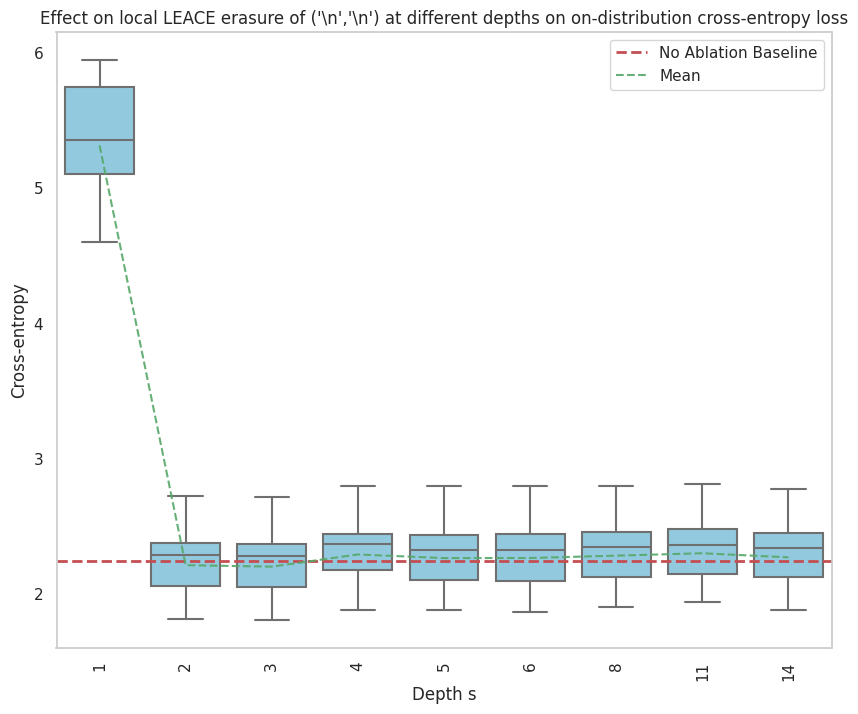

100
tensor([ 13, 344]) ', he' ',' ' he'
{'blocks.1.hook_resid_pre': [2.48319411277771, 2.1007649898529053, 2.6081488132476807, 2.7087249755859375, 2.163695812225342, 2.735964059829712, 3.01835036277771, 2.564157009124756, 2.624324083328247, 2.7921648025512695, 2.7245748043060303, 2.5491881370544434, 1.716048240661621, 2.2863287925720215], 'blocks.2.hook_resid_pre': [2.3273746967315674, 1.9936118125915527, 2.400424003601074, 2.493914842605591, 2.018686056137085, 2.5233492851257324, 2.832920789718628, 2.3877005577087402, 2.4596033096313477, 2.6101491451263428, 2.522012710571289, 2.42140531539917, 1.5901217460632324, 2.2098422050476074], 'blocks.3.hook_resid_pre': [2.2649784088134766, 1.8948885202407837, 2.33638596534729, 2.387918472290039, 1.9836223125457764, 2.449572801589966, 2.7751331329345703, 2.3217036724090576, 2.3904190063476562, 2.5369975566864014, 2.459207057952881, 2.3039774894714355, 1.5160671472549438, 2.0885493755340576], 'blocks.4.hook_resid_pre': [2.246187448501587, 1.8478

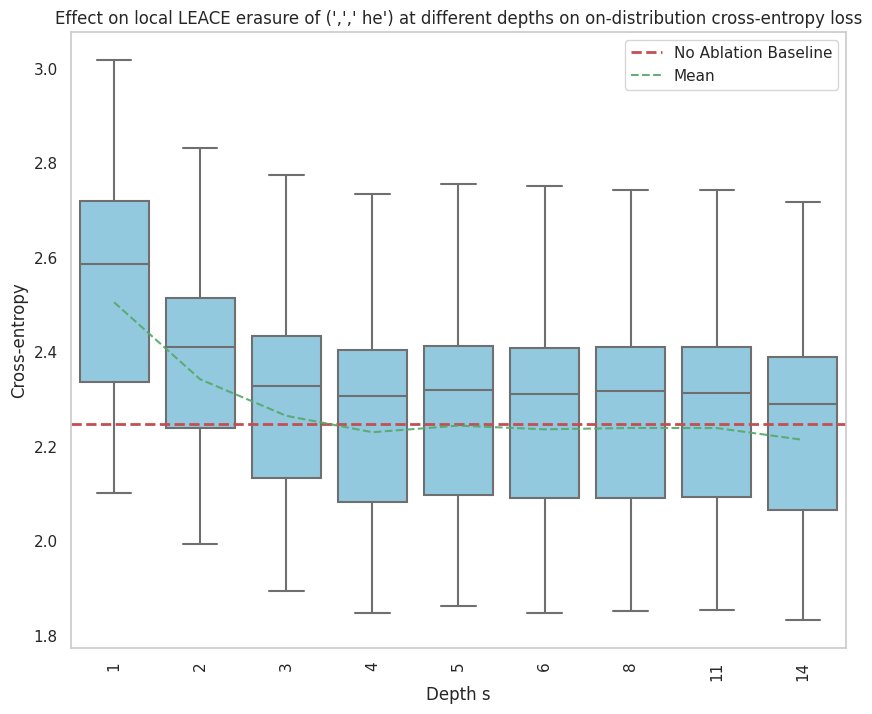

tensor(0)
135
tensor([347, 973]) ' as well' ' as' ' well'
{'blocks.1.hook_resid_pre': [2.2170560359954834, 1.805521011352539, 2.2831976413726807, 2.2893309593200684, 1.9396367073059082, 2.388972282409668, 2.715083122253418, 2.270686149597168, 2.332712173461914, 2.4948959350585938, 2.4167208671569824, 2.2077226638793945, 1.474364161491394, 2.010488510131836], 'blocks.2.hook_resid_pre': [2.233975410461426, 1.8260860443115234, 2.296525239944458, 2.298041582107544, 1.9441341161727905, 2.396749258041382, 2.7215468883514404, 2.2801005840301514, 2.342712879180908, 2.501534938812256, 2.4195971488952637, 2.221118688583374, 1.483730673789978, 2.0253982543945312], 'blocks.3.hook_resid_pre': [2.2290732860565186, 1.8274537324905396, 2.2949864864349365, 2.3047523498535156, 1.9402543306350708, 2.3962790966033936, 2.7225866317749023, 2.279203414916992, 2.3348898887634277, 2.502941131591797, 2.417415142059326, 2.210110902786255, 1.4751347303390503, 2.0207300186157227], 'blocks.4.hook_resid_pre': [2.212

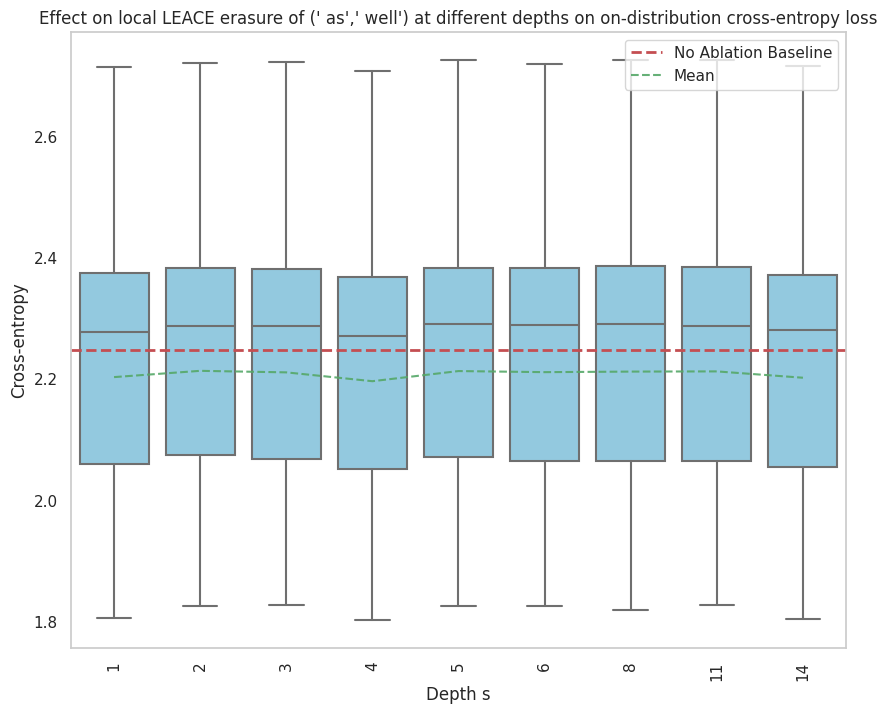

262
tensor([1621,   15]) ' No.' ' No' '.'
{'blocks.1.hook_resid_pre': [2.2145328521728516, 1.824844479560852, 2.2875494956970215, 2.285658359527588, 1.947216272354126, 2.3954710960388184, 2.720691204071045, 2.2749576568603516, 2.3318092823028564, 2.4953644275665283, 2.4187214374542236, 2.209092140197754, 1.4859559535980225, 2.0160984992980957], 'blocks.2.hook_resid_pre': [2.2253873348236084, 1.8460414409637451, 2.3005895614624023, 2.3212571144104004, 1.9495068788528442, 2.3981595039367676, 2.7298343181610107, 2.290817975997925, 2.339543104171753, 2.503648281097412, 2.435060501098633, 2.2211427688598633, 1.5011920928955078, 2.0318949222564697], 'blocks.3.hook_resid_pre': [2.2145233154296875, 1.8291800022125244, 2.2818918228149414, 2.2930734157562256, 1.9428625106811523, 2.3932173252105713, 2.7150776386260986, 2.2805166244506836, 2.331118583679199, 2.499608278274536, 2.4175515174865723, 2.2100305557250977, 1.4904820919036865, 2.0228052139282227], 'blocks.4.hook_resid_pre': [2.96320509910

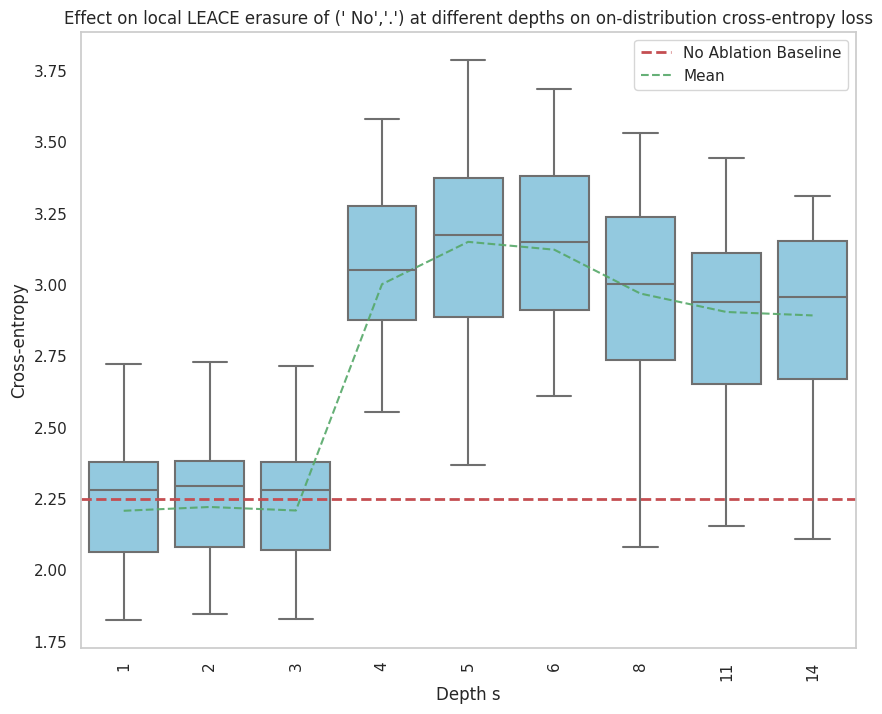

387
tensor([512, 273]) ' all of' ' all' ' of'
{'blocks.1.hook_resid_pre': [2.427286148071289, 2.091662645339966, 2.5037124156951904, 2.5924041271209717, 2.0834507942199707, 2.5939247608184814, 2.918381929397583, 2.455430030822754, 2.579958915710449, 2.6902031898498535, 2.5993828773498535, 2.496922731399536, 1.6286288499832153, 2.3439407348632812], 'blocks.2.hook_resid_pre': [2.335941791534424, 1.959320068359375, 2.377873182296753, 2.4607982635498047, 2.0254976749420166, 2.5032541751861572, 2.7999861240386963, 2.361314535140991, 2.4443318843841553, 2.587672233581543, 2.504270076751709, 2.3659355640411377, 1.5983741283416748, 2.1558382511138916], 'blocks.3.hook_resid_pre': [2.253000497817993, 1.869039535522461, 2.303583860397339, 2.3407742977142334, 1.9694921970367432, 2.4164140224456787, 2.7345328330993652, 2.3048906326293945, 2.358478307723999, 2.5168797969818115, 2.4386558532714844, 2.228032112121582, 1.5305768251419067, 2.04095458984375], 'blocks.4.hook_resid_pre': [2.228872776031494

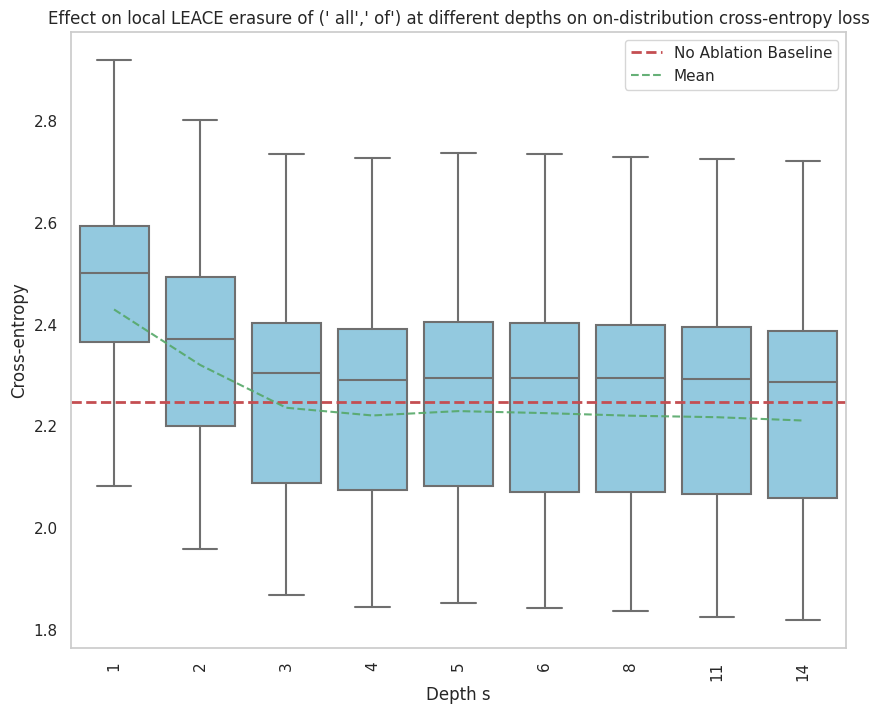

502
tensor([352, 281]) ' it to' ' it' ' to'
{'blocks.1.hook_resid_pre': [2.2938199043273926, 1.888447880744934, 2.3544199466705322, 2.4127495288848877, 1.9971829652786255, 2.4657671451568604, 2.8040950298309326, 2.338721752166748, 2.407949447631836, 2.57505464553833, 2.484226703643799, 2.304070234298706, 1.540298342704773, 2.145293712615967], 'blocks.2.hook_resid_pre': [2.3076303005218506, 1.9228551387786865, 2.3816628456115723, 2.447861671447754, 1.995514988899231, 2.48319149017334, 2.8070144653320312, 2.353682041168213, 2.4186153411865234, 2.593302011489868, 2.512220621109009, 2.3308115005493164, 1.5524383783340454, 2.149639844894409], 'blocks.3.hook_resid_pre': [2.2653210163116455, 1.867991328239441, 2.3284406661987305, 2.3784379959106445, 1.9690901041030884, 2.449191093444824, 2.753131628036499, 2.311954975128174, 2.3668832778930664, 2.540210008621216, 2.4754037857055664, 2.2448880672454834, 1.5199551582336426, 2.0735318660736084], 'blocks.4.hook_resid_pre': [2.3724873065948486, 2.

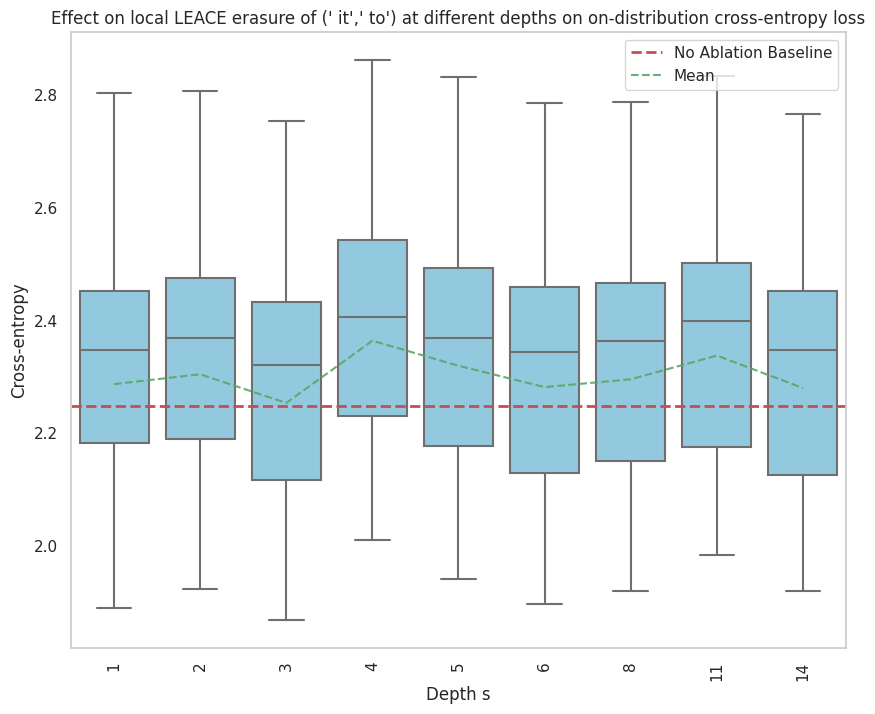

612
tensor([ 247, 1077]) ' a very' ' a' ' very'
{'blocks.1.hook_resid_pre': [2.959235191345215, 2.5964276790618896, 2.9290897846221924, 3.2020680904388428, 2.5252342224121094, 3.125343084335327, 3.5614993572235107, 3.0774500370025635, 3.1343371868133545, 3.4112370014190674, 3.114804744720459, 3.395798444747925, 1.982413411140442, 3.272698163986206], 'blocks.2.hook_resid_pre': [2.398806571960449, 2.0346107482910156, 2.4508981704711914, 2.5279510021209717, 2.0858309268951416, 2.55981183052063, 2.9049971103668213, 2.438154458999634, 2.5110576152801514, 2.653427839279175, 2.5879132747650146, 2.3871450424194336, 1.6254109144210815, 2.198659896850586], 'blocks.3.hook_resid_pre': [2.3147757053375244, 1.9515188932418823, 2.3714609146118164, 2.4470598697662354, 2.007845878601074, 2.4656248092651367, 2.805163860321045, 2.363893985748291, 2.429708957672119, 2.5871686935424805, 2.514608383178711, 2.3116273880004883, 1.5549101829528809, 2.12960147857666], 'blocks.4.hook_resid_pre': [2.3090975284576

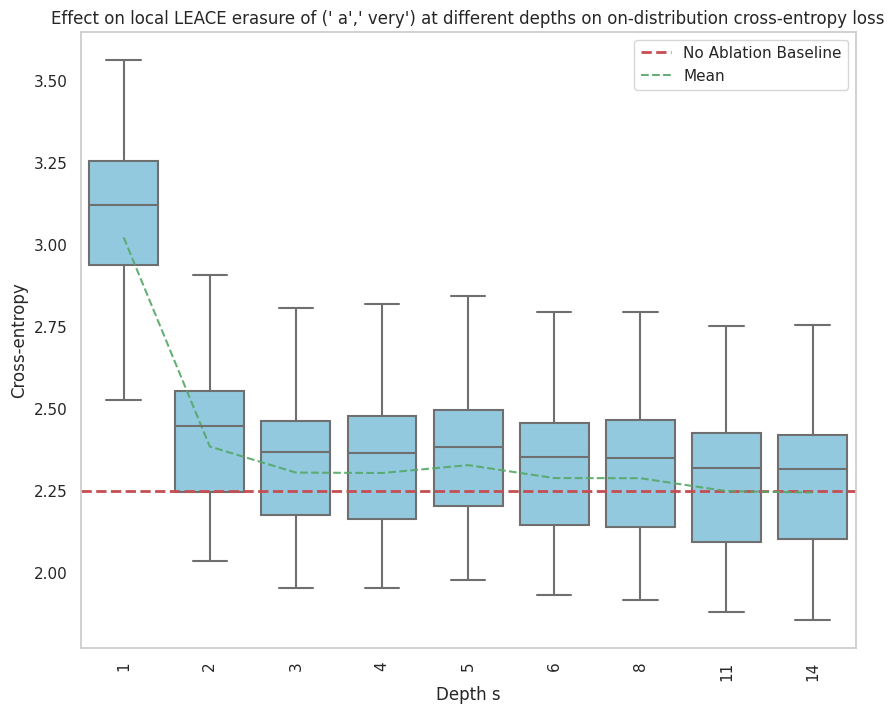

723
tensor([326, 476]) ' that can' ' that' ' can'
{'blocks.1.hook_resid_pre': [2.370443344116211, 1.992395043373108, 2.434427499771118, 2.511439800262451, 2.051874876022339, 2.5462565422058105, 2.8801169395446777, 2.399199962615967, 2.4771595001220703, 2.640669345855713, 2.581185817718506, 2.3726727962493896, 1.5914928913116455, 2.147005796432495], 'blocks.2.hook_resid_pre': [2.2944557666778564, 1.881911277770996, 2.358079671859741, 2.4043381214141846, 1.9926848411560059, 2.4868533611297607, 2.797313928604126, 2.3432154655456543, 2.4173927307128906, 2.5656301975250244, 2.5024123191833496, 2.2786200046539307, 1.51970374584198, 2.0854897499084473], 'blocks.3.hook_resid_pre': [2.2447569370269775, 1.8610520362854004, 2.3147757053375244, 2.336913585662842, 1.9708302021026611, 2.4332425594329834, 2.7477834224700928, 2.303699016571045, 2.360926389694214, 2.5179073810577393, 2.456362009048462, 2.2292559146881104, 1.4946767091751099, 2.029313564300537], 'blocks.4.hook_resid_pre': [2.23605108261

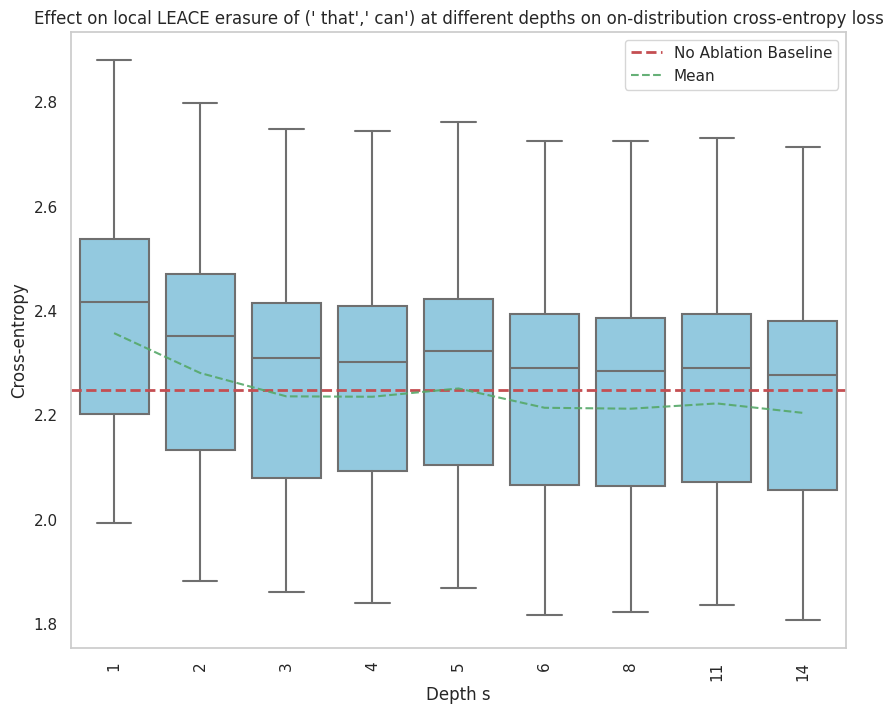

833
tensor([253, 773]) ' the “' ' the' ' “'
{'blocks.1.hook_resid_pre': [3.3905892372131348, 2.9717299938201904, 3.640496253967285, 3.8369243144989014, 3.1287012100219727, 3.7474770545959473, 4.005685329437256, 3.5808568000793457, 3.8419339656829834, 4.064693450927734, 3.7855384349823, 3.4726011753082275, 2.399484872817993, 3.380368709564209], 'blocks.2.hook_resid_pre': [2.6187238693237305, 2.2263619899749756, 2.715724468231201, 2.8638715744018555, 2.3207991123199463, 2.912621259689331, 3.188328981399536, 2.7579410076141357, 2.7828927040100098, 2.934022903442383, 2.8642001152038574, 2.6174674034118652, 1.8091609477996826, 2.369744300842285], 'blocks.3.hook_resid_pre': [2.3918168544769287, 1.9809184074401855, 2.4521279335021973, 2.5930991172790527, 2.078632116317749, 2.558809280395508, 2.8969838619232178, 2.4484684467315674, 2.516646385192871, 2.668545961380005, 2.6040055751800537, 2.3569414615631104, 1.6155517101287842, 2.1576461791992188], 'blocks.4.hook_resid_pre': [2.432689905166626

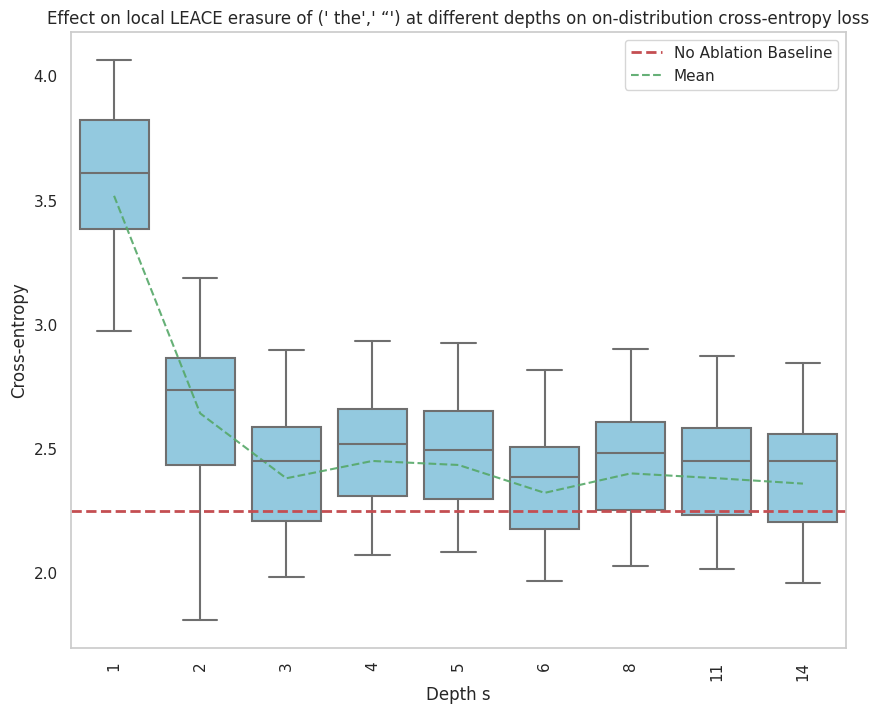

947
tensor([34, 15]) 'A.' 'A' '.'
{'blocks.1.hook_resid_pre': [2.2245616912841797, 1.8325179815292358, 2.299926280975342, 2.301953077316284, 1.9558912515640259, 2.4032304286956787, 2.7297587394714355, 2.2895095348358154, 2.3360018730163574, 2.5033271312713623, 2.4232325553894043, 2.225980758666992, 1.4968546628952026, 2.0233962535858154], 'blocks.2.hook_resid_pre': [2.235483407974243, 1.863198161125183, 2.3035473823547363, 2.3310253620147705, 1.9542886018753052, 2.403798818588257, 2.733572244644165, 2.2913975715637207, 2.350881338119507, 2.513453483581543, 2.431844711303711, 2.248648166656494, 1.5108848810195923, 2.0447254180908203], 'blocks.3.hook_resid_pre': [2.23612904548645, 1.8764904737472534, 2.2989323139190674, 2.3216803073883057, 1.9537729024887085, 2.4084129333496094, 2.7239441871643066, 2.2891411781311035, 2.3432538509368896, 2.507049083709717, 2.427973985671997, 2.2331299781799316, 1.5114266872406006, 2.04244327545166], 'blocks.4.hook_resid_pre': [3.8471505641937256, 3.46882

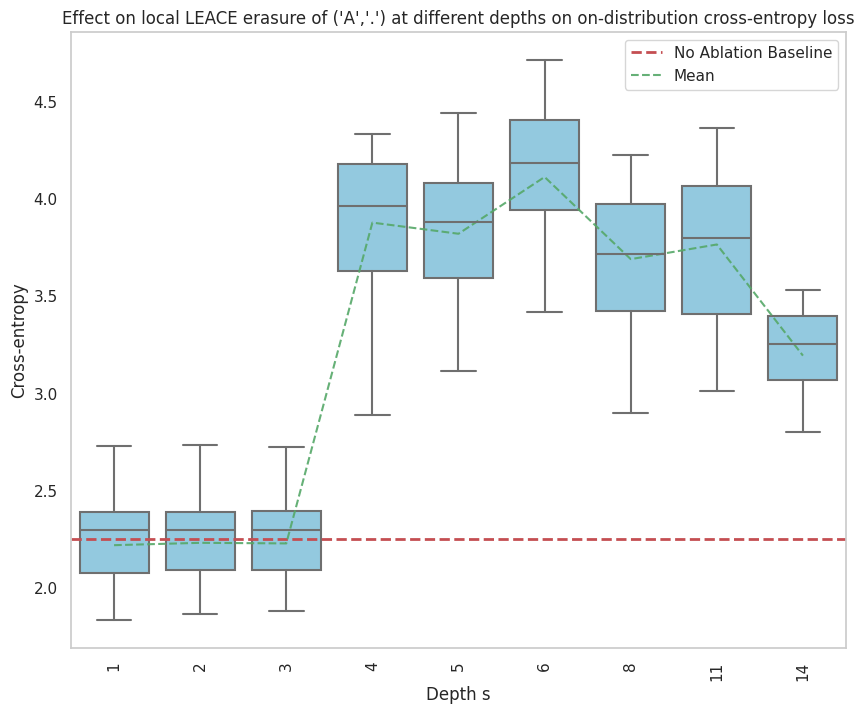

1060
tensor([ 13, 891]) ', i' ',' ' i'
{'blocks.1.hook_resid_pre': [2.803462266921997, 2.4168787002563477, 3.0360915660858154, 3.162043333053589, 2.454401731491089, 3.1527390480041504, 3.4186336994171143, 2.853166103363037, 3.043776750564575, 3.197498083114624, 3.064441442489624, 2.929922580718994, 2.0856430530548096, 2.6940677165985107], 'blocks.2.hook_resid_pre': [2.4411168098449707, 2.125147819519043, 2.5158307552337646, 2.6354153156280518, 2.121378183364868, 2.6050212383270264, 2.9069113731384277, 2.454249620437622, 2.536600112915039, 2.6753172874450684, 2.5940170288085938, 2.4948394298553467, 1.7020294666290283, 2.301992416381836], 'blocks.3.hook_resid_pre': [2.3134915828704834, 1.9597431421279907, 2.4086244106292725, 2.4558889865875244, 2.0421860218048096, 2.496190071105957, 2.8088810443878174, 2.3541250228881836, 2.4251184463500977, 2.5750653743743896, 2.5024614334106445, 2.357799530029297, 1.5848140716552734, 2.1357994079589844], 'blocks.4.hook_resid_pre': [2.292557954788208, 1

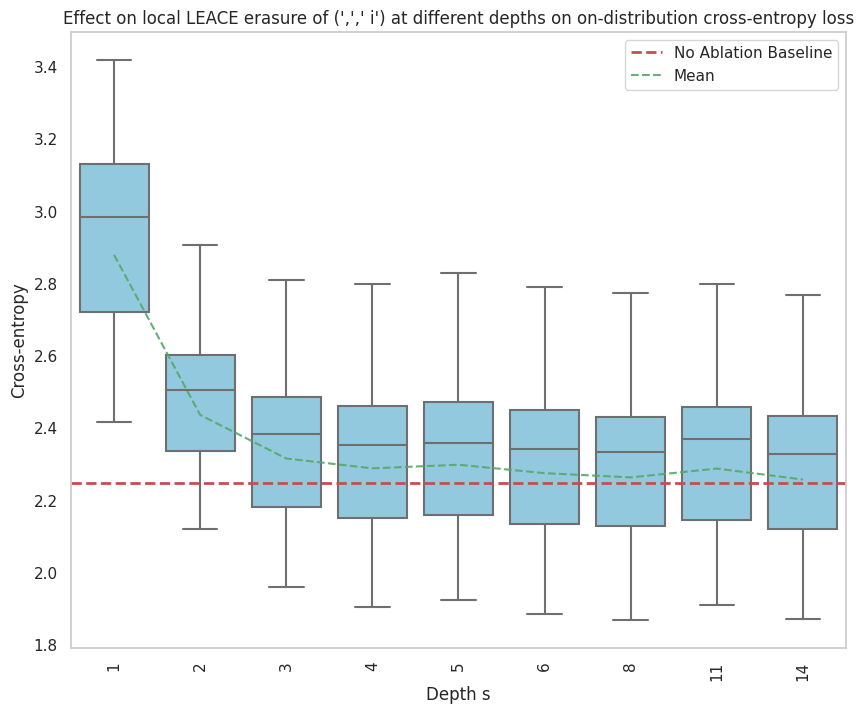

68
tensor([187,   3]) '\n"' '\n' '"'
{'blocks.1.hook_resid_pre': [2.219034433364868, 1.826814889907837, 2.2887046337127686, 2.304185628890991, 1.9453368186950684, 2.4130775928497314, 2.7207448482513428, 2.280003786087036, 2.3295438289642334, 2.4929943084716797, 2.4296271800994873, 2.2158238887786865, 1.4929749965667725, 2.029675245285034], 'blocks.2.hook_resid_pre': [2.2431766986846924, 1.8926573991775513, 2.3114967346191406, 2.3416519165039062, 1.964226245880127, 2.426597833633423, 2.7432243824005127, 2.3016531467437744, 2.35063099861145, 2.5252161026000977, 2.448422908782959, 2.2358288764953613, 1.538469910621643, 2.0546586513519287], 'blocks.3.hook_resid_pre': [2.232074737548828, 1.8461464643478394, 2.3010640144348145, 2.303861379623413, 1.959044098854065, 2.4102842807769775, 2.7310338020324707, 2.2847859859466553, 2.3372743129730225, 2.5078892707824707, 2.4298298358917236, 2.2240540981292725, 1.523664116859436, 2.0317795276641846], 'blocks.4.hook_resid_pre': [2.2527849674224854, 1.

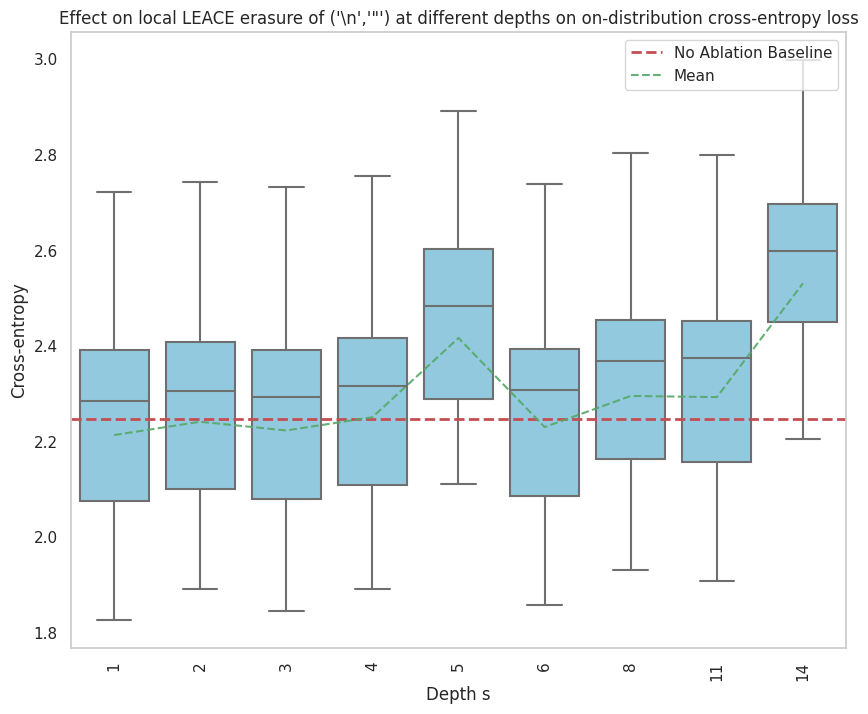

194
tensor([604, 368]) ' if you' ' if' ' you'
{'blocks.1.hook_resid_pre': [2.7464423179626465, 2.4529945850372314, 2.8042826652526855, 2.9777376651763916, 2.4368133544921875, 2.9848973751068115, 3.192188262939453, 2.680863618850708, 2.8395044803619385, 3.012204647064209, 2.8900270462036133, 2.6880135536193848, 2.014216184616089, 2.554161548614502], 'blocks.2.hook_resid_pre': [2.341858148574829, 1.9692983627319336, 2.412482500076294, 2.509720802307129, 2.0303502082824707, 2.521601915359497, 2.8333232402801514, 2.391030788421631, 2.466090202331543, 2.6233794689178467, 2.5243747234344482, 2.404017210006714, 1.5970996618270874, 2.16667103767395], 'blocks.3.hook_resid_pre': [2.299417018890381, 1.9135438203811646, 2.3560192584991455, 2.4001104831695557, 1.9882805347442627, 2.4525818824768066, 2.774305820465088, 2.3378746509552, 2.3925883769989014, 2.558061122894287, 2.46996808052063, 2.347886085510254, 1.5433776378631592, 2.117600440979004], 'blocks.4.hook_resid_pre': [2.260328531265259, 1.8

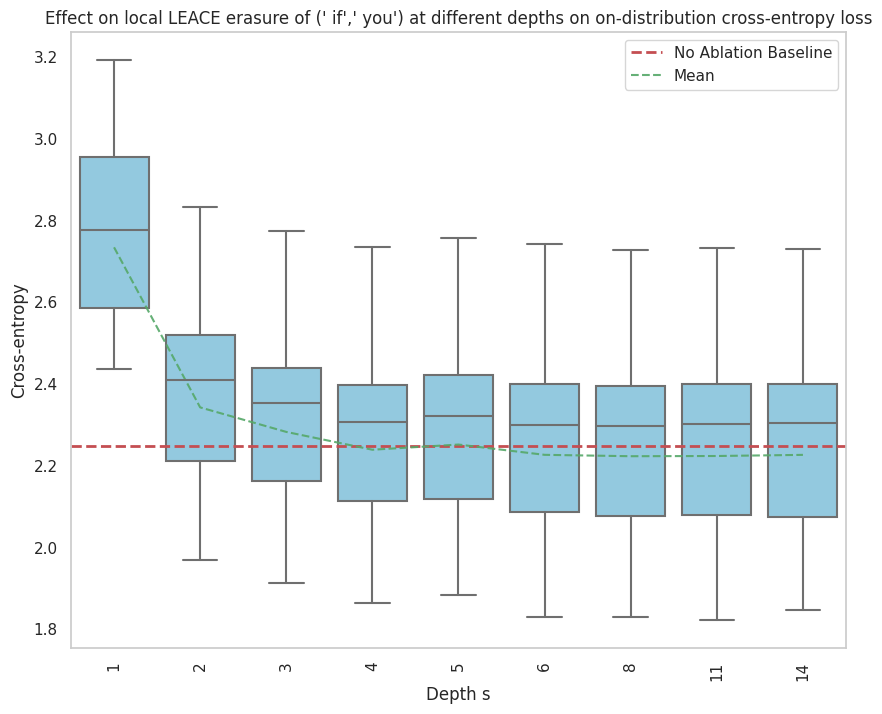

332
tensor([ 18, 187]) '1\n' '1' '\n'
{'blocks.1.hook_resid_pre': [4.325804710388184, 4.161509990692139, 3.5134904384613037, 4.222570419311523, 4.670860290527344, 3.7054617404937744, 4.6392998695373535, 4.492586612701416, 5.170003414154053, 4.159702777862549, 5.551996231079102, 4.947994232177734, 2.774214267730713, 3.766460418701172], 'blocks.2.hook_resid_pre': [6.68344259262085, 6.283066749572754, 6.921820163726807, 7.470118522644043, 6.854982852935791, 6.517555236816406, 7.129182815551758, 6.277255058288574, 6.769848346710205, 7.338326930999756, 6.879469871520996, 6.703657150268555, 6.999063491821289, 6.186855792999268], 'blocks.3.hook_resid_pre': [2.244138479232788, 1.8796272277832031, 2.328118324279785, 2.368225336074829, 1.962388515472412, 2.442049026489258, 2.7433032989501953, 2.3069536685943604, 2.3588216304779053, 2.514922618865967, 2.449772357940674, 2.2478976249694824, 1.525139570236206, 2.0605430603027344], 'blocks.4.hook_resid_pre': [2.2142527103424072, 1.8102691173553467, 

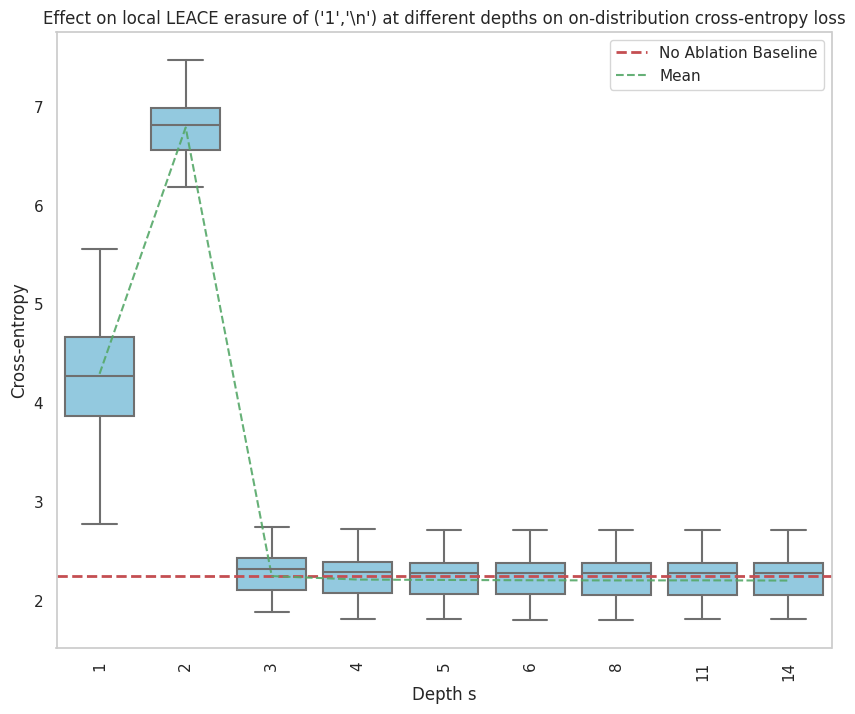

443
tensor([273, 776]) ' of our' ' of' ' our'
{'blocks.1.hook_resid_pre': [2.5606250762939453, 2.202749013900757, 2.6384212970733643, 2.8186769485473633, 2.2198824882507324, 2.820890426635742, 3.2053446769714355, 2.625448703765869, 2.7615489959716797, 2.947634220123291, 2.810661792755127, 2.7628493309020996, 1.716035008430481, 2.494028091430664], 'blocks.2.hook_resid_pre': [2.278914213180542, 1.9033148288726807, 2.3584718704223633, 2.4050586223602295, 1.9969584941864014, 2.4543612003326416, 2.793992280960083, 2.3262062072753906, 2.408506393432617, 2.561051368713379, 2.486391067504883, 2.3086581230163574, 1.5399338006973267, 2.0955867767333984], 'blocks.3.hook_resid_pre': [2.2594985961914062, 1.884079933166504, 2.3369035720825195, 2.365629196166992, 1.989655613899231, 2.4401419162750244, 2.773601531982422, 2.30584454536438, 2.3814187049865723, 2.535228729248047, 2.4660253524780273, 2.2553439140319824, 1.5224710702896118, 2.046020984649658], 'blocks.4.hook_resid_pre': [2.4080727100372314

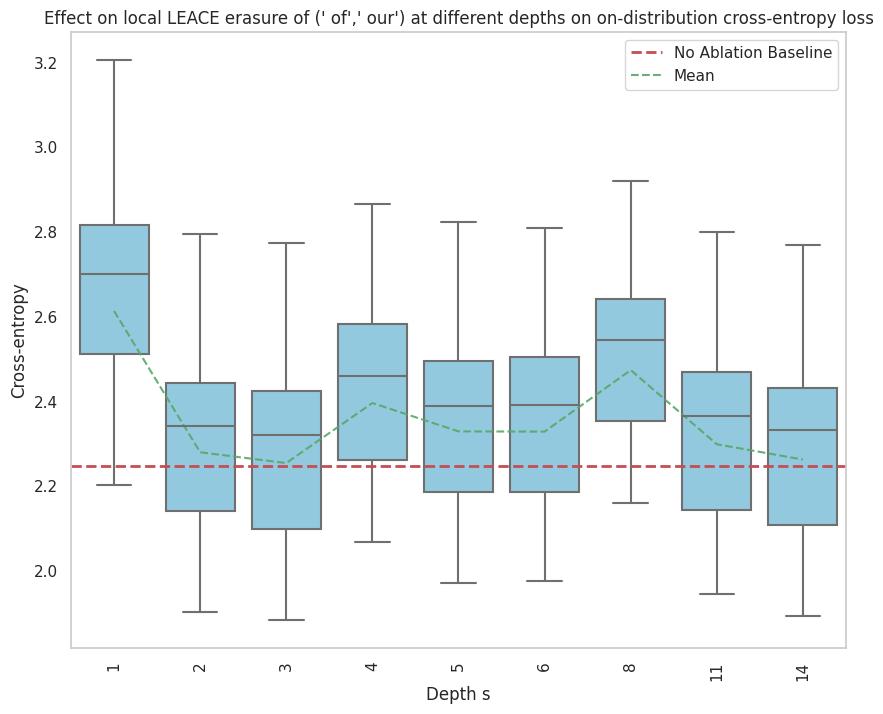

559
tensor([313, 783]) ' (the' ' (' 'the'
{'blocks.1.hook_resid_pre': [2.2973527908325195, 1.9418318271636963, 2.369576930999756, 2.431185722351074, 2.0016160011291504, 2.4872982501983643, 2.8083317279815674, 2.3491575717926025, 2.420875072479248, 2.5741939544677734, 2.51310133934021, 2.311647653579712, 1.554808497428894, 2.1224417686462402], 'blocks.2.hook_resid_pre': [2.2699997425079346, 1.9202114343643188, 2.340104579925537, 2.3832592964172363, 1.985014796257019, 2.4443132877349854, 2.7784080505371094, 2.3207509517669678, 2.3823304176330566, 2.540525197982788, 2.482459783554077, 2.2995355129241943, 1.5304285287857056, 2.097254514694214], 'blocks.3.hook_resid_pre': [2.250521659851074, 1.8785117864608765, 2.329806327819824, 2.367755174636841, 1.9888768196105957, 2.4310965538024902, 2.765230417251587, 2.310795783996582, 2.3730061054229736, 2.5342488288879395, 2.4644668102264404, 2.281970262527466, 1.5256181955337524, 2.0906927585601807], 'blocks.4.hook_resid_pre': [2.2778923511505127, 

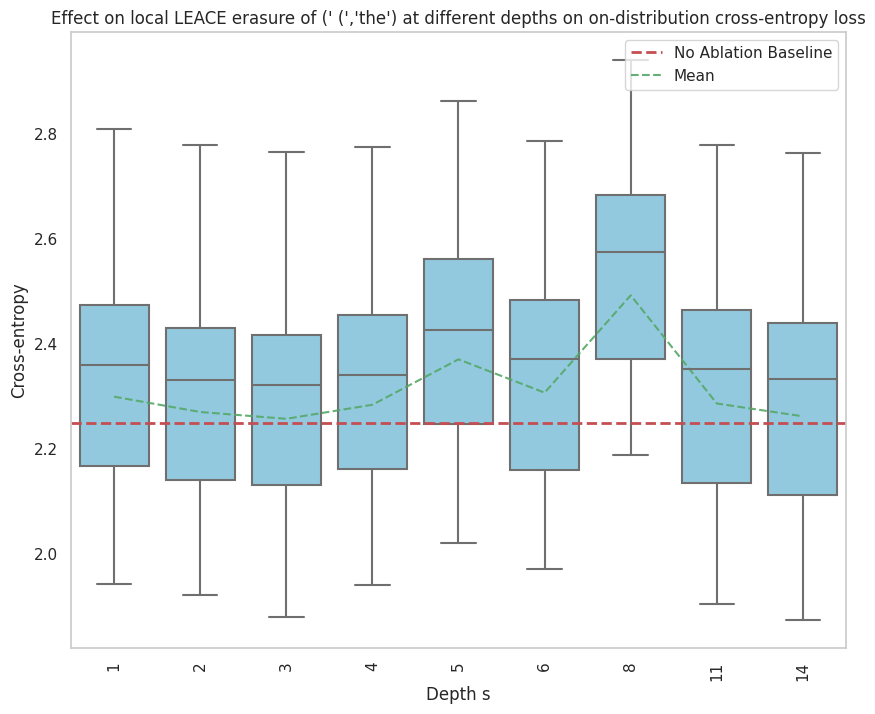

665
tensor([ 9, 89]) '(x' '(' 'x'
{'blocks.1.hook_resid_pre': [2.352759599685669, 2.0029428005218506, 2.43939208984375, 2.5071029663085938, 2.046196222305298, 2.5181965827941895, 2.832793712615967, 2.3780899047851562, 2.465622663497925, 2.6106438636779785, 2.581489324569702, 2.381199598312378, 1.6033979654312134, 2.1745595932006836], 'blocks.2.hook_resid_pre': [2.342517137527466, 2.0059900283813477, 2.4274001121520996, 2.503359079360962, 2.0654945373535156, 2.522866725921631, 2.858645439147949, 2.4096643924713135, 2.482804775238037, 2.6212737560272217, 2.5745363235473633, 2.395761013031006, 1.6614272594451904, 2.230590343475342], 'blocks.3.hook_resid_pre': [2.5265743732452393, 2.198991298675537, 2.6231346130371094, 2.8087658882141113, 2.1953628063201904, 2.7598557472229004, 3.024871587753296, 2.5742650032043457, 2.655397653579712, 2.757474184036255, 2.7656290531158447, 2.6235876083374023, 1.8865443468093872, 2.511751174926758], 'blocks.4.hook_resid_pre': [2.3389499187469482, 2.00147867

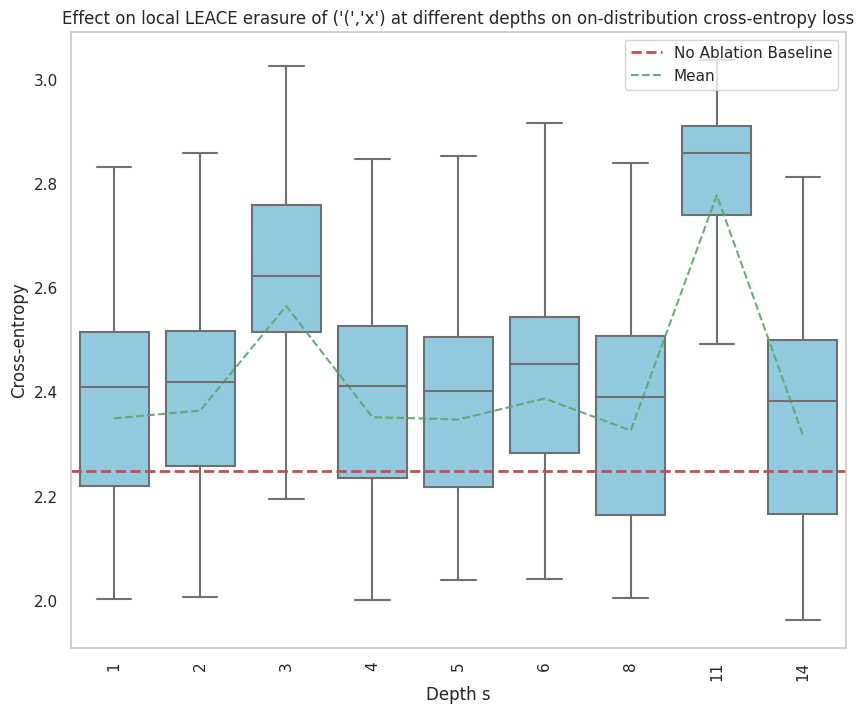

777
tensor([ 20, 428]) '3 -' '3' ' -'
{'blocks.1.hook_resid_pre': [2.3338801860809326, 1.9320427179336548, 2.4818851947784424, 2.4425742626190186, 2.039292335510254, 2.499088764190674, 2.807466506958008, 2.3708786964416504, 2.4253435134887695, 2.6019434928894043, 2.4992892742156982, 2.405153274536133, 1.631039023399353, 2.1303775310516357], 'blocks.2.hook_resid_pre': [2.3781912326812744, 2.0315101146698, 2.557631492614746, 2.5277099609375, 2.1191565990448, 2.558835029602051, 2.838109254837036, 2.4327378273010254, 2.47948956489563, 2.6296355724334717, 2.5826525688171387, 2.4917447566986084, 1.6832274198532104, 2.2262282371520996], 'blocks.3.hook_resid_pre': [2.3319950103759766, 1.9804260730743408, 2.41438889503479, 2.437199354171753, 2.042285680770874, 2.475644111633301, 2.7771482467651367, 2.331360101699829, 2.4029858112335205, 2.55084490776062, 2.512483596801758, 2.3124008178710938, 1.5885753631591797, 2.1199841499328613], 'blocks.4.hook_resid_pre': [2.295330762863159, 1.9737758636474

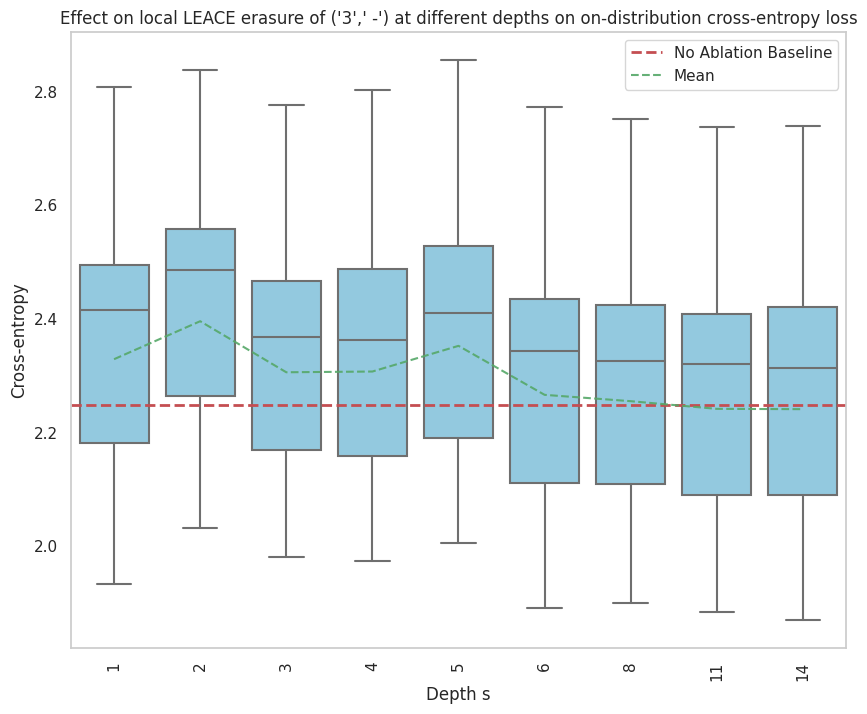

890
tensor([3491,  273]) ' copy of' ' copy' ' of'
{'blocks.1.hook_resid_pre': [2.3277909755706787, 1.9594032764434814, 2.3926141262054443, 2.4796080589294434, 2.0041375160217285, 2.4863600730895996, 2.83183217048645, 2.353386163711548, 2.470771312713623, 2.6104862689971924, 2.5138192176818848, 2.3986475467681885, 1.5867235660552979, 2.2431397438049316], 'blocks.2.hook_resid_pre': [2.285573720932007, 1.9216283559799194, 2.348233222961426, 2.405160427093506, 1.9869529008865356, 2.467273235321045, 2.7670609951019287, 2.33512806892395, 2.4049196243286133, 2.5617215633392334, 2.4816272258758545, 2.2855563163757324, 1.5644521713256836, 2.0859270095825195], 'blocks.3.hook_resid_pre': [2.2299373149871826, 1.8467057943344116, 2.293813705444336, 2.320460319519043, 1.9541120529174805, 2.406782627105713, 2.7245371341705322, 2.28428316116333, 2.347100257873535, 2.509415864944458, 2.424832344055176, 2.2298152446746826, 1.5000255107879639, 2.03572940826416], 'blocks.4.hook_resid_pre': [2.215182304382

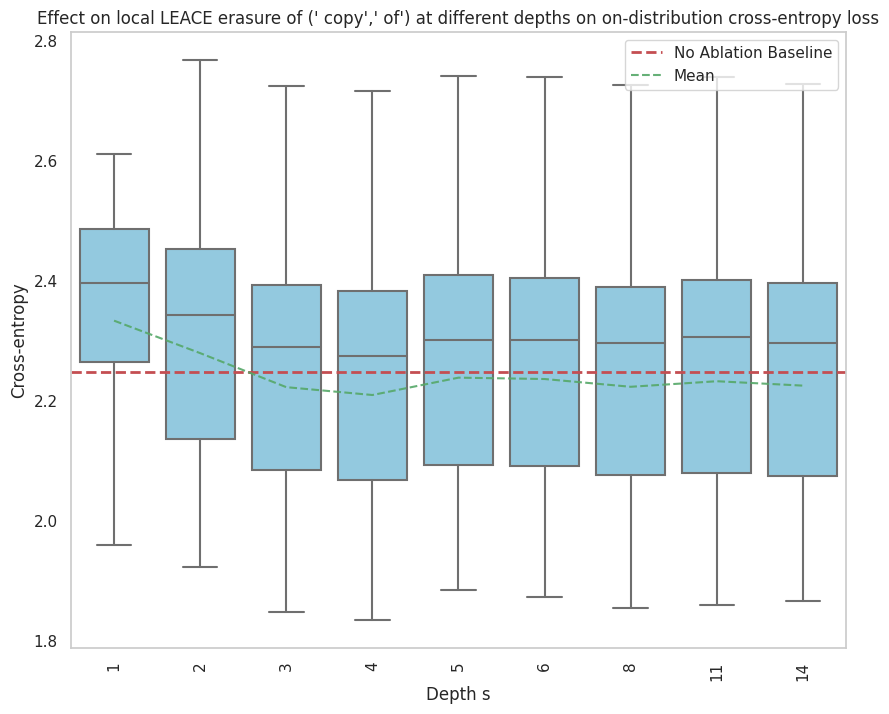

1001
tensor([476, 457]) ' can’' ' can' '’'
{'blocks.1.hook_resid_pre': [3.7633440494537354, 3.3517801761627197, 3.829965114593506, 3.894796133041382, 3.5091941356658936, 4.06488561630249, 4.159473896026611, 3.609090805053711, 3.94799542427063, 4.1598591804504395, 4.009912490844727, 3.6936581134796143, 2.8403537273406982, 3.538487434387207], 'blocks.2.hook_resid_pre': [2.3581039905548096, 1.9951317310333252, 2.4645607471466064, 2.51833438873291, 2.052640438079834, 2.5175764560699463, 2.8433992862701416, 2.3919930458068848, 2.4850988388061523, 2.628824472427368, 2.5606489181518555, 2.456847906112671, 1.6220011711120605, 2.180690288543701], 'blocks.3.hook_resid_pre': [2.260650634765625, 1.865177035331726, 2.3506357669830322, 2.355565309524536, 1.9851558208465576, 2.4351184368133545, 2.746842384338379, 2.3144168853759766, 2.3833534717559814, 2.5393357276916504, 2.46423602104187, 2.3031487464904785, 1.5320489406585693, 2.068256139755249], 'blocks.4.hook_resid_pre': [2.2502081394195557, 1.85

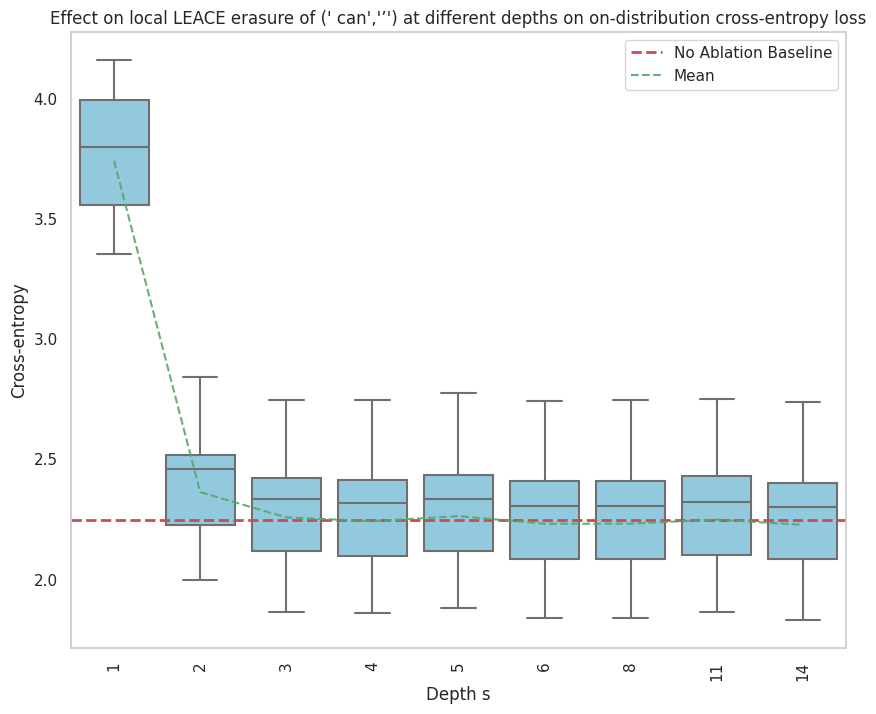

1116
tensor([884,  13]) ' 10,' ' 10' ','
{'blocks.1.hook_resid_pre': [2.533939838409424, 2.239535093307495, 2.684340476989746, 2.747878074645996, 2.2003610134124756, 2.6995441913604736, 3.013291120529175, 2.624002456665039], 'blocks.2.hook_resid_pre': [2.3748271465301514, 2.0419225692749023, 2.4270079135894775, 2.5178158283233643, 2.068247079849243, 2.5185253620147705, 2.8512749671936035, 2.412909507751465], 'blocks.3.hook_resid_pre': [2.251789093017578, 1.9181008338928223, 2.3357064723968506, 2.382953643798828, 1.9869245290756226, 2.4323787689208984, 2.7582523822784424, 2.3101987838745117], 'blocks.4.hook_resid_pre': [2.2717275619506836, 1.8935520648956299, 2.333859443664551, 2.3861582279205322, 1.9856184720993042, 2.454395294189453, 2.75368070602417, 2.3134846687316895], 'blocks.5.hook_resid_pre': [2.2817840576171875, 1.8893967866897583, 2.3349609375, 2.3829407691955566, 1.982114553451538, 2.4520936012268066, 2.7712209224700928, 2.319878578186035], 'blocks.6.hook_resid_pre': [2.25985

ValueError: ignored

In [ ]:
for bid, loss_eraseds in loss_eraseds_per_bid.items():
  print(bid)
  if torch.is_tensor(bid): continue
  bigram_str = print_bigram_id(bid, extended=True)
  loss_cleans_od = torch.tensor(bid_od_dict['loss_cleans']) #.shape
  print(loss_eraseds)
  df = pd.DataFrame(loss_eraseds)
  plot_dataframe_boxplot_seaborn_modified(df, loss_cleans_od, bigram_str)

In [ ]:
for i in range(23):
  test_result = ttest_rel(df[f'blocks.{i+1}.hook_resid_pre'], df[f'blocks.{i}.hook_resid_pre'])
  print(i, test_result, test_result.pvalue / 23)

0 TtestResult(statistic=-41.96403503387344, pvalue=1.4159773656143506e-12, df=10) 6.156423328758046e-14
1 TtestResult(statistic=-5.502757147940489, pvalue=0.0002607780772133273, df=10) 1.1338177270144665e-05
2 TtestResult(statistic=-8.761774902210485, pvalue=5.263351393533436e-06, df=10) 2.2884136493623637e-07
3 TtestResult(statistic=8.182467354171344, pvalue=9.659065501126108e-06, df=10) 4.199593696141786e-07
4 TtestResult(statistic=11.745129481560195, pvalue=3.5740411908412935e-07, df=10) 1.553930952539693e-08
5 TtestResult(statistic=-11.23682644147013, pvalue=5.406065494283182e-07, df=10) 2.350463258383992e-08
6 TtestResult(statistic=3.278114501001058, pvalue=0.00831541028501374, df=10) 0.00036153957760929305
7 TtestResult(statistic=-6.948602029034682, pvalue=3.953841710453213e-05, df=10) 1.7190616132405275e-06
8 TtestResult(statistic=-0.19658961365171795, pvalue=0.8480865392092654, df=10) 0.03687332779170719
9 TtestResult(statistic=2.766498774444582, pvalue=0.01990654450423566, df=

In [ ]:
len(df)

14

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

def plot_dataframe_boxplot_seaborn_modified(df, loss_cleans_od, bigram_str):
    # Convert tensor to float for plotting
    for column in df.columns:
        df[column] = df[column].apply(lambda x: float(str(x).replace("tensor(", "").replace(")", "")))

    # Exclude block 0
    #df = df.drop(columns=["blocks.0.hook_resid_pre"])

    # Calculate mean values
    means = df.mean()

    # Convert DataFrame to long-form suitable for Seaborn
    y_name = 'Cross-entropy'
    x_name = 'Depth s'
    df_melted = df.melt(var_name=x_name, value_name=y_name)

    # Extract only the block numbers for the x-axis labels
    block_numbers = [int(name.split('.')[1]) for name in df.columns]

    # Update Seaborn style settings
    sns.set(style="whitegrid", rc={"grid.linestyle": '--'})  # Set the linestyle to dashed for grid
    plt.rcParams['grid.linestyle'] = 'None'  # Remove vertical lines

    # Create Seaborn boxplot with a single color and a smaller figure size
    plt.figure(figsize=(10, 8))  # Changed width from 15 to 10
    sns.boxplot(x=x_name, y=y_name, data=df_melted, color='skyblue',showfliers=False)  # Added color parameter
    plt.xticks(range(len(block_numbers)), block_numbers, rotation=90)

    # Add a beautiful horizontal line for no ablation baseline
    plt.axhline(y=loss_cleans_od.median(), color='r', linestyle='--', linewidth=2, label='No Ablation Baseline')

    # Add a transparent line for the mean values
    plt.plot(means.values, 'g--', alpha=0.9, label='Mean')

    # Add legend to clarify the meaning of the lines
    plt.legend(loc='upper right')

    plt.title(f'Effect on local LEACE erasure of {bigram_str} at different depths on on-distribution cross-entropy loss')

    plt.show()

    # Reset the linestyle to default for future plots
    plt.rcParams['grid.linestyle'] = '-'

# Sample usage:
# Assuming df is your DataFrame and loss_cleans_od is your Series with loss values
#plot_dataframe_boxplot_seaborn_modified(df, loss_cleans_od)


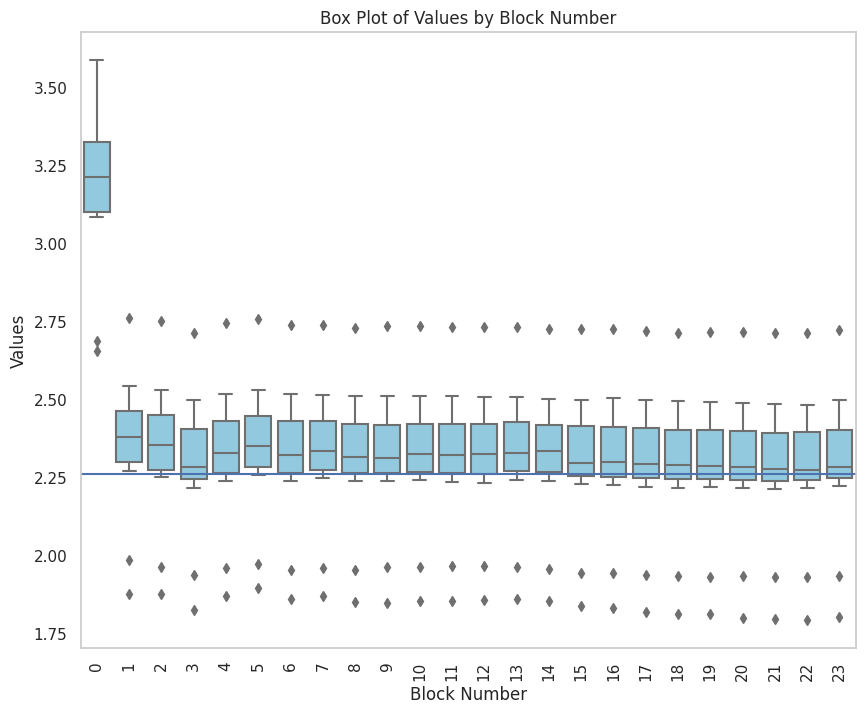

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

def plot_dataframe_boxplot_seaborn_modified(df):
    # Convert tensor to float for plotting
    for column in df.columns:
        df[column] = df[column].apply(lambda x: float(str(x).replace("tensor(", "").replace(")", "")))

    # Exclude block 0
    #df = df.drop(columns=["blocks.0.hook_resid_pre"])

    # Convert DataFrame to long-form suitable for Seaborn
    df_melted = df.melt(var_name='Block Number', value_name='Values')

    # Extract only the block numbers for the x-axis labels
    block_numbers = [int(name.split('.')[1]) for name in df.columns]

    # Update Seaborn style settings
    sns.set(style="whitegrid", rc={"grid.linestyle": '--'})  # Set the linestyle to dashed for grid
    plt.rcParams['grid.linestyle'] = 'None'  # Remove vertical lines

    # Create Seaborn boxplot with a single color and a smaller figure size
    plt.figure(figsize=(10, 8))  # Changed width from 15 to 10
    sns.boxplot(x='Block Number', y='Values', data=df_melted, color='skyblue')  # Added color parameter
    plt.xticks(range(len(block_numbers)), block_numbers, rotation=90)
    plt.title('Box Plot of Values by Block Number')
    plt.axhline(y=loss_cleans_od.median())
    plt.show()

    # Reset the linestyle to default for future plots
    plt.rcParams['grid.linestyle'] = '-'

# Sample usage:
# Assuming df is your DataFrame
plot_dataframe_boxplot_seaborn_modified(df)


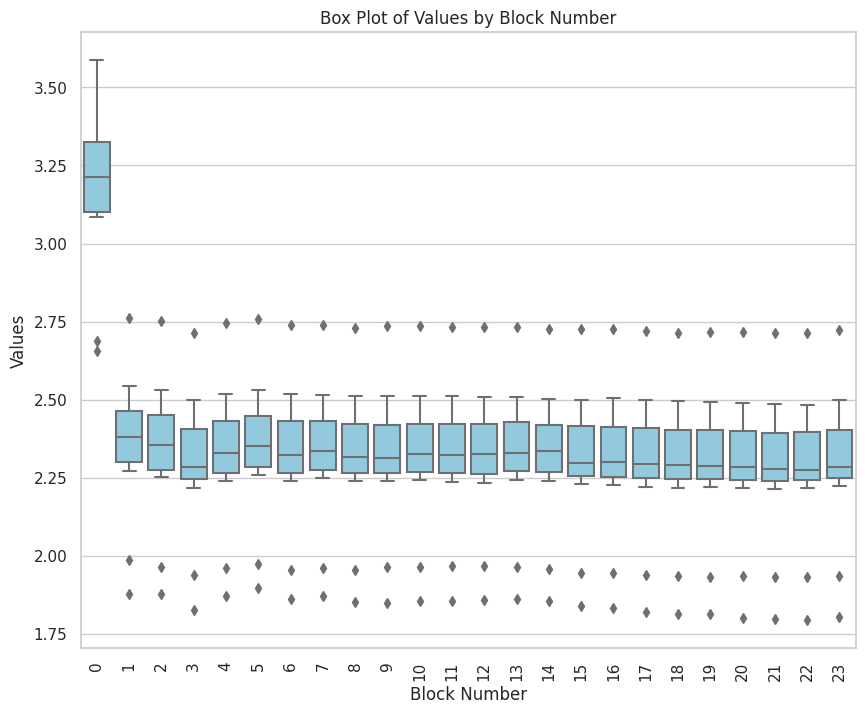

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

def plot_dataframe_boxplot_seaborn_modified(df):
    # Convert tensor to float for plotting
    for column in df.columns:
        df[column] = df[column].apply(lambda x: float(str(x).replace("tensor(", "").replace(")", "")))

    # Exclude block 0
    #df = df.drop(columns=["blocks.0.hook_resid_pre"])

    # Convert DataFrame to long-form suitable for Seaborn
    df_melted = df.melt(var_name='Block Number', value_name='Values')

    # Extract only the block numbers for the x-axis labels
    block_numbers = [int(name.split('.')[1]) for name in df.columns]

    # Create Seaborn boxplot with a single color and a smaller figure size
    plt.figure(figsize=(10, 8))  # Changed width from 15 to 10
    sns.boxplot(x='Block Number', y='Values', data=df_melted, color='skyblue')  # Added color parameter
    plt.xticks(range(len(block_numbers)), block_numbers, rotation=90)
    sns.set(style="whitegrid")
    plt.title('Box Plot of Values by Block Number')
    plt.show()

# Sample usage:
# Assuming df is your DataFrame
plot_dataframe_boxplot_seaborn_modified(df)


In [ ]:
logits_clean_list = []
logits_erased_dict_list = []
for i, (seq, label, label2) in tqdm(enumerate(vdset)):
  with torch.no_grad():
    logits_clean = model.run_with_hooks(
        seq,
        return_type = 'logits',
        fwd_hooks=[]
    )[0,-2:].cpu()
  logits_erased_dict = {}
  for hook_name, _ in erasers_local.items():
    with torch.no_grad():
      logits_erased = model.run_with_hooks(
          seq,
          return_type = 'logits',
          fwd_hooks=[(hook_name, leace_hook_fc)]
      )[0,-2:].cpu()
      logits_erased_dict[hook_name] = logits_erased
  logits_clean_list.append(logits_clean)
  logits_erased_dict_list.append(logits_erased_dict)

500it [13:52,  1.67s/it]


In [ ]:
torch.save({
    'logits_clean_list': logits_clean_list,
    'logits_erased_dict_list': logits_erased_dict_list
},'/content/drive/MyDrive/thesis/zoomin/leace/probdset/typeq_ofd.pt')

In [ ]:
of_dict = torch.load('/content/drive/MyDrive/thesis/zoomin/leace/probdset/typeq_ofd.pt', map_location=torch.device('cpu'))

In [ ]:
logits_clean_ofd = torch.stack(of_dict['logits_clean_list'])

In [ ]:
positives_text_ids = []
for i in range(100):
  seq_plus_next = occ_to_seq(TL, tuple(vdset.data[i].tolist()),after=3)
  if seq_plus_next[-1] == 1156:
    #print('nice',i)
    positives_text_ids.append(i)

In [ ]:
target_token = 1156

In [ ]:
len(positives_text_ids)

62

In [ ]:
positives_text_ids[0]

0

In [ ]:
logsoft = nn.LogSoftmax(dim=-1)

In [ ]:
val_x_id = 0

In [ ]:
current_s = 3

In [ ]:

torch.topk(val_x_clean_logprobs,k=1)

torch.return_types.topk(
values=tensor([-0.0163]),
indices=tensor([1156]))

In [ ]:
clean_target_logprob_allx = []
clean_target_rank_allx = []
s_target_logprob_allx = []
s_target_rank_allx = []
for val_x_id in tqdm(positives_text_ids):
  val_x_clean_logprobs = logsoft(logits_clean_ofd[val_x_id][-1])
  val_x_clean_target_logprob = val_x_clean_logprobs[target_token]
  val_x_clean_rank = rank_in(val_x_clean_logprobs, target_token)
  clean_target_logprob_allx.append(val_x_clean_target_logprob)
  clean_target_rank_allx.append(val_x_clean_rank)

  sx_target_logprob_list = torch.zeros(24)
  sx_target_rank_list = torch.zeros(24)
  for current_s in range(24):
    val_x_clean_target_logprob = val_x_clean_logprobs[target_token]
    val_x_erased_s_logprobs = logsoft(of_dict['logits_erased_dict_list'][val_x_id][f'blocks.{current_s}.hook_resid_pre'][-1])
    val_x_erased_s_target_logprob = val_x_erased_s_logprobs[target_token]
    val_x_erased_s_target_rank = rank_in(val_x_erased_s_logprobs, target_token)
    sx_target_logprob_list[current_s] = val_x_erased_s_target_logprob
    sx_target_rank_list[current_s] = val_x_erased_s_target_rank
  s_target_logprob_allx.append(sx_target_logprob_list)
  s_target_rank_allx.append(sx_target_rank_list)


100%|██████████| 62/62 [00:07<00:00,  7.81it/s]


In [ ]:
clean_lp = torch.stack(clean_target_logprob_allx)

In [ ]:
clean_lp.shape

torch.Size([62])

In [ ]:
s_lp = torch.stack(s_target_logprob_allx)

In [ ]:
s_lp.shape

torch.Size([62, 24])

In [ ]:
s_r = torch.stack(s_target_rank_allx).T
s_r.shape

torch.Size([24, 62])

In [ ]:
s_lf = s_lp.T - clean_lp

In [ ]:
s_lf.shape

torch.Size([24, 62])

In [ ]:
s_r.median(dim=0)

torch.return_types.median(
values=tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 1., 2., 1.,
        1., 1., 2., 2., 3., 8.]),
indices=tensor([40, 33, 33, 33, 51, 45, 41, 38, 40, 50, 45, 55, 52, 59, 38, 13, 21, 42,
        38, 34, 21, 45,  2, 45]))

In [ ]:
s_lf.shape

torch.Size([24, 62])

In [ ]:
s_lf.shape

torch.Size([24, 62])

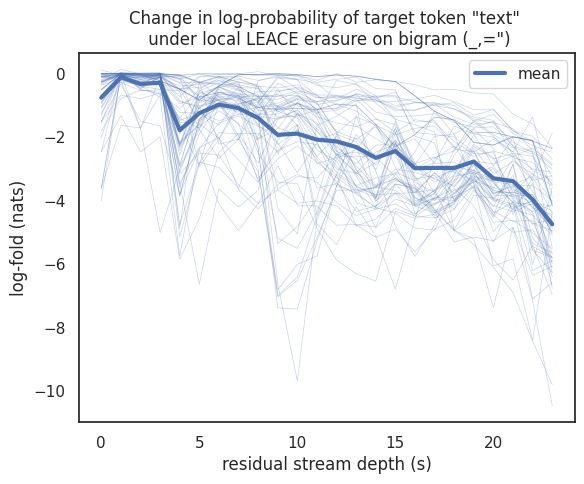

In [ ]:
for row in s_lf.T:
  plt.plot(row, color='b',alpha=0.3,linewidth=0.5)
plt.plot(s_lf.mean(dim=1),label='mean',linewidth=3)
plt.legend()
plt.xlabel('residual stream depth (s)')
plt.ylabel('log-fold (nats)')
plt.title('Change in log-probability of target token "text" \n under local LEACE erasure on bigram (_,=")')
plt.savefig('/content/ofd_typeq_lines.png',dpi=300)

In [ ]:
def zero_top_k_values(tensor, k):
    """
    Sets the top k values in the given tensor to 0.

    Parameters:
        tensor (torch.Tensor): The input tensor.
        k (int): The number of top values to set to 0.

    Returns:
        torch.Tensor: The modified tensor with top k values set to 0.
    """
    # Flatten the tensor and find the top k values and their indices
    flat_tensor = tensor.flatten()
    _, top_indices = torch.topk(flat_tensor, k)

    # Set the top k values to 0
    flat_tensor[top_indices] = 0

    # Reshape the tensor back to its original shape
    return flat_tensor.view(tensor.shape)

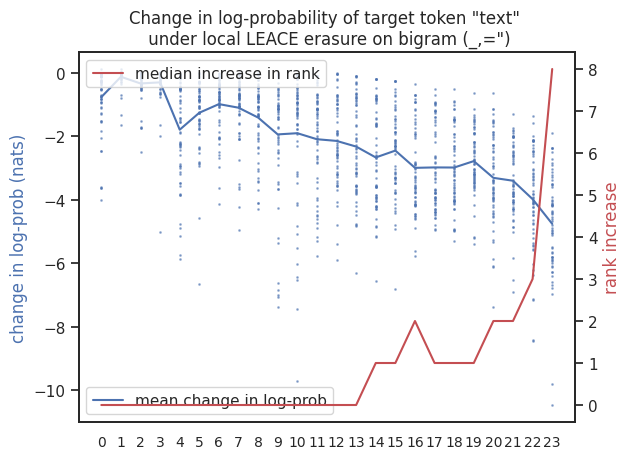

In [ ]:
import matplotlib.pyplot as plt
import torch

def plot_dual_axis(s_lf, s_r):
    # Create the figure and the first axis
    fig, ax1 = plt.subplots()

    # Plot s_lf on the left y-axis
    x_values_lf, y_values_lf = [], []
    for i, row in enumerate(s_lf):
        for value in row:
            x_values_lf.append(i)
            y_values_lf.append(value)
    ax1.scatter(x_values_lf, y_values_lf, color='b', s=1, alpha=0.5)
    ax1.plot(s_lf.mean(dim=1), label='mean change in log-prob')
    ax1.yaxis.label.set_color('b')
    ax1.legend()
    ax1.set_title('Change in log-probability of target token "text" \n under local LEACE erasure on bigram (_,=")')
    ax1.set_xticks(range(0, 24))
    ax1.tick_params(axis='x', labelsize=10)
    ax1.set_ylabel('change in log-prob (nats)')

    # Create the second axis
    ax2 = ax1.twinx()

    # Plot s_r on the right y-axis
    x_values_r, y_values_r = [], []
    for i, row in enumerate(s_r):
        for value in row:
            x_values_r.append(i)
            y_values_r.append(value)
    #ax2.scatter(x_values_r, y_values_r, s=1, alpha=0.5, color='r', label='s_r')
    ax2.plot(s_r.median(dim=1).values, color='r', label='median increase in rank')
    ax2.set_ylabel('rank increase')
    ax2.yaxis.label.set_color('r')
    plt.legend()
    # Show the plot
    plt.savefig('/content/ofd_typeq.png',dpi=300)
    plt.show()

plot_dual_axis(s_lf, s_r)


In [ ]:
x_values = []
y_values = []

# Filling up x and y values
for i, row in enumerate(s_lf):
    for value in row:
        x_values.append(i)
        y_values.append(value)
plt.scatter(x_values, y_values,s=1,alpha=0.5)
plt.plot(s_lf.mean(dim=1),label='mean')
plt.title('Change in log-probability of target token "text" \n under local LEACE erasure on bigram (_,=")')
plt.xticks(range(0, 24))

In [ ]:
def ofd_scatter(s_lf):
    x_values = []
    y_values = []

    # Filling up x and y values
    for i, row in enumerate(s_lf):
        for value in row:
            x_values.append(i)
            y_values.append(value)
    plt.scatter(x_values, y_values,s=1,alpha=0.5)
    plt.plot(s_lf.mean(dim=1),label='mean')
    plt.title('Change in log-probability of target token "text" \n under local LEACE erasure on bigram (_,=")')
    plt.xticks(range(0, 24))
    # Creating the scatter plot with a white background
    #sns.set(style="white")
    #plt.figure(figsize=(14, 8))
    #sns.scatterplot(x=x_values, y=y_values, palette="tab10", edgecolor=None)
    #plt.xticks(range(0, 24))
    #plt.xlabel('Row Index')
    #plt.ylabel('Value')
    #plt.title('Scatter plot of tensor values')
    #plt.grid(False)
    #plt.show()


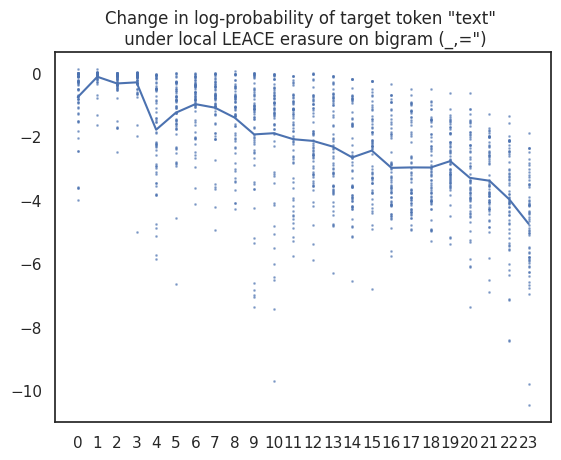

In [ ]:
ofd_scatter(s_lf)

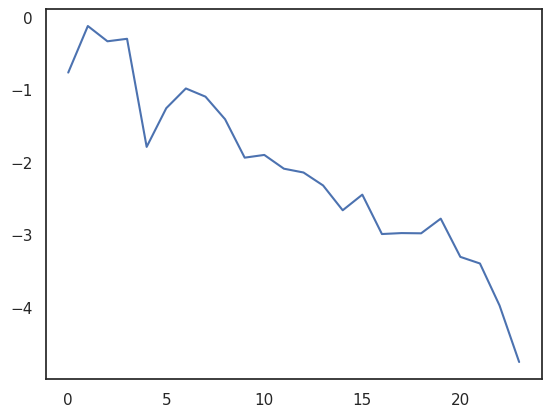

In [ ]:
plt.plot(s_lf.mean(dim=1))

In [ ]:
s_lf.shape

torch.Size([24, 62])

In [ ]:
# Redefining the function to plot scatter plot with a completely white background
def plot_tensor_scatter_white_bg(tensor):
    """
    Plot a scatter plot for a given tensor of size [23, 62] with a completely white background.

    Parameters:
        tensor (torch.Tensor): A tensor of size [23, 62].

    Returns:
        None
    """
    # Checking the shape of the tensor
    if tensor.shape != torch.Size([23, 62]):
        print("Invalid tensor shape. Expected shape [23, 62].")
        return

    # Converting the tensor to a numpy array
    np_array = tensor.numpy()

    # Creating lists to store the x and y values for scatter plot
    x_values = []
    y_values = []

    # Filling up x and y values
    for i, row in enumerate(np_array):
        for value in row:
            x_values.append(i)
            y_values.append(value)

    # Creating the scatter plot with a white background
    sns.set(style="white")
    plt.figure(figsize=(14, 8))
    sns.scatterplot(x=x_values, y=y_values, palette="tab10", edgecolor=None)
    plt.xticks(range(0, 24))
    plt.xlabel('Row Index')
    plt.ylabel('Value')
    plt.title('Scatter plot of tensor values')
    plt.grid(False)
    plt.show()

# Returning the function
plot_tensor_scatter_white_bg


<function __main__.plot_tensor_scatter_white_bg(tensor)>

In [ ]:
sx_target_logprob_list

tensor([-0.1124, -0.0303, -0.0257, -0.0248, -2.3586, -1.2846, -0.8246, -0.8234,
        -1.6828, -0.6042, -0.4515, -0.7067, -1.2746, -1.6719, -2.0794, -2.4296,
        -2.8608, -2.6514, -3.0967, -2.2549, -2.6791, -3.7584, -3.9698])

In [ ]:
sx_target_rank_list

tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        1., 0., 0., 2., 2.])

In [ ]:
len(of_dict['logits_erased_dict_list'])

500

In [ ]:
val_x_clean_target_logprob

tensor(-0.0163)

In [ ]:
val_x_erased_s_target_logprob

tensor(-0.0248)

In [ ]:
torch.topk(val_x_erased_s_logprobs,k=1)

torch.return_types.topk(
values=tensor([-0.0248]),
indices=tensor([1156]))

In [ ]:
tokenizer.decode((1156))

'text'

In [ ]:
len(vdset)

500

In [ ]:
for i, (seq, label, label2) in tqdm(enumerate(vdset)):
  print(seq)
  break

0it [00:00, ?it/s]

tensor([ 1511,   568,  1156,    16, 14606,     3,  6740,   568, 12426,    64,
        18833,    15,  4305,  6750,  3866,    31,   187,   187,    29,  3866,
         1511,   568])


In [ ]:
torch.topk(loss_clean[])

In [ ]:
loss_clean, loss_erased

(tensor(2.5907), tensor(2.6600))

In [ ]:
loss_erased

tensor([[[-2.4345, -2.6905,  3.0988,  ..., -2.4729, -3.2940, -2.6085],
         [-1.7133, -1.3112,  9.5818,  ..., -0.7193, -1.0631, -1.1001],
         [-1.9513, -1.4827,  6.4103,  ..., -1.6539, -1.6170, -1.3090],
         ...,
         [ 2.6625,  1.3864,  8.9484,  ...,  1.3125,  1.7559,  1.6887],
         [-1.0835, -0.1303,  5.8781,  ..., -0.0580, -0.1577, -0.4478],
         [ 0.3092,  0.2889,  8.7468,  ..., -0.1205,  0.0189,  0.7043]],

        [[-4.4742, -3.1175,  5.6348,  ..., -3.0013, -3.3892, -3.3541],
         [-3.2762, -1.6714,  6.4265,  ..., -1.9022, -2.0002, -1.9044],
         [-2.8206, -0.8330,  3.9557,  ..., -0.9963, -1.1082, -1.0357],
         ...,
         [-0.2981,  1.2652,  6.7370,  ...,  1.9903,  1.3150,  1.5336],
         [-0.2384,  0.2095,  8.7036,  ...,  1.0600,  0.8349,  0.5743],
         [-2.4998, -1.0185,  8.0776,  ..., -0.0385, -0.7313, -0.4579]]])

# Feature direction ablations

In [ ]:
def pi(logits,type_id,demean=True):
  if demean:
    return (logits - logits.mean())[type_id]
  else:
    return logits[type_id]
def pirho(logits,type_id):
  return round(pi(logits,type_id).item(),5), rank_in(logits,type_id)
def pirhodiff(L_clean,L_abl,type_id,do_logsoftmax=False):
  if do_logsoftmax:
    m = torch.nn.LogSoftmax(dim=-1)
    L_clean = m(L_clean)
    L_abl = m(L_clean)
  pi_clean, rho_clean = pirho(L_clean,type_id)
  pi_abl, rho_abl = pirho(L_abl,type_id)
  pi_diff = pi_abl - pi_clean
  rho_diff = rho_abl - rho_clean
  return round(pi_diff,5), rho_diff

In [ ]:
def replacement_hook_fc(value, hook):
  #print('replacement abl')
  #print(hook.name, value.shape)
  global global_abl_vector
  before = value[:,-1]
  after = global_abl_vector
  value[:,-1,:] = after
  return value
def additive_hook_fc(value, hook):
  #print('add abl')
  #print(hook.name, value.shape)
  global global_abl_vector
  before = value[:,-1,:]
  addition = global_abl_vector
  after = before + addition
  #print(torch.norm(before,dim=-1), torch.norm(addition,dim=-1), torch.norm(after,dim=-1))
  value[:,-1,:] = after
  return value
def interpolation_hook_fc(value, hook):
  #print(hook.name, value.shape)
  global global_abl_vector
  before = value[:,-1,:]
  after = (1 - global_interpolation_alpha) * before + (global_interpolation_alpha) * global_abl_vector
  #print(torch.norm(before,dim=-1),  torch.norm(after,dim=-1))
  value[:,-1,:] = after
  return value
def rotational_hook_fc(value, hook):
  #print(hook.name, value.shape)
  global global_abl_vector
  before = value[0,-1]
  total_sim = cossim(before,global_abl_vector)
  total_dist = 1 - total_sim
  goal_dist = 0.1 * total_dist
  after = rotate(before, global_abl_vector, 1 - goal_dist, 0.01)
  print('vector used', ablation_vector_used)
  if ablation_vector_used == 'xlr':
    print('classifier before after', xlr_classifier(before), xlr_classifier(after))
  print('before sim', cossim(before, global_abl_vector))
  print('total_dist', total_dist)
  print('goal_dist', goal_dist)
  print('before after sim', cossim(before,after))
  print('after target sim', cossim(after,global_abl_vector))
  value[0,-1] = after
  return value

In [ ]:
logsoftmax = nn.LogSoftmax(dim=-1)
global_interpolation_alpha = 1.

In [ ]:
ablation_hook_fcs_dict = {
    'replacement': replacement_hook_fc,
    'addition': additive_hook_fc,
    'interpolation': interpolation_hook_fc,
    'rotational': rotational_hook_fc
}

In [ ]:
def get_ablation_vector(dset_dict, ablation_vector_type, hook_name, normalize):
  print(ablation_vector_type)
  if ablation_vector_type == 'x_mean_pos':
    ablation_vectors_dict = get_xpos_mean_dict(dset_dict)
  elif ablation_vector_type == 'short':
    ablation_vectors_dict = get_short_dict(dset_dict)
  elif ablation_vector_type == 'logreg':
    ablation_vectors_dict = get_logreg_weights_dict(dset_dict)
  elif ablation_vector_type == 'neg2diff':
    ablation_vectors_dict = get_neg2diff_mean_dict(dset_dict)
  elif ablation_vector_type == 'latvec':
    ablation_vectors_dict = get_latvec_dict(dset_dict)
  elif ablation_vector_type == 'latvec2':
    ablation_vectors_dict = get_latvec2_dict(dset_dict)
  elif ablation_vector_type == 'random':
    ablation_vectors_dict = get_randvec_dict(dset_dict)
  else:
    raise Exception('Unknow ablation vector type')
  if normalize:
    return F.normalize(ablation_vectors_dict[hook_name],dim=-1)
  return ablation_vectors_dict[hook_name]

In [ ]:
def run_ablation_on_all_vneg2s_fast(dset_dict,
                               target_token,
                               hook_name,
                               ablation_function_name):
  val_neg2_tensordataset = TensorDataset(torch.stack([dset_dict['val_dset'][i.item()][0] for i in torch.argwhere(dset_dict['val_dset'].labels == 3.).reshape(-1)]))
  val_neg2_loader = DataLoader(val_neg2_tensordataset, batch_size=50,shuffle=False)

  logits_cleans_list = []
  logits_abls_list = []
  for _, batch_list in enumerate(val_neg2_loader):
    batch = batch_list[0]
    with torch.no_grad():
      logits_clean = model(
        batch,
        prepend_bos=False,
        return_type="logits",
        stop_at_layer=None
      )[:,-1].cpu()
    with torch.no_grad():
      logits_abl = model.run_with_hooks(
        batch,
        prepend_bos=False,
        return_type="logits",
        fwd_hooks=[(hook_name, ablation_hook_fcs_dict[ablation_function_name])],
        stop_at_layer=None
      )[:,-1].cpu()
    logits_cleans_list.append(logits_clean)
    logits_abls_list.append(logits_abl)
  k=10
  logits_cleans = torch.cat(logits_cleans_list,dim=0)
  logits_abls = torch.cat(logits_abls_list,dim=0)
  logprob_target_cleans = logsoftmax(logits_cleans)[:,target_token]
  logprob_target_abls = logsoftmax(logits_abls)[:,target_token]
  ranks_of_target_in_cleans = torch.tensor([rank_in(row,target_token) for row in logits_cleans])
  ranks_of_target_in_abls = torch.tensor([rank_in(row,target_token) for row in logits_abls])
  cleans_topk = torch.topk(logits_cleans,k=k,dim=-1).indices
  abls_topk = torch.topk(logits_cleans,k=k,dim=-1).indices
  logfolds_target = logprob_target_abls - logprob_target_cleans
  rank_changes_target = ranks_of_target_in_abls - ranks_of_target_in_cleans
  return_dict = {
    #'logits_cleans': logits_cleans, #torch.cat(logits_cleans_list,dim=0)
    #'logits_abls': logits_abls, #torch.cat(logits_abls_list,dim=0)
    'logprob_target_cleans': logprob_target_cleans, #logsoftmax(logits_abls)[target_i]
    'logprob_target_abls': logprob_target_abls, #logsoftmax(logits_cleans)[target_i]
    'ranks_of_target_in_cleans': ranks_of_target_in_cleans, #torch.tensor([rank_in(row,target_i) for row in logits_cleans])
    'ranks_of_target_in_abls': ranks_of_target_in_abls,# torch.tensor([rank_in(row,target_i) for row in logits_abls])
    'cleans_topk': cleans_topk, # torch.topk(logits_cleans,k=k,dim=-1).indices
    'abls_topk': abls_topk, # torch.topk(logits_cleans,k=k,dim=-1).indices
    'logfolds_target': logfolds_target, # logprob_target_abls - logprob_target_cleans
    'rank_changes_target': rank_changes_target, # ranks_of_target_in_abls - ranks_of_target_in_cleans
  }
  del logits_cleans
  del logits_abls
  del logprob_target_cleans
  del logprob_target_abls
  torch.cuda.empty_cache()
  gc.collect()
  return return_dict

In [ ]:
def run_norm_scaling(dset_dict, ablation_vector, hook_name, target_token, ablation_function_name, n_steps=5):
  abl_results_cs = []
  cs = torch.linspace(0.1,50,n_steps) #[1:2]
  #print('cs', cs.shape)
  norms = []
  for c in tqdm(cs):
    #print(c)
    global global_abl_vector
    global_abl_vector = c * ablation_vector
    abl_results_c = run_ablation_on_all_vneg2s_fast(
        dset_dict = dset_dict,
        target_token = target_token,
        hook_name = hook_name,
        ablation_function_name = ablation_function_name
    )
    abl_results_cs.append(abl_results_c)
    norms.append(torch.norm(global_abl_vector,dim=-1).item())
  #print(len(norms), len(abl_results_cs))
  return torch.tensor(norms), abl_results_cs

In [ ]:
def plot_c_scaling(norms,abl_results_c):
  logfolds_cs = torch.stack([abl_results_c['logfolds_target'] for abl_results_c in abl_results_c]).T
  ranks_cs = torch.stack([abl_results_c['ranks_of_target_in_abls'] for abl_results_c in abl_results_c]).T
  print('norms', norms.shape)
  print('lgofolds ranks', logfolds_cs.shape, ranks_cs.shape)
  for row in logfolds_cs:
    plt.plot(norms,row.cpu(),linewidth=0.3,alpha=0.3)
  plt.plot(norms,logfolds_cs.mean(dim=0).cpu(),linewidth=3)
  plt.show()
  for row in ranks_cs:
    plt.plot(norms,row.cpu(),linewidth=0.3,alpha=0.3)
  plt.plot(norms,ranks_cs.median(dim=0).values.cpu(),linewidth=3)

In [ ]:
def plot_c_scaling_compare(norms1,abl_results_c1,norms2,abl_results_c2,name1,name2,field,agg='mean'):
  logfolds_cs2 = torch.stack([abl_results_c[field] for abl_results_c in abl_results_c2]).T
  logfolds_cs1 = torch.stack([abl_results_c[field] for abl_results_c in abl_results_c1]).T

  for row in logfolds_cs1:
    plt.plot(norms1,row.cpu(),linewidth=0.3,alpha=0.3,color='b')
  for row in logfolds_cs2:
    plt.plot(norms2,row.cpu(),linewidth=0.3,alpha=0.3,color='r')
  if agg == 'mean':
    plt.plot(norms1,logfolds_cs1.mean(dim=0).cpu(),linewidth=3,label=name1,color='b')
    plt.plot(norms2,logfolds_cs2.mean(dim=0).cpu(),linewidth=3,label=name2,color='r')
  elif agg == 'median':
    plt.plot(norms1,logfolds_cs1.median(dim=0).values.cpu(),linewidth=3,label=name1,color='b')
    plt.plot(norms2,logfolds_cs2.median(dim=0).values.cpu(),linewidth=3,label=name2,color='r')
  plt.title(field)
  plt.legend()
  plt.show()

import re

ylabel_dict = {
    'logprob_target_abls': 'log-probability of target under ablation',
    'ranks_of_target_in_abls': 'rank of target under ablation',
    'logfolds_target': 'change in log-probability of target under ablation'
}

def extract_integer(s):
    match = re.search(r'\d+', s)
    if match:
        return int(match.group(0))
    return None

def plot_c_scaling_compare_many(norms_results_names_triple_list,field,example_name,agg='mean'):
  colors = ['red', 'blue', 'green', 'orange', 'purple']
  for i, (norms2, abl_results_c2, name2) in enumerate(norms_results_names_triple_list):
    logfolds_cs2 = torch.stack([abl_results_c[field] for abl_results_c in abl_results_c2]).T
    #for row in logfolds_cs2:
    #  plt.plot(norms2,row.cpu(),linewidth=0.3,alpha=0.3,color=colors[i])
    if agg == 'mean':
      plt.plot(norms2,logfolds_cs2.mean(dim=0).cpu(),linewidth=3,label=name2,color=colors[i])
    elif agg == 'median':
      plt.plot(norms2,logfolds_cs2.median(dim=0).values.cpu(),linewidth=3,label=name2,color=colors[i])
  title = ylabel_dict[field]
  plt.title(f'{title} \n {example_name} \n s = {extract_integer(hook_name)}')
  plt.xlabel('norm of added vector')
  plt.ylabel(title)
  plt.legend()
  plt.savefig(f'{field}_{example_name}.png',dpi=300)
  plt.show()

In [ ]:
hook_name = 'blocks.2.hook_resid_pre'
ablation_function_name = 'addition'

In [ ]:
cid = great_cids[-20]

In [ ]:
addition_abl_bid_results_per_bid = {}

tensor([275, 253]) ' in the' ' in' ' the'
( in, the) =>  morning
x_mean_pos


100%|██████████| 5/5 [00:28<00:00,  5.63s/it]


logreg


100%|██████████| 5/5 [00:27<00:00,  5.56s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_pca.py:642: RuntimeWarning: invalid value encountered in divide
  self.explained_variance_ratio_ = self.explained_variance_ / total_var


latvec


100%|██████████| 5/5 [00:28<00:00,  5.63s/it]


latvec2


100%|██████████| 5/5 [00:28<00:00,  5.64s/it]


random


100%|██████████| 5/5 [00:28<00:00,  5.68s/it]


tensor(True)
tensor(False)
tensor(True)
tensor(False)


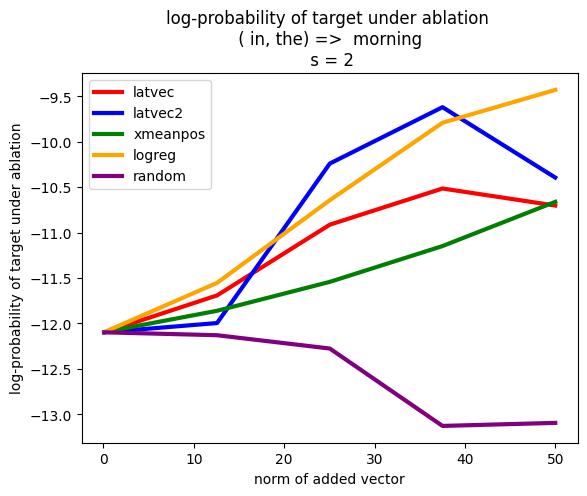

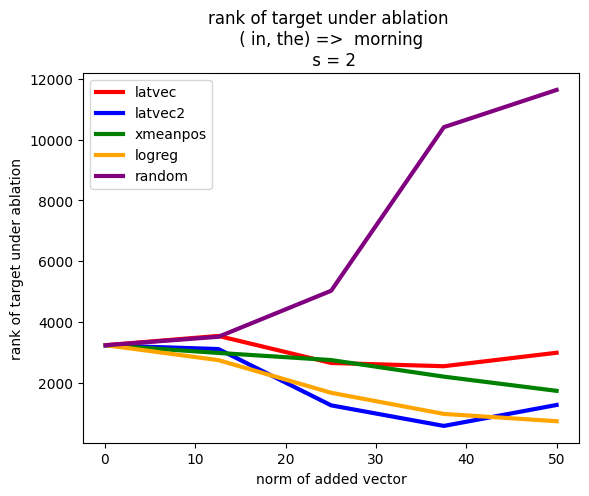

tensor([ 28, 187]) ';\n' ';' '\n'
(;,
) =>     
x_mean_pos


100%|██████████| 5/5 [00:28<00:00,  5.74s/it]


logreg


100%|██████████| 5/5 [00:28<00:00,  5.66s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_pca.py:642: RuntimeWarning: invalid value encountered in divide
  self.explained_variance_ratio_ = self.explained_variance_ / total_var


latvec


100%|██████████| 5/5 [00:28<00:00,  5.64s/it]


latvec2


100%|██████████| 5/5 [00:28<00:00,  5.60s/it]


random


100%|██████████| 5/5 [00:27<00:00,  5.59s/it]


tensor(True)
tensor(False)
tensor(False)
tensor(False)


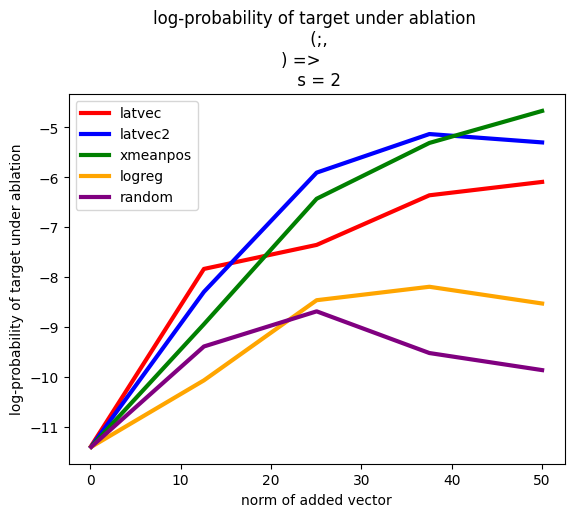

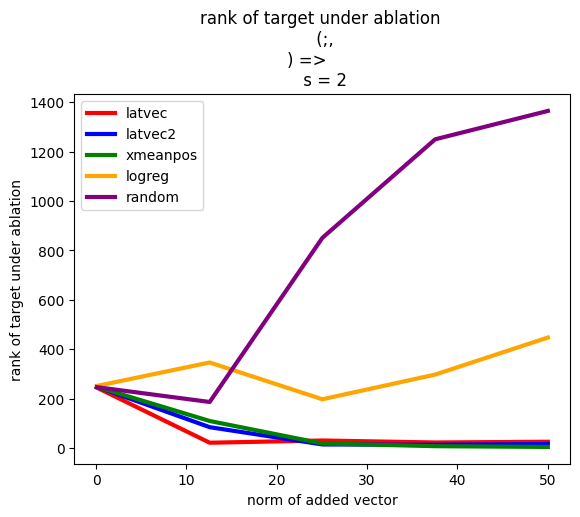

tensor([327, 253]) ' on the' ' on' ' the'
( on, the) =>  road
x_mean_pos


100%|██████████| 5/5 [00:28<00:00,  5.77s/it]


logreg


100%|██████████| 5/5 [00:28<00:00,  5.63s/it]


latvec


/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_pca.py:642: RuntimeWarning: invalid value encountered in divide
  self.explained_variance_ratio_ = self.explained_variance_ / total_var
100%|██████████| 5/5 [00:27<00:00,  5.56s/it]


latvec2


100%|██████████| 5/5 [00:27<00:00,  5.57s/it]


random


100%|██████████| 5/5 [00:28<00:00,  5.62s/it]


tensor(True)
tensor(False)
tensor(True)
tensor(True)


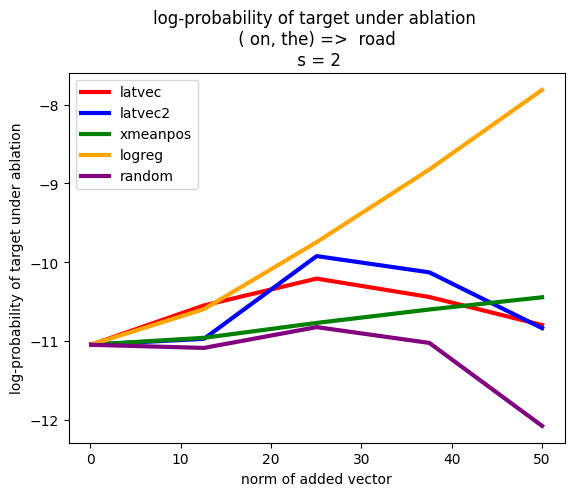

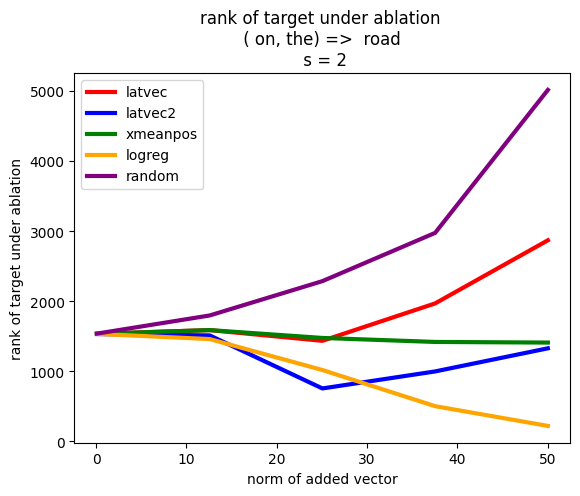

tensor([ 10, 187]) ')\n' ')' '\n'
(),
) => {
x_mean_pos


100%|██████████| 5/5 [00:28<00:00,  5.77s/it]


logreg


100%|██████████| 5/5 [00:28<00:00,  5.68s/it]


latvec


100%|██████████| 5/5 [00:27<00:00,  5.59s/it]


latvec2


 80%|████████  | 4/5 [00:22<00:05,  5.61s/it]Exception ignored in: <function _xla_gc_callback at 0x7cfbc8f70b80>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/jax/_src/lib/__init__.py", line 101, in _xla_gc_callback
    def _xla_gc_callback(*args):
KeyboardInterrupt: 
100%|██████████| 5/5 [00:27<00:00,  5.59s/it]


random


 20%|██        | 1/5 [00:08<00:35,  9.00s/it]


KeyboardInterrupt: ignored

In [ ]:
for bid, qset in dope_qsets.items(): #cid in great_cids:
  bid = bid.item()
  qset_add_dicts_filepath = f'/content/drive/MyDrive/thesis/zoomin/addition_abl/qset_add_dicts/A{bid}.pt'
  if exists(qset_add_dicts_filepath): continue
  #bid_consequent_dict = bid_consequent_elems[cid]
  #bid = bid_consequent_dict['bid']
  if bid in addition_abl_bid_results_per_bid: continue
  dset_dict = select_dset_dict_by_bigram_id(bid, ALL_RESID_HOOKS)
  assert dset_dict['bigram_id'] == bid
  empirical_next_token = qset[0] #bid_consequent_dict['mnt'] #['pos_top_next']
  use_normalization = True
  example_name = print_bigram_id(bid, extended=True) + ' => ' + tokenizer.decode((empirical_next_token))
  #print(bid_consequent_dict['bid'])
  print(example_name)

  norms_xmeanpos, abl_results_xmeanpos = run_norm_scaling(dset_dict,
                                                      get_ablation_vector(dset_dict,
                                                                          'x_mean_pos',
                                                                          hook_name,
                                                                          normalize=use_normalization),
                                                      hook_name,
                                                      empirical_next_token,
                                                      'addition')

  norms_logreg, abl_results_logreg = run_norm_scaling(dset_dict,
                                                      get_ablation_vector(dset_dict,
                                                                          'logreg',
                                                                          hook_name,
                                                                          normalize=use_normalization),
                                                      hook_name,
                                                      empirical_next_token,
                                                      'addition')

  norms_latvec, abl_results_latvec = run_norm_scaling(dset_dict,
                                                      get_ablation_vector(dset_dict,
                                                                          'latvec',
                                                                          hook_name,
                                                                          normalize=use_normalization),
                                                      hook_name,
                                                      empirical_next_token,
                                                      'addition')

  norms_latvec2, abl_results_latvec2 = run_norm_scaling(dset_dict,
                                                      get_ablation_vector(dset_dict,
                                                                          'latvec2',
                                                                          hook_name,
                                                                          normalize=use_normalization),
                                                      hook_name,
                                                      empirical_next_token,
                                                      'addition')


  norms_random, abl_results_random = run_norm_scaling(dset_dict,
                                                      get_ablation_vector(dset_dict,
                                                                          'random',
                                                                          hook_name,
                                                                          normalize=use_normalization),
                                                      hook_name,
                                                      empirical_next_token,
                                                      'addition')

  addition_abl_bid_results = {
      'bid': bid,
      'hook_name': hook_name, #'consequent_dict': #bid_consequent_dict,
      'empirical_next_token': empirical_next_token,
      'use_normalization': use_normalization,
      'results': {
          'latvec': (norms_latvec, abl_results_latvec),
          'latvec2': (norms_latvec2, abl_results_latvec2),
          'xmeanpos': (norms_xmeanpos, abl_results_xmeanpos),
          'logreg': (norms_logreg, abl_results_logreg),
          'random': (norms_random, abl_results_random),
      }
  }

  addition_abl_bid_results_per_bid[bid] = addition_abl_bid_results

  eqtest_lp_logreg_vs_noabl = addition_abl_bid_results['results']['logreg'][1][0]['logprob_target_abls'].mean() > addition_abl_bid_results['results']['logreg'][1][0]['logprob_target_cleans'].mean()
  eqtest_rank_logreg_vs_noabl = addition_abl_bid_results['results']['logreg'][1][0]['ranks_of_target_in_abls'].median() < addition_abl_bid_results['results']['logreg'][1][0]['ranks_of_target_in_cleans'].median()
  eqtest_lp_logreg_vs_random = addition_abl_bid_results['results']['logreg'][1][0]['logprob_target_abls'].mean() > addition_abl_bid_results['results']['random'][1][0]['logprob_target_abls'].mean()
  eqtest_rank_logreg_vs_random = addition_abl_bid_results['results']['logreg'][1][0]['ranks_of_target_in_abls'].median() < addition_abl_bid_results['results']['random'][1][0]['ranks_of_target_in_abls'].median()

  print(eqtest_lp_logreg_vs_noabl)
  print(eqtest_rank_logreg_vs_noabl)
  print(eqtest_lp_logreg_vs_random)
  print(eqtest_rank_logreg_vs_random)

  delete_dict(dset_dict)
  torch.save(addition_abl_bid_results, qset_add_dicts_filepath)

  plot_c_scaling_compare_many([(a, b, name) for name, (a,b) in addition_abl_bid_results['results'].items()],
                            field='logprob_target_abls', example_name=example_name)
  plot_c_scaling_compare_many([(a, b, name) for name, (a,b) in addition_abl_bid_results['results'].items()],
                            field='ranks_of_target_in_abls', example_name=example_name, agg='median')

In [ ]:
#for bid, addition_abl_bid_results in addition_abl_bid_results_per_bid.items():
#  torch.save(addition_abl_bid_results, f'/content/drive/MyDrive/thesis/zoomin/addition_abl/qset_add_dicts/{bid}.pt')

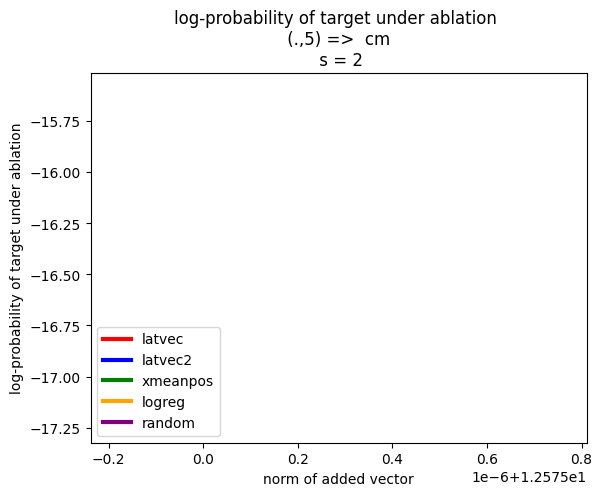

In [ ]:
addition_abl_bid_results['results']['logreg'][0]

tensor([12.5750])

In [ ]:
addition_abl_bid_results['results']['logreg'][1][0]['logprob_target_cleans'].mean()

tensor(-13.9200)

In [ ]:
addition_abl_bid_results['results']['logreg'][1][1]['logprob_target_abls'].mean()

tensor(-13.6666)

TtestResult(statistic=5.992966811644588, pvalue=9.52084940251275e-09, df=199)

In [ ]:
addition_abl_bid_results_per_bid

{}

In [ ]:
eqtest_lp_logreg_vs_noabl = []
eqtest_rank_logreg_vs_noabl = []
eqtest_lp_logreg_vs_random = []
eqtest_rank_logreg_vs_random = []
test_vec_name = 'xmeanpos'
test_vec_control_name = 'random'
for bid, addition_abl_bid_results in addition_abl_bid_results_per_bid.items():
  eqtest_lp_logreg_vs_noabl.append(addition_abl_bid_results['results'][test_vec_name][1][0]['logprob_target_abls'].mean() > addition_abl_bid_results['results'][test_vec_name][1][0]['logprob_target_cleans'].mean())
  eqtest_rank_logreg_vs_noabl.append(addition_abl_bid_results['results'][test_vec_name][1][0]['ranks_of_target_in_abls'].median() < addition_abl_bid_results['results'][test_vec_name][1][0]['ranks_of_target_in_cleans'].median())
  eqtest_lp_logreg_vs_random.append(addition_abl_bid_results['results'][test_vec_name][1][0]['logprob_target_abls'].mean() > addition_abl_bid_results['results'][test_vec_control_name][1][0]['logprob_target_abls'].mean())
  eqtest_rank_logreg_vs_random.append(addition_abl_bid_results['results'][test_vec_name][1][0]['ranks_of_target_in_abls'].median() < addition_abl_bid_results['results'][test_vec_control_name][1][0]['ranks_of_target_in_abls'].median())


In [ ]:
torch.stack(eqtest_lp_logreg_vs_noabl).float().mean()

tensor(0.9462)

In [ ]:
torch.stack(eqtest_rank_logreg_vs_noabl).float().mean()

tensor(0.8602)

In [ ]:
torch.stack(eqtest_lp_logreg_vs_random).float().mean()

tensor(0.7742)

In [ ]:
torch.stack(eqtest_rank_logreg_vs_random).float().mean()

tensor(0.8710)

In [ ]:
len(eqtest_lp_logreg_vs_random)

93

In [ ]:
addition_abl_bid_results['results']['logreg'][1][1]['ranks_of_target_in_abls'].median() #,addition_abl_bid_results['results']['logreg'][1][1]['ranks_of_target_in_cleans']

IndexError: ignored

In [ ]:
addition_abl_bid_results['results']['logreg'][1][1]['ranks_of_target_in_cleans'].median()

tensor(2439)

In [ ]:
addition_abl_bid_results['results']['random'][1][1]['ranks_of_target_in_abls'].median()

tensor(2677)

In [ ]:
addition_abl_bid_results['results']['logreg'][1][1]['ranks_of_target_in_cleans']

tensor([ 1874,  1771,  7592,  1452,  2057,   411,  7413,  3231,  3097,  5731,
          191,    43,  2668, 17109,  1870,  5274,   724,   572, 10908,  1285,
         2472,  2823,  4074,   534,   628,  1807,   449,   616,  3995,   495,
         2181,  1572,   290,  4518,  2602,  1198,  3160,    80,   786,  6324,
         5750,  1713,  9527,  2265,  3356,  3438,   201,  1938,   713,  7142,
         2439, 15170,  6514, 26670,  5923,   309,  2415,  1274,  5168, 14854,
         6605,  4114,  2580,  2418,  7681,  3120, 11366,   687,  2869,  2589,
         8457,  1930,    29,  8477,  1136,  1621,   974,  5467,  4078,  5258,
         4556,  2663,  4867,   786,  1780,  5155,   625,  7466,   892,    24,
         7072,  2516,  6733,  1718, 10625,  3022,  3355,  5681,   381,  2193,
         3535,  4908,   467,  5577,  1060,  1020,    75,  4904,  1978,  3781,
         2345,  1972,  1360,  1136,  2827,  1512,    53,  3998,  1481,  5020,
         2149,  4052,  3501,   101,  6514,  5041,   413,  2695, 

In [ ]:
addition_abl_bid_results['results']['logreg'][1][1]

{'logprob_target_cleans': tensor([-11.1182, -10.6671, -14.1165, -10.9079, -15.8134,  -9.5004, -12.0231,
         -11.6783, -13.3935, -14.4857,  -7.8548,  -6.5209, -11.8294, -18.3059,
         -11.3978, -16.3667, -10.7405,  -9.0215, -17.4878, -10.6027, -12.8410,
         -11.4578, -14.3474,  -9.0045,  -8.9217, -10.9838,  -8.6434,  -9.7252,
         -14.9954,  -8.4286, -12.7438, -12.8924,  -8.3674, -13.0068, -10.8261,
         -10.1563, -11.9890,  -6.7727,  -9.2533, -13.8761, -12.5795, -16.3531,
         -13.5100, -10.5674, -11.8780, -12.8635,  -8.3184, -10.6315,  -9.3165,
         -21.2398, -12.5047, -19.3802, -13.6768, -25.5132, -13.0022,  -8.2171,
         -13.5722, -11.4016, -18.1188, -16.4874, -13.6002, -12.5159, -11.3628,
         -11.4700, -14.8460, -11.3310, -15.5804,  -9.3020, -12.0172, -11.8373,
         -18.3467, -12.2659,  -5.3666, -16.5663,  -9.8974, -15.3168, -13.2975,
         -19.8094, -14.2863, -12.1517, -14.1742, -11.9919, -17.3001, -12.4795,
         -14.1615, -14.0054

TtestResult(statistic=-7.209175190181461, pvalue=1.145804658277118e-11, df=199)

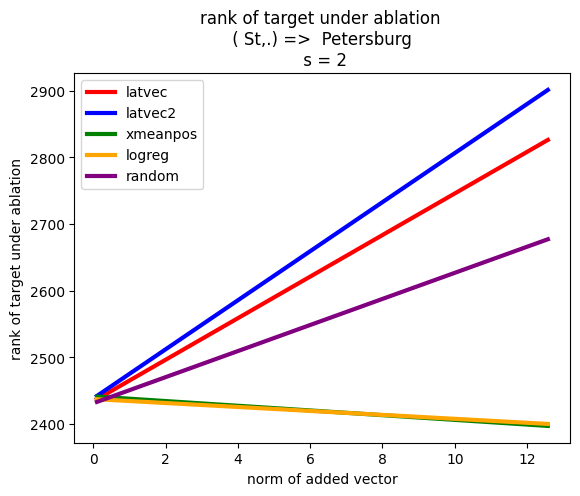

In [ ]:
plot_c_scaling_compare_many([(a, b, name) for name, (a,b) in addition_abl_bid_results['results'].items()],
                            field='ranks_of_target_in_abls', example_name=example_name, agg='median')

In [ ]:
val_neg2_tensordataset = TensorDataset(torch.stack([dset_dict['val_dset'][i.item()][0] for i in torch.argwhere(dset_dict['val_dset'].labels == 3.).reshape(-1)]))
val_neg2_loader = DataLoader(val_neg2_tensordataset, batch_size=50,shuffle=False)

for _, batch_list in enumerate(val_neg2_loader):
  batch = batch_list[0]
  with torch.no_grad():
    logits_clean = model(
      batch,
      prepend_bos=False,
      return_type="logits",
      stop_at_layer=None
    )[:,-1].cpu()
  break

In [ ]:
empirical_next_token

320

In [ ]:
logits_clean[0].shape

torch.Size([50304])

In [ ]:
len(addition_abl_bid_results['results']['xmeanpos'][1])#['ranks_of_target_in_cleans']

5

In [ ]:
[rank_in(logits, empirical_next_token) for logits in logits_clean]

[2707,
 235,
 355,
 3137,
 11,
 317,
 18,
 2,
 3,
 6,
 1026,
 0,
 36,
 2560,
 5,
 606,
 153,
 152,
 0,
 30,
 1,
 7,
 11,
 21,
 38,
 174,
 166,
 3281,
 85,
 296,
 308,
 28,
 30,
 31,
 1161,
 0,
 240,
 17,
 14,
 870,
 91,
 402,
 1992,
 551,
 1,
 1313,
 19,
 146,
 1,
 7]

In [ ]:
logits_clean[:,empirical_next_token]

tensor([ 3.8061, 11.7095, 10.8760,  6.1965, 15.4327, 10.6351, 16.1650, 19.3299,
        17.3915, 14.9846,  8.3536, 20.6306, 16.6315,  8.4282, 16.8820,  9.6982,
        13.6731, 11.3476, 19.1204, 14.1601, 20.6710, 15.5697, 16.7589, 17.6470,
        15.3832, 11.0095, 11.7465,  7.0029, 14.6627, 10.3587, 10.4984, 16.4100,
        16.3110, 13.7712,  9.2422, 22.5063, 11.5717, 17.1975, 16.0658,  9.6771,
        14.4032, 10.8169,  8.5723, 10.1993, 19.5296,  8.3147, 15.9017, 14.3839,
        19.9847, 18.5460])

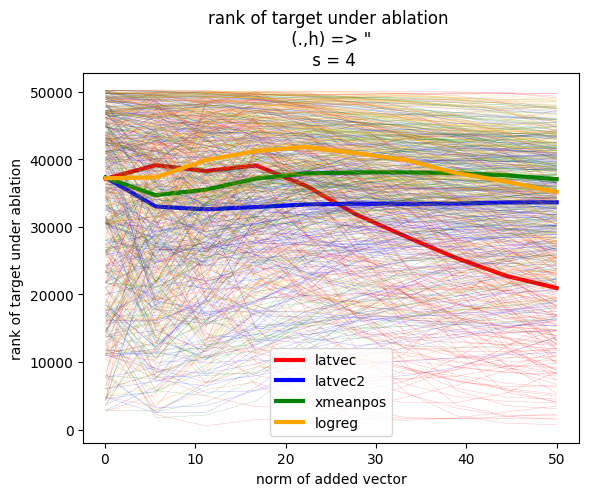

In [ ]:
plot_c_scaling_compare_many([(a, b, name) for name, (a,b) in addition_abl_bid_results_s2['results'].items()],
                            field='ranks_of_target_in_abls', example_name=example_name, agg='median')

In [ ]:
plot_c_scaling_compare_many([(a, b, name) for name, (a,b) in addition_abl_bid_results_s3['results'].items()],
                            field='ranks_of_target_in_abls', example_name=example_name, agg='median')

In [ ]:
plot_c_scaling_compare_many([(a, b, name) for name, (a,b) in addition_abl_bid_results_s3['results'].items()],
                            field='logprob_target_abls', example_name=example_name)

NameError: ignored

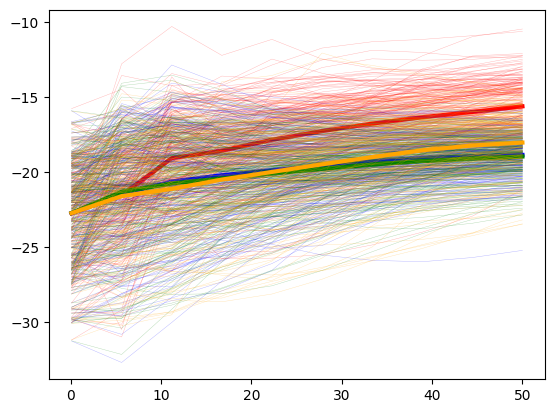

In [ ]:
plot_c_scaling_compare_many([(a, b, name) for name, (a,b) in addition_abl_bid_results['results'].items()],
                            field='logprob_target_abls', example_name=example_name)

In [ ]:
for bid_consequent_dict in bid_consequent_elems:
  if exists(f'/content/drive/MyDrive/thesis/zoomin/addition_abl/results/{hook_name}/{bid_consequent_dict["bid"]}.pt'):
    continue

  torch.save(addition_abl_bid_results, f'/content/drive/MyDrive/thesis/zoomin/addition_abl/results/{hook_name}/{bid_consequent_dict["bid"]}.pt')
  delete_dict(dset_dict)

tensor([187, 187]) '\n\n' '\n' '\n'
0
x_mean_pos


100%|██████████| 10/10 [00:55<00:00,  5.58s/it]


logreg


100%|██████████| 10/10 [00:55<00:00,  5.56s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_pca.py:642: RuntimeWarning: invalid value encountered in divide
  self.explained_variance_ratio_ = self.explained_variance_ / total_var


latvec


100%|██████████| 10/10 [00:56<00:00,  5.63s/it]


latvec2


100%|██████████| 10/10 [00:56<00:00,  5.64s/it]


tensor([ 15, 187]) '.\n' '.' '\n'
1
x_mean_pos


100%|██████████| 10/10 [00:57<00:00,  5.73s/it]


logreg


100%|██████████| 10/10 [00:56<00:00,  5.69s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_pca.py:642: RuntimeWarning: invalid value encountered in divide
  self.explained_variance_ratio_ = self.explained_variance_ / total_var


latvec


100%|██████████| 10/10 [00:56<00:00,  5.66s/it]


latvec2


100%|██████████| 10/10 [00:56<00:00,  5.64s/it]


tensor([275, 253]) ' in the' ' in' ' the'
3
x_mean_pos


100%|██████████| 10/10 [00:57<00:00,  5.73s/it]


logreg


100%|██████████| 10/10 [00:56<00:00,  5.67s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_pca.py:642: RuntimeWarning: invalid value encountered in divide
  self.explained_variance_ratio_ = self.explained_variance_ / total_var


latvec


100%|██████████| 10/10 [00:56<00:00,  5.67s/it]


latvec2


100%|██████████| 10/10 [00:56<00:00,  5.67s/it]


tensor([457,  84]) '’s' '’' 's'
6
x_mean_pos


100%|██████████| 10/10 [00:57<00:00,  5.75s/it]


logreg


100%|██████████| 10/10 [00:57<00:00,  5.76s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_pca.py:642: RuntimeWarning: invalid value encountered in divide
  self.explained_variance_ratio_ = self.explained_variance_ / total_var


latvec


100%|██████████| 10/10 [00:57<00:00,  5.70s/it]


latvec2


100%|██████████| 10/10 [00:56<00:00,  5.68s/it]


tensor([281, 253]) ' to the' ' to' ' the'
7
x_mean_pos


100%|██████████| 10/10 [00:57<00:00,  5.76s/it]


logreg


100%|██████████| 10/10 [00:56<00:00,  5.66s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_pca.py:642: RuntimeWarning: invalid value encountered in divide
  self.explained_variance_ratio_ = self.explained_variance_ / total_var


latvec


100%|██████████| 10/10 [00:56<00:00,  5.63s/it]


latvec2


100%|██████████| 10/10 [00:56<00:00,  5.64s/it]


tensor([ 28, 187]) ';\n' ';' '\n'
13
x_mean_pos


100%|██████████| 10/10 [00:57<00:00,  5.71s/it]


logreg


100%|██████████| 10/10 [00:56<00:00,  5.61s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_pca.py:642: RuntimeWarning: invalid value encountered in divide
  self.explained_variance_ratio_ = self.explained_variance_ / total_var


latvec


100%|██████████| 10/10 [00:56<00:00,  5.67s/it]


latvec2


100%|██████████| 10/10 [00:57<00:00,  5.72s/it]


tensor([327, 253]) ' on the' ' on' ' the'
14
x_mean_pos


100%|██████████| 10/10 [00:57<00:00,  5.72s/it]


logreg


100%|██████████| 10/10 [00:56<00:00,  5.64s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_pca.py:642: RuntimeWarning: invalid value encountered in divide
  self.explained_variance_ratio_ = self.explained_variance_ / total_var


latvec


100%|██████████| 10/10 [00:56<00:00,  5.67s/it]


latvec2


100%|██████████| 10/10 [00:56<00:00,  5.64s/it]


tensor([  187, 50276]) '\n  ' '\n' '  '
16
x_mean_pos


100%|██████████| 10/10 [00:57<00:00,  5.73s/it]


logreg


100%|██████████| 10/10 [00:56<00:00,  5.64s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_pca.py:642: RuntimeWarning: invalid value encountered in divide
  self.explained_variance_ratio_ = self.explained_variance_ / total_var


latvec


100%|██████████| 10/10 [00:56<00:00,  5.66s/it]


latvec2


100%|██████████| 10/10 [00:56<00:00,  5.64s/it]


tensor([285, 253]) ' and the' ' and' ' the'
20
x_mean_pos


100%|██████████| 10/10 [00:57<00:00,  5.75s/it]


logreg


100%|██████████| 10/10 [00:56<00:00,  5.68s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_pca.py:642: RuntimeWarning: invalid value encountered in divide
  self.explained_variance_ratio_ = self.explained_variance_ / total_var


latvec


100%|██████████| 10/10 [00:56<00:00,  5.60s/it]


latvec2


100%|██████████| 10/10 [00:56<00:00,  5.64s/it]


tensor([310, 247]) ' is a' ' is' ' a'
25
x_mean_pos


100%|██████████| 10/10 [00:57<00:00,  5.72s/it]


logreg


100%|██████████| 10/10 [00:56<00:00,  5.63s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_pca.py:642: RuntimeWarning: invalid value encountered in divide
  self.explained_variance_ratio_ = self.explained_variance_ / total_var


latvec


100%|██████████| 10/10 [00:55<00:00,  5.59s/it]


latvec2


100%|██████████| 10/10 [00:57<00:00,  5.72s/it]


tensor([342, 253]) ' with the' ' with' ' the'
27
x_mean_pos


100%|██████████| 10/10 [00:57<00:00,  5.74s/it]


logreg


100%|██████████| 10/10 [00:57<00:00,  5.72s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_pca.py:642: RuntimeWarning: invalid value encountered in divide
  self.explained_variance_ratio_ = self.explained_variance_ / total_var


latvec


100%|██████████| 10/10 [00:57<00:00,  5.73s/it]


latvec2


100%|██████████| 10/10 [00:56<00:00,  5.66s/it]


tensor([310, 253]) ' is the' ' is' ' the'
28
x_mean_pos


100%|██████████| 10/10 [00:57<00:00,  5.75s/it]


logreg


100%|██████████| 10/10 [00:56<00:00,  5.69s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_pca.py:642: RuntimeWarning: invalid value encountered in divide
  self.explained_variance_ratio_ = self.explained_variance_ / total_var


latvec


100%|██████████| 10/10 [00:56<00:00,  5.66s/it]


latvec2


100%|██████████| 10/10 [00:56<00:00,  5.64s/it]


tensor([387, 253]) ' at the' ' at' ' the'
30
x_mean_pos


100%|██████████| 10/10 [00:57<00:00,  5.74s/it]


logreg


100%|██████████| 10/10 [00:56<00:00,  5.67s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_pca.py:642: RuntimeWarning: invalid value encountered in divide
  self.explained_variance_ratio_ = self.explained_variance_ / total_var


latvec


100%|██████████| 10/10 [00:56<00:00,  5.65s/it]


latvec2


100%|██████████| 10/10 [00:56<00:00,  5.64s/it]


tensor([432, 253]) ' from the' ' from' ' the'
32
x_mean_pos


100%|██████████| 10/10 [00:57<00:00,  5.78s/it]


logreg


100%|██████████| 10/10 [00:56<00:00,  5.68s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_pca.py:642: RuntimeWarning: invalid value encountered in divide
  self.explained_variance_ratio_ = self.explained_variance_ / total_var


latvec


100%|██████████| 10/10 [00:56<00:00,  5.61s/it]


latvec2


100%|██████████| 10/10 [00:56<00:00,  5.69s/it]


tensor([ 13, 247]) ', a' ',' ' a'
34
x_mean_pos


100%|██████████| 10/10 [00:58<00:00,  5.82s/it]


logreg


100%|██████████| 10/10 [00:56<00:00,  5.65s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_pca.py:642: RuntimeWarning: invalid value encountered in divide
  self.explained_variance_ratio_ = self.explained_variance_ / total_var


latvec


100%|██████████| 10/10 [00:56<00:00,  5.64s/it]


latvec2


100%|██████████| 10/10 [00:56<00:00,  5.65s/it]


tensor([275, 247]) ' in a' ' in' ' a'
35
x_mean_pos


100%|██████████| 10/10 [00:57<00:00,  5.74s/it]


logreg


100%|██████████| 10/10 [00:56<00:00,  5.64s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_pca.py:642: RuntimeWarning: invalid value encountered in divide
  self.explained_variance_ratio_ = self.explained_variance_ / total_var


latvec


100%|██████████| 10/10 [00:56<00:00,  5.64s/it]


latvec2


100%|██████████| 10/10 [00:56<00:00,  5.67s/it]


tensor([457,  85]) '’t' '’' 't'
38
x_mean_pos


100%|██████████| 10/10 [00:56<00:00,  5.68s/it]


logreg


100%|██████████| 10/10 [00:55<00:00,  5.58s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_pca.py:642: RuntimeWarning: invalid value encountered in divide
  self.explained_variance_ratio_ = self.explained_variance_ / total_var


latvec


100%|██████████| 10/10 [00:56<00:00,  5.65s/it]


latvec2


100%|██████████| 10/10 [00:56<00:00,  5.61s/it]


tensor([187, 186]) '\n\t' '\n' '\t'
40
x_mean_pos


100%|██████████| 10/10 [00:56<00:00,  5.69s/it]


logreg


100%|██████████| 10/10 [00:56<00:00,  5.60s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_pca.py:642: RuntimeWarning: invalid value encountered in divide
  self.explained_variance_ratio_ = self.explained_variance_ / total_var


latvec


100%|██████████| 10/10 [00:56<00:00,  5.60s/it]


latvec2


100%|██████████| 10/10 [00:55<00:00,  5.56s/it]


tensor([326, 253]) ' that the' ' that' ' the'
41
x_mean_pos


100%|██████████| 10/10 [00:56<00:00,  5.66s/it]


logreg


100%|██████████| 10/10 [00:55<00:00,  5.60s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_pca.py:642: RuntimeWarning: invalid value encountered in divide
  self.explained_variance_ratio_ = self.explained_variance_ / total_var


latvec


100%|██████████| 10/10 [00:56<00:00,  5.61s/it]


latvec2


100%|██████████| 10/10 [00:55<00:00,  5.58s/it]


tensor([449, 346]) '." "' '."' ' "'
44
x_mean_pos


100%|██████████| 10/10 [00:57<00:00,  5.74s/it]


logreg


100%|██████████| 10/10 [00:56<00:00,  5.63s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_pca.py:642: RuntimeWarning: invalid value encountered in divide
  self.explained_variance_ratio_ = self.explained_variance_ / total_var


latvec


100%|██████████| 10/10 [00:56<00:00,  5.63s/it]


latvec2


100%|██████████| 10/10 [00:56<00:00,  5.60s/it]


tensor([347, 247]) ' as a' ' as' ' a'
45
x_mean_pos


100%|██████████| 10/10 [00:57<00:00,  5.72s/it]


logreg


100%|██████████| 10/10 [00:56<00:00,  5.64s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_pca.py:642: RuntimeWarning: invalid value encountered in divide
  self.explained_variance_ratio_ = self.explained_variance_ / total_var


latvec


100%|██████████| 10/10 [00:56<00:00,  5.61s/it]


latvec2


100%|██████████| 10/10 [00:55<00:00,  5.57s/it]


tensor([407, 253]) ' by the' ' by' ' the'
46
x_mean_pos


100%|██████████| 10/10 [00:57<00:00,  5.73s/it]


logreg


100%|██████████| 10/10 [00:56<00:00,  5.64s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_pca.py:642: RuntimeWarning: invalid value encountered in divide
  self.explained_variance_ratio_ = self.explained_variance_ / total_var


latvec


100%|██████████| 10/10 [00:56<00:00,  5.64s/it]


latvec2


100%|██████████| 10/10 [00:56<00:00,  5.62s/it]


tensor([187,  14]) '\n-' '\n' '-'
49
x_mean_pos


100%|██████████| 10/10 [00:57<00:00,  5.70s/it]


logreg


100%|██████████| 10/10 [00:56<00:00,  5.68s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_pca.py:642: RuntimeWarning: invalid value encountered in divide
  self.explained_variance_ratio_ = self.explained_variance_ / total_var


latvec


100%|██████████| 10/10 [00:56<00:00,  5.65s/it]


latvec2


100%|██████████| 10/10 [00:56<00:00,  5.62s/it]


tensor([ 13, 352]) ', it' ',' ' it'
50
x_mean_pos


100%|██████████| 10/10 [00:58<00:00,  5.80s/it]


logreg


100%|██████████| 10/10 [00:56<00:00,  5.64s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_pca.py:642: RuntimeWarning: invalid value encountered in divide
  self.explained_variance_ratio_ = self.explained_variance_ / total_var


latvec


100%|██████████| 10/10 [00:56<00:00,  5.68s/it]


latvec2


100%|██████████| 10/10 [00:57<00:00,  5.74s/it]


tensor([  3, 187]) '"\n' '"' '\n'
51
x_mean_pos


100%|██████████| 10/10 [00:59<00:00,  5.92s/it]


logreg


100%|██████████| 10/10 [00:57<00:00,  5.74s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_pca.py:642: RuntimeWarning: invalid value encountered in divide
  self.explained_variance_ratio_ = self.explained_variance_ / total_var


latvec


100%|██████████| 10/10 [00:57<00:00,  5.70s/it]


latvec2


100%|██████████| 10/10 [00:56<00:00,  5.65s/it]


tensor([187, 605]) '\n//' '\n' '//'
52
x_mean_pos


100%|██████████| 10/10 [00:57<00:00,  5.73s/it]


logreg


100%|██████████| 10/10 [00:56<00:00,  5.67s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_pca.py:642: RuntimeWarning: invalid value encountered in divide
  self.explained_variance_ratio_ = self.explained_variance_ / total_var


latvec


100%|██████████| 10/10 [00:56<00:00,  5.62s/it]


latvec2


100%|██████████| 10/10 [00:55<00:00,  5.56s/it]


tensor([187,  34]) '\nA' '\n' 'A'
55
x_mean_pos


100%|██████████| 10/10 [00:57<00:00,  5.71s/it]


logreg


100%|██████████| 10/10 [00:56<00:00,  5.64s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_pca.py:642: RuntimeWarning: invalid value encountered in divide
  self.explained_variance_ratio_ = self.explained_variance_ / total_var


latvec


100%|██████████| 10/10 [00:56<00:00,  5.64s/it]


latvec2


100%|██████████| 10/10 [00:56<00:00,  5.64s/it]


tensor([   15, 50276]) '.  ' '.' '  '
57
x_mean_pos


100%|██████████| 10/10 [00:56<00:00,  5.69s/it]


logreg


100%|██████████| 10/10 [00:56<00:00,  5.63s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_pca.py:642: RuntimeWarning: invalid value encountered in divide
  self.explained_variance_ratio_ = self.explained_variance_ / total_var


latvec


100%|██████████| 10/10 [00:56<00:00,  5.61s/it]


latvec2


100%|██████████| 10/10 [00:56<00:00,  5.63s/it]


tensor([187,   3]) '\n"' '\n' '"'
68
x_mean_pos


100%|██████████| 10/10 [00:56<00:00,  5.67s/it]


logreg


100%|██████████| 10/10 [00:55<00:00,  5.59s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_pca.py:642: RuntimeWarning: invalid value encountered in divide
  self.explained_variance_ratio_ = self.explained_variance_ / total_var


latvec


100%|██████████| 10/10 [00:56<00:00,  5.68s/it]


latvec2


100%|██████████| 10/10 [00:56<00:00,  5.60s/it]


tensor([15, 52]) '.S' '.' 'S'
73
x_mean_pos


100%|██████████| 10/10 [00:57<00:00,  5.77s/it]


logreg


100%|██████████| 10/10 [00:56<00:00,  5.63s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_pca.py:642: RuntimeWarning: invalid value encountered in divide
  self.explained_variance_ratio_ = self.explained_variance_ / total_var


latvec


100%|██████████| 10/10 [00:56<00:00,  5.62s/it]


latvec2


100%|██████████| 10/10 [00:55<00:00,  5.59s/it]


tensor([18, 15]) '1.' '1' '.'
74
x_mean_pos


100%|██████████| 10/10 [00:57<00:00,  5.78s/it]


logreg


100%|██████████| 10/10 [00:56<00:00,  5.69s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_pca.py:642: RuntimeWarning: invalid value encountered in divide
  self.explained_variance_ratio_ = self.explained_variance_ / total_var


latvec


100%|██████████| 10/10 [00:56<00:00,  5.66s/it]


latvec2


100%|██████████| 10/10 [00:57<00:00,  5.71s/it]


tensor([581, 273]) ' one of' ' one' ' of'
75
x_mean_pos


100%|██████████| 10/10 [00:57<00:00,  5.75s/it]


logreg


100%|██████████| 10/10 [00:56<00:00,  5.68s/it]
/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_pca.py:642: RuntimeWarning: invalid value encountered in divide
  self.explained_variance_ratio_ = self.explained_variance_ / total_var


latvec


100%|██████████| 10/10 [00:56<00:00,  5.65s/it]


latvec2


100%|██████████| 10/10 [00:55<00:00,  5.60s/it]


tensor([347, 253]) ' as the' ' as' ' the'
76
x_mean_pos


 20%|██        | 2/10 [00:11<00:45,  5.74s/it]


KeyboardInterrupt: ignored

In [ ]:
for bid_consequent_dict in bid_consequent_elems:
  print(bid_consequent_dict)
  #if exists(f'/content/drive/MyDrive/thesis/zoomin/addition_abl/results/{hook_name}/{bid_consequent_dict["bid"]}.pt'):
  #  continue
  #dset_dict = select_dset_dict_by_bigram_id(bid_consequent_dict['bid'], ALL_RESID_HOOKS)
  #assert dset_dict['bigram_id'] == bid_consequent_dict['bid']
  empirical_next_token = bid_consequent_dict['pos_top_next']
  #use_normalization = True
  example_name = print_bigram_id(bid_consequent_dict['bid'], extended=True) + ' => ' + tokenizer.decode((bid_consequent_dict['pos_top_next']))
  print(example_name)
  if bid_consequent_dict['bid'] > 75:
    break

{'bid': 0, 'did': 0, 'pos_top_next': 510, 'neg2_top_next': 187, 'pos_top_next_freq': tensor(0.0950), 'neg2_top_next_freq': tensor(0.4238), 'pos_top_nexts_all': [510, 1628, 42], 'neg2_top_nexts_all': [187, 50274, 50276, 475, 4, 186, 2948, 14, 50270, 605], 'pos_top_nexts_freqs': tensor([0.0950, 0.0300, 0.0300]), 'neg2_top_nexts_freqs': tensor([0.4238, 0.0388, 0.0381, 0.0338, 0.0219, 0.0219, 0.0206, 0.0169, 0.0150,
        0.0119]), 'criterium_1': tensor(False), 'criterium_2': True}
tensor([187, 187]) '\n\n' '\n' '\n'
(
,
) => The
{'bid': 1, 'did': 1, 'pos_top_next': 187, 'neg2_top_next': 187, 'pos_top_next_freq': tensor(0.7763), 'neg2_top_next_freq': tensor(0.1863), 'pos_top_nexts_all': [187, 14, 42], 'neg2_top_nexts_all': [187, 510, 50276, 50274, 475, 2948, 50270, 186, 688, 4], 'pos_top_nexts_freqs': tensor([0.7763, 0.0225, 0.0100]), 'neg2_top_nexts_freqs': tensor([0.1863, 0.0413, 0.0388, 0.0362, 0.0219, 0.0188, 0.0169, 0.0169, 0.0137,
        0.0125]), 'criterium_1': tensor(True), 'cri

In [ ]:
yo = torch.load(f'/content/drive/MyDrive/thesis/zoomin/addition_abl/results/{hook_name}/35.pt')


In [ ]:
yo75 = torch.load(f'/content/drive/MyDrive/thesis/zoomin/addition_abl/results/{hook_name}/75.pt')


In [ ]:
yo30 = torch.load(f'/content/drive/MyDrive/thesis/zoomin/addition_abl/results/{hook_name}/35.pt')

In [ ]:
yo_select = yo75

In [ ]:
dset_dict = select_dset_dict_by_bigram_id(75, ALL_RESID_HOOKS)
#assert dset_dict['bigram_id'] == bid_consequent_dict['bid']
empirical_next_token = bid_consequent_dict['pos_top_next']

In [ ]:
example_name = print_bigram_id(bid_consequent_dict['bid'], extended=True) + ' => ' + tokenizer.decode((bid_consequent_dict['pos_top_next']))

tensor([347, 253]) ' as the' ' as' ' the'


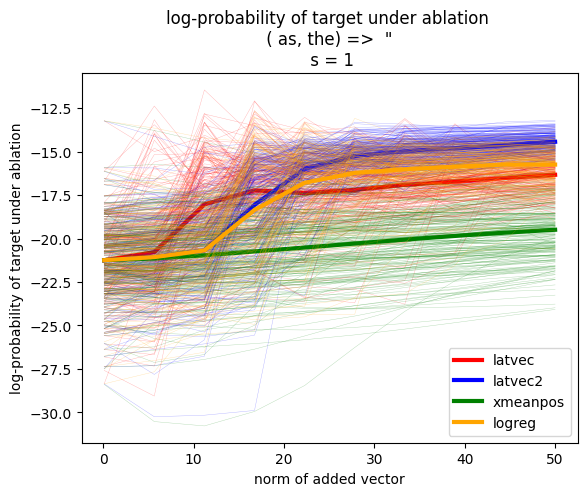

In [ ]:
plot_c_scaling_compare_many([(a, b, name) for name, (a,b) in yo_select['results'].items()],
                            field='logprob_target_abls', example_name=example_name)

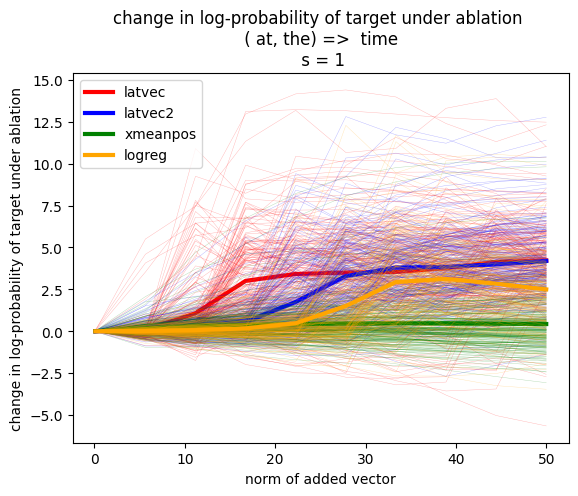

In [ ]:
plot_c_scaling_compare_many([(a, b, name) for name, (a,b) in yo30['results'].items()],
                            field='logfolds_target', example_name='( at, the) =>  time')

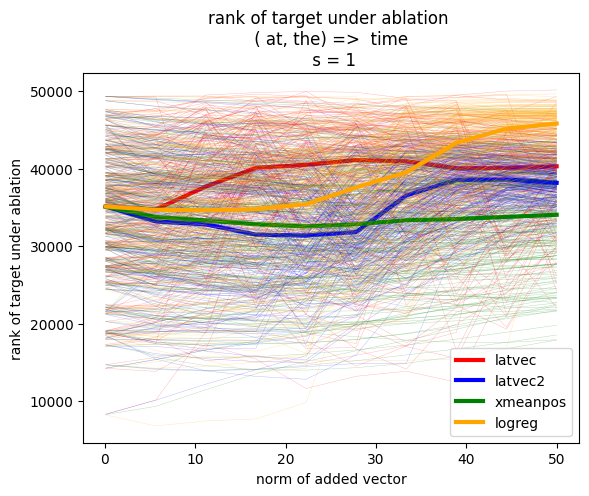

In [ ]:
plot_c_scaling_compare_many([(a, b, name) for name, (a,b) in yo30['results'].items()],
                             example_name='( at, the) =>  time',field ='ranks_of_target_in_abls',agg='median')

In [ ]:
plot_c_scaling_compare_many([(a, b, name) for name, (a,b) in yo30['results'].items()],
                            field='rank', example_name='( at, the) =>  time')

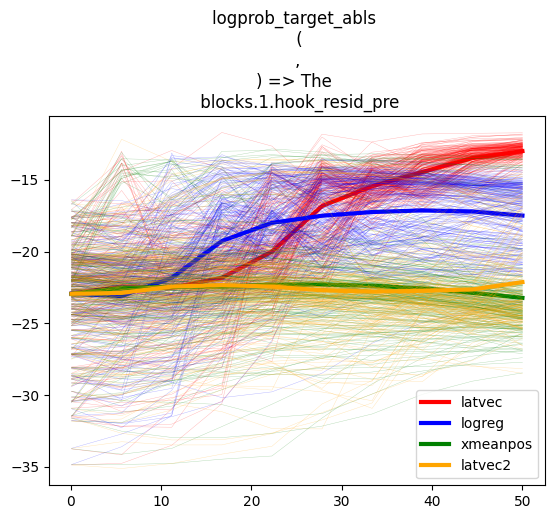

In [ ]:
plot_c_scaling_compare_many([
    (norms_latvec, abl_results_latvec, 'latvec'),
    (norms_logreg, abl_results_logreg, 'logreg'),
    (norms_xmeanpos, abl_results_xmeanpos, 'xmeanpos'),
    (norms_latvec2, abl_results_latvec2, 'latvec2')
], field ='logprob_target_abls',agg='mean')

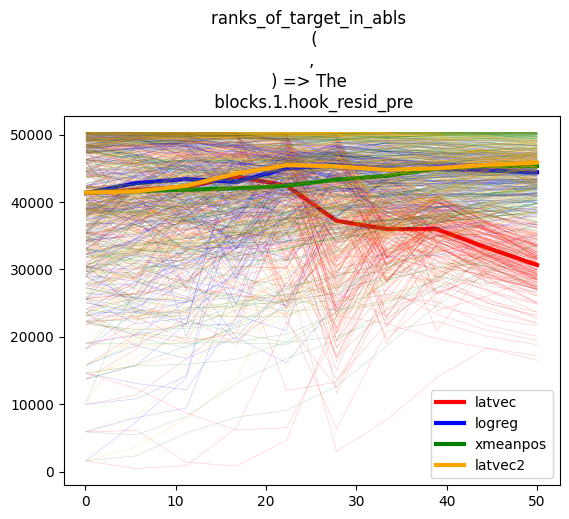

In [ ]:
plot_c_scaling_compare_many([
    (norms_latvec, abl_results_latvec, 'latvec'),
    (norms_logreg, abl_results_logreg, 'logreg'),
    (norms_xmeanpos, abl_results_xmeanpos, 'xmeanpos'),
    (norms_latvec2, abl_results_latvec2, 'latvec2'),
], field ='ranks_of_target_in_abls',agg='median')

In [ ]:

plot_c_scaling_compare(norms_logreg, abl_results_logreg,
                       norms_xmeanpos, abl_results_xmeanpos,
                       'logreg','xmeanpos','logprob_target_abls')
plot_c_scaling_compare(norms_logreg, abl_results_logreg,
                       norms_xmeanpos, abl_results_xmeanpos,
                       'logreg','xmeanpos','ranks_of_target_in_abls',agg='median')

In [ ]:
norms_neg2diff, abl_results_neg2diff = run_norm_scaling(dset_dict,
                                                     get_ablation_vector(dset_dict,
                                                                         'neg2diff',
                                                                         hook_name,
                                                                         normalize=use_normalization),
                                                     hook_name,
                                                     empirical_next_token,
                                                     'addition')

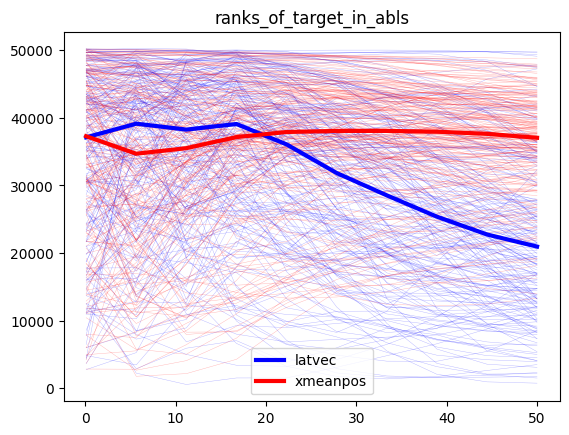

In [ ]:
plot_c_scaling_compare(norms_latvec, abl_results_latvec,
                       norms_xmeanpos, abl_results_xmeanpos,
                       'latvec','xmeanpos','ranks_of_target_in_abls',agg='median')

In [ ]:
plot_c_scaling_compare(norms_latvec, abl_results_latvec,
                       norms_xmeanpos, abl_results_xmeanpos,
                       'latvec','xmeanpos','rank')

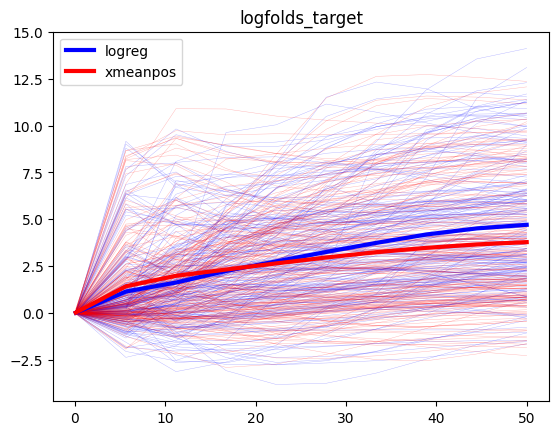

In [ ]:
plot_c_scaling_compare(norms_logreg, abl_results_logreg,
                       norms_xmeanpos, abl_results_xmeanpos,
                       'logreg','xmeanpos','logfolds_target')

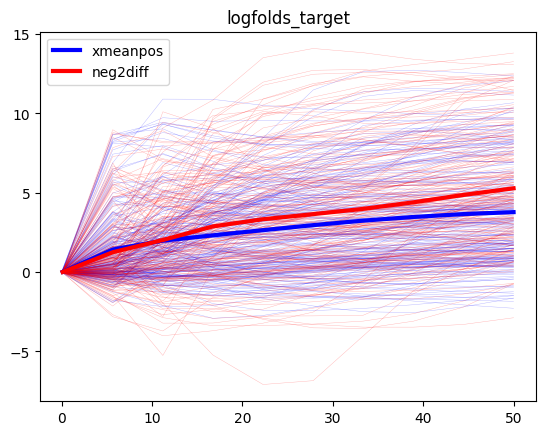

In [ ]:
plot_c_scaling_compare(norms_xmeanpos, abl_results_xmeanpos,
                       norms_neg2diff, abl_results_neg2diff,
                       'xmeanpos','neg2diff','logfolds_target')

x_mean_pos


100%|██████████| 10/10 [00:20<00:00,  2.06s/it]


logreg
Probes Already exists, loading


100%|██████████| 10/10 [00:21<00:00,  2.10s/it]


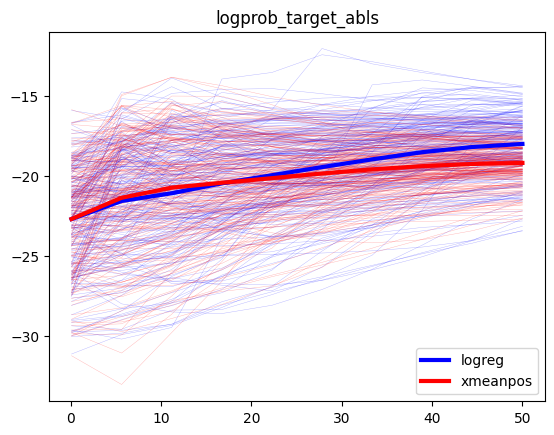

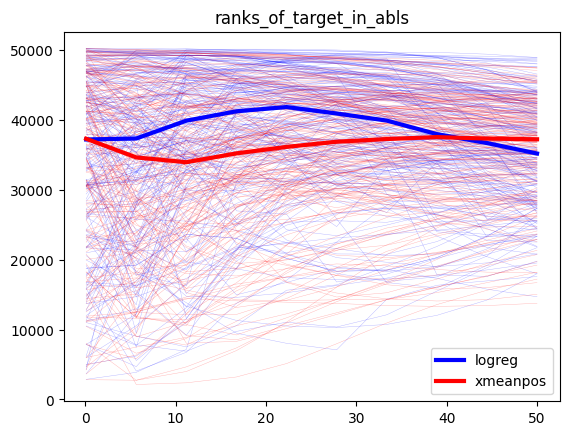

In [ ]:
norms_xmeanpos, abl_results_xmeanpos = run_norm_scaling(dset_dict,
                                                     get_ablation_vector(dset_dict,
                                                                         'x_mean_pos',
                                                                         hook_name,
                                                                         normalize=use_normalization),
                                                     hook_name,
                                                     empirical_next_token,
                                                     'addition')

norms_logreg, abl_results_logreg = run_norm_scaling(dset_dict,
                                                     get_ablation_vector(dset_dict,
                                                                         'logreg',
                                                                         hook_name,
                                                                         normalize=use_normalization),
                                                     hook_name,
                                                     empirical_next_token,
                                                     'addition')
plot_c_scaling_compare(norms_logreg, abl_results_logreg,
                       norms_xmeanpos, abl_results_xmeanpos,
                       'logreg','xmeanpos','logprob_target_abls')
plot_c_scaling_compare(norms_logreg, abl_results_logreg,
                       norms_xmeanpos, abl_results_xmeanpos,
                       'logreg','xmeanpos','ranks_of_target_in_abls',agg='median')

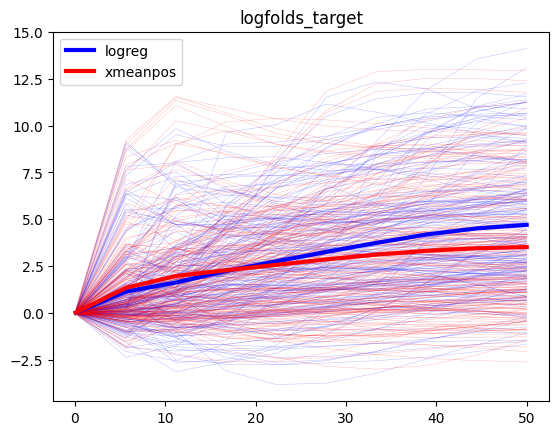

In [ ]:
plot_c_scaling_compare(norms_logreg, abl_results_logreg,
                       norms_xmeanpos, abl_results_xmeanpos,
                       'logreg','xmeanpos','logfolds_target')

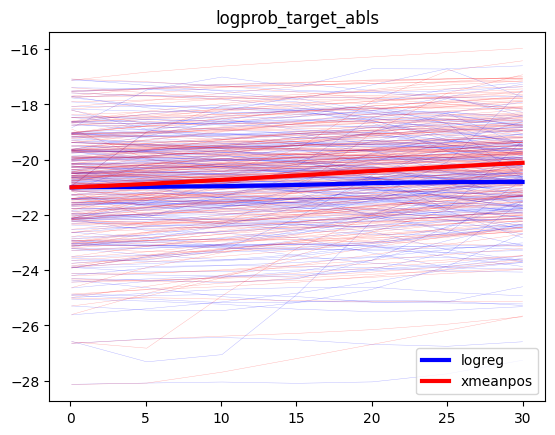

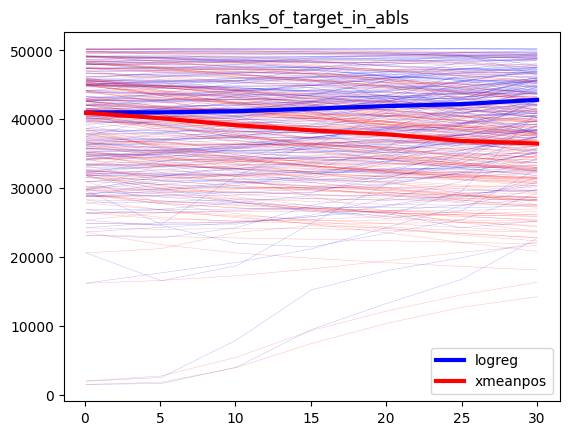

In [ ]:
plot_c_scaling_compare(norms_logreg, abl_results_logreg,
                       norms_xmeanpos, abl_results_xmeanpos,
                       'logreg','xmeanpos','logprob_target_abls')
plot_c_scaling_compare(norms_logreg, abl_results_logreg,
                       norms_xmeanpos, abl_results_xmeanpos,
                       'logreg','xmeanpos','ranks_of_target_in_abls',agg='median')

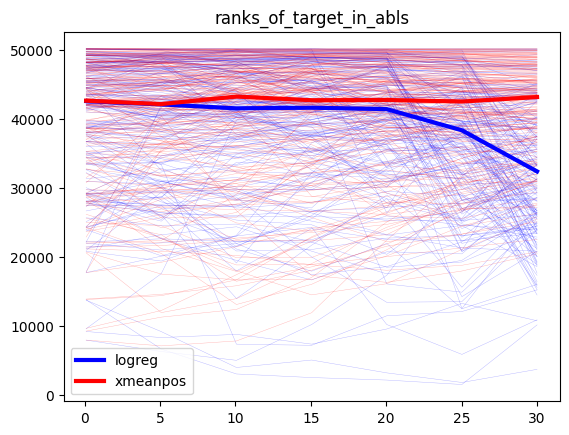

In [ ]:
#plot_c_scaling(norms_logreg, abl_results_logreg)

In [ ]:
#plot_c_scaling(norms_xmeanpos, abl_results_xmeanpos)

x_mean_pos


100%|██████████| 7/7 [00:14<00:00,  2.03s/it]


logreg
Probes Already exists, loading


100%|██████████| 7/7 [00:14<00:00,  2.05s/it]


In [ ]:
norms_xmeanpos, abl_results_xmeanpos = run_norm_scaling(dset_dict,
                                                     get_ablation_vector(dset_dict,
                                                                         'x_mean_pos',
                                                                         hook_name),
                                                     hook_name,
                                                     empirical_next_token,
                                                     'addition')
plot_c_scaling(abl_results_xmeanpos,norms_xmeanpos)

In [ ]:
logfolds_xmeanpos.shape

torch.Size([200, 10])

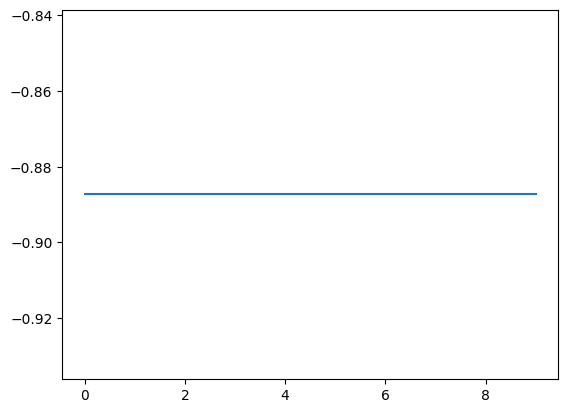

In [ ]:
plt.plot(logfolds_xmeanpos[0].cpu())

In [ ]:
norms_xmeanpos.shape

torch.Size([10])

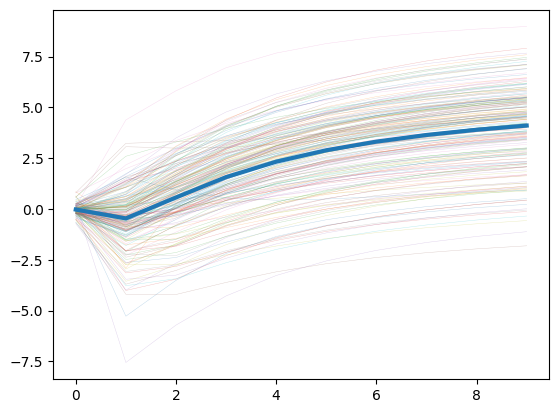

In [ ]:
for row in logfolds_cs:
  plt.plot(row.cpu(),linewidth=0.3,alpha=0.3)
plt.plot(logfolds_cs.mean(dim=0).cpu(),linewidth=3)

In [ ]:
logits_cleans.shape

torch.Size([200, 50304])

(array([26., 81., 45., 24., 11.,  2.,  2.,  2.,  3.,  4.]),
 array([-1.03749657,  0.30688019,  1.65125694,  2.9956337 ,  4.34001045,
         5.68438721,  7.02876396,  8.37314072,  9.71751747, 11.06189423,
        12.40627098]),
 <BarContainer object of 10 artists>)

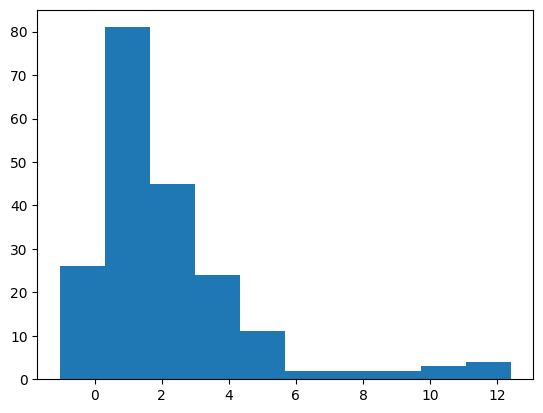

In [ ]:
plt.hist(pd.DataFrame(abl_results)['l_delta_logsoft'])

In [ ]:
ablation_vector = get_ablation_vector(dset_dict, ablation_vector_type, hook_name)

abl_results = run_ablation_on_all_vneg2s(
    dset_dict = dset_dict,
    target_token = empirical_next_token,
    hook_name = hook_name,
    ablation_vector = ablation_vector,
    ablation_function_name = ablation_function_name
)


x_mean_pos


  4%|▎         | 7/200 [00:04<02:14,  1.43it/s]


KeyboardInterrupt: ignored

In [ ]:
norm_list = []
for c in torch.linspace(0.1,10,30):
  print('c', c)
  global_add_vector = c * shortie_vec #xposmean_xlr_norm #x
  ablation_type_used = 'addition'
  ablation_vector_used = 'xlr'
  abl_vector_norm = torch.norm(global_add_vector,dim=-1)
  print('abl vector norm', abl_vector_norm)
  elems = []
  for vneg_id in tqdm(range(len(vneg2_idx))):
    elem = run_ablation_on_vnegid(vneg_id,vneg2_idx,ablation_type_used)
    elems.append(elem)
  df = pd.DataFrame(elems)
  mean_delta_pi = torch.tensor(df['l_delta_logsoft']).mean()
  median_delta_rho = torch.tensor(df['rho_delta']).median()
  print(mean_delta_pi, median_delta_rho)
  norm_elem = {
      'c': c.item(),
      'norm': abl_vector_norm.item(),
      'df': df,
      'delta_pi': mean_delta_pi.item(),
      'delta_rho': median_delta_rho.item()
  }
  norm_list.append(norm_elem)

c tensor(0.1000)
abl vector norm tensor(1.3734, device='cuda:0')


100%|██████████| 200/200 [00:28<00:00,  7.11it/s]


tensor(0.0558, dtype=torch.float64) tensor(-2)
c tensor(0.4414)
abl vector norm tensor(6.0620, device='cuda:0')


100%|██████████| 200/200 [00:27<00:00,  7.30it/s]


tensor(0.5076, dtype=torch.float64) tensor(-20)
c tensor(0.7828)
abl vector norm tensor(10.7507, device='cuda:0')


100%|██████████| 200/200 [00:27<00:00,  7.35it/s]


tensor(1.1325, dtype=torch.float64) tensor(-81)
c tensor(1.1241)
abl vector norm tensor(15.4393, device='cuda:0')


100%|██████████| 200/200 [00:27<00:00,  7.37it/s]


tensor(1.7881, dtype=torch.float64) tensor(-170)
c tensor(1.4655)
abl vector norm tensor(20.1279, device='cuda:0')


100%|██████████| 200/200 [00:27<00:00,  7.32it/s]


tensor(2.3838, dtype=torch.float64) tensor(-246)
c tensor(1.8069)
abl vector norm tensor(24.8165, device='cuda:0')


100%|██████████| 200/200 [00:27<00:00,  7.38it/s]


tensor(2.9205, dtype=torch.float64) tensor(-306)
c tensor(2.1483)
abl vector norm tensor(29.5051, device='cuda:0')


100%|██████████| 200/200 [00:27<00:00,  7.40it/s]


tensor(3.4589, dtype=torch.float64) tensor(-407)
c tensor(2.4897)
abl vector norm tensor(34.1937, device='cuda:0')


100%|██████████| 200/200 [00:27<00:00,  7.31it/s]


tensor(4.0782, dtype=torch.float64) tensor(-578)
c tensor(2.8310)
abl vector norm tensor(38.8823, device='cuda:0')


100%|██████████| 200/200 [00:27<00:00,  7.37it/s]


tensor(4.7936, dtype=torch.float64) tensor(-725)
c tensor(3.1724)
abl vector norm tensor(43.5709, device='cuda:0')


100%|██████████| 200/200 [00:27<00:00,  7.30it/s]


tensor(5.4008, dtype=torch.float64) tensor(-903)
c tensor(3.5138)
abl vector norm tensor(48.2595, device='cuda:0')


100%|██████████| 200/200 [00:27<00:00,  7.38it/s]


tensor(5.6439, dtype=torch.float64) tensor(-901)
c tensor(3.8552)
abl vector norm tensor(52.9481, device='cuda:0')


100%|██████████| 200/200 [00:27<00:00,  7.33it/s]


tensor(5.6011, dtype=torch.float64) tensor(-889)
c tensor(4.1966)
abl vector norm tensor(57.6368, device='cuda:0')


 52%|█████▏    | 103/200 [00:14<00:13,  7.28it/s]


KeyboardInterrupt: ignored

In [ ]:
norm_df_neg2_target2_addition_shwty = pd.DataFrame(norm_list)

In [ ]:
norm_df_neg1_target2_addition_shwty = pd.DataFrame(norm_list)

In [ ]:
#norm_df_neg1_target2_addition_xlr = pd.DataFrame(norm_list)

In [ ]:
#norm_df_neg1_target2_addition = pd.DataFrame(norm_list)

In [ ]:
def double_plot(x,y1,y2,label_y1,label_y2,xlabel,title):
  # Create the figure and the first axis
  fig, ax1 = plt.subplots()

  # Plot the data on the first axis
  ax1.plot(x, y1, 'b-', label='y1 (sin)')
  ax1.set_xlabel(xlabel)
  ax1.set_ylabel(label_y1, color='b')
  ax1.tick_params(axis='y', labelcolor='b')

  # Create the second axis
  ax2 = ax1.twinx()

  # Plot the data on the second axis
  ax2.plot(x, y2, 'r-', label='y2 (100*cos)')
  ax2.set_ylabel(label_y2, color='r')
  ax2.tick_params(axis='y', labelcolor='r')
  plt.title(title)
  # Show the plot
  plt.show()

In [ ]:
def double_plot_twice(x,y1a,y1b,y2a,y2b,label_y1,label_y2,xlabel,title):
  # Create the figure and the first axis
  fig, ax1 = plt.subplots()

  # Plot the data on the first axis
  ax1.plot(x, y1a, 'b-',label='xposmean')
  ax1.plot(x, y1b, 'g-',label='logreg')
  ax1.set_xlabel(xlabel)
  ax1.set_ylabel(label_y1, color='g')
  ax1.tick_params(axis='y', labelcolor='g')
  ax1.legend()
  # Create the second axis
  ax2 = ax1.twinx()

  # Plot the data on the second axis
  ax2.plot(x, y2a, 'r-')
  ax2.plot(x, y2b, 'r-')
  ax2.set_ylabel(label_y2, color='r')
  ax2.tick_params(axis='y', labelcolor='r')
  plt.title(title)
  # Show the plot
  plt.show()

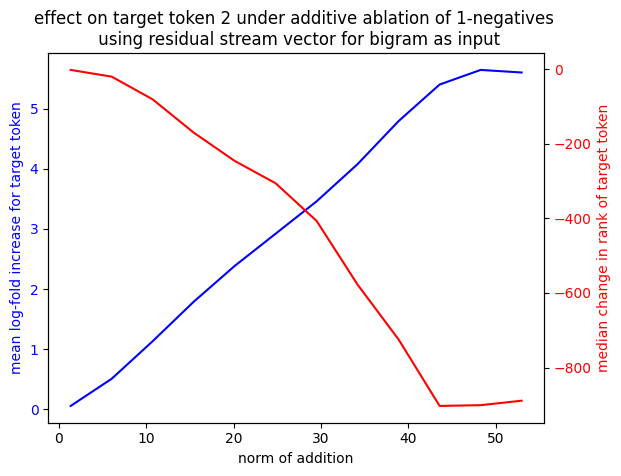

In [ ]:
double_plot(
    norm_df_neg2_target2_addition_shwty['norm'],
    norm_df_neg2_target2_addition_shwty['delta_pi'],
    norm_df_neg2_target2_addition_shwty['delta_rho'],
    label_y1 = 'mean log-fold increase for target token',
    label_y2 = 'median change in rank of target token',
    title = 'effect on target token 2 under additive ablation of 1-negatives \n using residual stream vector for bigram as input',
    xlabel = 'norm of addition'
)

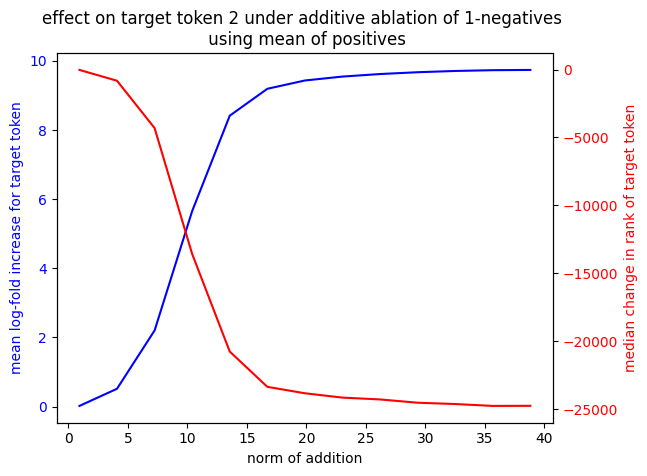

In [ ]:
double_plot(
    norm_df_neg1_target2_addition['norm'],
    norm_df_neg1_target2_addition['delta_pi'],
    norm_df_neg1_target2_addition['delta_rho'],
    label_y1 = 'mean log-fold increase for target token',
    label_y2 = 'median change in rank of target token',
    title = 'effect on target token 2 under additive ablation of 1-negatives \n using mean of positives',
    xlabel = 'norm of addition'
)

In [ ]:
norm_df_target2_addition = pd.DataFrame(norm_list)

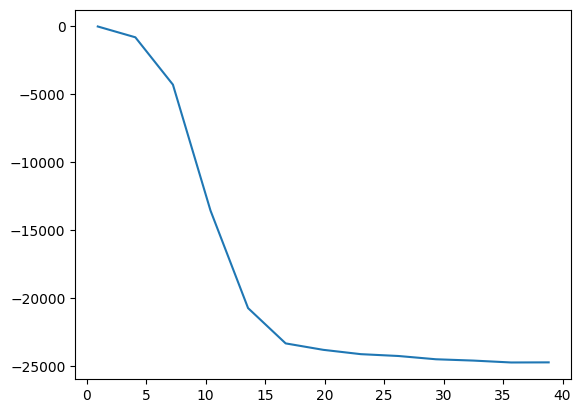

In [ ]:
plt.plot(norm_df_neg1_target2_addition['norm'], norm_df_neg1_target2_addition['delta_rho'],label='mean of pos. addition')

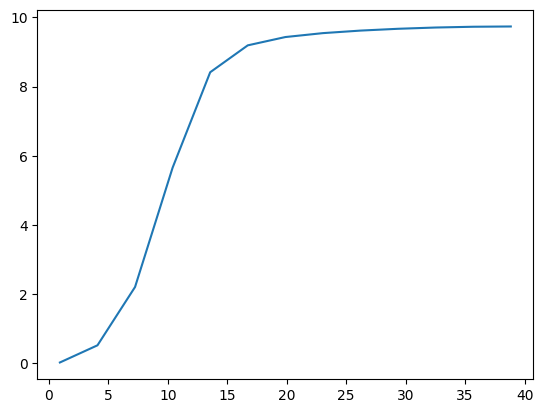

In [ ]:
plt.plot(norm_df_neg1_target2_addition['norm'], norm_df_neg1_target2_addition['delta_pi'],label='mean of pos. addition')

In [ ]:
#norm_df_xlr = norm_df.copy()

In [ ]:
#norm_df_xpm = pd.DataFrame(norm_list)

In [ ]:
#norm_df_replace = pd.DataFrame(norm_list)

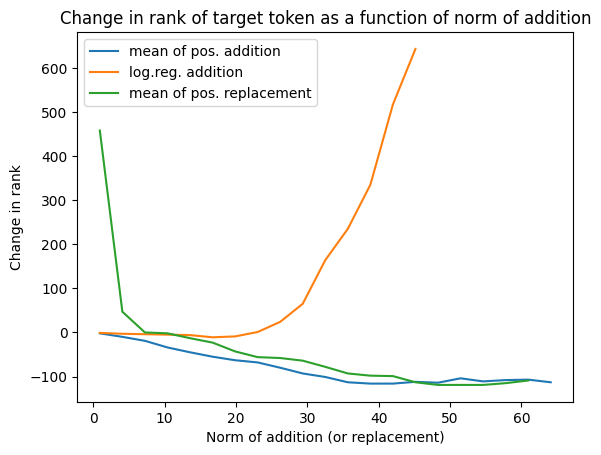

In [ ]:
plt.plot(norm_df_xpm['norm'], norm_df_xpm['delta_rho'],label='mean of pos. addition')
plt.plot(norm_df_xlr['norm'], norm_df_xlr['delta_rho'],label='log.reg. addition')
plt.plot(norm_df_replace['norm'], norm_df_replace['delta_rho'],label='mean of pos. replacement')
plt.title('Change in rank of target token as a function of norm of addition')
plt.xlabel('Norm of addition (or replacement)')
plt.ylabel('Change in rank')
plt.legend()

Text(0.5, 1.0, 'Increase in logsoftmax of target token as a function of norm of addition')

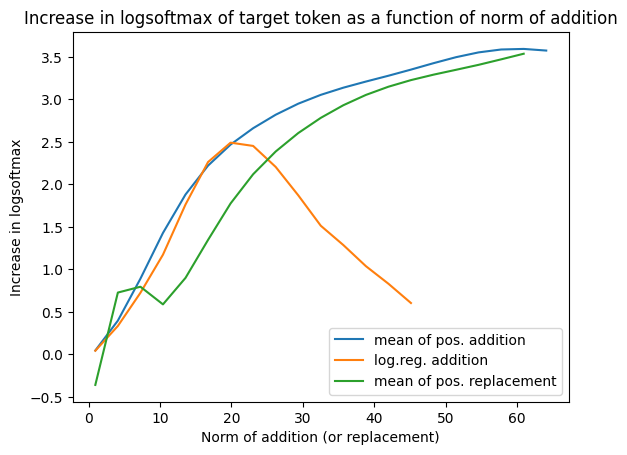

In [ ]:
#plt.plot(norm_df['norm'], norm_df['delta_rho'])

plt.plot(norm_df_xpm['norm'], norm_df_xpm['delta_pi'],label='mean of pos. addition')
plt.plot(norm_df_xlr['norm'], norm_df_xlr['delta_pi'],label='log.reg. addition')
plt.plot(norm_df_replace['norm'], norm_df_replace['delta_pi'],label='mean of pos. replacement')
plt.xlabel('Norm of addition (or replacement)')
plt.ylabel('Increase in logsoftmax')
plt.legend()
plt.title('Increase in logsoftmax of target token as a function of norm of addition')

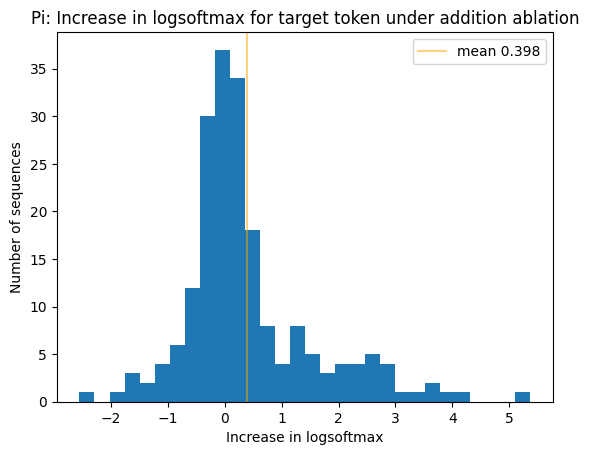

In [ ]:
_ = plt.hist(torch.tensor(df['l_delta_logsoft']),bins=30)
l_delta_logsoft_mean = torch.tensor(df['l_delta_logsoft']).mean()
plt.axvline(x=l_delta_logsoft_mean, label=f'mean {round(l_delta_logsoft_mean.item(),3)}',alpha=0.5,color='orange')
plt.title(f'Pi: Increase in logsoftmax for target token under {ablation_type_used} ablation')
plt.xlabel('Increase in logsoftmax')
plt.ylabel('Number of sequences')
plt.legend()

In [ ]:
df['l_delta_logsoft'].mean(), df['l_delta_logsoft'].median()

(0.9970164953544736, 0.3649718761444092)

In [ ]:
(torch.tensor(df['l_delta_logsoft']) < 0).float().mean(), (torch.tensor(df['l_delta_logsoft']) > 0.1).float().mean(), (torch.tensor(df['l_delta_logsoft']) == 0).float().mean()

(tensor(0.3950), tensor(0.5650), tensor(0.))

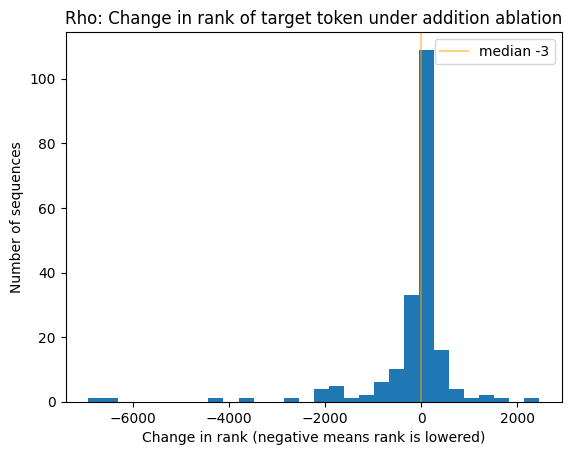

In [ ]:
_ = plt.hist(torch.tensor(df['rho_delta']),bins=30)
rho_delta_median = torch.tensor(df['rho_delta']).median()
plt.axvline(x=l_delta_logsoft_mean, label=f'median {round(rho_delta_median.item(),3)}',alpha=0.5,color='orange')
plt.title(f'Rho: Change in rank of target token under {ablation_type_used} ablation')
plt.xlabel('Change in rank (negative means rank is lowered)')
plt.ylabel('Number of sequences')
plt.legend()

In [ ]:
(torch.tensor(df['rho_delta']) < 0).float().mean()

tensor(0.4950)

In [ ]:
(torch.tensor(df['rho_delta']) > 0).float().mean()

tensor(0.4700)

In [ ]:
(torch.tensor(df['rho_delta']) == 0).float().mean()

tensor(0.0350)

In [ ]:
from scipy.stats import ttest_rel

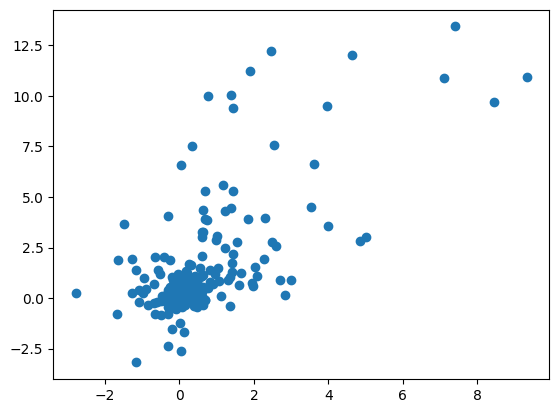

In [ ]:
plt.scatter(df_replacement['l_delta_logsoft'].to_numpy(), df['l_delta_logsoft'].to_numpy())

In [ ]:
ttest_rel(df['l_delta_logsoft'].to_numpy(), df_replacement['l_delta_logsoft'].to_numpy())

TtestResult(statistic=6.031906510352662, pvalue=7.769352828069608e-09, df=199)

In [ ]:
from scipy.stats import wilcoxon

In [ ]:
wilcoxon(df['l_delta_logsoft'].to_numpy(), df_replacement['l_delta_logsoft'].to_numpy())

WilcoxonResult(statistic=5245.0, pvalue=4.548006080094042e-09)

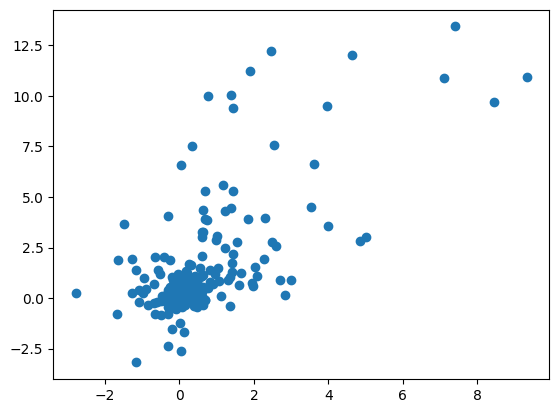

In [ ]:
plt.scatter(df_replacement['l_delta_logsoft'].to_numpy(), df['l_delta_logsoft'].to_numpy())

In [ ]:
df_additive

,l_clean,l_abl,l_clean_logsoft,l_abl_logsoft,l_delta,l_delta_logsoft,rho_clean,rho_abl,rho_delta
0,13.951200,12.914551,-4.152494,-4.545945,-1.036649,-0.393451,6,18,12
1,13.082892,12.306679,-11.428550,-9.513215,-0.776214,1.915335,76,48,-28
2,5.610219,7.542727,-22.271914,-20.412291,1.932508,1.859623,723,436,-287
3,8.940001,9.092816,-9.316885,-9.417130,0.152816,-0.100245,534,436,-98
4,10.641890,8.199698,-7.310805,-10.495117,-2.442191,-3.184312,238,823,585
...,...,...,...,...,...,...,...,...,...
195,5.360487,12.596432,-24.523891,-13.611146,7.235945,10.912745,2353,40,-2313
196,17.143602,17.251337,-3.941424,-2.454492,0.107735,1.486932,2,1,-1
197,12.532084,12.463402,-5.455750,-5.591239,-0.068683,-0.135489,36,45,9
198,11.922115,11.895510,-5.228206,-5.284594,-0.026606,-0.056387,21,25,4


In [ ]:
df_rotational = df.copy()

In [ ]:
#df_additive = df.copy()

In [ ]:
#df_replacement_neg2 = df.copy()

In [ ]:
#df_replacement = df.copy()

In [ ]:
#pirho(logits_val_neg2_seq_clean[0,-1],type_id_text) #pirho(logits_val_neg2_seq_clean[0,-1],pos_nexts[1])

(15.24316, 6)

blocks.1.hook_resid_pre torch.Size([1, 24, 1024])
tensor(21.3468, device='cuda:0') tensor(11.0025, device='cuda:0')


In [ ]:
pirho(logits_val_neg2_seq_additive[0,-1],type_id_text)

(15.41165, 3)

(0.16849, -3)

# Zooming in - hyperlong

In [ ]:
logsoft = nn.LogSoftmax(dim=-1)

In [ ]:
c = 1.

In [ ]:
global_c = None

In [ ]:
def hyperscaler_hook_fc(value, hook):
  global global_c
  #print('hyperscaler', global_c)
  value[:,-1] *= global_c

In [ ]:
input_seq = torch.tensor([0,1511, 568]) #tensor([1511,  568]) ' type="'

In [ ]:
def get_hlt(input_seq, cs, layer):
  with torch.no_grad():
    logits_c1 = model.run_with_hooks(
        input_seq,
        prepend_bos=False,
        return_type="logits",
        fwd_hooks=[],
        stop_at_layer=None
    )

  hyperlong_dict = {}
  for c in tqdm(cs):
    #print(c)
    global global_c
    global_c = c
    with torch.no_grad():
      logits = model.run_with_hooks(
          input_seq,
          prepend_bos=False,
          return_type="logits",
          fwd_hooks=[(f'blocks.{layer}.hook_resid_pre',hyperscaler_hook_fc)],
          stop_at_layer=None
      )[0,-1]
    hyperlong_dict[c] = logits
  hlt = torch.stack([val for key,val in hyperlong_dict.items()])
  return hlt, logits_c1

In [ ]:
cs = torch.linspace(1,60,100)
hlt_bos, logits_c1_bos = get_hlt(torch.tensor([0,1511, 568]), cs, layer=0)
hlt_nobos, logits_c1_nobos = get_hlt(torch.tensor([1511, 568]), cs, layer=0)

100%|██████████| 100/100 [00:59<00:00,  1.68it/s]


In [ ]:
hlp_bos = logsoft(hlt_bos)
hlp_nobos = logsoft(hlt_nobos)

In [ ]:
hlp_bos.shape

torch.Size([100, 50304])

In [ ]:
hlf0_bos = hlp_bos - hlp_bos[0]
hlf0_nobos = hlp_nobos - hlp_nobos[0]

In [ ]:
hlt_top_bos = torch.topk(hlp_bos,dim=-1,k=3)
hlt_top_nobos = torch.topk(hlp_nobos,dim=-1,k=3)

In [ ]:
hlp_bos.shape

torch.Size([100, 50304])

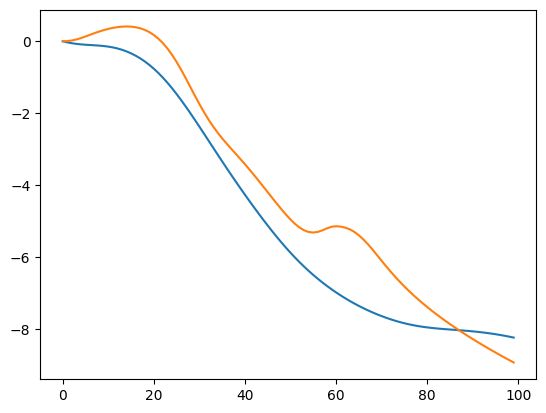

In [ ]:
plt.plot(hlf0_nobos[:,1156])
plt.plot(hlf0_bos[:,1156])

In [ ]:
def print_hlf0(hlf0, hlt_top): #[ 1156,  8060, 21399] +
  for typ in hlt_top.indices.unique().tolist(): #
    plt.plot(hlf0[:,typ], label=tokenizer.decode((typ)))
  plt.legend()
  plt.title('Log-fold compared to non-scaled for top-tokens across different norms')
  plt.xlabel('Scaling constant c')
  plt.ylabel('log-fold')
  plt.show()
def print_hlp(hlp, hlt_top):
  for typ in hlt_top.indices.unique().tolist():
    plt.plot(hlp[:,typ], label=tokenizer.decode((typ)))
  plt.legend()
  plt.title('Log-prob for top-tokens across different norms')
  plt.xlabel('Scaling constant c')
  plt.ylabel('log-prob')
  plt.show()

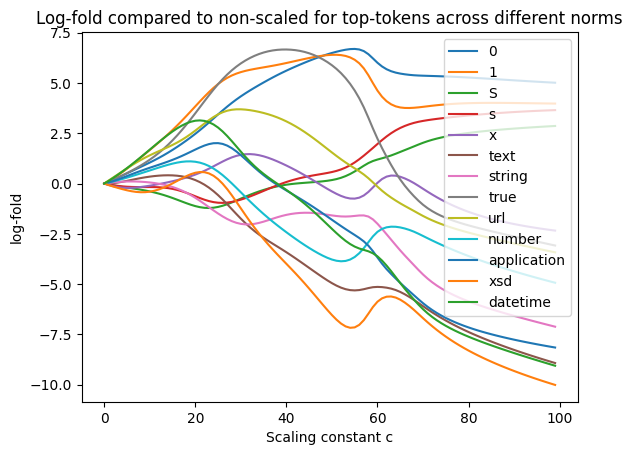

In [ ]:
print_hlf0(hlf0_bos, hlt_top_bos)

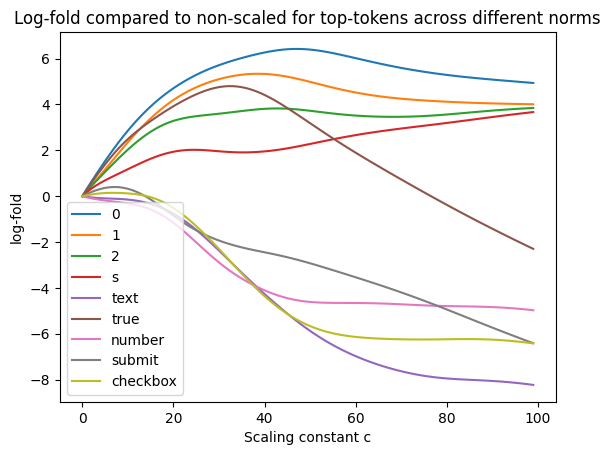

In [ ]:
print_hlf0(hlf0_nobos, hlt_top_nobos)

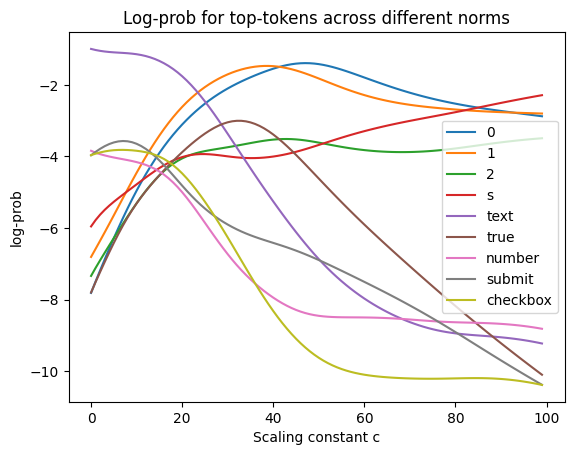

In [ ]:
print_hlp(hlp_nobos, hlt_top_nobos)

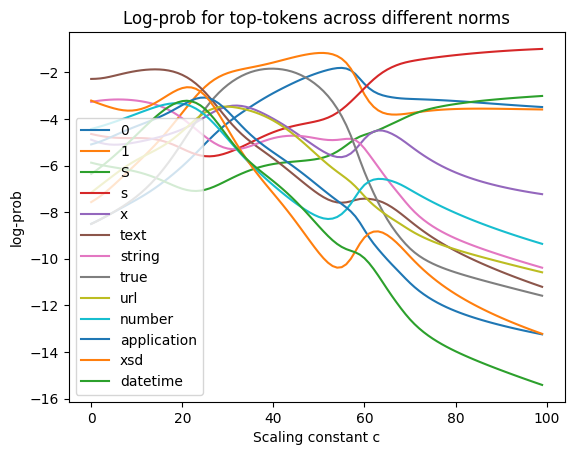

In [ ]:
print_hlp(hlp_bos, hlt_top_bos)

Text(0, 0.5, 'Log-prob')

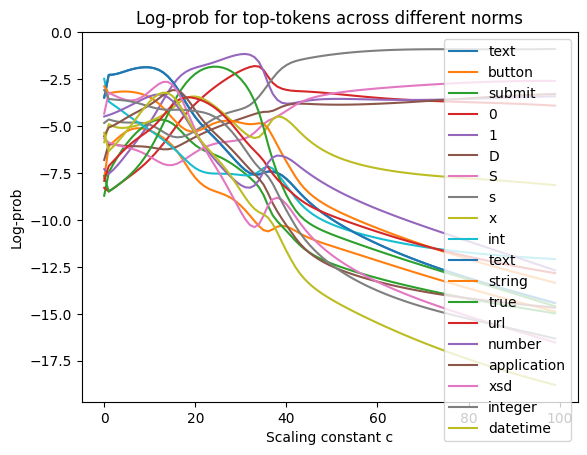

In [ ]:
for typ in [ 1156,  8060, 21399] + hlt_top.indices.unique().tolist():
  plt.plot(Hlp[:,typ], label=tokenizer.decode((typ)))
plt.legend()
plt.title('Log-prob for top-tokens across different norms')
plt.xlabel('Scaling constant c')
plt.ylabel('Log-prob')

In [ ]:
for i, (c, (top, values)) in enumerate(zip(cs, zip(hlt_top.indices, hlt_top.values))):
  print(c)
  print(" ".join([tokenizer.decode((tok)) for tok in top]))
  print(values)
  print(hlt[i][top])
  print(Hlf[i][top])

tensor(0.1000)
fig supplementary ref table sec media fn disp figure scheme
tensor([18.1620, 15.9478, 15.6043, 15.1656, 14.9554, 14.6156, 14.3640, 13.7982,
        13.3125, 12.8099])
tensor([18.1620, 15.9478, 15.6043, 15.1656, 14.9554, 14.6156, 14.3640, 13.7982,
        13.3125, 12.8099])
tensor([-0.4010, -0.2731,  1.0185,  1.5320, -0.1033,  0.7541, -0.4844,  0.3458,
        -1.0368, -1.5321])
tensor(1.1091)
fig table ref supplementary media sec disp fn bib other
tensor([18.2891, 17.2258, 17.1509, 16.2028, 15.8979, 15.3803, 14.6721, 14.4077,
        13.8625, 13.4717])
tensor([18.2891, 17.2258, 17.1509, 16.2028, 15.8979, 15.3803, 14.6721, 14.4077,
        13.8625, 13.4717])
tensor([ 0.0451,  0.0911, -0.1596, -0.1109, -0.1505, -0.1189,  0.0095, -0.2522,
         0.0419, -0.0888])
tensor(2.1182)
fig table ref supplementary media sec disp fn bib other
tensor([18.3607, 17.3434, 17.0178, 16.1183, 15.7739, 15.2879, 14.7080, 14.1820,
        13.9309, 13.4094])
tensor([18.3607, 17.3434, 17.0178,

IndexError: ignored

'fig table ref supplementary media sec disp fn bib other'

In [ ]:
topk = torch.topk(logits,k=5)

In [ ]:
def print

In [ ]:
for tok, logit in zip(topk.indices,topk.values):
  print(tok.item(), tokenizer.decode((tok.item())), logit.item())

926 fig 18.283573150634766
2420 table 17.210960388183594
709 ref 17.165725708007812
6962 supplementary 16.213706970214844
8236 media 15.912922859191895


# Zooming in - on-distribution precision

In [ ]:
len(TL)

322773

In [ ]:
TL.shape

torch.Size([322773, 600])

In [ ]:
ods_occs = generate_tensor(100, 0, TL.shape[0], 25, TL.shape[1]-10)

In [ ]:
#hook_names = ['blocks.2.hook_mlp_out', 'blocks.2.hook_resid_pre', 'blocks.3.hook_mlp_out', 'blocks.3.hook_resid_pre']

In [ ]:
#[#'blocks.1.hook_resid_pre', 'blocks.2.hook_resid_pre', 'blocks.3.hook_resid_pre', 'blocks.4.hook_resid_pre', 'blocks.5.hook_resid_pre']

# Fixed direction Gamma


In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim

# Define a custom PyTorch module for the logistic regression model with fixed w
class FixedDirectionLogReg(nn.Module):
    def __init__(self, w, a, b):
        super(FixedDirectionLogReg, self).__init__()
        self.a = nn.Parameter(torch.tensor(a.item()))  # Initialize as 1.0
        self.b = nn.Parameter(torch.tensor(b.item()))  # Initialize as 0.0
        self.w = w  # Fixed unit vector

    def forward(self, x):
        return self.a * torch.matmul(x, self.w) + self.b

# Function to train and evaluate the logistic regression model
def fixed_direction_logreg(X_train, y_train, X_val, y_val, w, a_true, b_true, n_iters=100, print_final=False):
    # Initialize model, loss and optimizer
    model = FixedDirectionLogReg(w, a_true, b_true)
    criterion = nn.BCEWithLogitsLoss()  # Binary Cross-Entropy loss with logits
    optimizer = optim.SGD(model.parameters(), lr=3e-4)

    val_pred_bin_prev = model(X_val) > 0
    f1_prev = 0.0
    early_stopped = False
    # Training loop
    for epoch in range(n_iters):
        optimizer.zero_grad()
        output = model(X_train)
        loss = criterion(output, y_train)
        #print(epoch, loss.item())
        #print('a', round(a_true.item(),3), round(model.a.item(),3))
        #print('b', round(b_true.item(),3), round(model.b.item(),3))
        loss.backward()
        optimizer.step()
        if epoch % 10 == 0:
          #print(y_val.shape, output.shape)
          val_pred_bin = (model(X_val)) > 0
          eval = get_metrics(y_val, val_pred_bin, print_stuff=False)
          if f1_prev > eval['f1']: #torch.allclose(val_pred_bin,val_pred_bin_prev):
            early_stopped = True
            get_metrics(y_val, val_pred_bin, print_stuff=print_final)
            break
          else:
            f1_prev = eval['f1']
            val_pred_bin_prev = val_pred_bin
    return model, eval

xhatpos = X_pos.mean(dim=0)

n_as = 100
n_bs = 100
a_starts = torch.linspace(-1,1,n_as)
b_starts = torch.linspace(-50,-35,n_bs)
f1s = torch.zeros(n_as,n_bs)
sensitivities = torch.zeros(n_as,n_bs)
specificities = torch.zeros(n_as,n_bs)
for i, a_start in tqdm(enumerate(a_starts)):
  for j, b_start in enumerate(b_starts):
    ab_classifier = FixedDirectionLogReg(xhatpos, a_start, b_start)
    all_pred_bin = (ab_classifier(X_all)) > 0
    eval = get_metrics(y_all, all_pred_bin, print_stuff=False)
    f1s[i,j] = eval['f1']
    sensitivities[i,j] = eval['sensitivity']
    specificities[i,j] = eval['specificity']

max_f1_indices = torch.argmax(f1s)
i_max, j_max = np.unravel_index(max_f1_indices, f1s.shape)

# Retrieve the corresponding a and b values
a_best = a_starts[i_max]
b_best = b_starts[j_max]

a_best, b_best

ab_classifier = FixedDirectionLogReg(xhatpos, a_best, b_best)
vall_pred_bin = (ab_classifier(vX_all)) > 0
get_metrics(vy_all, vall_pred_bin, print_stuff=False)

# Create the figure and the axis
fig, ax = plt.subplots(figsize=(10, 8))

# Display the heatmap
cax = ax.matshow(f1s, aspect='auto', extent=[b_starts[0], b_starts[-1], a_starts[-1], a_starts[0]])

# Remove margins
ax.margins(0,0)
plt.subplots_adjust(left=0, right=1, top=1, bottom=0)

# Add colorbar and labels
plt.colorbar(cax, label='F1 Score')
plt.title('F1 Score Heatmap')
plt.xlabel('b_starts')
plt.ylabel('a_starts')
plt.savefig('/content/drive/MyDrive/thesis/zoomin/plots/f1_train_heatmap.png',dpi=300)
# Show the plot
plt.show()

a_starts = torch.linspace(-20,20,50)
b_starts = torch.linspace(-20,20,40)
f1s = torch.zeros(50,40)
sensitivities = torch.zeros(50,40)
specificities = torch.zeros(50,40)
for i, a_start in tqdm(enumerate(a_starts)):
  for j, b_start in enumerate(b_starts):
    xlr_classifier, eval = fixed_direction_logreg(X_all, y_all, vX_all, vy_all, xhatpos, a_start, b_start, n_iters=100)
    f1s[i,j] = eval['f1']
    sensitivities[i,j] = eval['sensitivity']
    specificities[i,j] = eval['specificity']

NameError: ignored

# Offline Sklearn probes

## Metrics functions

# Overlap between similar probes

In [ ]:
assert False #dope_A, dope_B = (1935, 1983) #(1828, 2342), 961, 1600

In [ ]:
bigram_id_A, bigram_id_B = dope_bigram_ids[dope_A].item(), dope_bigram_ids[dope_B].item()

In [ ]:
print_bigram_id(bigram_id_A), print_bigram_id(bigram_id_B)

tensor([253, 353]) ' the M'
tensor([253, 367]) ' the P'


(None, None)

In [ ]:
batch_size = 100

In [ ]:
E_in = model.embed.W_E.detach()

In [ ]:
E_in.shape

torch.Size([50304, 1024])

In [ ]:
a

In [ ]:
scaling_list_nosub = []

for n_pos in range(100,900,100):
  print(n_pos)

  n_neg = 2 * n_pos

  k_similars = 20
  adv_theta = 0.0

  train_cat_A, train_labels_A, val_cat_A, val_labels_A, test_cat_A, test_labels_A = get_splits(bigram_id_A, occ_dicts_dict, precise_train_n=n_pos, neg_train_n=n_neg)
  train_cat_B, train_labels_B, val_cat_B, val_labels_B, test_cat_B, test_labels_B = get_splits(bigram_id_B, occ_dicts_dict, precise_train_n=n_pos, neg_train_n=n_neg)

  halfadv_train_dset_A = HalfAdversarialOccDataset(train_cat_A, train_labels_A, bigram_id_A, E_in, adv_theta=adv_theta, k_similars=k_similars)
  halfadv_val_dset_A = HalfAdversarialOccDataset(val_cat_A, val_labels_A, bigram_id_A, E_in, adv_theta=adv_theta, k_similars=k_similars, use_adv=False)
  halfadv_train_dset_B = HalfAdversarialOccDataset(train_cat_B, train_labels_B, bigram_id_B, E_in, adv_theta=adv_theta, k_similars=k_similars)
  halfadv_val_dset_B = HalfAdversarialOccDataset(val_cat_B, val_labels_B, bigram_id_B, E_in, adv_theta=adv_theta, k_similars=k_similars, use_adv=False)

  halfadv_train_loader_A = DataLoader(halfadv_train_dset_A, batch_size=batch_size, shuffle=False)
  halfadv_val_loader_A = DataLoader(halfadv_val_dset_A, batch_size=batch_size, shuffle=False)

  halfadv_train_loader_B = DataLoader(halfadv_train_dset_B, batch_size=batch_size, shuffle=False)
  halfadv_val_loader_B = DataLoader(halfadv_val_dset_B, batch_size=batch_size, shuffle=False)

  print('Getting vecs')
  stop_at_layer = 6
  halfadv_train_fixed_A, halfadv_train_fixed_labels_A = get_fixed_vector_dset_new(halfadv_train_loader_A, hook_names, model, stop_at_layer=stop_at_layer, use_tqdm=True)
  halfadv_val_fixed_A, halfadv_val_fixed_labels_A = get_fixed_vector_dset_new(halfadv_val_loader_A, hook_names, model, stop_at_layer=stop_at_layer, use_tqdm=True)

  halfadv_train_fixed_B, halfadv_train_fixed_labels_B = get_fixed_vector_dset_new(halfadv_train_loader_B, hook_names, model, stop_at_layer=stop_at_layer, use_tqdm=True)
  halfadv_val_fixed_B, halfadv_val_fixed_labels_B = get_fixed_vector_dset_new(halfadv_val_loader_B, hook_names, model, stop_at_layer=stop_at_layer, use_tqdm=True)

  #%%time
  print('Training')
  probes_A = {}
  probes_B = {}
  for hook_name in hook_names:
    halfadv_hook_probe_A = LogisticRegression(random_state=0, max_iter=10000).fit(halfadv_train_fixed_A[hook_name].cpu(), halfadv_train_fixed_labels_A[hook_name].cpu())
    halfadv_hook_probe_B = LogisticRegression(random_state=0, max_iter=10000).fit(halfadv_train_fixed_B[hook_name].cpu(), halfadv_train_fixed_labels_B[hook_name].cpu())
    probes_A[hook_name] = halfadv_hook_probe_A
    probes_B[hook_name] = halfadv_hook_probe_B

  aona = evaluate_probe(probes_A[hook_names[0]], hook_names[0], 'sk', halfadv_val_fixed_A, halfadv_val_fixed_labels_A, return_labels=False, print_stuff=False)
  bonb = evaluate_probe(probes_B[hook_names[0]], hook_names[0], 'sk', halfadv_val_fixed_B, halfadv_val_fixed_labels_B, return_labels=False, print_stuff=False)
  aonb = evaluate_probe(probes_A[hook_names[0]], hook_names[0], 'sk', halfadv_val_fixed_B, halfadv_val_fixed_labels_B, return_labels=False, print_stuff=False)
  bona = evaluate_probe(probes_B[hook_names[0]], hook_names[0], 'sk', halfadv_val_fixed_A, halfadv_val_fixed_labels_A, return_labels=False, print_stuff=False)

  A_coef0 = torch.tensor(probes_A[hook_names[0]].coef_).reshape(-1)
  B_coef0 = torch.tensor(probes_B[hook_names[0]].coef_).reshape(-1)
  absim = get_similarity_cross(A_coef0.reshape(1,-1), B_coef0.reshape(1,-1))[0,0].item()
  print('absim', n_pos, absim)
  n_pos_dict = {
      'n_pos': n_pos,
      'probes_A': probes_A,
      'probes_B': probes_B,
      'aona': aona,
      'bonb': bonb,
      'aonb': aonb,
      'bona': bona,
      'absim': absim
  }
  scaling_list_nosub.append(n_pos_dict)

100
Getting vecs


NameError: ignored

In [ ]:
n_poses = torch.arange(100,900,100)

In [ ]:
def plot_scaling_list(my_list):
  plt.plot(n_poses, [elem['absim'] for elem in my_list], label='absim')
  plt.plot(n_poses, [elem['aona']['f1'] for elem in my_list], label='aona f1')
  plt.plot(n_poses, [1 - elem['aonb']['sensitivity'] for elem in my_list], label='aonb sens')
  plt.plot(n_poses, [elem['aonb']['specificity'] for elem in my_list], label='aonb spec')
  plt.legend()
  plt.show()

In [ ]:
plot_scaling_list(scaling_list)
plot_scaling_list(scaling_list_nosub)

In [ ]:
plt.plot(n_poses, [elem['absim'] for elem in scaling_list], label='absim')
plt.plot(n_poses, [elem['aona']['f1'] for elem in scaling_list], label='aona f1')
plt.legend()

In [ ]:
scaling_list[0]['aona']['f1']

In [ ]:
get_similarity_cross(A_coef0.reshape(1,-1), B_coef0.reshape(1,-1))

In [ ]:
#torch.save((halfadv_train_fixed_A, halfadv_train_fixed_labels_A), '/content/drive/MyDrive/thesis/temp/halfadv_train_fixed_A_cpu.pt')
#halfadv_train_fixed_A, halfadv_train_fixed_labels_A = torch.load('/content/drive/MyDrive/thesis/temp/halfadv_train_fixed_A_cpu.pt')

In [ ]:
#halfadv_train_fixed_B, halfadv_train_fixed_labels_B = torch.load('/content/drive/MyDrive/thesis/temp/halfadv_train_fixed_B_cpu.pt')

In [ ]:
#torch.save((halfadv_val_fixed_A, halfadv_val_fixed_labels_A), '/content/drive/MyDrive/thesis/temp/halfadv_val_fixed_A_cpu.pt'B
#torch.save((halfadv_val_fixed_B, halfadv_val_fixed_labels_B), '/content/drive/MyDrive/thesis/temp/halfadv_val_fixed_B_cpu.pt')

In [ ]:
#torch.save((halfadv_train_fixed_B, halfadv_train_fixed_labels_B), '/content/drive/MyDrive/thesis/temp/halfadv_train_fixed_B_cpu.pt')
#halfadv_train_fixed_A_cpu = torch.load('/content/drive/MyDrive/thesis/temp/halfadv_train_fixed_A_cpu.pt')

In [ ]:
#resid_hook_names = [f'blocks.{i}.hook_resid_pre' for i in range(1,5)]

In [ ]:
get_similarity_matrix(torch.stack((torch.tensor(halfadv_hook_probe_A.coef_), torch.tensor(halfadv_hook_probe_B.coef_))).squeeze())

In [ ]:
_ = evaluate_probe(probes_A[hook_names[0]], hook_names[0], 'sk', halfadv_val_fixed_A, halfadv_val_fixed_labels_A, return_labels=True, print_stuff=True)

In [ ]:
_ = evaluate_probe(probes_B[hook_names[0]], hook_names[0], 'sk', halfadv_val_fixed_B, halfadv_val_fixed_labels_B, return_labels=True, print_stuff=True)

In [ ]:
_ = evaluate_probe(probes_A[hook_names[0]], hook_names[0], 'sk', halfadv_val_fixed_B, halfadv_val_fixed_labels_B, return_labels=True, print_stuff=True)

In [ ]:
_ = evaluate_probe(probes_B[hook_names[0]], hook_names[0], 'sk', halfadv_val_fixed_A, halfadv_val_fixed_labels_A, return_labels=True, print_stuff=True)

# actual training

In [ ]:
batch_size = 50

In [ ]:
def layernorm(X, divisor='std'):
  demeaned = (X.T - X.mean(dim=-1)).T
  divisor = X.std(dim=-1) if divisor=='std' else torch.norm(demeaned,dim=-1)
  hej = (demeaned.T / divisor).T
  return hej

In [ ]:
my_X = 7 * torch.randn(10,70) + 3

In [ ]:
my_X_ln = layernorm(my_X,divisor='l2')

In [ ]:
my_X_ln.mean(dim=-1)

tensor([-2.1287e-10, -8.5149e-10, -5.1090e-09, -5.1090e-09,  0.0000e+00,
         2.3416e-09, -1.7030e-09,  2.1287e-10, -1.7030e-09, -6.3862e-09])

In [ ]:
torch.norm(my_X_ln,dim=-1)

tensor([1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000])

In [ ]:
E_in = model.embed.W_E.detach()

In [ ]:
save_folder = '/content/drive/MyDrive/thesis/derived_data/probing/sk_ln_probes_322k'
for i in tqdm(range(0,len(dope_bigram_ids),1)):
  bigram_id_A = dope_bigram_ids[i].item()
  bigram_probe_path = join(save_folder, f'probes_and_preds_{bigram_id_A}_mod{model_size}.pkl')
  #if exists(bigram_probe_path):
  #  continue

  train_cat_A, train_labels_A, val_cat_A, val_labels_A, test_cat_A, test_labels_A = get_splits(bigram_id_A, occ_dicts_dict, precise_train_n=800, neg_train_n=1600)
  k_similars = 20
  adv_theta = 0.0
  halfadv_train_dset_A = HalfAdversarialOccDataset(train_cat_A, train_labels_A, bigram_id_A, E_in, adv_theta=adv_theta, k_similars=k_similars)
  halfadv_val_dset_A = HalfAdversarialOccDataset(val_cat_A, val_labels_A, bigram_id_A, E_in, adv_theta=adv_theta, k_similars=k_similars, use_adv=False)
  halfadv_train_loader_A = DataLoader(halfadv_train_dset_A, batch_size=batch_size, shuffle=False)
  halfadv_val_loader_A = DataLoader(halfadv_val_dset_A, batch_size=batch_size, shuffle=False)

  halfadv_train_fixed_A, halfadv_train_fixed_labels_A = get_fixed_vector_dset_new(halfadv_train_loader_A, hook_names, model, stop_at_layer=6,use_tqdm=True)
  halfadv_val_fixed_A, halfadv_val_fixed_labels_A = get_fixed_vector_dset_new(halfadv_val_loader_A, hook_names, model, stop_at_layer=6,use_tqdm=True)

  sk_hook_probes = {}
  for hook_name in hook_names:
    X_train = layernorm(halfadv_train_fixed_A[hook_name]) #layernorm(halfadv_train_fixed_A[hook_name]).cpu()
    X_val = layernorm(halfadv_val_fixed_A[hook_name])
    halfadv_hook_probe_A = LogisticRegression(random_state=0, max_iter=10000).fit(X_train.cpu(), halfadv_train_fixed_labels_A[hook_name].cpu())
    halfadv_on_nonadv_eval = evaluate_probe(halfadv_hook_probe_A, hook_name, 'sk', X_val.cpu(), halfadv_val_fixed_labels_A[hook_name], return_labels=True)
    print(halfadv_on_nonadv_eval)
    sk_hook_probes[hook_name] = {
        'probes': {
          'halfadv': halfadv_hook_probe_A,
        },
        'weights': {
          'coef': torch.tensor(halfadv_hook_probe_A.coef_).cpu(),
          'bias': torch.tensor(halfadv_hook_probe_A.intercept_).cpu()
        },
        'eval': {
            'halfadv_on_nonadv': halfadv_on_nonadv_eval,
        },
        'logits': {
            'halfadv_on_nonadv': get_logits_fixed(halfadv_hook_probe_A, halfadv_val_fixed_A, hook_name),
        }
    }
  break
  with open(bigram_probe_path, 'wb') as f:
    pickle.dump(sk_hook_probes, f)

  0%|          | 0/14557 [00:00<?, ?it/s]
0it [00:00, ?it/s]
1it [00:00,  2.68it/s]
2it [00:00,  3.07it/s]
3it [00:00,  3.29it/s]
4it [00:01,  3.59it/s]
5it [00:01,  3.96it/s]
6it [00:01,  4.26it/s]
7it [00:01,  4.17it/s]
8it [00:02,  4.17it/s]
9it [00:02,  4.87it/s]
10it [00:02,  5.55it/s]
11it [00:02,  5.08it/s]
12it [00:02,  5.82it/s]
13it [00:02,  5.65it/s]
14it [00:03,  6.01it/s]
15it [00:03,  6.44it/s]
16it [00:03,  6.75it/s]
17it [00:03,  7.17it/s]
18it [00:03,  6.93it/s]
19it [00:03,  7.23it/s]
20it [00:03,  7.21it/s]
21it [00:03,  7.36it/s]
22it [00:04,  7.46it/s]
23it [00:04,  7.43it/s]
24it [00:04,  7.96it/s]
26it [00:06,  1.60it/s]
27it [00:06,  2.01it/s]
29it [00:07,  3.08it/s]
31it [00:07,  4.31it/s]
33it [00:07,  5.63it/s]
35it [00:07,  6.95it/s]
37it [00:07,  8.27it/s]
39it [00:07,  9.46it/s]
41it [00:07, 10.43it/s]
43it [00:08, 11.23it/s]
45it [00:08, 11.91it/s]
47it [00:08, 12.42it/s]
49it [00:08, 12.62it/s]
51it [00:08, 12.76it/s]
53it [00:08, 12.76it/s]
55it [00:08,

({'f1': 0.97, 'accuracy': 0.988, 'sensitivity': tensor(0.9700), 'specificity': tensor(0.9925)}, tensor([1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
        1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
        1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
        1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
        1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
        1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 

  0%|          | 0/14557 [00:23<?, ?it/s]

({'f1': 1.0, 'accuracy': 1.0, 'sensitivity': tensor(1.), 'specificity': tensor(1.)}, tensor([1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
        1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
        1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
        1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
        1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
        1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0.,

In [ ]:
nonadv_train_loader = DataLoader(nonadv_train_dset, batch_size=batch_size, shuffle=False)
nonadv_val_loader = DataLoader(nonadv_val_dset, batch_size=batch_size, shuffle=False)
nonadv_train_fixed, nonadv_train_fixed_labels = get_fixed_vector_dset_new(nonadv_train_loader, hook_names, model, stop_at_layer=4)
nonadv_val_fixed, nonadv_val_fixed_labels = get_fixed_vector_dset_new(nonadv_val_loader, hook_names, model, stop_at_layer=4)

In [ ]:
A_path = join('/content/drive/MyDrive/thesis/derived_data/probing/sk_probes', f'probes_and_preds_{bigram_A}_mod{model_size}.pkl')

In [ ]:
B_path = join('/content/drive/MyDrive/thesis/derived_data/probing/sk_probes', f'probes_and_preds_{bigram_B}_mod{model_size}.pkl')

In [ ]:
nonadv_A_pkl = load_pkl(A_path)

In [ ]:
nonadv_B_pkl = load_pkl(B_path)

In [ ]:
nonadv_A_hook_probe = nonadv_A_pkl[hook_name]['probes']['nonadv']

In [ ]:
nonadv_B_hook_probe = nonadv_B_pkl[hook_name]['probes']['nonadv']

In [ ]:
get_similarity_matrix(torch.stack((torch.tensor(nonadv_A_hook_probe.coef_), torch.tensor(nonadv_B_hook_probe.coef_))).squeeze())

tensor([[1.0000, 0.6427],
        [0.6427, 1.0000]], dtype=torch.float64)

In [ ]:
nonadv_A_train_cat, nonadv_A_train_labels, nonadv_A_val_cat, nonadv_B_val_labels, test_cat, test_labels = get_splits(bigram_id, occ_dicts_dict) #1133
nonadv_train_loader = DataLoader(nonadv_train_dset, batch_size=batch_size, shuffle=False)
nonadv_val_loader = DataLoader(nonadv_val_dset, batch_size=batch_size, shuffle=False)
nonadv_train_fixed, nonadv_train_fixed_labels = get_fixed_vector_dset_new(nonadv_train_loader, hook_names, model, stop_at_layer=4)
nonadv_val_fixed, nonadv_val_fixed_labels = get_fixed_vector_dset_new(nonadv_val_loader, hook_names, model, stop_at_layer=4)

# Baseline: Average of positives

In [ ]:
dope_bigram_ids[1].item()

1

In [ ]:

batch_size = 200
bigram_id_A = 1 #dope_bigram_ids[i].item()

train_cat_A, train_labels_A, val_cat_A, val_labels_A, test_cat_A, test_labels_A = get_splits(bigram_id_A, occ_dicts_dict, precise_train_n=400, neg_train_n=800)
k_similars = 20
adv_theta = 0.0
halfadv_train_dset_A = HalfAdversarialOccDataset(train_cat_A, train_labels_A, bigram_id_A, E_in, adv_theta=adv_theta, k_similars=k_similars)
halfadv_val_dset_A = HalfAdversarialOccDataset(val_cat_A, val_labels_A, bigram_id_A, E_in, adv_theta=adv_theta, k_similars=k_similars, use_adv=False)
halfadv_train_loader_A = DataLoader(halfadv_train_dset_A, batch_size=batch_size, shuffle=False)
halfadv_val_loader_A = DataLoader(halfadv_val_dset_A, batch_size=batch_size, shuffle=False)

halfadv_train_fixed_A, halfadv_train_fixed_labels_A = get_fixed_vector_dset_new(halfadv_train_loader_A, hook_names, model, stop_at_layer=6, use_tqdm=True)
halfadv_val_fixed_A, halfadv_val_fixed_labels_A = get_fixed_vector_dset_new(halfadv_val_loader_A, hook_names, model, stop_at_layer=6, use_tqdm=True)


10it [00:06,  1.64it/s]
3it [00:00,  3.70it/s]


In [ ]:
halfadv_train_fixed_A[hook_names[0]].shape

torch.Size([2000, 1024])

In [ ]:
avg_dict = {hook_name : halfadv_train_fixed_A[hook_name][torch.argwhere(halfadv_train_fixed_labels_A[hook_name] == 1).reshape(-1)].mean(dim=0) for hook_name in hook_names}

In [ ]:
postives = halfadv_train_fixed_A[hook_names[0]][torch.argwhere(halfadv_train_fixed_labels_A[hook_names[0]] == 1).reshape(-1)]

KeyboardInterrupt: ignored

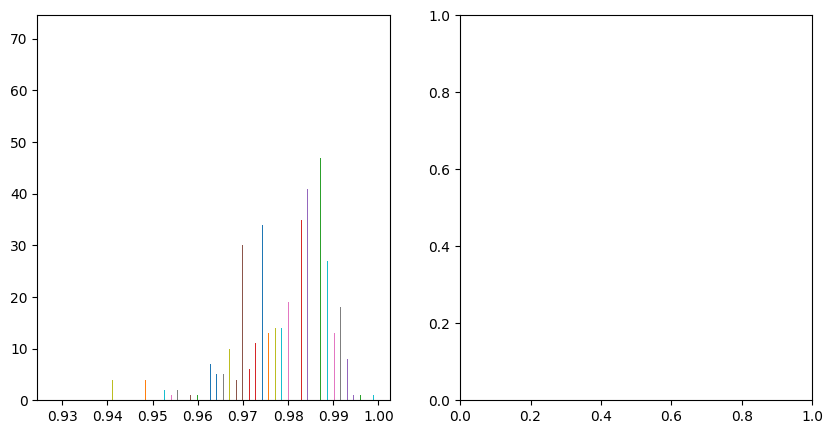

In [ ]:
hist_and_box(get_similarity_cross(postives, postives))

In [ ]:
get_similarity_cross(postives, avg_dict[hook_names[0]].reshape(1,-1))

tensor([[0.9938],
        [0.9872],
        [0.9936],
        [0.9950],
        [0.9937],
        [0.9825],
        [0.9769],
        [0.9890],
        [0.9864],
        [0.9930],
        [0.9886],
        [0.9947],
        [0.9869],
        [0.9908],
        [0.9910],
        [0.9841],
        [0.9968],
        [0.9885],
        [0.9855],
        [0.9913],
        [0.9886],
        [0.9897],
        [0.9939],
        [0.9953],
        [0.9895],
        [0.9954],
        [0.9824],
        [0.9518],
        [0.9906],
        [0.9925],
        [0.9816],
        [0.9920],
        [0.9923],
        [0.9954],
        [0.9883],
        [0.9939],
        [0.9799],
        [0.9916],
        [0.9649],
        [0.9920],
        [0.9911],
        [0.9719],
        [0.9932],
        [0.9922],
        [0.9910],
        [0.9933],
        [0.9952],
        [0.9897],
        [0.9927],
        [0.9887],
        [0.9870],
        [0.9919],
        [0.9821],
        [0.9933],
        [0.9924],
        [0

In [ ]:
get_similarity_cross(loaded_data[hook_names[0]]['weights']['coef'].float(), avg_dict[hook_names[0]].reshape(1,-1).cpu())

tensor([[0.0423]])

In [ ]:
halfadv_train_fixed_A[hook_names[0]].shape

torch.Size([2000, 1024])

In [ ]:
halfadv_train_fixed_A[hook_names[0]].mean(dim=0)

tensor([-0.0477,  0.1050,  0.0067,  ..., -0.1288,  0.0959, -0.0390],
       device='cuda:0')

In [ ]:
get_similarity_cross()

In [ ]:
def load_pkl(path):
  with open(path, 'rb') as file:
    # Load data from the file
    loaded_data = pickle.load(file)
  return loaded_data

In [ ]:
probes_path = join('/content/drive/MyDrive/thesis/derived_data/probing/sk_halfadv_probes_322k', f'probes_and_preds_{bigram_id_A}_mod{model_size}.pkl')

In [ ]:
probes_path

'/content/drive/MyDrive/thesis/derived_data/probing/sk_halfadv_probes_322k/probes_and_preds_1_mod410m.pkl'

In [ ]:
exists(probes_path)

True

In [ ]:
with open(probes_path, 'rb') as file:
  loaded_data = pickle.load(file)

In [ ]:
loaded_data[hook_names[0]]['probes']['halfadv'].predict(avg_dict[hook_names[0]].cpu().reshape(1,-1))

array([0.], dtype=float32)

In [ ]:
get_similarity_cross(loaded_data[hook_names[0]]['weights']['coef'].float(), avg_dict[hook_names[0]].reshape(1,-1).cpu().float())

tensor([[0.0066]])

In [ ]:
.shape

torch.Size([1, 1024])

In [ ]:
 #shape

torch.Size([1024])

# PCA approach

In [ ]:
bid = 10

In [ ]:
print_bigram_id(bid)

tensor([ 27, 187]) ':\n'


In [ ]:
q_dict[bid], repr(tokenizer.decode(q_dict[bid]))

([50266], "'            '")

In [ ]:
bigram_id_A = bid

In [ ]:
train_cat_A, train_labels_A, val_cat_A, val_labels_A, test_cat_A, test_labels_A = get_splits(bigram_id_A, occ_dicts_dict, precise_train_n=800, neg_train_n=1600)
k_similars = 20
adv_theta = 0.0
halfadv_train_dset_A = HalfAdversarialOccDataset(train_cat_A, train_labels_A, bigram_id_A, E_in, adv_theta=adv_theta, k_similars=k_similars)
halfadv_val_dset_A = HalfAdversarialOccDataset(val_cat_A, val_labels_A, bigram_id_A, E_in, adv_theta=adv_theta, k_similars=k_similars, use_adv=False)
halfadv_train_loader_A = DataLoader(halfadv_train_dset_A, batch_size=batch_size, shuffle=False)
halfadv_val_loader_A = DataLoader(halfadv_val_dset_A, batch_size=batch_size, shuffle=False)

halfadv_train_fixed_A, halfadv_train_fixed_labels_A = get_fixed_vector_dset_new(halfadv_train_loader_A, hook_names, model, stop_at_layer=6,use_tqdm=True)
halfadv_val_fixed_A, halfadv_val_fixed_labels_A = get_fixed_vector_dset_new(halfadv_val_loader_A, hook_names, model, stop_at_layer=6,use_tqdm=True)


80it [00:06, 11.82it/s]
10it [00:00, 14.49it/s]


In [ ]:
hook_name = hook_names[3]

In [ ]:
X_train = halfadv_train_fixed_A[hook_name] #layernorm(halfadv_train_fixed_A[hook_name]).cpu()
X_val = halfadv_val_fixed_A[hook_name]
halfadv_hook_probe_A = LogisticRegression(random_state=0, max_iter=10000).fit(X_train.cpu(), halfadv_train_fixed_labels_A[hook_name].cpu())
halfadv_on_nonadv_eval = evaluate_probe(halfadv_hook_probe_A, hook_name, 'sk', X_val.cpu(), halfadv_val_fixed_labels_A[hook_name], return_labels=True)


In [ ]:
dset_elem = halfadv_val_dset_A[1]
print(dset_elem)

(tensor([ 2656,   668,  1108,  2451,   562,   253,  1501,   275, 31523,  4163,
         4104,   187,   187,  3837, 23967,  3658,   187,   187, 18281,   436,
           27,   187]), tensor(1., dtype=torch.float64), tensor(1.))


In [ ]:
with torch.no_grad():
      out, cache = model.run_with_cache(dset_elem[0].reshape(1,-1))

In [ ]:
torch.argwhere(torch.sort(out[0,-1]).indices == 50266)

tensor([[48403]], device='cuda:0')

In [ ]:
torch.topk(out[0,-1],k=10)

torch.return_types.topk(
values=tensor([26.5235, 15.1369, 14.9597, 14.8649, 14.8268, 14.7271, 14.6955, 14.5767,
        14.5217, 14.4998], device='cuda:0'),
indices=tensor([  187,   605,     4,    38, 25116,    50,    18,    40,   510,  3122],
       device='cuda:0'))

In [ ]:
torch.topk(out[0,-1],k=10)

torch.return_types.topk(
values=tensor([14.8794, 14.6587, 14.3357, 13.8883, 13.7543, 13.7138, 13.6769, 13.5679,
        13.5006, 13.4517], device='cuda:0'),
indices=tensor([ 4387,  2948, 50274, 10708,     4,    29,  2437, 14277,  9486,   187],
       device='cuda:0'))

In [ ]:
X = halfadv_val_fixed_A[hook_name]

In [ ]:
X.shape

torch.Size([500, 1024])

In [ ]:
y = halfadv_val_fixed_labels_A[hook_name]

In [ ]:
X_pos = X[torch.argwhere(y == 1.).reshape(-1)]

In [ ]:
X_neg = X[torch.argwhere(y == 0.).reshape(-1)]

In [ ]:
X_neg.shape

torch.Size([400, 1024])

In [ ]:
X_pos.shape

torch.Size([100, 1024])

In [ ]:
bigram_dir = torch.tensor(halfadv_hook_probe_A.coef_).float()

In [ ]:
bigram_dir

tensor([[-0.0766, -0.1244,  0.1216,  ..., -0.0987,  0.2790, -0.0395]])

In [ ]:
l_pos = (X_pos.cpu() @ bigram_dir.reshape(-1)) #.shape
l_neg = (X_neg.cpu() @ bigram_dir.reshape(-1))

In [ ]:
l_pos.min()

tensor(14.8660)

In [ ]:
l_neg.max()

tensor(9.8399)

In [ ]:
X_diff = F.normalize(X_pos - X_neg[:100],dim=-1)
X_diff_pca = PCA().fit_transform(X_diff.cpu())

In [ ]:
from sklearn.decomposition import PCA

In [ ]:
X_pca = PCA().fit_transform(X.cpu())

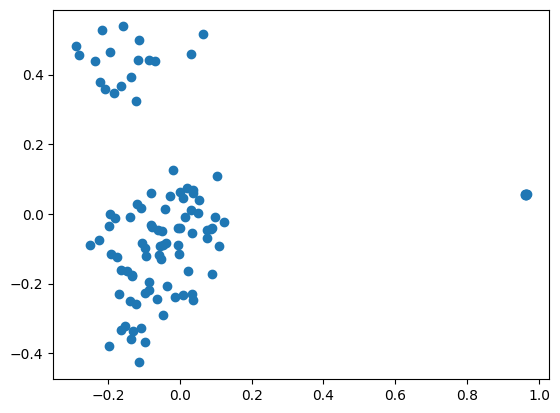

In [ ]:
plt.scatter(X_diff_pca[:,0], X_diff_pca[:,1])

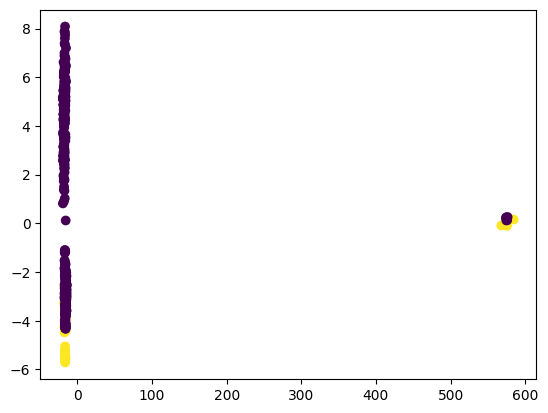

In [ ]:
plt.scatter(X_pca[:,0], X_pca[:,1], c=y)

In [ ]:
diff_pca = PCA().fit(X_diff.cpu())

In [ ]:
# Importing the PyTorch library
import torch

def find_first_principal_component(X):
    """
    Find the first principal component of a given NxD PyTorch tensor.

    Parameters:
    - X (torch.Tensor): An NxD tensor where N is the number of samples and D is the dimensionality.

    Returns:
    - torch.Tensor: The first principal component.
    """
    # Center the data by subtracting the mean along each dimension
    X_centered = X - torch.mean(X, dim=0)

    # Perform Singular Value Decomposition (SVD)
    _, _, V = torch.svd(X_centered)

    # The first principal component corresponds to the first column of V
    first_principal_component = V[:, 0]

    return first_principal_component

In [ ]:
pc1 = find_first_principal_component(X_diff)

In [ ]:
pc1.shape

torch.Size([1024])

In [ ]:
v_pos = (X_pos @ pc1) #.shape
v_neg = (X_neg @ pc1)

In [ ]:
v_pos.min(), v_pos.median(), v_pos.max()

(tensor(-1.3911, device='cuda:0'),
 tensor(1.0394, device='cuda:0'),
 tensor(516.7793, device='cuda:0'))

In [ ]:
v_neg.min(), v_neg.median(), v_neg.max()

(tensor(0.1580, device='cuda:0'),
 tensor(3.7056, device='cuda:0'),
 tensor(510.3590, device='cuda:0'))

(array([  6.,  20.,  81., 180., 218., 184.,  86.,  20.,   3.,   2.]),
 array([-3.06630945, -2.84184361, -2.61737776, -2.39291215, -2.1684463 ,
        -1.94398046, -1.71951473, -1.49504888, -1.27058315, -1.04611731,
        -0.82165152]),
 <BarContainer object of 10 artists>)

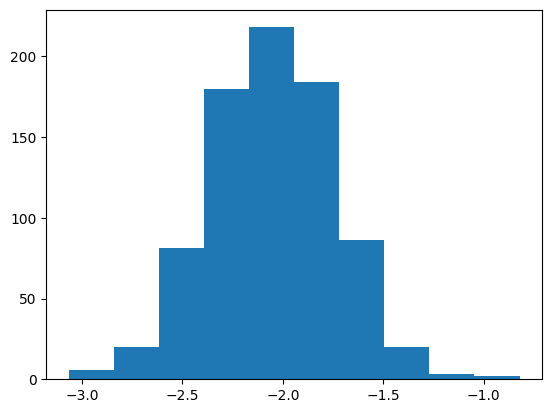

In [ ]:
plt.hist(v_pos.cpu())

In [ ]:
v_pos.median()

tensor(-2.0422, device='cuda:0')

In [ ]:
v_neg.median()

tensor(-2.2177, device='cuda:0')

(array([1.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 3.199e+03]),
 array([-5.98129395e+02, -5.38259338e+02, -4.78389221e+02, -4.18519135e+02,
        -3.58649078e+02, -2.98778992e+02, -2.38908905e+02, -1.79038818e+02,
        -1.19168739e+02, -5.92986603e+01,  5.71421504e-01]),
 <BarContainer object of 10 artists>)

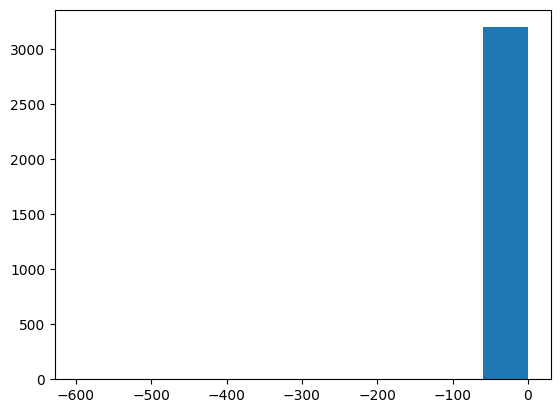

In [ ]:
plt.hist(v_neg.cpu())

# Substitutional ablation

In [ ]:
(hook_names, coeffst, biasest) = torch.load('/content/drive/MyDrive/thesis/data/chapters/chapter4/322k_2k_probe_coeff_biases_tensor_pair.pt')

In [ ]:
hook_names

['blocks.1.hook_resid_pre',
 'blocks.2.hook_resid_pre',
 'blocks.3.hook_resid_pre',
 'blocks.4.hook_resid_pre']

In [ ]:
#for did, b in enumerate(dope_bigram_ids):
#  print(did, b)
#  if did > 200:
#    break

In [ ]:
q_dict = torch.load('/content/drive/MyDrive/thesis/data/bigrams/consequent_sets_bigrams_77k_10k.pt')

In [ ]:
dope_id = 5
bid = dope_bigram_ids[dope_id].item()
bid

6

In [ ]:
dope_bigram_ids[:2000]

tensor([   0,    1,    2,  ..., 2277, 2278, 2282])

In [ ]:
singleton_bids = []
for bid_t in dope_bigram_ids[:2000]:
  bid = bid_t.item()
  if bid not in q_dict:
    continue
  if len(q_dict[bid]) == 1:
    print(bid,q_dict[bid])
    print_bigram_id(bid)
    print(tokenizer.decode(q_dict[bid]))
    singleton_bids.append(bid)

4 [597]
tensor([ 13, 285]) ', and'
 they
6 [644]
tensor([457,  84]) '’s'
 been
10 [50266]
tensor([ 27, 187]) ':\n'
            
20 [1551]
tensor([285, 253]) ' and the'
 rest
25 [1846]
tensor([310, 247]) ' is a'
 common
31 [1436]
tensor([273, 247]) ' of a'
 person
46 [2208]
tensor([407, 253]) ' by the'
 government
50 [3133]
tensor([ 13, 352]) ', it'
 seems
72 [2130]
tensor([588, 320]) ' will be'
 available
77 [2716]
tensor([253, 806]) ' the first'
 half
88 [604]
tensor([ 13, 390]) ', or'
 if
99 [84]
tensor([187,  29]) '\n<'
s
101 [1091]
tensor([ 10, 551]) ') {'
 return
104 [3963]
tensor([327, 247]) ' on a'
 regular
106 [697]
tensor([ 13, 342]) ', with'
 its
123 [15]
tensor([352, 369]) ' it was'
.
131 [8314]
tensor([281, 755]) ' to get'
 rid
132 [10653]
tensor([449, 187]) '."\n'
msgstr
133 [878]
tensor([1053,  626]) " don't"
 need
137 [6]
tensor([15, 19]) '.2'
%
144 [1292]
tensor([352,  15]) ' it.'
 But
149 [2456]
tensor([625, 685]) ' more than'
 50
154 [1805]
tensor([651, 320]) ' would 

In [ ]:
len(singleton_bids)

373

In [ ]:
#bid_qset = q_dict[bid]

In [ ]:
#path = join('/content/drive/MyDrive/thesis/derived_data/probing/sk_halfadv_probes_322k', f'probes_and_preds_{bid}_mod{model_size}.pkl')

In [ ]:
#probe_dict = load_pkl(path)

In [ ]:
batch_size = 50

In [ ]:
s = 2

In [ ]:
def rotate(start_vec, target_vec, sim_delta, thres):
    # Step 1: Normalize to unit vectors
    start_vec_norm = F.normalize(start_vec, p=2, dim=0)
    target_vec_norm = F.normalize(target_vec, p=2, dim=0)
    # Step 2: Calculate initial cosine similarity
    initial_cos_sim = torch.dot(start_vec_norm, target_vec_norm)
    # Step 3: Determine direction
    direction = target_vec_norm - start_vec_norm
    # Step 4: Move in the direction
    alpha = 0.0
    while True:
        # Generate candidate vector
        candidate_vec = start_vec_norm + alpha * direction
        candidate_vec_norm = F.normalize(candidate_vec, p=2, dim=0)
        # Calculate similarity to start_vec
        cos_sim_to_start = torch.dot(start_vec_norm, candidate_vec_norm)
        # Check if it meets the criteria
        if abs(cos_sim_to_start - sim_delta) < thres:
            # Rescale to original norm
            candidate_vec = candidate_vec * torch.norm(start_vec, p=2, dim=0)
            return candidate_vec
        alpha += 0.01  # Increment factor, can be tuned

In [ ]:
rand_bid_direction = torch.randn_like(bid_direction).to(device)

NameError: ignored

In [ ]:
def replace_hook_fc(value, hook):
  #print('yoness', value.shape)
  current_last_pos_resid = value[0,-1]
  current_norm = torch.norm(current_last_pos_resid,dim=0)
  #replace_sim = get_similarity_cross(current_last_pos_resid.reshape(1,-1).float(), bid_direction.reshape(1,-1).float())
  #print('rep sim', replace_sim)
  #print('current norm', current_norm)
  #print('sk probe pred', sk_probe.predict(current_last_pos_resid.reshape(1,-1).detach()))
  replacement = current_norm * bid_direction_normalized
  value[0,-1] = replacement
  return value
def rotate_hook_fc(value, hook):
  #print('yoness', value.shape, hook.name, bid_direction_dict[hook.name].shape)
  current_last_pos_resid = value[0,-1]
  dir = bid_direction_dict[hook.name]
  #print(torch.norm(current_last_pos_resid,dim=-1))
  replacement = rotate(current_last_pos_resid, dir, 0.70, 0.01)
  value[0,-1] = replacement
  return value
def rand_rotate_hook_fc(value, hook):
  #print('yoness', value.shape)
  current_last_pos_resid = value[0,-1]
  replacement = rotate(current_last_pos_resid, rand_bid_direction, 0.90,0.01)
  value[0,-1] = replacement
  return value

In [ ]:
rot_qset_logits_t = {}
randrot_qset_logits_t = {}
randrot_outer_qset_logits_t = {}
unabl_qset_logits_t = {}

In [ ]:
randrot_outer_qset_logits_t = {}

In [ ]:
bid = singleton_bids[0]

In [ ]:
bid

4

In [ ]:
q_dict[bid]

[597]

In [ ]:
tokenizer.decode(q_dict[bid])

' they'

In [ ]:
for j, bid in enumerate(singleton_bids[:10]):
  print(j, bid)
  print_bigram_id(bid)
  print(tokenizer.decode(q_dict[bid]))
  bid_tuple = tuple(bigrams[bid].tolist())
  bigram_id_A = bid
  bid_occ_dict = occ_dicts_dict[bid]

  bid_directions = coeffst[:,dope_id].float().to(device)
  bid_directions_normalized = F.normalize(bid_directions,dim=0) #.to(device)
  bid_direction_dict = {hook_name : direction for (hook_name, direction) in zip(hook_names, bid_directions_normalized)}
  print(bid_direction_dict)

  unabl_qset_logits_list = []
  rot_qset_logits_list = []
  randrot_qset_logits_list = []
  randrot_outer_qset_logits_list = []
  replace_qset_logits_list = []
  #rand_bid_direction = torch.randn_like(bid_direction).to(device)
  for bid_pos_occ_i in tqdm(bid_occ_dict[(None, bid_tuple[1])][:500]):
    bid_seq = occ_to_seq(TL, bid_pos_occ_i,decode=False).to(device)
    with torch.no_grad():
      out, cache = model.run_with_cache(bid_seq.reshape(1,-1))
      '''
      out_abl_replace = model.run_with_hooks(
            bid_seq.reshape(1,-1),
            prepend_bos=False,
            return_type="logits",
            fwd_hooks=[(f'blocks.{s+1}.hook_resid_pre', replace_hook_fc)]
      )
      '''

      out_abl = model.run_with_hooks(
            bid_seq.reshape(1,-1),
            prepend_bos=False,
            return_type="logits",
            fwd_hooks=[(f'blocks.1.hook_resid_pre', rotate_hook_fc)]
      )
      '''
      out_abl_rand = model.run_with_hooks(
            bid_seq.reshape(1,-1),
            prepend_bos=False,
            return_type="logits",
            fwd_hooks=[(f'blocks.{s+1}.hook_resid_pre', rand_rotate_hook_fc)]
      )
      out_abl_rand_outer = model.run_with_hooks(
            bid_seq.reshape(1,-1),
            prepend_bos=False,
            return_type="logits",
            fwd_hooks=[(f'blocks.{s+1}.hook_resid_pre', rand_rotate_hook_fc)]
      )
      '''

    bid_qset = q_dict[bid]
    unabl_qset_logits = out[0,-1][bid_qset]
    rot_qset_logits = out_abl[0,-1][bid_qset]
    #randrot_qset_logits = out_abl_rand[0,-1][bid_qset]
    #randrot_outer_qset_logits = out_abl_rand_outer[0,-1][bid_qset]
    #replace_qset_logits = out_abl_replace[0,-1][bid_qset]

    unabl_qset_logits_list.append(unabl_qset_logits)
    rot_qset_logits_list.append(rot_qset_logits)
    #randrot_qset_logits_list.append(randrot_qset_logits)
    #randrot_outer_qset_logits_list.append(randrot_outer_qset_logits)
    #replace_qset_logits_list.append(replace_qset_logits)

  rot_qset_logits_t[bid] = torch.stack(rot_qset_logits_list)
  #randrot_qset_logits_t[bid] = torch.stack(randrot_qset_logits_list)
  #randrot_outer_qset_logits_t[bid] = torch.stack(randrot_outer_qset_logits_list)
  unabl_qset_logits_t[bid] = torch.stack(unabl_qset_logits_list)

0 4
tensor([ 13, 285]) ', and'
 they
{'blocks.1.hook_resid_pre': tensor([-0.0664,  0.1334,  0.5177,  ..., -0.6191,  0.0528, -0.2183],
       device='cuda:0'), 'blocks.2.hook_resid_pre': tensor([-0.6623,  0.4504,  0.6218,  ..., -0.2964,  0.9836, -0.5677],
       device='cuda:0'), 'blocks.3.hook_resid_pre': tensor([-0.3069, -0.2737,  0.4450,  ...,  0.7211, -0.1617, -0.6597],
       device='cuda:0'), 'blocks.4.hook_resid_pre': tensor([-0.6803,  0.8393,  0.3839,  ..., -0.0946, -0.0596, -0.4414],
       device='cuda:0')}


100%|██████████| 500/500 [01:13<00:00,  6.77it/s]


1 6
tensor([457,  84]) '’s'
 been
{'blocks.1.hook_resid_pre': tensor([-0.0664,  0.1334,  0.5177,  ..., -0.6191,  0.0528, -0.2183],
       device='cuda:0'), 'blocks.2.hook_resid_pre': tensor([-0.6623,  0.4504,  0.6218,  ..., -0.2964,  0.9836, -0.5677],
       device='cuda:0'), 'blocks.3.hook_resid_pre': tensor([-0.3069, -0.2737,  0.4450,  ...,  0.7211, -0.1617, -0.6597],
       device='cuda:0'), 'blocks.4.hook_resid_pre': tensor([-0.6803,  0.8393,  0.3839,  ..., -0.0946, -0.0596, -0.4414],
       device='cuda:0')}


100%|██████████| 500/500 [01:14<00:00,  6.75it/s]


2 10
tensor([ 27, 187]) ':\n'
            
{'blocks.1.hook_resid_pre': tensor([-0.0664,  0.1334,  0.5177,  ..., -0.6191,  0.0528, -0.2183],
       device='cuda:0'), 'blocks.2.hook_resid_pre': tensor([-0.6623,  0.4504,  0.6218,  ..., -0.2964,  0.9836, -0.5677],
       device='cuda:0'), 'blocks.3.hook_resid_pre': tensor([-0.3069, -0.2737,  0.4450,  ...,  0.7211, -0.1617, -0.6597],
       device='cuda:0'), 'blocks.4.hook_resid_pre': tensor([-0.6803,  0.8393,  0.3839,  ..., -0.0946, -0.0596, -0.4414],
       device='cuda:0')}


100%|██████████| 500/500 [01:14<00:00,  6.74it/s]


3 20
tensor([285, 253]) ' and the'
 rest
{'blocks.1.hook_resid_pre': tensor([-0.0664,  0.1334,  0.5177,  ..., -0.6191,  0.0528, -0.2183],
       device='cuda:0'), 'blocks.2.hook_resid_pre': tensor([-0.6623,  0.4504,  0.6218,  ..., -0.2964,  0.9836, -0.5677],
       device='cuda:0'), 'blocks.3.hook_resid_pre': tensor([-0.3069, -0.2737,  0.4450,  ...,  0.7211, -0.1617, -0.6597],
       device='cuda:0'), 'blocks.4.hook_resid_pre': tensor([-0.6803,  0.8393,  0.3839,  ..., -0.0946, -0.0596, -0.4414],
       device='cuda:0')}


100%|██████████| 500/500 [01:14<00:00,  6.70it/s]


4 25
tensor([310, 247]) ' is a'
 common
{'blocks.1.hook_resid_pre': tensor([-0.0664,  0.1334,  0.5177,  ..., -0.6191,  0.0528, -0.2183],
       device='cuda:0'), 'blocks.2.hook_resid_pre': tensor([-0.6623,  0.4504,  0.6218,  ..., -0.2964,  0.9836, -0.5677],
       device='cuda:0'), 'blocks.3.hook_resid_pre': tensor([-0.3069, -0.2737,  0.4450,  ...,  0.7211, -0.1617, -0.6597],
       device='cuda:0'), 'blocks.4.hook_resid_pre': tensor([-0.6803,  0.8393,  0.3839,  ..., -0.0946, -0.0596, -0.4414],
       device='cuda:0')}


100%|██████████| 500/500 [01:14<00:00,  6.74it/s]


5 31
tensor([273, 247]) ' of a'
 person
{'blocks.1.hook_resid_pre': tensor([-0.0664,  0.1334,  0.5177,  ..., -0.6191,  0.0528, -0.2183],
       device='cuda:0'), 'blocks.2.hook_resid_pre': tensor([-0.6623,  0.4504,  0.6218,  ..., -0.2964,  0.9836, -0.5677],
       device='cuda:0'), 'blocks.3.hook_resid_pre': tensor([-0.3069, -0.2737,  0.4450,  ...,  0.7211, -0.1617, -0.6597],
       device='cuda:0'), 'blocks.4.hook_resid_pre': tensor([-0.6803,  0.8393,  0.3839,  ..., -0.0946, -0.0596, -0.4414],
       device='cuda:0')}


100%|██████████| 500/500 [01:14<00:00,  6.71it/s]


6 46
tensor([407, 253]) ' by the'
 government
{'blocks.1.hook_resid_pre': tensor([-0.0664,  0.1334,  0.5177,  ..., -0.6191,  0.0528, -0.2183],
       device='cuda:0'), 'blocks.2.hook_resid_pre': tensor([-0.6623,  0.4504,  0.6218,  ..., -0.2964,  0.9836, -0.5677],
       device='cuda:0'), 'blocks.3.hook_resid_pre': tensor([-0.3069, -0.2737,  0.4450,  ...,  0.7211, -0.1617, -0.6597],
       device='cuda:0'), 'blocks.4.hook_resid_pre': tensor([-0.6803,  0.8393,  0.3839,  ..., -0.0946, -0.0596, -0.4414],
       device='cuda:0')}


100%|██████████| 500/500 [01:14<00:00,  6.68it/s]


7 50
tensor([ 13, 352]) ', it'
 seems
{'blocks.1.hook_resid_pre': tensor([-0.0664,  0.1334,  0.5177,  ..., -0.6191,  0.0528, -0.2183],
       device='cuda:0'), 'blocks.2.hook_resid_pre': tensor([-0.6623,  0.4504,  0.6218,  ..., -0.2964,  0.9836, -0.5677],
       device='cuda:0'), 'blocks.3.hook_resid_pre': tensor([-0.3069, -0.2737,  0.4450,  ...,  0.7211, -0.1617, -0.6597],
       device='cuda:0'), 'blocks.4.hook_resid_pre': tensor([-0.6803,  0.8393,  0.3839,  ..., -0.0946, -0.0596, -0.4414],
       device='cuda:0')}


100%|██████████| 500/500 [01:14<00:00,  6.73it/s]


8 72
tensor([588, 320]) ' will be'
 available
{'blocks.1.hook_resid_pre': tensor([-0.0664,  0.1334,  0.5177,  ..., -0.6191,  0.0528, -0.2183],
       device='cuda:0'), 'blocks.2.hook_resid_pre': tensor([-0.6623,  0.4504,  0.6218,  ..., -0.2964,  0.9836, -0.5677],
       device='cuda:0'), 'blocks.3.hook_resid_pre': tensor([-0.3069, -0.2737,  0.4450,  ...,  0.7211, -0.1617, -0.6597],
       device='cuda:0'), 'blocks.4.hook_resid_pre': tensor([-0.6803,  0.8393,  0.3839,  ..., -0.0946, -0.0596, -0.4414],
       device='cuda:0')}


100%|██████████| 500/500 [01:13<00:00,  6.76it/s]


9 77
tensor([253, 806]) ' the first'
 half
{'blocks.1.hook_resid_pre': tensor([-0.0664,  0.1334,  0.5177,  ..., -0.6191,  0.0528, -0.2183],
       device='cuda:0'), 'blocks.2.hook_resid_pre': tensor([-0.6623,  0.4504,  0.6218,  ..., -0.2964,  0.9836, -0.5677],
       device='cuda:0'), 'blocks.3.hook_resid_pre': tensor([-0.3069, -0.2737,  0.4450,  ...,  0.7211, -0.1617, -0.6597],
       device='cuda:0'), 'blocks.4.hook_resid_pre': tensor([-0.6803,  0.8393,  0.3839,  ..., -0.0946, -0.0596, -0.4414],
       device='cuda:0')}


100%|██████████| 500/500 [01:14<00:00,  6.73it/s]


tensor([ 13, 285]) ', and'
 they
Rot vs unabl TtestResult(statistic=-2.3483885047095487, pvalue=0.019835960080995137, df=199)


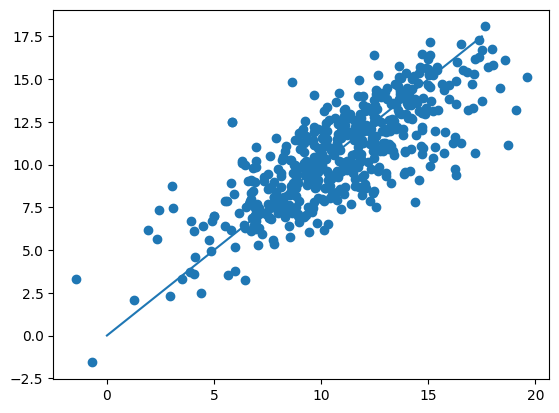

tensor([457,  84]) '’s'
 been
Rot vs unabl TtestResult(statistic=-3.6937627088502047, pvalue=0.0002854460490118698, df=199)


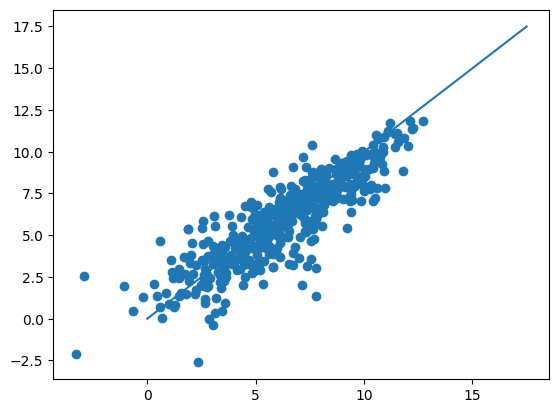

tensor([ 27, 187]) ':\n'
            
Rot vs unabl TtestResult(statistic=-5.1130721514241415, pvalue=7.422507145036453e-07, df=199)


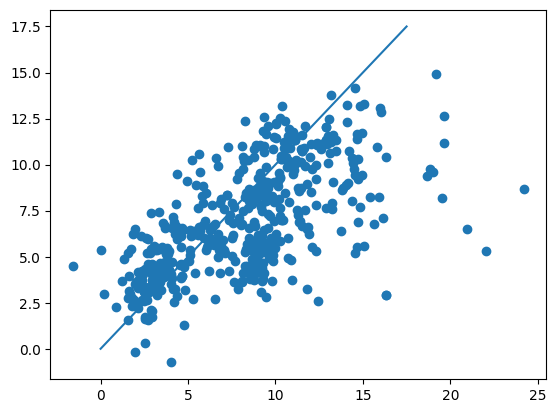

tensor([285, 253]) ' and the'
 rest
Rot vs unabl TtestResult(statistic=-15.977502951409836, pvalue=1.6127859051100963e-37, df=199)


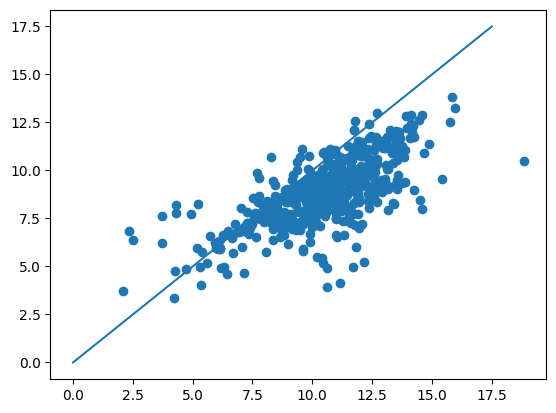

tensor([310, 247]) ' is a'
 common
Rot vs unabl TtestResult(statistic=-21.909232969182305, pvalue=6.170288960578805e-55, df=199)


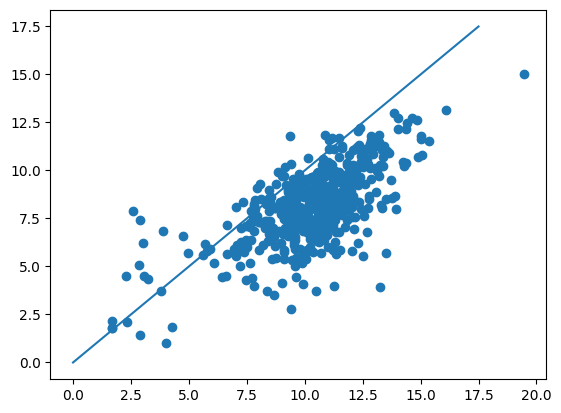

tensor([273, 247]) ' of a'
 person
Rot vs unabl TtestResult(statistic=-11.026832523237285, pvalue=2.252913214761444e-22, df=199)


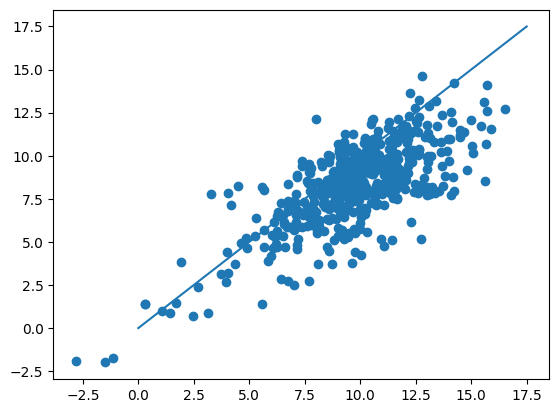

tensor([407, 253]) ' by the'
 government
Rot vs unabl TtestResult(statistic=-7.508119071646439, pvalue=1.9718174561555285e-12, df=199)


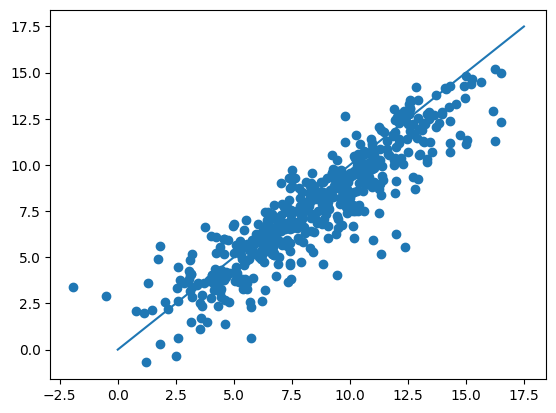

tensor([ 13, 352]) ', it'
 seems
Rot vs unabl TtestResult(statistic=-10.165051242609808, pvalue=8.114761786529729e-20, df=199)


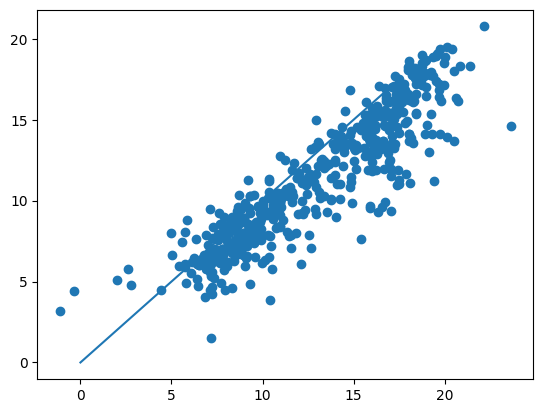

tensor([588, 320]) ' will be'
 available
Rot vs unabl TtestResult(statistic=-7.716509897900733, pvalue=5.6556572460942e-13, df=199)


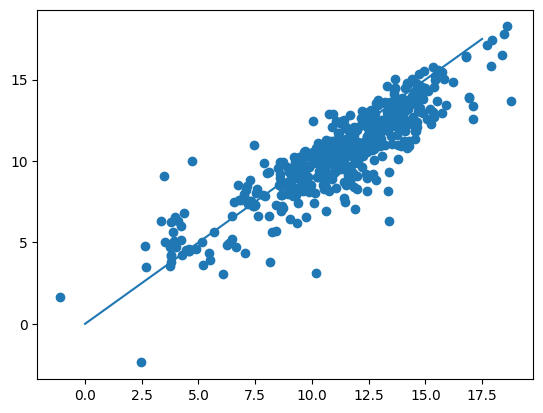

tensor([253, 806]) ' the first'
 half
Rot vs unabl TtestResult(statistic=-3.6932717664674284, pvalue=0.00028596224382394835, df=199)


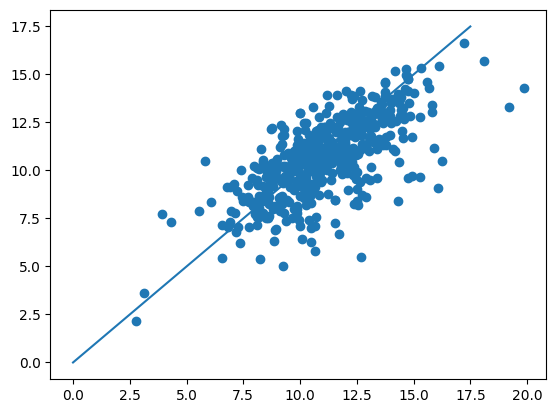

In [ ]:
for bid, _ in rot_qset_logits_t.items():
  print_bigram_id(bid)
  print(tokenizer.decode(q_dict[bid]))
  print('Rot vs unabl', ttest_rel(rot_qset_logits_t[bid][:200,0].cpu(), unabl_qset_logits_t[bid][:200,0].cpu()))
  plt.scatter(unabl_qset_logits_t[bid][:,0].cpu(), rot_qset_logits_t[bid][:,0].cpu(), )
  plt.plot(torch.linspace(0,17.5,100), torch.linspace(0,17.5,100))
  plt.show()

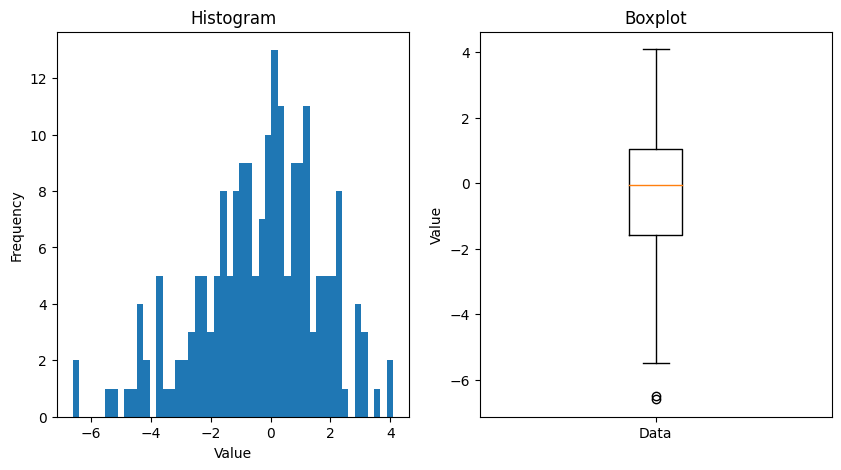

In [ ]:
hist_and_box(rot_qset_logits_t[bid][:200,0].cpu() - unabl_qset_logits_t[bid][:200,0].cpu())

In [ ]:
bid_qset

[597]

In [ ]:
def dict_to_cpu(my_dict):
  return {key:val.cpu() for key, val in my_dict.items()}

In [ ]:
hej = {
  'bids': singleton_bids[:10],
  'rot_qset_logits_t': dict_to_cpu(rot_qset_logits_t),
  'randrot_qset_logits_t': dict_to_cpu(randrot_qset_logits_t),
  'randrot_outer_qset_logits_t': dict_to_cpu(randrot_outer_qset_logits_t),
  'unabl_qset_logits_t': dict_to_cpu(unabl_qset_logits_t)
}

In [ ]:
#torch.save(hej, '/content/hej.pt')

In [ ]:
for bid in singleton_bids[:10]:
  print('bid', bid)
  #print('Rot vs randrot', ttest_rel(rot_qset_logits_t[bid][:,0].cpu(), randrot_qset_logits_t[bid][:,0].cpu()))
  #print('Rot vs randrot_outer', ttest_rel(rot_qset_logits_t[bid][:,0].cpu(), randrot_outer_qset_logits_t[bid][:,0].cpu()))
  print('Rot vs unabl', ttest_rel(rot_qset_logits_t[bid][:,0].cpu(), unabl_qset_logits_t[bid][:,0].cpu()))

bid 4
Rot vs unabl TtestResult(statistic=0.6981072211209012, pvalue=0.4854353222750095, df=499)
bid 6
Rot vs unabl TtestResult(statistic=1.4243066082571938, pvalue=0.15498278395069046, df=499)
bid 10
Rot vs unabl TtestResult(statistic=0.7116494139105076, pvalue=0.47701445104971585, df=499)
bid 20
Rot vs unabl TtestResult(statistic=-12.630944316299862, pvalue=6.274376468547068e-32, df=499)
bid 25
Rot vs unabl TtestResult(statistic=-17.536173445755473, pvalue=5.452670267214292e-54, df=499)
bid 31
Rot vs unabl TtestResult(statistic=-8.149846814515417, pvalue=2.9573465851029215e-15, df=499)
bid 46
Rot vs unabl TtestResult(statistic=-7.2573509642045515, pvalue=1.5209946021651216e-12, df=499)
bid 50
Rot vs unabl TtestResult(statistic=-5.104198262490821, pvalue=4.7317485441380913e-07, df=499)
bid 72
Rot vs unabl TtestResult(statistic=2.397631569204054, pvalue=0.016867988491423874, df=499)
bid 77
Rot vs unabl TtestResult(statistic=-9.935459984295147, pvalue=2.4018425859575656e-21, df=499)


In [ ]:
randrot_qset_logits_t.mean(dim=0)

tensor([10.7895], device='cuda:0')

In [ ]:
rot_qset_logits_t.mean(dim=0)

tensor([10.9774], device='cuda:0')

In [ ]:
unabl_qset_logits_t.mean(dim=0)

tensor([11.3353], device='cuda:0')

ValueError: ignored

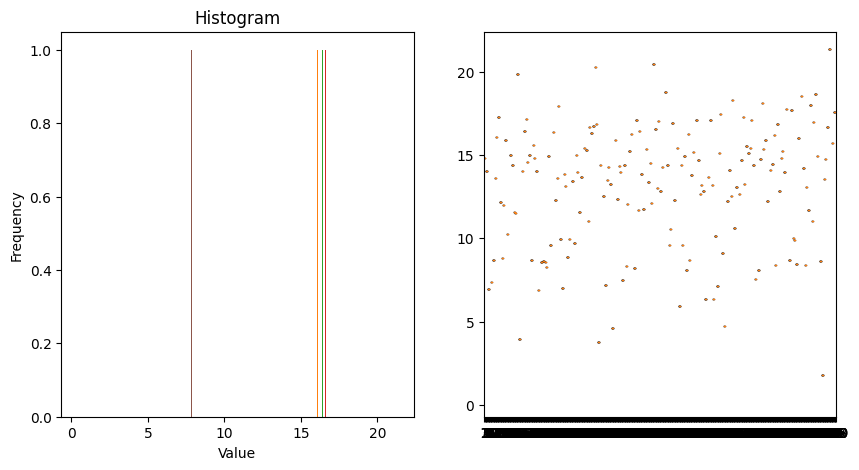

In [ ]:
hist_and_box(randrot_qset_logits_t[:,])

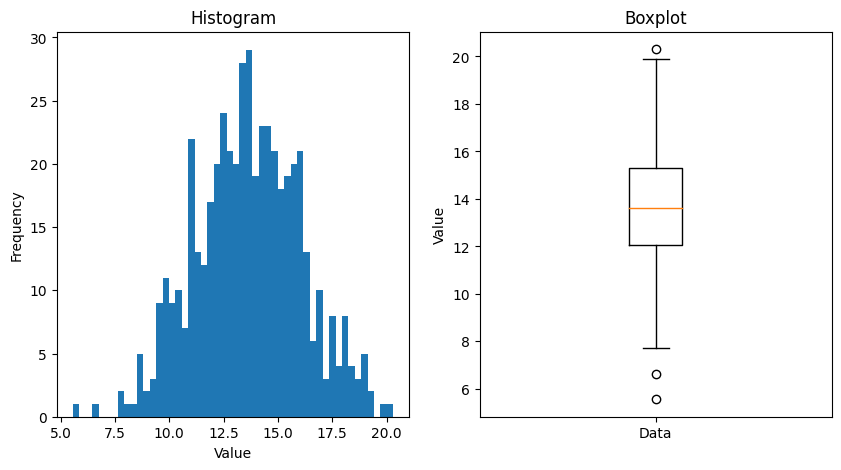

In [ ]:
hist_and_box(rot_qset_logits_t[:,col])

# LEACE

In [ ]:
import torch
from sklearn.datasets import make_classification
from sklearn.linear_model import LogisticRegression

from concept_erasure import LeaceEraser

n, d, k = 2048, 128, 2

X, Y = make_classification(
    n_samples=n,
    n_features=d,
    n_classes=k,
    random_state=42,
)
X_t = torch.from_numpy(X)
Y_t = torch.from_numpy(Y)

# Logistic regression does learn something before concept erasure
real_lr = LogisticRegression(max_iter=1000).fit(X, Y)
beta = torch.from_numpy(real_lr.coef_)
assert beta.norm(p=torch.inf) > 0.1

eraser = LeaceEraser.fit(X_t, Y_t)
X_ = eraser(X_t)

# But learns nothing after
null_lr = LogisticRegression(max_iter=1000, tol=0.0).fit(X_.numpy(), Y)
beta = torch.from_numpy(null_lr.coef_)
assert beta.norm(p=torch.inf) < 1e-4

In [ ]:
hook_name = resid_hook_names[0]

In [ ]:
X, Y = halfadv_train_fixed_A[hook_name], halfadv_train_fixed_labels_A[hook_name]
X_t = X
Y_t = Y

In [ ]:
real_lr = LogisticRegression(max_iter=1000).fit(X, Y)

In [ ]:
beta = torch.from_numpy(real_lr.coef_)
beta

tensor([[ 0.1678,  0.2122, -0.5354,  ..., -0.1421,  0.2690,  0.1302]],
       dtype=torch.float64)

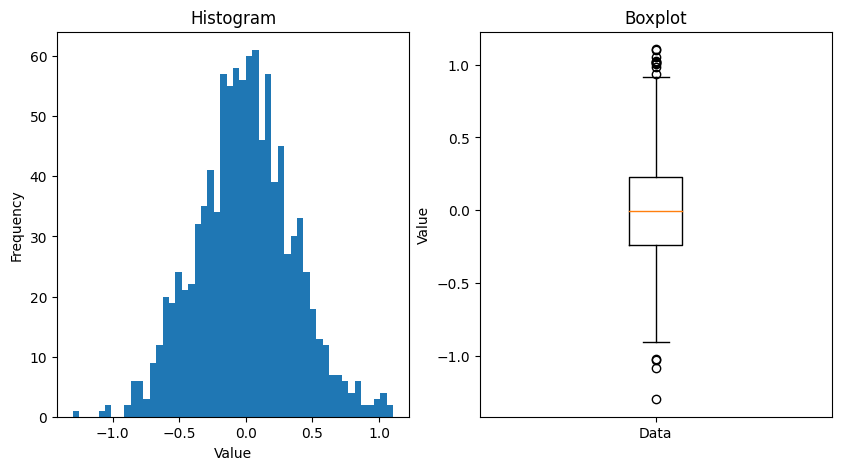

In [ ]:
hist_and_box(beta)

In [ ]:
beta.norm(p=torch.inf)

tensor(1.2987, dtype=torch.float64)

In [ ]:
assert beta.norm(p=torch.inf) > 0.1

In [ ]:
eraser = LeaceEraser.fit(X_t, Y_t)

In [ ]:
X_ = eraser(X_t)

In [ ]:
null_lr = LogisticRegression(max_iter=1000, tol=0.0).fit(X_.numpy(), Y)

In [ ]:
beta = torch.from_numpy(null_lr.coef_)

In [ ]:
beta.norm(p=torch.inf) #< 1e-4

tensor(0.3407, dtype=torch.float64)

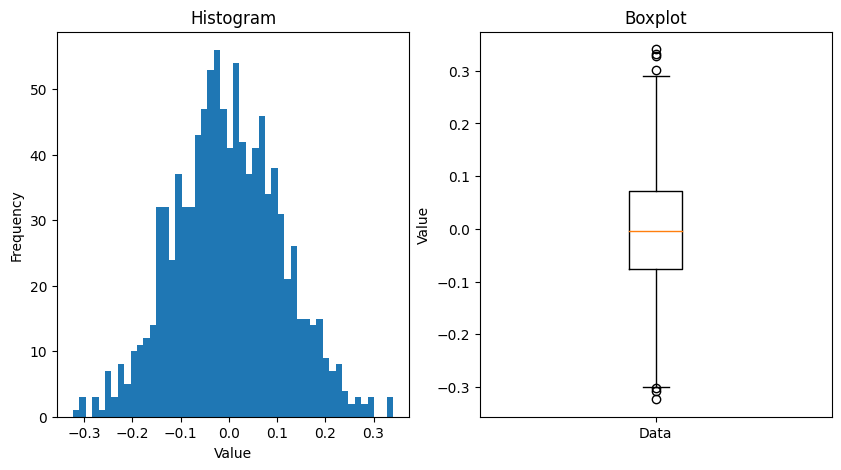

In [ ]:
hist_and_box(beta)

## Dset functions

## Actual training

In [ ]:
batch_size = 100

In [ ]:
for i in tqdm(range(0,len(dope_bigram_ids),1)):
  bigram_id = dope_bigram_ids[i].item()
  #print('current bigram', bigram_id)
  #if exists(join('/content/drive/MyDrive/thesis/derived_data/probing/sk_probes', f'probes_and_preds_{bigram_id}_mod{model_size}.pkl')):
  #  #print('alredy exists, skipping')
  #  continue

  #print_bigram_id(bigram_id)
  nonadv_train_dset, nonadv_val_dset, nonadv_test_dset = get_splits(bigram_id, occ_dicts_dict) #1133
  nonadv_train_loader = DataLoader(nonadv_train_dset, batch_size=batch_size, shuffle=False)
  nonadv_val_loader = DataLoader(nonadv_val_dset, batch_size=batch_size, shuffle=False)
  nonadv_train_fixed, nonadv_train_fixed_labels = get_fixed_vector_dset_new(nonadv_train_loader, hook_names, model, stop_at_layer=4)
  nonadv_val_fixed, nonadv_val_fixed_labels = get_fixed_vector_dset_new(nonadv_val_loader, hook_names, model, stop_at_layer=4)

  '''
  (a,b) = bigram_id_to_tuple(bigram_id)
  adv_train_dset = get_synthetic(
    E_in = model.embed.W_E.detach(),
    bigram_tuple = (a,b),
    k_similars = 20,
    n_positives = 200,
    n_mixed = 100,
    n_negatives_multiple = 10
  )
  adv_val_dset = get_synthetic(
    E_in = model.embed.W_E.detach(),
    bigram_tuple = (a,b),
    k_similars = 20,
    n_positives = 200,
    n_mixed = 100,
    n_negatives_multiple = 10
  )
  adv_train_loader = DataLoader(adv_train_dset, batch_size=batch_size, shuffle=False)
  adv_val_loader = DataLoader(adv_val_dset, batch_size=batch_size, shuffle=False)

  train_adv_fixed, train_adv_labels = get_fixed_vector_dset_new(adv_train_loader, hook_names, model, max_i = None, stop_at_layer=4)
  val_adv_fixed, val_adv_labels = get_fixed_vector_dset_new(adv_val_loader, hook_names, model, max_i = None, stop_at_layer=4)
  '''
  sk_hook_probes = {}
  #sk_hook_preds = {}
  for hook_name in hook_names:

    nonadv_hook_probe = LogisticRegression(random_state=0, max_iter=100000).fit(nonadv_train_fixed[hook_name].cpu(), nonadv_train_fixed_labels[hook_name].cpu())
    nonadv_on_nonadv_eval = evaluate_probe(nonadv_hook_probe, hook_name, 'sk', nonadv_val_fixed, nonadv_val_fixed_labels, return_labels=True)
    '''
    adv_hook_probe = LogisticRegression(random_state=0, max_iter=100000).fit(train_adv_fixed[hook_name].cpu(), train_adv_labels[hook_name].cpu())
    combi_train_fixed = torch.cat((train_adv_fixed[hook_name].cpu(),nonadv_train_fixed[hook_name].cpu()),dim=0)
    combi_train_labels = torch.cat((train_adv_labels[hook_name],nonadv_train_fixed_labels[hook_name]),dim=0)
    combi_hook_probe = LogisticRegression(random_state=0, max_iter=100000).fit(combi_train_fixed.cpu(), combi_train_labels.cpu())
    combi_adv_pred = torch.tensor(combi_hook_probe.predict(val_adv_fixed[hook_name].cpu()))
    combi_nonadv_pred = torch.tensor(combi_hook_probe.predict(nonadv_val_fixed[hook_name].cpu()))
    nonadv_on_adv_eval = evaluate_probe(nonadv_hook_probe, hook_name, 'sk', val_adv_fixed, val_adv_labels, return_labels=True)

    adv_on_adv_eval = evaluate_probe(adv_hook_probe, hook_name, 'sk', nonadv_val_fixed, nonadv_val_fixed_labels, return_labels=True)
    adv_on_nonadv_eval = evaluate_probe(adv_hook_probe, hook_name, 'sk', val_adv_fixed, val_adv_labels, return_labels=True)
    combi_on_nonadv_eval = evaluate_probe(combi_hook_probe, hook_name, 'sk', nonadv_val_fixed, nonadv_val_fixed_labels, return_labels=True)
    combi_on_adv_eval = evaluate_probe(combi_hook_probe, hook_name, 'sk', val_adv_fixed, val_adv_labels, return_labels=True)
    '''
    #print('combi eval', hook_name, combi_on_nonadv_eval[0])
    sk_hook_probes[hook_name] = {
        'probes': {
          'nonadv': nonadv_hook_probe,
          #'adv': adv_hook_probe,
          #'combi': combi_hook_probe,
        },
        'eval': {
            'nonadv_on_nonadv': nonadv_on_nonadv_eval,
            #'nonadv_on_adv': nonadv_on_adv_eval,
            #'adv_on_adv': adv_on_adv_eval,
            #'adv_on_nonadv': adv_on_nonadv_eval,
            #'combi_on_nonadv': combi_on_nonadv_eval,
            #'combi_on_adv': combi_on_adv_eval
        },
        'logits': {
            'nonadv_on_nonadv': get_logits_fixed(nonadv_hook_probe, nonadv_val_fixed, hook_name),
            #'adv_on_adv': get_logits_fixed(adv_hook_probe, val_adv_fixed),
            #'combi_on_nonadv': get_logits_fixed(combi_hook_probe, nonadv_val_fixed),
            #'combi_on_adv': get_logits_fixed(combi_hook_probe, val_adv_fixed)
        }
    }
    #sk_hook_preds[hook_name] = (y_true, y_pred)

  with open(join('/content/drive/MyDrive/thesis/derived_data/probing/sk_probes', f'probes_and_preds_{bigram_id}_mod{model_size}.pkl'), 'wb') as f:
    pickle.dump(sk_hook_probes, f)

100%|██████████| 2463/2463 [1:54:33<00:00,  2.79s/it]


In [ ]:
get_logits_fixed(nonadv_hook_probe, nonadv_val_fixed)

In [ ]:
for hook_name, X in fixed:nonadv_val_fixed

{'blocks.0.hook_resid_pre': tensor([[ 0.0022, -0.0348,  0.0233,  ...,  0.0058,  0.0293,  0.0176],
         [ 0.0022, -0.0348,  0.0233,  ...,  0.0058,  0.0293,  0.0176],
         [ 0.0022, -0.0348,  0.0233,  ...,  0.0058,  0.0293,  0.0176],
         ...,
         [ 0.0022, -0.0348,  0.0233,  ...,  0.0058,  0.0293,  0.0176],
         [ 0.0022, -0.0348,  0.0233,  ...,  0.0058,  0.0293,  0.0176],
         [ 0.0022, -0.0348,  0.0233,  ...,  0.0058,  0.0293,  0.0176]],
        device='cuda:0'),
 'blocks.0.hook_attn_out': tensor([[ 0.0015,  0.0962, -0.0558,  ...,  0.2444, -0.0319, -0.0265],
         [ 0.0712,  0.0552, -0.0275,  ...,  0.1291,  0.0222, -0.0532],
         [ 0.0389, -0.0375, -0.3250,  ..., -0.3975,  0.0136, -0.0653],
         ...,
         [-0.1168,  0.1710, -0.1559,  ...,  0.2842, -0.0304, -0.0559],
         [-0.0035,  0.1248,  0.0361,  ...,  0.2470, -0.0131, -0.0617],
         [ 0.1222,  0.1990,  0.0901,  ...,  0.0332,  0.0146,  0.0062]],
        device='cuda:0'),
 'blocks.0.ho

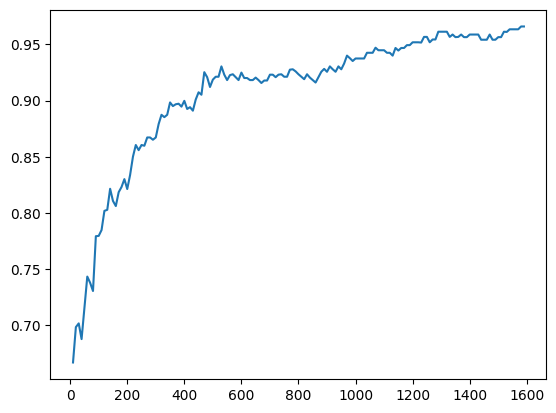

In [ ]:
plt.plot(ns, f1s)

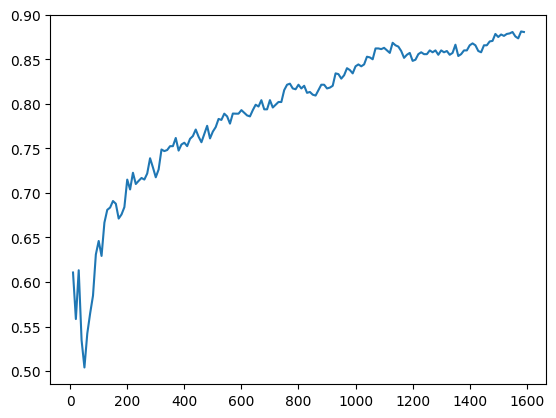

In [ ]:
plt.plot(ns, f1s)

In [ ]:
def get_conf_mat_indices(y_data, y_pred_binary):
  TN = torch.argwhere((y_pred_binary == 0) & (y_data == 0))
  FP = torch.argwhere((y_pred_binary == 1) & (y_data == 0))
  TP = torch.argwhere((y_pred_binary == 1) & (y_data == 1))
  FN = torch.argwhere((y_pred_binary == 0) & (y_data == 1))
  return TN, FP, TP, FN

In [ ]:
val_dset[0]

(tensor([   23,    11,    84,   424,    19,   559, 12131,  1012,  1423,  2787,
           428, 12131,  1012,  1423,  2787,    15,   187,    14,    23,    11,
            84,   424,    19,   187]),
 tensor(1., dtype=torch.float64),
 tensor(1.))

In [ ]:
TN, FP, TP, FN = get_conf_mat_indices(val_fixed_labels[hook_name], y_pred_nonadv)

In [ ]:
random_fixed = torch.load('/content/drive/MyDrive/thesis/derived_data/probing/random_fixed_7k.pt',
                          map_location=torch.device('cpu'))

RuntimeError: ignored

# How many samples do you need?

In [ ]:
hook_name = 'blocks.1.hook_resid_pre'

In [ ]:
shuffle_perm = torch.randperm(len(train_fixed[hook_name]))
train_fixed_shuffled = train_fixed[hook_name][shuffle_perm]
train_fixed_labels_shuffled = train_fixed_labels[hook_name][shuffle_perm]


n =  10


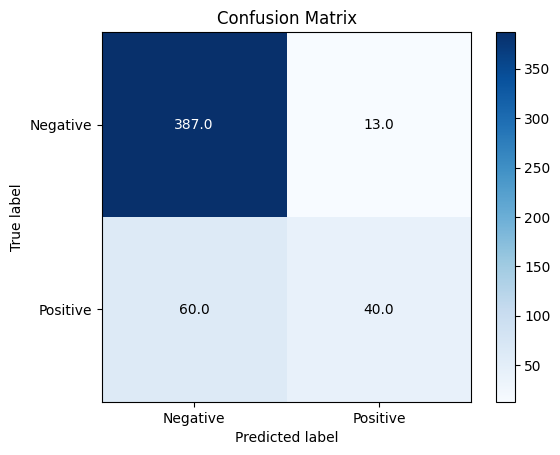

F1 Score: 0.5228758169934641
Accuracy: 0.854
Sensitivity: 0.4000000059604645
Specificity: 0.9674999713897705
n =  20


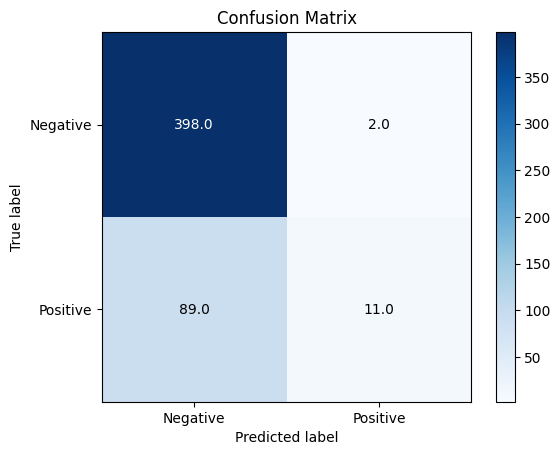

F1 Score: 0.19469026548672566
Accuracy: 0.818
Sensitivity: 0.10999999940395355
Specificity: 0.9950000047683716
n =  30


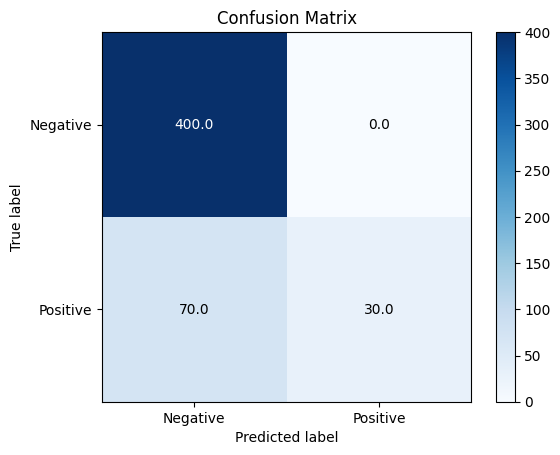

F1 Score: 0.4615384615384615
Accuracy: 0.86
Sensitivity: 0.30000001192092896
Specificity: 1.0
n =  40


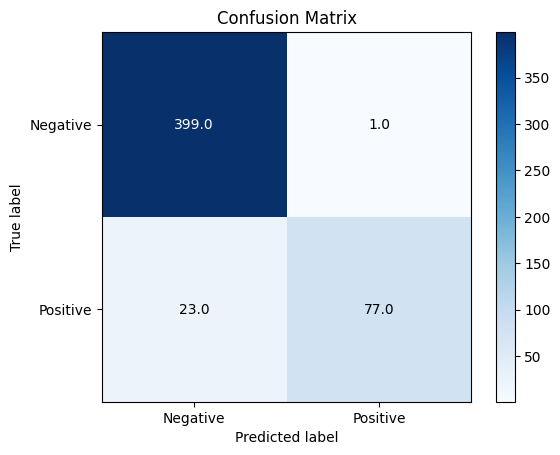

F1 Score: 0.8651685393258428
Accuracy: 0.952
Sensitivity: 0.7699999809265137
Specificity: 0.9975000023841858
n =  50


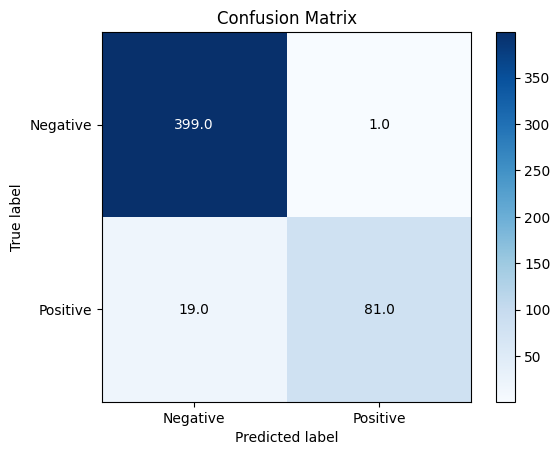

F1 Score: 0.8901098901098902
Accuracy: 0.96
Sensitivity: 0.8100000023841858
Specificity: 0.9975000023841858
n =  60


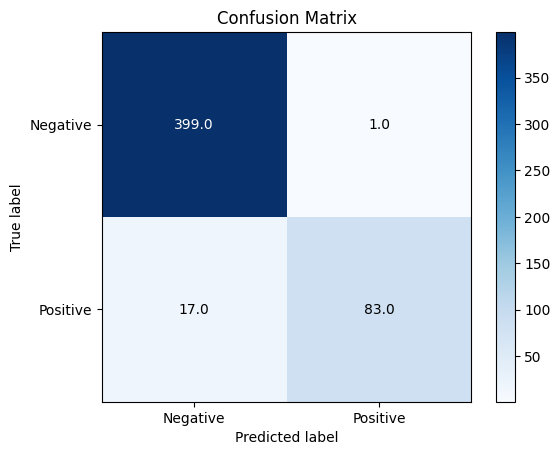

F1 Score: 0.9021739130434783
Accuracy: 0.964
Sensitivity: 0.8299999833106995
Specificity: 0.9975000023841858
n =  70


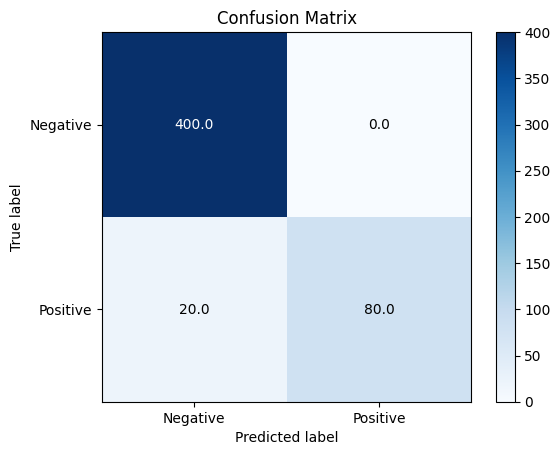

F1 Score: 0.888888888888889
Accuracy: 0.96
Sensitivity: 0.800000011920929
Specificity: 1.0
n =  80


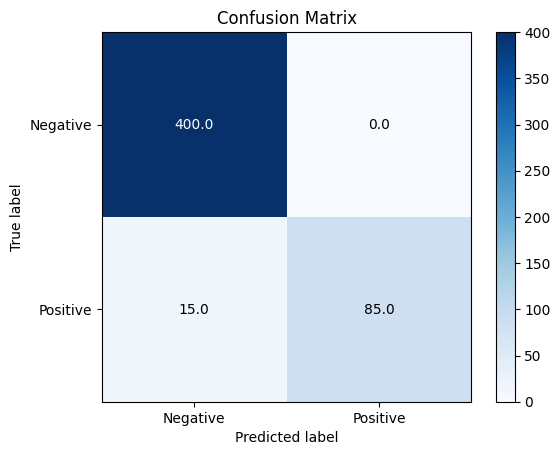

F1 Score: 0.9189189189189189
Accuracy: 0.97
Sensitivity: 0.8500000238418579
Specificity: 1.0
n =  90


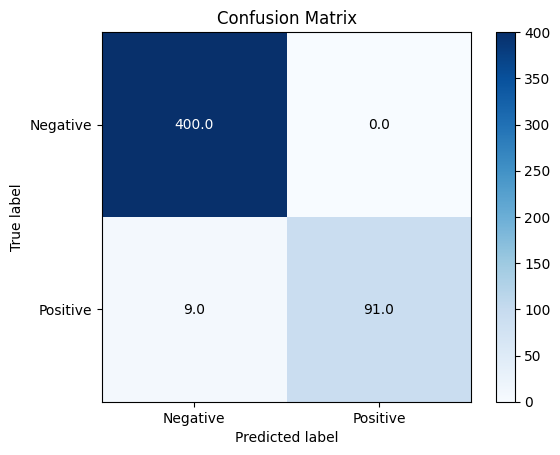

F1 Score: 0.9528795811518325
Accuracy: 0.982
Sensitivity: 0.9100000262260437
Specificity: 1.0
n =  100


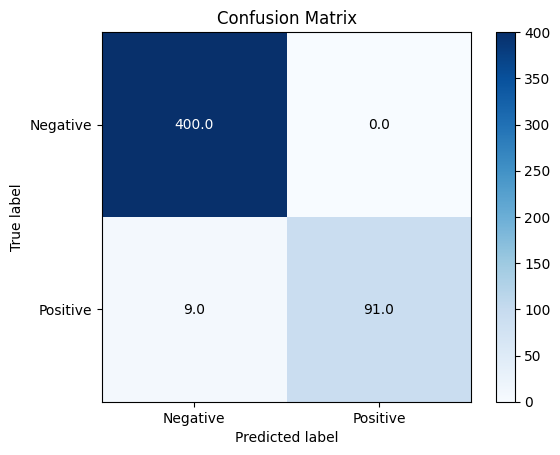

F1 Score: 0.9528795811518325
Accuracy: 0.982
Sensitivity: 0.9100000262260437
Specificity: 1.0
n =  110


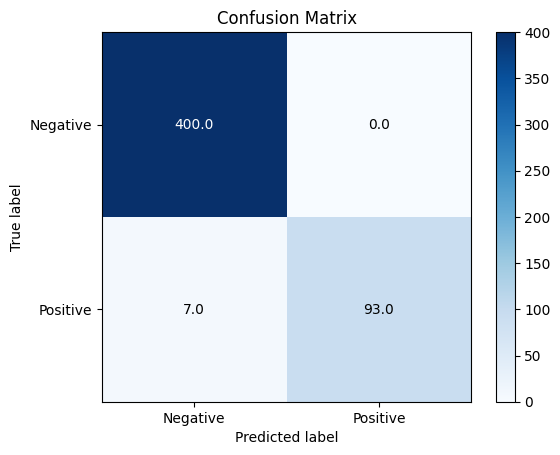

F1 Score: 0.9637305699481865
Accuracy: 0.986
Sensitivity: 0.9300000071525574
Specificity: 1.0
n =  120


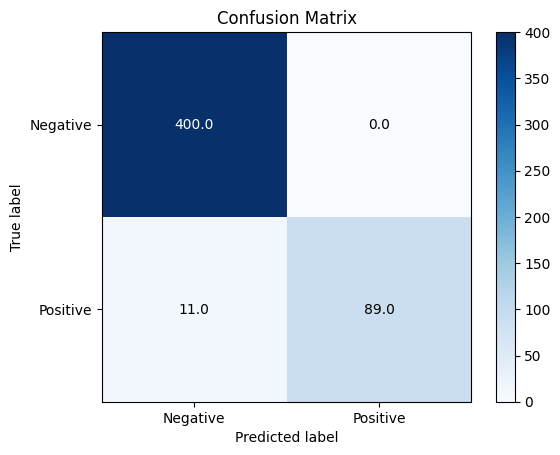

F1 Score: 0.9417989417989417
Accuracy: 0.978
Sensitivity: 0.8899999856948853
Specificity: 1.0
n =  130


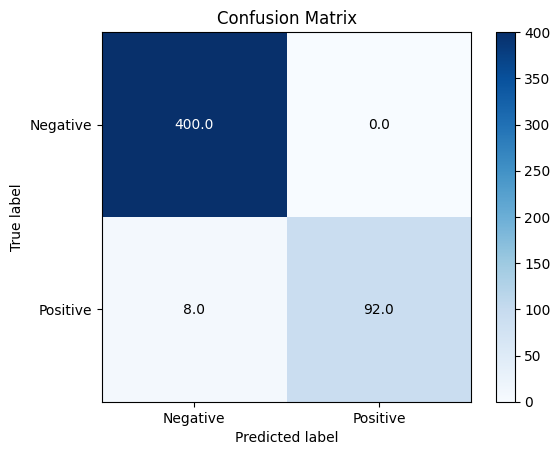

F1 Score: 0.9583333333333334
Accuracy: 0.984
Sensitivity: 0.9200000166893005
Specificity: 1.0
n =  140


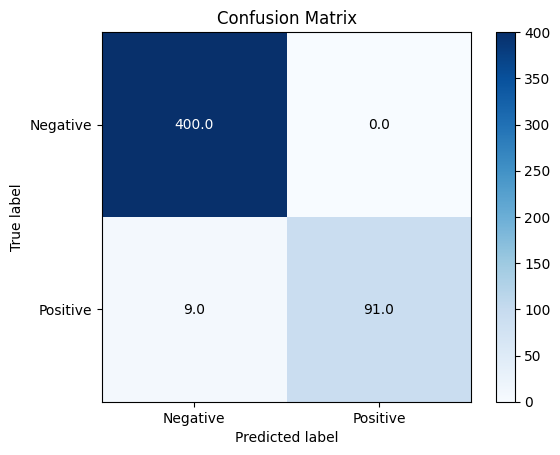

F1 Score: 0.9528795811518325
Accuracy: 0.982
Sensitivity: 0.9100000262260437
Specificity: 1.0
n =  150


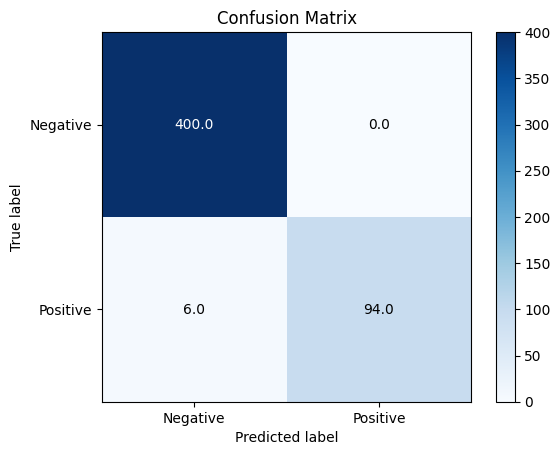

F1 Score: 0.9690721649484536
Accuracy: 0.988
Sensitivity: 0.9399999976158142
Specificity: 1.0
n =  160


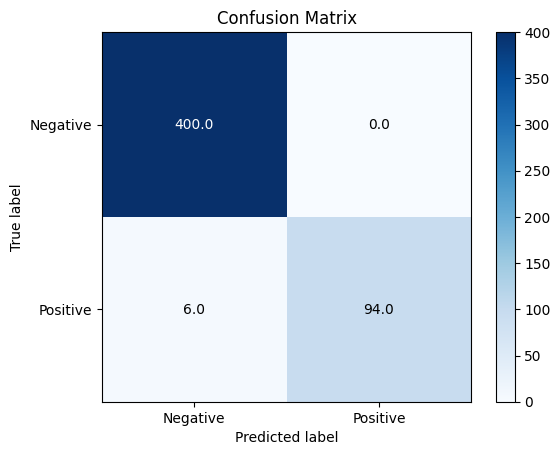

F1 Score: 0.9690721649484536
Accuracy: 0.988
Sensitivity: 0.9399999976158142
Specificity: 1.0
n =  170


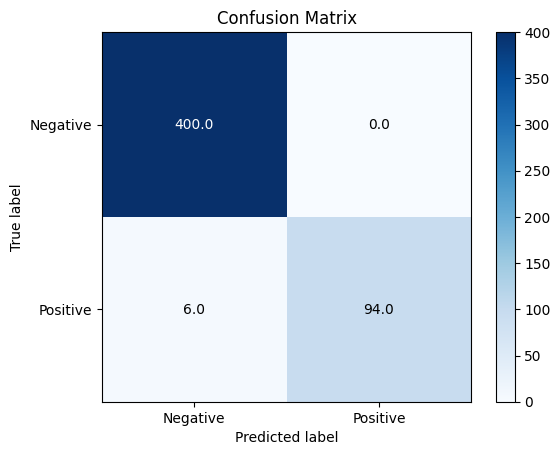

F1 Score: 0.9690721649484536
Accuracy: 0.988
Sensitivity: 0.9399999976158142
Specificity: 1.0
n =  180


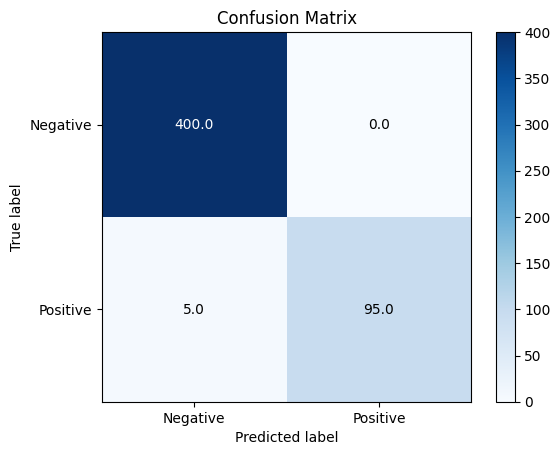

F1 Score: 0.9743589743589743
Accuracy: 0.99
Sensitivity: 0.949999988079071
Specificity: 1.0
n =  190


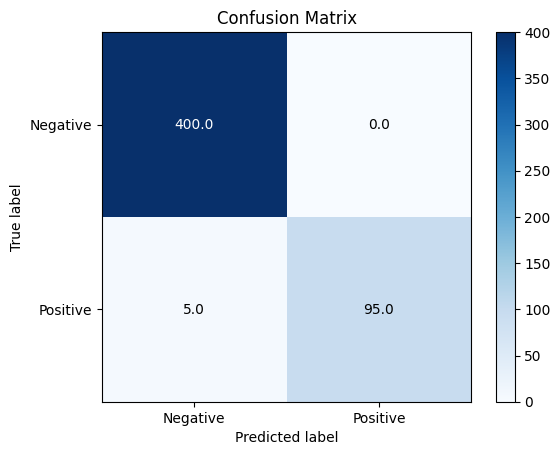

F1 Score: 0.9743589743589743
Accuracy: 0.99
Sensitivity: 0.949999988079071
Specificity: 1.0
n =  200


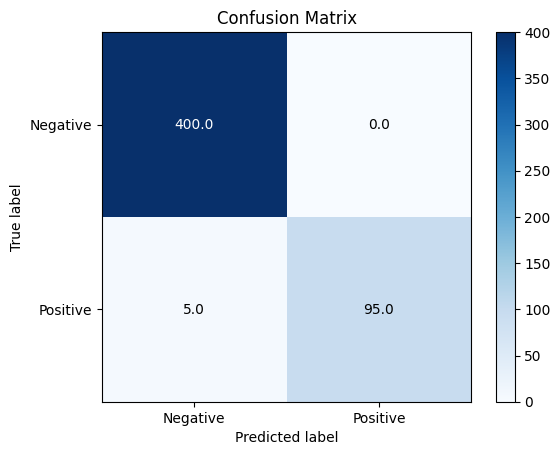

F1 Score: 0.9743589743589743
Accuracy: 0.99
Sensitivity: 0.949999988079071
Specificity: 1.0
n =  210


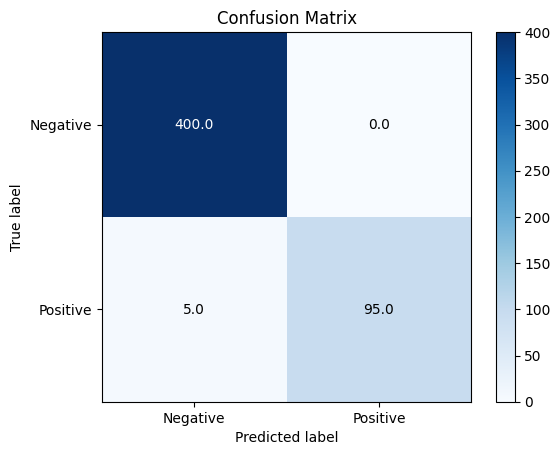

F1 Score: 0.9743589743589743
Accuracy: 0.99
Sensitivity: 0.949999988079071
Specificity: 1.0
n =  220


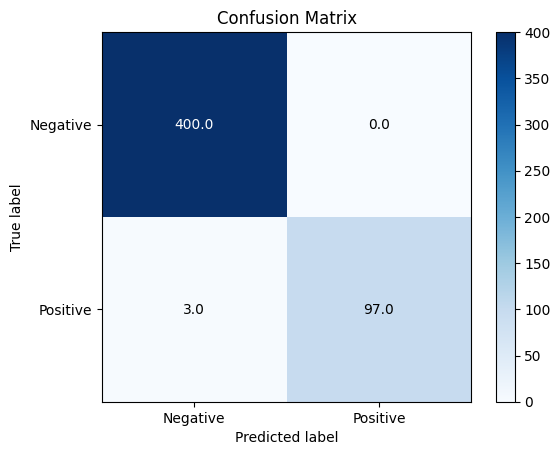

F1 Score: 0.9847715736040609
Accuracy: 0.994
Sensitivity: 0.9700000286102295
Specificity: 1.0
n =  230


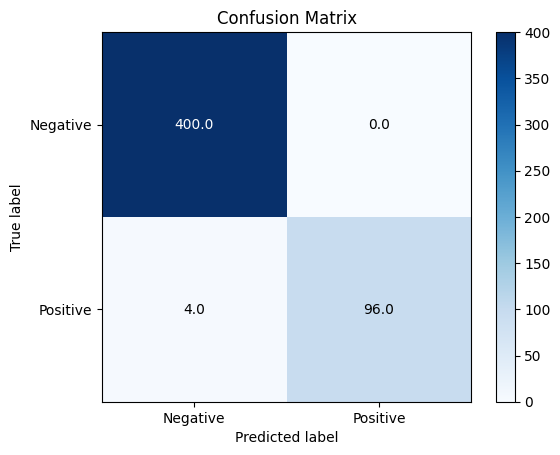

F1 Score: 0.9795918367346939
Accuracy: 0.992
Sensitivity: 0.9599999785423279
Specificity: 1.0
n =  240


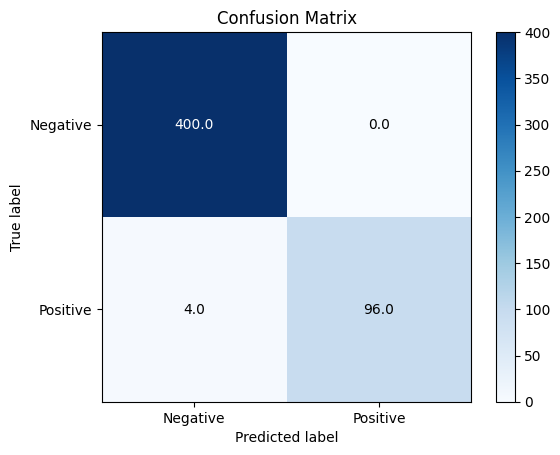

F1 Score: 0.9795918367346939
Accuracy: 0.992
Sensitivity: 0.9599999785423279
Specificity: 1.0
n =  250


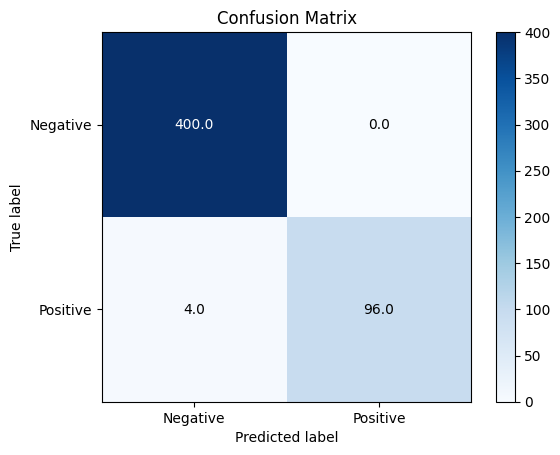

F1 Score: 0.9795918367346939
Accuracy: 0.992
Sensitivity: 0.9599999785423279
Specificity: 1.0
n =  260


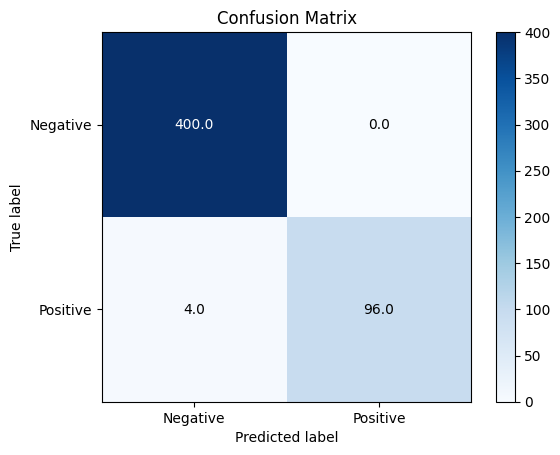

F1 Score: 0.9795918367346939
Accuracy: 0.992
Sensitivity: 0.9599999785423279
Specificity: 1.0
n =  270


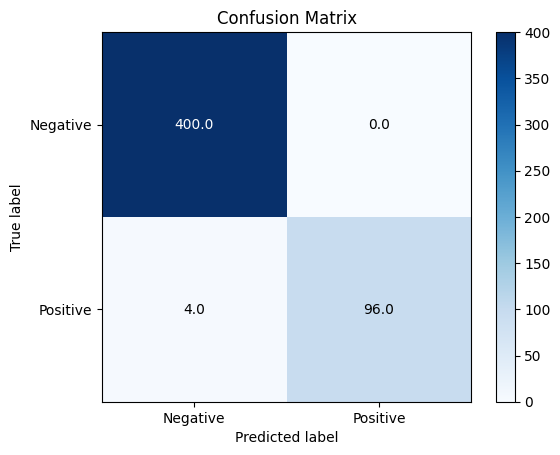

F1 Score: 0.9795918367346939
Accuracy: 0.992
Sensitivity: 0.9599999785423279
Specificity: 1.0
n =  280


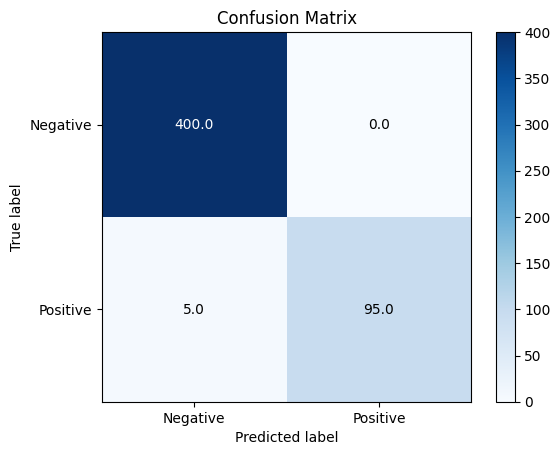

F1 Score: 0.9743589743589743
Accuracy: 0.99
Sensitivity: 0.949999988079071
Specificity: 1.0
n =  290


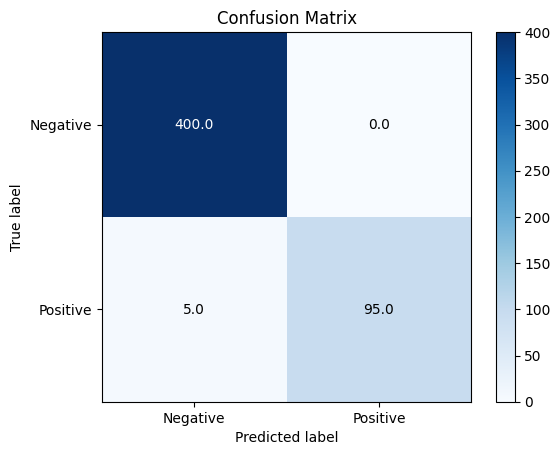

F1 Score: 0.9743589743589743
Accuracy: 0.99
Sensitivity: 0.949999988079071
Specificity: 1.0
n =  300


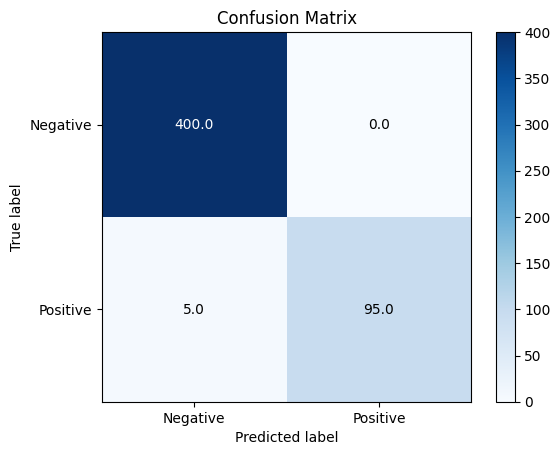

F1 Score: 0.9743589743589743
Accuracy: 0.99
Sensitivity: 0.949999988079071
Specificity: 1.0
n =  310


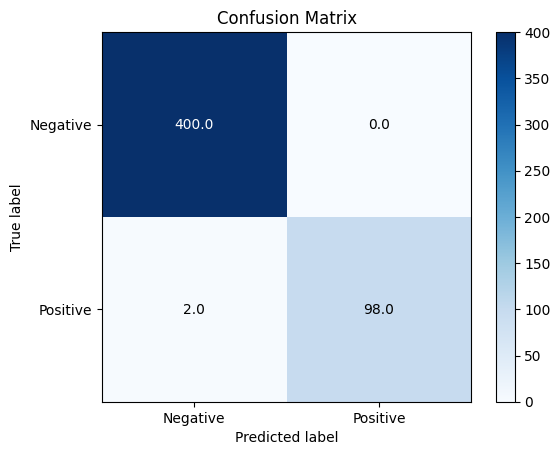

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  320


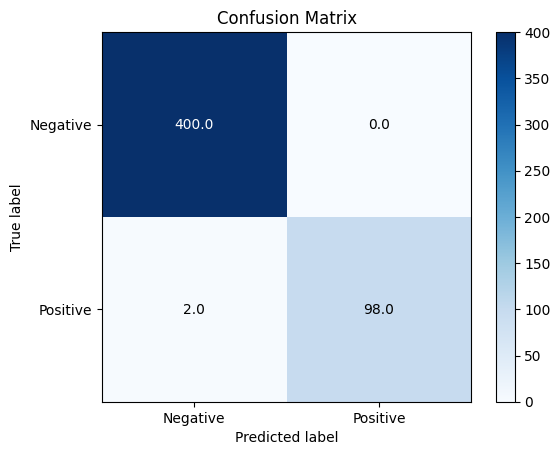

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  330


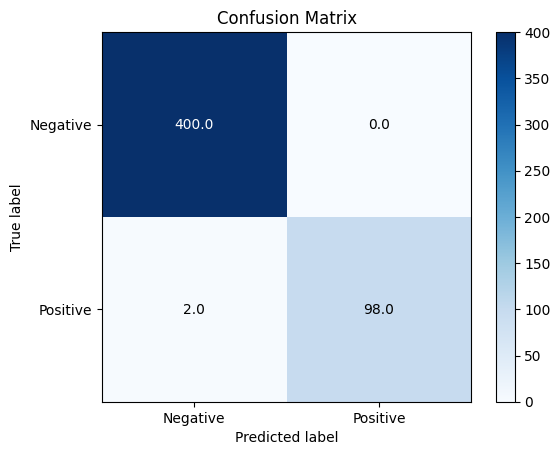

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  340


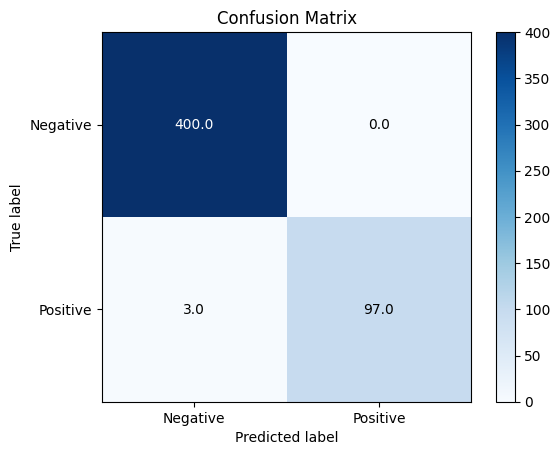

F1 Score: 0.9847715736040609
Accuracy: 0.994
Sensitivity: 0.9700000286102295
Specificity: 1.0
n =  350


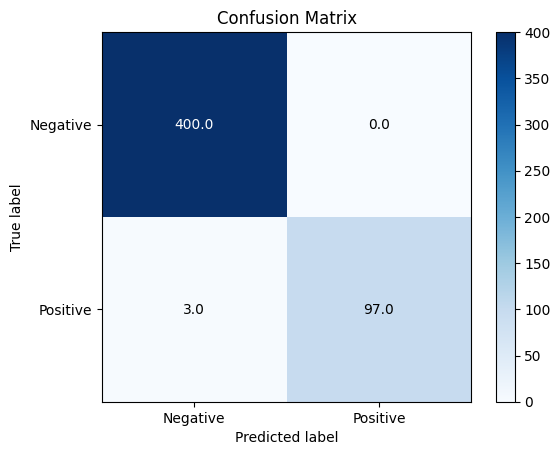

F1 Score: 0.9847715736040609
Accuracy: 0.994
Sensitivity: 0.9700000286102295
Specificity: 1.0
n =  360


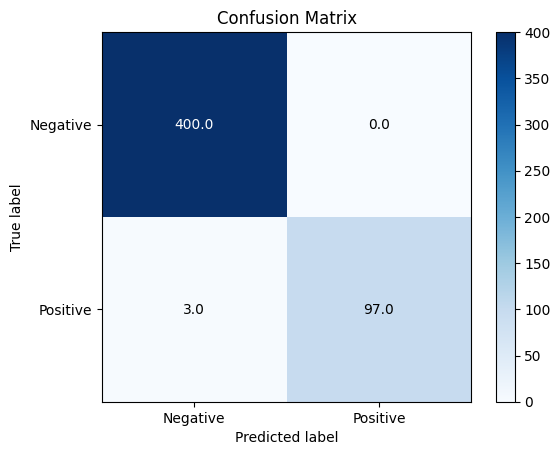

F1 Score: 0.9847715736040609
Accuracy: 0.994
Sensitivity: 0.9700000286102295
Specificity: 1.0
n =  370


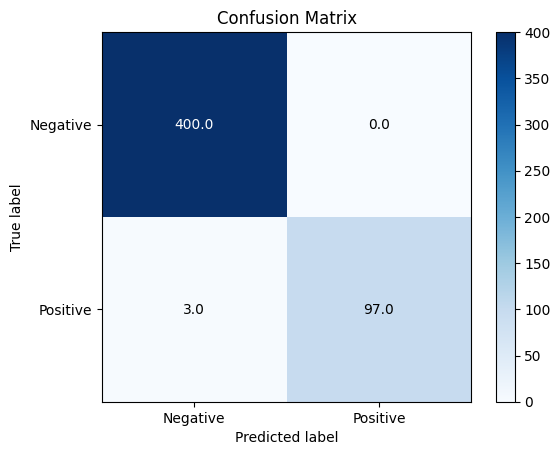

F1 Score: 0.9847715736040609
Accuracy: 0.994
Sensitivity: 0.9700000286102295
Specificity: 1.0
n =  380


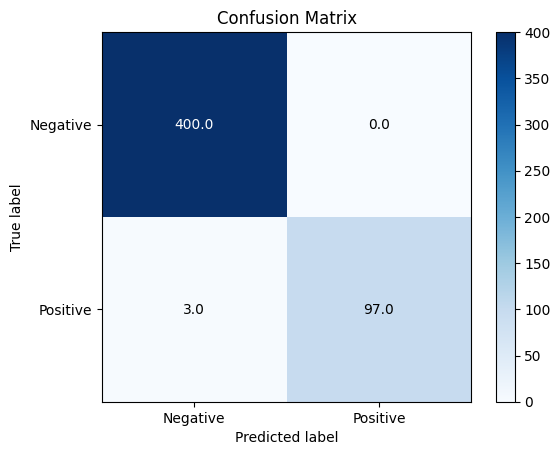

F1 Score: 0.9847715736040609
Accuracy: 0.994
Sensitivity: 0.9700000286102295
Specificity: 1.0
n =  390


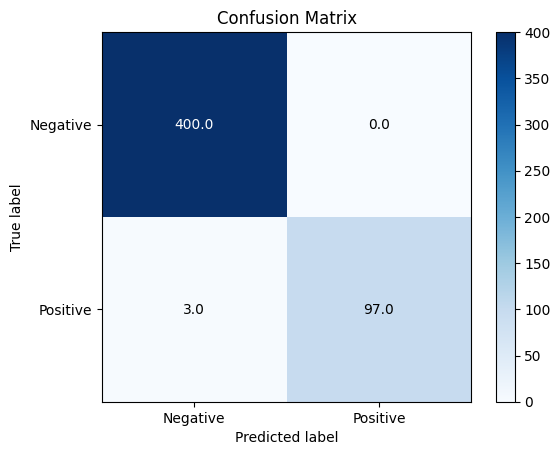

F1 Score: 0.9847715736040609
Accuracy: 0.994
Sensitivity: 0.9700000286102295
Specificity: 1.0
n =  400


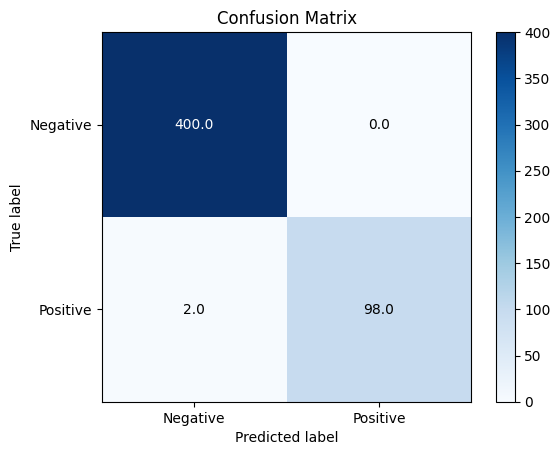

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  410


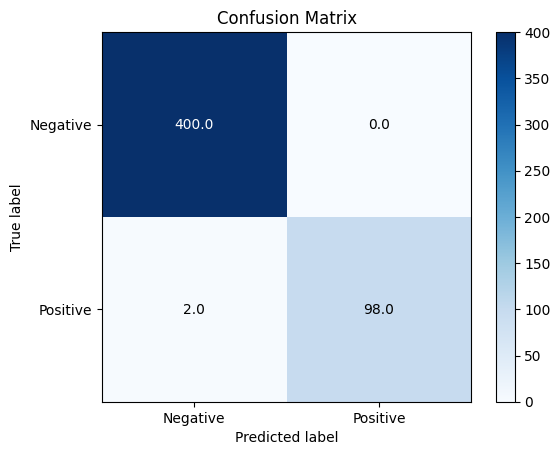

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  420


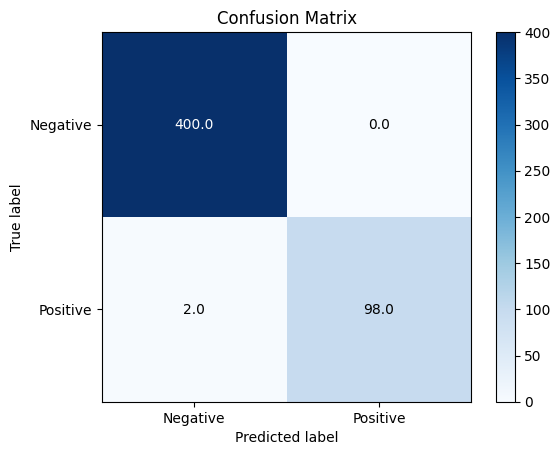

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  430


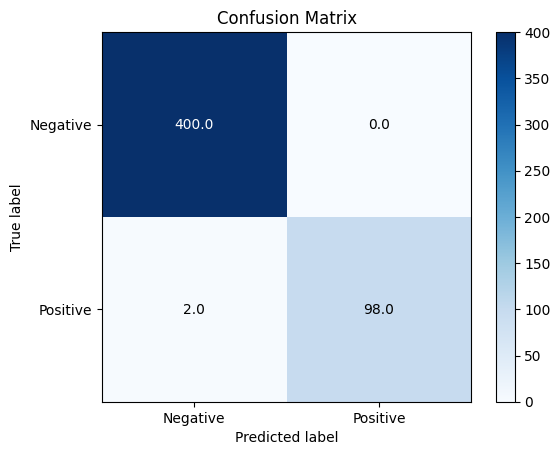

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  440


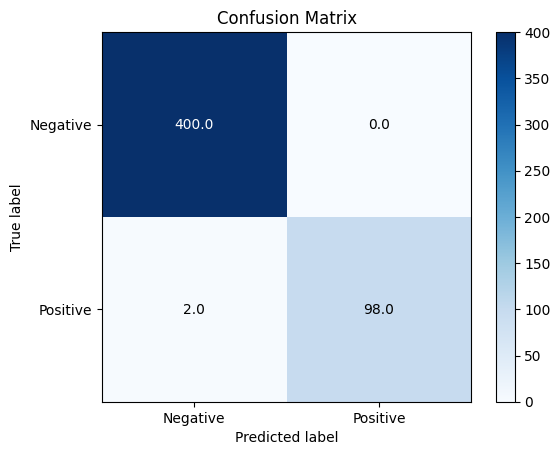

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  450


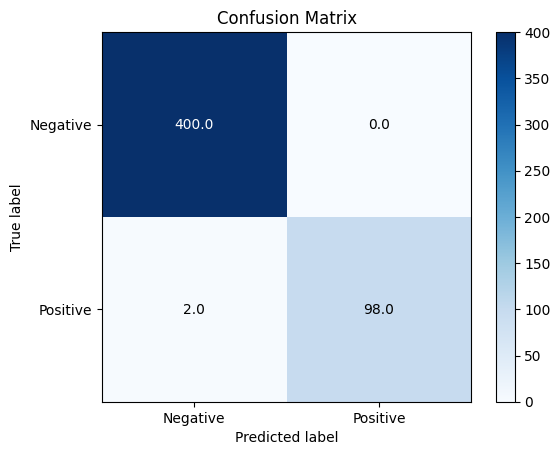

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  460


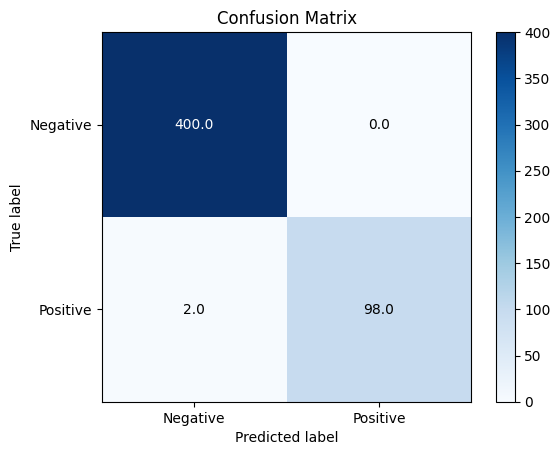

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  470


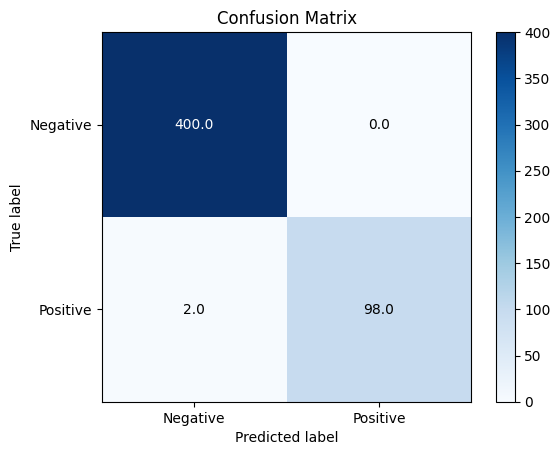

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  480


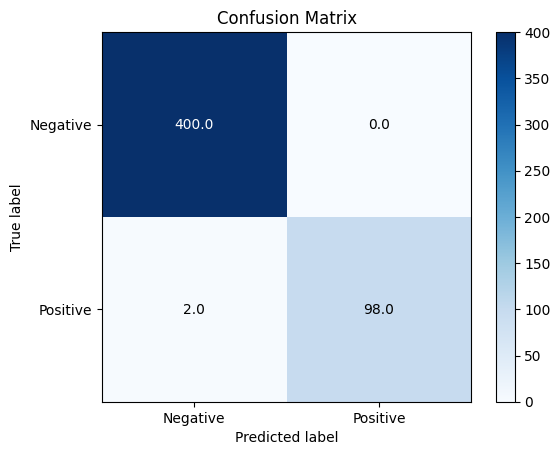

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  490


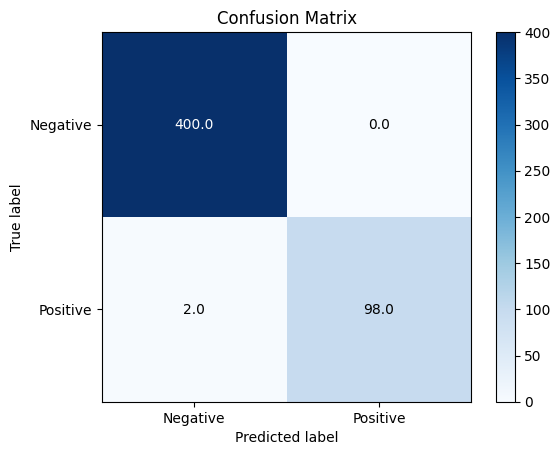

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  500


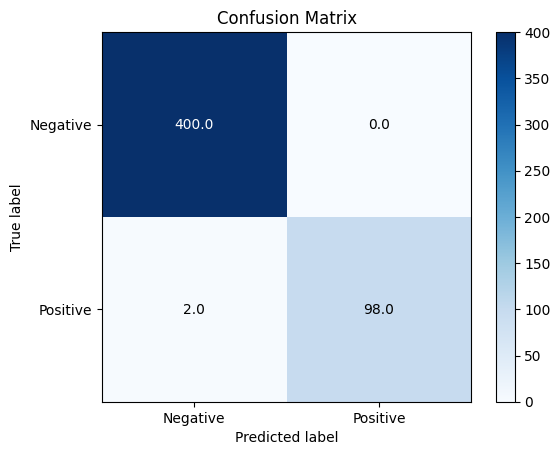

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  510


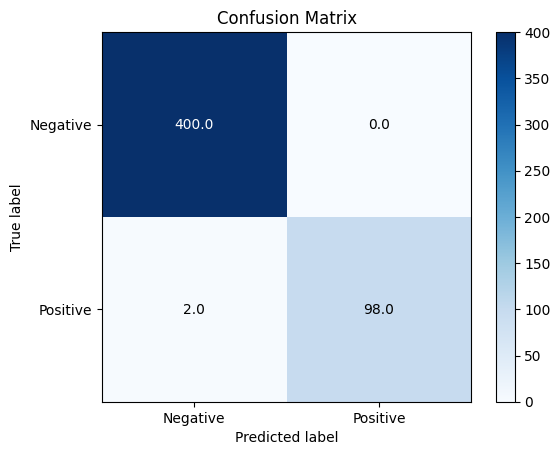

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  520


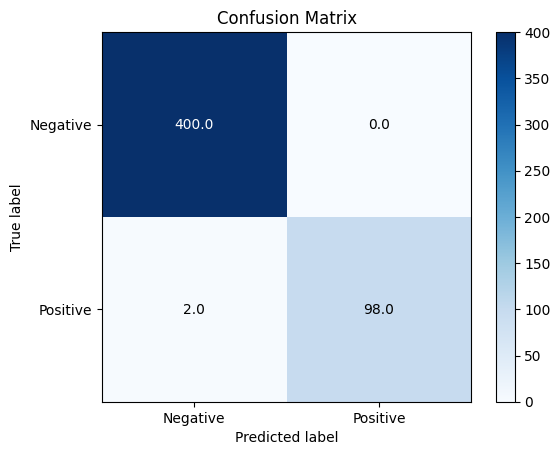

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  530


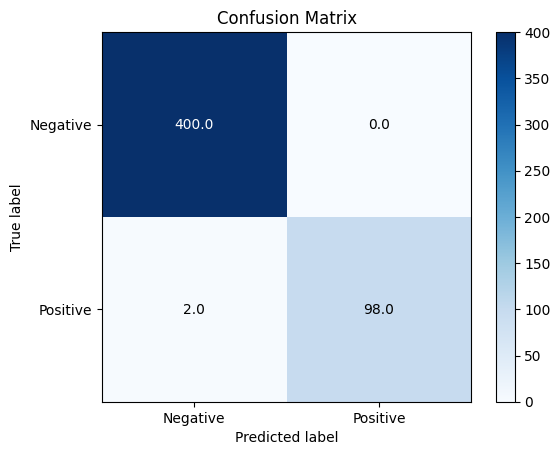

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  540


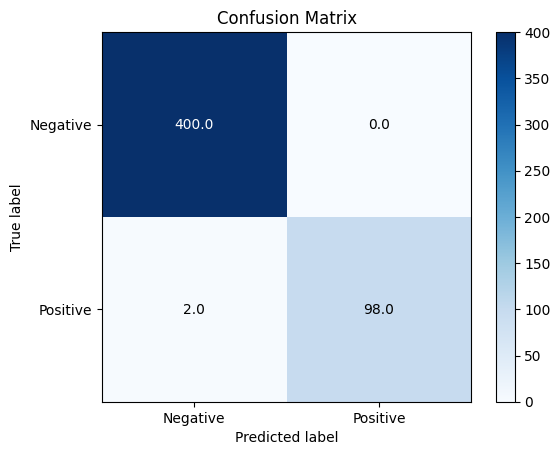

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  550


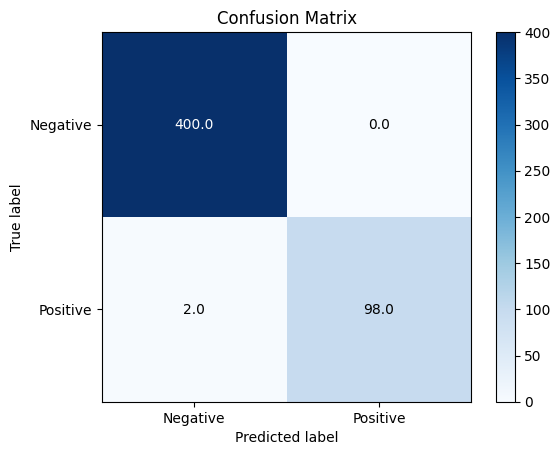

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  560


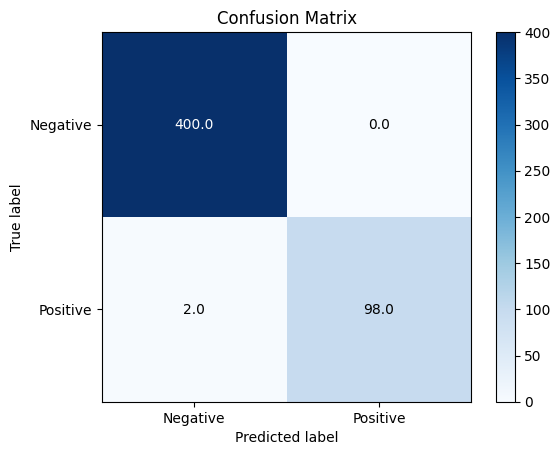

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  570


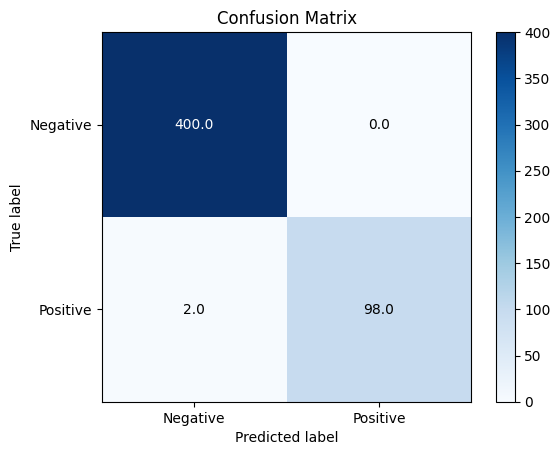

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  580


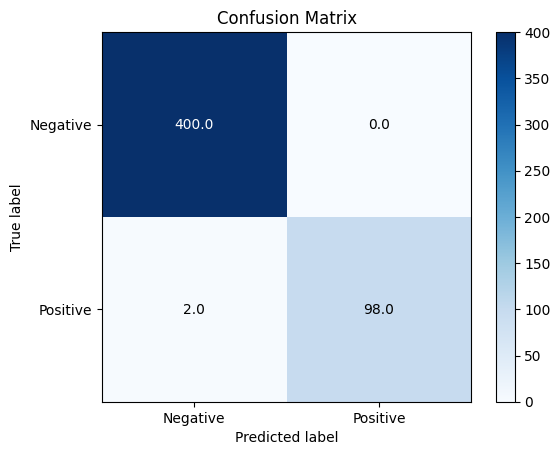

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  590


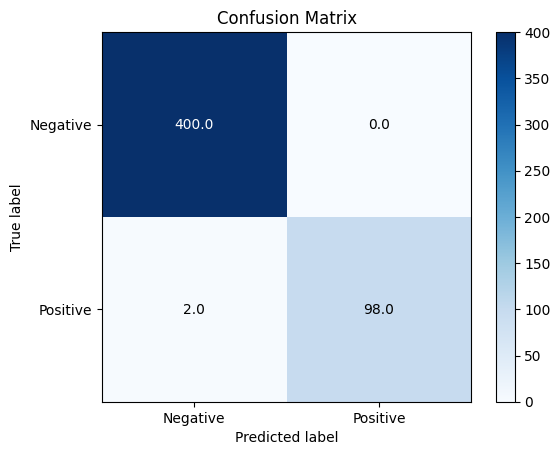

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  600


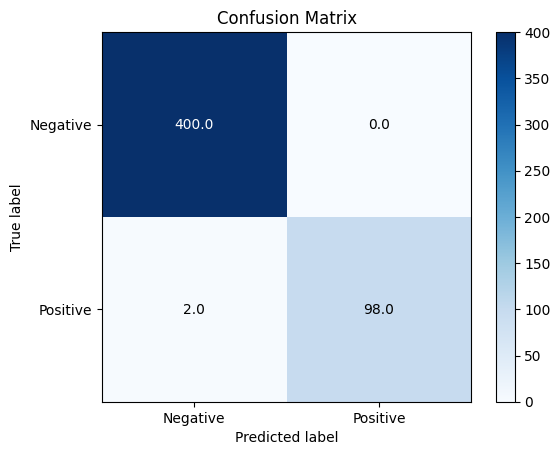

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  610


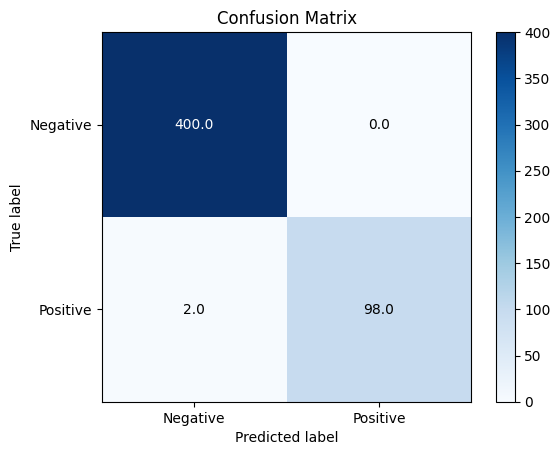

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  620


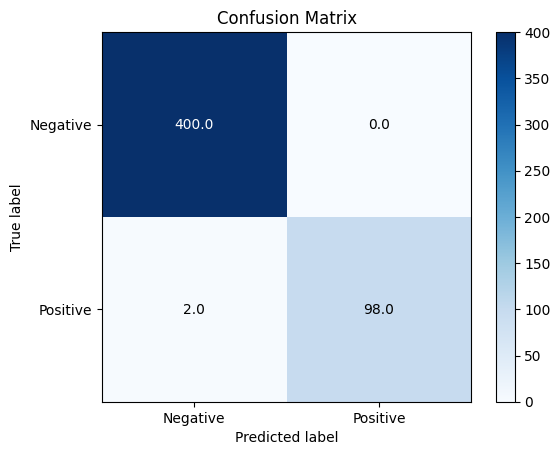

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  630


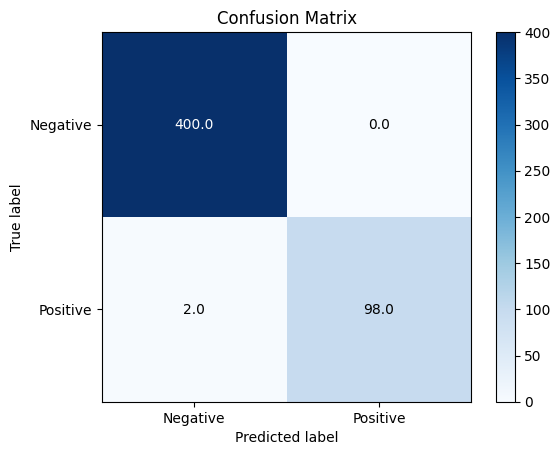

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  640


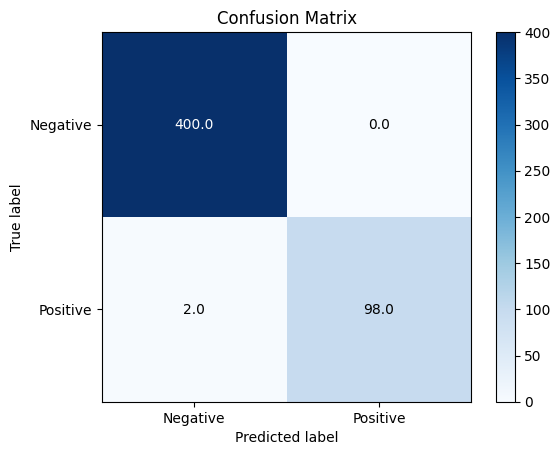

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  650


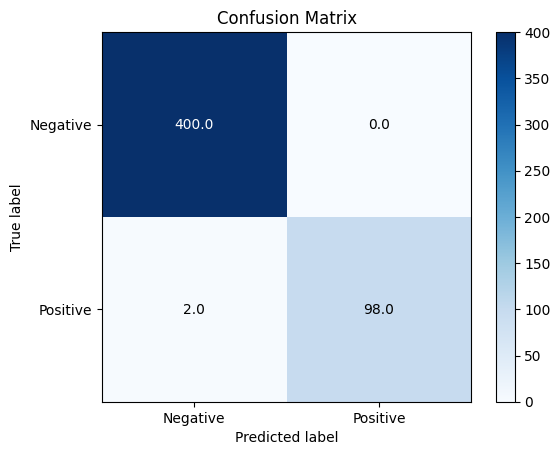

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  660


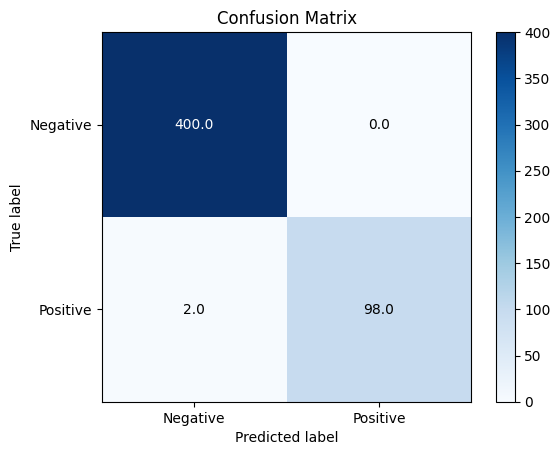

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  670


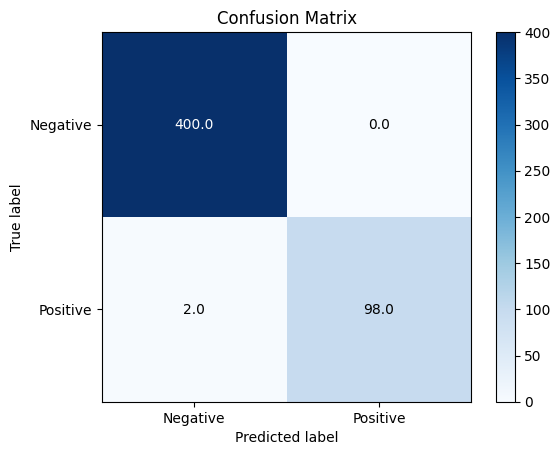

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  680


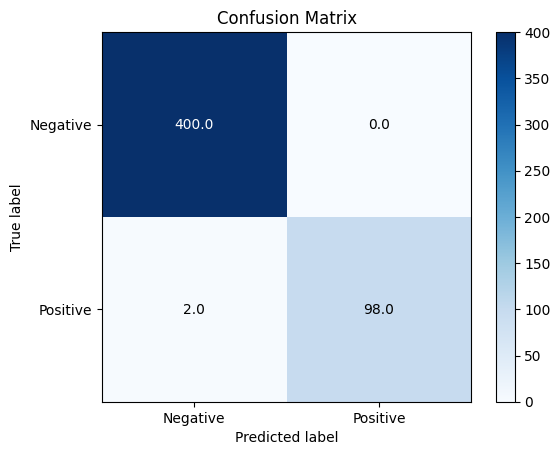

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  690


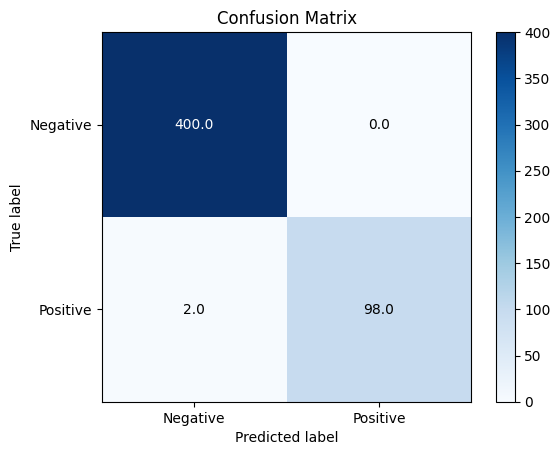

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  700


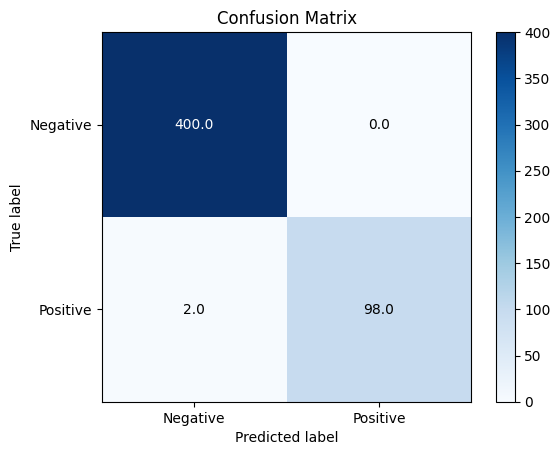

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  710


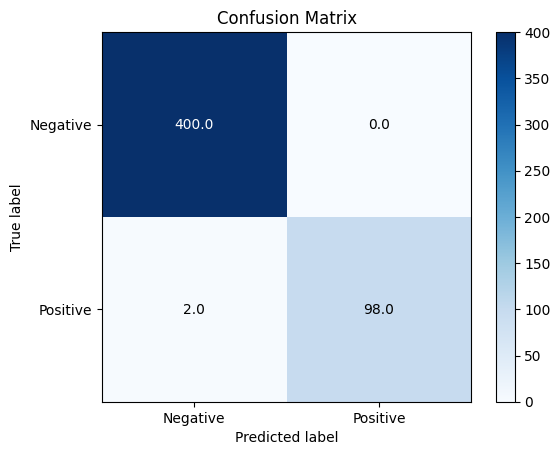

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  720


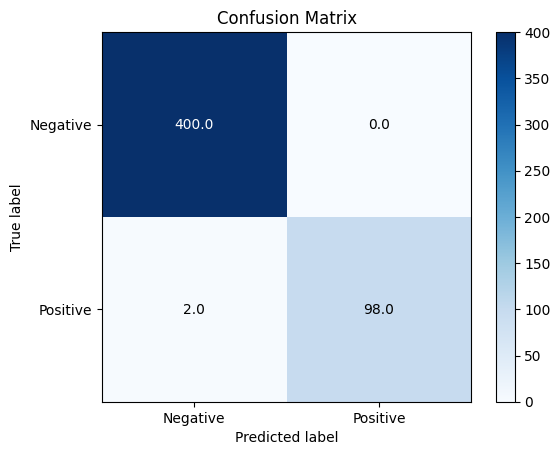

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  730


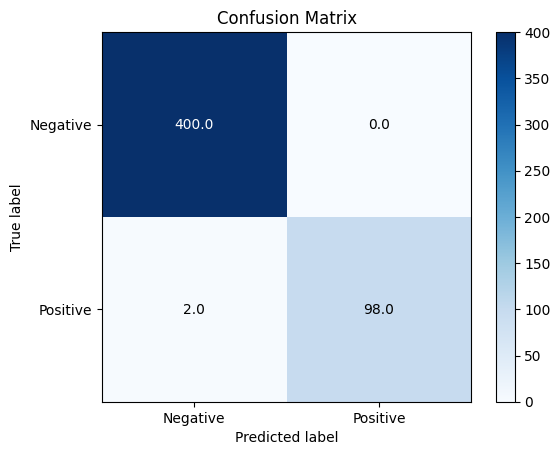

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  740


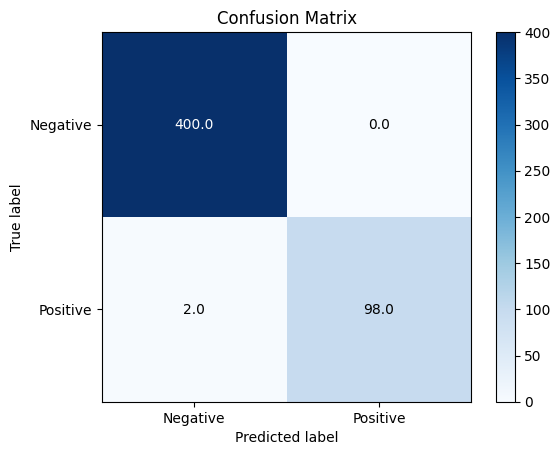

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  750


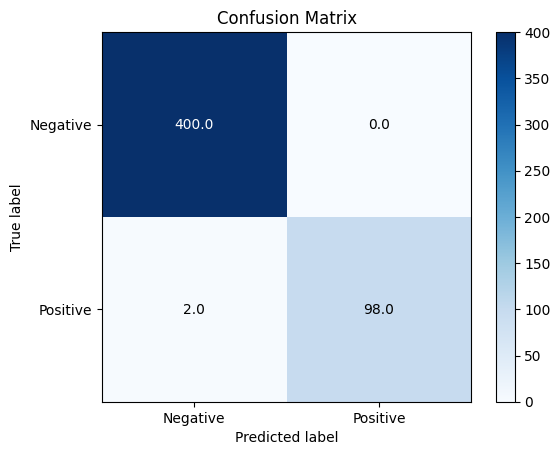

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  760


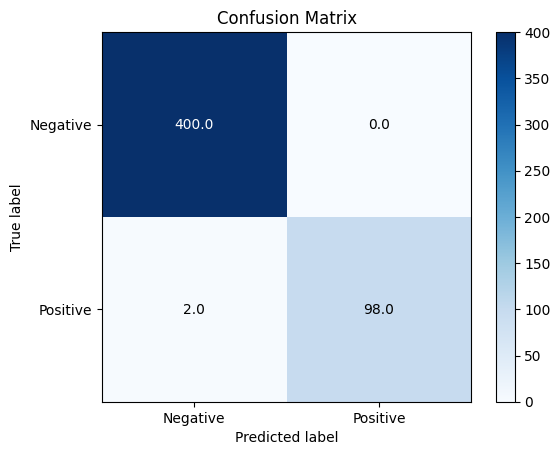

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  770


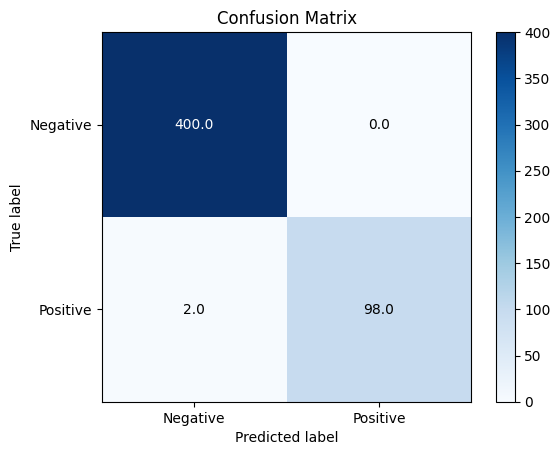

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  780


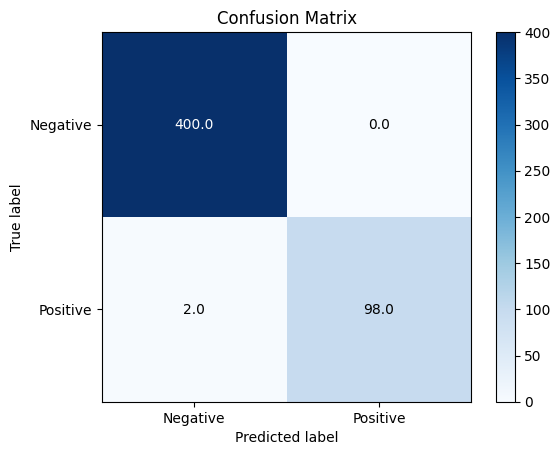

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  790


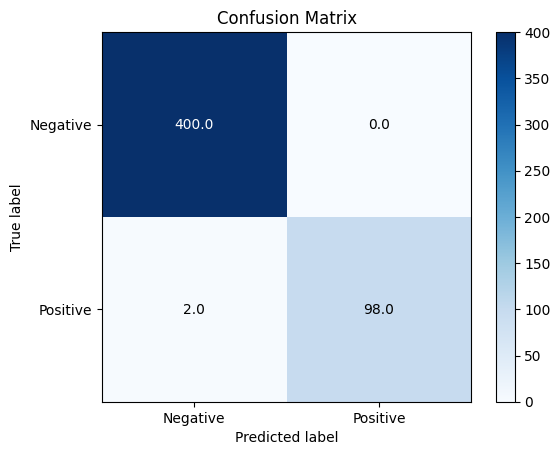

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  800


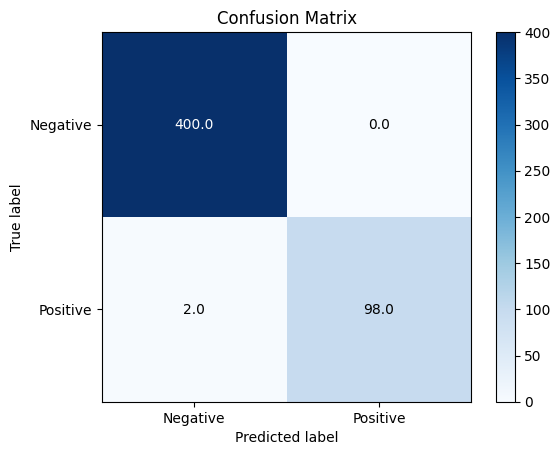

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  810


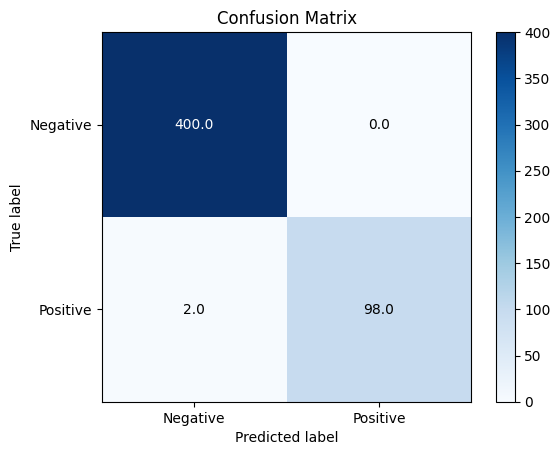

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  820


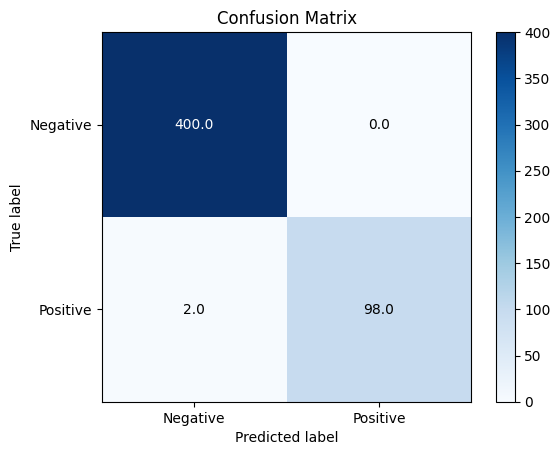

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  830


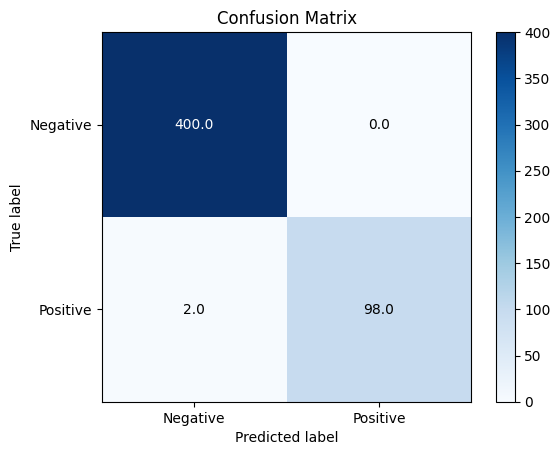

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  840


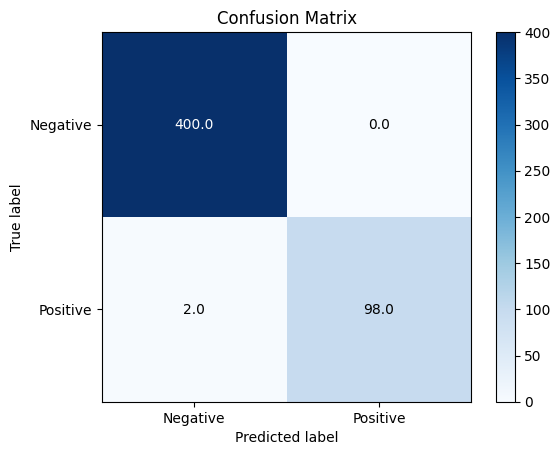

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  850


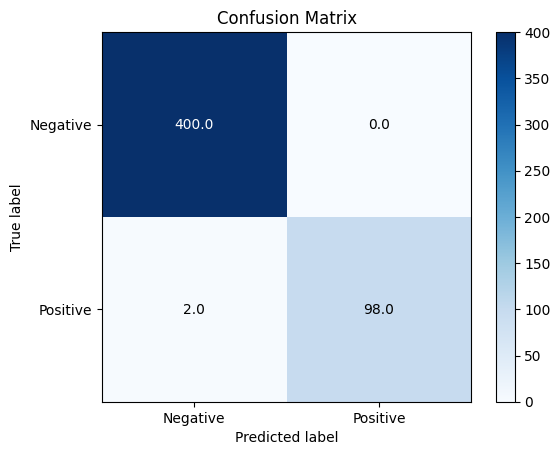

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  860


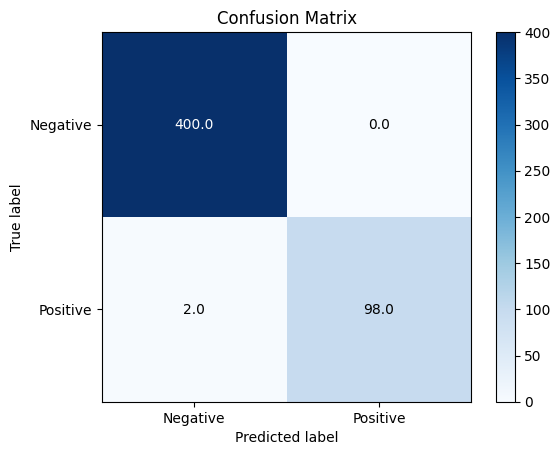

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  870


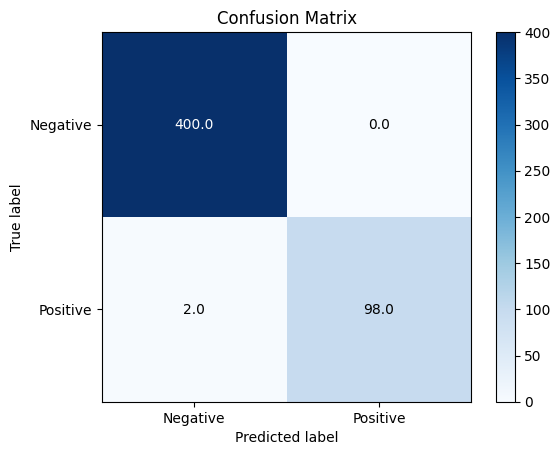

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  880


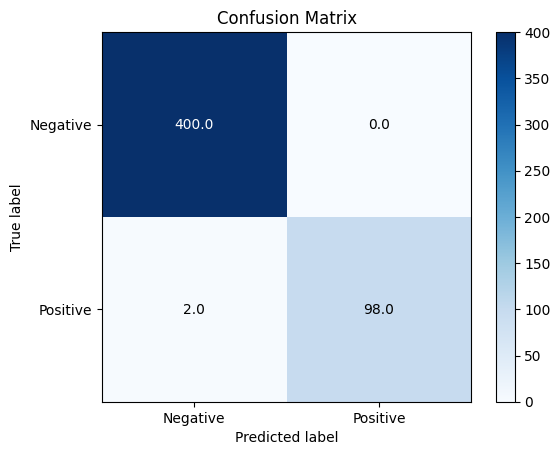

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  890


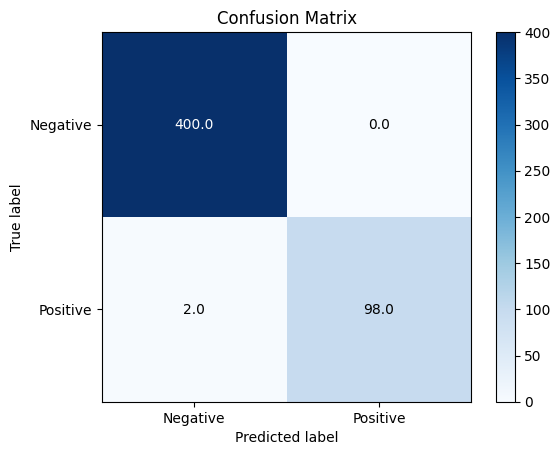

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  900


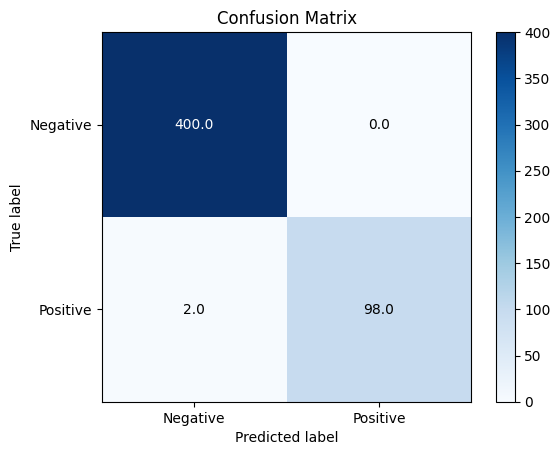

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  910


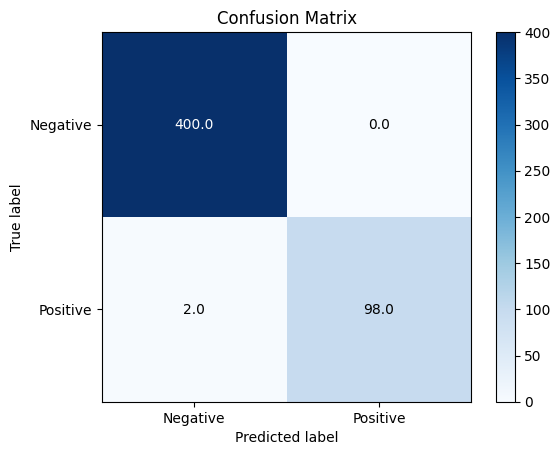

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  920


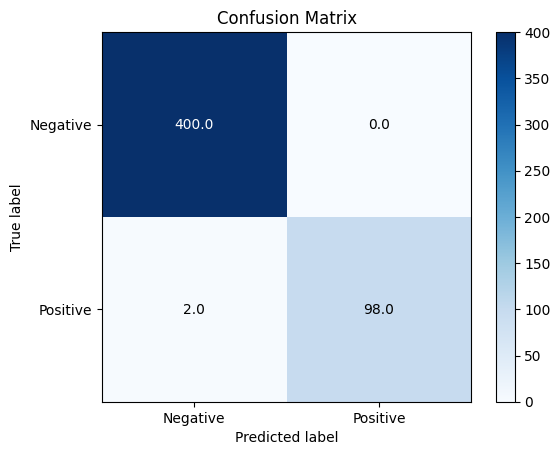

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  930


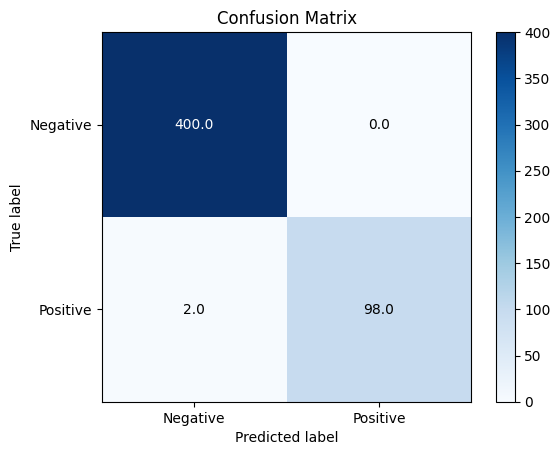

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  940


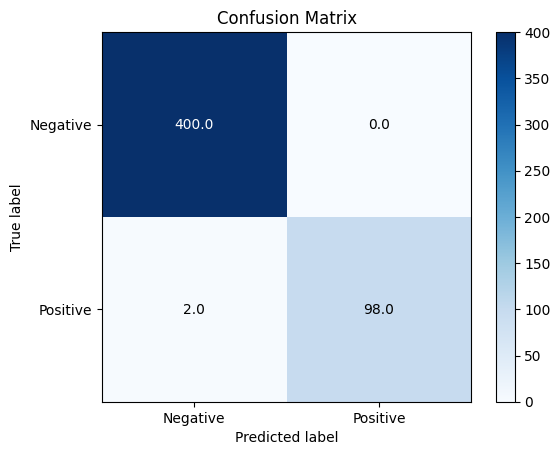

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  950


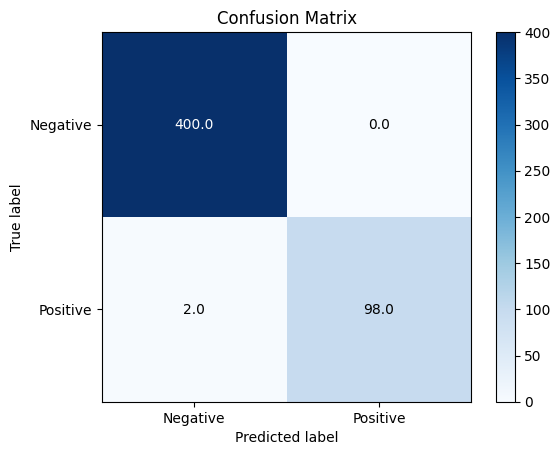

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  960


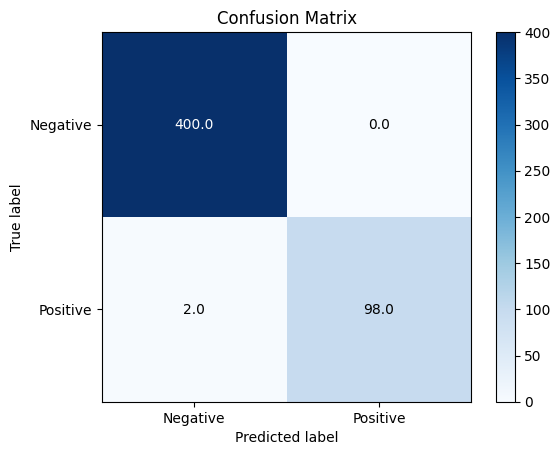

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  970


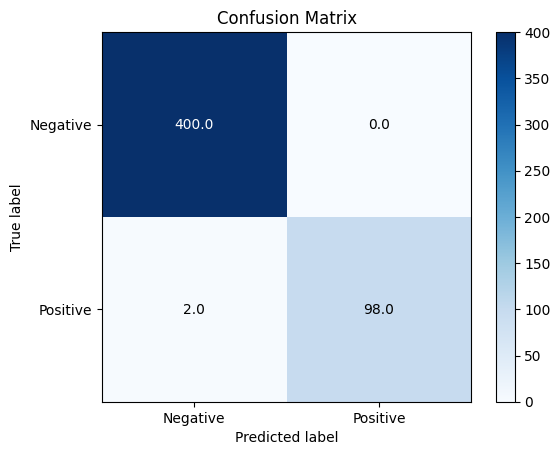

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  980


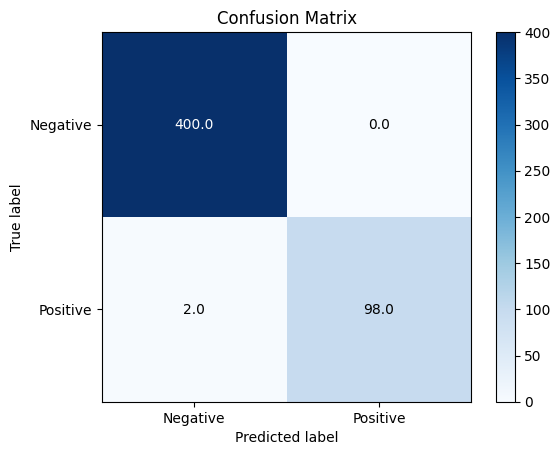

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0
n =  990


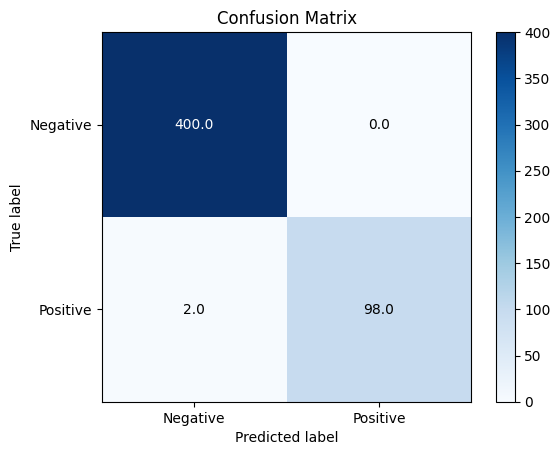

F1 Score: 0.98989898989899
Accuracy: 0.996
Sensitivity: 0.9800000190734863
Specificity: 1.0


In [ ]:
ns = []
f1s = []
for n in range(10,len(train_fixed[hook_name]),10):
  print('n = ', n)
  sk_hook_probe = LogisticRegression(random_state=0+n, max_iter=100000).fit(train_fixed_shuffled[:n].cpu(), train_fixed_labels_shuffled[:n].cpu())
  f1 = evaluate_probe(sk_hook_probe, hook_name, 'sk')
  ns.append(n)
  f1s.append(f1)

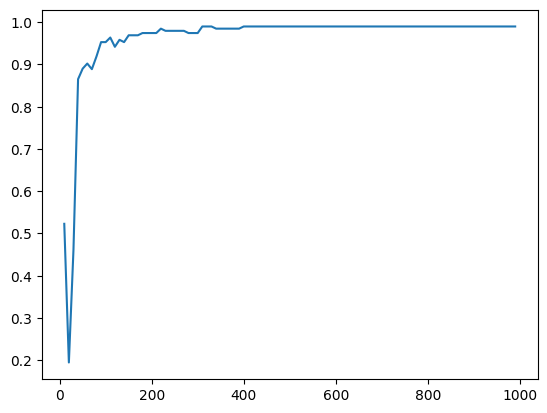

In [ ]:
plt.plot(ns, f1s)

# Looking at trained probes

In [ ]:
dope_bigram_ids[-1]

tensor(4590)

In [ ]:
used_dopes =  [dope_bigram_ids[i].item() for i in range(0,len(dope_bigram_ids),1)]

In [ ]:
#random_fixed = torch.load('/content/drive/MyDrive/thesis/derived_data/probing/random_fixed_7k.pt')

In [ ]:
hook_name_used = 'blocks.1.hook_resid_pre'

In [ ]:
coeffs = []
biases = []
for bigram_id in tqdm(dope_bigram_ids):
  path = join('/content/drive/MyDrive/thesis/derived_data/probing/sk_probes', f'probes_and_preds_{bigram_id}_mod{model_size}.pkl')
  if exists(path):
    coef = torch.tensor(load_pkl(path)[hook_name_used]['probes']['nonadv'].coef_)
    coeffs.append(coef)
    biases = torch.tensor(load_pkl(path)[hook_name_used]['probes']['nonadv'].coef_)
    biases.append(coef)

NameError: ignored

In [ ]:
coefs = torch.stack(coeffs).squeeze()

In [ ]:
coefs.shape

torch.Size([2463, 1024])

In [ ]:
coefs = coefs.to(device)

In [ ]:
hook_coeffs_sim = get_similarity_matrix(coefs) #coeffs_combi_sim

In [ ]:
coefs.shape

torch.Size([2463, 1024])

In [ ]:
close_thres = 0.20
close_bys = ((hook_coeffs_sim > close_thres).float().sum() - hook_coeffs_sim.shape[0]) / 2

In [ ]:
close_bys_denom = (hook_coeffs_sim.numel() - hook_coeffs_sim.shape[0]) / 2

In [ ]:
close_bys / close_bys_denom

tensor(0.0139, device='cuda:0')

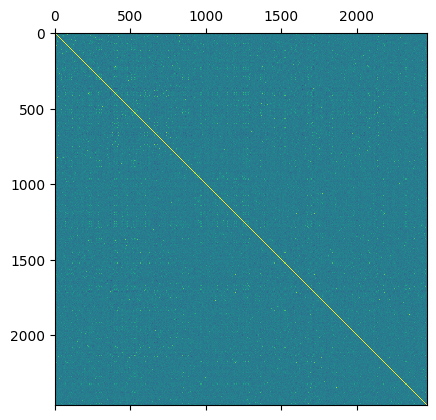

In [ ]:
plt.matshow(hook_coeffs_sim.cpu())

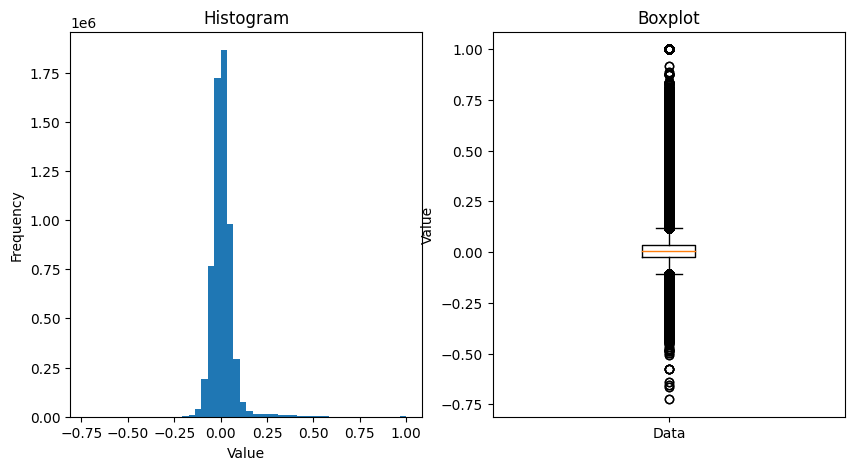

In [ ]:
hist_and_box(hook_coeffs_sim.reshape(-1))

In [ ]:
import torch

# Create a symmetric 2D tensor as an example
tensor = hook_coeffs_sim

# Get the upper triangular part of the matrix (without the diagonal)
upper_triangular = torch.triu(tensor, diagonal=1)

# Find the indices of the highest values
values, indices = torch.topk(upper_triangular.view(-1), k=3)

print(f"Highest values: {values}")
print(f"Indices in the flattened upper-triangular matrix: {indices}")

# Convert the indices in the flattened tensor back to 2D indices
rows = indices // tensor.size(1)
cols = indices % tensor.size(1)
print(f"2D indices of highest values in the original matrix: {list(zip(rows.tolist(), cols.tolist()))}")


Highest values: tensor([0.9173, 0.8872, 0.8791], device='cuda:0', dtype=torch.float64)
Indices in the flattened upper-triangular matrix: tensor([3868888, 4504706, 2368543], device='cuda:0')
2D indices of highest values in the original matrix: [(1570, 1978), (1828, 2342), (961, 1600)]


In [ ]:
n_threshold_neighbors = (upper_triangular > close_thres).float().sum(dim=-1)

In [ ]:
(n_threshold_neighbors > 20).float().sum()

tensor(635., device='cuda:0')

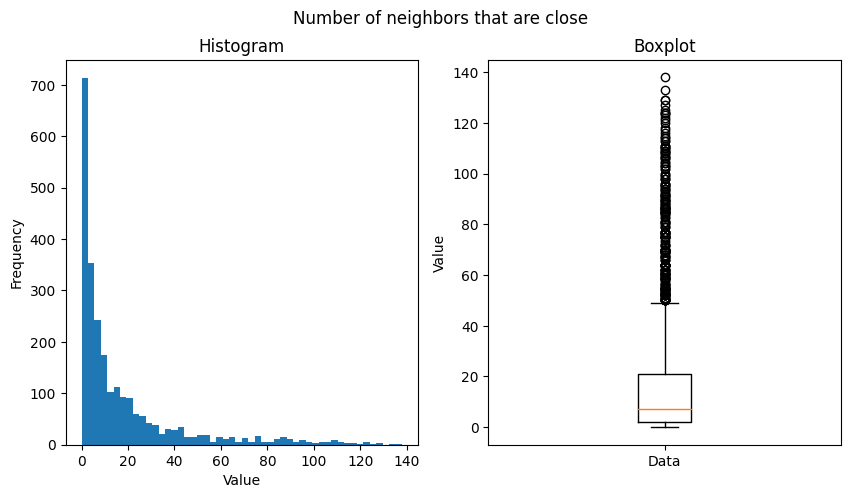

In [ ]:
hist_and_box((upper_triangular > 0.2).float().sum(dim=-1),title='Number of neighbors that are close')

In [ ]:
(a,b) = (1570, 1978)

In [ ]:
hook_coeffs_sim[a, b]

tensor(0.9173, device='cuda:0', dtype=torch.float64)

In [ ]:
(a_id, b_id) = used_dopes[a], used_dopes[b]

In [ ]:
print_bigram_id(a_id)

tensor([1705,  281]) ' come to'


In [ ]:
print_bigram_id(b_id)

tensor([2210,  281]) ' came to'


In [ ]:
a_sim = get_similarity_cross(model.embed.W_E.detach(), model.embed.W_E.detach()[1705].reshape(1,-1)).reshape(-1)

In [ ]:
a_sim_sort = torch.sort(a_sim, descending=True)

In [ ]:
torch.argwhere(a_sim_sort.indices == 2210)

tensor([[1]], device='cuda:0')

In [ ]:
a_sim_sort

torch.return_types.sort(
values=tensor([ 1.0000,  0.6780,  0.6535,  ..., -0.1484, -0.1503, -0.1568],
       device='cuda:0'),
indices=tensor([ 1705,  2210, 13516,  ..., 39354, 25874, 45966], device='cuda:0'))

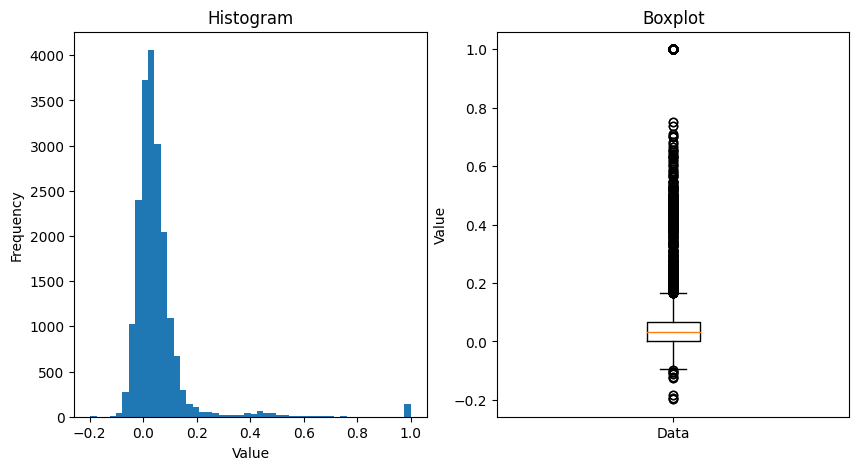

In [ ]:
hist_and_box(hook_coeffs_sim.reshape(-1))

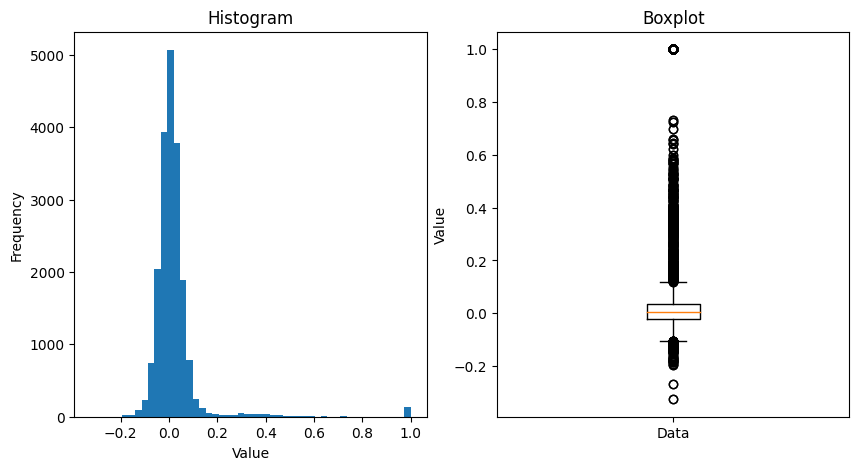

In [ ]:
hist_and_box(hook_coeffs_sim.reshape(-1))

In [ ]:
(upper_triangular > 0.2).float().sum()

tensor(35.)

In [ ]:
od_fpr_dict_list = []
hook_vecs_dict = {}
sk_probes_dict = {}
for bigram_id in used_dopes:
  print('bigram_id', bigram_id)
  sk_hook_probes = load_pkl(join('/content/drive/MyDrive/thesis/derived_data/probing/sk_probes', f'probes_and_preds_{bigram_id}_mod{model_size}.pkl'))
  od_fpr_dict = {'bigram_id': bigram_id}
  hook_vecs = {}
  sk_probes_dict[bigram_id] = sk_hook_probes
  for hook_name in hook_names:
    #print('hn', hook_name)
    hook_vec = torch.tensor(sk_hook_probes[hook_name]['probes']['combi'].coef_, dtype=torch.float32).reshape(-1)
    hook_vecs[hook_name] = hook_vec
    hook_bias = torch.tensor(sk_hook_probes[hook_name]['probes']['combi'].intercept_)
    logits = random_fixed[hook_name] @ hook_vec + hook_bias

    sk_fp_idxs = np.argwhere(sk_hook_probes[hook_name]['probes']['combi'].predict(random_fixed[hook_name]) != 0.)
    fp_idxs = torch.argwhere(logits > 0.).reshape(-1)
    assert sk_fp_idxs.shape[0] == fp_idxs.shape[0]
    od_fpr = fp_idxs.shape[0] / len(random_fixed[hook_name])
    #print('od-fpr', od_fpr)
    od_fpr_dict[hook_name] = od_fpr
  od_fpr_dict_list.append(od_fpr_dict)
  hook_vecs_dict[bigram_id] = hook_vecs
    #dotprods = random_fixed[hook_name] @ hook_vec
    #skew = skewness(logits)
    #skew_percentile = (skew > rand_skews).float().mean()
    #print('skew', skewness(logits).item(), skew_percentile)

bigram_id 0


RuntimeError: ignored

In [ ]:
od_fpr_dict_list = []
hook_vecs_dict = {}
sk_probes_dict = {}
for bigram_id in used_dopes:
  print('bigram_id', bigram_id)
  (sk_hook_probes, sk_hook_preds) = load_pkl(
    join('/content/drive/MyDrive/thesis/derived_data/probing/sk_probes', f'probes_and_preds_{bigram_id}.pkl'))
  od_fpr_dict = {'bigram_id': bigram_id}
  hook_vecs = {}
  sk_probes_dict[bigram_id] = sk_hook_probes
  for hook_name in hook_names:
    #print('hn', hook_name)
    hook_vec = torch.tensor(sk_hook_probes[hook_name].coef_, dtype=torch.float32).reshape(-1)
    hook_vecs[hook_name] = hook_vec
    hook_bias = torch.tensor(sk_hook_probes[hook_name].intercept_)
    logits = random_fixed[hook_name] @ hook_vec + hook_bias

    sk_fp_idxs = np.argwhere(sk_hook_probes[hook_name].predict(random_fixed[hook_name]) != 0.)
    fp_idxs = torch.argwhere(logits > 0.).reshape(-1)
    assert sk_fp_idxs.shape[0] == fp_idxs.shape[0]
    od_fpr = fp_idxs.shape[0] / len(random_fixed[hook_name])
    #print('od-fpr', od_fpr)
    od_fpr_dict[hook_name] = od_fpr
  od_fpr_dict_list.append(od_fpr_dict)
  hook_vecs_dict[bigram_id] = hook_vecs
    #dotprods = random_fixed[hook_name] @ hook_vec
    #skew = skewness(logits)
    #skew_percentile = (skew > rand_skews).float().mean()
    #print('skew', skewness(logits).item(), skew_percentile)

bigram_id 0
bigram_id 10
bigram_id 20
bigram_id 30
bigram_id 41
bigram_id 52
bigram_id 62
bigram_id 75
bigram_id 86
bigram_id 99
bigram_id 112
bigram_id 125
bigram_id 136
bigram_id 147
bigram_id 157
bigram_id 167
bigram_id 178
bigram_id 189
bigram_id 200
bigram_id 212
bigram_id 222
bigram_id 234
bigram_id 245
bigram_id 256
bigram_id 267
bigram_id 280
bigram_id 294
bigram_id 306
bigram_id 317
bigram_id 327
bigram_id 338
bigram_id 349
bigram_id 359
bigram_id 370
bigram_id 380
bigram_id 390
bigram_id 402
bigram_id 415
bigram_id 425
bigram_id 439
bigram_id 450
bigram_id 460
bigram_id 470
bigram_id 481
bigram_id 492
bigram_id 504
bigram_id 514
bigram_id 527
bigram_id 538
bigram_id 549
bigram_id 559
bigram_id 571
bigram_id 581
bigram_id 592
bigram_id 602
bigram_id 613
bigram_id 625
bigram_id 636
bigram_id 646
bigram_id 656
bigram_id 666
bigram_id 677
bigram_id 689
bigram_id 699
bigram_id 710
bigram_id 721
bigram_id 731
bigram_id 743
bigram_id 756
bigram_id 769
bigram_id 780
bigram_id 791
big

In [ ]:
od_fpr_df = pd.DataFrame(od_fpr_dict_list)

In [ ]:
od_fpr_df['blocks.1.hook_resid_pre']

0      0.012422
1      0.001141
2      0.001141
3      0.000634
4      0.000761
         ...   
242    0.000127
243    0.000000
244    0.000634
245    0.000000
246    0.000127
Name: blocks.1.hook_resid_pre, Length: 247, dtype: float64

In [ ]:
od_fpr_df.max()

bigram_id                  4211.000000
blocks.0.hook_resid_pre       0.000000
blocks.0.hook_attn_out        0.015591
blocks.0.hook_mlp_out         0.000507
blocks.1.hook_resid_pre       0.012422
blocks.1.hook_attn_out        0.040563
blocks.1.hook_mlp_out         0.015465
blocks.2.hook_resid_pre       0.014831
blocks.2.hook_attn_out        0.027000
blocks.2.hook_mlp_out         0.016859
dtype: float64

In [ ]:
od_fpr_df.mean()

bigram_id                  1456.971660
blocks.0.hook_resid_pre       0.000000
blocks.0.hook_attn_out        0.000977
blocks.0.hook_mlp_out         0.000002
blocks.1.hook_resid_pre       0.000339
blocks.1.hook_attn_out        0.002019
blocks.1.hook_mlp_out         0.001934
blocks.2.hook_resid_pre       0.001144
blocks.2.hook_attn_out        0.002455
blocks.2.hook_mlp_out         0.003386
dtype: float64

In [ ]:
hook_name_cons = 'blocks.1.hook_resid_pre'

In [ ]:
probe_vecs = torch.stack([hook_vecs_dict[bigram_id]['blocks.1.hook_resid_pre'] for bigram_id in used_dopes])

In [ ]:
probe_vecs.shape

torch.Size([247, 512])

In [ ]:
probe_vecs_normalized = F.normalize(probe_vecs, dim=-1)

In [ ]:
probe_vec_sim = get_similarity_matrix(probe_vecs)

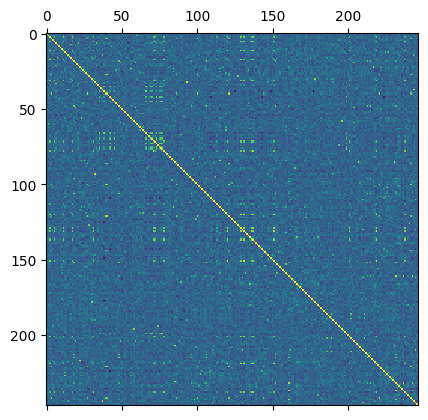

In [ ]:
plt.matshow(probe_vec_sim)

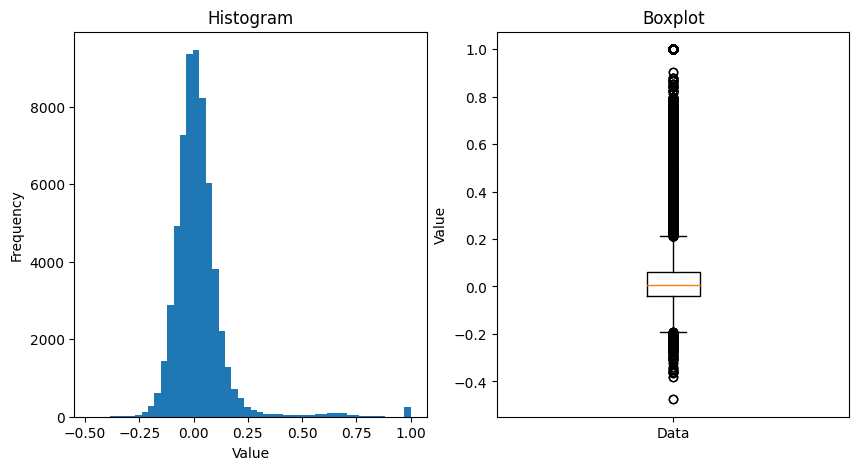

In [ ]:
hist_and_box(probe_vec_sim.reshape(-1))

In [ ]:
probe_vec_sim[32,93]

tensor(0.9040)

In [ ]:
used_dopes[93]

NameError: ignored

In [ ]:
bigram_id_a, bigram_id_b = used_dopes[32], used_dopes[93]

In [ ]:
print_bigram_id(bigram_id_a)

tensor([ 19, 187]) '2\n'


In [ ]:
print_bigram_id(bigram_id_b)

tensor([ 22, 187]) '5\n'


In [ ]:
def load_fixed_dset(bigram_id):
  a = torch.load(f'/content/drive/MyDrive/thesis/derived_data/probing/sk_probes/fixed_train_val_{bigram_id}.pt', map_location=torch.device('cpu'))
  (train_fixed, train_fixed_labels, val_fixed, val_fixed_labels) = a
  return val_fixed, val_fixed_labels

In [ ]:
val_fixed_a, val_fixed_labels_a = load_fixed_dset(bigram_id_a)
A_dset = val_fixed_a[hook_name_cons]
val_fixed_b, val_fixed_labels_b = load_fixed_dset(bigram_id_b)
B_dset = val_fixed_b[hook_name_cons]

A_sk_probe = sk_probes_dict[bigram_id_a][hook_name_cons]
B_sk_probe = sk_probes_dict[bigram_id_b][hook_name_cons]

In [ ]:
A_sk_probe.predict(A_dset).mean()

0.2

In [ ]:
A_sk_probe.predict(B_dset).mean()

0.216

In [ ]:
B_sk_probe.predict(A_dset).mean()

0.196

In [ ]:
B_sk_probe.predict(B_dset).mean()

0.218

In [ ]:
from sklearn.decomposition import PCA

In [ ]:
probe_vecs_pca = PCA().fit_transform(probe_vecs_normalized)

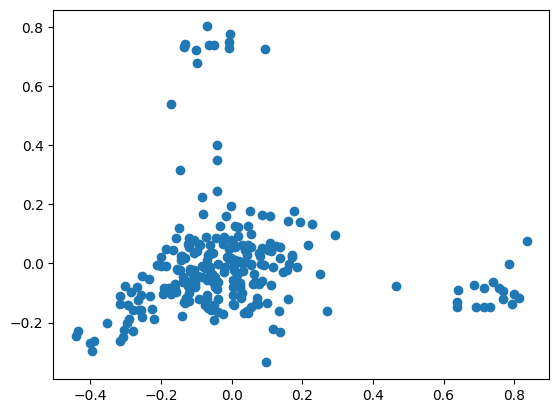

In [ ]:
plt.scatter(probe_vecs_pca[:,0], probe_vecs_pca[:,1])

# On distribution specificity

In [ ]:


# Usage


In [ ]:
n = 100
A, B = 1, len(TL)
C, D = 30, 500
random_occs_array = generate_tensor(n, A, B, C, D)
random_occs_labels = np.zeros(len(random_occs_array))

In [ ]:
random_occs_dset = OccDataset(random_occs_array, random_occs_labels)

In [ ]:
random_fixed, random_fixed_labels = get_fixed_vector_dset(random_occs_dset, hook_names, model, stop_at_layer=4)

10000it [04:55, 33.80it/s]


OutOfMemoryError: ignored

In [ ]:
torch.load((random_occs_array, random_fixed), f'/content/drive/MyDrive/thesis/derived_data/probing/random_fixed_7k_mod{model_size}.pt')

In [ ]:
random_fixed = torch.load(f'/content/drive/MyDrive/thesis/derived_data/probing/random_fixed_7k_mod{model_size}.pt')

In [ ]:
random_fixed[my_hook_name].shape

torch.Size([7889, 512])

In [ ]:
my_hook_vec = torch.tensor(sk_hook_probes[my_hook_name].coef_, dtype=torch.float32).reshape(-1)$

In [ ]:
my_hook_bias = torch.tensor(sk_hook_probes[my_hook_name].intercept_)

In [ ]:
np.argwhere(sk_hook_probes[my_hook_name].predict(random_fixed[my_hook_name]) != 0.).shape

(77, 1)

In [ ]:
77 / 7889

0.009760425909494233

In [ ]:
my_hook_vec.dtype

torch.float32

In [ ]:
rand_n = 10000
rand_skews = torch.zeros(rand_n)
rand_kurtosises = torch.zeros(rand_n)
for i in tqdm(range(rand_n)):
  random_vec = torch.randn_like(my_hook_vec)
  random_vec = torch.norm(my_hook_vec,dim=0) * random_vec / torch.norm(random_vec)
  my_random_dots = random_fixed[my_hook_name] @ random_vec
  rand_skews[i] = skewness(my_random_dots)
  rand_kurtosises[i] = kurtosis(my_random_dots)

100%|██████████| 10000/10000 [00:09<00:00, 1022.59it/s]


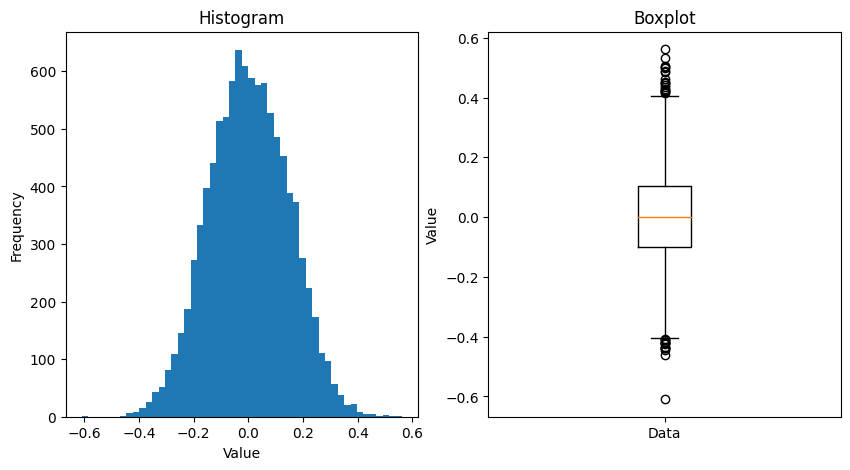

In [ ]:
hist_and_box(rand_skews)

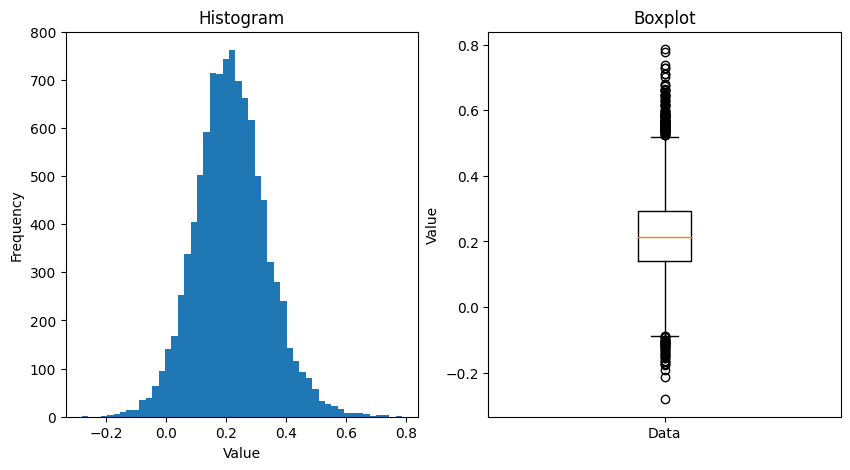

In [ ]:
hist_and_box(rand_kurtosises)

In [ ]:
skewness(my_dots)

tensor(0.1511)

In [ ]:
kurtosis(my_dots)

tensor(0.0778)

In [ ]:
(skewness(my_dots) > rand_skews).float().mean()

tensor(0.8405)

In [ ]:
(kurtosis(my_dots) > rand_kurtosises).float().mean()

tensor(0.1104)

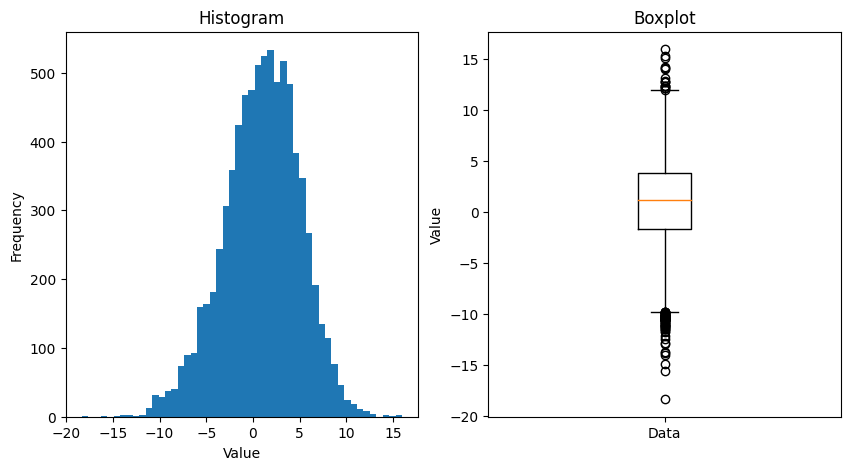

In [ ]:
hist_and_box(my_dots)

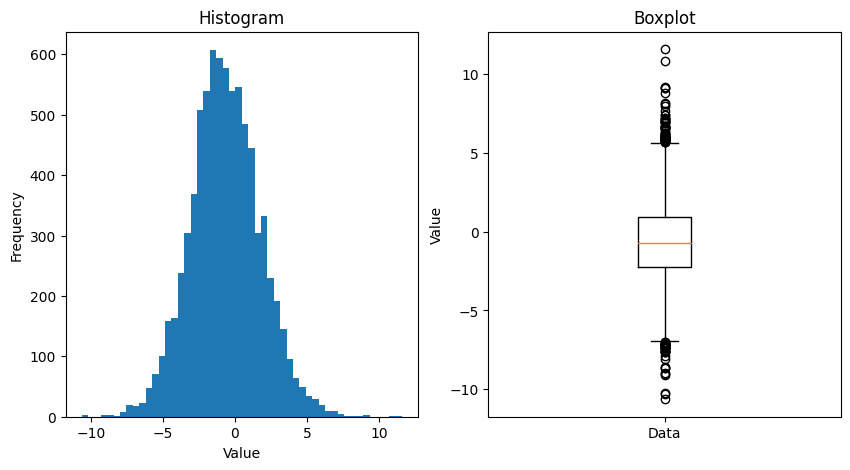

In [ ]:
hist_and_box(my_random_dots)

In [ ]:
my_logits = random_fixed[my_hook_name] @ my_hook_vec + my_hook_bias

In [ ]:
fp_idxs = torch.argwhere(my_logits > 0.).reshape(-1)

In [ ]:
torch.norm(random_fixed[my_hook_name],dim=-1)[fp_idxs]

tensor([5.1035, 5.0136, 4.6907, 4.9078, 6.0560])

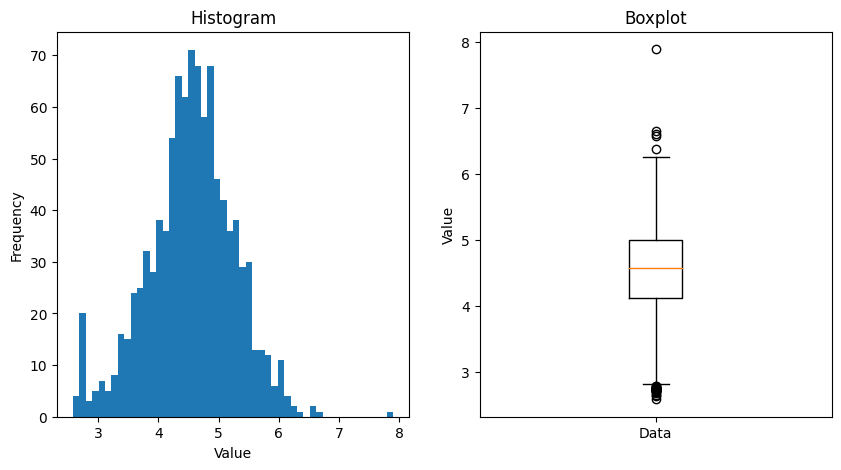

In [ ]:
hist_and_box(torch.norm(random_fixed[my_hook_name],dim=-1))

In [ ]:
my_logits[fp_idxs]

tensor([0.2333, 0.1333, 0.6068, 1.1469, 0.2805], dtype=torch.float64)

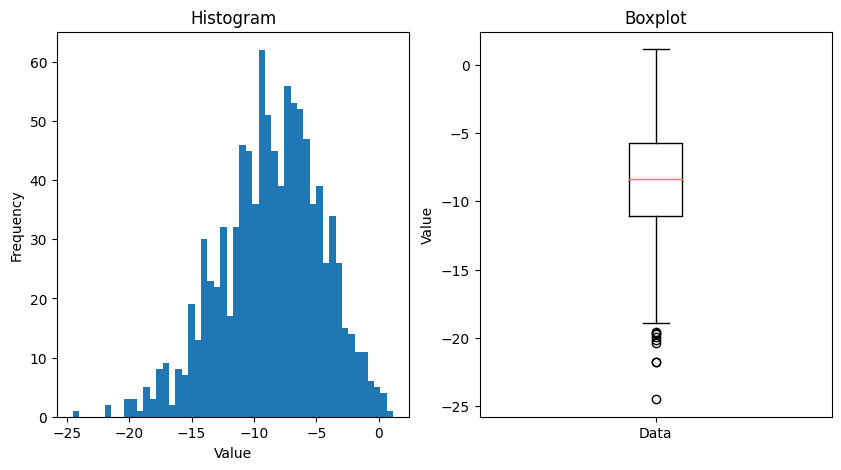

In [ ]:
hist_and_box(my_logits)

In [ ]:
my_sims = get_similarity_cross(random_fixed[my_hook_name], my_hook_vec.reshape(1,-1)).reshape(-1)

Text(0, 0.5, 'logits')

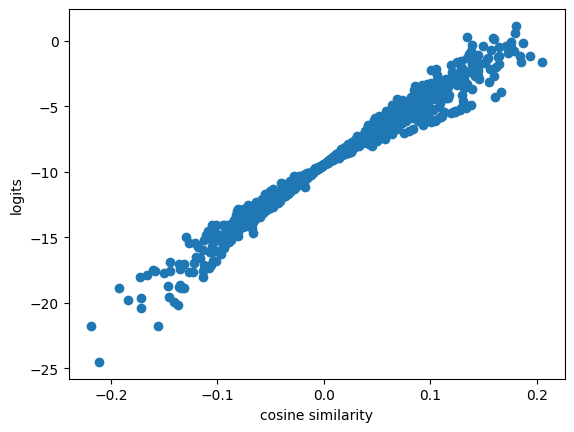

In [ ]:
plt.scatter(my_sims, my_logits)
plt.xlabel('cosine similarity')
plt.ylabel('logits')

In [ ]:
my_topsim = torch.argsort(my_sims, descending=True)[:10]

In [ ]:
my_topsim, fp_idxs

(tensor([609, 462, 287, 289,  69, 798, 762,  34, 366, 104]),
 tensor([252, 367, 762, 798, 934]))

In [ ]:
my_logits[my_topsim]

tensor([-1.5785, -1.1241, -0.1497, -1.6061, -1.1690,  1.1469,  0.6068, -0.7731,
        -0.4314, -0.0689], dtype=torch.float64)

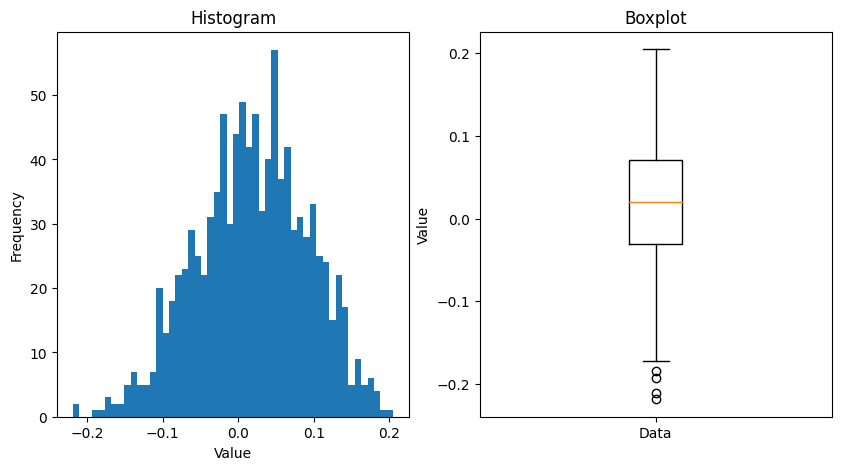

In [ ]:
hist_and_box(my_sims)

In [ ]:
precise_array = np.array(occ_dict[bigram])[:200]
precise_labels = np.ones(len(precise_array))

In [ ]:
precise_dset = OccDataset(precise_array, precise_labels)

In [ ]:
precise_fixed, precise_fixed_labels = get_fixed_vector_dset(precise_dset, hook_names)

200it [00:40,  4.97it/s]


In [ ]:
precise_logits = precise_fixed[my_hook_name] @ my_hook_vec + my_hook_bias

In [ ]:
precise_sims = get_similarity_cross(precise_fixed[my_hook_name], my_hook_vec.reshape(1,-1)).reshape(-1)

Text(0, 0.5, 'logits')

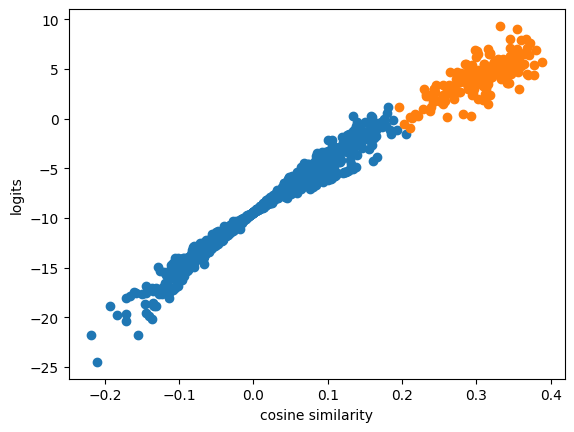

In [ ]:
plt.scatter(my_sims, my_logits, label='on-distribution negatives')
plt.scatter(precise_sims, precise_logits, label='positives')
plt.xlabel('cosine similarity')
plt.ylabel('logits')

# Looking at random occs

In [ ]:
(grand,
 grand_occs) = torch.load('/content/drive/MyDrive/thesis/data/chapters/chapter6/random_occs/grand_20k.pt')

In [ ]:
pythia_hooks = [f'blocks.{i}.hook_resid_post' for i in range(0,24)]

In [ ]:
from sklearn.decomposition import PCA

In [ ]:
def zstandardize(X):
  mu = X.mean(dim=0)
  sigma = X.std(dim=0)
  Z = (X - mu) / sigma
  return Z

In [ ]:
XA = grand[pythia_hooks[15]]
XB = grand[pythia_hooks[20]]

In [ ]:
do_standardize = True

In [ ]:
ZA = zstandardize(XA) if do_standardize else XA
ZB = zstandardize(XB) if do_standardize else XB

In [ ]:
chosen_occ_id = 99

In [ ]:
chosen_vecA = ZA[chosen_occ_id]
chosen_vecB = ZB[chosen_occ_id]

In [ ]:
chosen_simsA = get_similarity_cross(ZA, chosen_vecA.reshape(1,-1)).reshape(-1)
chosen_simsB = get_similarity_cross(ZB, chosen_vecB.reshape(1,-1)).reshape(-1)

In [ ]:
sim_thres = 0.3
A_top = torch.topk(chosen_simsA, k=20)
A_sims = A_top.indices.reshape(-1) #A_top.indices[torch.argwhere(A_top.values > sim_thres)].reshape(-1)
B_top = torch.topk(chosen_simsB, k=20)
B_sims = B_top.indices[torch.argwhere(B_top.values > sim_thres)].reshape(-1)

In [ ]:
A_top, B_top

(torch.return_types.topk(
 values=tensor([1.0000, 0.4867, 0.4564, 0.4268, 0.4086, 0.3693, 0.3554, 0.3449, 0.3394,
         0.3347, 0.3340, 0.3168, 0.3132, 0.2952, 0.2951, 0.2944, 0.2916, 0.2837,
         0.2833, 0.2821]),
 indices=tensor([   99,  3618,  4198,  9433, 12772,  5515,  1932,  6329, 19578, 18230,
          6804, 12977, 12812,  9260,  8091, 16629,  8409, 11568,  8629,  7488])),
 torch.return_types.topk(
 values=tensor([1.0000, 0.5150, 0.4911, 0.4700, 0.4674, 0.4539, 0.4498, 0.4421, 0.4393,
         0.4354, 0.4323, 0.4322, 0.4312, 0.4306, 0.4297, 0.4243, 0.4241, 0.4216,
         0.4213, 0.4176]),
 indices=tensor([   99,  3618,  4198, 18998, 13946, 16629, 19108, 10569,  4577, 19714,
         15805,  4626, 17995,   609, 12812,  7981, 12132,  9625, 18711,  7286])))

In [ ]:
#plt.scatter(chosen_simsA, chosen_simsB,s=0.1)
#diagonal = torch.linspace(-0.1,0.3,100)
#plt.plot(diagonal, diagonal, color='black')

In [ ]:
newcomers = list((set(torch.topk(chosen_simsB, k=20).indices.tolist()) - set(torch.topk(chosen_simsA, k=20).indices.tolist())))

In [ ]:
#newcomers = list((set(B_sims.tolist()) - set(A_sims.tolist())))

In [ ]:
print('I present you with these partial sentences. There is a main sentence and then there are other sentence that have something in common with the main sentence. Your job is to find the pattern. To help you I will let you know that what they have in common is most likely something that would allow one to better predict how the main sentence will continue, so it can be a good idea to focus on the end of the sentences. I am very well aware that they are partial fragements and might end abruptly so this cannot be part of your reasoning, I want you to focus on the content available.')
print('Main sentence:', repr(occ_to_seq(TL, grand_occs[chosen_occ_id], decode=True,after=3)), '...')
for i, occ_id in enumerate(newcomers):
  print(i, repr(occ_to_seq(TL, grand_occs[occ_id], decode=True,after=3)), '...')
  print(round(chosen_simsA[occ_id].item(),3), '->', round(chosen_simsB[occ_id].item(),3))
print('Make a short paragraph where you reason about it and then based on your reasonig end with "INTERPRETATION: <short sentence>"')

I present you with these partial sentences. There is a main sentence and then there are other sentence that have something in common with the main sentence. Your job is to find the pattern. To help you I will let you know that what they have in common is most likely something that would allow one to better predict how the main sentence will continue, so it can be a good idea to focus on the end of the sentences. I am very well aware that they are partial fragements and might end abruptly so this cannot be part of your reasoning, I want you to focus on the content available.
Main sentence: " her father had a family with another woman. Shortly after, Lynn's mother suffered a nervous breakdown, and Lynn was placed in" ...
0 ' formed using a technique known as "festooning" in which the strip is folded back and forth to lay a series of' ...
0.098 -> 0.439
1 ' never provided the location of the "black sites."\n\nThe European Court of Human Rights intends to review the legal status of' ...
0.

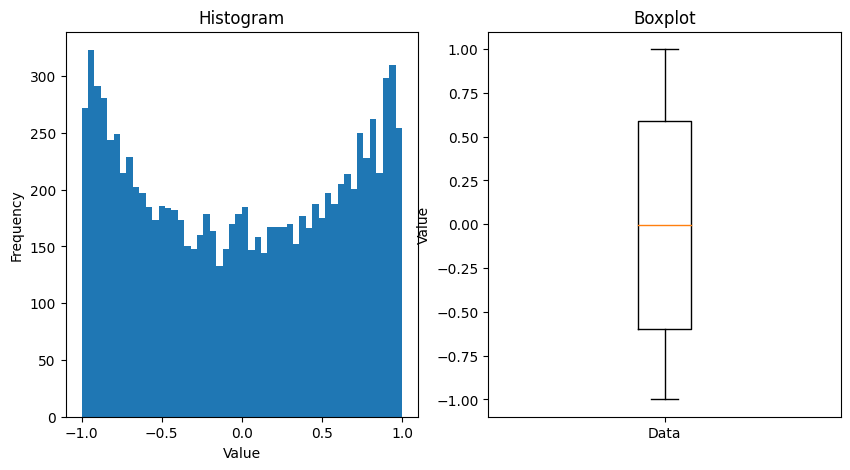

In [ ]:
hist_and_box(torch.tanh(torch.randn(10000)))

In [ ]:
display_occ_ids(newcomers, grand_occs)

In [ ]:
display_occ_ids(torch.topk(chosen_simsA, k=20).indices, grand_occs)

tensor(140) ' using him off the bench.\n?He had a knock on his knee against Parramatta which we were hoping wasn'
tensor(14150) ' shopping list. Klopp wanted to buy him in January but Leverkusen were adamant that he wasn'
tensor(7970) ' and scenarios but maintained the character-driven formula that attracted fans to it in the first place. Unfortunately, the changes weren'
tensor(3597) ' the night with them prior to our big day. They took her to see The Nutcracker, which you know was'
tensor(19322) ' know it sounds like it might be a slam on Al Gore’s “An Inconvenient Truth,” it isn'
tensor(9105) ' last year but it was sold out when we tried to sign up. This year we watched and as soon as registration was'
tensor(14118) ' A consensus of their observations indicates that the helicopter was proceeding along a normal flightpath when a loud noise or unusual sound was'
tensor(12632) ' way, but you have to believe this yourself. Finding the kind of value in yourself that supersedes what most 

In [ ]:
display_occ_ids(torch.topk(chosen_simsB, k=20).indices, grand_occs)

tensor(140) ' using him off the bench.\n?He had a knock on his knee against Parramatta which we were hoping wasn'
tensor(14150) ' shopping list. Klopp wanted to buy him in January but Leverkusen were adamant that he wasn'
tensor(7970) ' and scenarios but maintained the character-driven formula that attracted fans to it in the first place. Unfortunately, the changes weren'
tensor(3597) ' the night with them prior to our big day. They took her to see The Nutcracker, which you know was'
tensor(19322) ' know it sounds like it might be a slam on Al Gore’s “An Inconvenient Truth,” it isn'
tensor(12632) ' way, but you have to believe this yourself. Finding the kind of value in yourself that supersedes what most others aren'
tensor(11086) " to load the native Tensorflow runtime. I don't know what to do I tried so many ways and it still doesn"
tensor(17243) 'The scaling “agreement” Segwit2x followed soon after, proposing to add a feature that BIP 148 wouldn'
tensor(8515) ' Maul with his back to

In [ ]:
layer_used = 10

In [ ]:
X = grand[pythia_hooks[layer_used]]

In [ ]:
cs_master = torch.stack([get_similarity_cross(X[:10000],X[10000:18000]) for _, X in tqdm(grand.items())])
cs_master.shape

100%|██████████| 24/24 [00:33<00:00,  1.39s/it]


torch.Size([24, 10000, 8000])

In [ ]:
cs_masterZ = torch.stack([get_similarity_cross(zstandardize(X[:10000]),zstandardize(X[10000:18000])) for _, X in tqdm(grand.items())])
cs_masterZ.shape

100%|██████████| 24/24 [00:35<00:00,  1.47s/it]


torch.Size([24, 10000, 8000])

In [ ]:
d = cs_masterZ.max(dim=1).values
d.shape

torch.Size([24, 8000])

In [ ]:
master_zbin = (cs_masterZ > 0.3).float()

In [ ]:
master_zbin_nns = master_zbin.sum(dim=1)

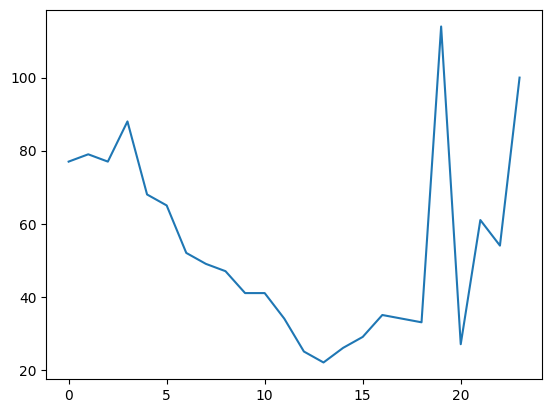

In [ ]:
plt.plot(master_zbin_nns[:,5432])

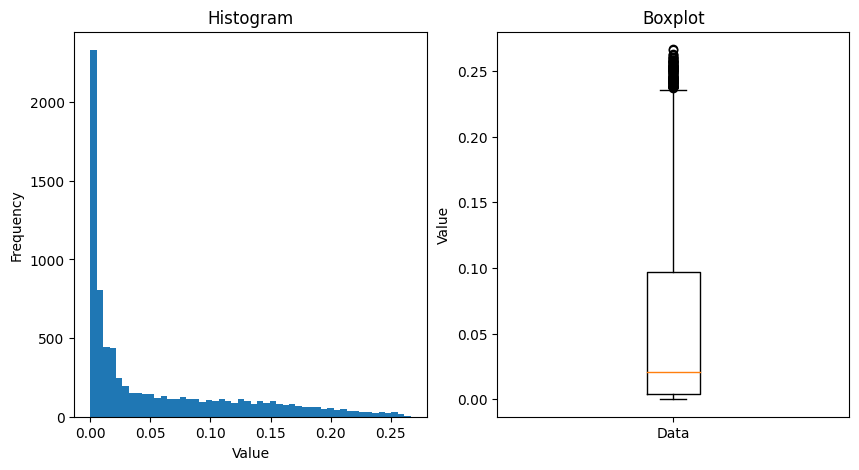

In [ ]:
hist_and_box(master_zbin_nns[20])

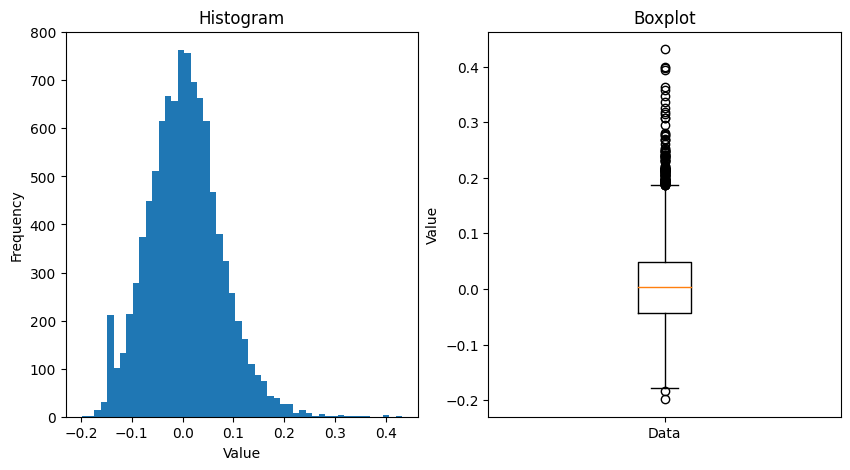

In [ ]:
hist_and_box(cs_masterZ[16,:,134])

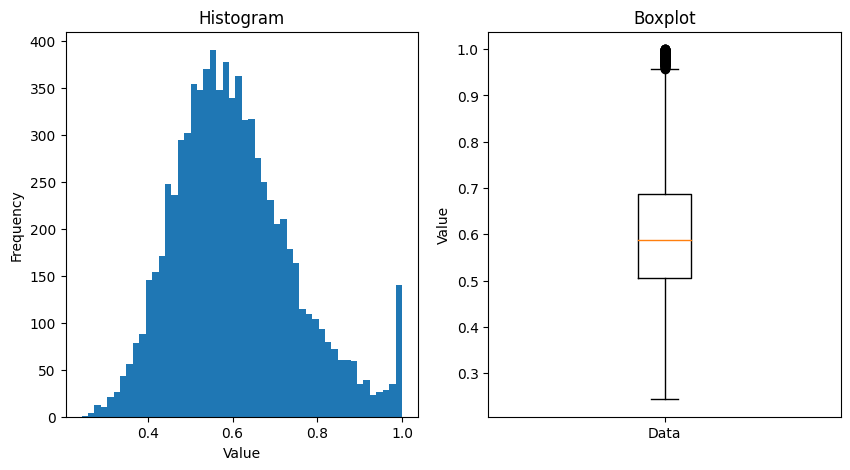

In [ ]:
hist_and_box(d[20])

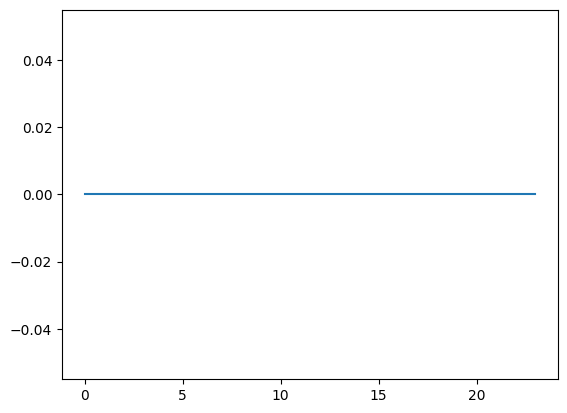

In [ ]:
plt.plot(master_zbin[:,1123,234])

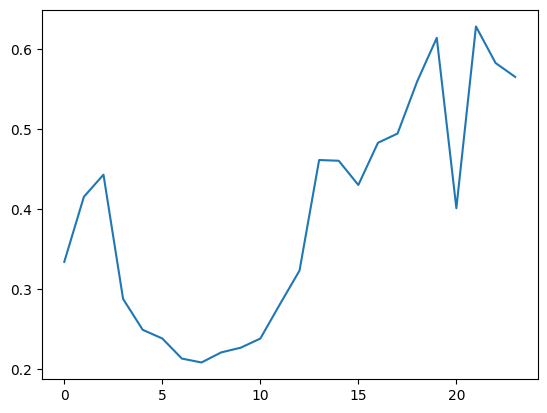

In [ ]:
plt.plot(cs_master[:,100,102])

In [ ]:
S1 = zstandardize(X[:10000])
O1 = grand_occs[:10000]

In [ ]:
S2 = zstandardize(X[10000:18000])
O2 = grand_occs[10000:18000]

In [ ]:
S3 = zstandardize(X[18000:])
O3 = grand_occs[18000:]

In [ ]:
cs = get_similarity_cross(S1,S2).T

In [ ]:
mem_size(cs)

305.17578125

In [ ]:
j = 1243

In [ ]:
repr(occ_to_seq(TL, O2[j], decode=True,after=3))

"' electronic components did not survive the stress of being shot from a deck gun. In February 2008, guidance components, rocket motors,'"

In [ ]:
def print_occs_wrt(indxs, O):
  for indx in indxs:
    print(indx, repr(occ_to_seq(TL, O[indx], decode=True,after=3)))

In [ ]:
j_neighbors = torch.topk(cs[j], k=10).indices
torch.topk(cs[j], k=10).values

tensor([0.3258, 0.3138, 0.3010, 0.2927, 0.2904, 0.2883, 0.2836, 0.2781, 0.2741,
        0.2711])

In [ ]:
j_neighbors

tensor([1278, 8387, 7082, 5546, 8170, 2586, 1669, 7714, 5543,   66])

In [ ]:
print_occs_wrt(j_neighbors,O1)

tensor(1278) 'll need to think about the types of images you want to create, and how you prefer to shoot. Different camera lenses yield'
tensor(8387) ' reunited for the anniversary tour. The reissue and anniversary tour were also supported by TV specials, radio specials,'
tensor(7082) '.50\xa0GHz range of the Ku band across Europe, Western Russia and the Middle East.\n\nSatellite craft in'
tensor(5546) ' control medicinal profiles is of utmost importance when supplying patients with pharmaceutical-grade, safe products. We believe full control, automation and'
tensor(8170) ' (Parameter RAM) stores the default values of some core system settings such as your alarms, mouse settings, start up programs,'
tensor(2586) ' designed for use with vision systems and multi-sensor machines. Hold and secure your parts using the acrylic base plates and components with'
tensor(1669) '-out hovels pretend to watch the race in virtual reality, but the VR glasses are merely swim goggles.'
tensor(7714) " I 

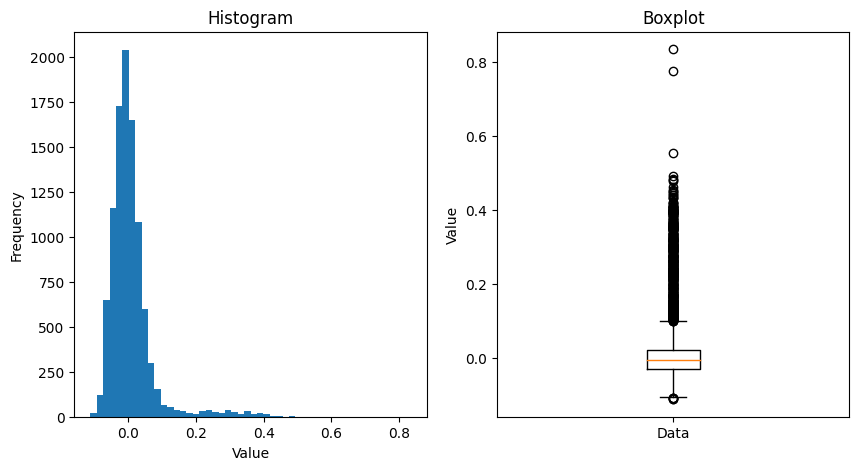

In [ ]:
hist_and_box(cs[j])

In [ ]:
yo = torch.from_numpy(PCA().fit_transform(zstandardize(X).detach().cpu()))

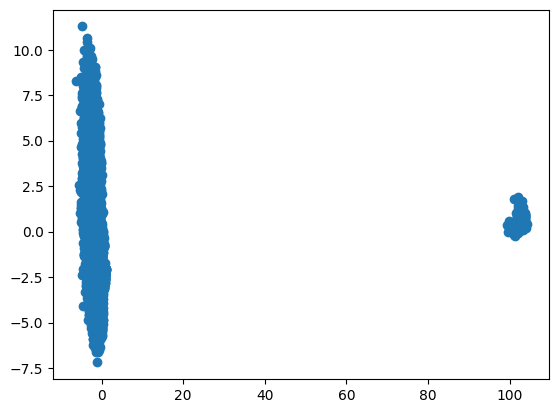

In [ ]:
plt.scatter(yo[:,0], yo[:,1])

In [ ]:
X_filt1 = X[torch.argwhere(yo[:,0] < 20)].squeeze() #.shape

In [ ]:
yo2 = torch.from_numpy(PCA().fit_transform(zstandardize(X_filt1.cpu())))

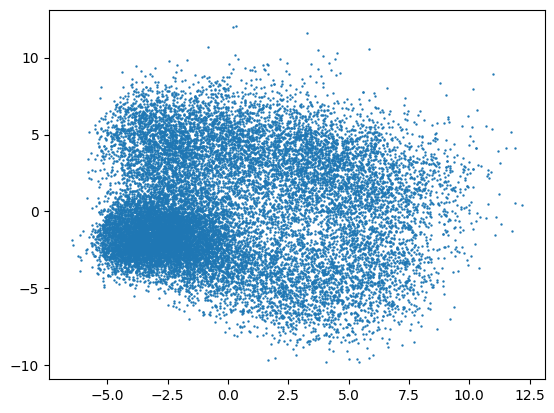

In [ ]:
plt.scatter(yo2[:,0], yo2[:,1],s=0.5)

In [ ]:
display_occ_ids(torch.topk(yo2[:,1], k=10).indices)

tensor(1939) '. And whoever obeys Allah and His Messenger, he verily has got a great success,” (Al-Ah'
tensor(96) ' by adjacent cells: as soon as cells showing low levels of MYC activity (called *losers*) are detected in'
tensor(1080) ' a partial class.\n\nA:\n\nYou can create Identifying relationship between parent and child entities and EF will'
tensor(374) "'re into plush stuff (I usually am not but these are eye catchers) or have to shop for children are"
tensor(1624) 'Something about the kitten captured the hearts of\nthe family and while her siblings eventually found homes elsewhere, Snowball\n'
tensor(222) '\n"When it was time to leave the island, he followed us to the taxi and I just wanted to do more'
tensor(1915) 'uuuust a bit faster). \nSince complex numbers are involved, I took a version from a text that extends'
tensor(1675) ' released under the Pink Floyd banner. There’s a lot of dull guitar atmospherics and droning tones.'
tensor(1923) 'ler III Project Management Softwar

In [ ]:
def display_occ_ids(occ_ids, occs_array):
  for occ_id in occ_ids:
    print(occ_id, repr(occ_to_seq(TL, occs_array[occ_id], decode=True)))

In [ ]:
for occ_id in torch.argwhere(yo[:,0] > 20).reshape(-1):
  print(occ_id, repr(occ_to_seq(TL, random_occs_array[occ_id], decode=True)))

tensor(7) 'typical skinny guy’, as an ectomorph with high body fat is still an ectomorph – just an overweight one.'
tensor(26) '\n\nHow hilarious were the two rappers?!? Biggie Slim and Nikki J? Classic Castle humor.'
tensor(51) 'dös, rohadék geci! Takarodj az országunkból!”\n'
tensor(212) ' “droplets”, com diferentes distribuições Linux, como Debian, Ubuntu, FreeBSD, etc.'
tensor(227) ' chemistry. Beating a veteran team in Stevenson with less than a day of preparation shows this team is just getting started.'
tensor(258) ') are molecules so small that they can permeate the mitochondrial outer membrane through porins and shuttle between two dehydrogenases.'
tensor(270) ' a party… and while there aren’t a ton of specialty snacks for the event, you will find a couple.'
tensor(346) ' John McCain’s friend and formereconomic adviser Phil Gramm “stripped safeguards that would haveprotected us.”'
tensor(356) ' of victims of the 2004 Beslan school siege that he could resurrect their children, 

In [ ]:
for occ_id in torch.argwhere(yo[:,0] < 20).reshape(-1)[:10]:
  print(occ_id, repr(occ_to_seq(TL, random_occs_array[occ_id], decode=True)))

tensor(0) ' all of the perishable/nonperishable data\n    bool mycontinue = true;\n    fstream'
tensor(1) " night's Iowa caucuses have brought the very conservative Sen. Ted Cruz and the very liberal Sen. Bernie Sanders more directly"
tensor(2) ' impress your lover and hopefully it always get the good response from your partner. To complete the word love in small and meaningful'
tensor(3) ' were asked randomly to show their passports again while waiting at the gate. Another check came as our boarding cards were collected'
tensor(4) ' default;\n    C(double f, double i=0): a(f), b(i) {}\n'
tensor(5) '.70% had someone living alone who was 65 years of age or older. The average household size was 2.31'
tensor(6) ' More added regularly.\n\n500+ computer characters (residents) which you can interact with to complete adventures and learn'
tensor(8) ' and today they are once again taking their place in world affairs. This is a very strong commonality. Because when we'
tensor(9) ' financial cen

tensor([158701,    191])

tensor([   7,   26,   51,  212,  227,  258,  270,  346,  356,  373,  504,  681,
         727,  766,  773,  778,  785,  869,  888, 1004, 1010, 1024, 1140, 1190,
        1360, 1380, 1493, 1566, 1573, 1613, 1715, 1798])

# Replicating aniso

In [ ]:
import torch
def get_random_along_pos(A):
  # Create a random 3D tensor A of shape (n, p, d)
  n, p, d = A.shape[0], A.shape[1], A.shape[2] #5, 10, 3  # Example dimensions
  # Generate random row indices for each of the n matrices
  random_indices = torch.randint(0, p, (n,))
  # Use advanced indexing to select random rows for each n
  selected_rows = A[torch.arange(n), random_indices]
  return selected_rows

In [ ]:
def get_fixed_vector_dset_randpos(loader, hook_names, model, max_i = None, stop_at_layer=None):
  hook_vector_dsets = {hook_name: [] for hook_name in hook_names}
  hook_vector_dsets_labels = {hook_name: [] for hook_name in hook_names}
  for i, (seqs, _, labels) in tqdm(enumerate(loader)):  # 1000 samples with 10 features
    with torch.no_grad():
      _, cache = model.run_with_cache(seqs, stop_at_layer=stop_at_layer)

    n, p = cache[hook_names[0]].shape[0], cache[hook_names[0]].shape[1]
    random_indices = torch.randint(10, p, (n,))
    for hook_name in hook_names:
      acts = cache[hook_name][torch.arange(n), random_indices]
      hook_vector_dsets[hook_name].append(acts)
      hook_vector_dsets_labels[hook_name].append(labels)

    if max_i is not None:
      if i >= max_i: break
    del cache
  for key, item in hook_vector_dsets.items():
    hook_vector_dsets[key] = torch.cat(item,dim=0)
  for key, item in hook_vector_dsets_labels.items():
    hook_vector_dsets_labels[key] = torch.cat(item,dim=0)
  return hook_vector_dsets, hook_vector_dsets_labels

In [ ]:
import torch

def generate_tensor(n, A, B, C, D):
    """
    Generates a tensor of shape (n, 2) where each row has the first entry being
    an integer between A and B (inclusive), and the second entry being an integer between C and D (inclusive).

    Parameters:
    - n (int): Number of rows in the tensor.
    - A (int): Lower bound for the first entry of each row.
    - B (int): Upper bound for the first entry of each row.
    - C (int): Lower bound for the second entry of each row.
    - D (int): Upper bound for the second entry of each row.

    Returns:
    - torch.Tensor: The generated tensor.
    """
    # Generate the first column with integers between A and B
    col1 = torch.randint(A, B + 1, (n, 1))

    # Generate the second column with integers between C and D
    col2 = torch.randint(C, D + 1, (n, 1))

    # Concatenate the columns to form the final tensor
    result = torch.cat((col1, col2), dim=1)

    return result

# Test the function
generate_tensor(5, 1, 10, 20, 30)


tensor([[ 7, 25],
        [ 7, 24],
        [ 4, 22],
        [ 9, 28],
        [ 1, 22]])

In [ ]:
n = 2000
A, B = 1, len(TL)
C, D = 30, 500
random_occs_array = generate_tensor(n, A, B, C, D)
random_occs_labels = np.zeros(len(random_occs_array))

In [ ]:
random_occs_dset = OccDataset(random_occs_array, random_occs_labels)

In [ ]:
pythia_hooks = [f'blocks.{i}.hook_resid_post' for i in range(0,24)]

In [ ]:
random_occs_loader = DataLoader(random_occs_dset, batch_size=100, shuffle=False)

In [ ]:
torch.cuda.empty_cache()

In [ ]:
random_fixed, random_fixed_labels = get_fixed_vector_dset_new(random_occs_loader, pythia_hooks, model, stop_at_layer=None, use_tqdm=True)

20it [00:11,  1.71it/s]


In [ ]:
torch.save((random_fixed, random_occs_array), '/content/drive/MyDrive/thesis/data/chapters/chapter6/random_occs/410m_all_resids_2k_10.pt')

In [ ]:
hejsa = [torch.load(path) for path in ['/content/drive/MyDrive/thesis/data/chapters/chapter6/random_occs/410m_all_resids_2k_1.pt',
                                       '/content/drive/MyDrive/thesis/data/chapters/chapter6/random_occs/410m_all_resids_2k_2.pt',
                                       '/content/drive/MyDrive/thesis/data/chapters/chapter6/random_occs/410m_all_resids_2k_3.pt',
                                       '/content/drive/MyDrive/thesis/data/chapters/chapter6/random_occs/410m_all_resids_2k_4.pt',
                                       '/content/drive/MyDrive/thesis/data/chapters/chapter6/random_occs/410m_all_resids_2k_5.pt',
                                       '/content/drive/MyDrive/thesis/data/chapters/chapter6/random_occs/410m_all_resids_2k_6.pt',
                                       '/content/drive/MyDrive/thesis/data/chapters/chapter6/random_occs/410m_all_resids_2k_7.pt',
                                       '/content/drive/MyDrive/thesis/data/chapters/chapter6/random_occs/410m_all_resids_2k_8.pt',
                                       '/content/drive/MyDrive/thesis/data/chapters/chapter6/random_occs/410m_all_resids_2k_9.pt',
                                       '/content/drive/MyDrive/thesis/data/chapters/chapter6/random_occs/410m_all_resids_2k_10.pt']
         ]

In [ ]:
grand = {hook_name : torch.cat([fixed[0][hook_name] for fixed in hejsa],dim=0).cpu() for hook_name in pythia_hooks}

In [ ]:
grand_occs = torch.cat([elem[1] for elem in hejsa]) #.shape

In [ ]:
torch.save((grand, grand_occs), '/content/drive/MyDrive/thesis/data/chapters/chapter6/random_occs/grand_20k.pt')

In [ ]:
thepile_lines = [tokenizer.decode(random_occs_dset[i][0]) for i in range(0,len(random_occs_dset))]

In [ ]:
def plot_cosine_layer(cosine_layer):
  plt.plot(cosine_layer.mean(dim=1).cpu())
  plt.ylabel('Cosine similarity')
  plt.xlabel('Layer depth')
  plt.title('Cosine similarity between two randomly chosen positions in the dataset')
  plt.show()
  fig, ax = plt.subplots()
  depth = cosine_layer.shape[0]
  # Create boxplots
  ax.boxplot(cosine_layer.cpu(), positions=range(0,depth))

  # Adding labels and title
  ax.set_xticks(range(0,depth))
  ax.set_xticklabels(range(0,depth))
  ax.set_xlabel("Layer")
  ax.set_ylabel("Cosine Similarity")
  ax.set_title("Distribution of Cosine Similarities Across Layers")

  # Show plot
  plt.show()

  #plt.plot(torch.median(cosine_layer, dim=1).values.cpu(), label='mean')

In [ ]:
gpt2 = HookedTransformer.from_pretrained("gpt2-small")

Using pad_token, but it is not set yet.


Loaded pretrained model gpt2-small into HookedTransformer


In [ ]:
gpt2med = HookedTransformer.from_pretrained("gpt2-medium")

Using pad_token, but it is not set yet.


Loaded pretrained model gpt2-medium into HookedTransformer


In [ ]:
# Initialize an empty list to hold the lines
sameval_lines = []

# Open the text file
with open('/content/STS.input.MSRpar.txt', 'r') as f:
    # Read each line and add it to the list
    for line in f:
        sameval_lines.append(line.strip())  # Remove leading/trailing whitespaces

# Print the list of lines
#print(lines)


In [ ]:
def get_cos_sims(hook_vecs, hook_list, plot=True):
  cosine_similarities_per_layer = []
  for i, hook_name in enumerate(hook_list):
    print('layer', i)
    assert hook_name == f'blocks.{i}.hook_resid_post'
    X = torch.stack(hook_vecs[hook_name])
    n = X.shape[0]
    A = X[:n//2]
    B = X[n//2:]
    cosine_similarities = F.cosine_similarity(A, B, dim=1)
    if plot:
      hist_and_box(cosine_similarities)
      print(cosine_similarities.mean())
    cosine_similarities_per_layer.append(cosine_similarities)

  return torch.stack(cosine_similarities_per_layer)

In [ ]:
def get_random_vecs_from_lines(lines, hook_list, model):
  hook_vecs = {hook_name : [] for hook_name in hook_list}
  ps = []
  for line in tqdm(lines):
    with torch.no_grad():
      _, cache = model.run_with_cache([line])
      P = cache[hook_list[0]].shape[1]
      p = random.randint(10, P-2)
      ps.append(p)
      for hook_name in hook_list:
        vec = cache[hook_name][0,p]
        hook_vecs[hook_name].append(vec.cpu())
        #del cache[hook_name]
    del cache
    torch.cuda.empty_cache()
  return hook_vecs

In [ ]:
gpt2_hooks = [f'blocks.{i}.hook_resid_post' for i in range(0,12)]

In [ ]:
gpt2med_hooks = [f'blocks.{i}.hook_resid_post' for i in range(0,24)]

In [ ]:
pythia_the_pile_hookvecs = get_random_vecs_from_lines(thepile_lines, pythia_hooks, model)

  0%|          | 0/10000 [00:04<?, ?it/s]


TypeError: ignored

In [ ]:
pythia_random_dset = {
    'hook_vecs': pythia_the_pile_hook_vecs,
    'lines': thepile_lines,
    'occs': random_occs_dset,
    'model': '410m',
    'hooks': pythia_hooks
}

In [ ]:
torch.save()

In [ ]:
gpt2_the_pile_hookvecs = get_random_vecs_from_lines(thepile_lines, gpt2_hooks, gpt2)

100%|██████████| 750/750 [00:30<00:00, 24.35it/s]


In [ ]:
gpt2med_the_pile_hookvecs = get_random_vecs_from_lines(thepile_lines, gpt2med_hooks, gpt2med)

100%|██████████| 750/750 [01:01<00:00, 12.13it/s]


In [ ]:
gpt2_sameval_hookvecs = get_random_vecs_from_lines(sameval_lines, gpt2_hooks, gpt2)

100%|██████████| 750/750 [00:59<00:00, 12.57it/s]


In [ ]:
pythia_sameval_hookvecs = get_random_vecs_from_lines(sameval_lines, pythia_hooks, model)

100%|██████████| 750/750 [01:13<00:00, 10.21it/s]


layer 0


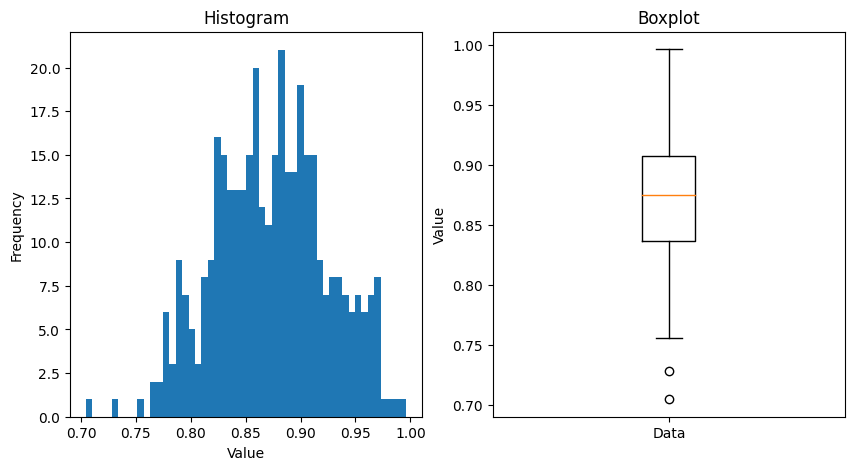

tensor(0.8731, device='cuda:0')
layer 1


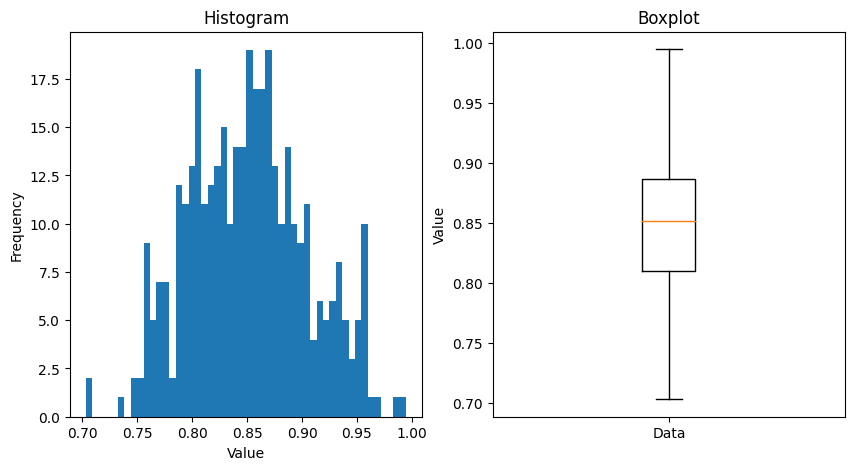

tensor(0.8510, device='cuda:0')
layer 2


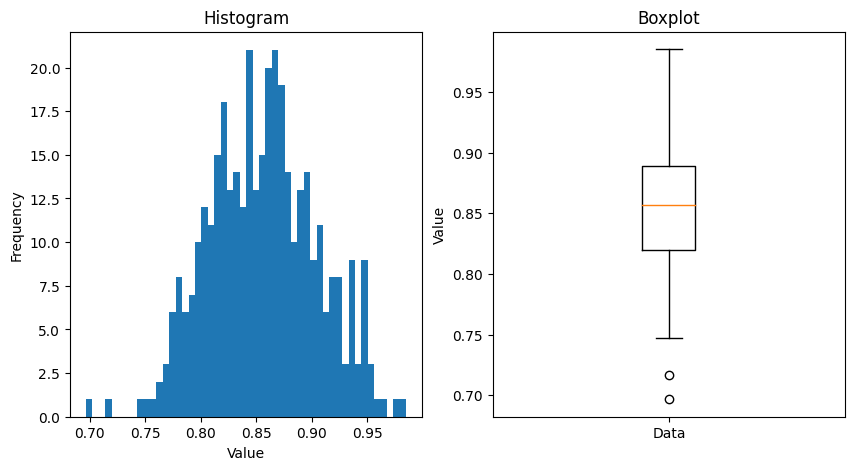

tensor(0.8563, device='cuda:0')
layer 3


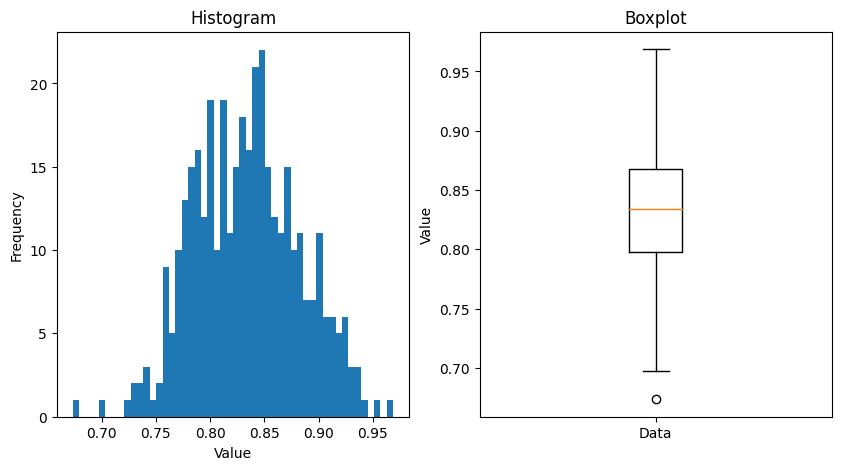

tensor(0.8338, device='cuda:0')
layer 4


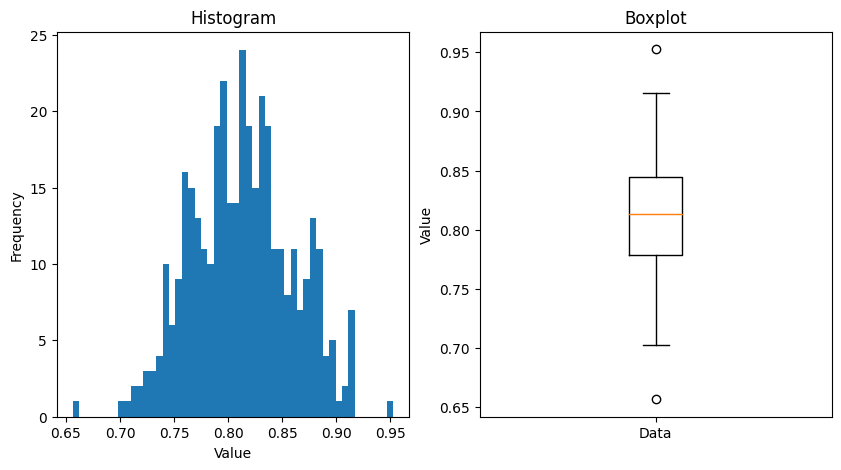

tensor(0.8133, device='cuda:0')
layer 5


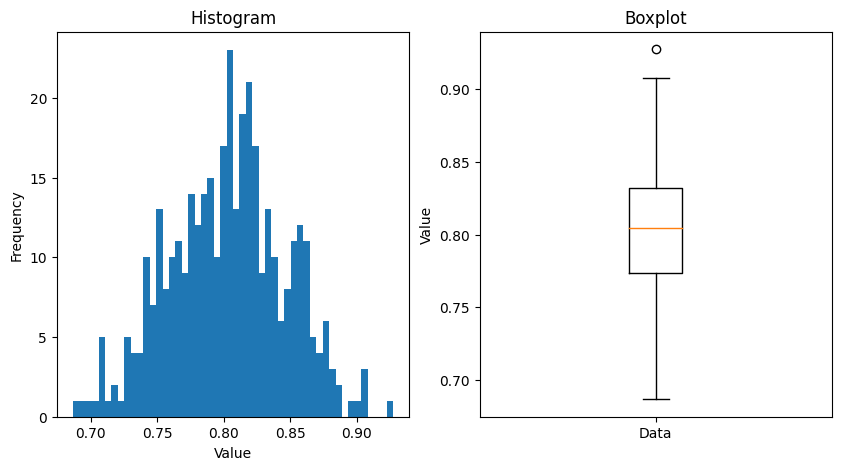

tensor(0.8031, device='cuda:0')
layer 6


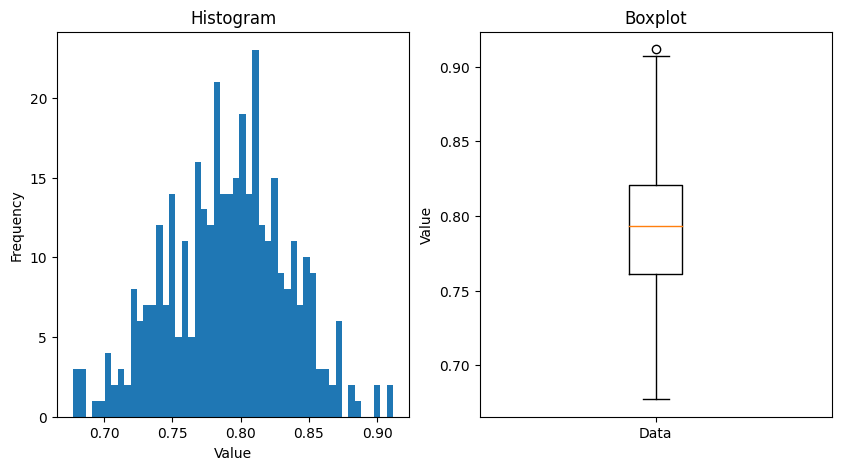

tensor(0.7909, device='cuda:0')
layer 7


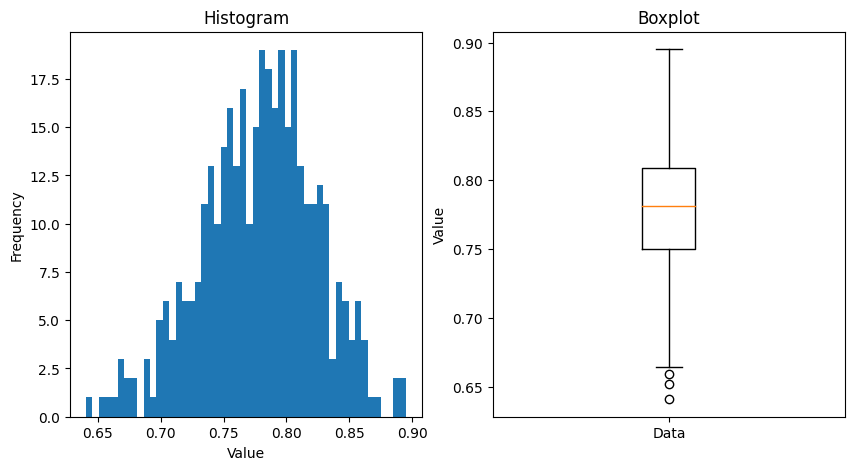

tensor(0.7784, device='cuda:0')
layer 8


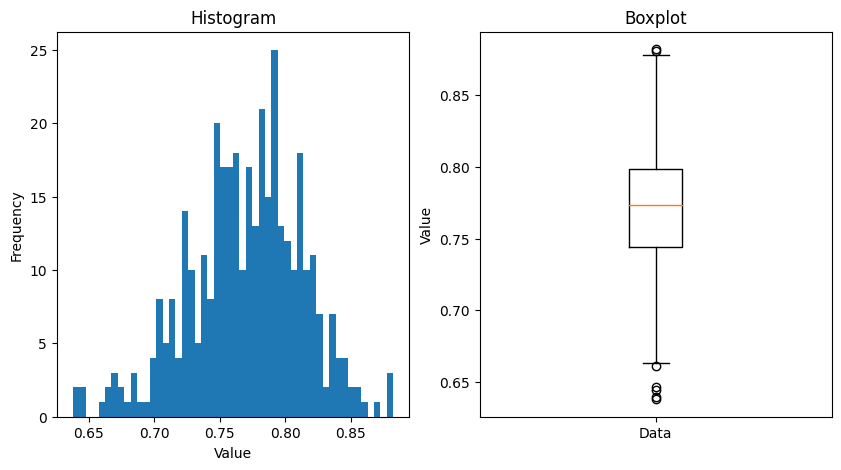

tensor(0.7698, device='cuda:0')
layer 9


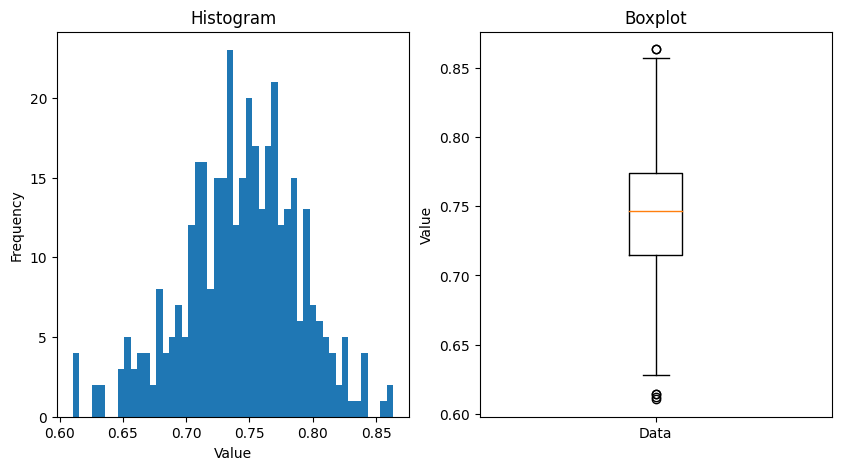

tensor(0.7436, device='cuda:0')
layer 10


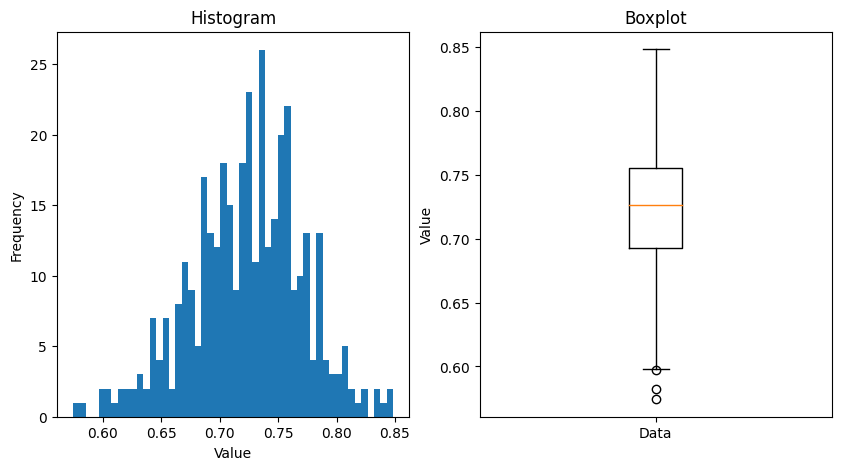

tensor(0.7232, device='cuda:0')
layer 11


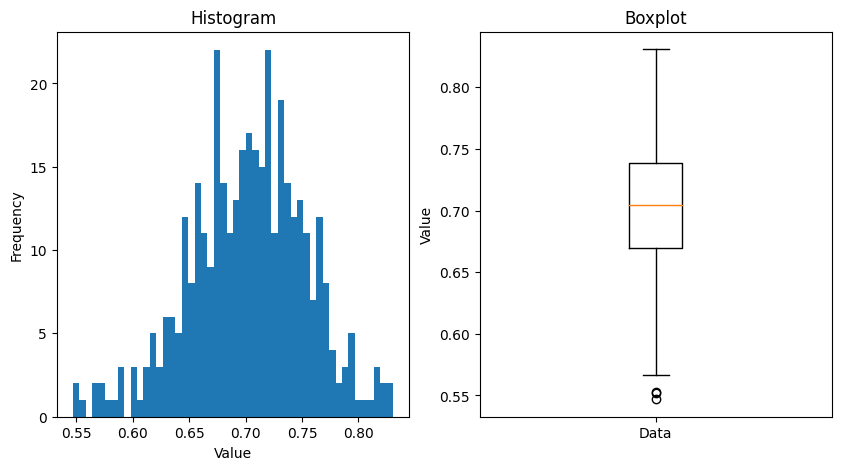

tensor(0.7020, device='cuda:0')
layer 12


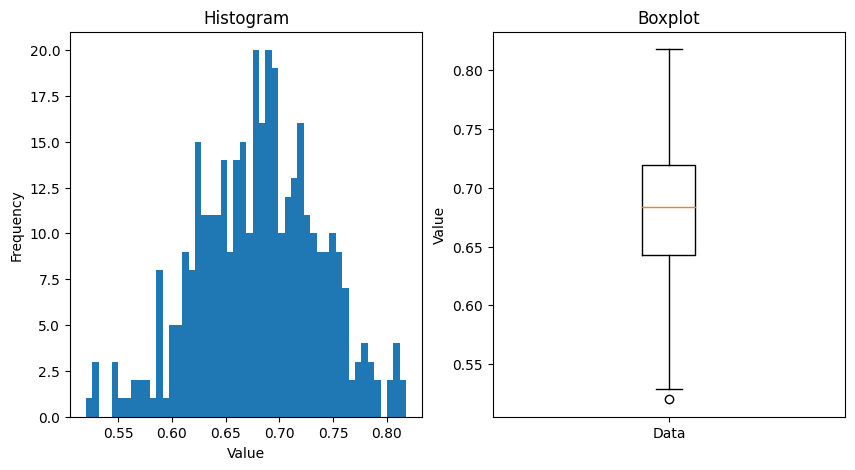

tensor(0.6810, device='cuda:0')
layer 13


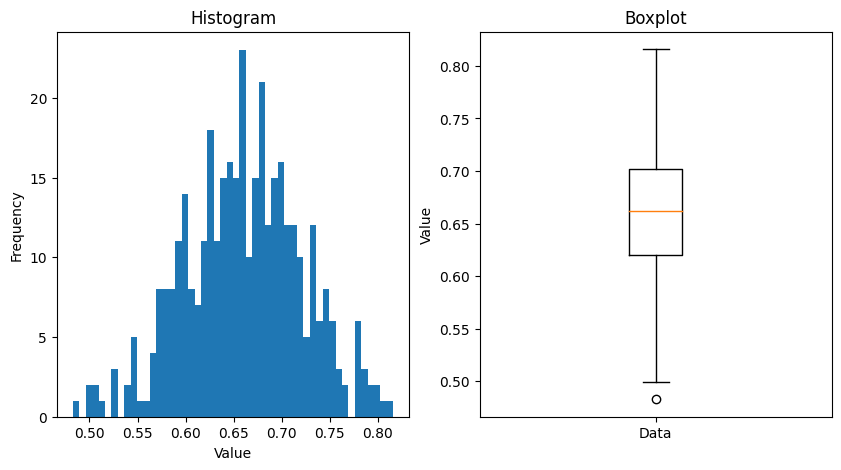

tensor(0.6604, device='cuda:0')
layer 14


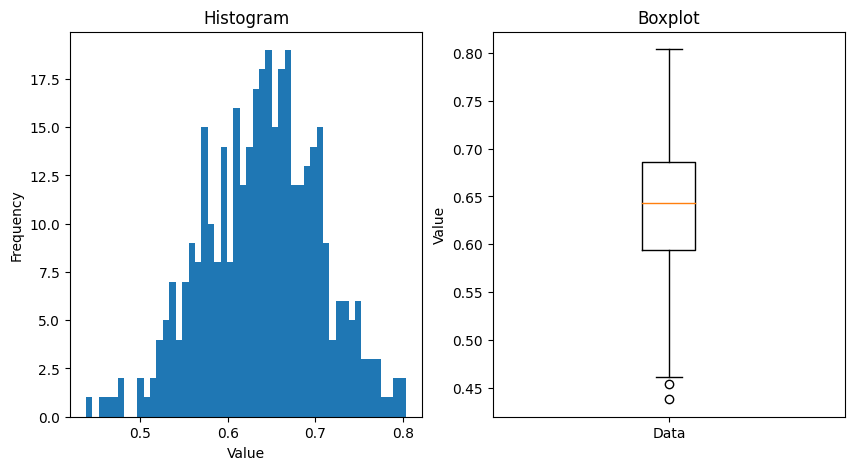

tensor(0.6401, device='cuda:0')
layer 15


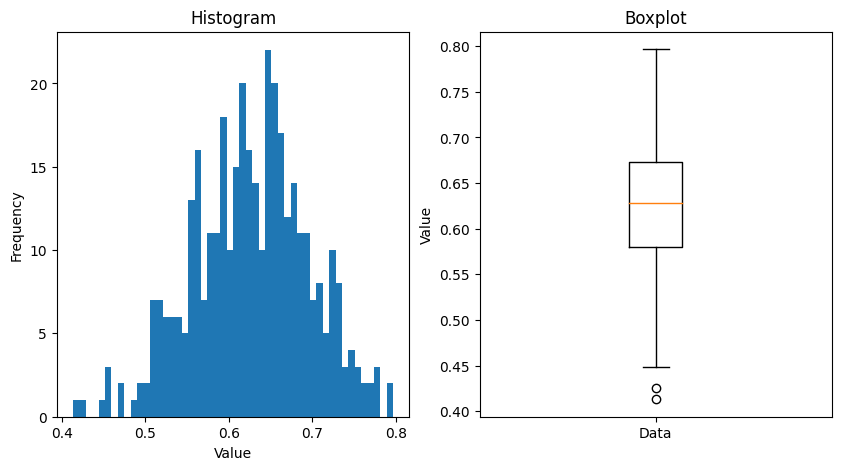

tensor(0.6264, device='cuda:0')
layer 16


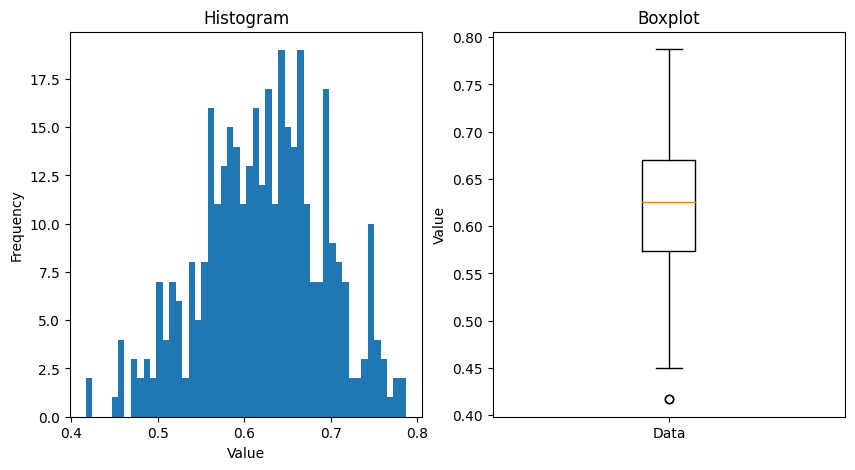

tensor(0.6220, device='cuda:0')
layer 17


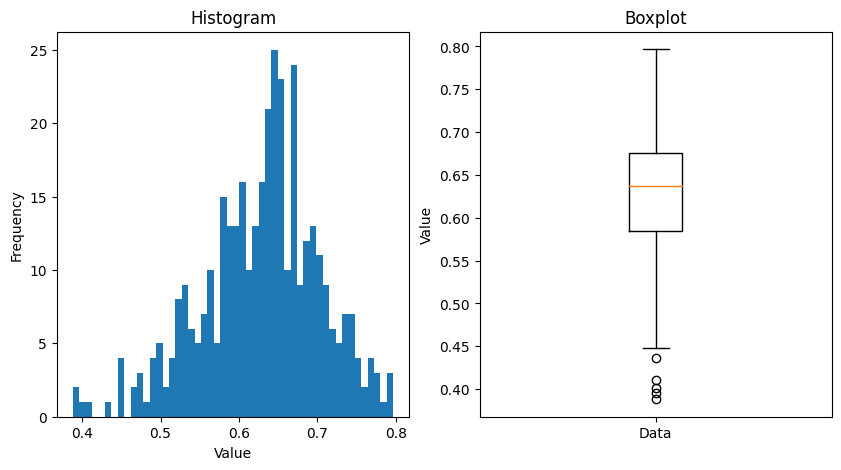

tensor(0.6285, device='cuda:0')
layer 18


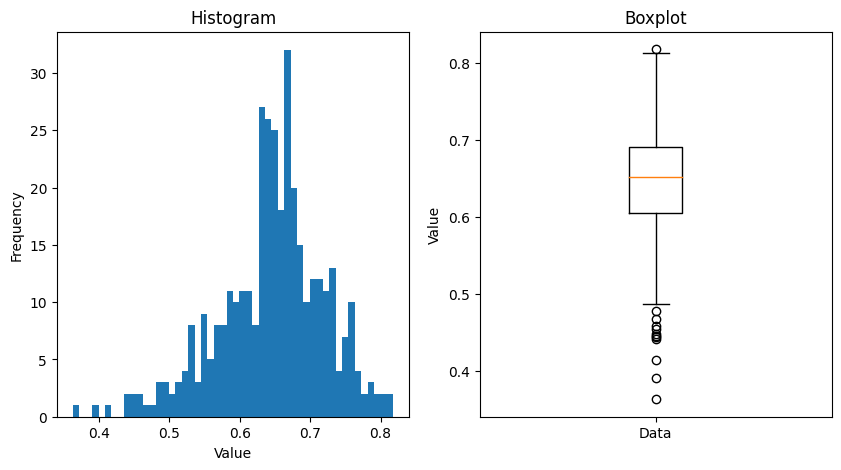

tensor(0.6456, device='cuda:0')
layer 19


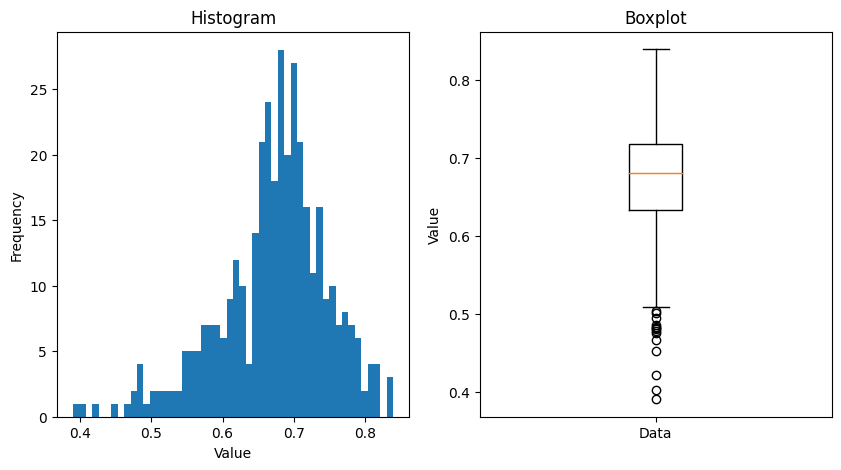

tensor(0.6721, device='cuda:0')
layer 20


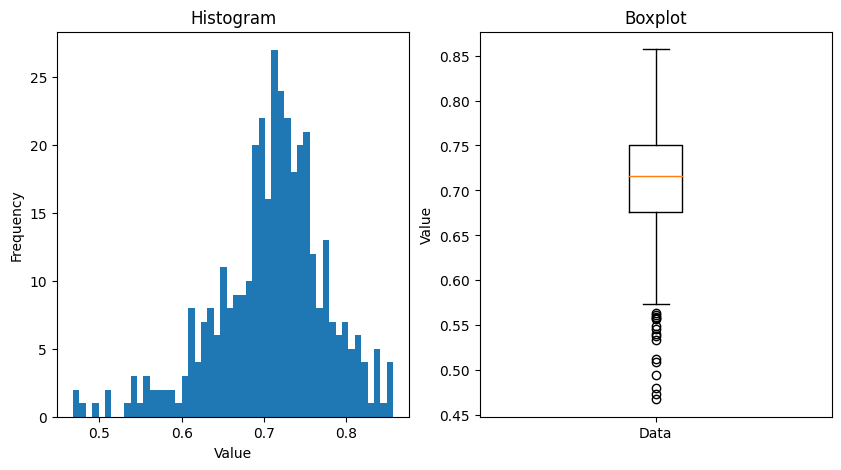

tensor(0.7092, device='cuda:0')
layer 21


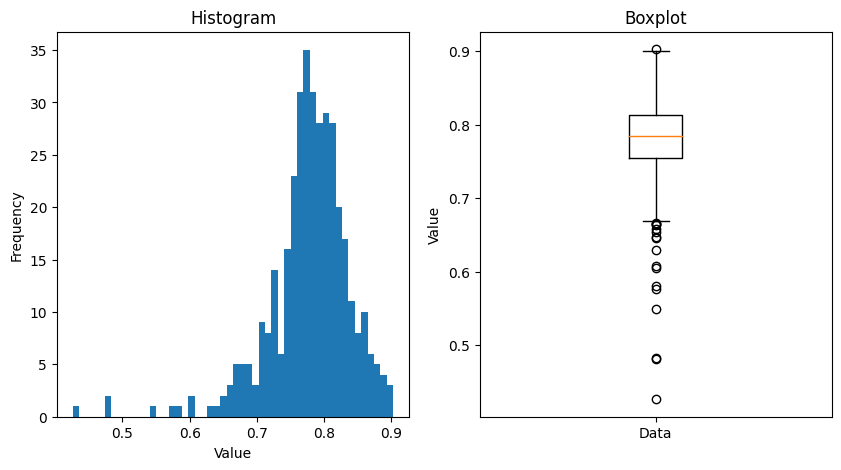

tensor(0.7774, device='cuda:0')
layer 22


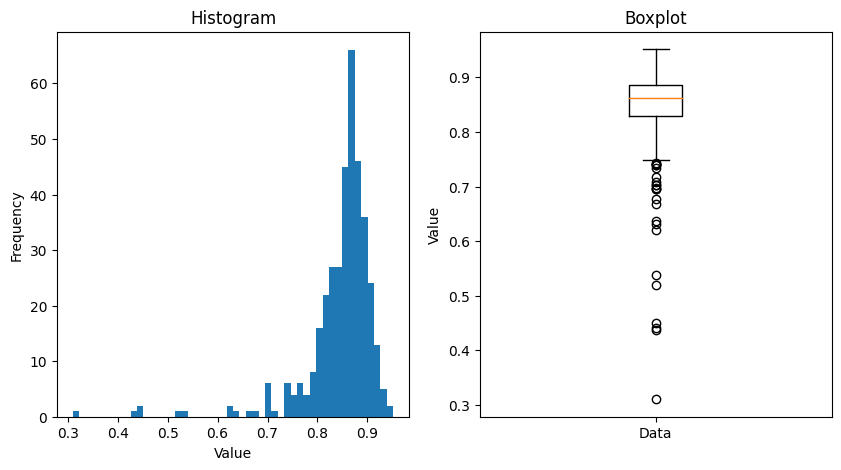

tensor(0.8457, device='cuda:0')
layer 23


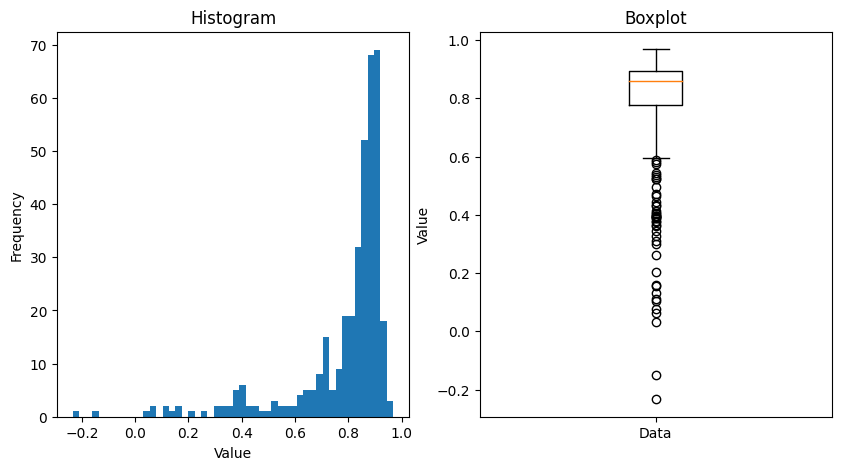

tensor(0.7876, device='cuda:0')


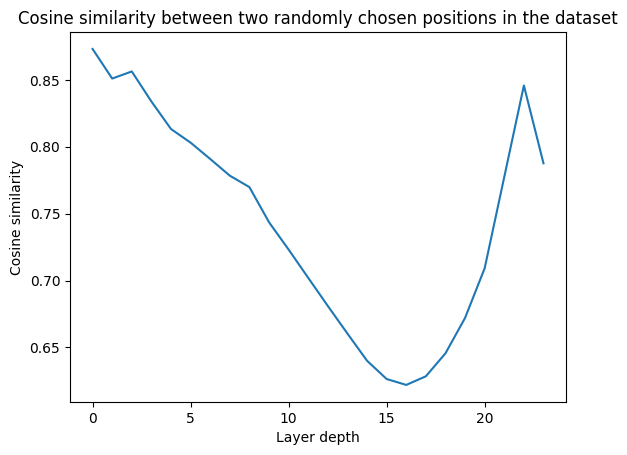

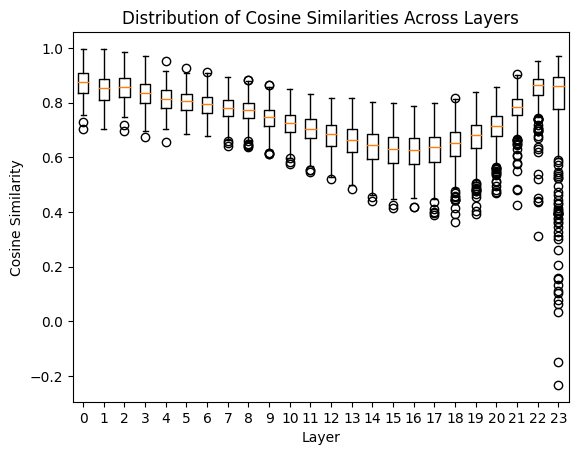

In [ ]:
plot_cosine_layer(get_cos_sims(gpt2med_the_pile_hookvecs, gpt2med_hooks))

layer 0


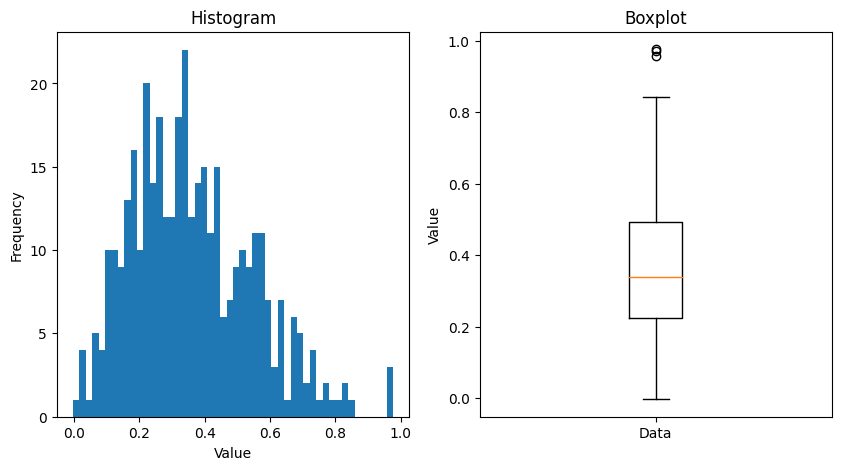

tensor(0.3631, device='cuda:0')
layer 1


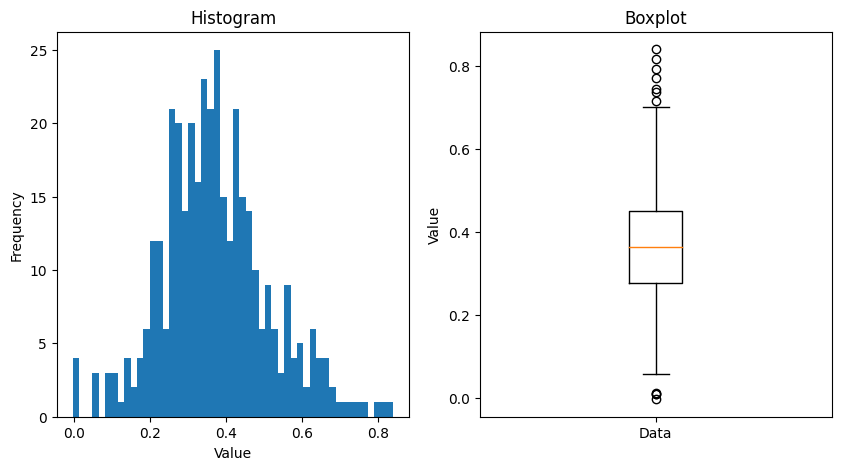

tensor(0.3720, device='cuda:0')
layer 2


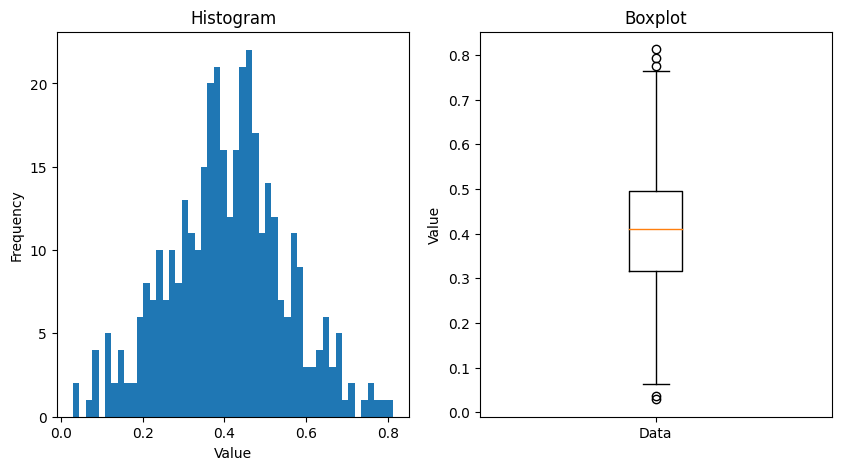

tensor(0.4078, device='cuda:0')
layer 3


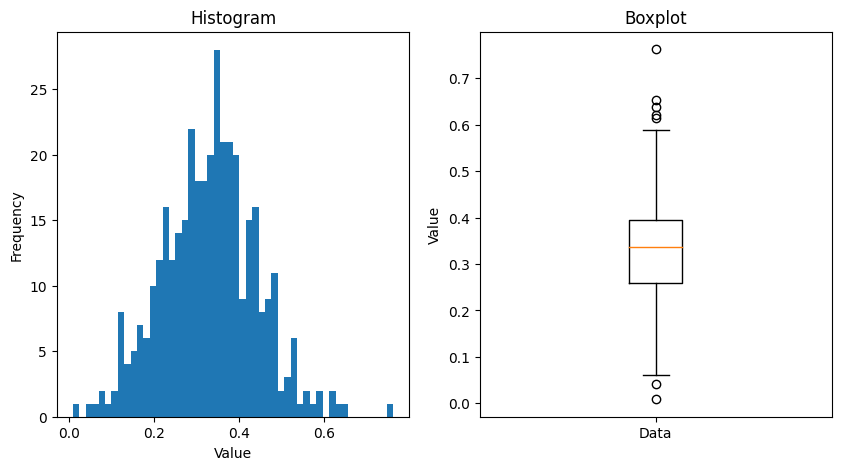

tensor(0.3301, device='cuda:0')
layer 4


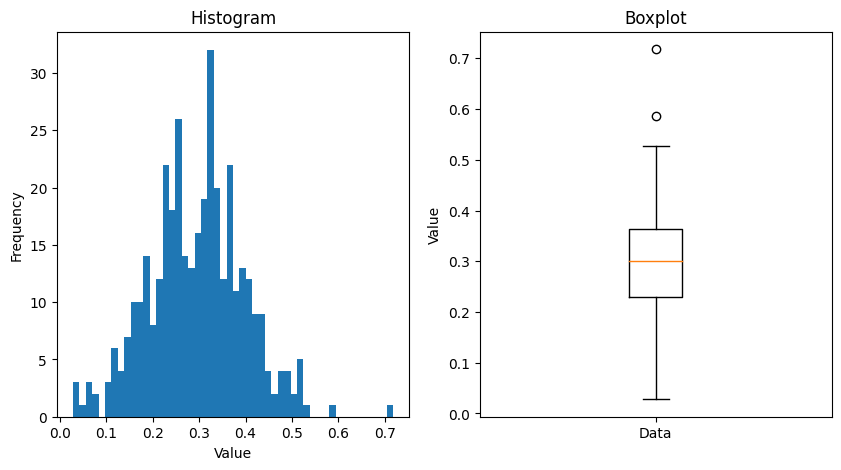

tensor(0.2952, device='cuda:0')
layer 5


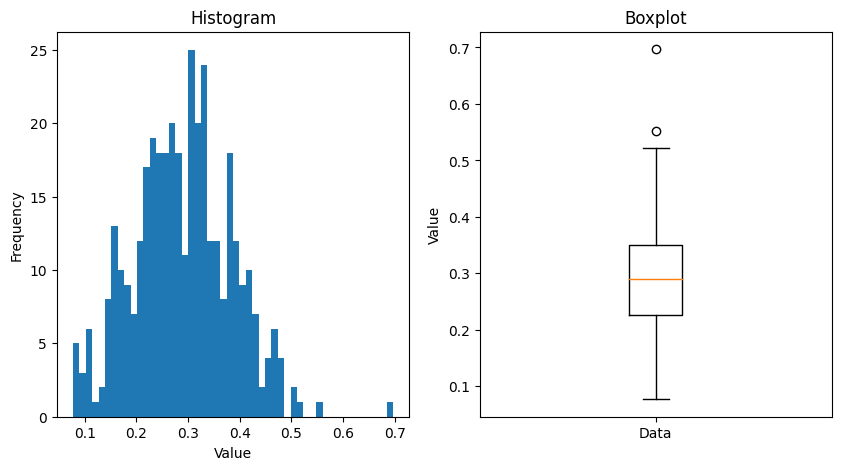

tensor(0.2903, device='cuda:0')
layer 6


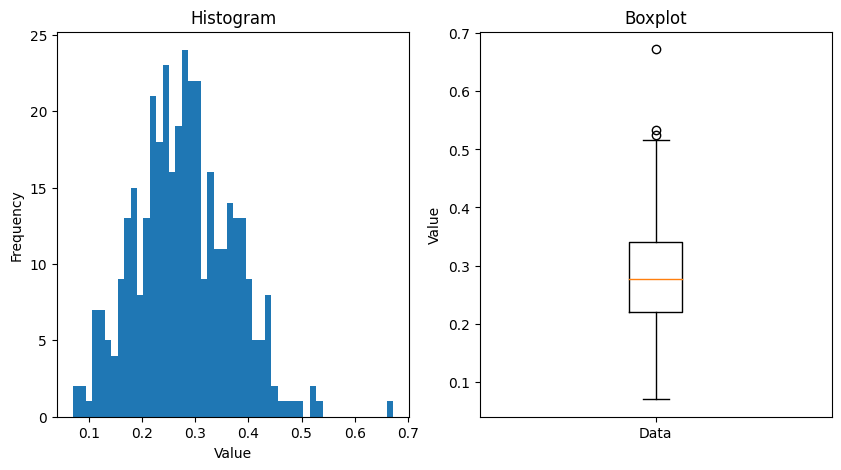

tensor(0.2793, device='cuda:0')
layer 7


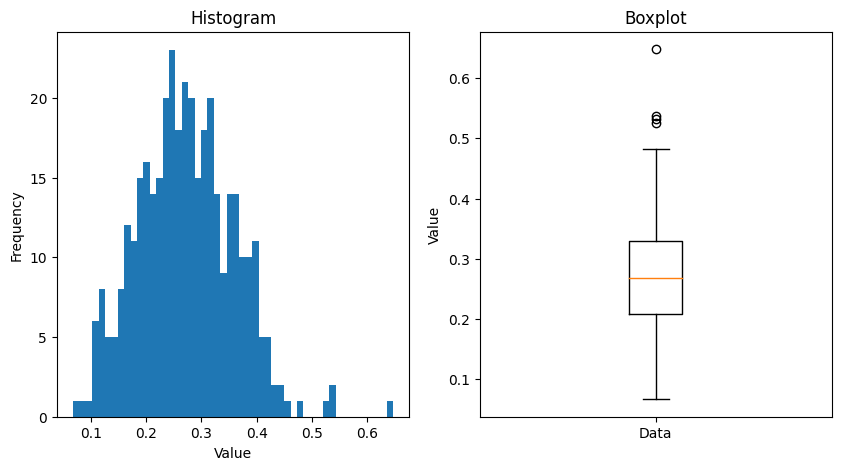

tensor(0.2721, device='cuda:0')
layer 8


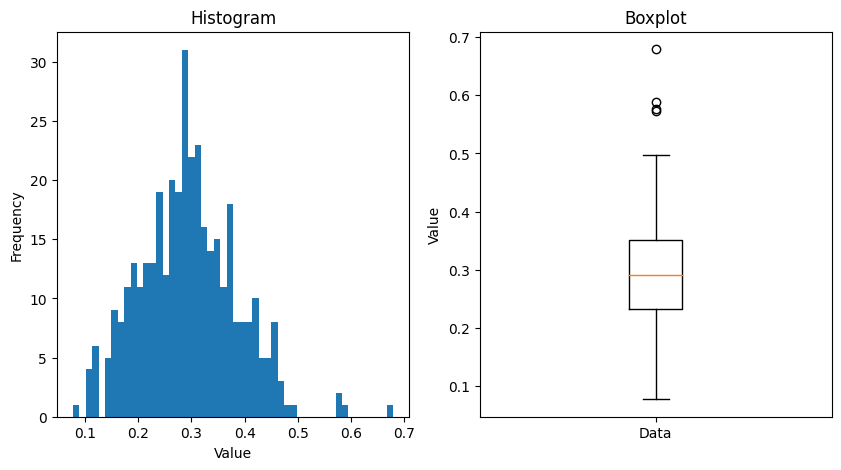

tensor(0.2940, device='cuda:0')
layer 9


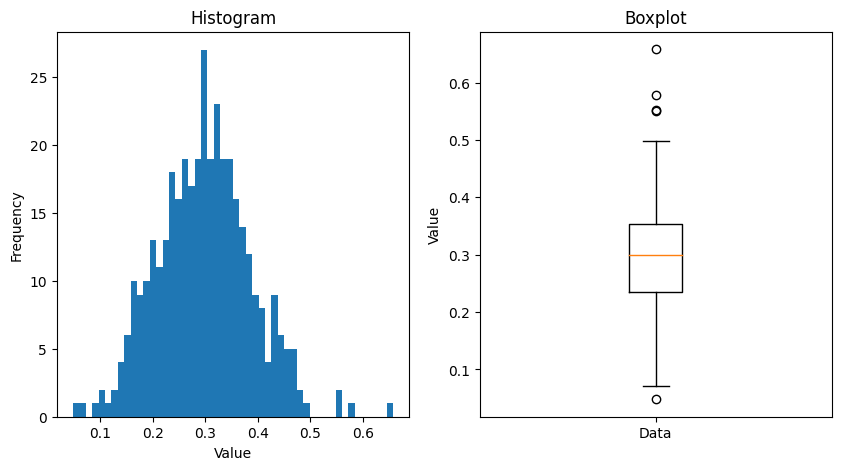

tensor(0.2983, device='cuda:0')
layer 10


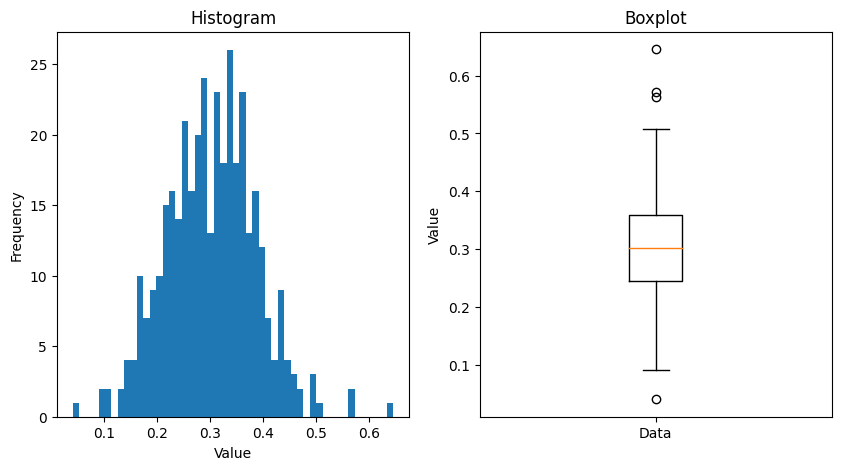

tensor(0.3024, device='cuda:0')
layer 11


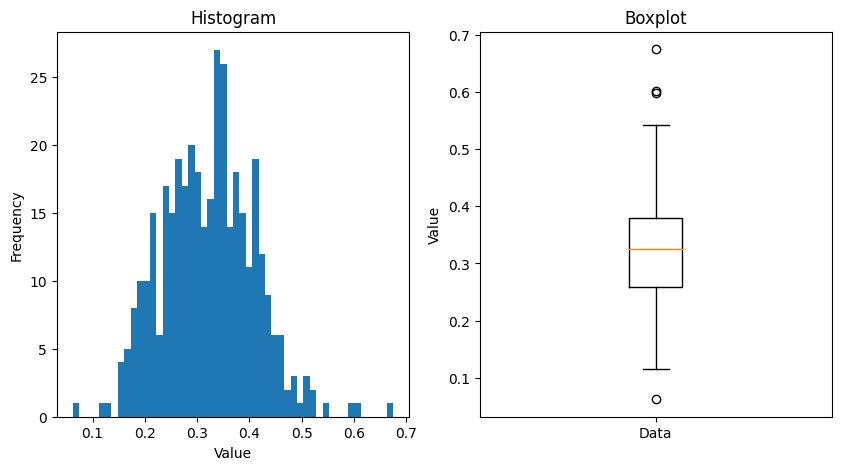

tensor(0.3215, device='cuda:0')
layer 12


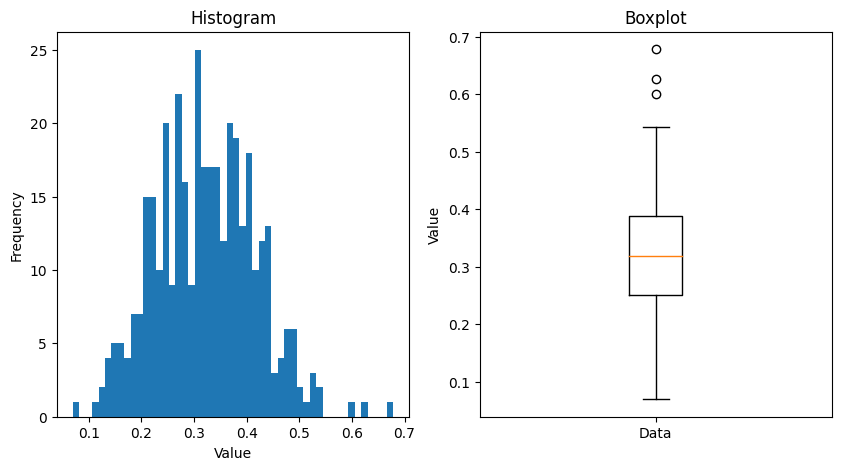

tensor(0.3226, device='cuda:0')
layer 13


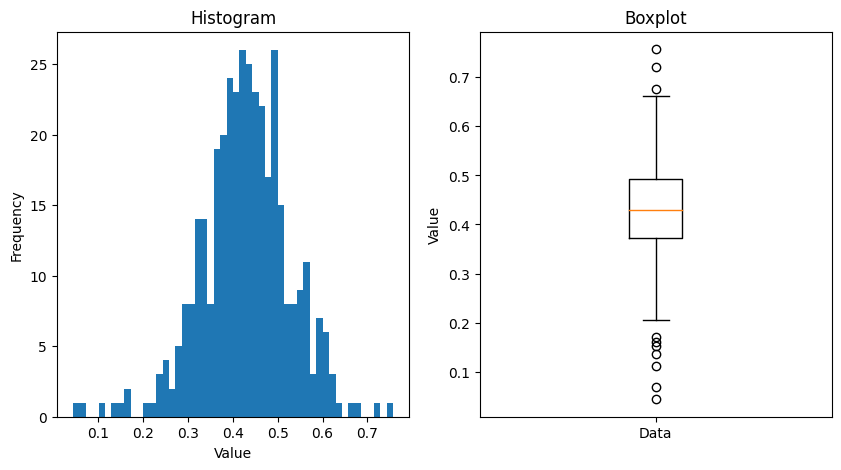

tensor(0.4283, device='cuda:0')
layer 14


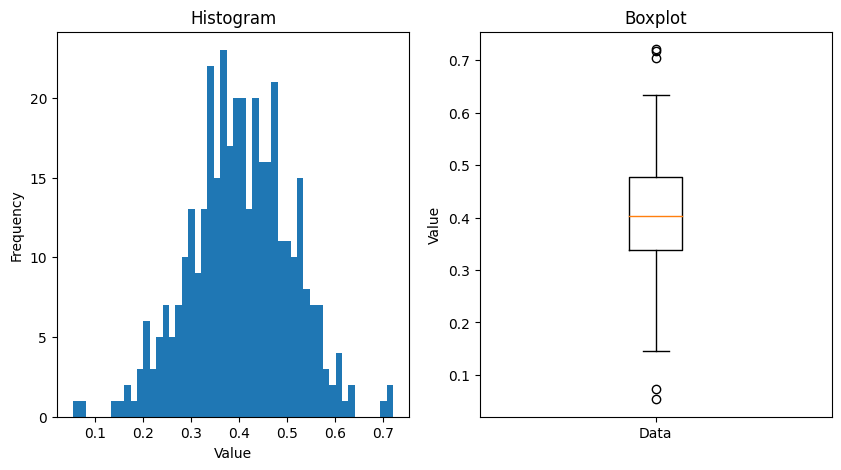

tensor(0.4034, device='cuda:0')
layer 15


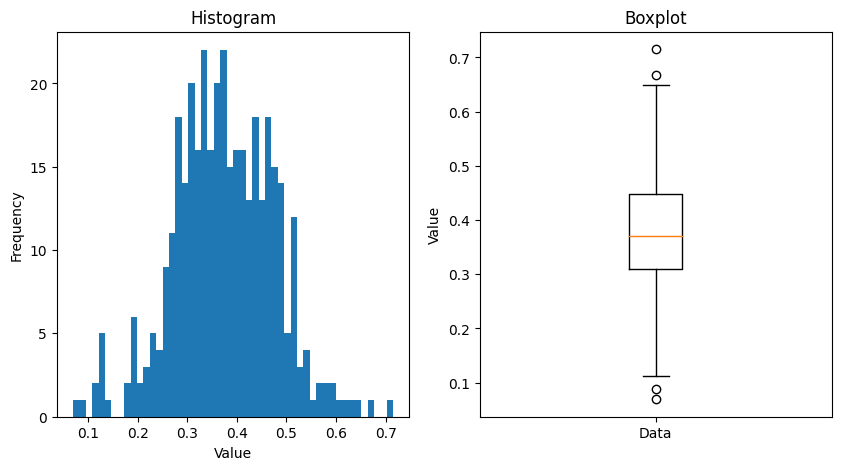

tensor(0.3751, device='cuda:0')
layer 16


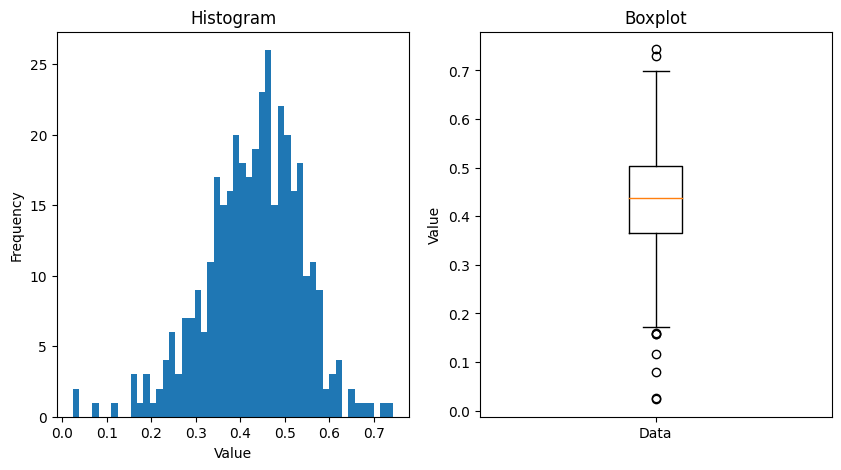

tensor(0.4292, device='cuda:0')
layer 17


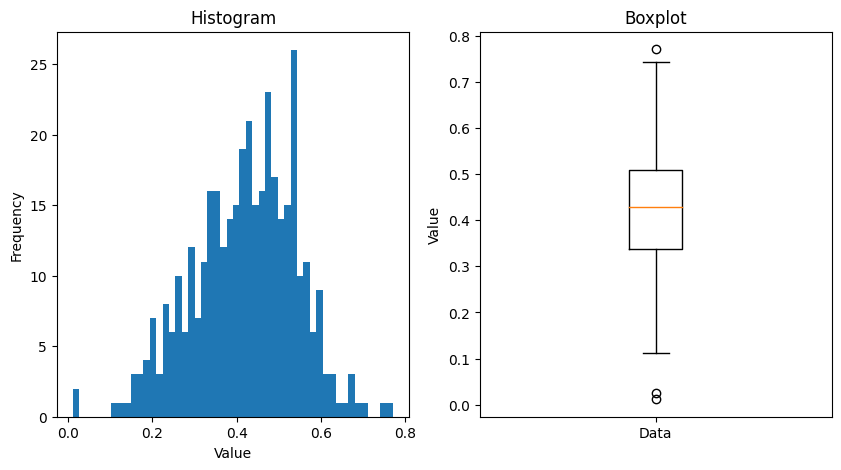

tensor(0.4195, device='cuda:0')
layer 18


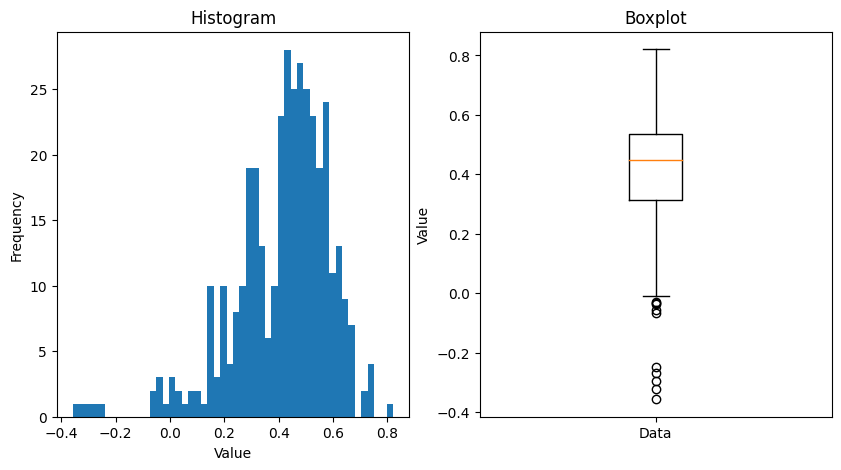

tensor(0.4141, device='cuda:0')
layer 19


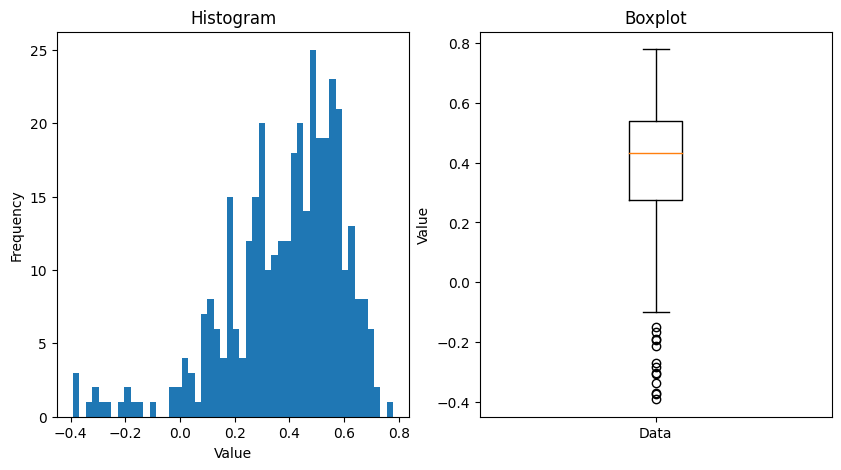

tensor(0.3860, device='cuda:0')
layer 20


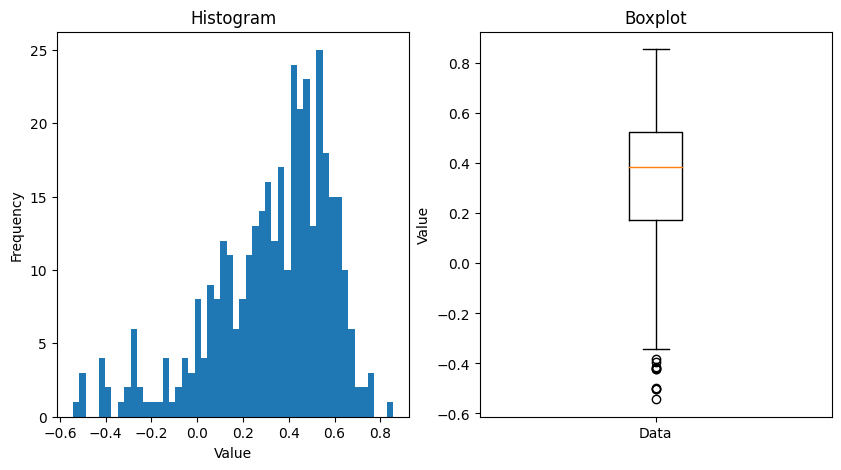

tensor(0.3256, device='cuda:0')
layer 21


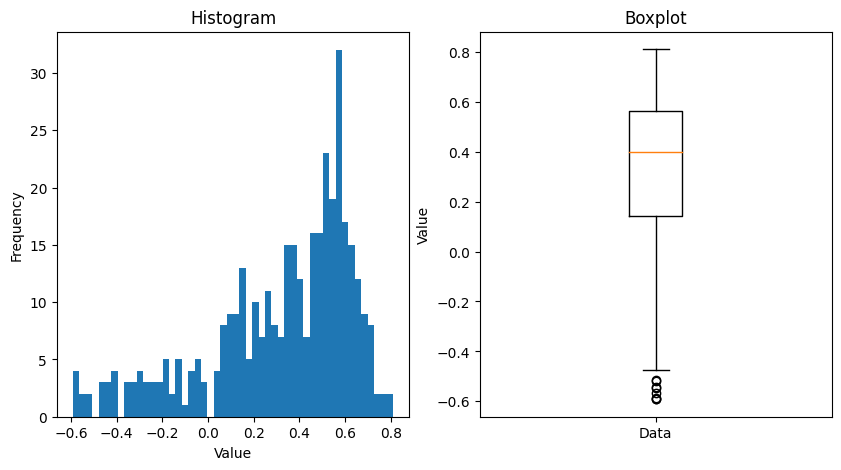

tensor(0.3164, device='cuda:0')
layer 22


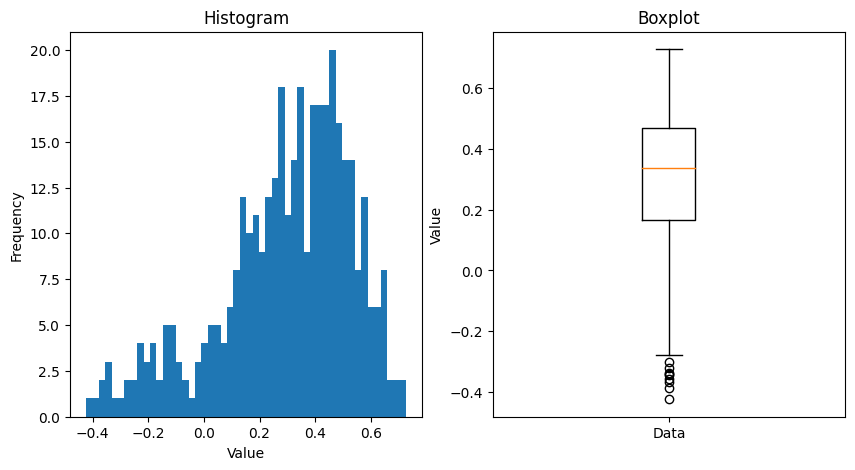

tensor(0.2939, device='cuda:0')
layer 23


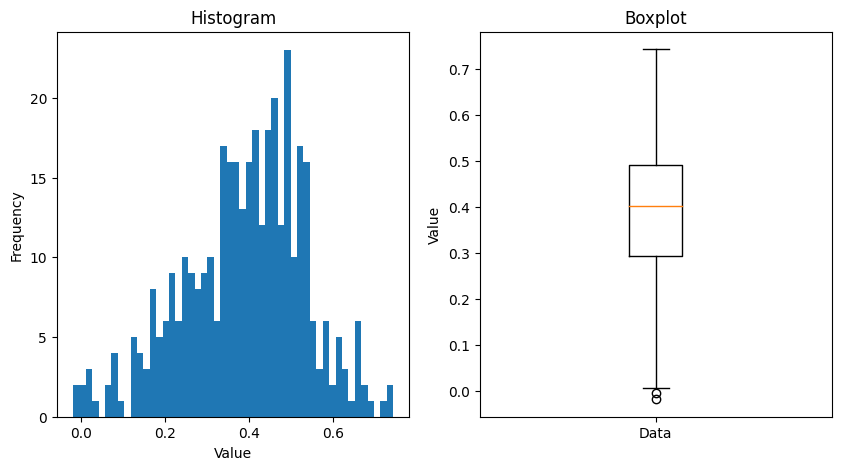

tensor(0.3881, device='cuda:0')


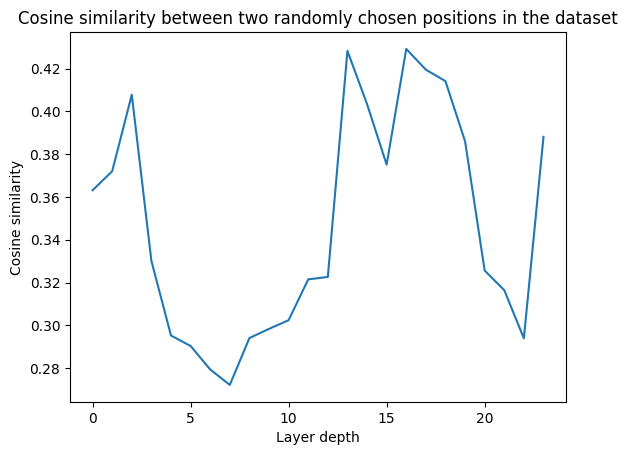

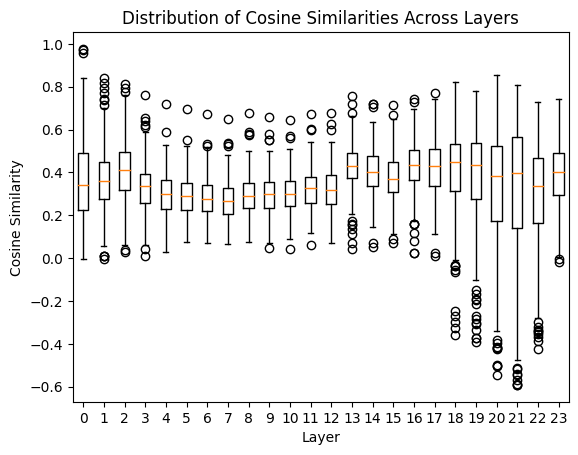

In [ ]:
plot_cosine_layer(get_cos_sims(pythia_sameval_hookvecs, pythia_hooks))

layer 0


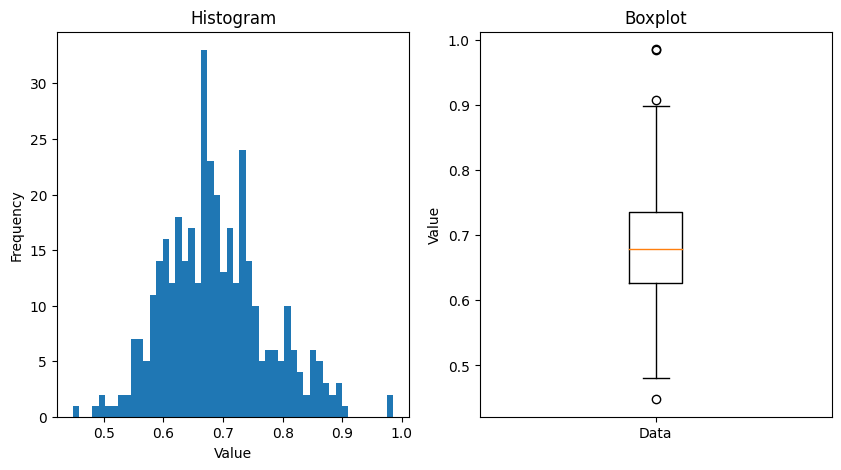

tensor(0.6878, device='cuda:0')
layer 1


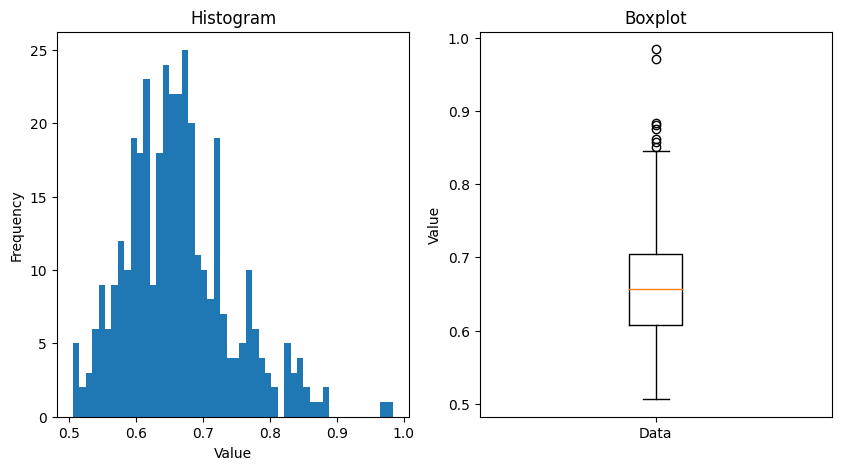

tensor(0.6633, device='cuda:0')
layer 2


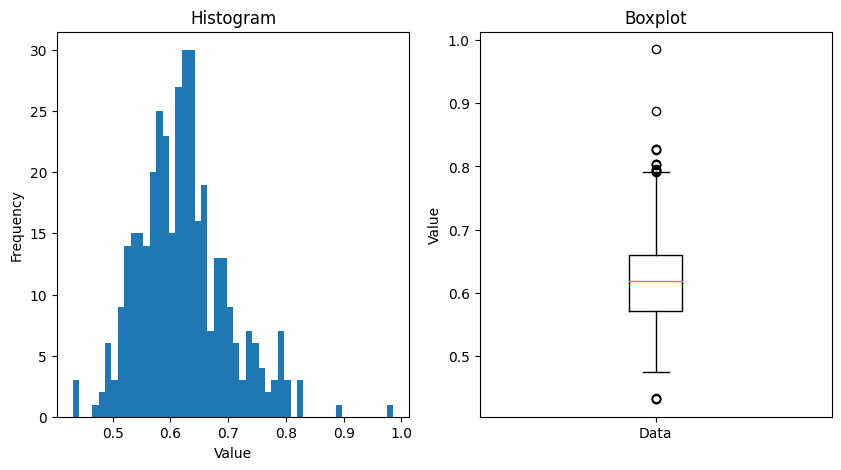

tensor(0.6222, device='cuda:0')
layer 3


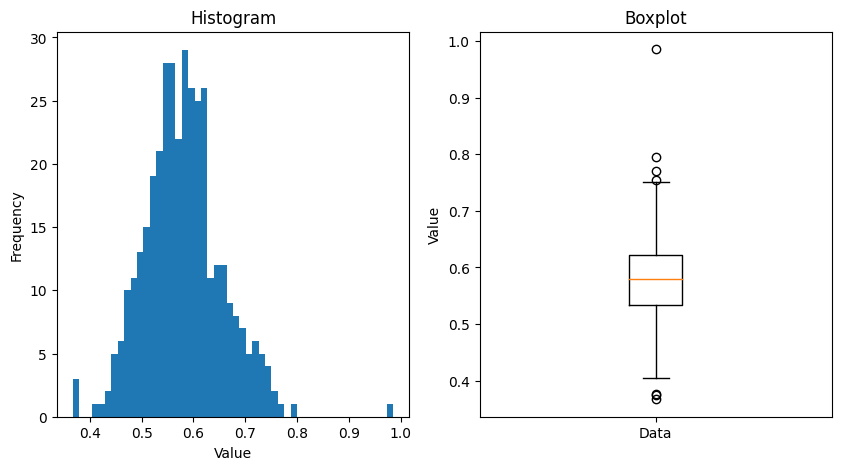

tensor(0.5811, device='cuda:0')
layer 4


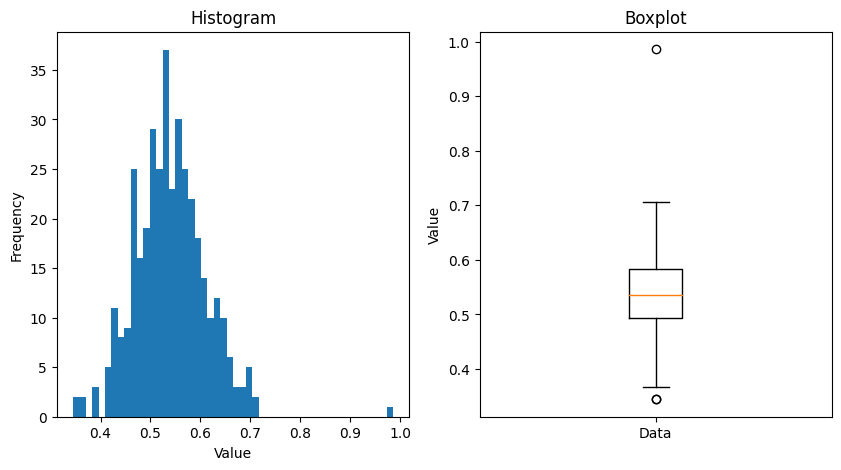

tensor(0.5398, device='cuda:0')
layer 5


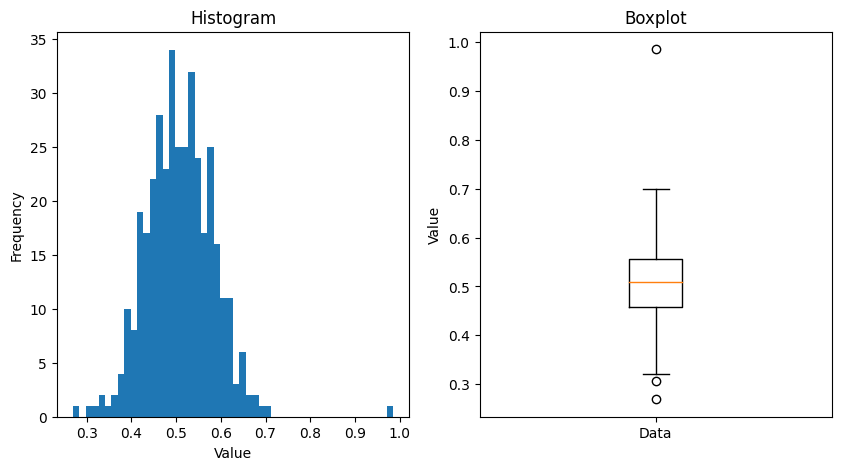

tensor(0.5089, device='cuda:0')
layer 6


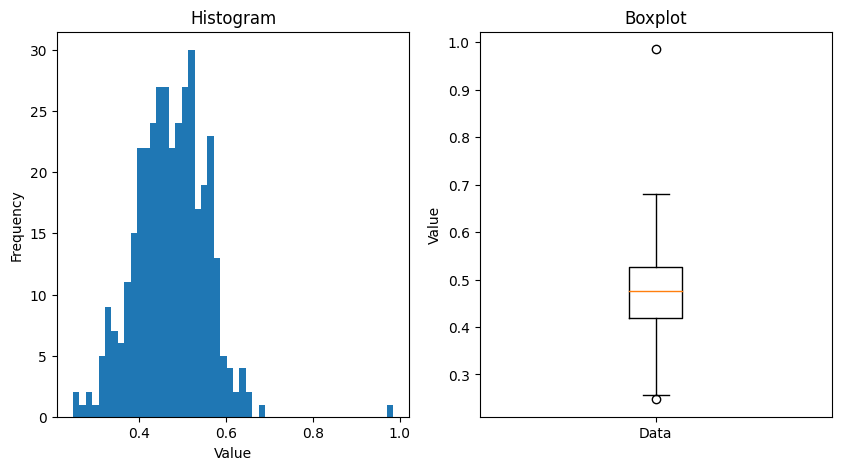

tensor(0.4731, device='cuda:0')
layer 7


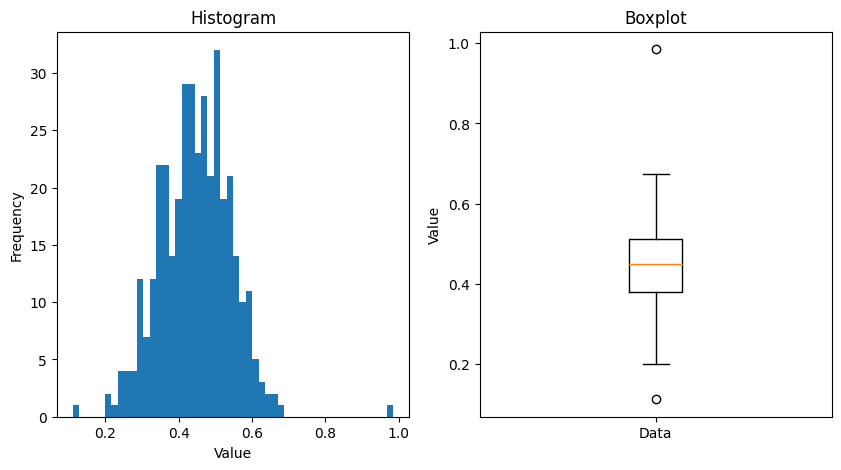

tensor(0.4464, device='cuda:0')
layer 8


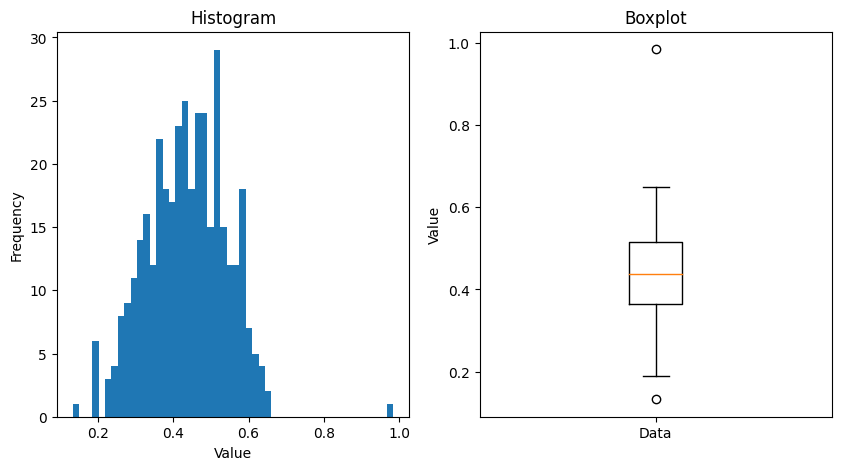

tensor(0.4366, device='cuda:0')
layer 9


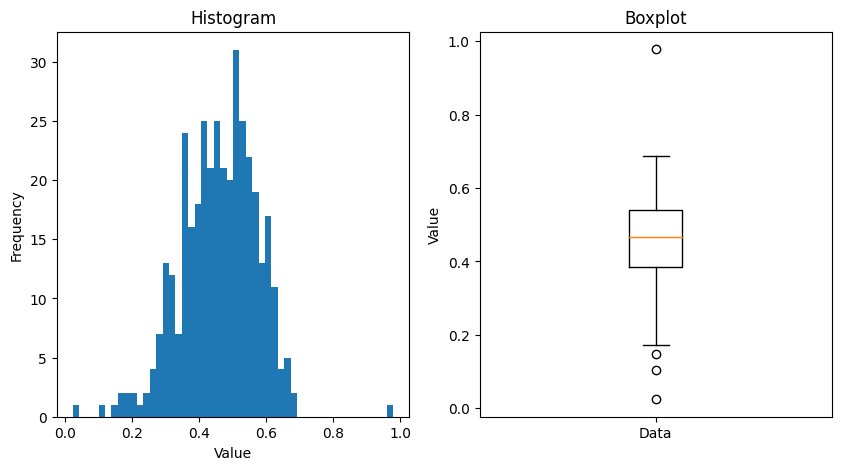

tensor(0.4608, device='cuda:0')
layer 10


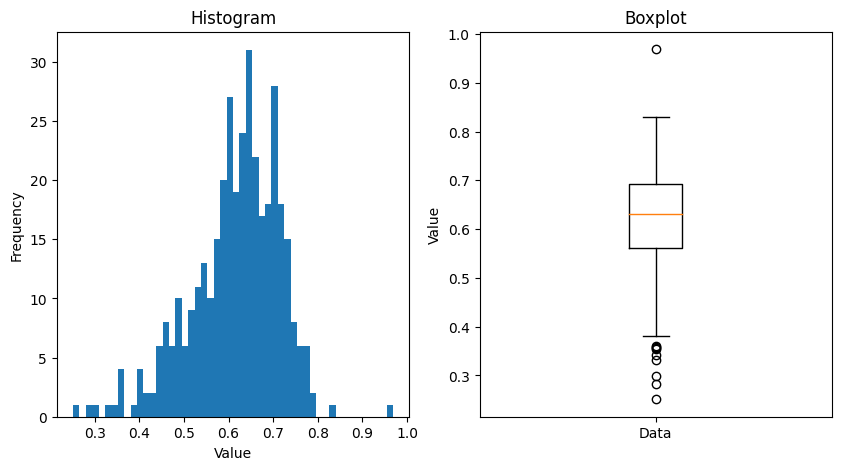

tensor(0.6163, device='cuda:0')
layer 11


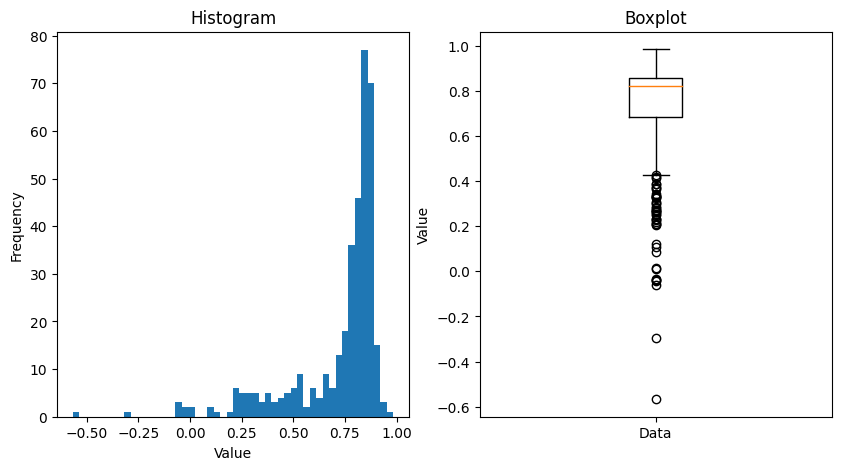

tensor(0.7212, device='cuda:0')


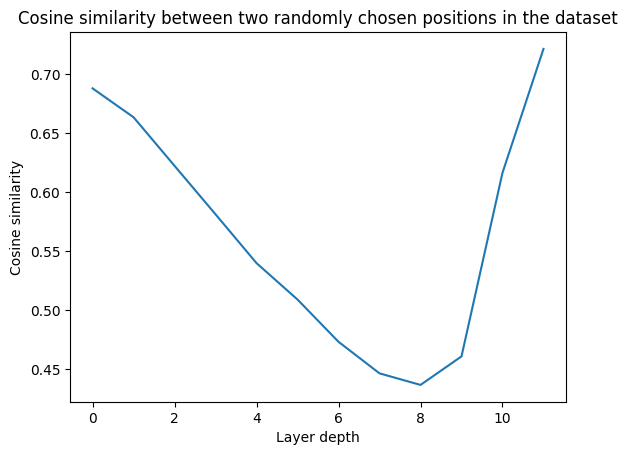

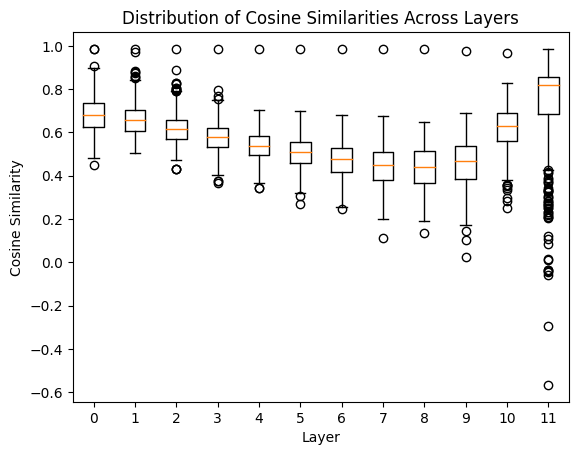

In [ ]:
plot_cosine_layer(get_cos_sims(gpt2_sameval_hookvecs, gpt2_hooks))

layer 0


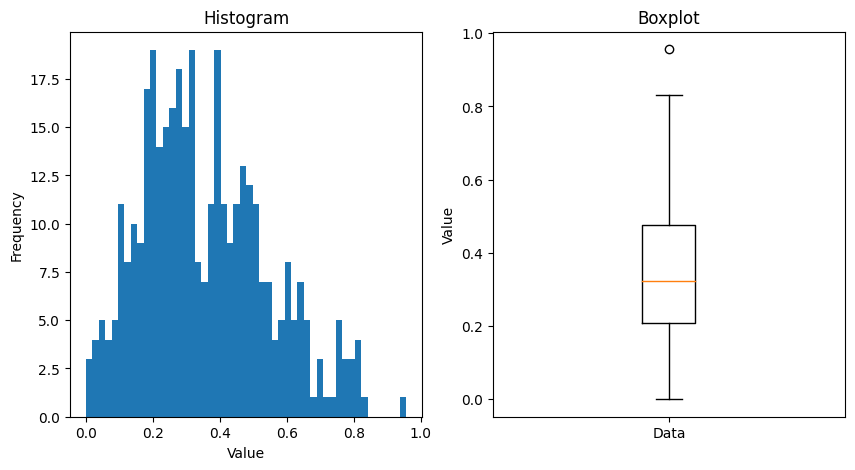

tensor(0.3552, device='cuda:0')
layer 1


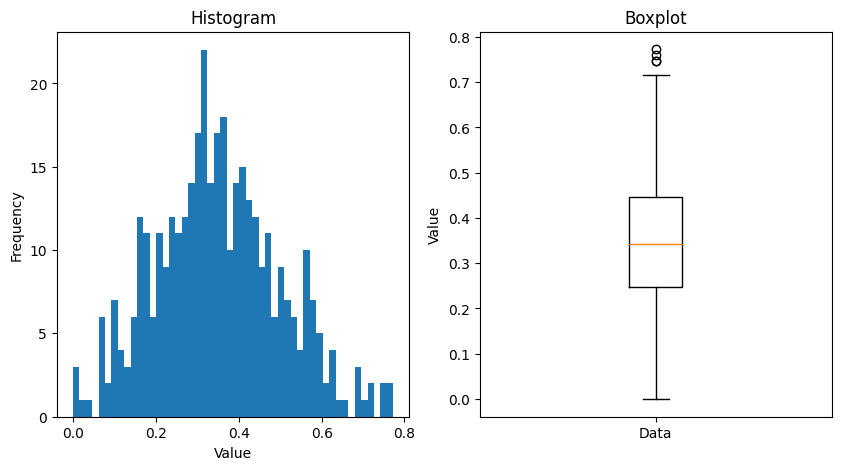

tensor(0.3506, device='cuda:0')
layer 2


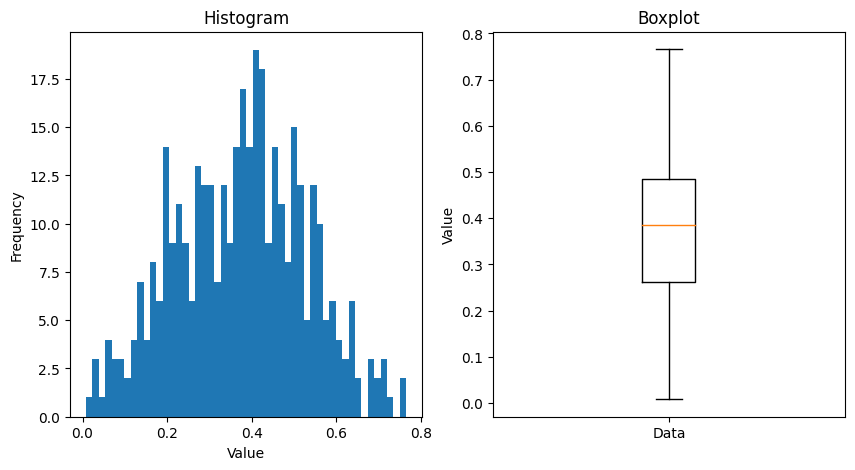

tensor(0.3753, device='cuda:0')
layer 3


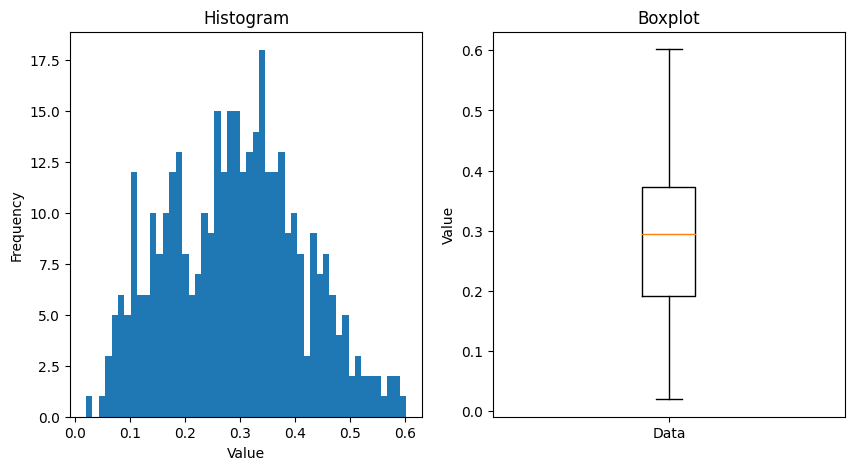

tensor(0.2909, device='cuda:0')
layer 4


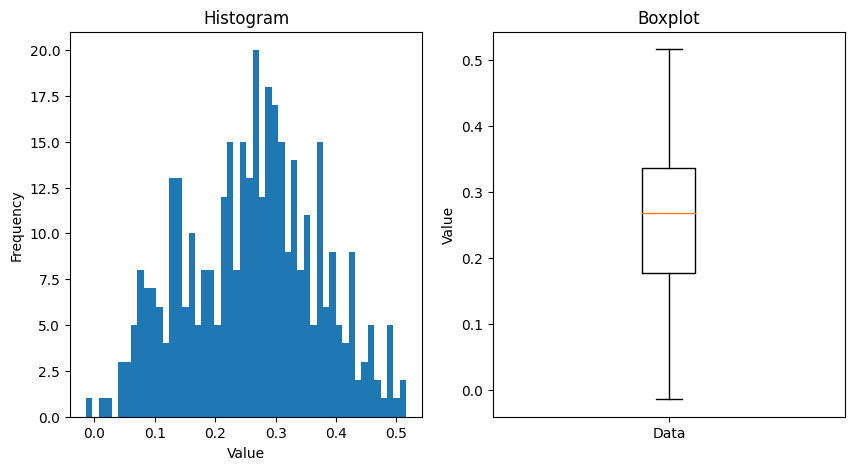

tensor(0.2612, device='cuda:0')
layer 5


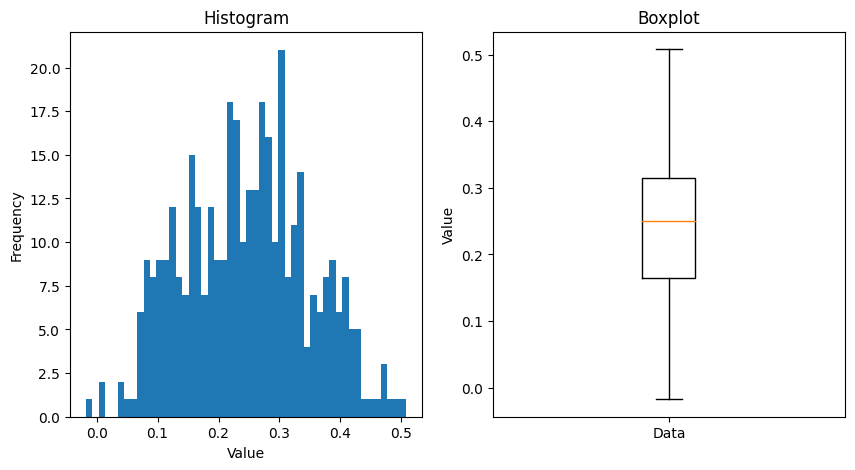

tensor(0.2460, device='cuda:0')
layer 6


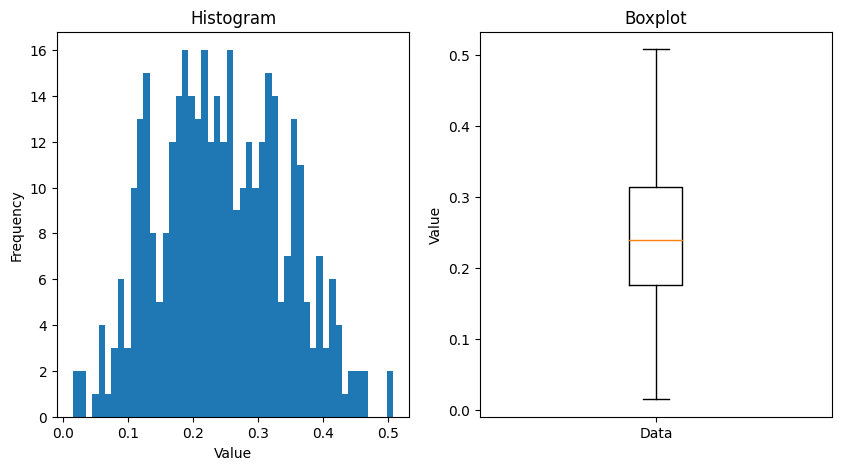

tensor(0.2434, device='cuda:0')
layer 7


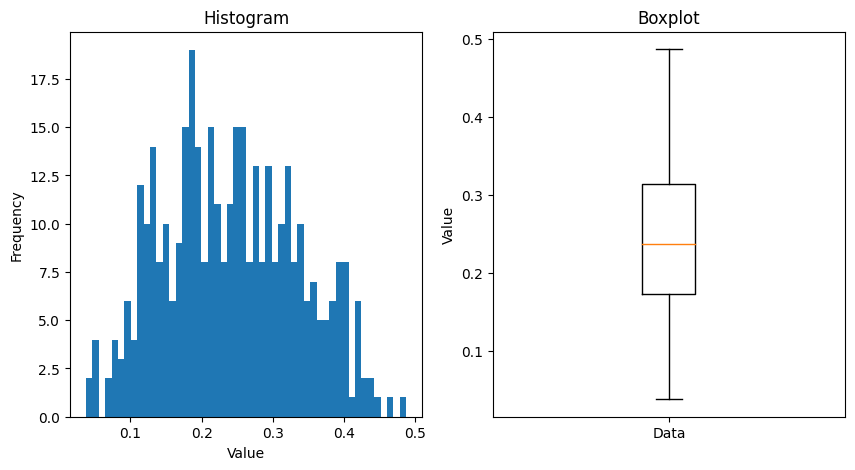

tensor(0.2410, device='cuda:0')
layer 8


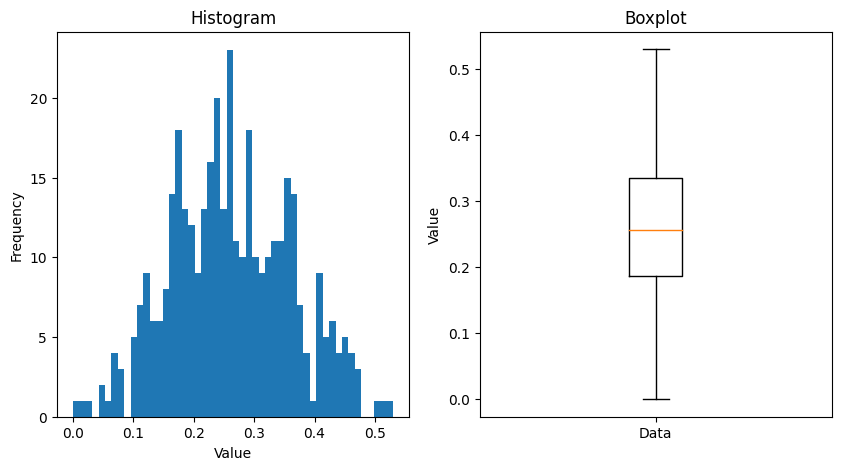

tensor(0.2620, device='cuda:0')
layer 9


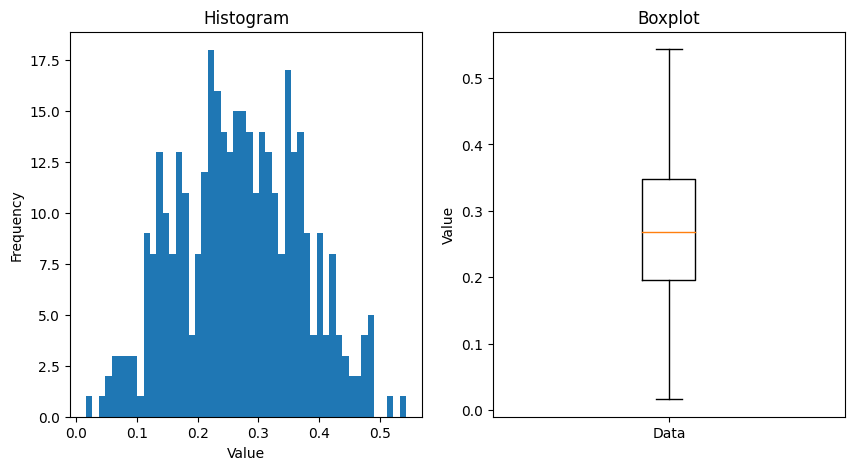

tensor(0.2695, device='cuda:0')
layer 10


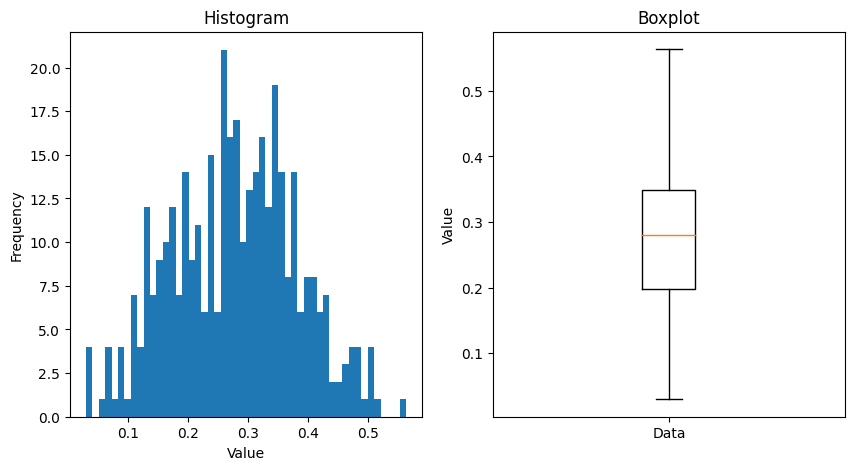

tensor(0.2779, device='cuda:0')
layer 11


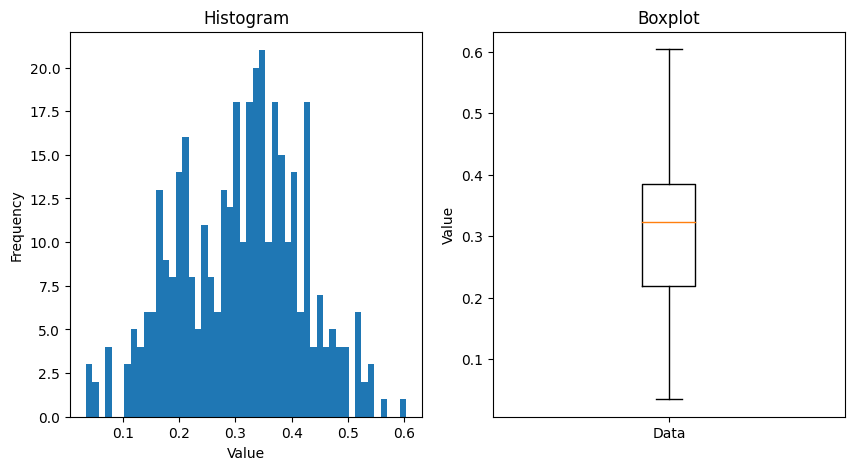

tensor(0.3091, device='cuda:0')
layer 12


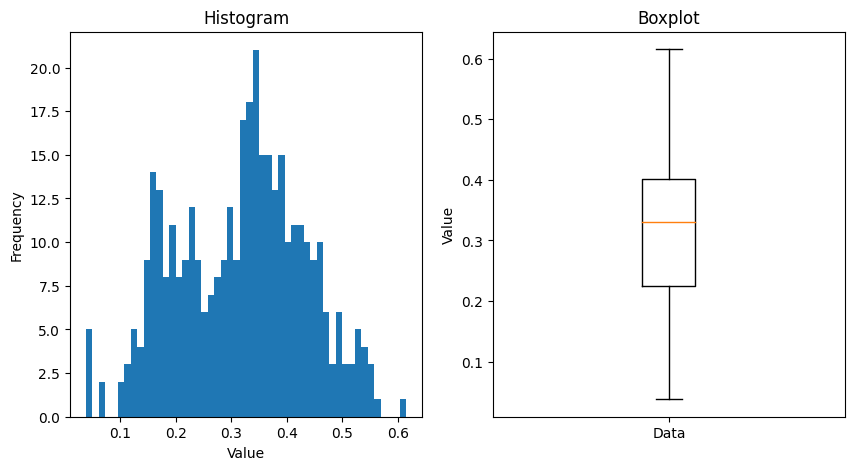

tensor(0.3172, device='cuda:0')
layer 13


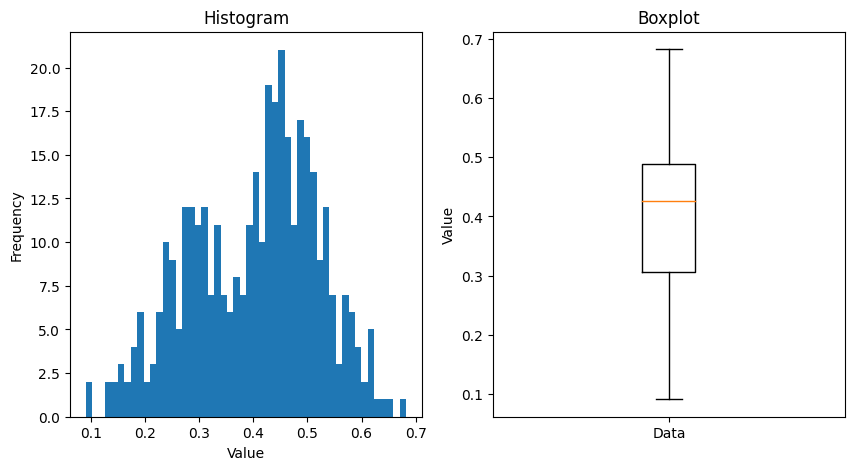

tensor(0.4022, device='cuda:0')
layer 14


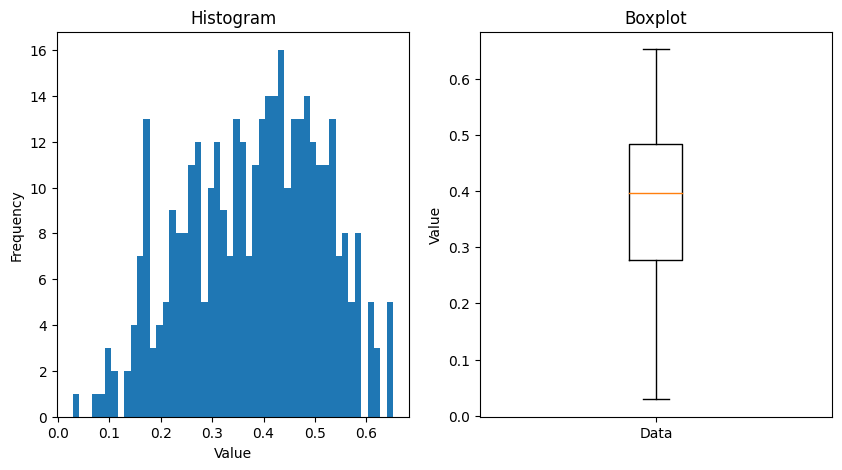

tensor(0.3830, device='cuda:0')
layer 15


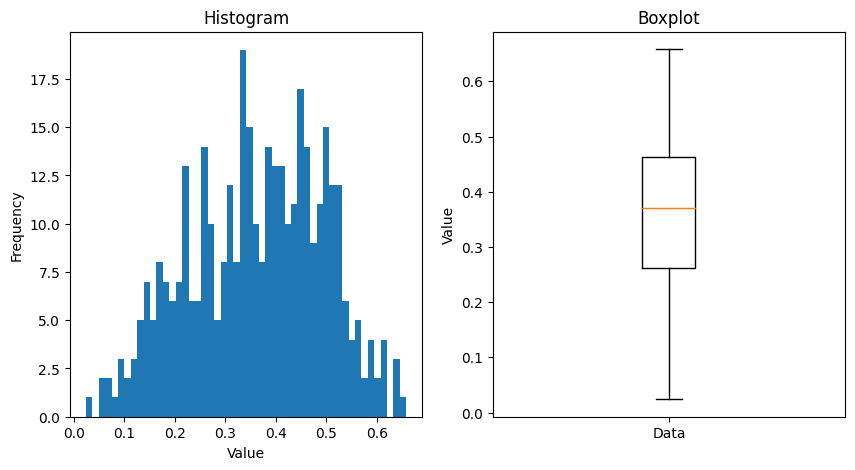

tensor(0.3623, device='cuda:0')
layer 16


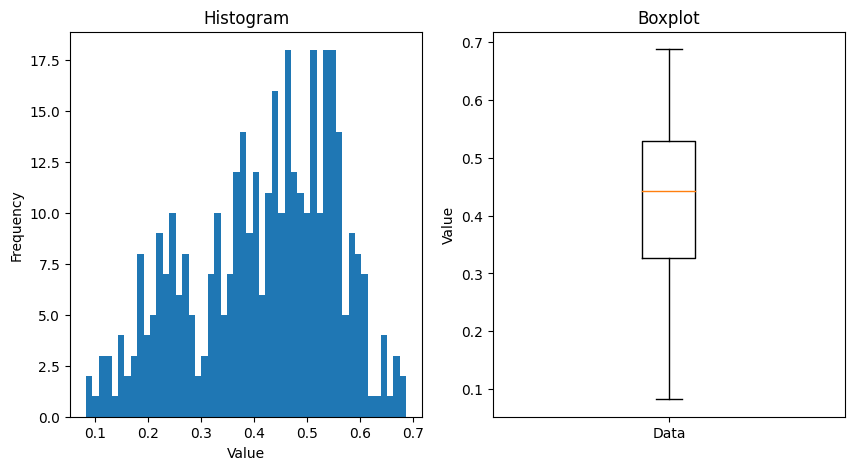

tensor(0.4171, device='cuda:0')
layer 17


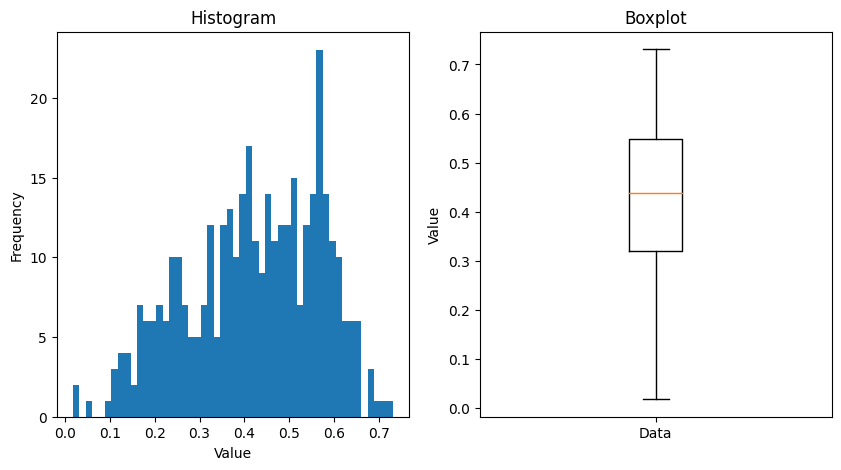

tensor(0.4209, device='cuda:0')
layer 18


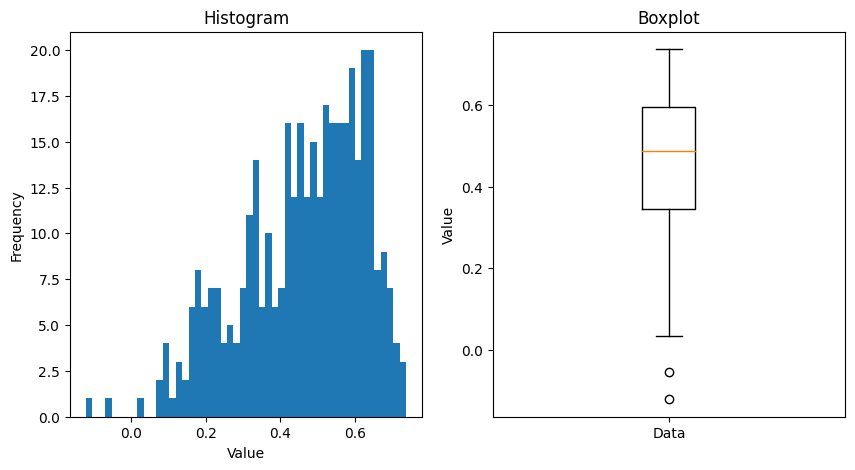

tensor(0.4612, device='cuda:0')
layer 19


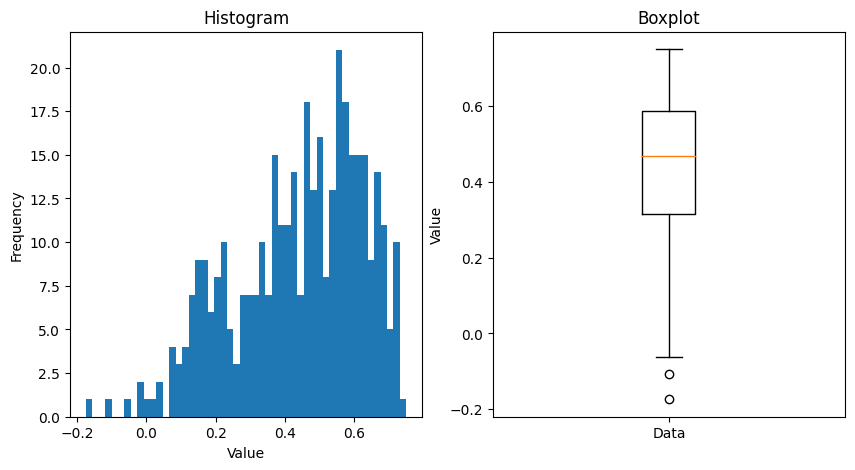

tensor(0.4386, device='cuda:0')
layer 20


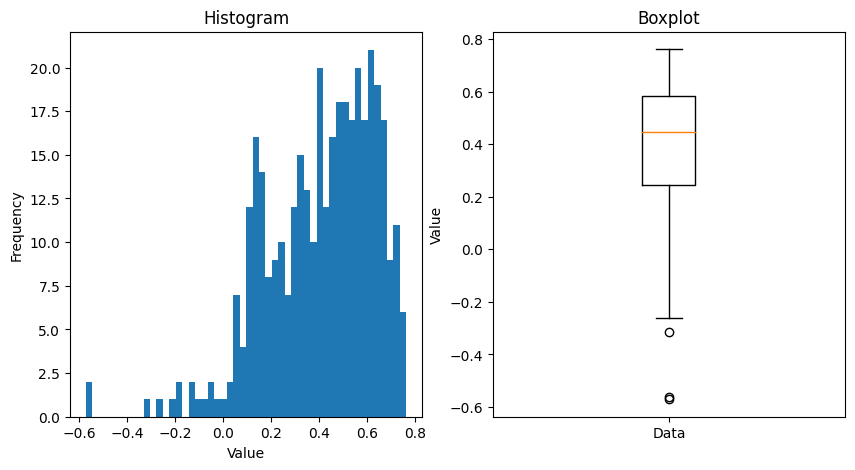

tensor(0.4042, device='cuda:0')
layer 21


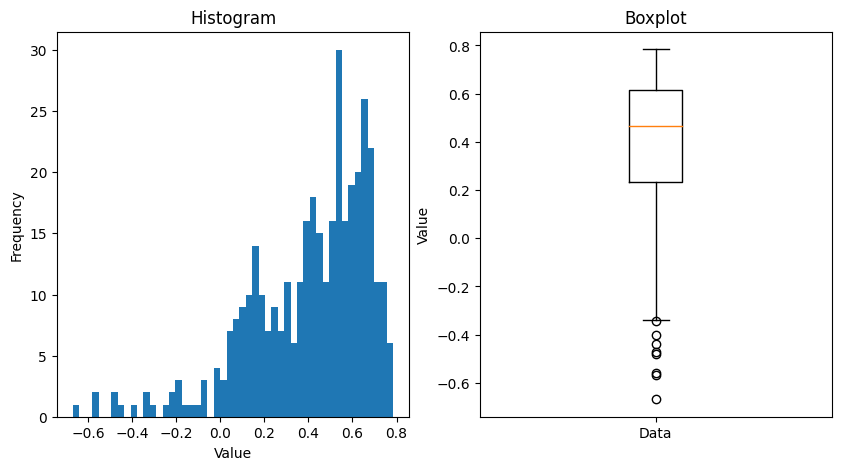

tensor(0.4041, device='cuda:0')
layer 22


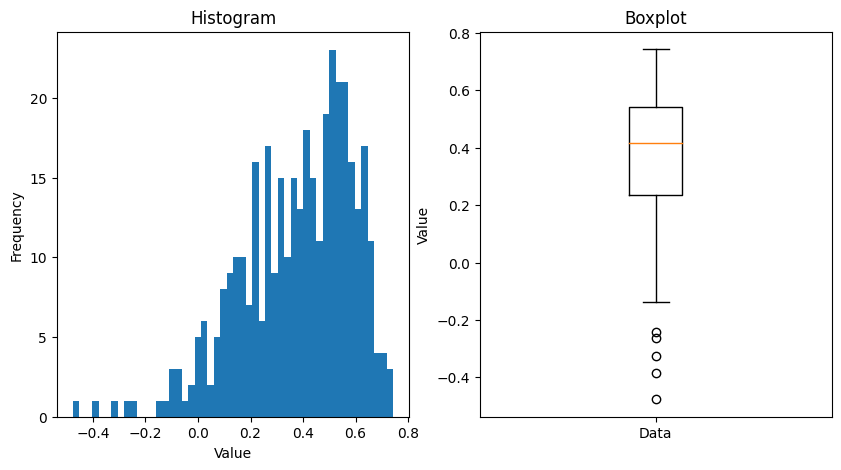

tensor(0.3769, device='cuda:0')
layer 23


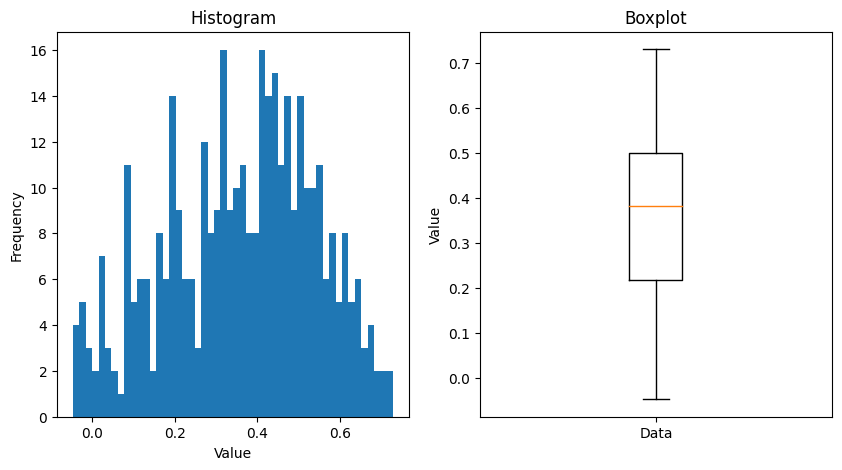

tensor(0.3602, device='cuda:0')


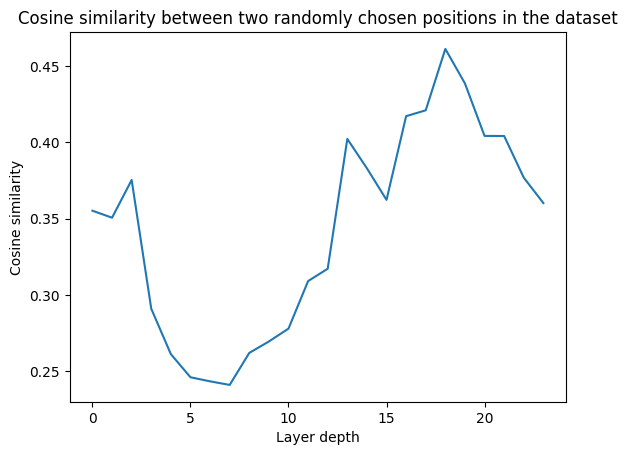

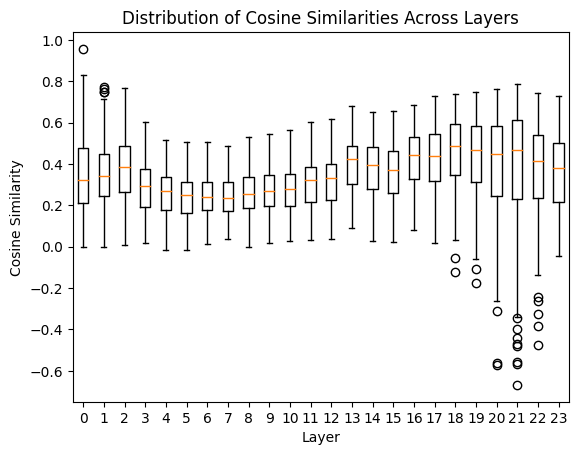

In [ ]:
plot_cosine_layer(get_cos_sims(pythia_the_pile_hookvecs, pythia_hooks))

layer 0


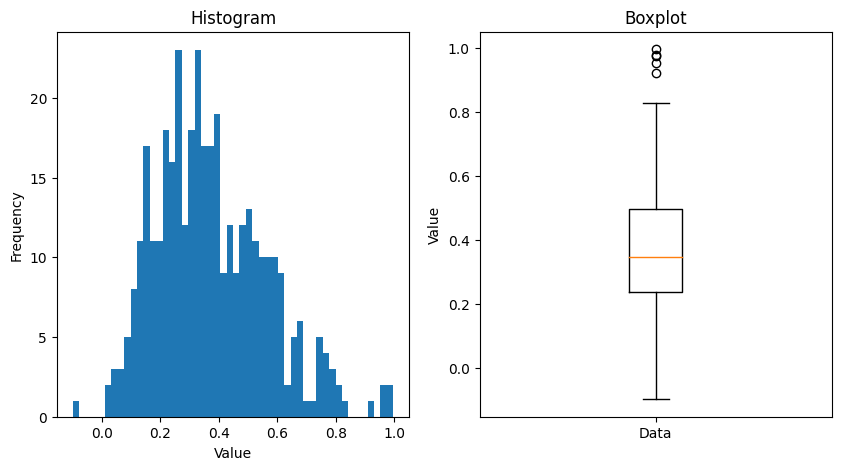

tensor(0.3732, device='cuda:0')
layer 1


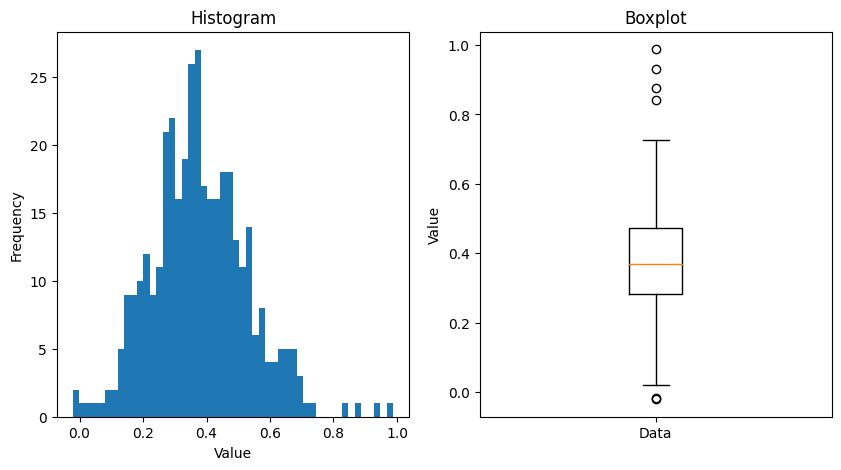

tensor(0.3799, device='cuda:0')
layer 2


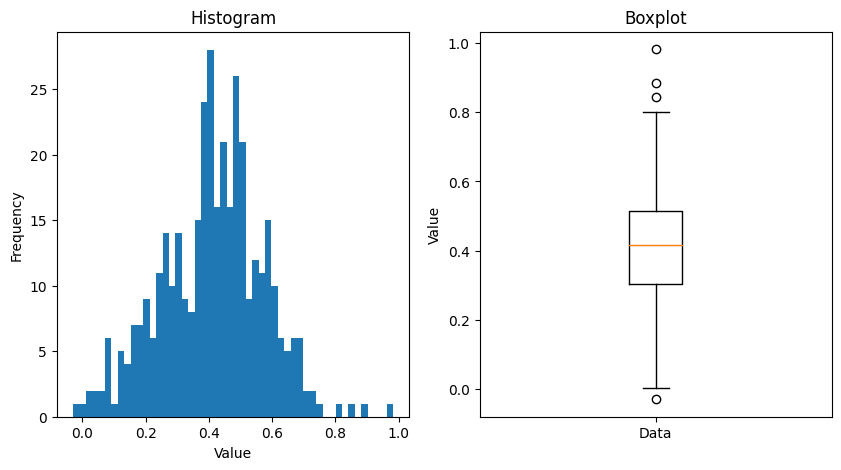

tensor(0.4121, device='cuda:0')
layer 3


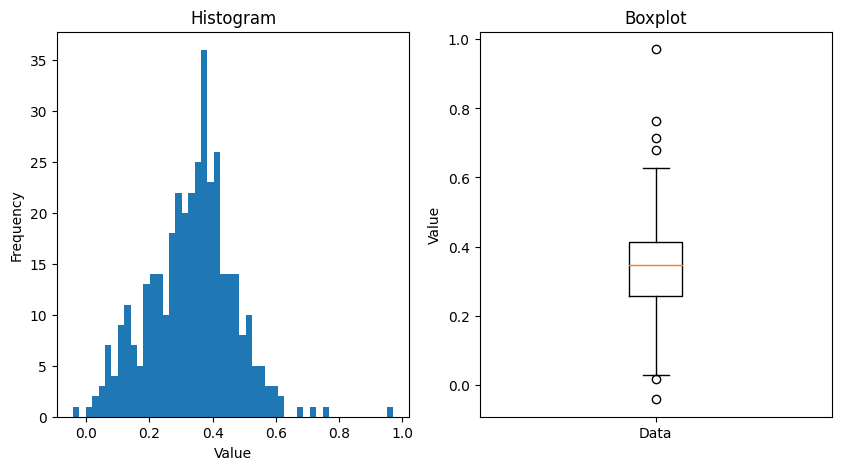

tensor(0.3333, device='cuda:0')
layer 4


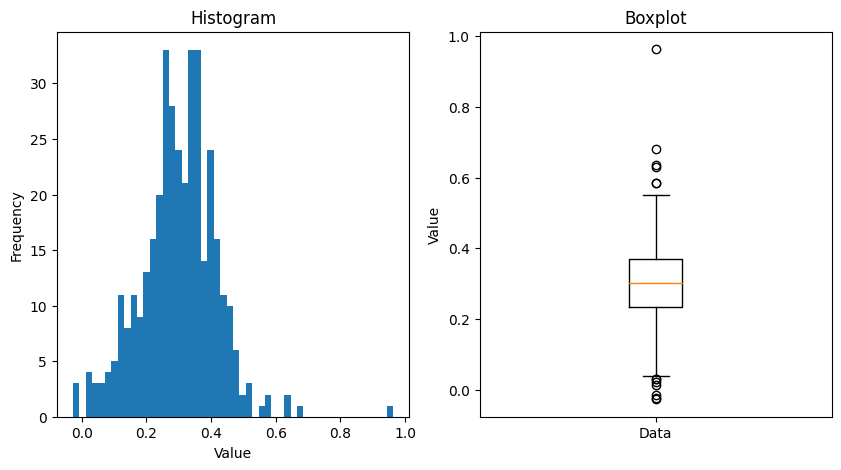

tensor(0.2997, device='cuda:0')
layer 5


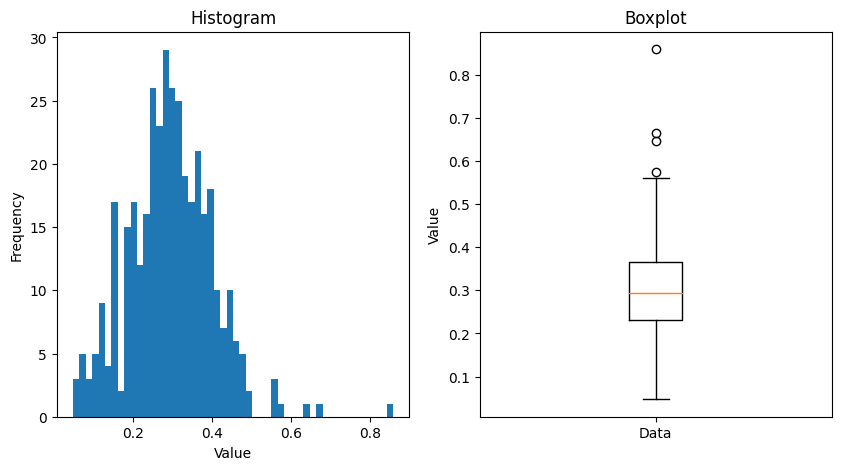

tensor(0.2941, device='cuda:0')
layer 6


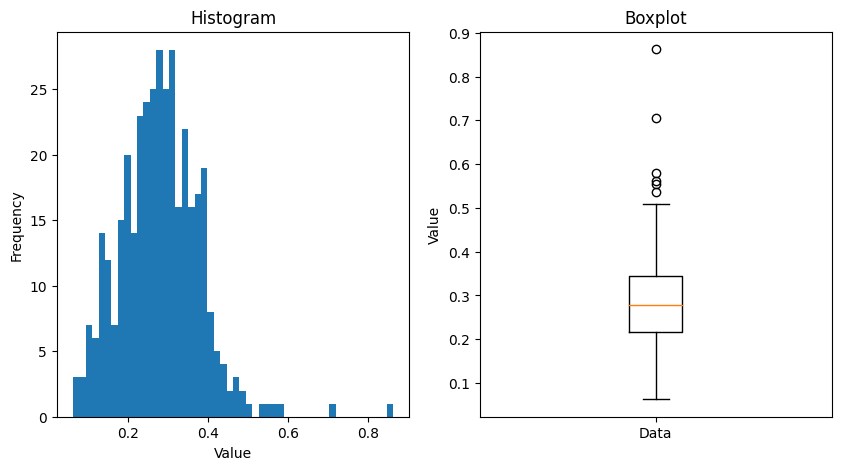

tensor(0.2805, device='cuda:0')
layer 7


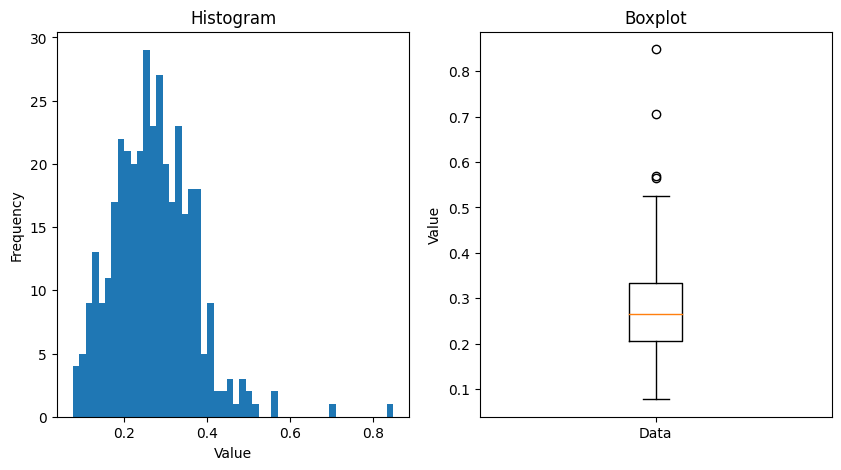

tensor(0.2721, device='cuda:0')
layer 8


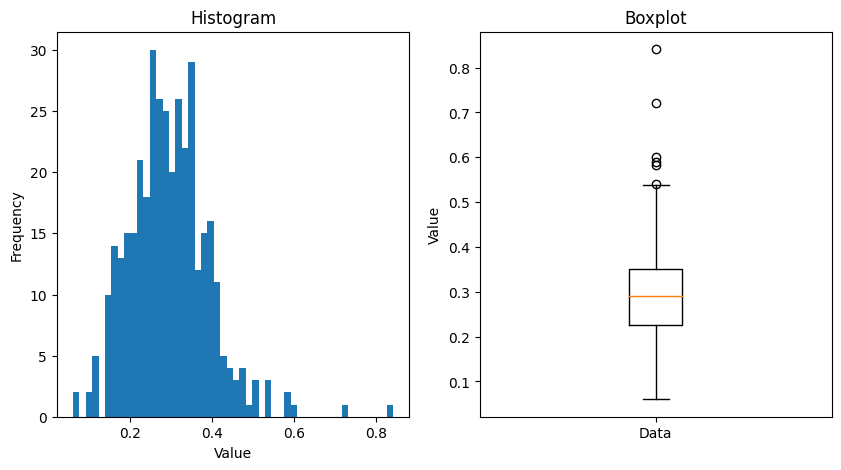

tensor(0.2957, device='cuda:0')
layer 9


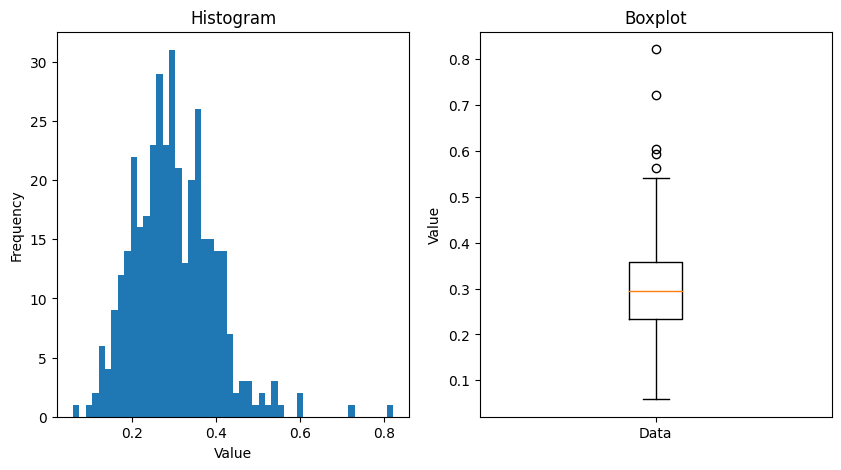

tensor(0.2991, device='cuda:0')
layer 10


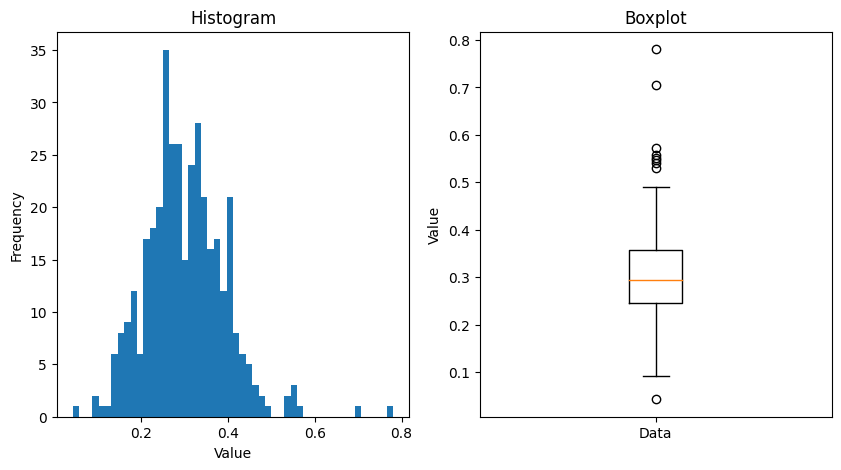

tensor(0.3017, device='cuda:0')
layer 11


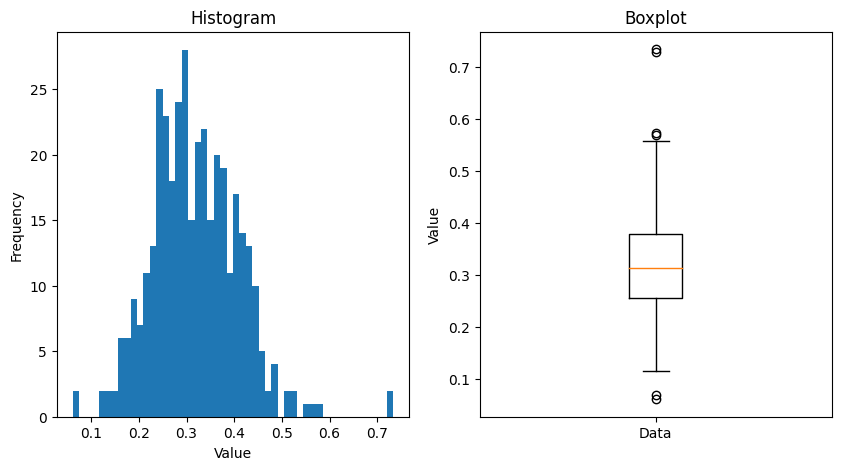

tensor(0.3190, device='cuda:0')
layer 12


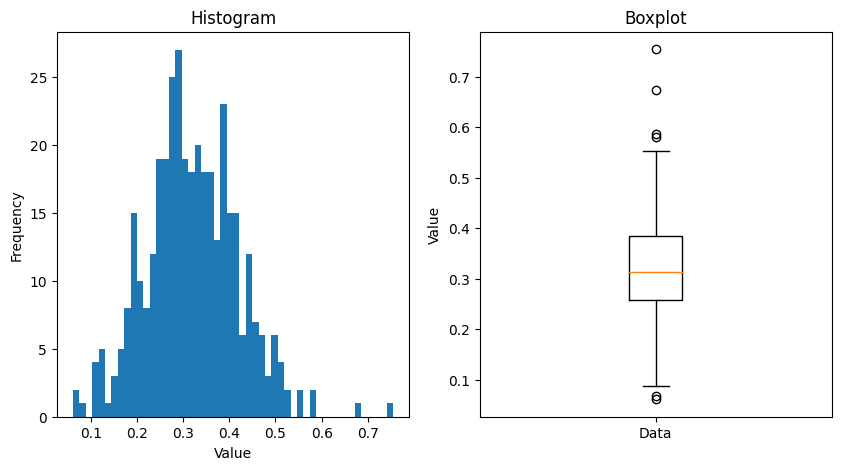

tensor(0.3206, device='cuda:0')
layer 13


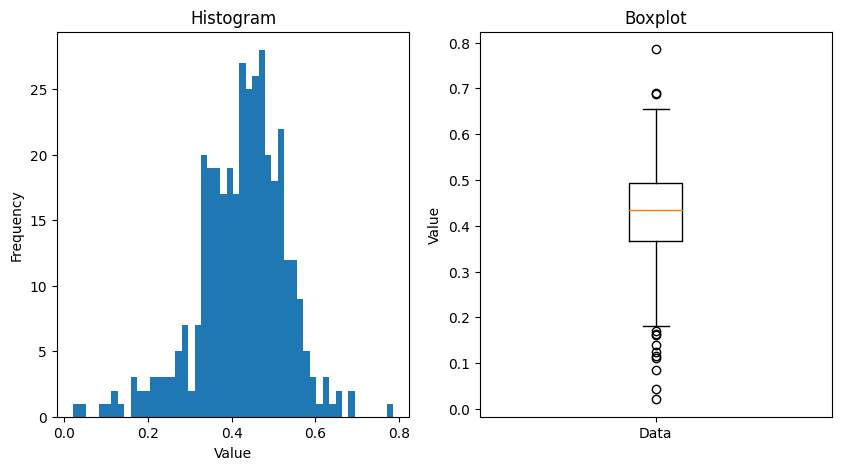

tensor(0.4248, device='cuda:0')
layer 14


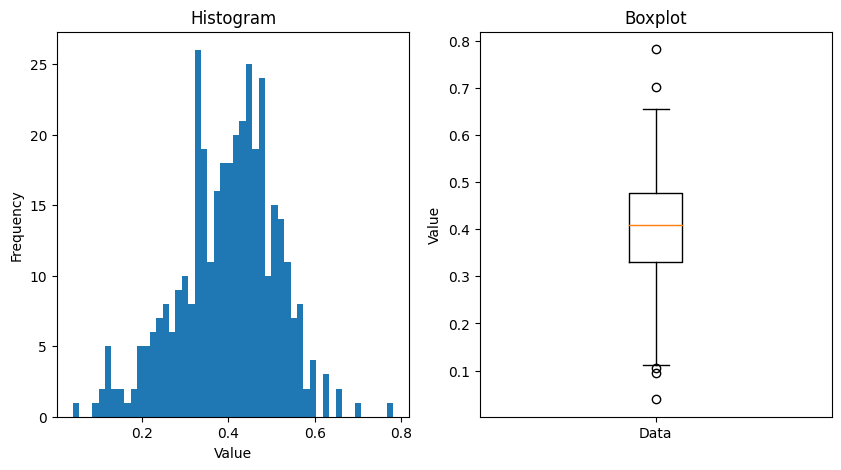

tensor(0.3981, device='cuda:0')
layer 15


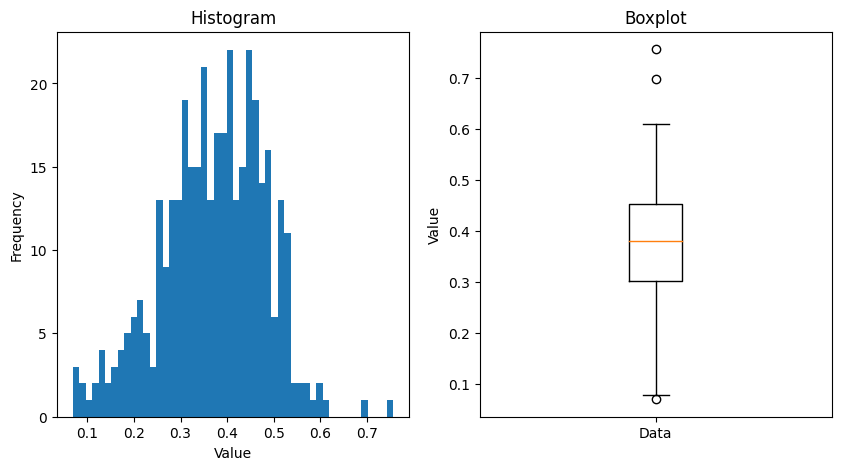

tensor(0.3707, device='cuda:0')
layer 16


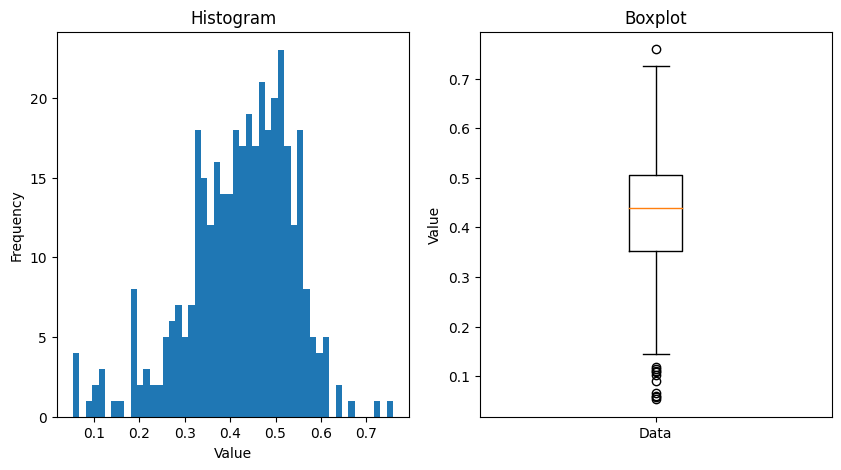

tensor(0.4227, device='cuda:0')
layer 17


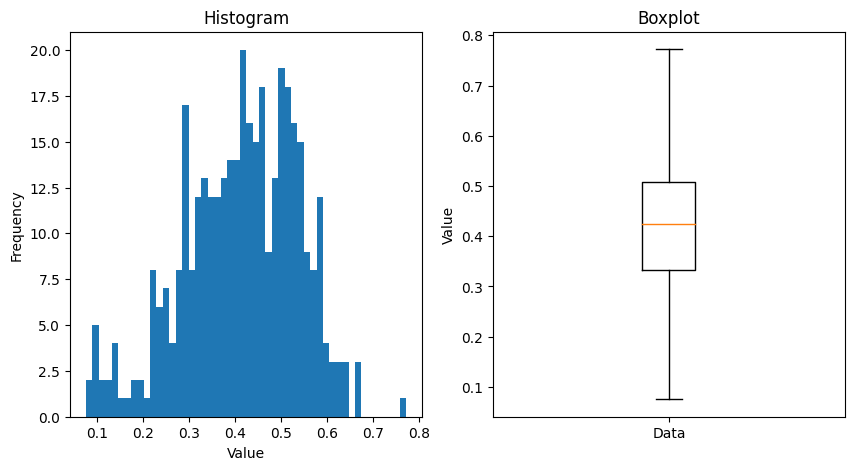

tensor(0.4126, device='cuda:0')
layer 18


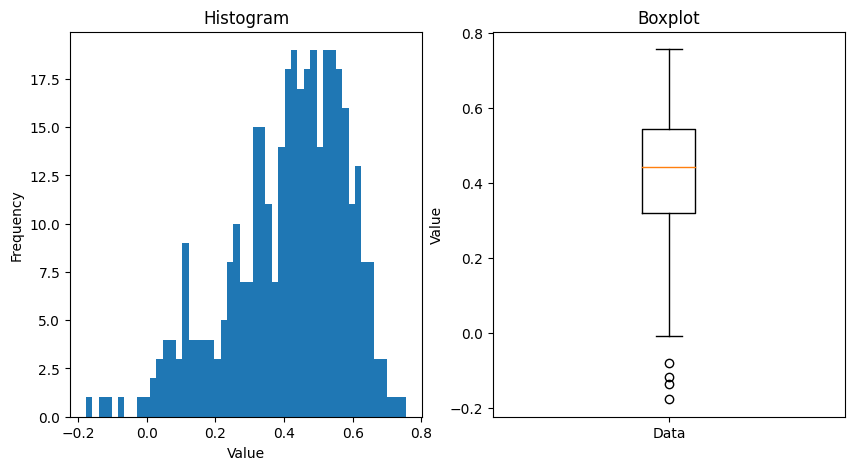

tensor(0.4126, device='cuda:0')
layer 19


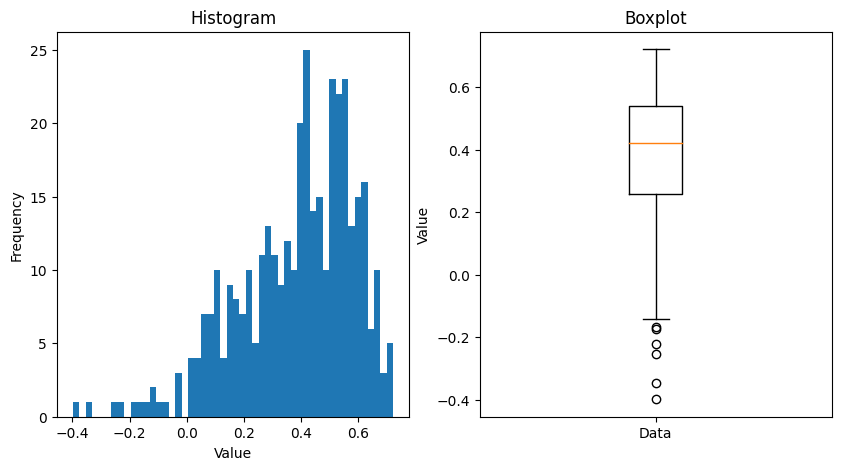

tensor(0.3846, device='cuda:0')
layer 20


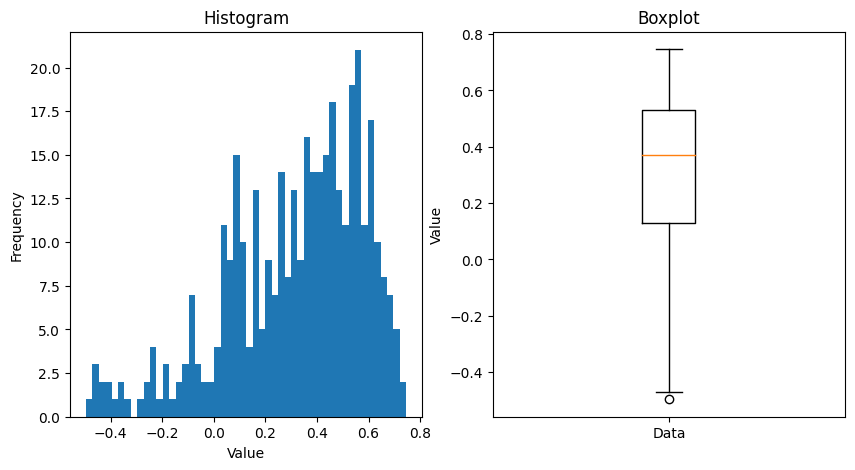

tensor(0.3156, device='cuda:0')
layer 21


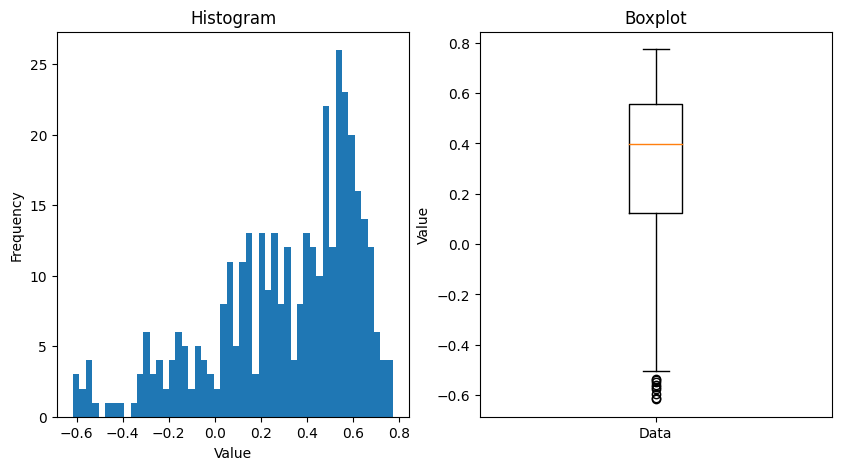

tensor(0.3099, device='cuda:0')
layer 22


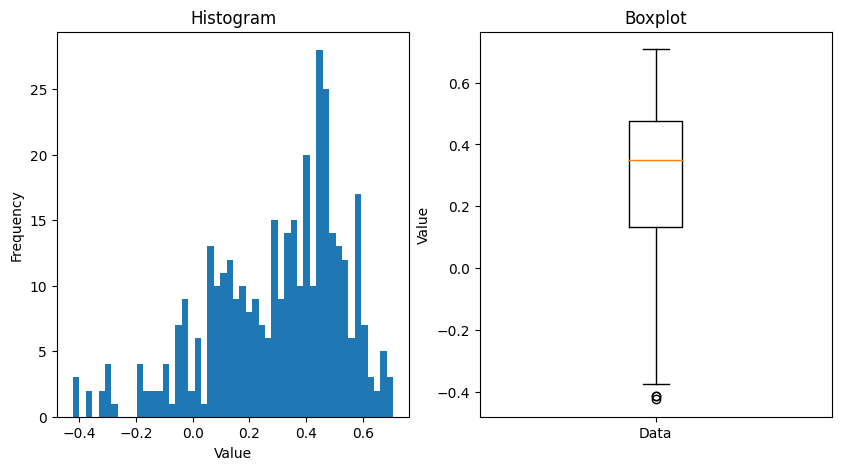

tensor(0.2979, device='cuda:0')
layer 23


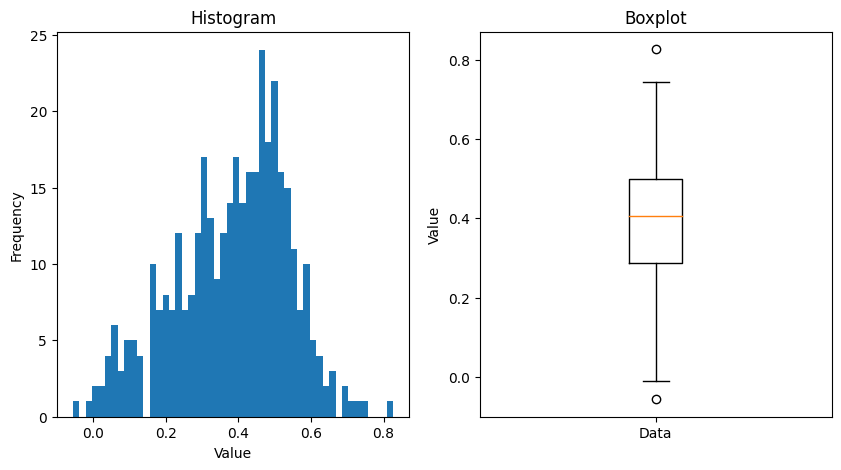

tensor(0.3823, device='cuda:0')


In [ ]:
pythia_sims = get_cos_sims(pythia_hookvecs, pythia_hooks)

In [ ]:
cache['blocks.11.hook_resid_post'][0,p].shape

torch.Size([768])

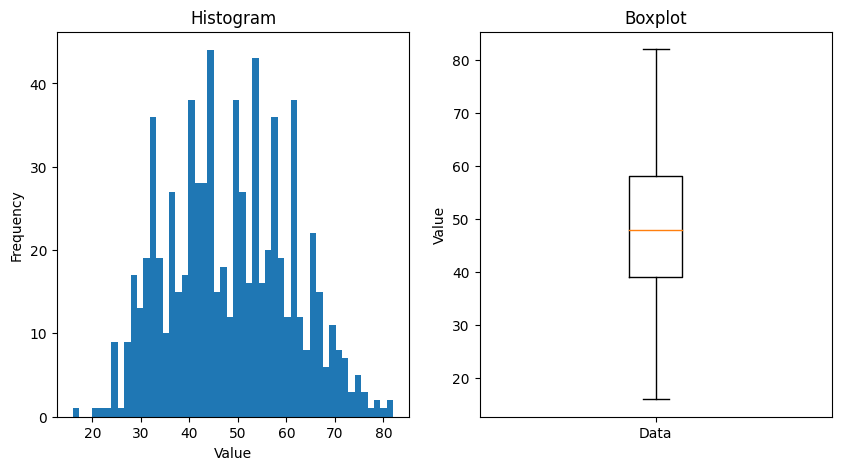

In [ ]:
hist_and_box(yos_lengths)

In [ ]:
with torch.no_grad():
  _, cache = gpt2.run_with_cache([lines[0]])

In [ ]:
cache

ActivationCache with keys ['hook_embed', 'hook_pos_embed', 'blocks.0.hook_resid_pre', 'blocks.0.ln1.hook_scale', 'blocks.0.ln1.hook_normalized', 'blocks.0.attn.hook_q', 'blocks.0.attn.hook_k', 'blocks.0.attn.hook_v', 'blocks.0.attn.hook_attn_scores', 'blocks.0.attn.hook_pattern', 'blocks.0.attn.hook_z', 'blocks.0.hook_attn_out', 'blocks.0.hook_resid_mid', 'blocks.0.ln2.hook_scale', 'blocks.0.ln2.hook_normalized', 'blocks.0.mlp.hook_pre', 'blocks.0.mlp.hook_post', 'blocks.0.hook_mlp_out', 'blocks.0.hook_resid_post', 'blocks.1.hook_resid_pre', 'blocks.1.ln1.hook_scale', 'blocks.1.ln1.hook_normalized', 'blocks.1.attn.hook_q', 'blocks.1.attn.hook_k', 'blocks.1.attn.hook_v', 'blocks.1.attn.hook_attn_scores', 'blocks.1.attn.hook_pattern', 'blocks.1.attn.hook_z', 'blocks.1.hook_attn_out', 'blocks.1.hook_resid_mid', 'blocks.1.ln2.hook_scale', 'blocks.1.ln2.hook_normalized', 'blocks.1.mlp.hook_pre', 'blocks.1.mlp.hook_post', 'blocks.1.hook_mlp_out', 'blocks.1.hook_resid_post', 'blocks.2.hook_re

# Yo

In [ ]:
pythia_hooks

['blocks.0.hook_resid_post',
 'blocks.1.hook_resid_post',
 'blocks.2.hook_resid_post',
 'blocks.3.hook_resid_post',
 'blocks.4.hook_resid_post',
 'blocks.5.hook_resid_post',
 'blocks.6.hook_resid_post',
 'blocks.7.hook_resid_post',
 'blocks.8.hook_resid_post',
 'blocks.9.hook_resid_post',
 'blocks.10.hook_resid_post',
 'blocks.11.hook_resid_post',
 'blocks.12.hook_resid_post',
 'blocks.13.hook_resid_post',
 'blocks.14.hook_resid_post',
 'blocks.15.hook_resid_post',
 'blocks.16.hook_resid_post',
 'blocks.17.hook_resid_post',
 'blocks.18.hook_resid_post',
 'blocks.19.hook_resid_post',
 'blocks.20.hook_resid_post',
 'blocks.21.hook_resid_post',
 'blocks.22.hook_resid_post',
 'blocks.23.hook_resid_post']

In [ ]:
demeaned_random_dset = {}
for hook_name in pythia_hooks:
  print(hook_name, random_dset[hook_name].shape)
  mean_vec = random_dset[hook_name].mean(dim=0)
  print(torch.norm(mean_vec))
  X_demeaned = random_dset[hook_name] - mean_vec
  print(torch.norm(X_demeaned.mean(dim=0)))
  demeaned_random_dset[hook_name] = X_demeaned

blocks.0.hook_resid_post torch.Size([2000, 1024])
tensor(7.9481, device='cuda:0')
tensor(5.6068e-07, device='cuda:0')
blocks.1.hook_resid_post torch.Size([2000, 1024])
tensor(8.7655, device='cuda:0')
tensor(5.6584e-07, device='cuda:0')
blocks.2.hook_resid_post torch.Size([2000, 1024])
tensor(10.7404, device='cuda:0')
tensor(6.0634e-07, device='cuda:0')
blocks.3.hook_resid_post torch.Size([2000, 1024])
tensor(13.8051, device='cuda:0')
tensor(6.6566e-07, device='cuda:0')
blocks.4.hook_resid_post torch.Size([2000, 1024])
tensor(16.4125, device='cuda:0')
tensor(1.8569e-06, device='cuda:0')
blocks.5.hook_resid_post torch.Size([2000, 1024])
tensor(16.4991, device='cuda:0')
tensor(2.3582e-06, device='cuda:0')
blocks.6.hook_resid_post torch.Size([2000, 1024])
tensor(17.1992, device='cuda:0')
tensor(8.8811e-07, device='cuda:0')
blocks.7.hook_resid_post torch.Size([2000, 1024])
tensor(17.5854, device='cuda:0')
tensor(1.1448e-06, device='cuda:0')
blocks.8.hook_resid_post torch.Size([2000, 1024])


In [ ]:
def get_cos_sims2(hook_vecs, hook_list):
  cosine_similarities_per_layer = []
  for i, hook_name in enumerate(hook_list):
    print('layer', i)
    assert hook_name == f'blocks.{i}.hook_resid_post'
    X = hook_vecs[hook_name]
    n = X.shape[0]
    A = X[:n//2]
    B = X[n//2:]
    cosine_similarities = F.cosine_similarity(A, B, dim=1)
    hist_and_box(cosine_similarities)
    cosine_similarities_per_layer.append(cosine_similarities)
    print(cosine_similarities.mean())
  return torch.stack(cosine_similarities_per_layer)

In [ ]:
random_dset_cpu = {hook_name : X.cpu() for hook_name, X in random_dset.items()}

In [ ]:
torch.save(random_dset_cpu, '/content/drive/MyDrive/thesis/derived_data/similarity_replication/10k_random_occs_410m_all_residual_cpu.pt')

layer 0
layer 1
layer 2
layer 3
layer 4
layer 5
layer 6
layer 7
layer 8
layer 9
layer 10
layer 11
layer 12
layer 13
layer 14
layer 15
layer 16
layer 17
layer 18
layer 19
layer 20
layer 21
layer 22
layer 23


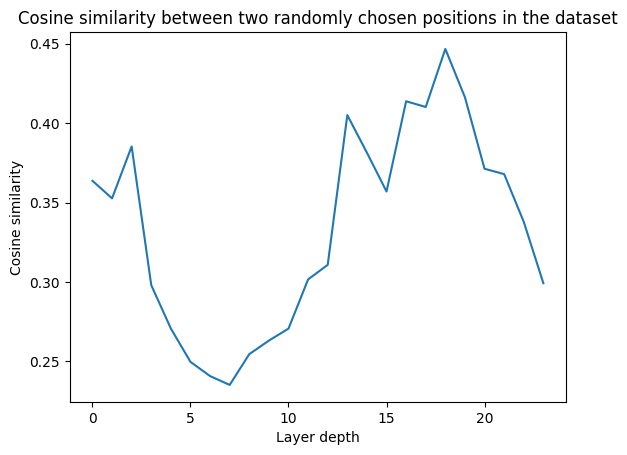

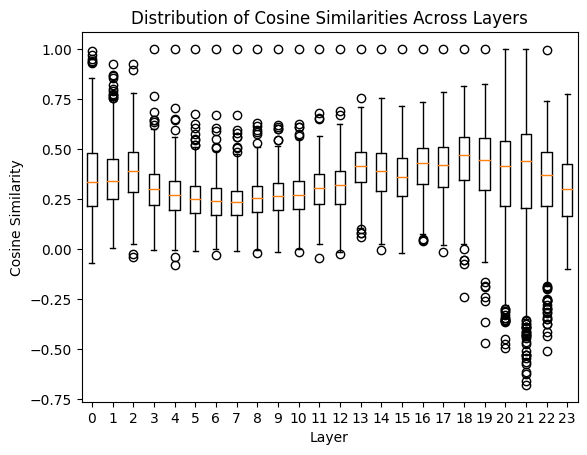

In [ ]:
plot_cosine_layer(get_cos_sims2(random_dset, pythia_hooks))

layer 0


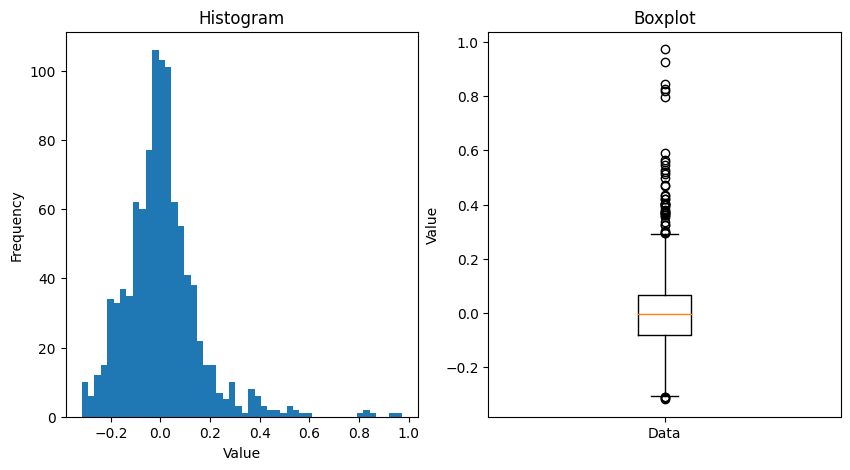

tensor(0.0058, device='cuda:0')
layer 1


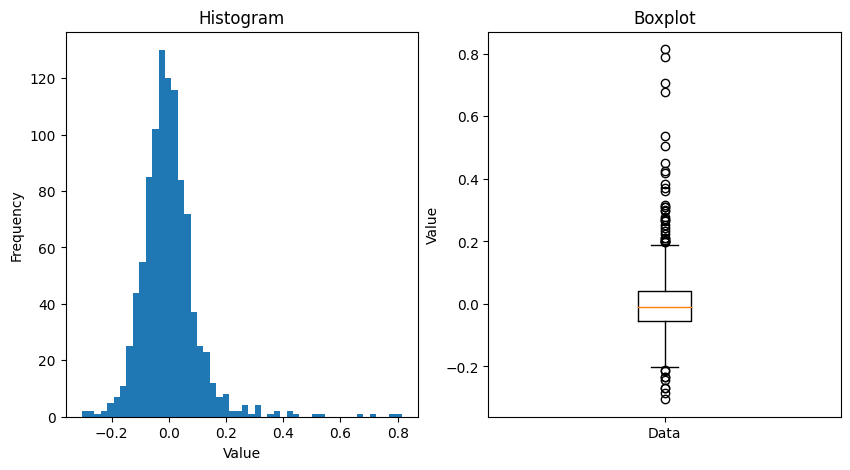

tensor(0.0005, device='cuda:0')
layer 2


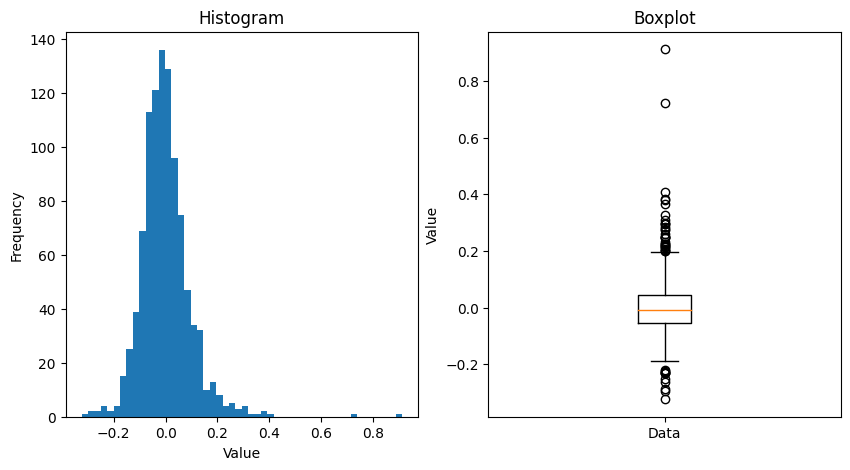

tensor(0.0002, device='cuda:0')
layer 3


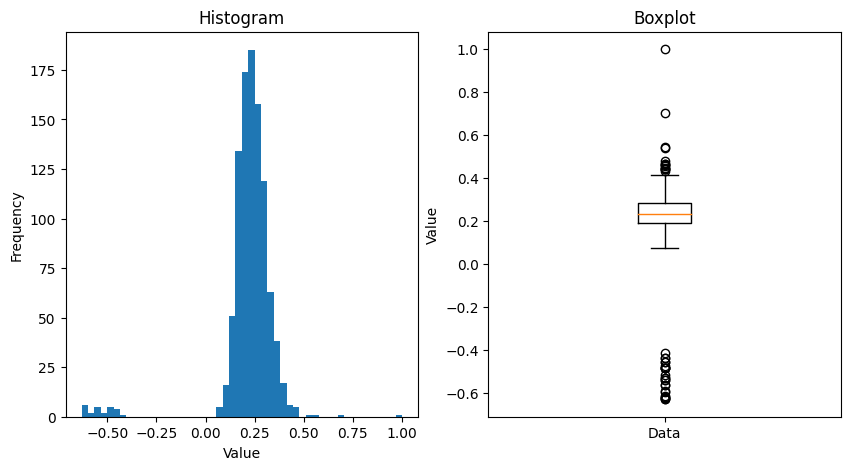

tensor(0.2234, device='cuda:0')
layer 4


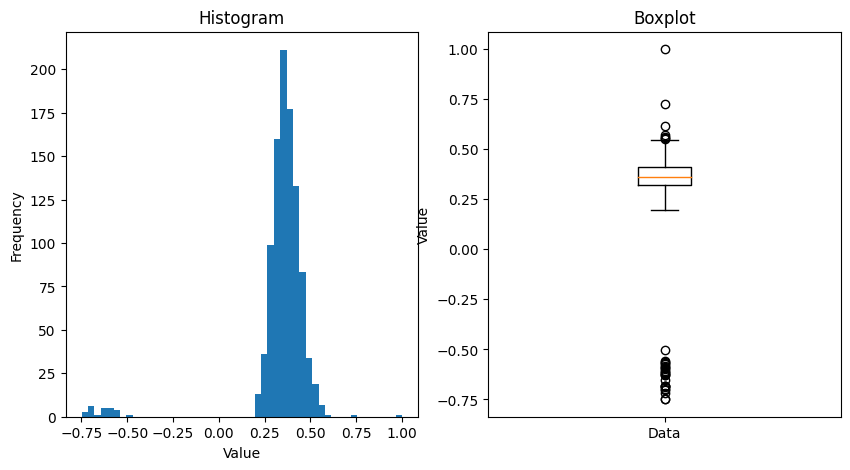

tensor(0.3450, device='cuda:0')
layer 5


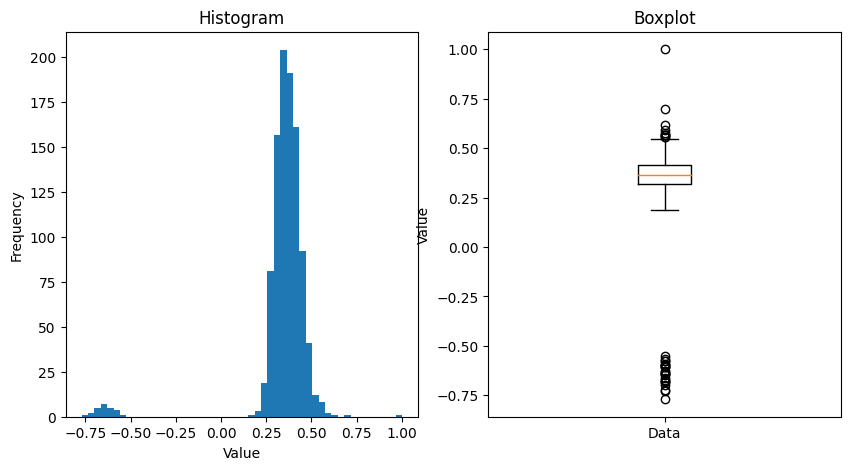

tensor(0.3463, device='cuda:0')
layer 6


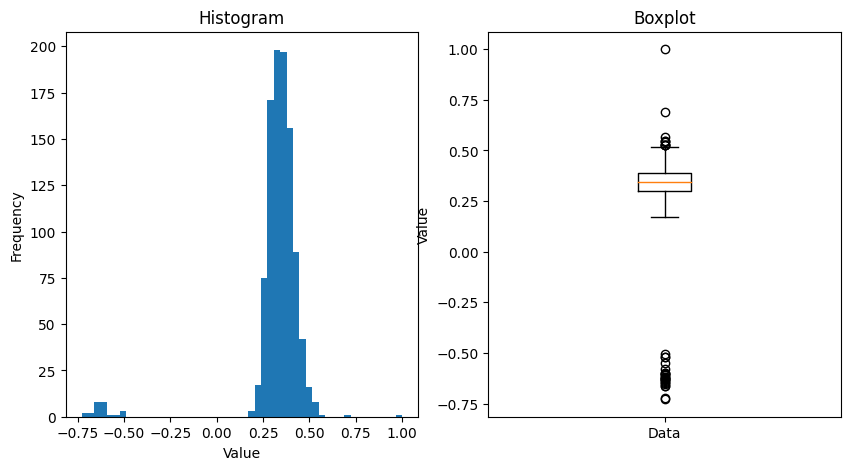

tensor(0.3275, device='cuda:0')
layer 7


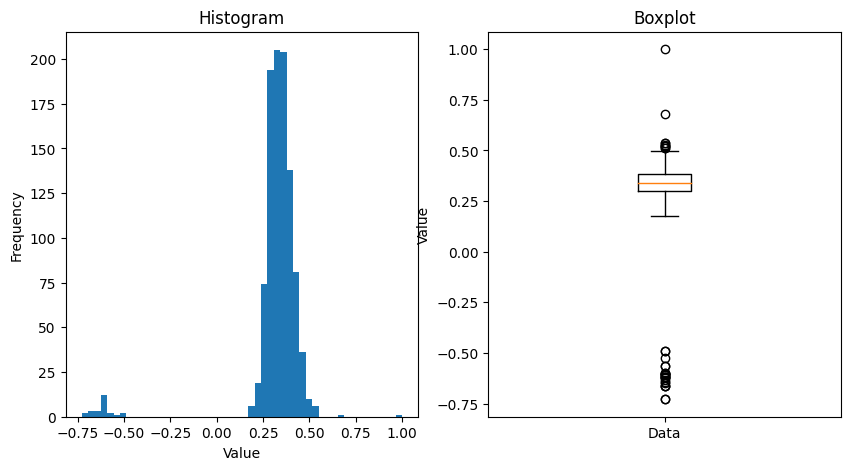

tensor(0.3219, device='cuda:0')
layer 8


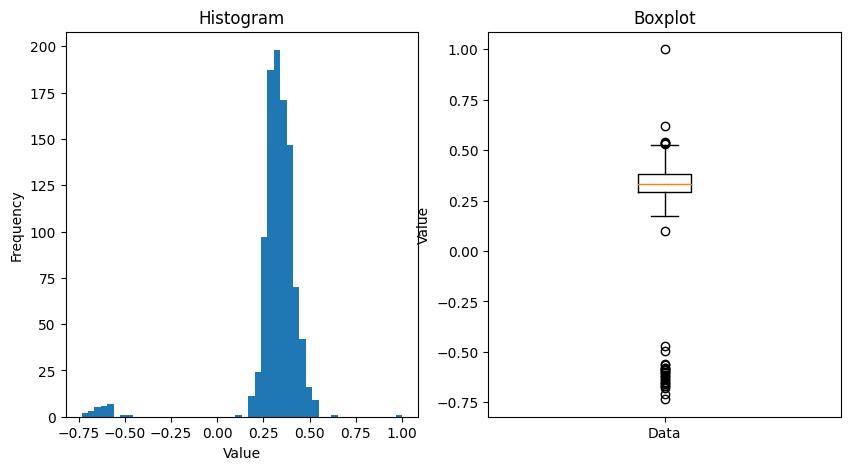

tensor(0.3181, device='cuda:0')
layer 9


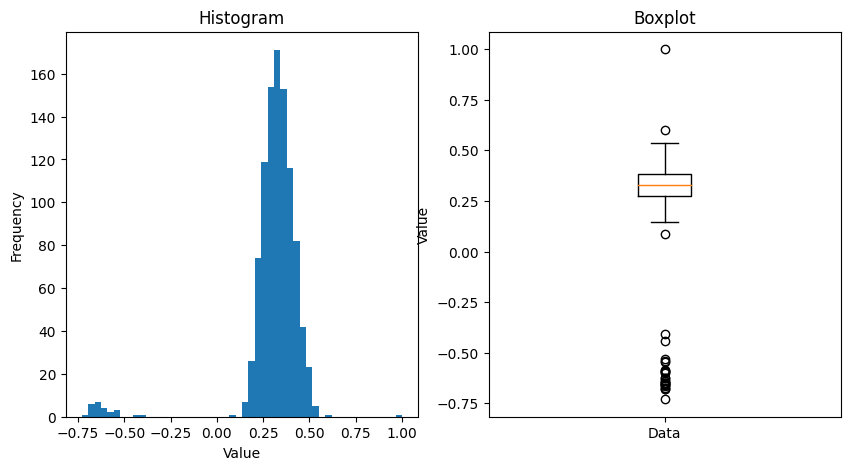

tensor(0.3092, device='cuda:0')
layer 10


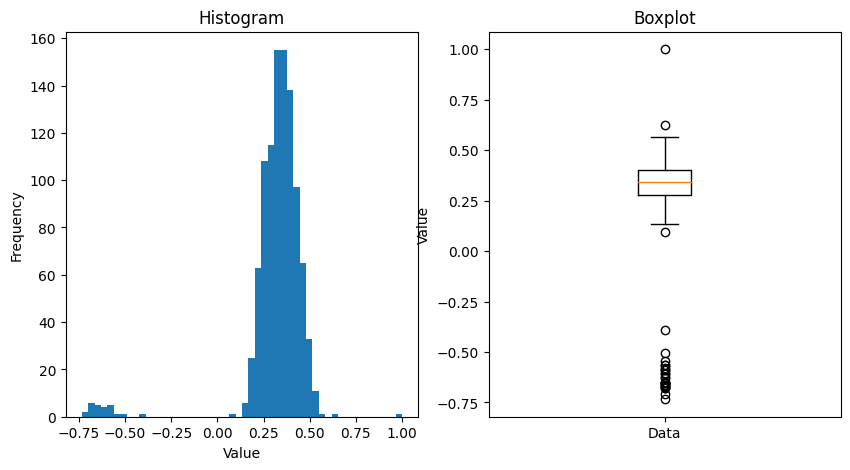

tensor(0.3207, device='cuda:0')
layer 11


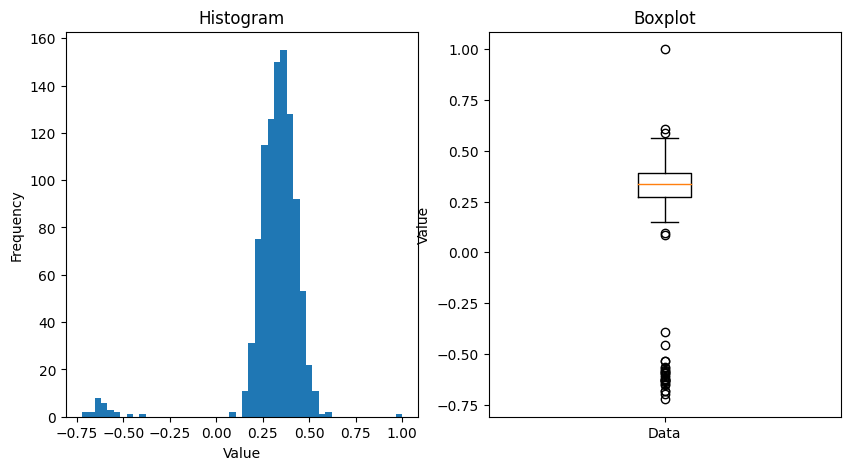

tensor(0.3165, device='cuda:0')
layer 12


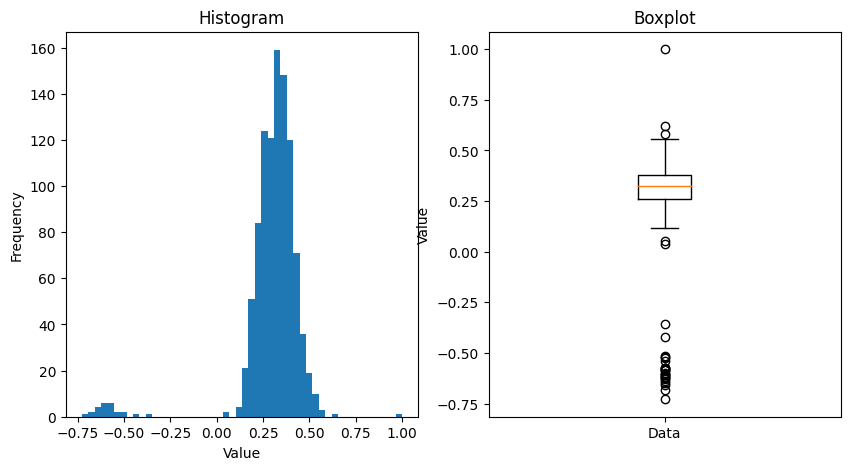

tensor(0.3027, device='cuda:0')
layer 13


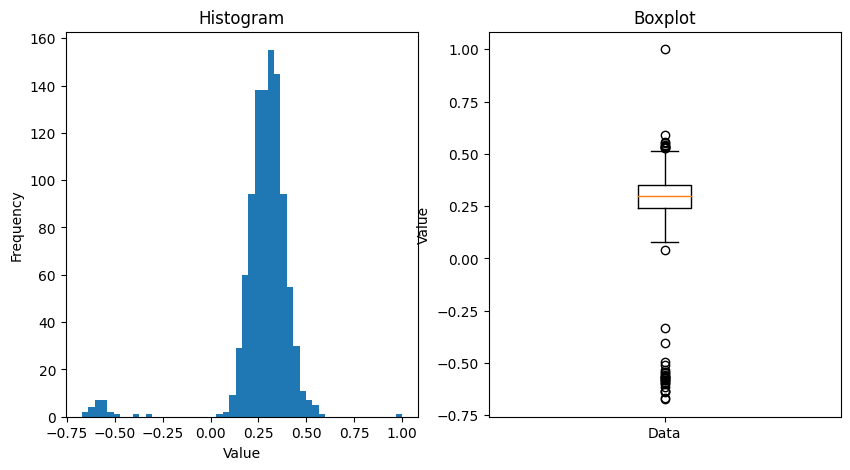

tensor(0.2799, device='cuda:0')
layer 14


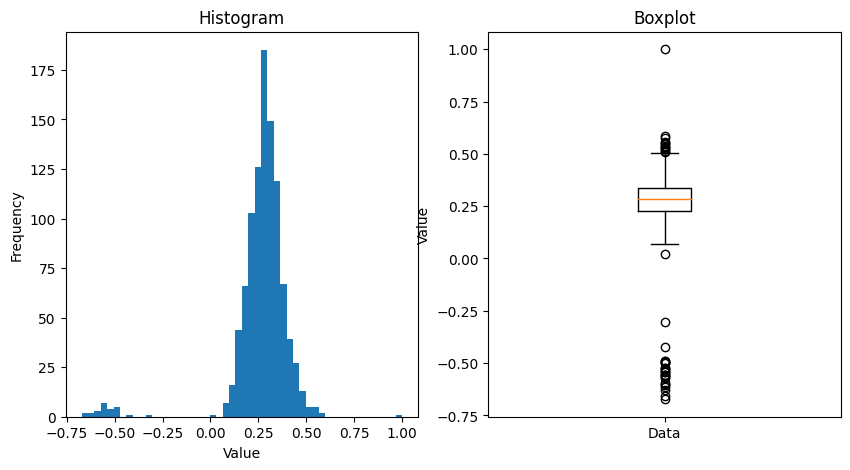

tensor(0.2677, device='cuda:0')
layer 15


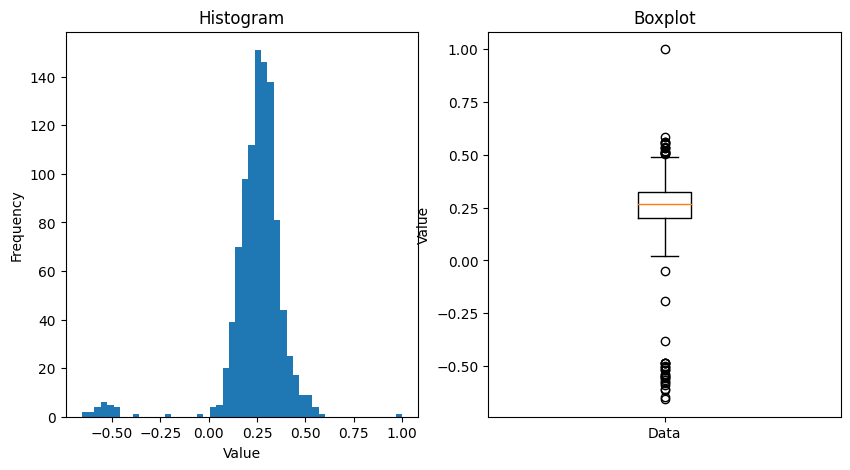

tensor(0.2488, device='cuda:0')
layer 16


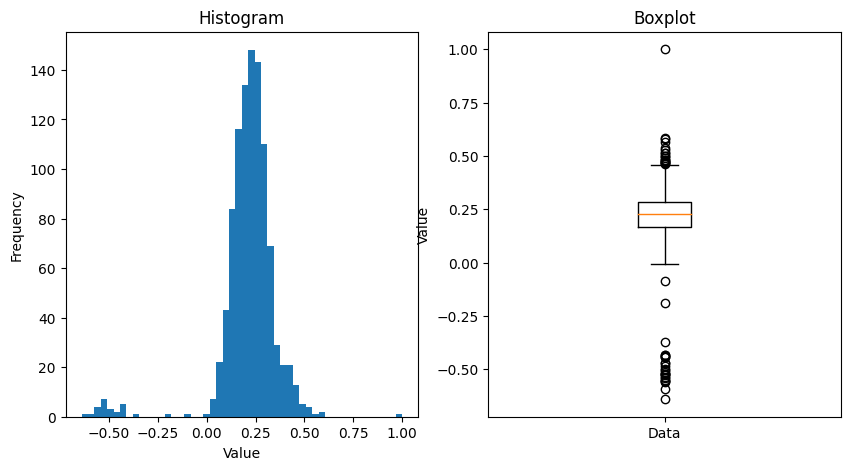

tensor(0.2166, device='cuda:0')
layer 17


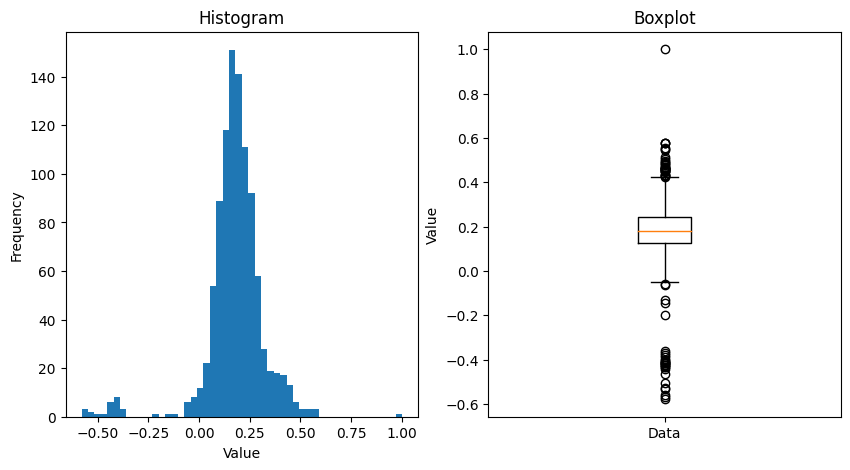

tensor(0.1792, device='cuda:0')
layer 18


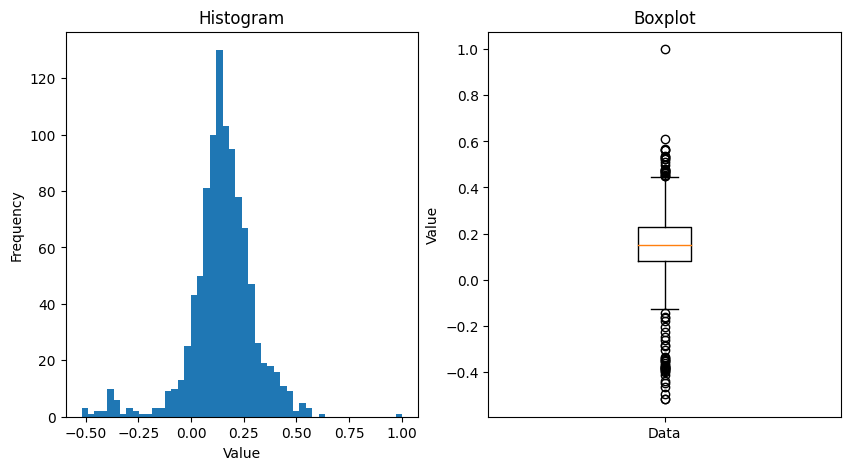

tensor(0.1488, device='cuda:0')
layer 19


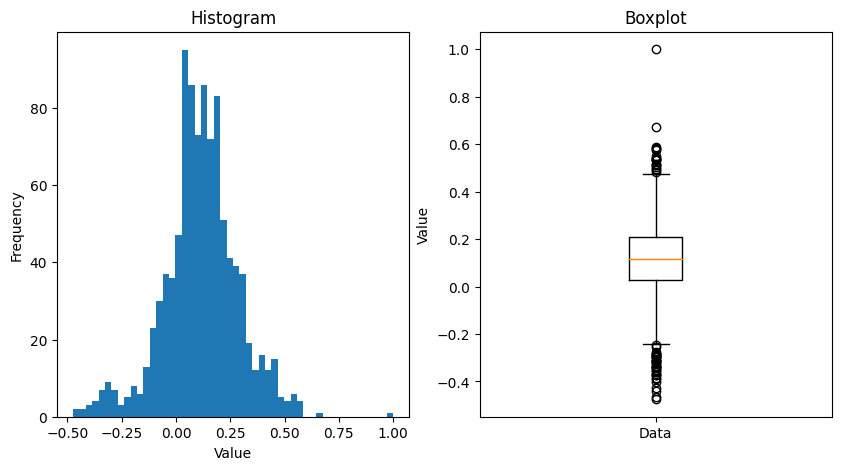

tensor(0.1153, device='cuda:0')
layer 20


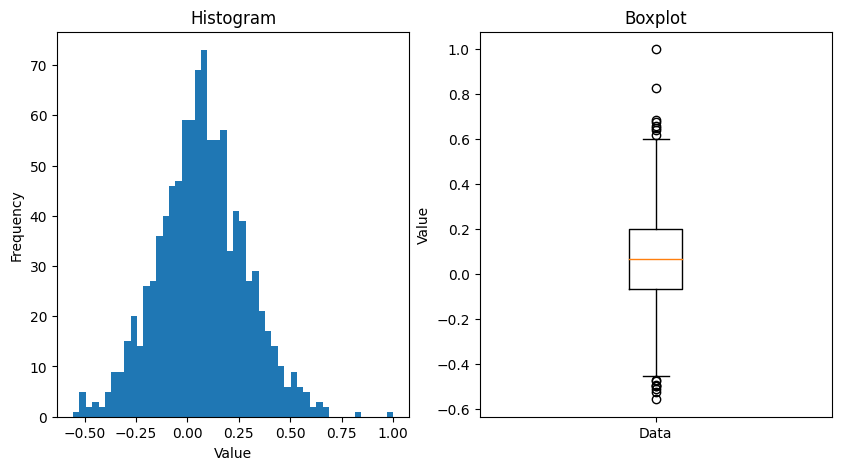

tensor(0.0715, device='cuda:0')
layer 21


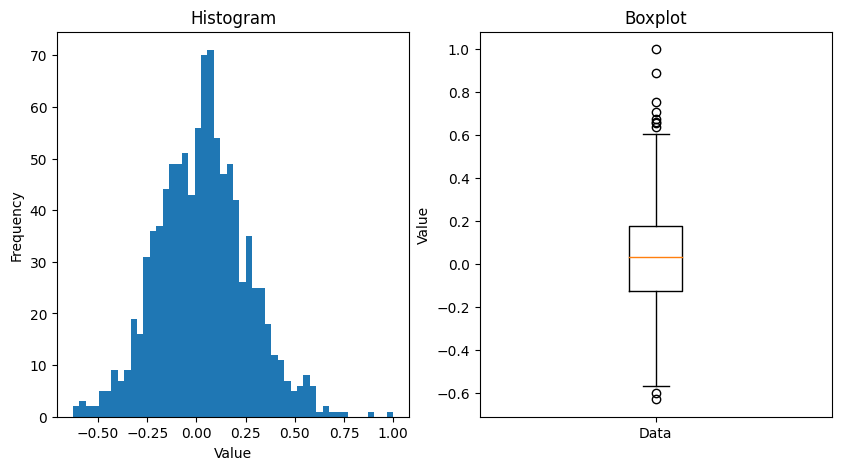

tensor(0.0336, device='cuda:0')
layer 22


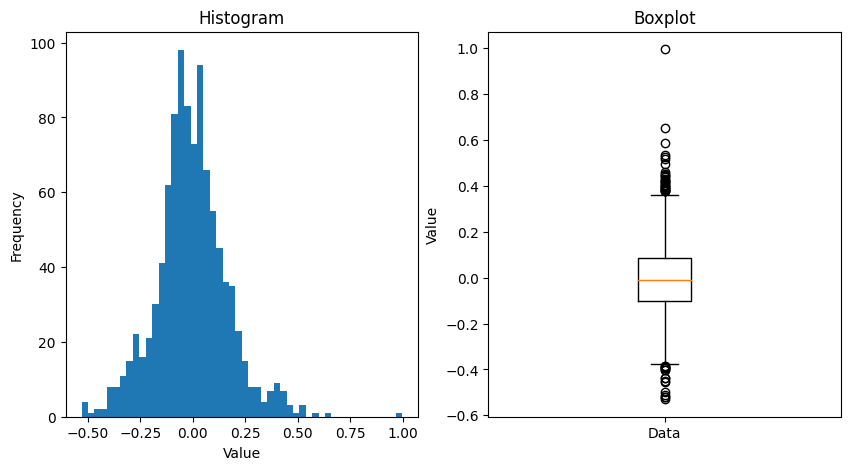

tensor(-0.0057, device='cuda:0')
layer 23


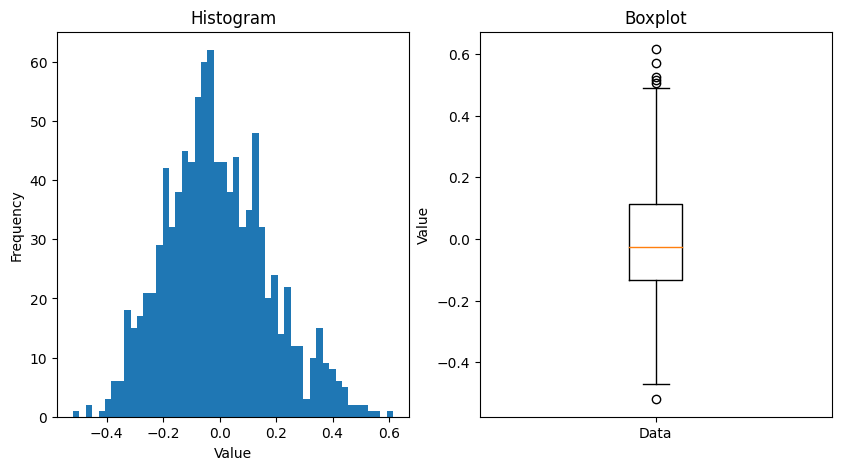

tensor(-0.0074, device='cuda:0')


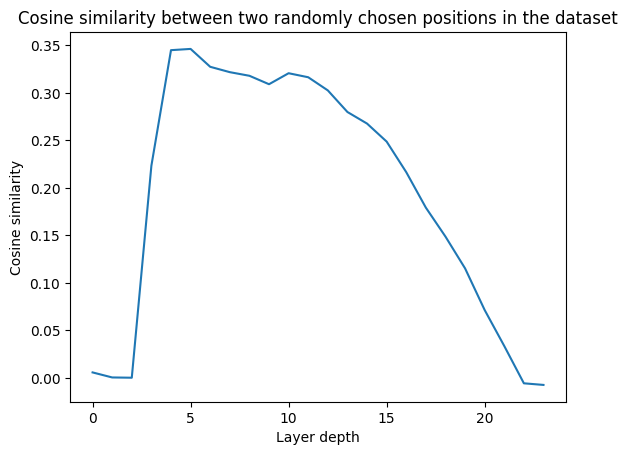

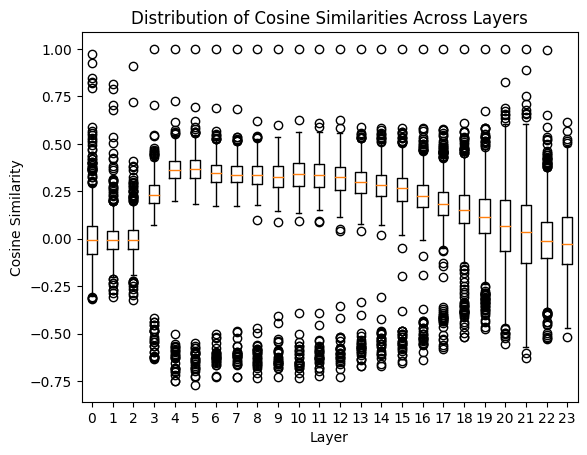

In [ ]:
plot_cosine_layer(get_cos_sims2(demeaned_random_dset, pythia_hooks))

In [ ]:
import torch
import matplotlib.pyplot as plt

def evaluate_anisotropy(tensor):
    """
    Evaluate anisotropy in a dataset represented by a tensor of shape n x d.

    Parameters:
    - tensor (torch.Tensor): The input tensor of shape n x d.

    Returns:
    - A plot of singular values.
    - A plot of cumulative explained variance.
    """

    # Perform SVD
    U, S, V = torch.svd(tensor)

    # Calculate total variance (sum of squared singular values)
    total_variance = torch.sum(S ** 2)

    # Calculate explained variance for each component
    explained_variance = (S ** 2) / total_variance

    # Calculate cumulative explained variance
    cumulative_explained_variance = torch.cumsum(explained_variance, dim=0)

    # Plot singular values
    plt.figure()
    plt.title("Singular Values")
    plt.plot(range(len(S)), S.cpu())
    plt.ylim(0, 1)
    plt.xlabel("Component")
    plt.ylabel("Singular Value")
    plt.show()

    # Plot cumulative explained variance
    plt.figure()
    plt.title("Cumulative Explained Variance")
    plt.plot(range(len(S)), cumulative_explained_variance.cpu())
    plt.ylim(0, 1)
    plt.xlabel("Component")
    plt.ylabel("Cumulative Explained Variance")
    plt.show()

    # Print metrics
    print(f"First singular value: {S[0]}")
    print(f"Last singular value: {S[-1]}")
    print(f"First component explained variance: {explained_variance[0]}")
    print(f"Last component explained variance: {explained_variance[-1]}")
    print(f"Cumulative explained variance by first half components: {cumulative_explained_variance[len(S)//2]}")
    print(f"Cumulative explained variance by all components: {cumulative_explained_variance[-1]}")

blocks.0.hook_resid_post


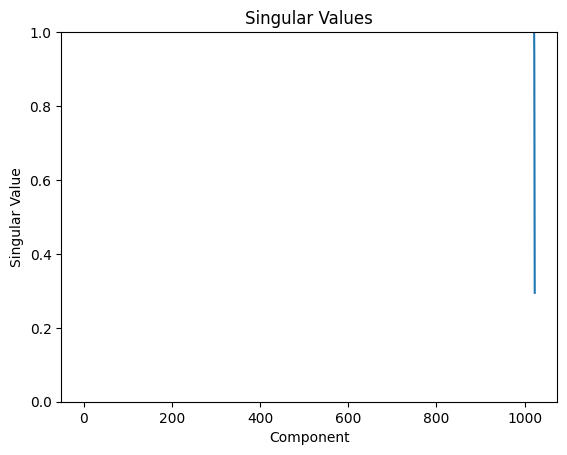

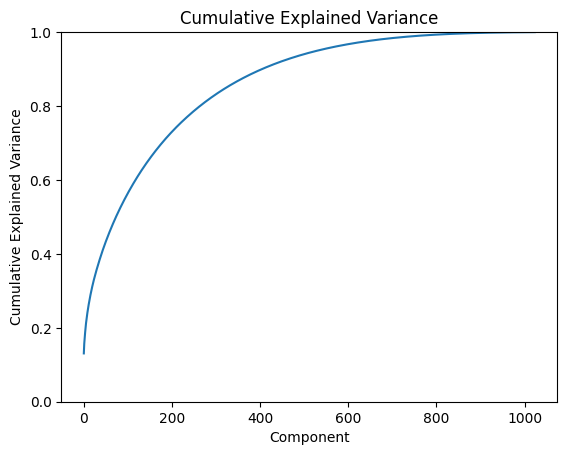

First singular value: 170.35520935058594
Last singular value: 0.2945765554904938
First component explained variance: 0.13072210550308228
Last component explained variance: 3.9087203163035156e-07
Cumulative explained variance by first half components: 0.9444210529327393
Cumulative explained variance by all components: 1.0000001192092896
blocks.1.hook_resid_post


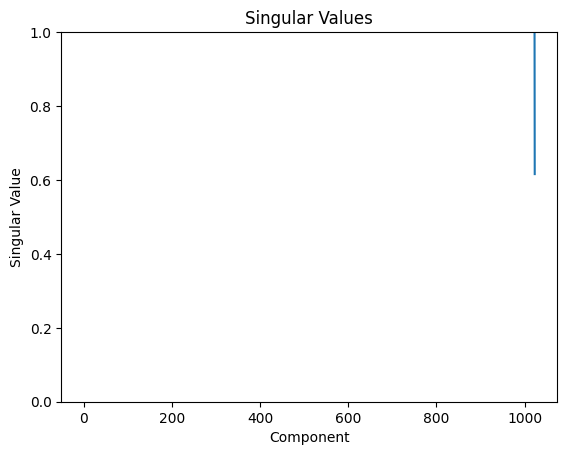

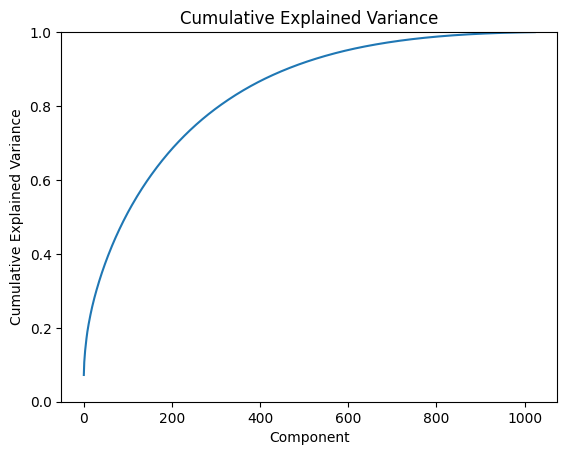

First singular value: 145.5257568359375
Last singular value: 0.6158761382102966
First component explained variance: 0.07237885147333145
Last component explained variance: 1.296339405598701e-06
Cumulative explained variance by first half components: 0.9225295782089233
Cumulative explained variance by all components: 1.0
blocks.2.hook_resid_post


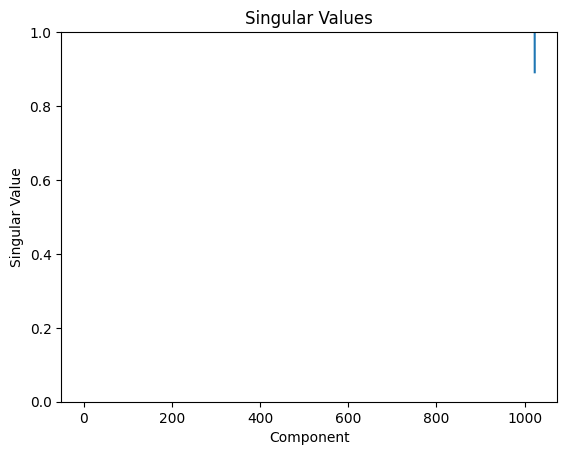

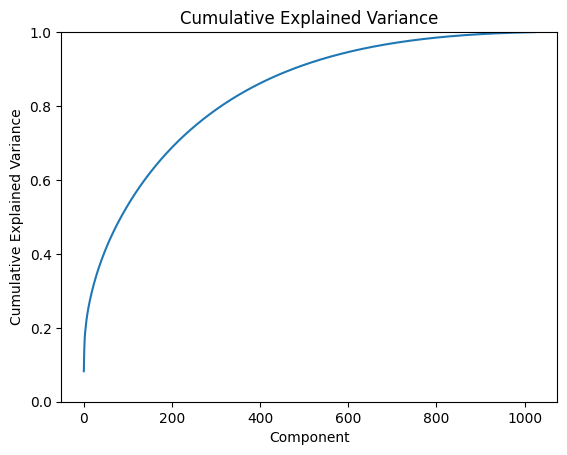

First singular value: 178.5769500732422
Last singular value: 0.8913291692733765
First component explained variance: 0.082563117146492
Last component explained variance: 2.0568922991515137e-06
Cumulative explained variance by first half components: 0.9163093566894531
Cumulative explained variance by all components: 1.0000001192092896
blocks.3.hook_resid_post


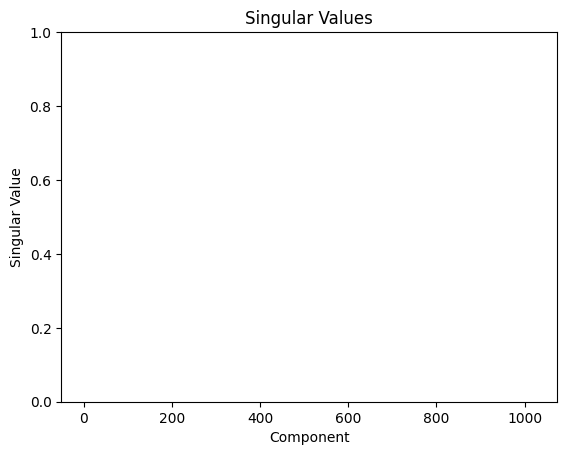

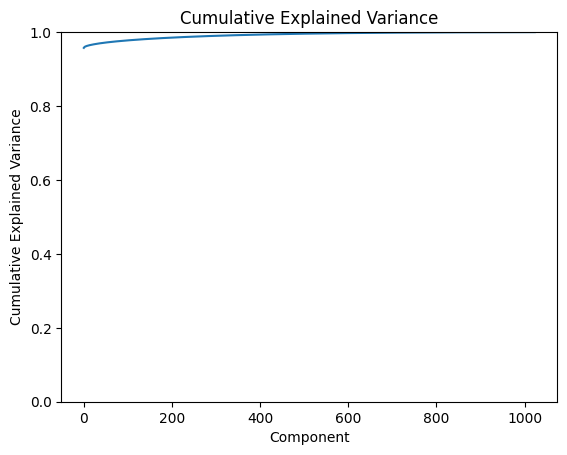

First singular value: 3086.550537109375
Last singular value: 1.1885876655578613
First component explained variance: 0.957403302192688
Last component explained variance: 1.4197458142461983e-07
Cumulative explained variance by first half components: 0.9959936141967773
Cumulative explained variance by all components: 1.0000001192092896
blocks.4.hook_resid_post


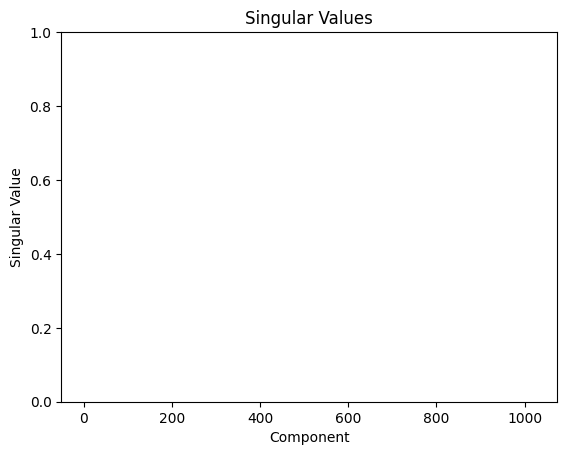

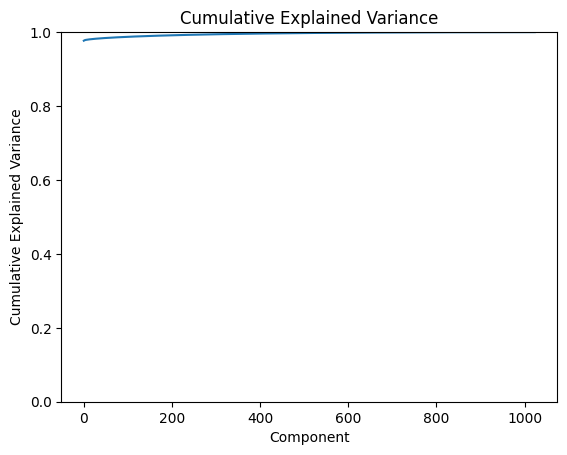

First singular value: 4439.74267578125
Last singular value: 1.3815712928771973
First component explained variance: 0.9767903089523315
Last component explained variance: 9.45871860835723e-08
Cumulative explained variance by first half components: 0.9976162314414978
Cumulative explained variance by all components: 1.000000238418579
blocks.5.hook_resid_post


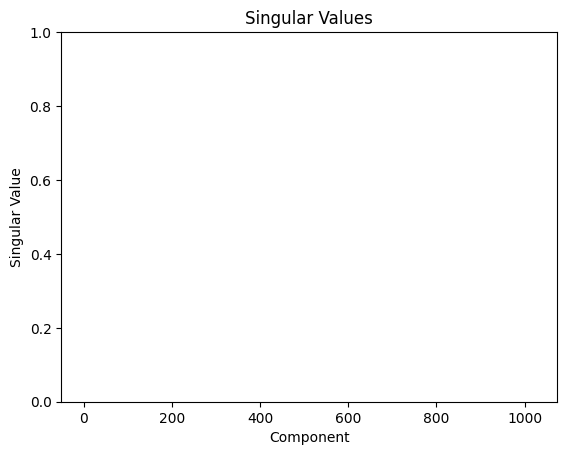

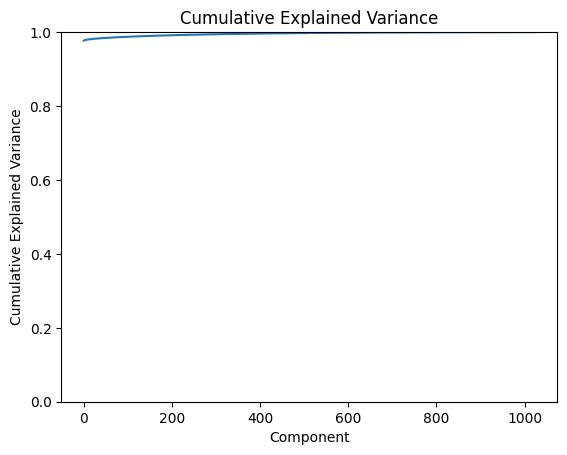

First singular value: 4453.17041015625
Last singular value: 1.5707005262374878
First component explained variance: 0.9769133925437927
Last component explained variance: 1.2153580541962583e-07
Cumulative explained variance by first half components: 0.9976430535316467
Cumulative explained variance by all components: 1.0000001192092896
blocks.6.hook_resid_post


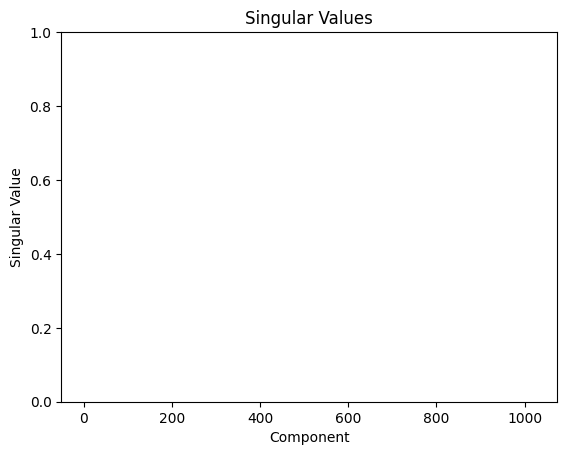

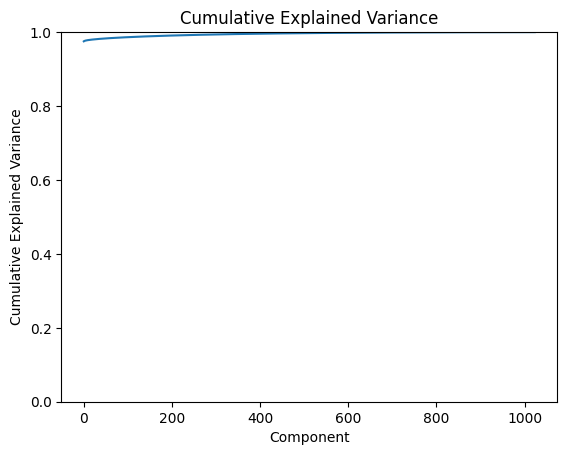

First singular value: 4482.91357421875
Last singular value: 1.7121652364730835
First component explained variance: 0.9750914573669434
Last component explained variance: 1.4223810751445853e-07
Cumulative explained variance by first half components: 0.9973887205123901
Cumulative explained variance by all components: 0.9999998807907104
blocks.7.hook_resid_post


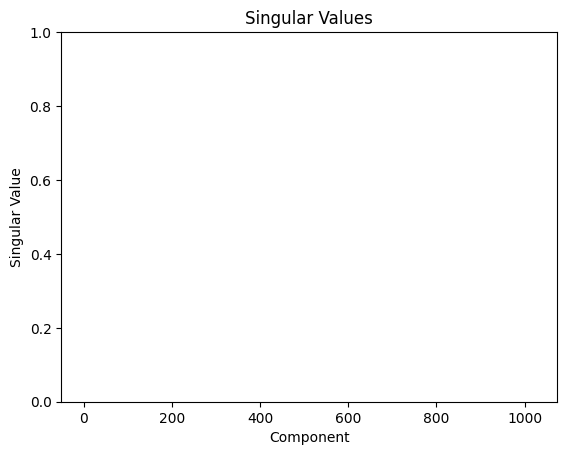

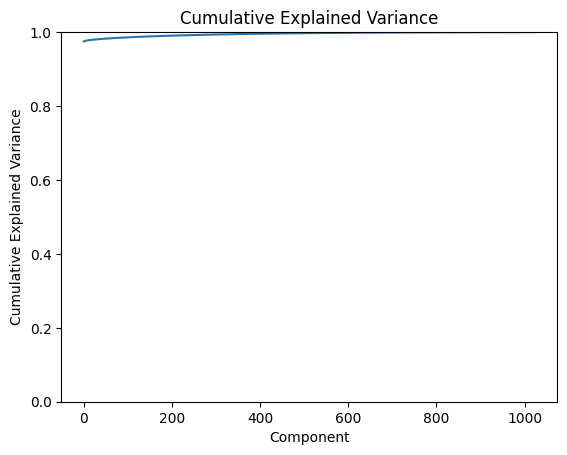

First singular value: 4536.72607421875
Last singular value: 1.8889703750610352
First component explained variance: 0.9745097756385803
Last component explained variance: 1.6894735210826184e-07
Cumulative explained variance by first half components: 0.9973071813583374
Cumulative explained variance by all components: 1.0000001192092896
blocks.8.hook_resid_post


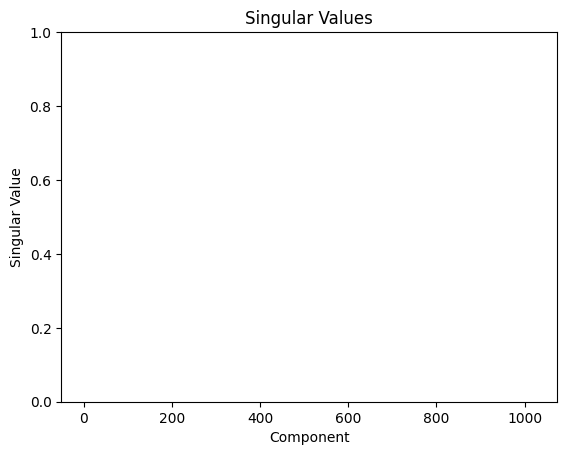

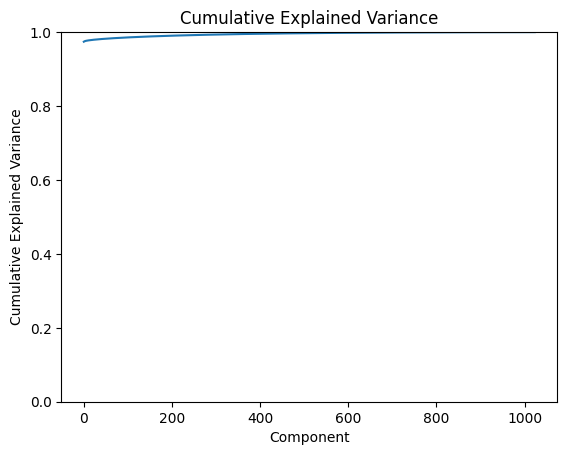

First singular value: 4580.98583984375
Last singular value: 1.9731602668762207
First component explained variance: 0.9740442037582397
Last component explained variance: 1.8071136764774565e-07
Cumulative explained variance by first half components: 0.9972737431526184
Cumulative explained variance by all components: 0.9999999403953552
blocks.9.hook_resid_post


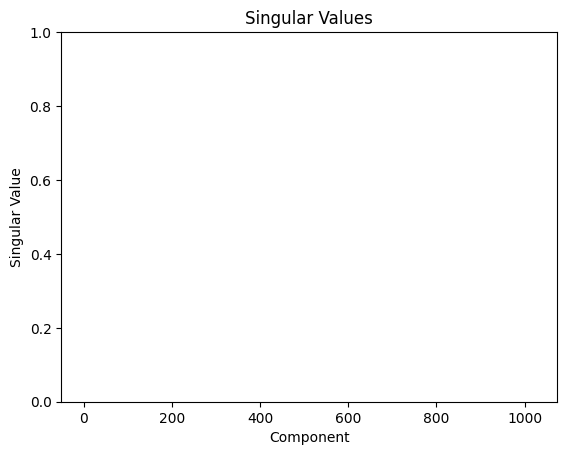

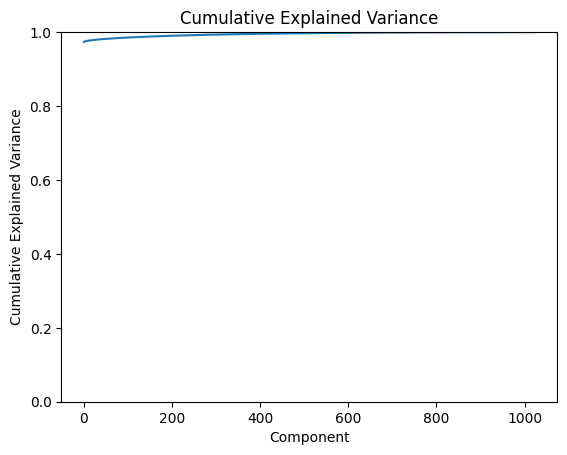

First singular value: 4604.40869140625
Last singular value: 2.0875468254089355
First component explained variance: 0.9731388092041016
Last component explained variance: 2.0003201939289283e-07
Cumulative explained variance by first half components: 0.9972406625747681
Cumulative explained variance by all components: 1.0
blocks.10.hook_resid_post


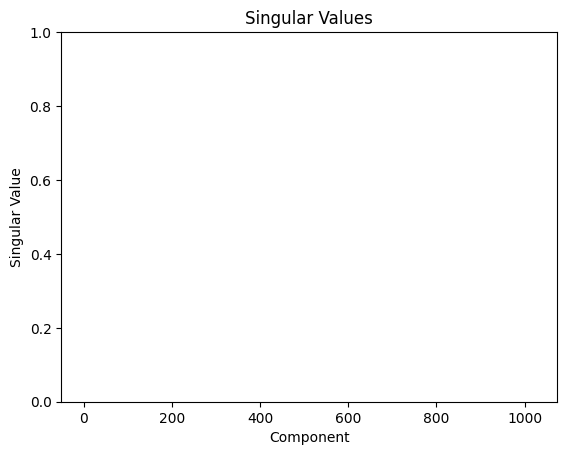

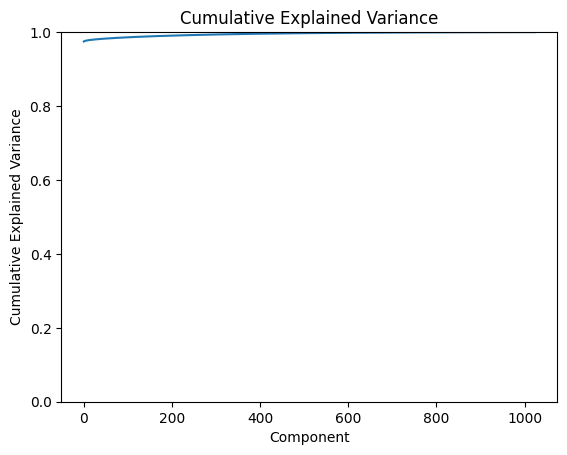

First singular value: 4597.67041015625
Last singular value: 2.2034976482391357
First component explained variance: 0.9746530652046204
Last component explained variance: 2.2387189346773084e-07
Cumulative explained variance by first half components: 0.9973417520523071
Cumulative explained variance by all components: 1.0
blocks.11.hook_resid_post


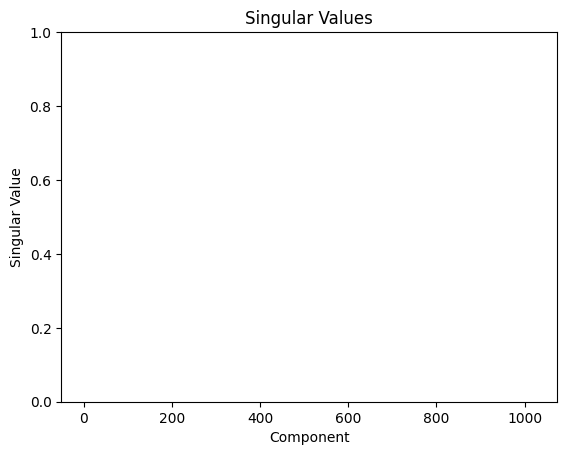

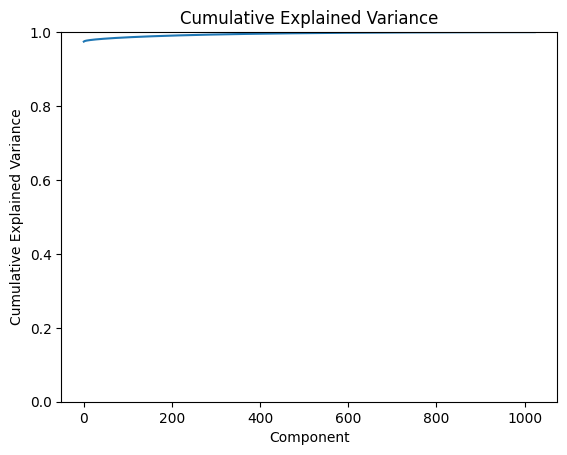

First singular value: 4592.45166015625
Last singular value: 2.3003549575805664
First component explained variance: 0.9743573665618896
Last component explained variance: 2.444662072775827e-07
Cumulative explained variance by first half components: 0.9973613619804382
Cumulative explained variance by all components: 1.0
blocks.12.hook_resid_post


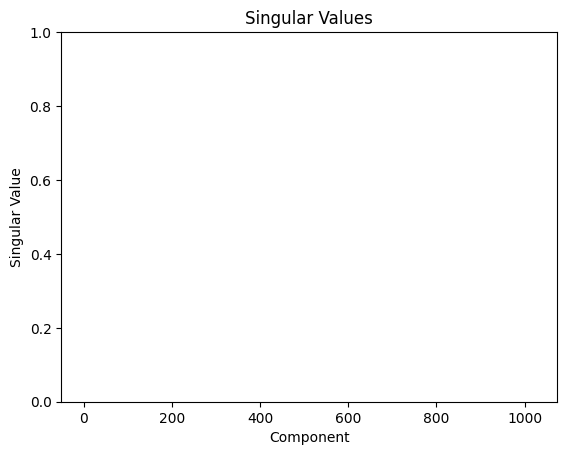

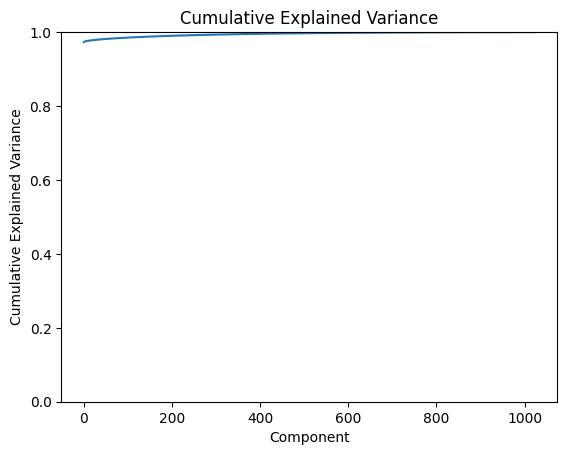

First singular value: 4597.01123046875
Last singular value: 2.3717336654663086
First component explained variance: 0.9729263782501221
Last component explained variance: 2.589767120753095e-07
Cumulative explained variance by first half components: 0.9972211122512817
Cumulative explained variance by all components: 0.9999997615814209
blocks.13.hook_resid_post


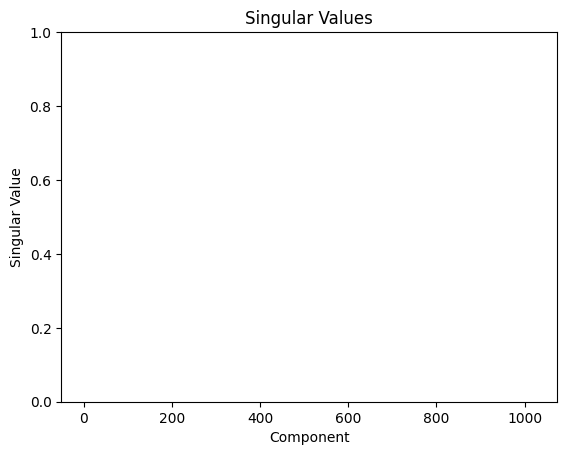

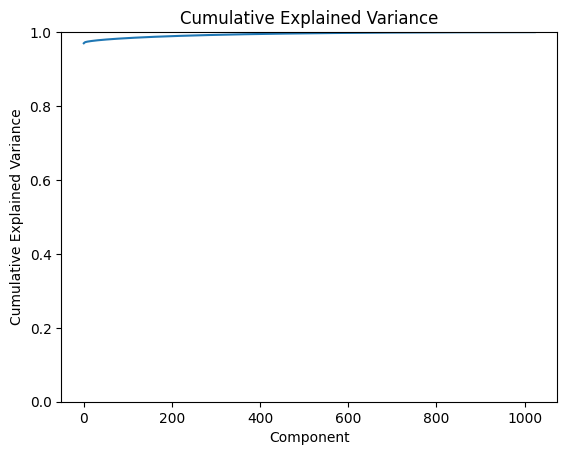

First singular value: 4605.4296875
Last singular value: 2.4638049602508545
First component explained variance: 0.969852864742279
Last component explained variance: 2.7757363341152086e-07
Cumulative explained variance by first half components: 0.9968953132629395
Cumulative explained variance by all components: 1.0
blocks.14.hook_resid_post


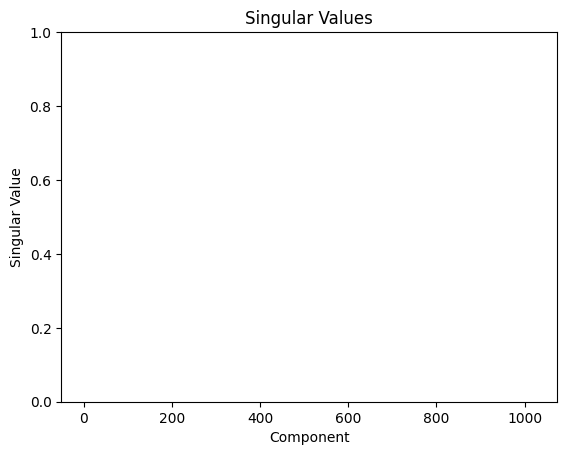

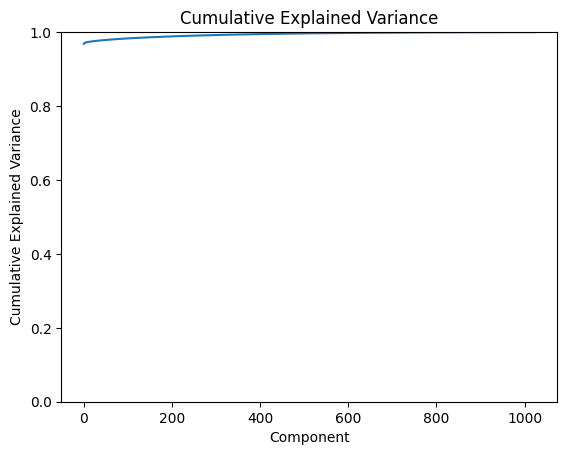

First singular value: 4606.48388671875
Last singular value: 2.5470476150512695
First component explained variance: 0.9682080745697021
Last component explained variance: 2.9600818152175634e-07
Cumulative explained variance by first half components: 0.9966951608657837
Cumulative explained variance by all components: 0.9999999403953552
blocks.15.hook_resid_post


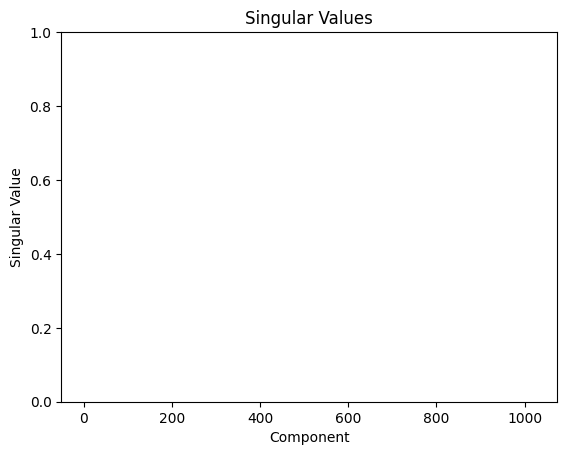

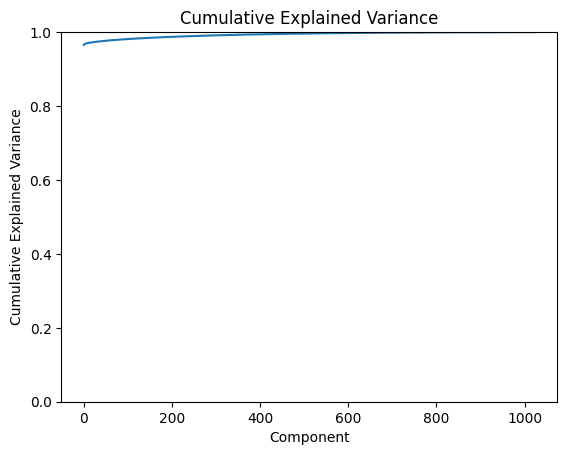

First singular value: 4601.64453125
Last singular value: 2.659243106842041
First component explained variance: 0.9650829434394836
Last component explained variance: 3.2229576163445017e-07
Cumulative explained variance by first half components: 0.996327817440033
Cumulative explained variance by all components: 1.0000001192092896
blocks.16.hook_resid_post


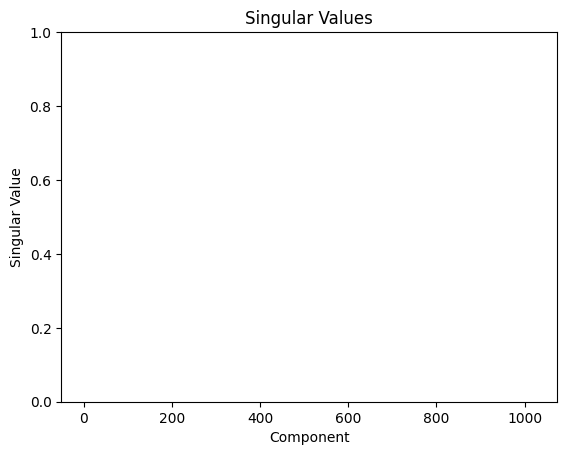

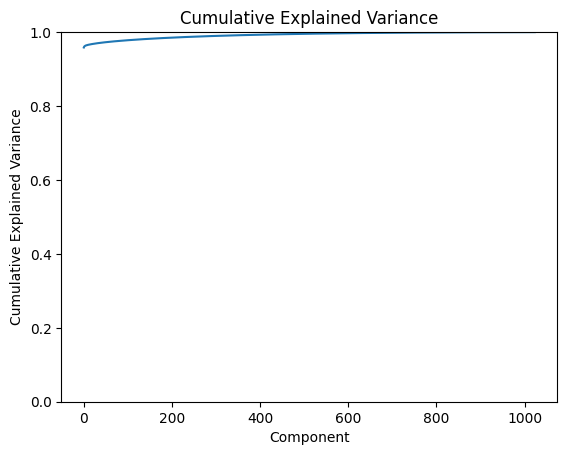

First singular value: 4593.07373046875
Last singular value: 2.803428888320923
First component explained variance: 0.9583871960639954
Last component explained variance: 3.570370381567045e-07
Cumulative explained variance by first half components: 0.9956557154655457
Cumulative explained variance by all components: 1.0
blocks.17.hook_resid_post


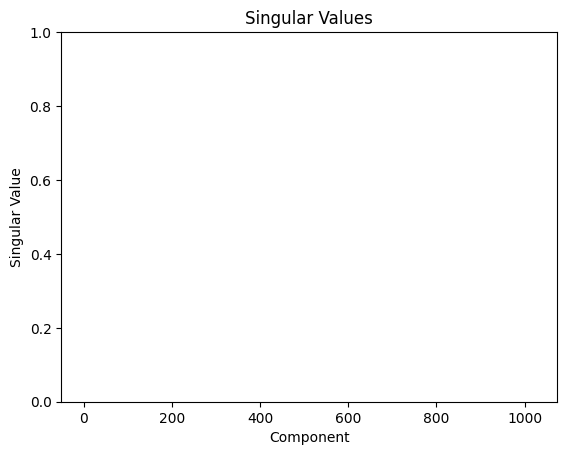

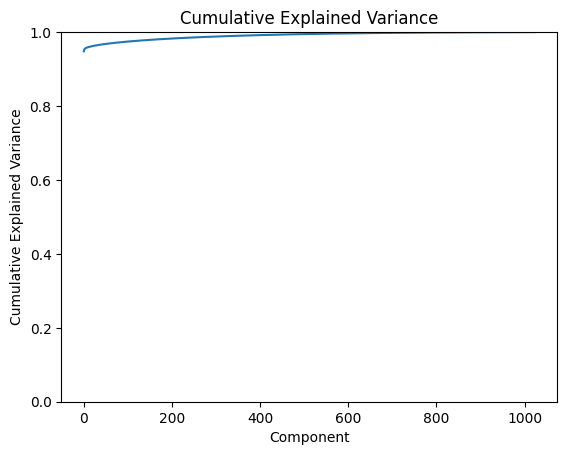

First singular value: 4568.09716796875
Last singular value: 2.929739475250244
First component explained variance: 0.9480138421058655
Last component explained variance: 3.8994377860035456e-07
Cumulative explained variance by first half components: 0.9949451088905334
Cumulative explained variance by all components: 1.0
blocks.18.hook_resid_post


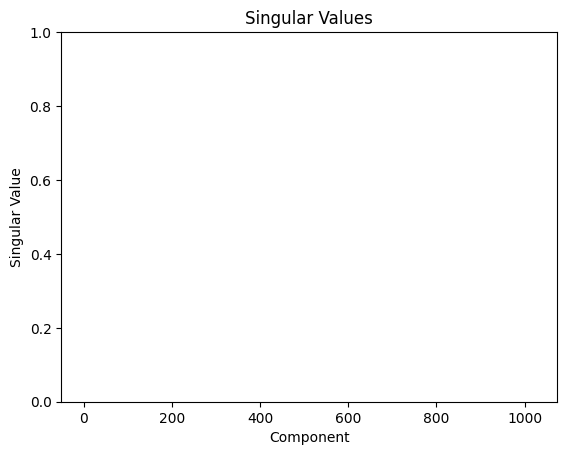

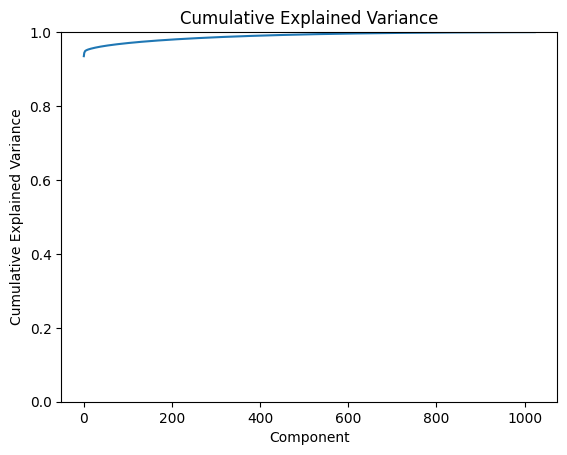

First singular value: 4536.8408203125
Last singular value: 3.08282470703125
First component explained variance: 0.9349179863929749
Last component explained variance: 4.316821389238612e-07
Cumulative explained variance by first half components: 0.9940730333328247
Cumulative explained variance by all components: 1.000000238418579
blocks.19.hook_resid_post


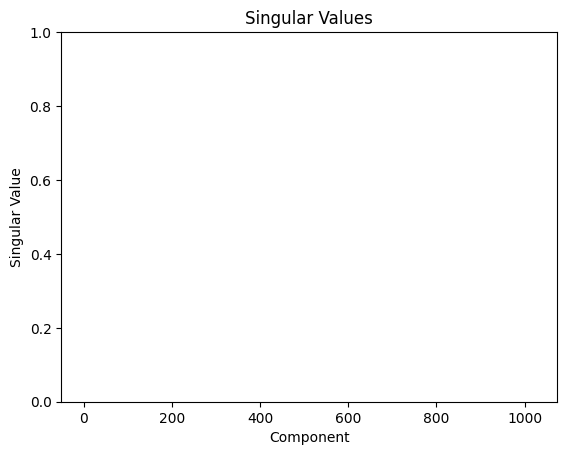

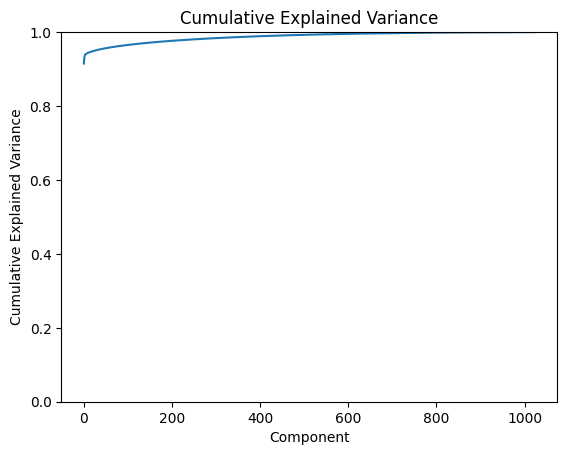

First singular value: 4454.41943359375
Last singular value: 3.2189531326293945
First component explained variance: 0.9149905443191528
Last component explained variance: 4.77819298794202e-07
Cumulative explained variance by first half components: 0.993069052696228
Cumulative explained variance by all components: 0.9999997615814209
blocks.20.hook_resid_post


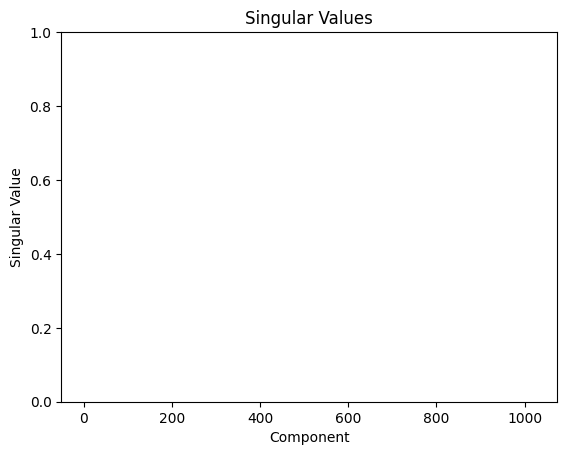

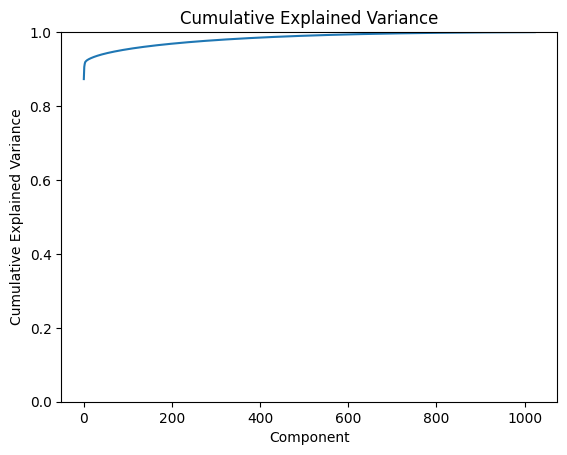

First singular value: 4053.5087890625
Last singular value: 3.321917772293091
First component explained variance: 0.8729137182235718
Last component explained variance: 5.862553962288075e-07
Cumulative explained variance by first half components: 0.990725040435791
Cumulative explained variance by all components: 1.0
blocks.21.hook_resid_post


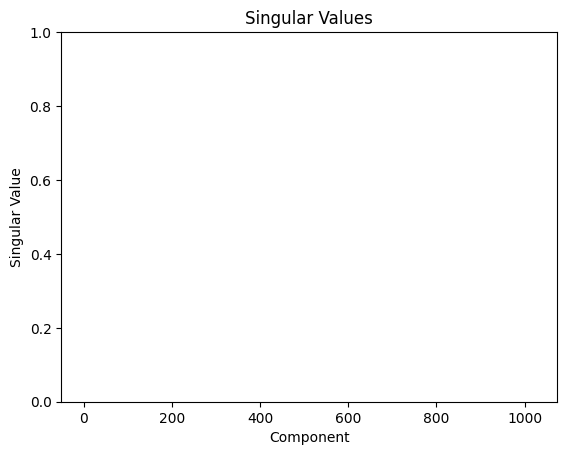

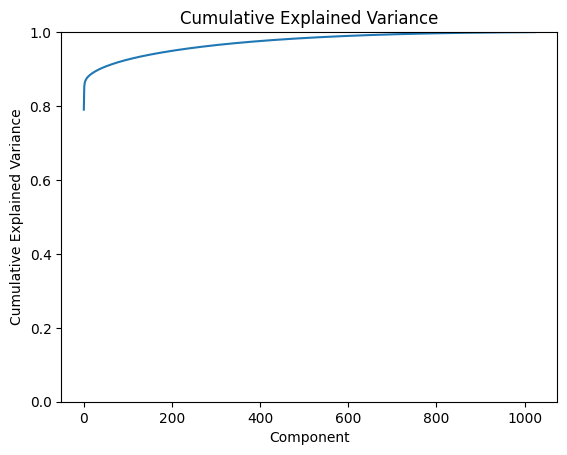

First singular value: 3163.494873046875
Last singular value: 3.573587656021118
First component explained variance: 0.7901825904846191
Last component explained variance: 1.0083285815198906e-06
Cumulative explained variance by first half components: 0.9847953915596008
Cumulative explained variance by all components: 1.0
blocks.22.hook_resid_post


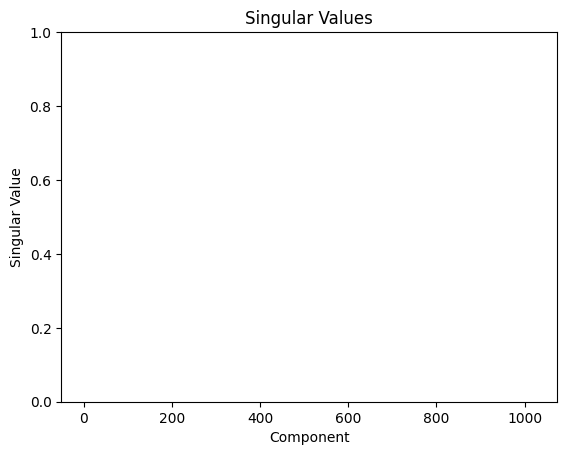

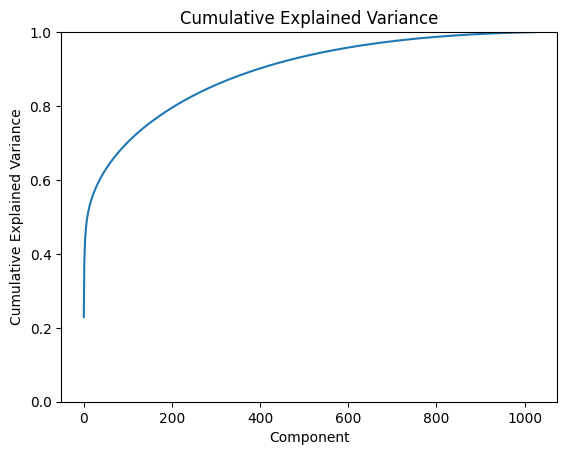

First singular value: 913.6444091796875
Last singular value: 3.8706209659576416
First component explained variance: 0.22903092205524445
Last component explained variance: 4.1105599848378915e-06
Cumulative explained variance by first half components: 0.9377543926239014
Cumulative explained variance by all components: 1.0
blocks.23.hook_resid_post


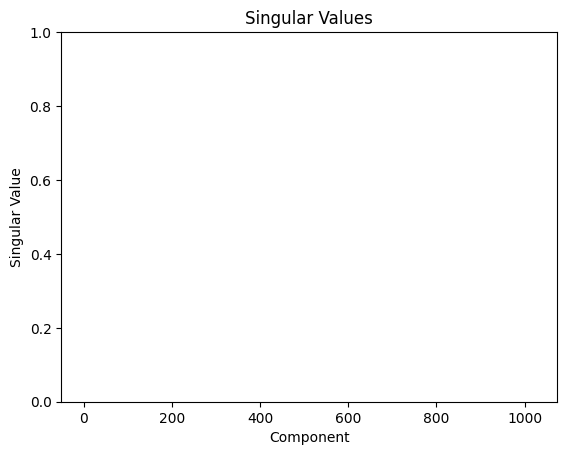

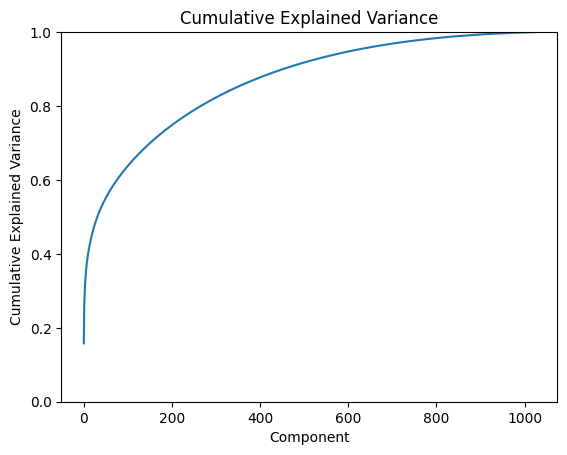

First singular value: 714.2093505859375
Last singular value: 8.825906753540039
First component explained variance: 0.15792898833751678
Last component explained variance: 2.4117342036333866e-05
Cumulative explained variance by first half components: 0.9219533205032349
Cumulative explained variance by all components: 1.0


In [ ]:
for hook_name, X in random_dset.items():
  print(hook_name)
  X_demeaned = X - X.mean(dim=0)
  evaluate_anisotropy(X_demeaned)

# Online PyTorch probes

In [ ]:
criterion = nn.BCEWithLogitsLoss()  # Binary Cross-Entropy loss

In [ ]:
# Create a logistic regression model
class Probe(nn.Module):
    def __init__(self, input_dim, hook_name):
        super().__init__()
        self.linear = nn.Linear(input_dim, 1)
        self.hook_name = hook_name

    def forward(self, x):
        output = self.linear(x)
        return output

In [ ]:
hook_probes = {hook_name: Probe(512, hook_name).to(device) for hook_name in hook_names}

In [ ]:
hook_probes

{'blocks.0.hook_resid_pre': Probe(
   (linear): Linear(in_features=512, out_features=1, bias=True)
 ),
 'blocks.0.hook_attn_out': Probe(
   (linear): Linear(in_features=512, out_features=1, bias=True)
 ),
 'blocks.0.hook_mlp_out': Probe(
   (linear): Linear(in_features=512, out_features=1, bias=True)
 ),
 'blocks.1.hook_resid_pre': Probe(
   (linear): Linear(in_features=512, out_features=1, bias=True)
 ),
 'blocks.1.hook_attn_out': Probe(
   (linear): Linear(in_features=512, out_features=1, bias=True)
 ),
 'blocks.1.hook_mlp_out': Probe(
   (linear): Linear(in_features=512, out_features=1, bias=True)
 ),
 'blocks.2.hook_resid_pre': Probe(
   (linear): Linear(in_features=512, out_features=1, bias=True)
 ),
 'blocks.2.hook_attn_out': Probe(
   (linear): Linear(in_features=512, out_features=1, bias=True)
 ),
 'blocks.2.hook_mlp_out': Probe(
   (linear): Linear(in_features=512, out_features=1, bias=True)
 )}

In [ ]:
hook_probes['blocks.2.hook_mlp_out']

Probe(
  (linear): Linear(in_features=512, out_features=1, bias=True)
)

In [ ]:
lr = 0.1

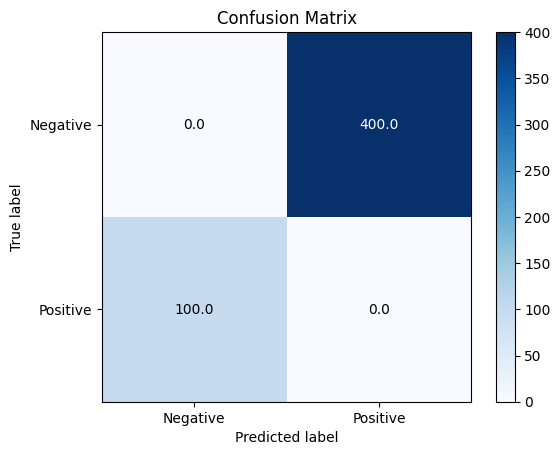

F1 Score: 0.0
Accuracy: 0.0
Sensitivity: 0.0
Specificity: 0.0


In [ ]:
evaluate_probe(hook_probes[hook_name], hook_name, 'pt')

In [ ]:
hook_optimizers = {hook_name: optim.SGD(hook_probes[hook_name].parameters(), lr=lr) for hook_name in hook_names}

In [ ]:
def validate(hook_probe, loader, dset):
  print('validating')
  total_loss = 0.0
  running_loss = 0.0
  for i, (_, _, seqs, labels) in tqdm(enumerate(loader)):
    with torch.no_grad():
      _, cache = model.run_with_cache(seqs)

    acts = cache[hook_name][:,-1,:]

    # Forward pass
    with torch.no_grad():
      hook_probe_out = hook_probe(acts)
    hook_probe_loss = criterion(hook_probe_out.reshape(-1), labels)

    total_loss += hook_probe_loss.item()

  print('validate result', total_loss, total_loss / len(loader), total_loss / len(dset))
  return total_loss / len(loader)

In [ ]:
def validate_metrics(hook_name):
  hook_probe = hook_probes[hook_name]
  hook_val_fixed_dset = hook_fixed_val_dsets[hook_name]
  val_y_out = hook_probe(hook_val_fixed_dset).reshape(-1)
  val_y_true = torch.tensor(val_labels == 1.).float()
  val_y_out_binary = (val_y_out > 0).float()
  get_metrics(val_y_true, val_y_out_binary)

cuda:0 cuda:0
0 blocks.0.hook_resid_pre 0.6879873871803284
cuda:0 cuda:0
0 blocks.0.hook_attn_out 0.7448886632919312
cuda:0 cuda:0
0 blocks.0.hook_mlp_out 0.5991331934928894
cuda:0 cuda:0
0 blocks.1.hook_resid_pre 0.690165102481842
cuda:0 cuda:0
0 blocks.1.hook_attn_out 0.7035205364227295
cuda:0 cuda:0
0 blocks.1.hook_mlp_out 0.6672771573066711
cuda:0 cuda:0
0 blocks.2.hook_resid_pre 0.6976935863494873
cuda:0 cuda:0
0 blocks.2.hook_attn_out 0.8261500597000122
cuda:0 cuda:0
0 blocks.2.hook_mlp_out 0.7566759586334229
cuda:0 cuda:0
1 blocks.0.hook_resid_pre 0.6541996002197266
cuda:0 cuda:0
1 blocks.0.hook_attn_out 0.6074169278144836
cuda:0 cuda:0
1 blocks.0.hook_mlp_out 0.3209514021873474
cuda:0 cuda:0
1 blocks.1.hook_resid_pre 0.2870350182056427
cuda:0 cuda:0
1 blocks.1.hook_attn_out 0.6276308298110962
cuda:0 cuda:0
1 blocks.1.hook_mlp_out 0.5373892188072205
cuda:0 cuda:0
1 blocks.2.hook_resid_pre 0.18347260355949402
cuda:0 cuda:0
1 blocks.2.hook_attn_out 0.6261448860168457
cuda:0 cuda:0

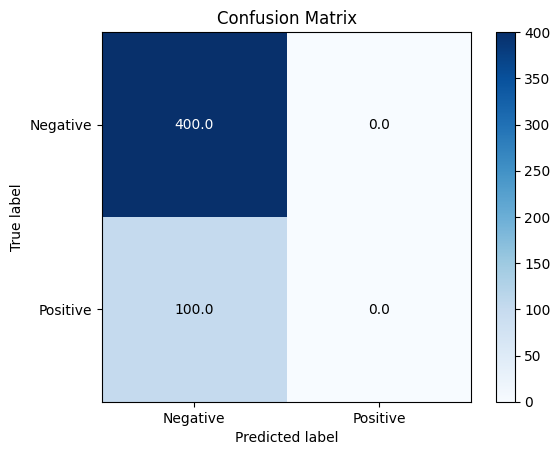

F1 Score: 0.0
Accuracy: 0.8
Sensitivity: 0.0
Specificity: 1.0
eval for blocks.0.hook_attn_out


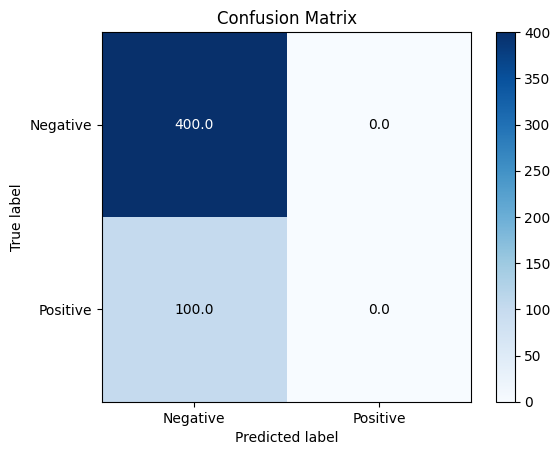

F1 Score: 0.0
Accuracy: 0.8
Sensitivity: 0.0
Specificity: 1.0
eval for blocks.0.hook_mlp_out


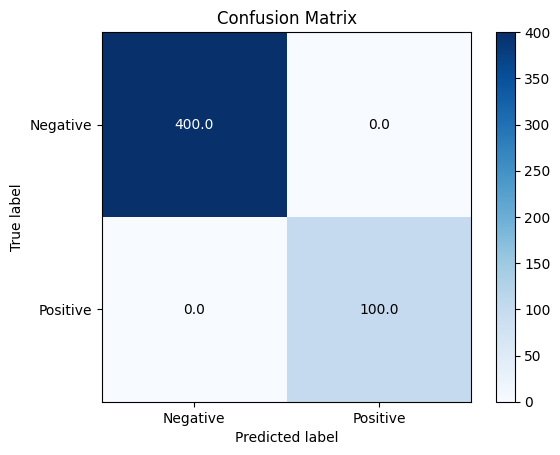

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
eval for blocks.1.hook_resid_pre


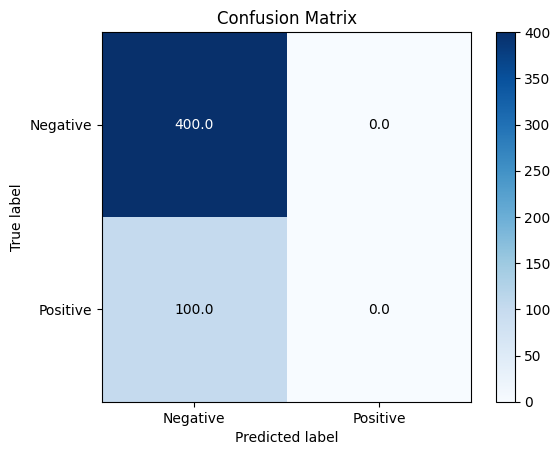

F1 Score: 0.0
Accuracy: 0.8
Sensitivity: 0.0
Specificity: 1.0
eval for blocks.1.hook_attn_out


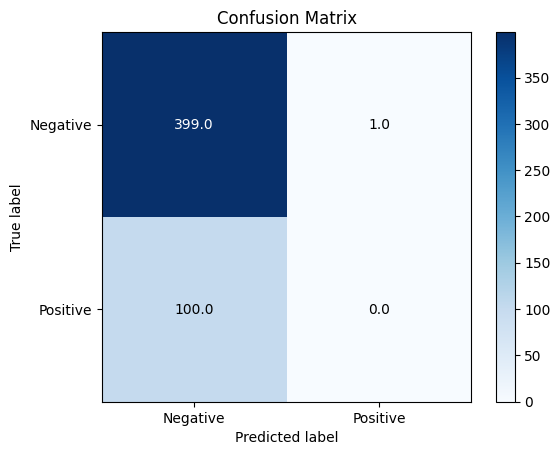

F1 Score: 0.0
Accuracy: 0.798
Sensitivity: 0.0
Specificity: 0.9975000023841858
eval for blocks.1.hook_mlp_out


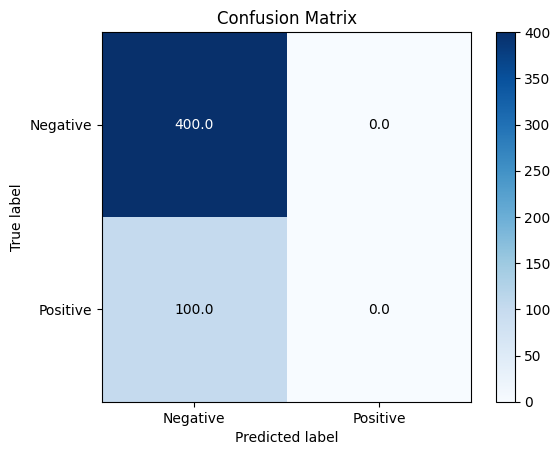

F1 Score: 0.0
Accuracy: 0.8
Sensitivity: 0.0
Specificity: 1.0
eval for blocks.2.hook_resid_pre


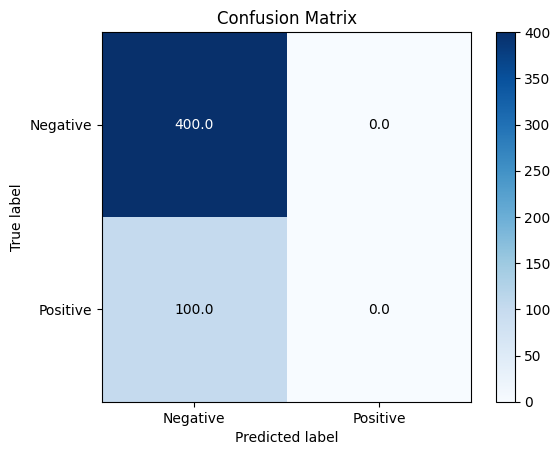

F1 Score: 0.0
Accuracy: 0.8
Sensitivity: 0.0
Specificity: 1.0
eval for blocks.2.hook_attn_out


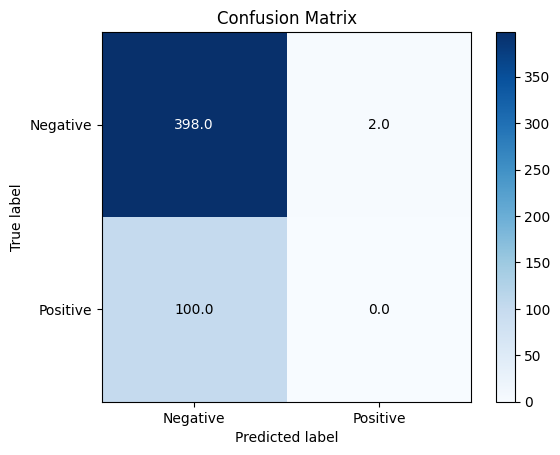

F1 Score: 0.0
Accuracy: 0.796
Sensitivity: 0.0
Specificity: 0.9950000047683716
eval for blocks.2.hook_mlp_out


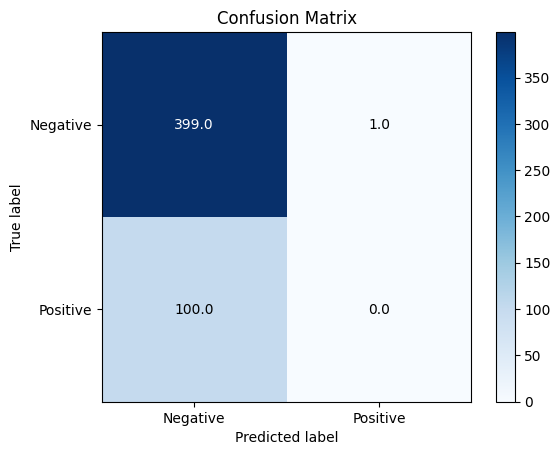

F1 Score: 0.0
Accuracy: 0.798
Sensitivity: 0.0
Specificity: 0.9975000023841858
cuda:0 cuda:0
2 blocks.0.hook_resid_pre 0.7531896233558655
cuda:0 cuda:0
2 blocks.0.hook_attn_out 0.8357639908790588
cuda:0 cuda:0
2 blocks.0.hook_mlp_out 0.6708888411521912
cuda:0 cuda:0
2 blocks.1.hook_resid_pre 0.8536885380744934
cuda:0 cuda:0
2 blocks.1.hook_attn_out 0.786708652973175
cuda:0 cuda:0
2 blocks.1.hook_mlp_out 0.8194248676300049
cuda:0 cuda:0
2 blocks.2.hook_resid_pre 1.0359684228897095
cuda:0 cuda:0
2 blocks.2.hook_attn_out 0.8360165357589722
cuda:0 cuda:0
2 blocks.2.hook_mlp_out 1.091062068939209
cuda:0 cuda:0
3 blocks.0.hook_resid_pre 0.6482325792312622
cuda:0 cuda:0
3 blocks.0.hook_attn_out 0.5875025987625122
cuda:0 cuda:0
3 blocks.0.hook_mlp_out 0.22667402029037476
cuda:0 cuda:0
3 blocks.1.hook_resid_pre 0.22693626582622528
cuda:0 cuda:0
3 blocks.1.hook_attn_out 0.5824374556541443
cuda:0 cuda:0
3 blocks.1.hook_mlp_out 0.5003288984298706
cuda:0 cuda:0
3 blocks.2.hook_resid_pre 0.207829326

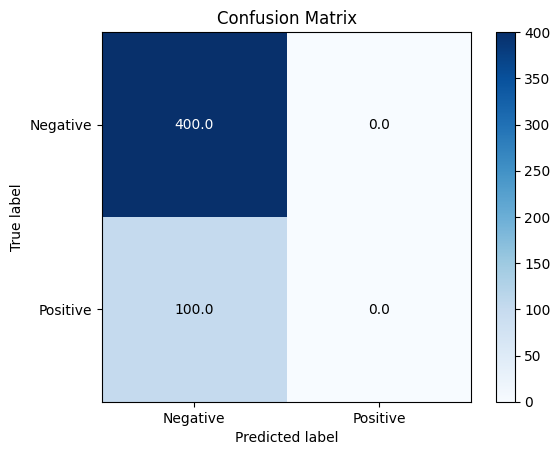

F1 Score: 0.0
Accuracy: 0.8
Sensitivity: 0.0
Specificity: 1.0
eval for blocks.0.hook_attn_out


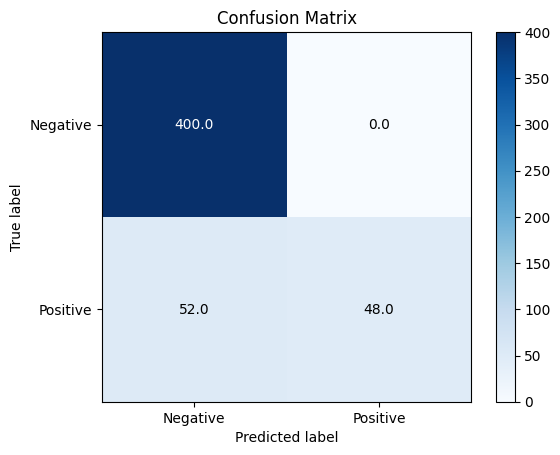

F1 Score: 0.6486486486486487
Accuracy: 0.896
Sensitivity: 0.47999998927116394
Specificity: 1.0
eval for blocks.0.hook_mlp_out


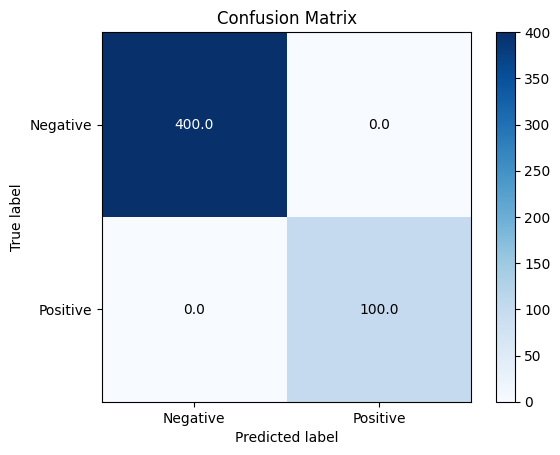

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
eval for blocks.1.hook_resid_pre


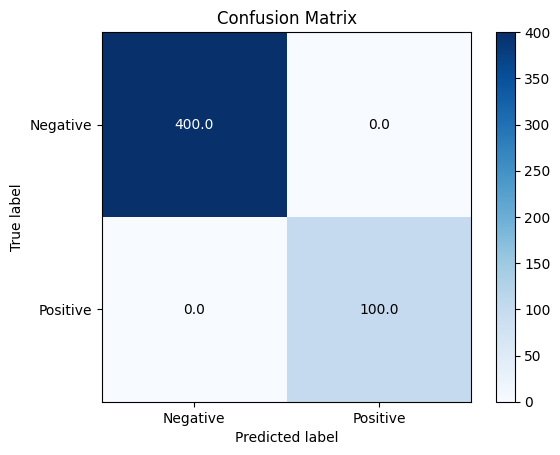

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
eval for blocks.1.hook_attn_out


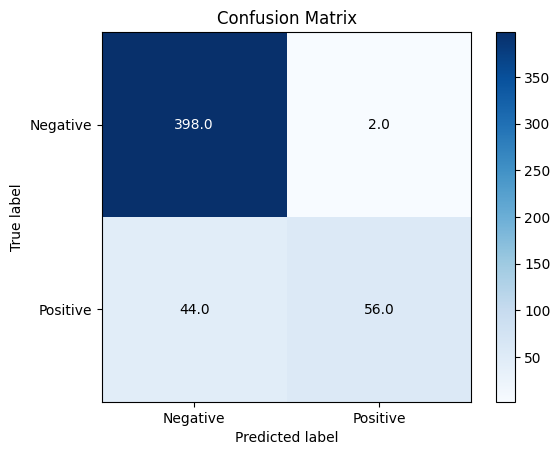

F1 Score: 0.7088607594936709
Accuracy: 0.908
Sensitivity: 0.5600000023841858
Specificity: 0.9950000047683716
eval for blocks.1.hook_mlp_out


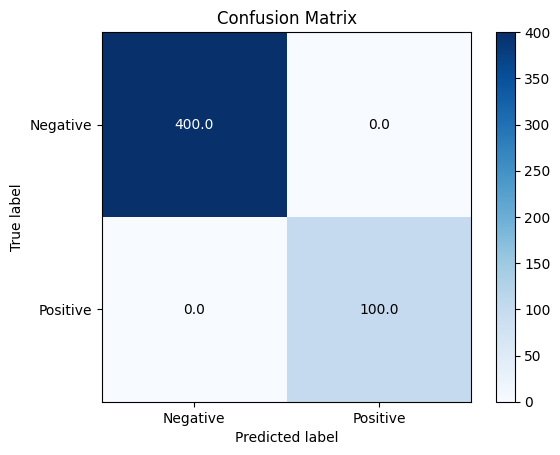

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
eval for blocks.2.hook_resid_pre


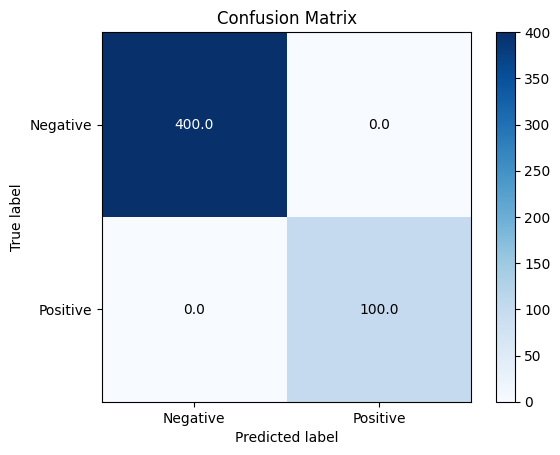

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
eval for blocks.2.hook_attn_out


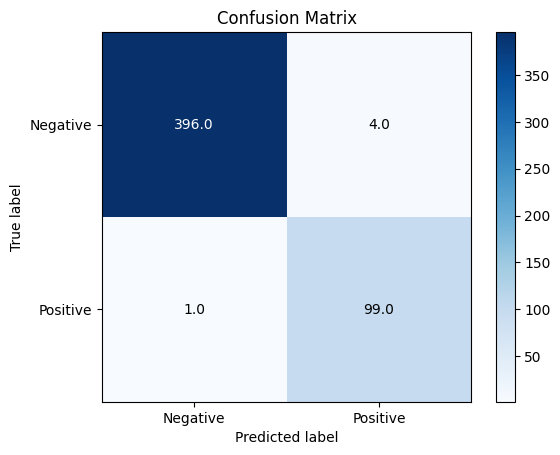

F1 Score: 0.9753694581280788
Accuracy: 0.99
Sensitivity: 0.9900000095367432
Specificity: 0.9900000095367432
eval for blocks.2.hook_mlp_out


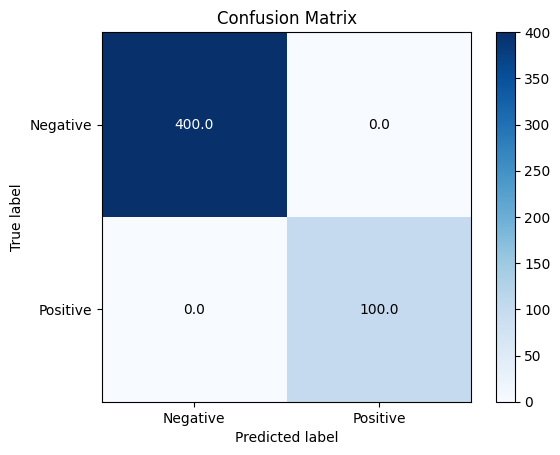

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
cuda:0 cuda:0
22 blocks.0.hook_resid_pre 0.4518575072288513
cuda:0 cuda:0
22 blocks.0.hook_attn_out 0.17766329646110535
cuda:0 cuda:0
22 blocks.0.hook_mlp_out 0.04024340584874153
cuda:0 cuda:0
22 blocks.1.hook_resid_pre 0.031231166794896126
cuda:0 cuda:0
22 blocks.1.hook_attn_out 0.36838725209236145
cuda:0 cuda:0
22 blocks.1.hook_mlp_out 0.10227620601654053
cuda:0 cuda:0
22 blocks.2.hook_resid_pre 0.02846364863216877
cuda:0 cuda:0
22 blocks.2.hook_attn_out 0.19123142957687378
cuda:0 cuda:0
22 blocks.2.hook_mlp_out 0.09106025844812393
cuda:0 cuda:0
23 blocks.0.hook_resid_pre 0.4337829649448395
cuda:0 cuda:0
23 blocks.0.hook_attn_out 0.18070679903030396
cuda:0 cuda:0
23 blocks.0.hook_mlp_out 0.037657011300325394
cuda:0 cuda:0
23 blocks.1.hook_resid_pre 0.028885535895824432
cuda:0 cuda:0
23 blocks.1.hook_attn_out 0.2922079861164093
cuda:0 cuda:0
23 blocks.1.hook_mlp_out 0.11238798499107361
cuda:0 cuda:0
23 blocks.2.hook_resid_p

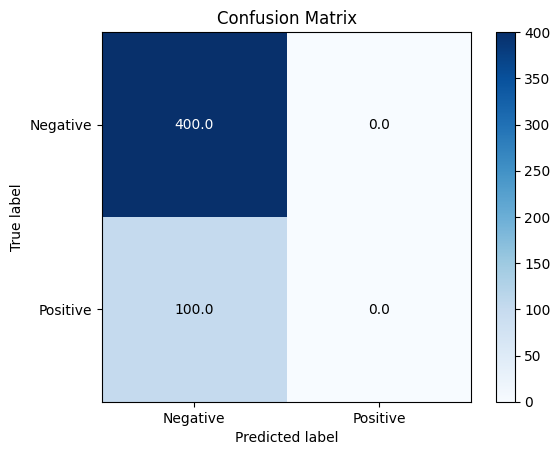

F1 Score: 0.0
Accuracy: 0.8
Sensitivity: 0.0
Specificity: 1.0
eval for blocks.0.hook_attn_out


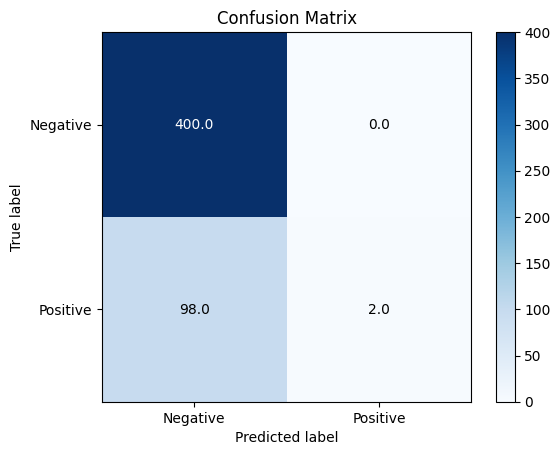

F1 Score: 0.0392156862745098
Accuracy: 0.804
Sensitivity: 0.019999999552965164
Specificity: 1.0
eval for blocks.0.hook_mlp_out


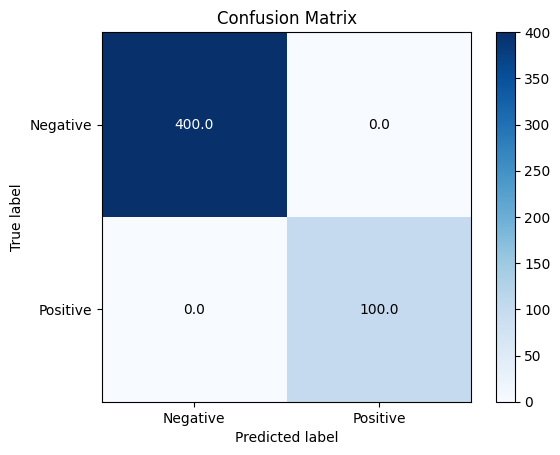

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
eval for blocks.1.hook_resid_pre


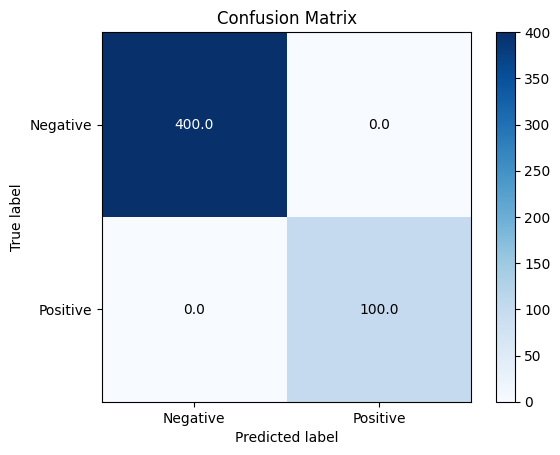

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
eval for blocks.1.hook_attn_out


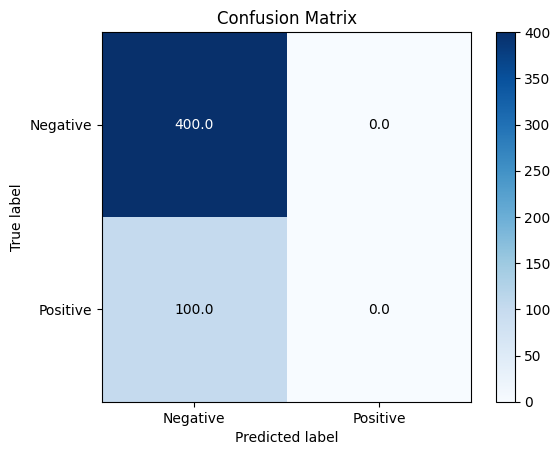

F1 Score: 0.0
Accuracy: 0.8
Sensitivity: 0.0
Specificity: 1.0
eval for blocks.1.hook_mlp_out


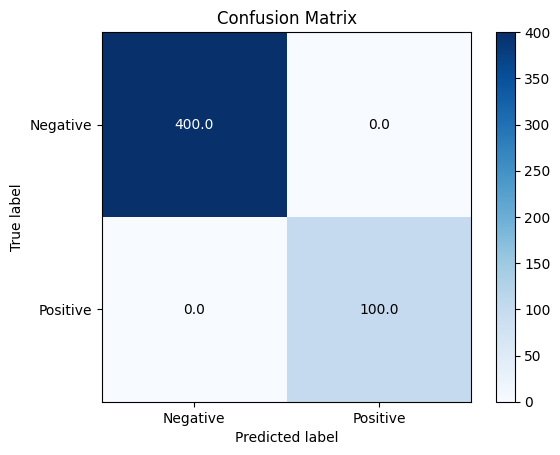

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
eval for blocks.2.hook_resid_pre


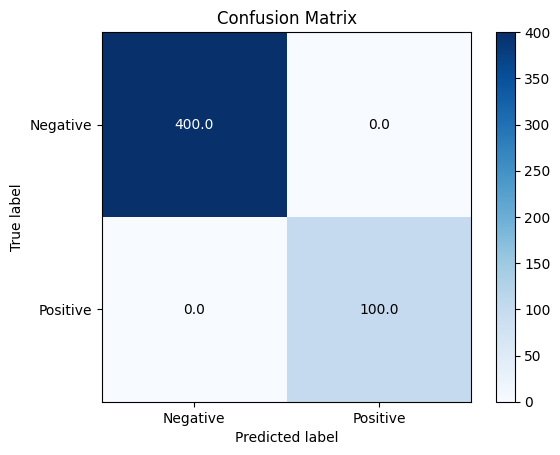

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
eval for blocks.2.hook_attn_out


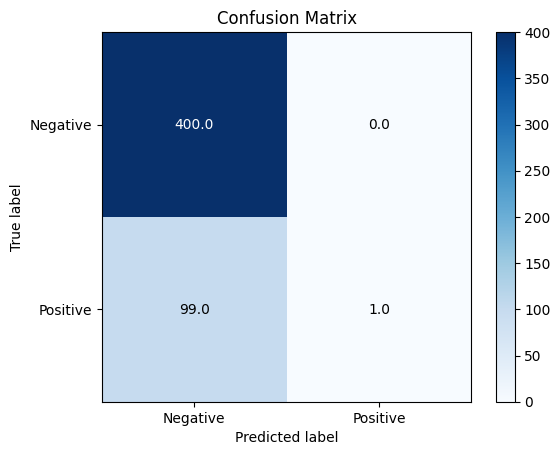

F1 Score: 0.019801980198019802
Accuracy: 0.802
Sensitivity: 0.009999999776482582
Specificity: 1.0
eval for blocks.2.hook_mlp_out


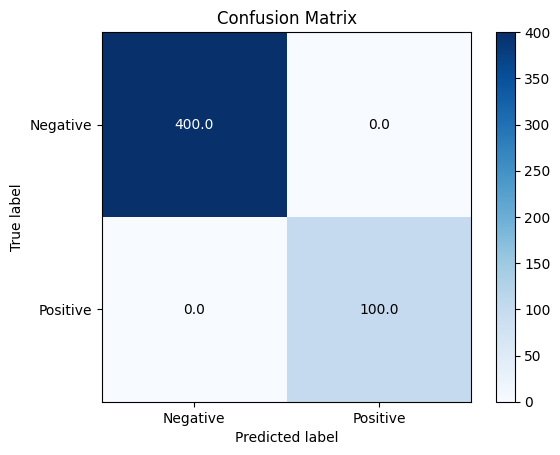

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
cuda:0 cuda:0
42 blocks.0.hook_resid_pre 0.23387694358825684
cuda:0 cuda:0
42 blocks.0.hook_attn_out 0.030298987403512
cuda:0 cuda:0
42 blocks.0.hook_mlp_out 0.016932209953665733
cuda:0 cuda:0
42 blocks.1.hook_resid_pre 0.009828153997659683
cuda:0 cuda:0
42 blocks.1.hook_attn_out 0.09629666060209274
cuda:0 cuda:0
42 blocks.1.hook_mlp_out 0.04586510360240936
cuda:0 cuda:0
42 blocks.2.hook_resid_pre 0.008225256577134132
cuda:0 cuda:0
42 blocks.2.hook_attn_out 0.04694521427154541
cuda:0 cuda:0
42 blocks.2.hook_mlp_out 0.025083519518375397
cuda:0 cuda:0
43 blocks.0.hook_resid_pre 0.22790192067623138
cuda:0 cuda:0
43 blocks.0.hook_attn_out 0.12141375243663788
cuda:0 cuda:0
43 blocks.0.hook_mlp_out 0.016454944387078285
cuda:0 cuda:0
43 blocks.1.hook_resid_pre 0.013170509599149227
cuda:0 cuda:0
43 blocks.1.hook_attn_out 0.1995937079191208
cuda:0 cuda:0
43 blocks.1.hook_mlp_out 0.06359096616506577
cuda:0 cuda:0
43 blocks.2.hook_resi

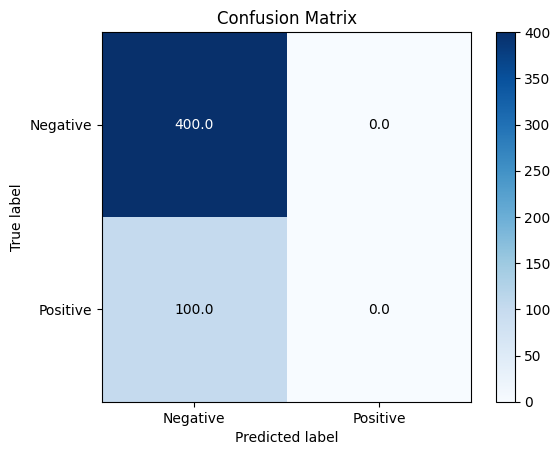

F1 Score: 0.0
Accuracy: 0.8
Sensitivity: 0.0
Specificity: 1.0
eval for blocks.0.hook_attn_out


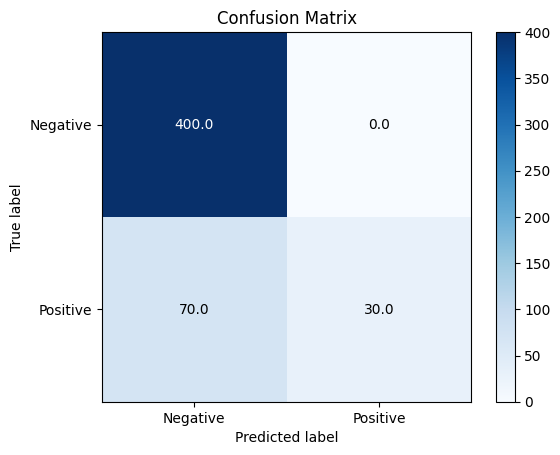

F1 Score: 0.4615384615384615
Accuracy: 0.86
Sensitivity: 0.30000001192092896
Specificity: 1.0
eval for blocks.0.hook_mlp_out


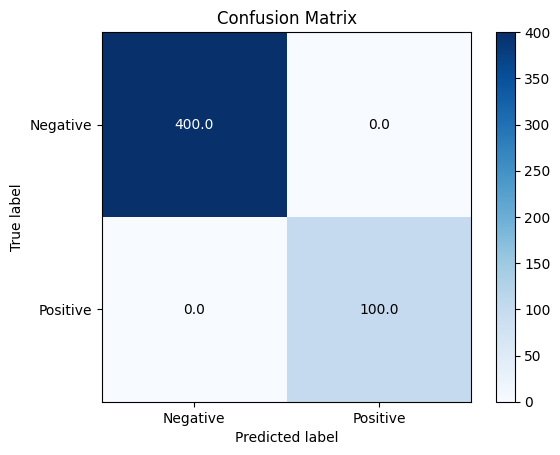

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
eval for blocks.1.hook_resid_pre


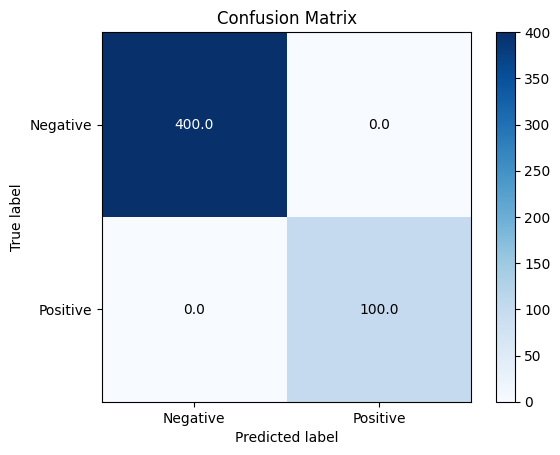

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
eval for blocks.1.hook_attn_out


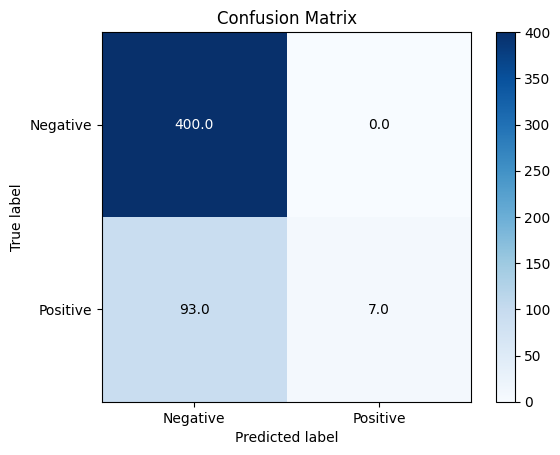

F1 Score: 0.13084112149532712
Accuracy: 0.814
Sensitivity: 0.07000000029802322
Specificity: 1.0
eval for blocks.1.hook_mlp_out


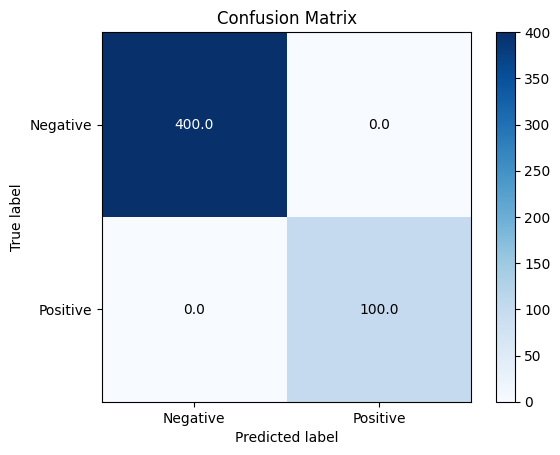

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
eval for blocks.2.hook_resid_pre


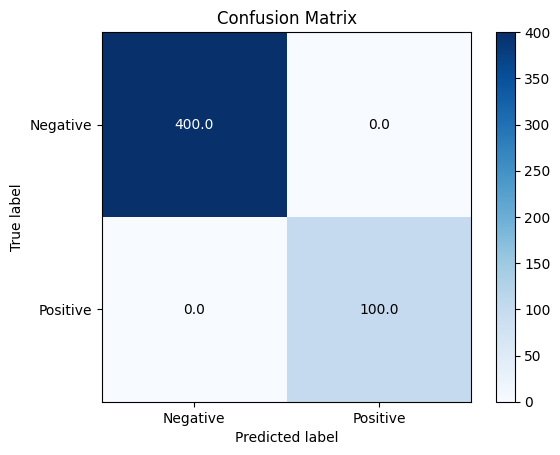

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
eval for blocks.2.hook_attn_out


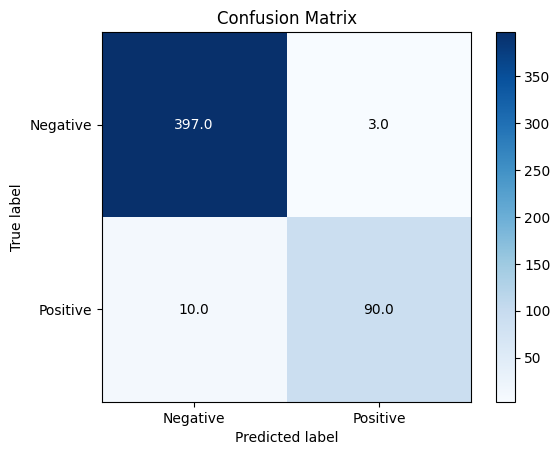

F1 Score: 0.9326424870466321
Accuracy: 0.974
Sensitivity: 0.8999999761581421
Specificity: 0.9925000071525574
eval for blocks.2.hook_mlp_out


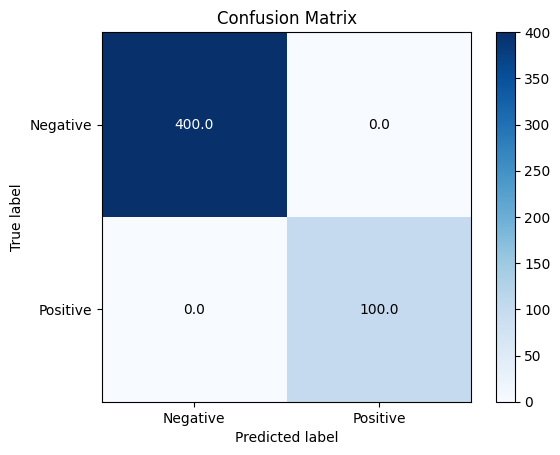

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
cuda:0 cuda:0
62 blocks.0.hook_resid_pre 0.18674924969673157
cuda:0 cuda:0
62 blocks.0.hook_attn_out 0.053611334413290024
cuda:0 cuda:0
62 blocks.0.hook_mlp_out 0.011721900664269924
cuda:0 cuda:0
62 blocks.1.hook_resid_pre 0.010981598868966103
cuda:0 cuda:0
62 blocks.1.hook_attn_out 0.06896212697029114
cuda:0 cuda:0
62 blocks.1.hook_mlp_out 0.027364885434508324
cuda:0 cuda:0
62 blocks.2.hook_resid_pre 0.007744643371552229
cuda:0 cuda:0
62 blocks.2.hook_attn_out 0.0607055127620697
cuda:0 cuda:0
62 blocks.2.hook_mlp_out 0.02843421883881092
cuda:0 cuda:0
63 blocks.0.hook_resid_pre 0.18275582790374756
cuda:0 cuda:0
63 blocks.0.hook_attn_out 0.05583447217941284
cuda:0 cuda:0
63 blocks.0.hook_mlp_out 0.011490946635603905
cuda:0 cuda:0
63 blocks.1.hook_resid_pre 0.009176341816782951
cuda:0 cuda:0
63 blocks.1.hook_attn_out 0.11544550210237503
cuda:0 cuda:0
63 blocks.1.hook_mlp_out 0.041987430304288864
cuda:0 cuda:0
63 blocks.2.hook_

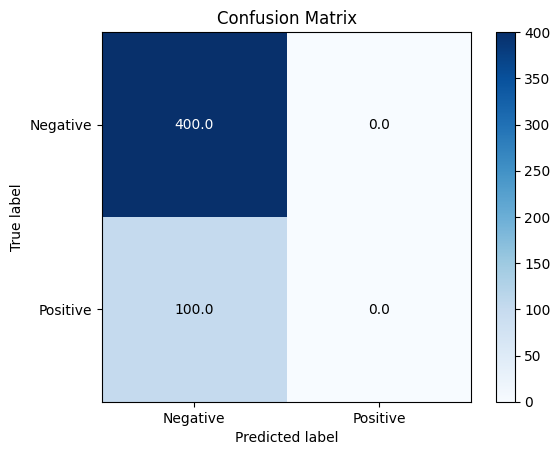

F1 Score: 0.0
Accuracy: 0.8
Sensitivity: 0.0
Specificity: 1.0
eval for blocks.0.hook_attn_out


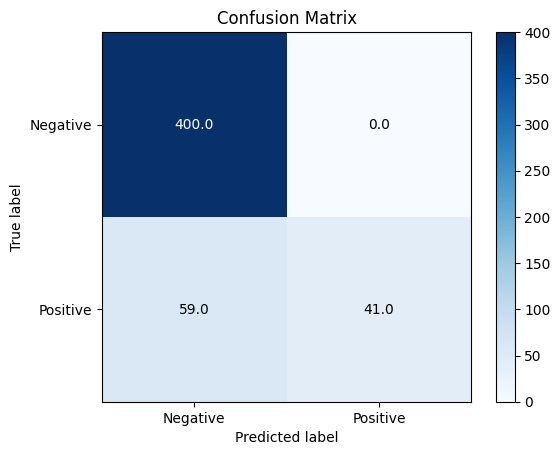

F1 Score: 0.5815602836879432
Accuracy: 0.882
Sensitivity: 0.4099999964237213
Specificity: 1.0
eval for blocks.0.hook_mlp_out


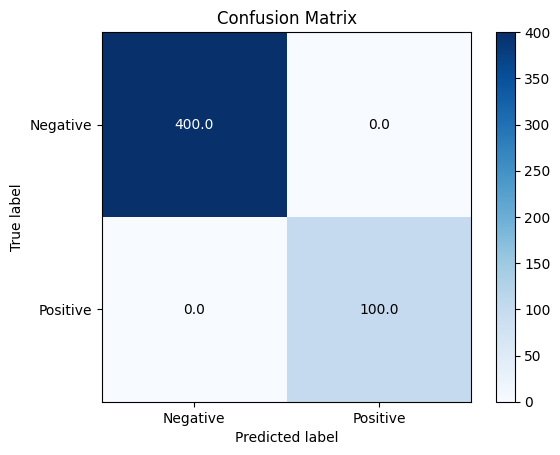

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
eval for blocks.1.hook_resid_pre


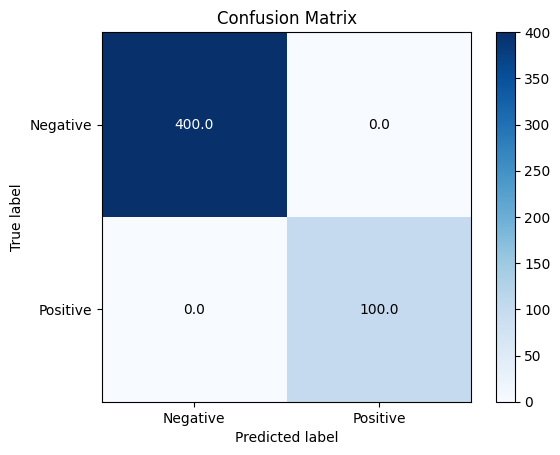

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
eval for blocks.1.hook_attn_out


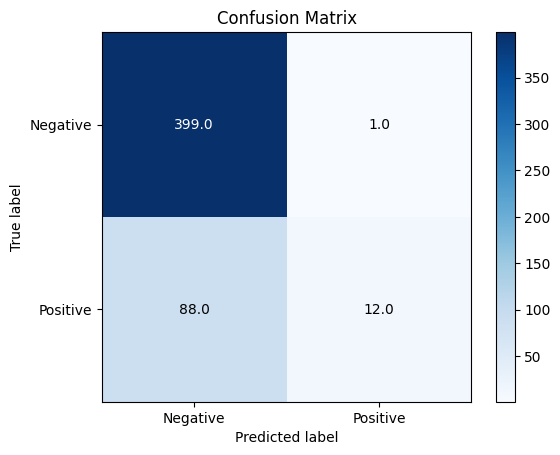

F1 Score: 0.21238938053097348
Accuracy: 0.822
Sensitivity: 0.11999999731779099
Specificity: 0.9975000023841858
eval for blocks.1.hook_mlp_out


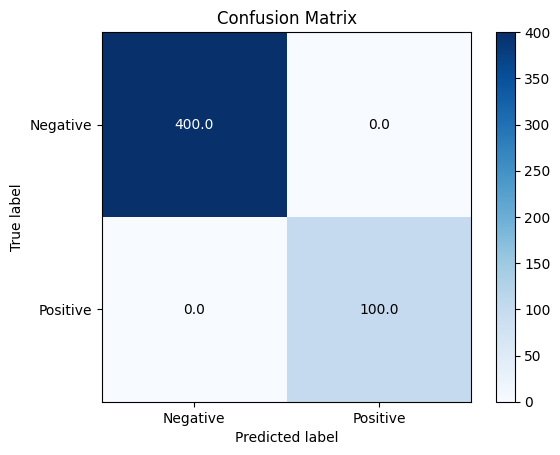

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
eval for blocks.2.hook_resid_pre


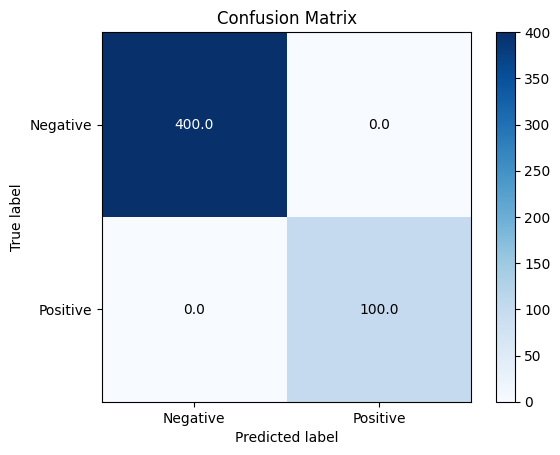

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
eval for blocks.2.hook_attn_out


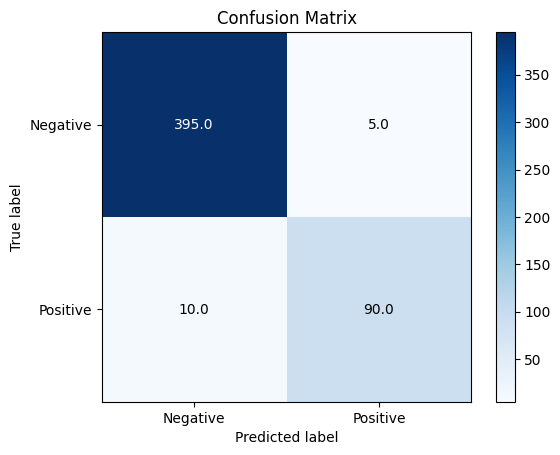

F1 Score: 0.9230769230769231
Accuracy: 0.97
Sensitivity: 0.8999999761581421
Specificity: 0.987500011920929
eval for blocks.2.hook_mlp_out


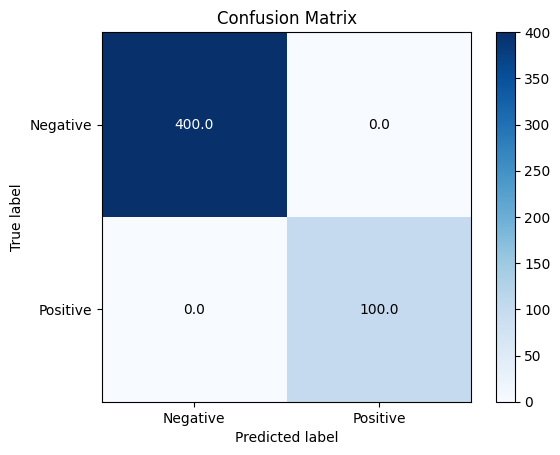

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
cuda:0 cuda:0
82 blocks.0.hook_resid_pre 0.1485498696565628
cuda:0 cuda:0
82 blocks.0.hook_attn_out 0.050033435225486755
cuda:0 cuda:0
82 blocks.0.hook_mlp_out 0.00876531656831503
cuda:0 cuda:0
82 blocks.1.hook_resid_pre 0.007207819260656834
cuda:0 cuda:0
82 blocks.1.hook_attn_out 0.107500821352005
cuda:0 cuda:0
82 blocks.1.hook_mlp_out 0.03706261143088341
cuda:0 cuda:0
82 blocks.2.hook_resid_pre 0.006263625808060169
cuda:0 cuda:0
82 blocks.2.hook_attn_out 0.03604765981435776
cuda:0 cuda:0
82 blocks.2.hook_mlp_out 0.02275591902434826
cuda:0 cuda:0
83 blocks.0.hook_resid_pre 0.1459234356880188
cuda:0 cuda:0
83 blocks.0.hook_attn_out 0.04730548709630966
cuda:0 cuda:0
83 blocks.0.hook_mlp_out 0.008635440841317177
cuda:0 cuda:0
83 blocks.1.hook_resid_pre 0.007592629641294479
cuda:0 cuda:0
83 blocks.1.hook_attn_out 0.07375705987215042
cuda:0 cuda:0
83 blocks.1.hook_mlp_out 0.027889378368854523
cuda:0 cuda:0
83 blocks.2.hook_resid

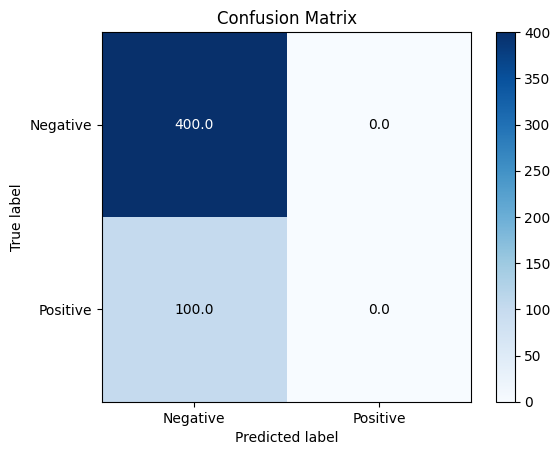

F1 Score: 0.0
Accuracy: 0.8
Sensitivity: 0.0
Specificity: 1.0
eval for blocks.0.hook_attn_out


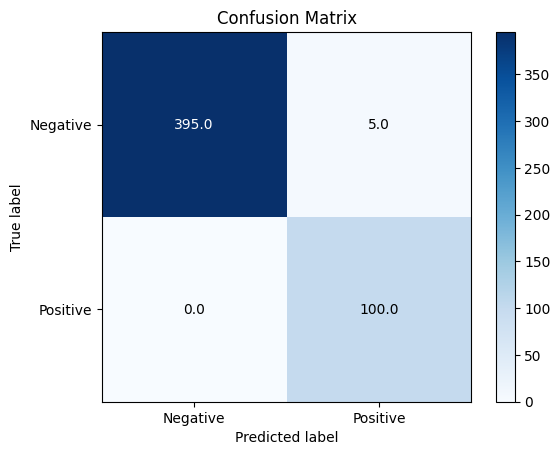

F1 Score: 0.975609756097561
Accuracy: 0.99
Sensitivity: 1.0
Specificity: 0.987500011920929
eval for blocks.0.hook_mlp_out


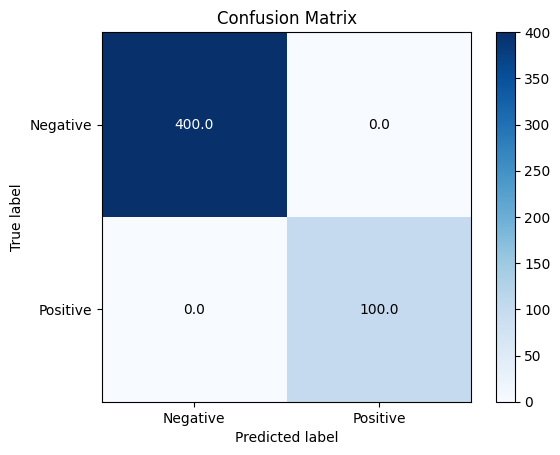

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
eval for blocks.1.hook_resid_pre


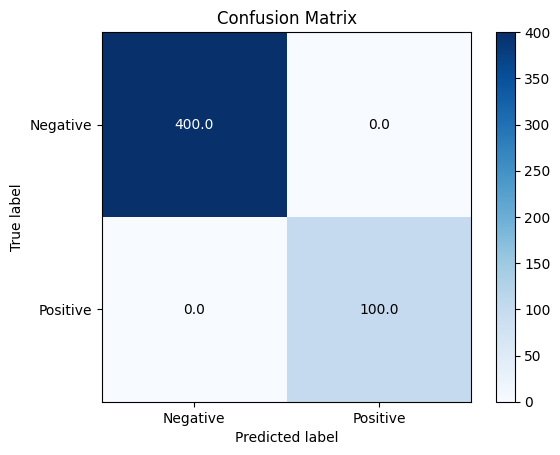

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
eval for blocks.1.hook_attn_out


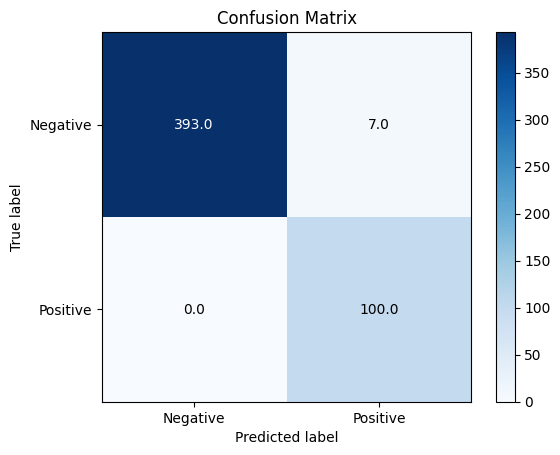

F1 Score: 0.966183574879227
Accuracy: 0.986
Sensitivity: 1.0
Specificity: 0.9825000166893005
eval for blocks.1.hook_mlp_out


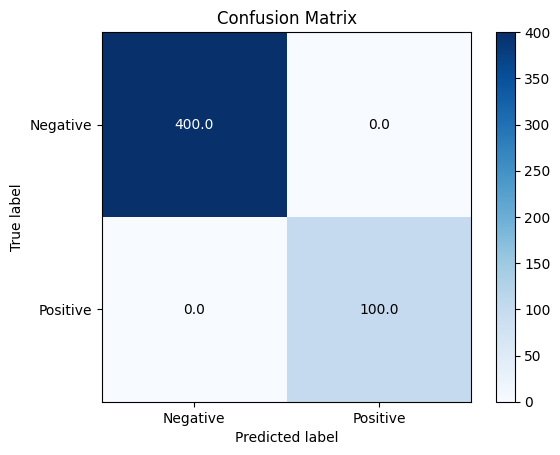

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
eval for blocks.2.hook_resid_pre


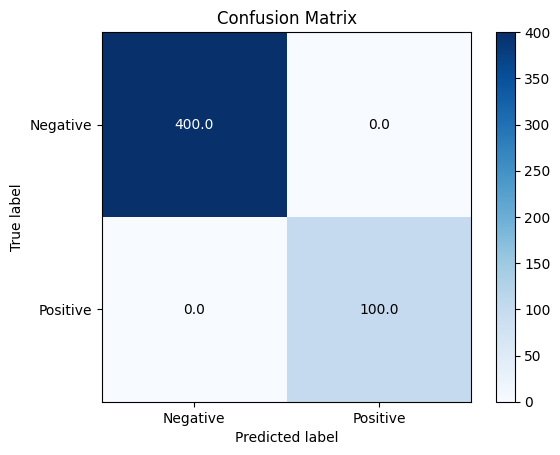

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
eval for blocks.2.hook_attn_out


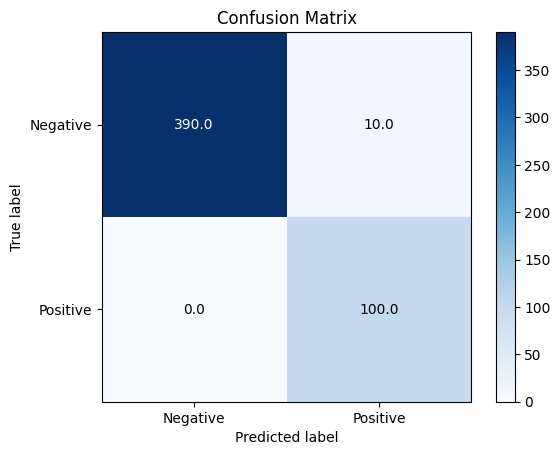

F1 Score: 0.9523809523809523
Accuracy: 0.98
Sensitivity: 1.0
Specificity: 0.9750000238418579
eval for blocks.2.hook_mlp_out


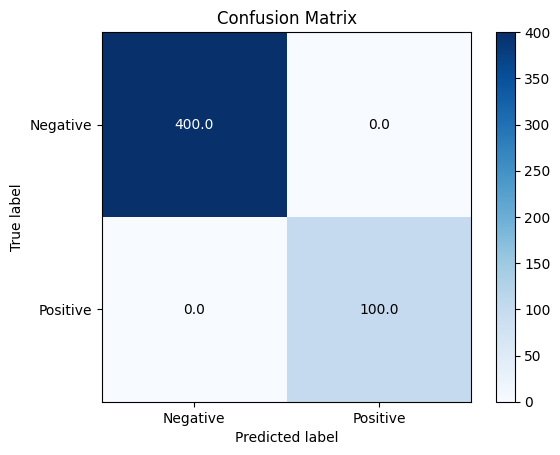

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
cuda:0 cuda:0
102 blocks.0.hook_resid_pre 0.18585754930973053
cuda:0 cuda:0
102 blocks.0.hook_attn_out 0.06781521439552307
cuda:0 cuda:0
102 blocks.0.hook_mlp_out 0.007729383651167154
cuda:0 cuda:0
102 blocks.1.hook_resid_pre 0.00732320686802268
cuda:0 cuda:0
102 blocks.1.hook_attn_out 0.07352150231599808
cuda:0 cuda:0
102 blocks.1.hook_mlp_out 0.02056385576725006
cuda:0 cuda:0
102 blocks.2.hook_resid_pre 0.005205766763538122
cuda:0 cuda:0
102 blocks.2.hook_attn_out 0.12531259655952454
cuda:0 cuda:0
102 blocks.2.hook_mlp_out 0.01570851542055607
cuda:0 cuda:0
103 blocks.0.hook_resid_pre 0.18189860880374908
cuda:0 cuda:0
103 blocks.0.hook_attn_out 0.061469219624996185
cuda:0 cuda:0
103 blocks.0.hook_mlp_out 0.007628239691257477
cuda:0 cuda:0
103 blocks.1.hook_resid_pre 0.006673193536698818
cuda:0 cuda:0
103 blocks.1.hook_attn_out 0.11181113123893738
cuda:0 cuda:0
103 blocks.1.hook_mlp_out 0.016228599473834038
cuda:0 cuda:0
103

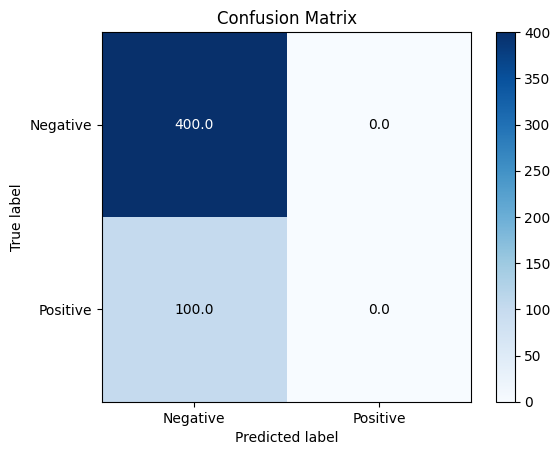

F1 Score: 0.0
Accuracy: 0.8
Sensitivity: 0.0
Specificity: 1.0
eval for blocks.0.hook_attn_out


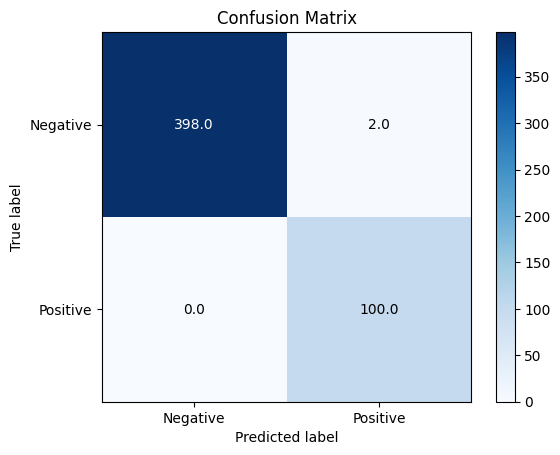

F1 Score: 0.99009900990099
Accuracy: 0.996
Sensitivity: 1.0
Specificity: 0.9950000047683716
eval for blocks.0.hook_mlp_out


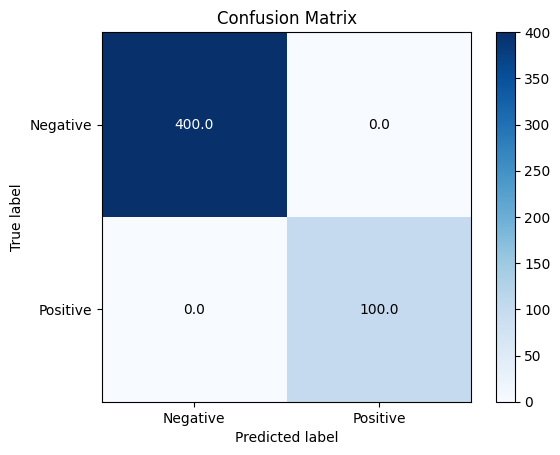

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
eval for blocks.1.hook_resid_pre


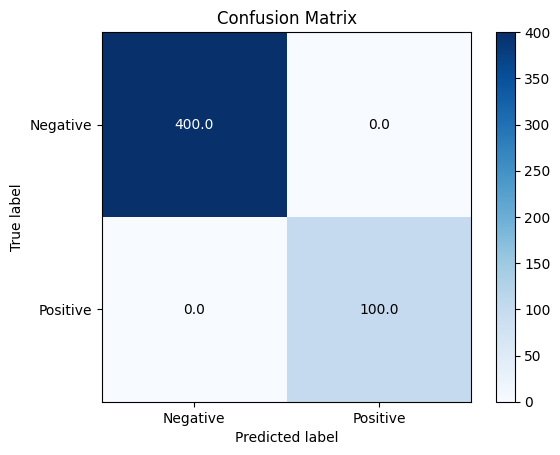

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
eval for blocks.1.hook_attn_out


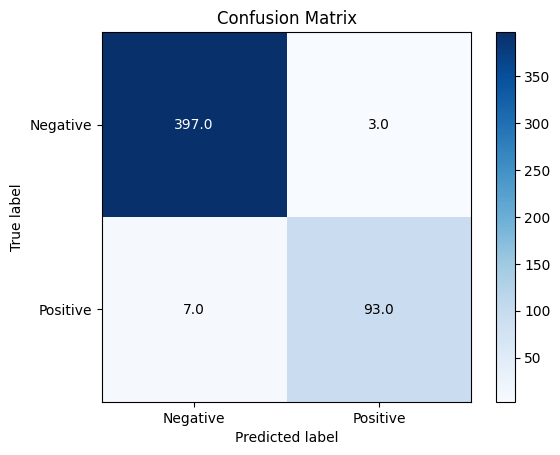

F1 Score: 0.9489795918367346
Accuracy: 0.98
Sensitivity: 0.9300000071525574
Specificity: 0.9925000071525574
eval for blocks.1.hook_mlp_out


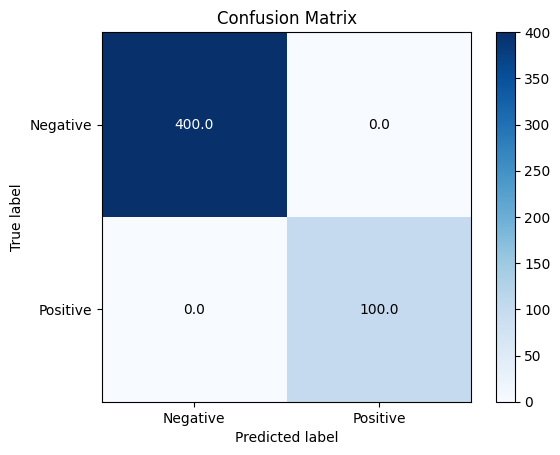

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
eval for blocks.2.hook_resid_pre


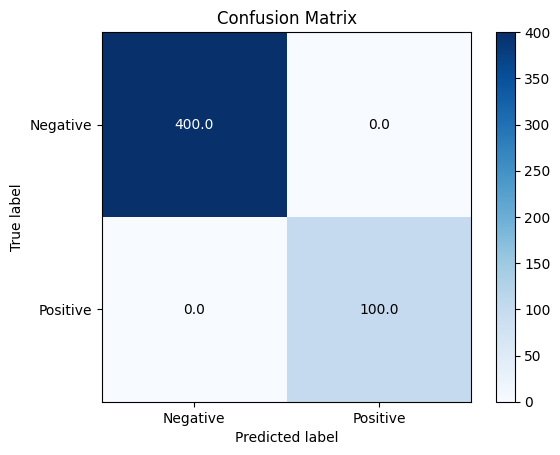

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
eval for blocks.2.hook_attn_out


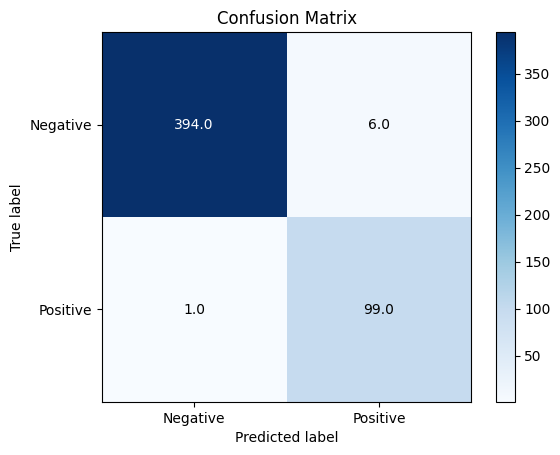

F1 Score: 0.9658536585365853
Accuracy: 0.986
Sensitivity: 0.9900000095367432
Specificity: 0.9850000143051147
eval for blocks.2.hook_mlp_out


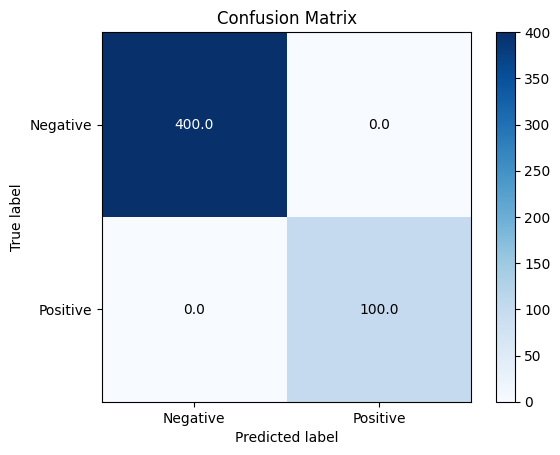

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
cuda:0 cuda:0
122 blocks.0.hook_resid_pre 0.14684641361236572
cuda:0 cuda:0
122 blocks.0.hook_attn_out 0.03236793354153633
cuda:0 cuda:0
122 blocks.0.hook_mlp_out 0.006305679678916931
cuda:0 cuda:0
122 blocks.1.hook_resid_pre 0.005252490285784006
cuda:0 cuda:0
122 blocks.1.hook_attn_out 0.0679812878370285
cuda:0 cuda:0
122 blocks.1.hook_mlp_out 0.0140843465924263
cuda:0 cuda:0
122 blocks.2.hook_resid_pre 0.004157353192567825
cuda:0 cuda:0
122 blocks.2.hook_attn_out 0.03804703801870346
cuda:0 cuda:0
122 blocks.2.hook_mlp_out 0.012310239486396313
cuda:0 cuda:0
123 blocks.0.hook_resid_pre 1.0942866802215576
cuda:0 cuda:0
123 blocks.0.hook_attn_out 0.2521071135997772
cuda:0 cuda:0
123 blocks.0.hook_mlp_out 0.03748432919383049
cuda:0 cuda:0
123 blocks.1.hook_resid_pre 0.029035504907369614
cuda:0 cuda:0
123 blocks.1.hook_attn_out 0.4190407693386078
cuda:0 cuda:0
123 blocks.1.hook_mlp_out 0.05538421869277954
cuda:0 cuda:0
123 block

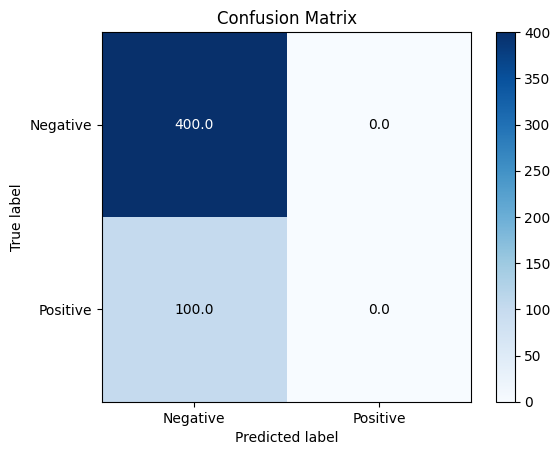

F1 Score: 0.0
Accuracy: 0.8
Sensitivity: 0.0
Specificity: 1.0
eval for blocks.0.hook_attn_out


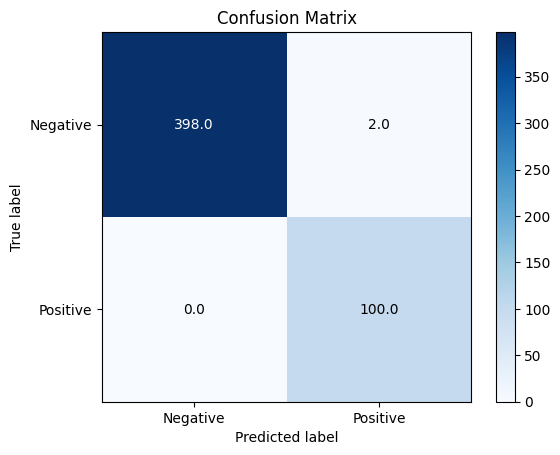

F1 Score: 0.99009900990099
Accuracy: 0.996
Sensitivity: 1.0
Specificity: 0.9950000047683716
eval for blocks.0.hook_mlp_out


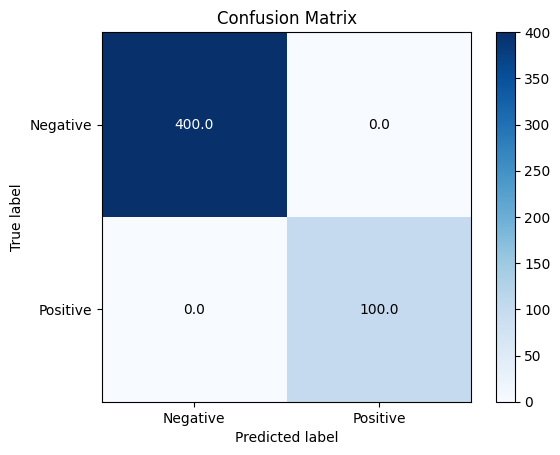

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
eval for blocks.1.hook_resid_pre


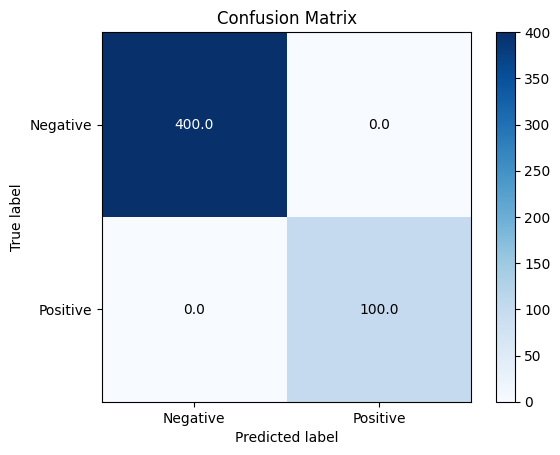

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
eval for blocks.1.hook_attn_out


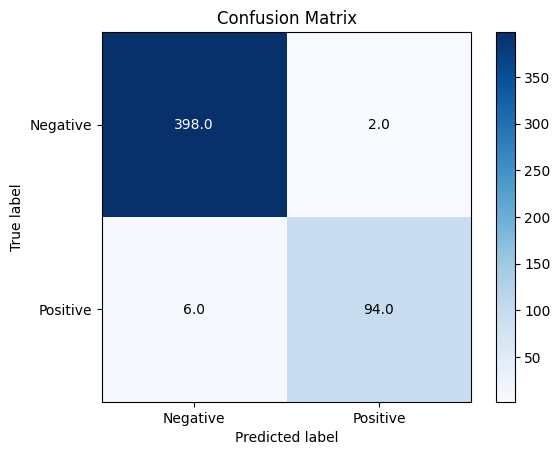

F1 Score: 0.9591836734693877
Accuracy: 0.984
Sensitivity: 0.9399999976158142
Specificity: 0.9950000047683716
eval for blocks.1.hook_mlp_out


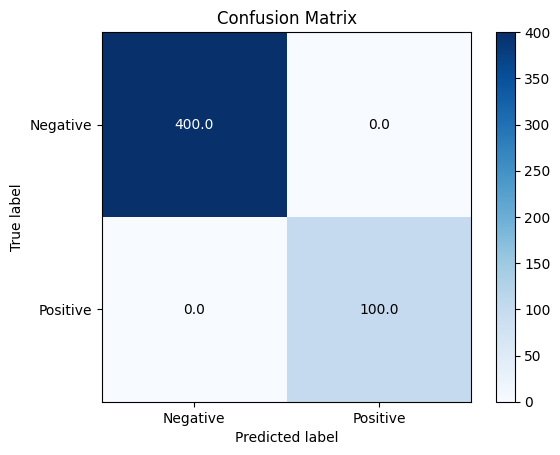

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
eval for blocks.2.hook_resid_pre


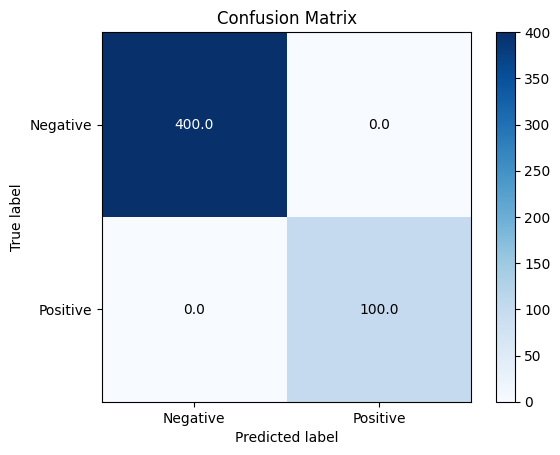

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
eval for blocks.2.hook_attn_out


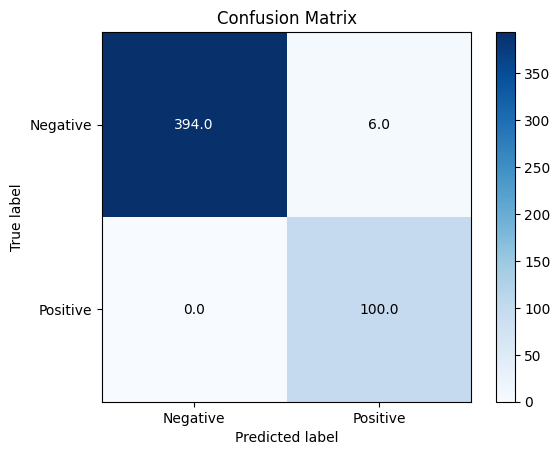

F1 Score: 0.970873786407767
Accuracy: 0.988
Sensitivity: 1.0
Specificity: 0.9850000143051147
eval for blocks.2.hook_mlp_out


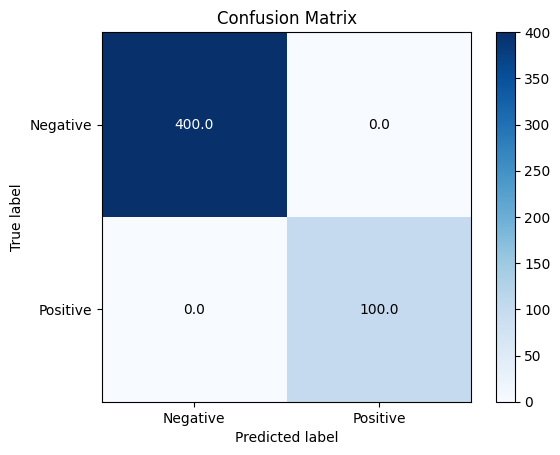

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
cuda:0 cuda:0
142 blocks.0.hook_resid_pre 0.1337355524301529
cuda:0 cuda:0
142 blocks.0.hook_attn_out 0.13259974122047424
cuda:0 cuda:0
142 blocks.0.hook_mlp_out 0.005406401585787535
cuda:0 cuda:0
142 blocks.1.hook_resid_pre 0.00551998196169734
cuda:0 cuda:0
142 blocks.1.hook_attn_out 0.18370763957500458
cuda:0 cuda:0
142 blocks.1.hook_mlp_out 0.02969035878777504
cuda:0 cuda:0
142 blocks.2.hook_resid_pre 0.004680629353970289
cuda:0 cuda:0
142 blocks.2.hook_attn_out 0.11928066611289978
cuda:0 cuda:0
142 blocks.2.hook_mlp_out 0.018888486549258232
cuda:0 cuda:0
143 blocks.0.hook_resid_pre 0.1315743774175644
cuda:0 cuda:0
143 blocks.0.hook_attn_out 0.040765419602394104
cuda:0 cuda:0
143 blocks.0.hook_mlp_out 0.005356720648705959
cuda:0 cuda:0
143 blocks.1.hook_resid_pre 0.00437540840357542
cuda:0 cuda:0
143 blocks.1.hook_attn_out 0.07013329118490219
cuda:0 cuda:0
143 blocks.1.hook_mlp_out 0.01844620890915394
cuda:0 cuda:0
143 bl

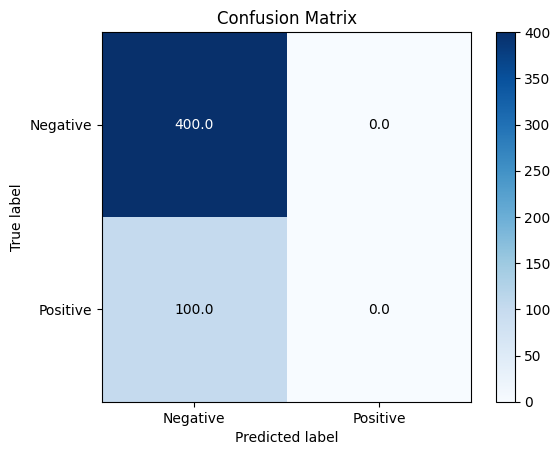

F1 Score: 0.0
Accuracy: 0.8
Sensitivity: 0.0
Specificity: 1.0
eval for blocks.0.hook_attn_out


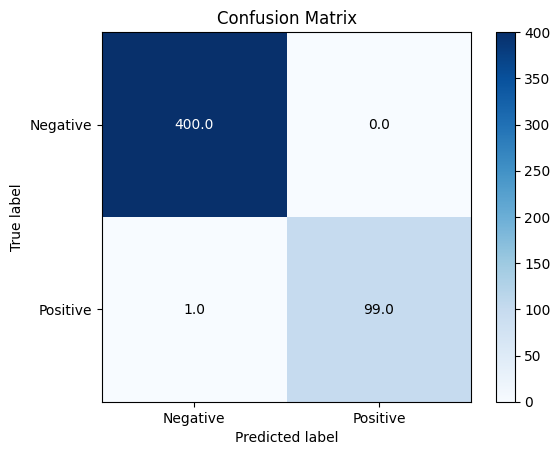

F1 Score: 0.9949748743718593
Accuracy: 0.998
Sensitivity: 0.9900000095367432
Specificity: 1.0
eval for blocks.0.hook_mlp_out


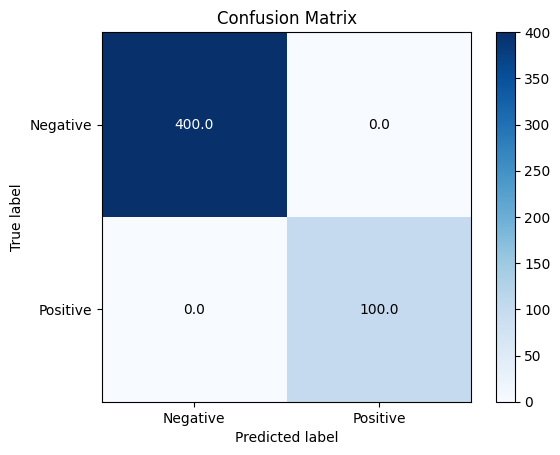

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
eval for blocks.1.hook_resid_pre


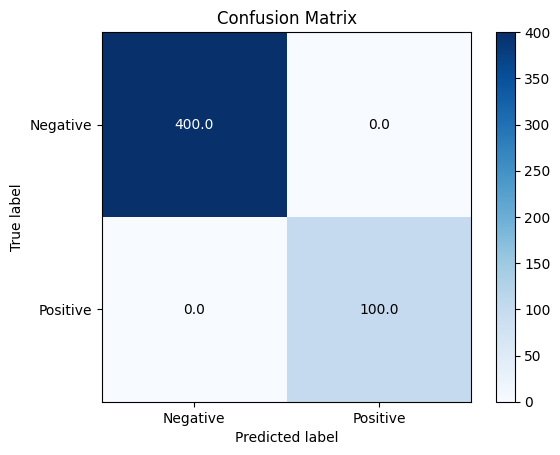

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
eval for blocks.1.hook_attn_out


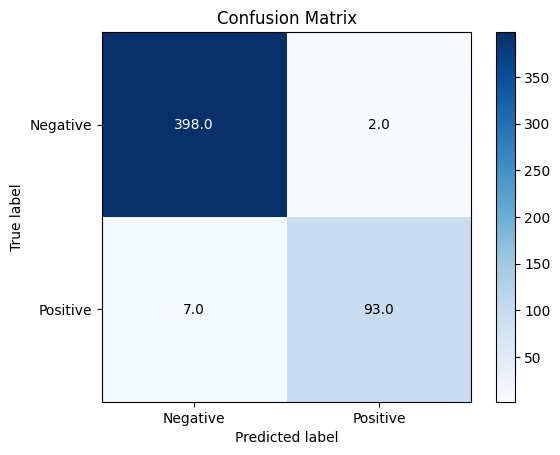

F1 Score: 0.9538461538461539
Accuracy: 0.982
Sensitivity: 0.9300000071525574
Specificity: 0.9950000047683716
eval for blocks.1.hook_mlp_out


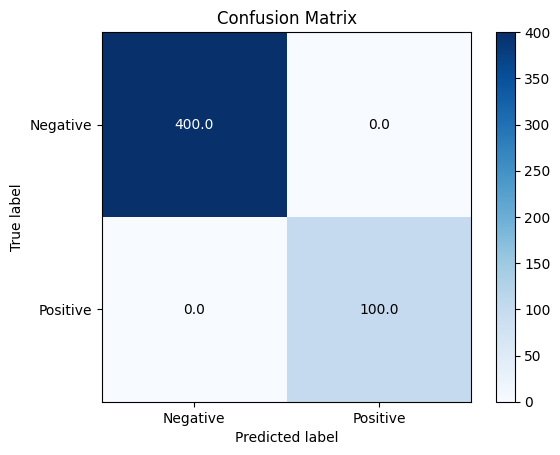

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
eval for blocks.2.hook_resid_pre


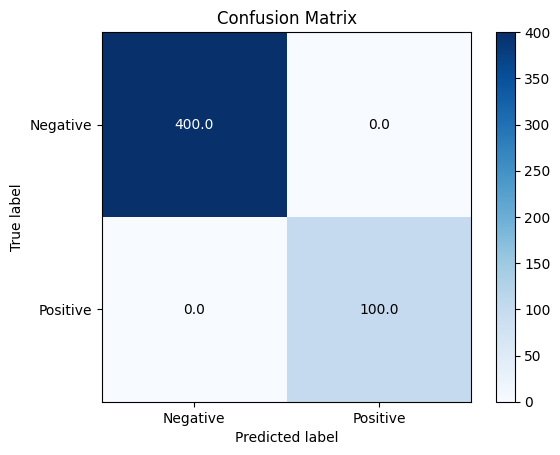

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
eval for blocks.2.hook_attn_out


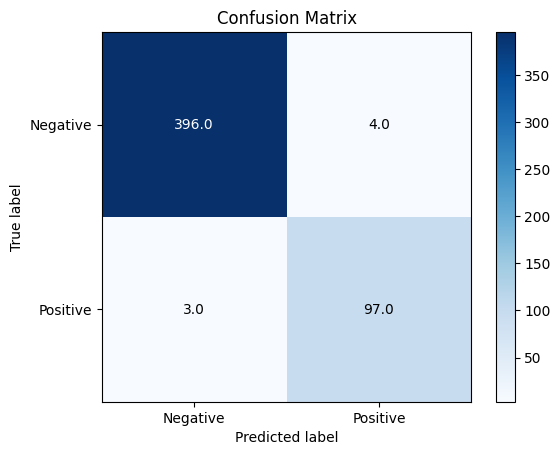

F1 Score: 0.9651741293532338
Accuracy: 0.986
Sensitivity: 0.9700000286102295
Specificity: 0.9900000095367432
eval for blocks.2.hook_mlp_out


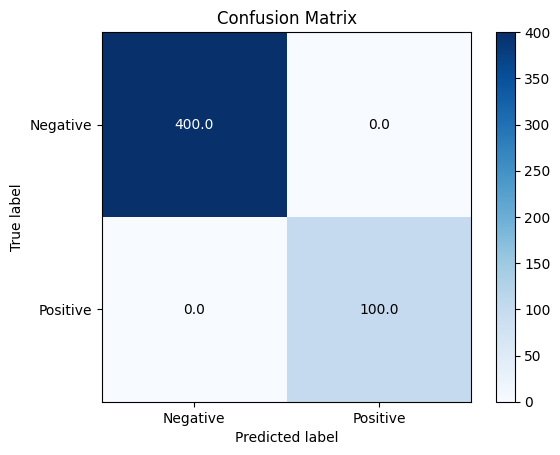

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
cuda:0 cuda:0
162 blocks.0.hook_resid_pre 0.11642609536647797
cuda:0 cuda:0
162 blocks.0.hook_attn_out 0.016874073073267937
cuda:0 cuda:0
162 blocks.0.hook_mlp_out 0.004676002077758312
cuda:0 cuda:0
162 blocks.1.hook_resid_pre 0.0038421161007136106
cuda:0 cuda:0
162 blocks.1.hook_attn_out 0.059241510927677155
cuda:0 cuda:0
162 blocks.1.hook_mlp_out 0.010587592609226704
cuda:0 cuda:0
162 blocks.2.hook_resid_pre 0.0028903395868837833
cuda:0 cuda:0
162 blocks.2.hook_attn_out 0.017940977588295937
cuda:0 cuda:0
162 blocks.2.hook_mlp_out 0.009239298291504383
cuda:0 cuda:0
163 blocks.0.hook_resid_pre 0.11475881934165955
cuda:0 cuda:0
163 blocks.0.hook_attn_out 0.03278321772813797
cuda:0 cuda:0
163 blocks.0.hook_mlp_out 0.00463874451816082
cuda:0 cuda:0
163 blocks.1.hook_resid_pre 0.004232734441757202
cuda:0 cuda:0
163 blocks.1.hook_attn_out 0.07072702050209045
cuda:0 cuda:0
163 blocks.1.hook_mlp_out 0.012612694874405861
cuda:0 cuda

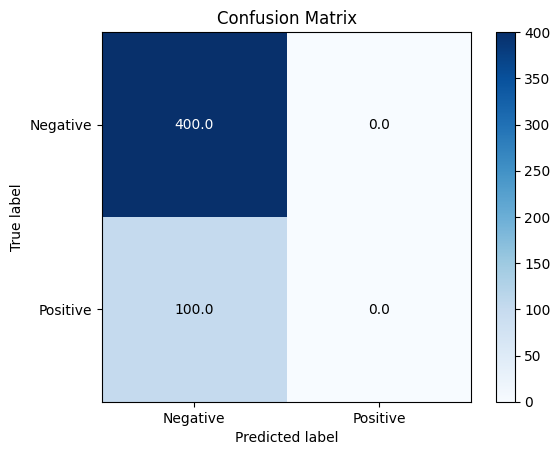

F1 Score: 0.0
Accuracy: 0.8
Sensitivity: 0.0
Specificity: 1.0
eval for blocks.0.hook_attn_out


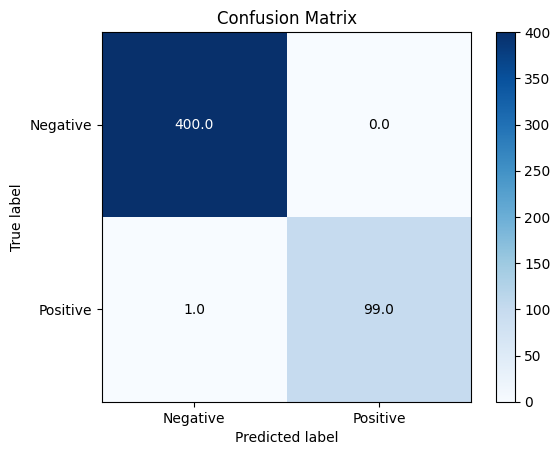

F1 Score: 0.9949748743718593
Accuracy: 0.998
Sensitivity: 0.9900000095367432
Specificity: 1.0
eval for blocks.0.hook_mlp_out


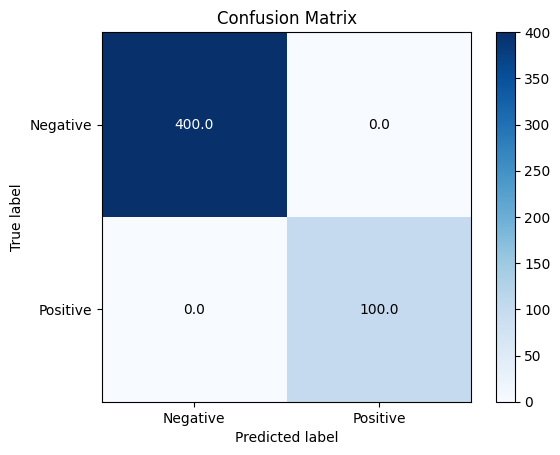

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
eval for blocks.1.hook_resid_pre


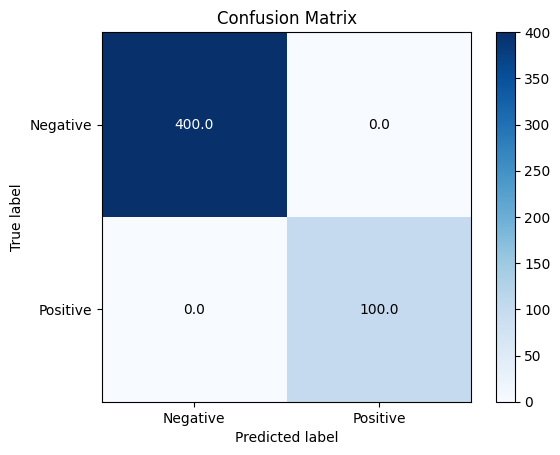

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
eval for blocks.1.hook_attn_out


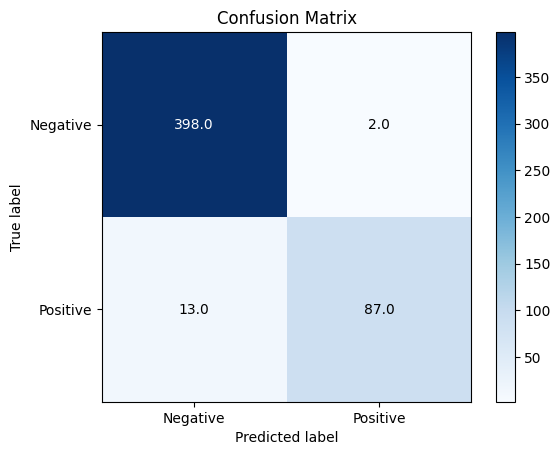

F1 Score: 0.9206349206349206
Accuracy: 0.97
Sensitivity: 0.8700000047683716
Specificity: 0.9950000047683716
eval for blocks.1.hook_mlp_out


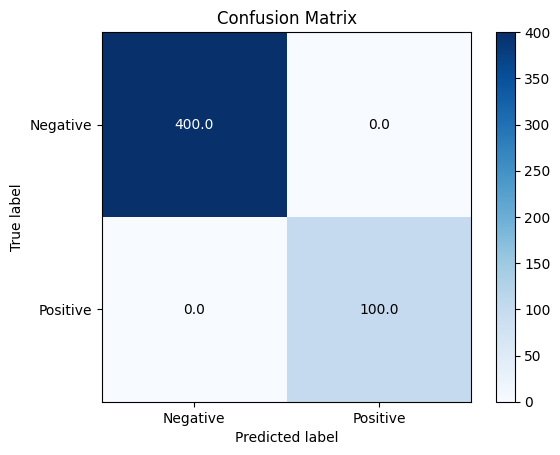

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
eval for blocks.2.hook_resid_pre


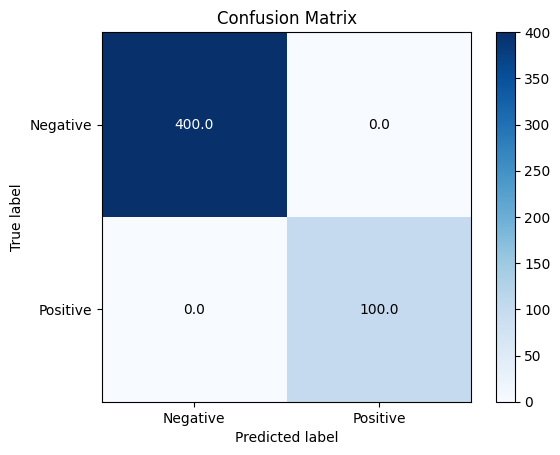

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
eval for blocks.2.hook_attn_out


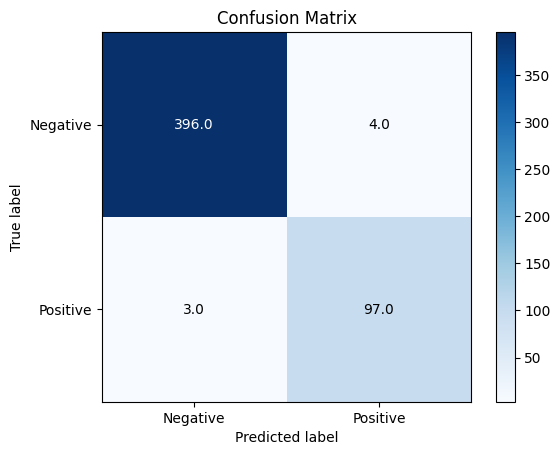

F1 Score: 0.9651741293532338
Accuracy: 0.986
Sensitivity: 0.9700000286102295
Specificity: 0.9900000095367432
eval for blocks.2.hook_mlp_out


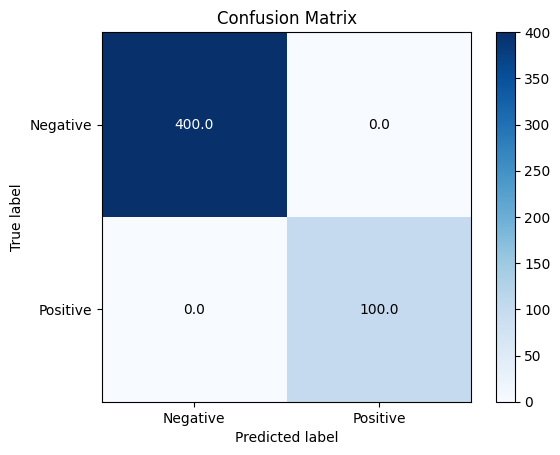

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
cuda:0 cuda:0
182 blocks.0.hook_resid_pre 0.09647993743419647
cuda:0 cuda:0
182 blocks.0.hook_attn_out 0.015246279537677765
cuda:0 cuda:0
182 blocks.0.hook_mlp_out 0.004074605647474527
cuda:0 cuda:0
182 blocks.1.hook_resid_pre 0.00312958681024611
cuda:0 cuda:0
182 blocks.1.hook_attn_out 0.044884584844112396
cuda:0 cuda:0
182 blocks.1.hook_mlp_out 0.009100387804210186
cuda:0 cuda:0
182 blocks.2.hook_resid_pre 0.002587781986221671
cuda:0 cuda:0
182 blocks.2.hook_attn_out 0.024504395201802254
cuda:0 cuda:0
182 blocks.2.hook_mlp_out 0.007771139964461327
cuda:0 cuda:0
183 blocks.0.hook_resid_pre 1.1706490516662598
cuda:0 cuda:0
183 blocks.0.hook_attn_out 0.14255601167678833
cuda:0 cuda:0
183 blocks.0.hook_mlp_out 0.029539214447140694
cuda:0 cuda:0
183 blocks.1.hook_resid_pre 0.02143479324877262
cuda:0 cuda:0
183 blocks.1.hook_attn_out 0.32160618901252747
cuda:0 cuda:0
183 blocks.1.hook_mlp_out 0.04521962255239487
cuda:0 cuda:0
18

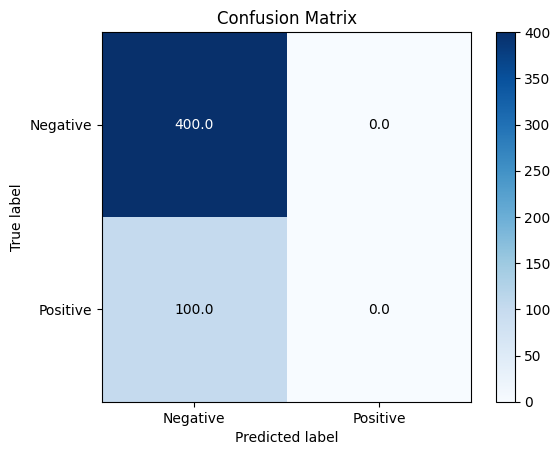

F1 Score: 0.0
Accuracy: 0.8
Sensitivity: 0.0
Specificity: 1.0
eval for blocks.0.hook_attn_out


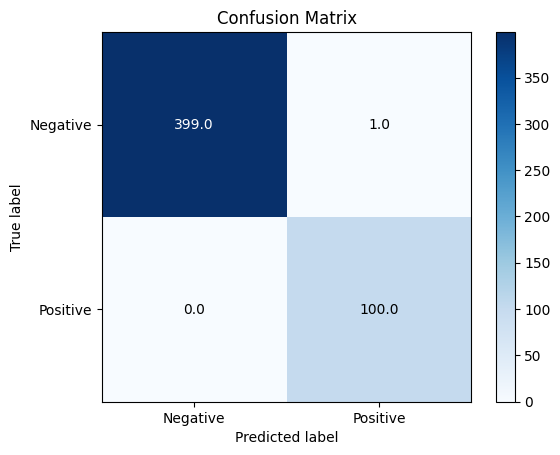

F1 Score: 0.9950248756218906
Accuracy: 0.998
Sensitivity: 1.0
Specificity: 0.9975000023841858
eval for blocks.0.hook_mlp_out


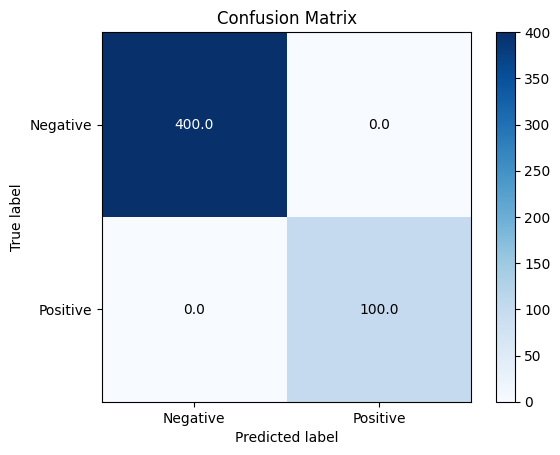

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
eval for blocks.1.hook_resid_pre


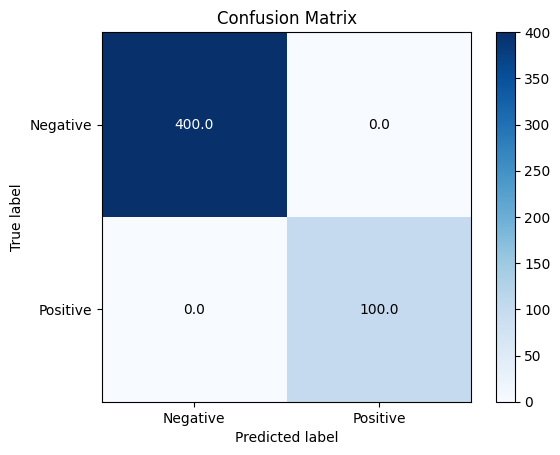

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
eval for blocks.1.hook_attn_out


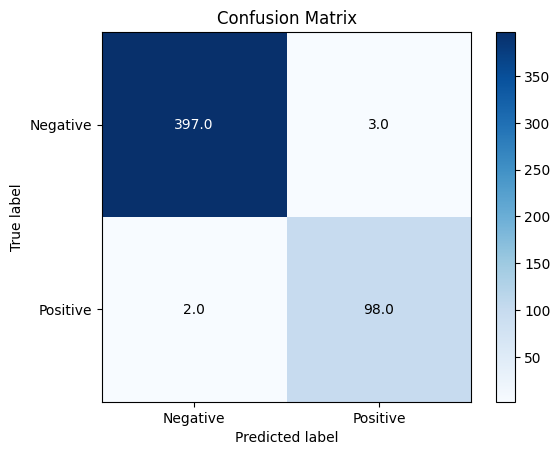

F1 Score: 0.9751243781094527
Accuracy: 0.99
Sensitivity: 0.9800000190734863
Specificity: 0.9925000071525574
eval for blocks.1.hook_mlp_out


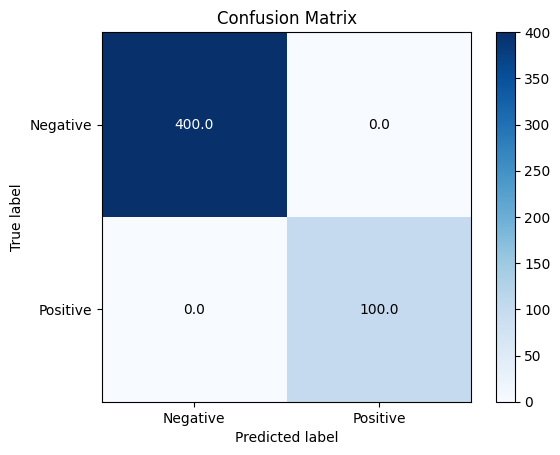

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
eval for blocks.2.hook_resid_pre


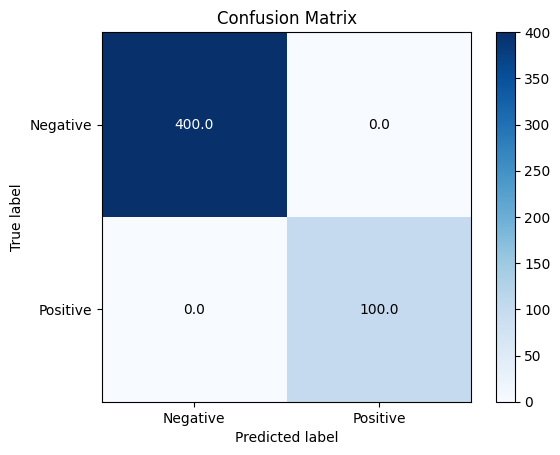

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
eval for blocks.2.hook_attn_out


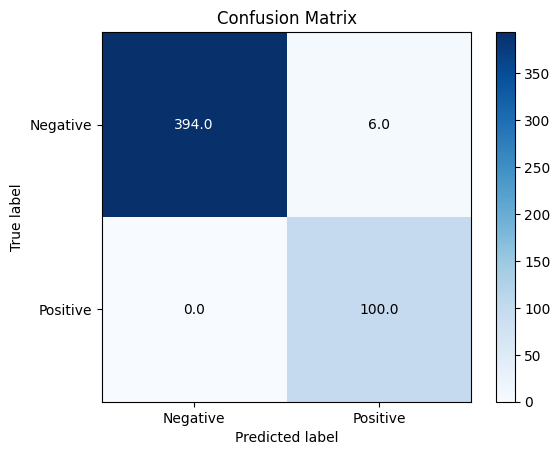

F1 Score: 0.970873786407767
Accuracy: 0.988
Sensitivity: 1.0
Specificity: 0.9850000143051147
eval for blocks.2.hook_mlp_out


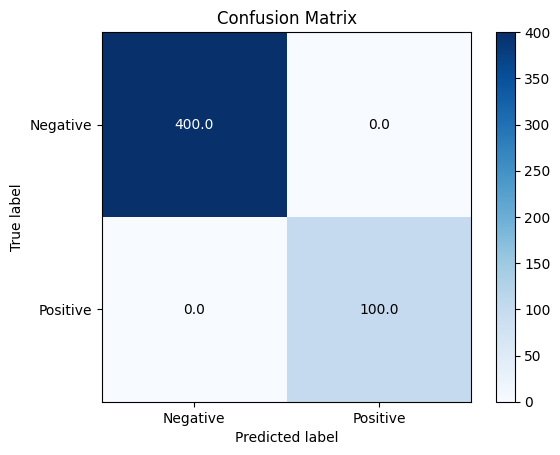

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
cuda:0 cuda:0
202 blocks.0.hook_resid_pre 0.10983529686927795
cuda:0 cuda:0
202 blocks.0.hook_attn_out 0.09610956162214279
cuda:0 cuda:0
202 blocks.0.hook_mlp_out 0.003760529914870858
cuda:0 cuda:0
202 blocks.1.hook_resid_pre 0.0033130538649857044
cuda:0 cuda:0
202 blocks.1.hook_attn_out 0.10145020484924316
cuda:0 cuda:0
202 blocks.1.hook_mlp_out 0.02298358827829361
cuda:0 cuda:0
202 blocks.2.hook_resid_pre 0.0022500455379486084
cuda:0 cuda:0
202 blocks.2.hook_attn_out 0.011136281304061413
cuda:0 cuda:0
202 blocks.2.hook_mlp_out 0.009105821140110493
cuda:0 cuda:0
203 blocks.0.hook_resid_pre 0.10834130644798279
cuda:0 cuda:0
203 blocks.0.hook_attn_out 0.01802375726401806
cuda:0 cuda:0
203 blocks.0.hook_mlp_out 0.003736421000212431
cuda:0 cuda:0
203 blocks.1.hook_resid_pre 0.003163692308589816
cuda:0 cuda:0
203 blocks.1.hook_attn_out 0.07754658162593842
cuda:0 cuda:0
203 blocks.1.hook_mlp_out 0.009020292200148106
cuda:0 cuda:0

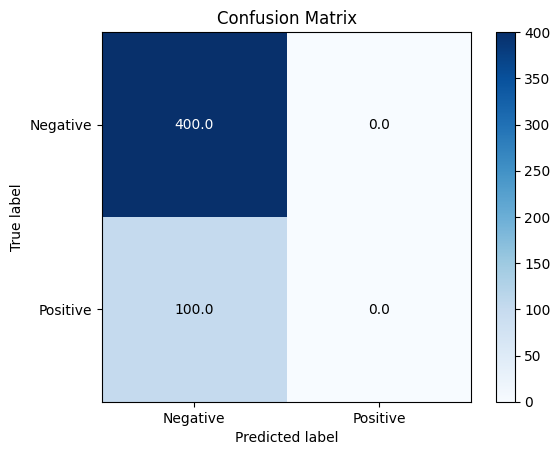

F1 Score: 0.0
Accuracy: 0.8
Sensitivity: 0.0
Specificity: 1.0
eval for blocks.0.hook_attn_out


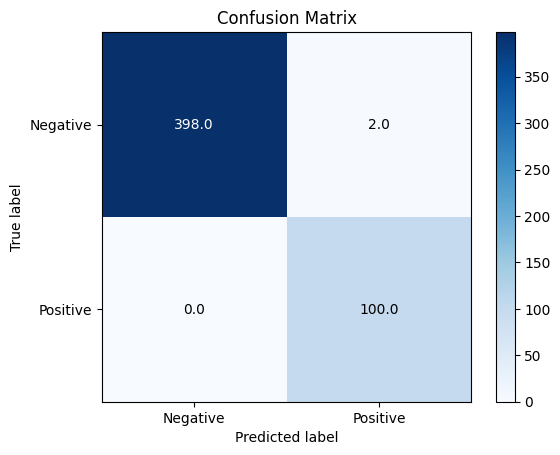

F1 Score: 0.99009900990099
Accuracy: 0.996
Sensitivity: 1.0
Specificity: 0.9950000047683716
eval for blocks.0.hook_mlp_out


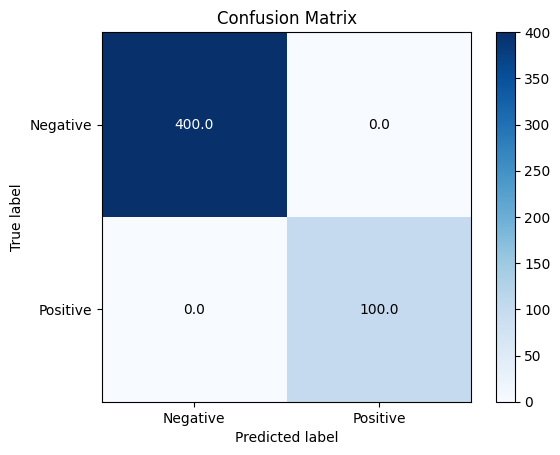

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
eval for blocks.1.hook_resid_pre


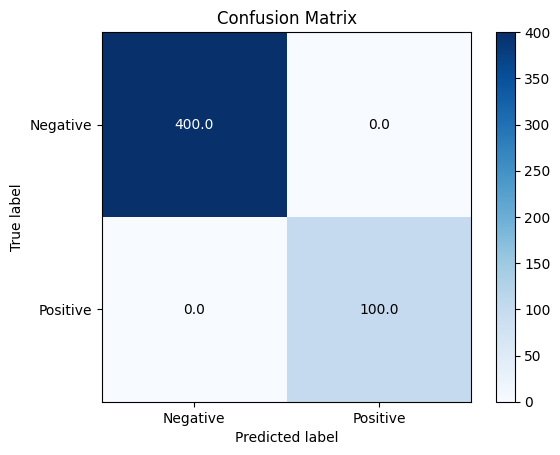

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
eval for blocks.1.hook_attn_out


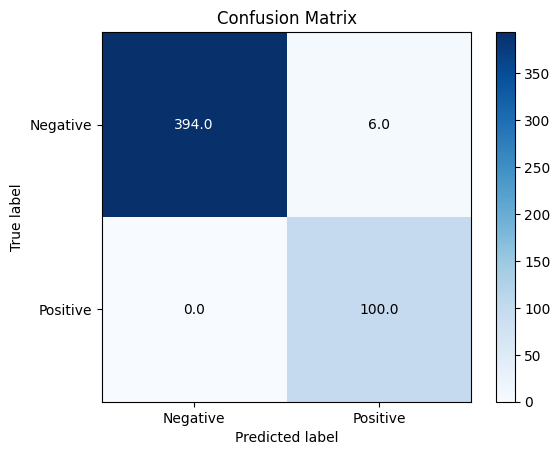

F1 Score: 0.970873786407767
Accuracy: 0.988
Sensitivity: 1.0
Specificity: 0.9850000143051147
eval for blocks.1.hook_mlp_out


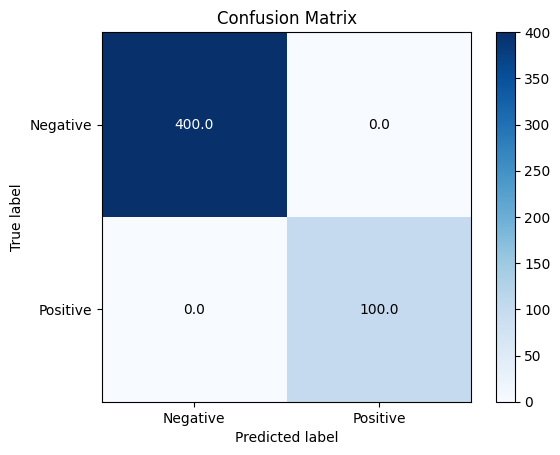

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
eval for blocks.2.hook_resid_pre


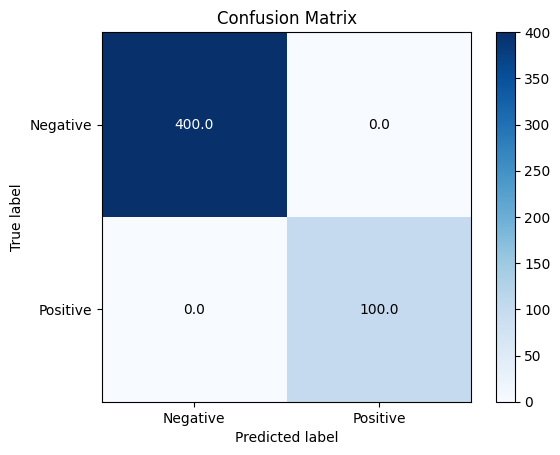

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
eval for blocks.2.hook_attn_out


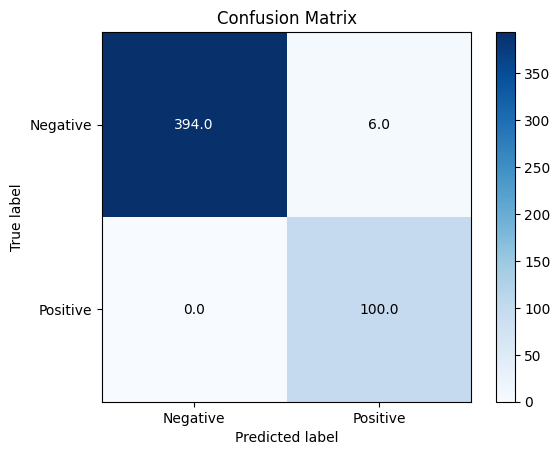

F1 Score: 0.970873786407767
Accuracy: 0.988
Sensitivity: 1.0
Specificity: 0.9850000143051147
eval for blocks.2.hook_mlp_out


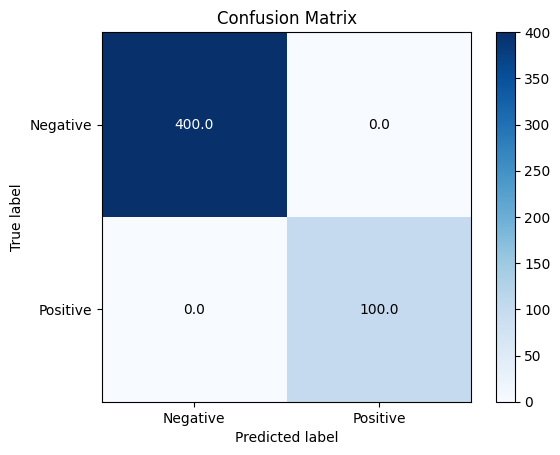

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
cuda:0 cuda:0
222 blocks.0.hook_resid_pre 0.8542066812515259
cuda:0 cuda:0
222 blocks.0.hook_attn_out 0.22073176503181458
cuda:0 cuda:0
222 blocks.0.hook_mlp_out 0.021157870069146156
cuda:0 cuda:0
222 blocks.1.hook_resid_pre 0.019404346123337746
cuda:0 cuda:0
222 blocks.1.hook_attn_out 0.42696622014045715
cuda:0 cuda:0
222 blocks.1.hook_mlp_out 0.025676017627120018
cuda:0 cuda:0
222 blocks.2.hook_resid_pre 0.013821487314999104
cuda:0 cuda:0
222 blocks.2.hook_attn_out 0.0771961584687233
cuda:0 cuda:0
222 blocks.2.hook_mlp_out 0.018376456573605537
cuda:0 cuda:0
223 blocks.0.hook_resid_pre 0.12502449750900269
cuda:0 cuda:0
223 blocks.0.hook_attn_out 0.03398885577917099
cuda:0 cuda:0
223 blocks.0.hook_mlp_out 0.0034967251121997833
cuda:0 cuda:0
223 blocks.1.hook_resid_pre 0.003360222326591611
cuda:0 cuda:0
223 blocks.1.hook_attn_out 0.048355307430028915
cuda:0 cuda:0
223 blocks.1.hook_mlp_out 0.009597470052540302
cuda:0 cuda:0
2

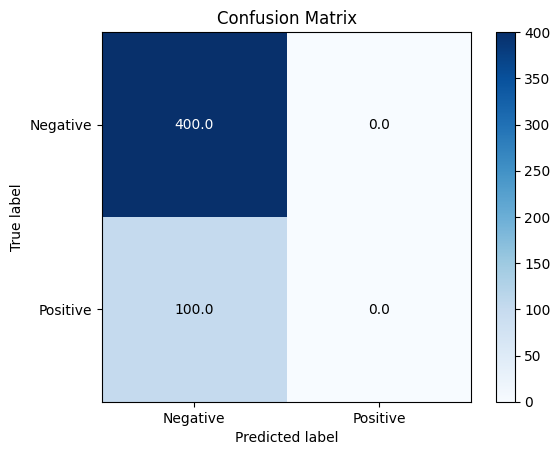

F1 Score: 0.0
Accuracy: 0.8
Sensitivity: 0.0
Specificity: 1.0
eval for blocks.0.hook_attn_out


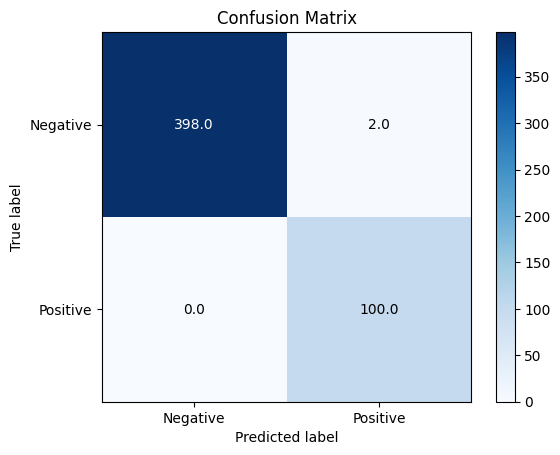

F1 Score: 0.99009900990099
Accuracy: 0.996
Sensitivity: 1.0
Specificity: 0.9950000047683716
eval for blocks.0.hook_mlp_out


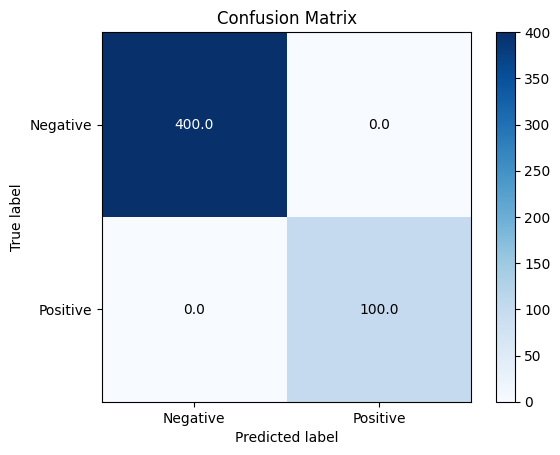

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
eval for blocks.1.hook_resid_pre


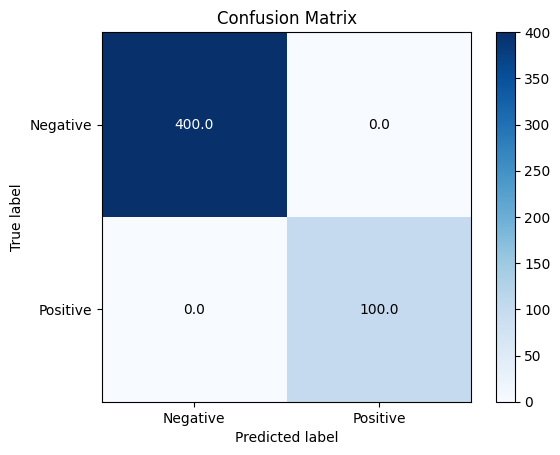

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
eval for blocks.1.hook_attn_out


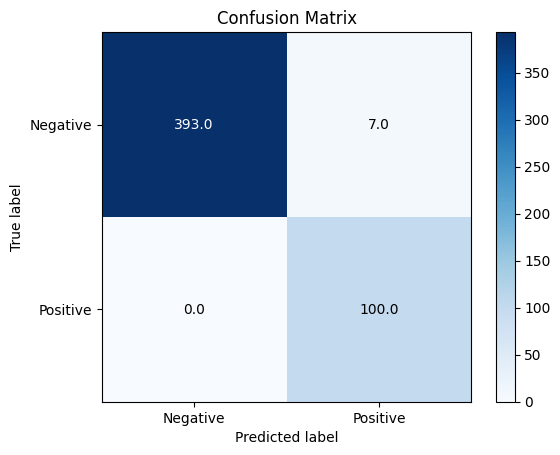

F1 Score: 0.966183574879227
Accuracy: 0.986
Sensitivity: 1.0
Specificity: 0.9825000166893005
eval for blocks.1.hook_mlp_out


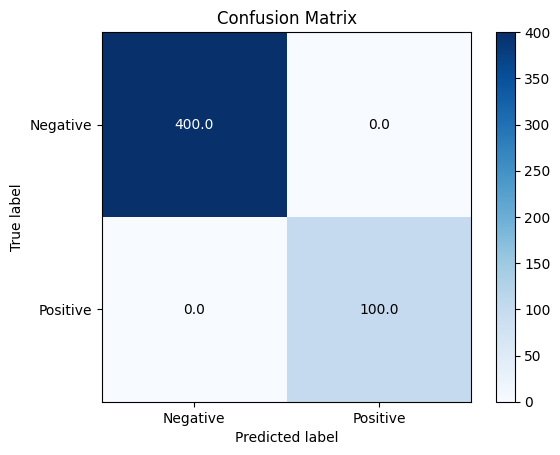

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
eval for blocks.2.hook_resid_pre


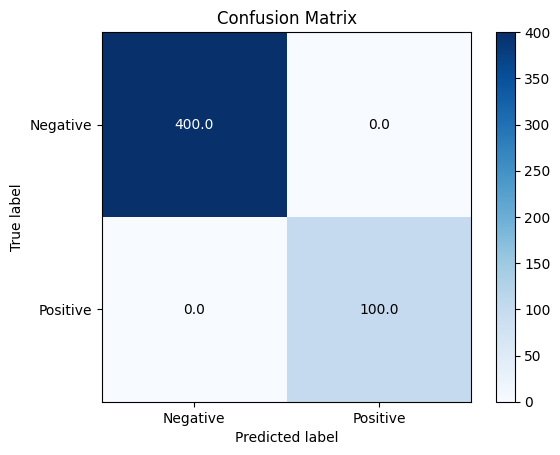

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
eval for blocks.2.hook_attn_out


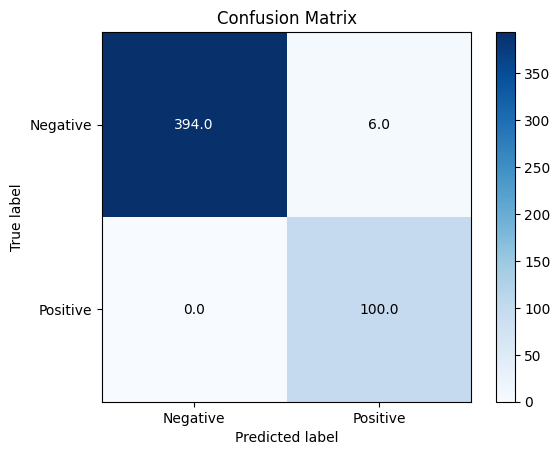

F1 Score: 0.970873786407767
Accuracy: 0.988
Sensitivity: 1.0
Specificity: 0.9850000143051147
eval for blocks.2.hook_mlp_out


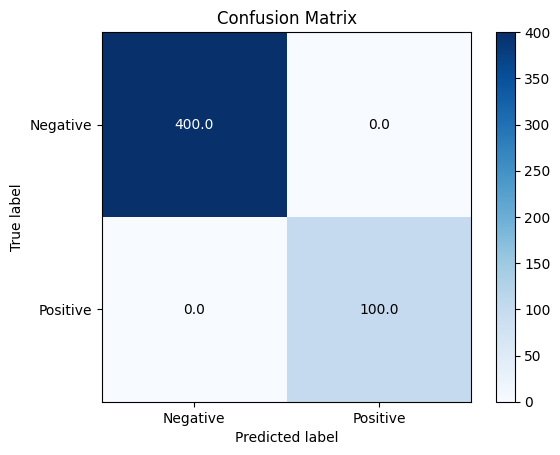

F1 Score: 1.0
Accuracy: 1.0
Sensitivity: 1.0
Specificity: 1.0
cuda:0 cuda:0
242 blocks.0.hook_resid_pre 0.10946684330701828
cuda:0 cuda:0
242 blocks.0.hook_attn_out 0.10165106505155563
cuda:0 cuda:0
242 blocks.0.hook_mlp_out 0.0031918552704155445
cuda:0 cuda:0
242 blocks.1.hook_resid_pre 0.002859909785911441
cuda:0 cuda:0
242 blocks.1.hook_attn_out 0.10106184333562851
cuda:0 cuda:0
242 blocks.1.hook_mlp_out 0.02004847675561905
cuda:0 cuda:0
242 blocks.2.hook_resid_pre 0.0019850090611726046
cuda:0 cuda:0
242 blocks.2.hook_attn_out 0.009100623428821564
cuda:0 cuda:0
242 blocks.2.hook_mlp_out 0.007710338570177555
cuda:0 cuda:0
243 blocks.0.hook_resid_pre 0.10798235982656479
cuda:0 cuda:0
243 blocks.0.hook_attn_out 0.028294241055846214
cuda:0 cuda:0
243 blocks.0.hook_mlp_out 0.003174387151375413
cuda:0 cuda:0
243 blocks.1.hook_resid_pre 0.0029487009160220623
cuda:0 cuda:0
243 blocks.1.hook_attn_out 0.0713161826133728
cuda:0 cuda:0
243 blocks.1.hook_mlp_out 0.008019628934562206
cuda:0 cuda:

KeyboardInterrupt: ignored

In [ ]:
#my_probe = hook_probes[hook_name]
#my_optimizer = hook_optimizers[hook_name] #optim.SGD(my_probe.parameters(), lr=0.1)
for i, (_, _, seqs, labels) in enumerate(train_loader):
  labels = labels.to(device)
  for _, my_optimizer in hook_optimizers.items():
    my_optimizer.zero_grad()

  with torch.no_grad():
      _, cache = model.run_with_cache(seqs)

  for hook_name, hook_probe in hook_probes.items():
    acts = cache[hook_name][:,-1,:]
    y_pred = hook_probe(acts).reshape(-1)
    print(y_pred.device, labels.device)
    loss = criterion(y_pred, labels)
    loss.backward()
    print(i, hook_name, loss.item())

  for _, my_optimizer in hook_optimizers.items():
    my_optimizer.step()

  if i % 20 == 1:
    for hook_name, hook_probe in hook_probes.items():
      print('eval for', hook_name)
      evaluate_probe(hook_probe, hook_name, 'pt')

In [ ]:
# Parameters for accumulating gradients
n_accumulate = 100  # Number of samples to accumulate before performing a step
running_loss = 0.0 # {hook_name: 0.0 for hook_name in hook_names}
hook_probe = hook_probes[S]
hook_optimizer = hook_optimizers[S]

for i, (_, _, seqs, labels) in enumerate(train_loader):  # 1000 samples with 10 features
    with torch.no_grad():
      _, cache = model.run_with_cache(seqs)

    acts = cache[S][:,-1,:]

    '''
    hook_probe_losses = {
        hook_name: criterion(
            hook_probes[hook_name].forward(
                cache[hook_name][:,-1,:]
            ).reshape(-1),
            labels)
        for hook_name in hook_names
    }
    #print(hook_probe_losses)
    '''
    # Forward pass

    hook_probe_out = hook_probe(acts)
    hook_probe_loss = criterion(hook_probe_out.reshape(-1), labels)
    hook_probe_loss.backward()

    # Compute the gradient
    #for hook_name, hook_probe_loss in hook_probe_losses.items():
    #  hook_probe_loss.backward()
    #  running_losses[hook_name] += hook_probe_loss.item()

    running_loss += hook_probe_loss.item()

    # Only update the model parameters after accumulating enough samples
    if (i + 1) % n_accumulate == 0:
        batch_i = (i + 1)//n_accumulate
        print(f'Hook_name: {hook_name}, Batch: {batch_i}, Running Loss: {running_loss / n_accumulate}')
        running_loss = 0.
        #for hook_name, hook_optimizer in hook_optimizers.items():
        #  hook_optimizer.step()
        #  hook_optimizer.zero_grad()  # Zero out the gradients after updating
        #for hook_name in hook_names:
        #  print(f'Hook_name: {hook_name}, Batch: {batch_i}, Running Loss: {running_losses[hook_name] / n_accumulate}')
        #  running_losses[hook_name] = 0.
        if batch_i % 5 == 1:
          #for hook_name in hook_names:
          evaluate_probe(hook_probes[hook_name], hook_name, 'pt')
          #validate(hook_probe, val_loader, val_dset)

KeyboardInterrupt: ignored

{'blocks.3.hook_resid_pre': {}, 'blocks.2.hook_mlp_out': {}}

In [ ]:
len(val_loader)

500

In [ ]:
train_fixed_dset = get_fixed_vector_dset(train_dset)

4000it [07:18,  9.11it/s]


In [ ]:
train_fixed_dset.shape

torch.Size([4000, 1, 512])

In [ ]:
hook_fixed_val_dsets['train']

In [ ]:
fixed_probe_full = LogisticRegression(random_state=0, max_iter=10000).fit(train_fixed_dset.squeeze(), train_labels)

In [ ]:
y_pred_sklearn = fixed_probe_full.predict() #train_fixed_dset.squeeze(), train_labels)

0.49625

In [ ]:
pipe = make_pipeline(StandardScaler(), LogisticRegression())

In [ ]:
pipe.fit(train_fixed_dset.squeeze(), train_labels)

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Pipeline(steps=[('standardscaler', StandardScaler()),
                ('logisticregression', LogisticRegression())])

In [ ]:
val_fixed_dset = get_fixed_vector_dset(val_dset)

500it [00:55,  9.04it/s]


In [ ]:
val_fixed_dset_2 = get_fixed_vector_dset(val_dset)

500it [00:59,  8.42it/s]


In [ ]:
val_fixed_dset_2

tensor([[[-0.0515, -0.0220, -0.0149,  ...,  0.0150,  0.0195, -0.0379]],

        [[-0.0370, -0.0566, -0.1380,  ...,  0.0597,  0.1036,  0.1691]],

        [[-0.0503,  0.0278,  0.0840,  ..., -0.0898, -0.0934,  0.0437]],

        ...,

        [[-0.0262,  0.0286, -0.2407,  ..., -0.0709,  0.0862,  0.0440]],

        [[ 0.0682,  0.0572, -0.3174,  ..., -0.0194,  0.0300,  0.0868]],

        [[-0.1106,  0.0298, -0.1269,  ..., -0.0978,  0.0488, -0.0067]]])

In [ ]:
val_y_out = hook_probe(val_fixed_dset).reshape(-1)
val_y_true = torch.tensor(val_labels == 1.).float()
val_y_out_binary = (val_y_out > 0).float()

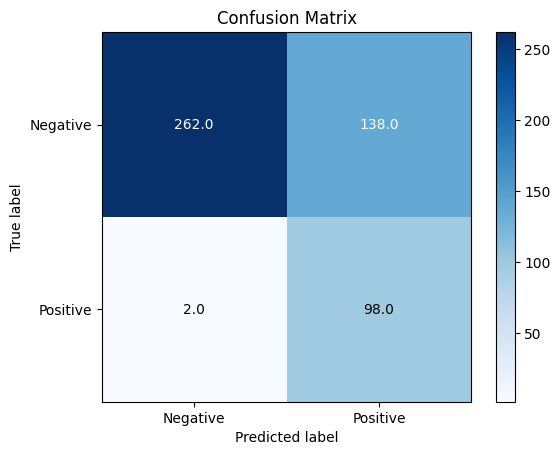

F1 Score: 0.5833333333333334
Accuracy: 0.72
Sensitivity: 0.9800000190734863
Specificity: 0.6549999713897705


In [ ]:
get_metrics(val_y_true, val_y_out_binary)

In [ ]:
y_pred_binary = (val_y_out > 0).float()
y_data = val_y_true
print(y_pred_binary.shape, y_data.shape)
# Get indices for True Negatives, False Positives, True Positives, False Negatives
TN = ((y_pred_binary == 0) & (y_data == 0)).sum().float()
FP = ((y_pred_binary == 1) & (y_data == 0)).sum().float()
TP = ((y_pred_binary == 1) & (y_data == 1)).sum().float()
FN = ((y_pred_binary == 0) & (y_data == 1)).sum().float()

torch.Size([500]) torch.Size([500])


In [ ]:
TN, FP, TP, FN

(tensor(262.), tensor(138.), tensor(98.), tensor(2.))

In [ ]:
TN_indices = (y_pred_binary == 0) & (y_data == 0)
FP_indices = (y_pred_binary == 1) & (y_data == 0)
TP_indices = (y_pred_binary == 1) & (y_data == 1)
FN_indices = (y_pred_binary == 0) & (y_data == 1)

In [ ]:
val_labels[TN_indices]

array([2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2.,
       2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2.,
       2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2.,
       2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2.,
       2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2.,
       2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2.,
       2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2.,
       2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 3., 3., 3., 3., 3., 3.,
       3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3.,
       3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3.,
       3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3.,
       3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3.,
       3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3.,
       3., 3., 3., 3., 3.

In [ ]:
val_labels[FN_indices]

array([1., 1.])

In [ ]:
val_labels[FP_indices]

array([2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2.,
       2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2.,
       2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2.,
       2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2.,
       2., 2., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3.,
       3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3.,
       3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3.,
       3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3.,
       3., 3.])

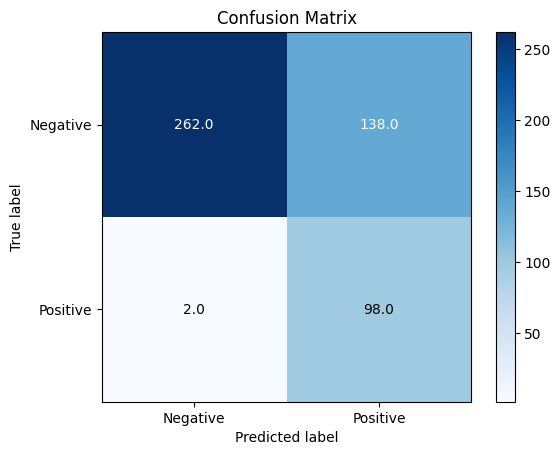

F1 Score: 0.5833333333333334
Accuracy: 0.72
Sensitivity: 0.9800000190734863
Specificity: 0.6549999713897705


In [ ]:
validate_metrics(hook_probe)

In [ ]:
TN_indices.shape

torch.Size([264])

In [ ]:
FN_indices.shape

torch.Size([0])

In [ ]:
TP_indices.shape

torch.Size([236])

In [ ]:
from sklearn.metrics import f1_score

In [ ]:
f1_score(val_y_true, val_y_out_binary)

0.5903614457831324

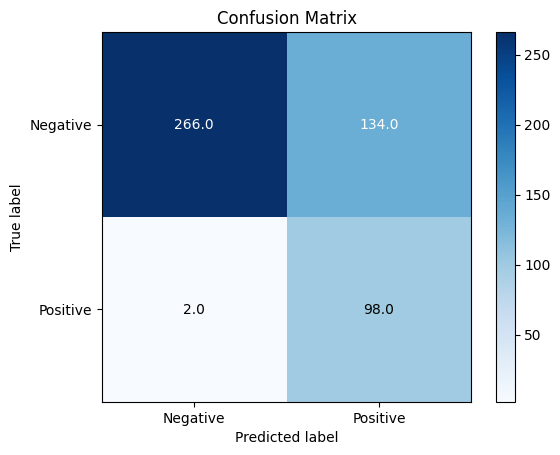

F1 Score: 0.5903614457831324
Accuracy: 0.728
Sensitivity: 0.9800000190734863
Specificity: 0.6650000214576721


# Other

In [ ]:
def run_ablation_on_all_vneg2s(dset_dict,
                               target_token,
                               hook_name,
                               ablation_function_name,
                               ablation_vector):
  global global_abl_vector
  global_abl_vector = ablation_vector
  vdset = dset_dict['val_dset']
  vneg2_ids = torch.argwhere(vdset.labels == 3.).reshape(-1)
  seq_abl_results = []
  for vneg2_id in tqdm(vneg2_ids):
    current_v2neg_seq = vdset[vneg2_id][0]
    seq_abl_result = run_ablation_on_seq(
        seq = current_v2neg_seq,
        target_i = target_token,
        hook_name = hook_name,
        ablation_function_name = ablation_function_name)
    seq_abl_results.append(seq_abl_result)
  return seq_abl_results

def run_ablation_on_seq(seq,target_i,hook_name,ablation_function_name):
  with torch.no_grad():
    logits_val_neg2_seq_clean = model(
      seq,
      prepend_bos=False,
      return_type="logits",
      stop_at_layer=None
    )
  with torch.no_grad():
    logits_val_neg2_seq_additive = model.run_with_hooks(
      seq,
      prepend_bos=False,
      return_type="logits",
      fwd_hooks=[(hook_name, ablation_hook_fcs_dict[ablation_function_name])],
      stop_at_layer=None
    )
  l_clean = logits_val_neg2_seq_clean[0,-1]
  l_abl = logits_val_neg2_seq_additive[0,-1]
  l_delta = l_abl - l_clean
  l_clean_logsoft = logsoftmax(l_clean)
  l_abl_logsoft = logsoftmax(l_abl)
  l_delta_logsoft = l_abl_logsoft - l_clean_logsoft
  pirho_clean = pirho(l_clean,target_i)
  pirho_abl = pirho(l_abl,target_i)
  delta = pirhodiff(l_clean, l_abl,target_i)
  global global_abl_vector
  elem = {
      'l_clean': l_clean[target_i].item(),
      'l_abl': l_abl[target_i].item(),
      'l_clean_logsoft': l_clean_logsoft[target_i].item(),
      'l_abl_logsoft': l_abl_logsoft[target_i].item(),
      'l_delta': l_delta[target_i].item(),
      'l_delta_logsoft': l_delta_logsoft[target_i].item(),
      'rho_clean': pirho_clean[1],
      'rho_abl': pirho_abl[1],
      'rho_delta': pirho_abl[1] - pirho_clean[1],
      'seq': seq,
      'target_i': target_i,
      'hook_name': hook_name,
      'ablation_function_name': ablation_function_name,
      'abl_vector_norm': torch.norm(global_abl_vector,dim=-1).item()
  }
  return elem #elems.append(elem)

def run_ablation_on_seq(seq,target_i,hook_name,ablation_function_name):
  with torch.no_grad():
    logits_val_neg2_seq_clean = model(
      seq,
      prepend_bos=False,
      return_type="logits",
      stop_at_layer=None
    )
  with torch.no_grad():
    logits_val_neg2_seq_additive = model.run_with_hooks(
      seq,
      prepend_bos=False,
      return_type="logits",
      fwd_hooks=[(hook_name, ablation_hook_fcs_dict[ablation_function_name])],
      stop_at_layer=None
    )
  l_clean = logits_val_neg2_seq_clean[0,-1]
  l_abl = logits_val_neg2_seq_additive[0,-1]
  l_delta = l_abl - l_clean
  l_clean_logsoft = logsoftmax(l_clean)
  l_abl_logsoft = logsoftmax(l_abl)
  l_delta_logsoft = l_abl_logsoft - l_clean_logsoft
  pirho_clean = pirho(l_clean,target_i)
  pirho_abl = pirho(l_abl,target_i)
  delta = pirhodiff(l_clean, l_abl,target_i)
  global global_abl_vector
  elem = {
      'l_clean': l_clean[target_i].item(),
      'l_abl': l_abl[target_i].item(),
      'l_clean_logsoft': l_clean_logsoft[target_i].item(),
      'l_abl_logsoft': l_abl_logsoft[target_i].item(),
      'l_delta': l_delta[target_i].item(),
      'l_delta_logsoft': l_delta_logsoft[target_i].item(),
      'rho_clean': pirho_clean[1],
      'rho_abl': pirho_abl[1],
      'rho_delta': pirho_abl[1] - pirho_clean[1],
      'seq': seq,
      'target_i': target_i,
      'hook_name': hook_name,
      'ablation_function_name': ablation_function_name,
      'abl_vector_norm': torch.norm(global_abl_vector,dim=-1).item()
  }
  return elem #elems.append(elem)
'''

def skewness(x):
    n = x.numel()
    # Step 1: Compute the mean
    mean = torch.mean(x)
    # Step 2: Mean-center the tensor
    mean_centered = x - mean
    # Step 3: Compute the standard deviation
    std_dev = torch.sqrt(torch.mean(mean_centered ** 2))
    # Check for zero standard deviation (all elements are identical)
    if std_dev == 0:
        return torch.tensor(0.0)
    # Step 4: Standardize the mean-centered tensor
    standardized = mean_centered / std_dev
    # Step 5: Cube the standardized values
    cubed = standardized ** 3
    # Step 6: Compute the mean of these cubed values
    skew = torch.mean(cubed)
    return skew

def kurtosis(x):
    n = x.numel()
    # Compute the mean
    mean = torch.mean(x)
    # Mean-center the tensor
    mean_centered = x - mean
    # Compute the standard deviation
    std_dev = torch.sqrt(torch.mean(mean_centered ** 2))
    # Check for zero standard deviation (all elements are identical)
    if std_dev == 0:
        return torch.tensor(0.0)
    # Standardize the mean-centered tensor
    standardized = mean_centered / std_dev
    # Compute the fourth power of standardized values
    fourth_power = standardized ** 4
    # Compute the mean of these fourth power values
    kurt = torch.mean(fourth_power) - 3  # Excess kurtosis, so subtracting 3
    return kurt

def get_logits_fixed(hook_probe, fixed, hook_name):
  logits_dict = {}
  X = fixed[hook_name]
  hook_vec = torch.tensor(hook_probe.coef_, dtype=torch.float32).reshape(-1).to(device)
  hook_bias = torch.tensor(hook_probe.intercept_, dtype=torch.float32).to(device)
  logits = X @ hook_vec + hook_bias
  logits_dict[hook_name] = logits.cpu()
  return logits_dict
def get_sim_fixed(fixed):
  return {hook_name : get_similarity_matrix(X) for hook_name, X in fixed.items()}

class AdvBigramDataset(Dataset):
  def __init__(self, data, labels, bigram_id):
    self.data = data
    self.labels = labels
    self.binary_labels = (self.labels == 1.).float()

  def __len__(self):
    return len(self.data)

  def __getitem__(self, idx):
    sample = self.data[idx]
    label = self.labels[idx]
    binary_label = self.binary_labels[idx]

    return sample, label, binary_labela
def get_synthetic(E_in, bigram_tuple, k_similars, n_positives, n_mixed, n_negatives_multiple, print_stuff=False):
  (a,b) = bigram_tuple
  a_vec = E_in[a]
  b_vec = E_in[b]
  a_sims = get_similarity_cross(E_in,a_vec.reshape(1,-1)).reshape(-1)
  b_sims = get_similarity_cross(E_in,b_vec.reshape(1,-1)).reshape(-1)
  a_sims_sort = torch.sort(a_sims, descending=True)
  b_sims_sort = torch.sort(b_sims, descending=True)
  a_similars = a_sims_sort.indices[1:k_similars+1].to(device)
  b_similars = b_sims_sort.indices[1:k_similars+1].to(device)

  if print_stuff:
    for a_similar in a_similars:
      print(a_similar.item(), repr(tokenizer.decode((a_similar))), a_sims[a_similar].item())
    for b_similar in b_similars:
      print(b_similar.item(), repr(tokenizer.decode((b_similar))), b_sims[b_similar].item())

  # Generate n random sequences of length 22 with elements in range [1, E]
  random_sequences = torch.randint(0, len(E_in), (n_mixed, 22)).to(device)

  # Randomly pick elements from a_similars and b_similars for each sequence
  a_choices = a_similars[torch.randint(0, k_similars, (n_mixed,))]
  b_choices = b_similars[torch.randint(0, k_similars, (n_mixed,))]

  # Combine to create the final sequences
  a_choices = a_choices.view(-1, 1)
  b_choices = b_choices.view(-1, 1)
  mixed_sequences = torch.cat([random_sequences, a_choices, b_choices], dim=1)


  positive_sequences = torch.randint(0, len(E_in), (n_positives, 22)).to(device)
  positive_sequences = torch.cat([positive_sequences, torch.full((n_positives, 1), a).to(device), torch.full((n_positives, 1), b).to(device)], dim=1)

  # Initialize lists to store the final sequences
  final_sequences_a = []
  final_sequences_b = []

  # Generate sequences for each element in a_similars
  for a_similar in a_similars:
      # Generate n3 random sequences of length 22 with elements in range [1, E]
      random_sequences = torch.randint(0, len(E_in), (n_negatives_multiple, 22)).to(device)
      # Combine to create the final sequences
      final_seq = torch.cat([random_sequences, torch.full((n_negatives_multiple, 1), a_similar).to(device), torch.full((n_negatives_multiple, 1), b).to(device)], dim=1)
      final_sequences_a.append(final_seq)

  # Generate sequences for each element in b_similars
  for b_similar in b_similars:
      # Generate n3 random sequences of length 22 with elements in range [1, E]
      random_sequences = torch.randint(0, len(E_in), (n_negatives_multiple, 22)).to(device)
      # Combine to create the final sequences
      final_seq = torch.cat([random_sequences, torch.full((n_negatives_multiple, 1), a).to(device), torch.full((n_negatives_multiple, 1), b_similar).to(device)], dim=1)
      final_sequences_b.append(final_seq)

  # Convert lists of tensors to single tensors
  final_sequences_a = torch.cat(final_sequences_a, dim=0)
  final_sequences_b = torch.cat(final_sequences_b, dim=0)

  sequences_cat = torch.cat((positive_sequences, mixed_sequences, final_sequences_a, final_sequences_b))
  labels_cat = torch.cat(
    (
        torch.ones(len(positive_sequences)),
        2 * torch.ones(len(mixed_sequences)),
        3 * torch.ones(len(final_sequences_a)),
        4 * torch.ones(len(final_sequences_b))
    )
  )
  dset = AdvBigramDataset(sequences_cat, labels_cat)
  return dset
'''

'\nclass AdvBigramDataset(Dataset):\n  def __init__(self, data, labels, bigram_id):\n    self.data = data\n    self.labels = labels\n    self.binary_labels = (self.labels == 1.).float()\n\n  def __len__(self):\n    return len(self.data)\n\n  def __getitem__(self, idx):\n    sample = self.data[idx]\n    label = self.labels[idx]\n    binary_label = self.binary_labels[idx]\n\n    return sample, label, binary_labela\ndef get_synthetic(E_in, bigram_tuple, k_similars, n_positives, n_mixed, n_negatives_multiple, print_stuff=False):\n  (a,b) = bigram_tuple\n  a_vec = E_in[a]\n  b_vec = E_in[b]\n  a_sims = get_similarity_cross(E_in,a_vec.reshape(1,-1)).reshape(-1)\n  b_sims = get_similarity_cross(E_in,b_vec.reshape(1,-1)).reshape(-1)\n  a_sims_sort = torch.sort(a_sims, descending=True)\n  b_sims_sort = torch.sort(b_sims, descending=True)\n  a_similars = a_sims_sort.indices[1:k_similars+1].to(device)\n  b_similars = b_sims_sort.indices[1:k_similars+1].to(device)\n\n  if print_stuff:\n    for a_s

In [ ]:
'''
class OccDataset(Dataset):
  def __init__(self, data, labels):
    self.data = data
    self.labels = torch.tensor(labels)
    self.binary_labels = (self.labels == 1.).float()

  def __len__(self):
    return len(self.data)

  def __getitem__(self, idx):
    sample = self.data[idx]
    label = self.labels[idx]
    binary_label = (label == 1.).float()

    # Convert numpy array to PyTorch tensor
    (occ_seq, occ_pos) = tuple(sample.tolist())

    if label.item() == 2.:
      seq = occ_to_seq(TL, (occ_seq, occ_pos + 1))
    else:
      seq = occ_to_seq(TL, (occ_seq, occ_pos))

    if len(seq) >= 22:
      seq = seq[-22:]
    elif len(seq) < 22:
      raise Exception('seq shorter than 22')

    return seq, label, binary_label #idx, sample, seq, binary_label, label #sample, seq, label, binary_label

  def print_dset(self):
    for i, (idx, sample, seq, binary_label, label) in enumerate(self):
      print(idx, label.item(), binary_label.item(), repr(tokenizer.decode(seq.reshape(-1))))
'''

In [ ]:
hook_name

'blocks.2.hook_mlp_out'

In [ ]:
seqs

tensor([], size=(1, 0), dtype=torch.int64)

In [ ]:
cache[hook_name]

tensor([], size=(1, 0, 512))

In [ ]:
batch[1].shape

torch.Size([3, 24])

In [ ]:
import numpy as np

# Set the random seed for reproducibility
np.random.seed(42)  # You can use any integer here

# Generate a random permutation of numbers from 0 to 999
perm = np.random.permutation(1000)

# Now, `perm` is an array containing a random permutation of the numbers 0 to 999
print(perm)


[521 737 740 660 411 678 626 513 859 136 811  76 636 973 938 899 280 883
 761 319 549 174 371 527 210 235 101 986 902 947 346 139 621 499 370 198
 687 584 901  59 328  96 312 974 299 277 924 601 439 837 570 879 261 578
  23  30 617  10 221 820 296  54 542 209 604 692 662 866  70 543 107 493
 590 741 292 289 652  39 589 307 679  66 275  67 318 548 998 714 753 327
 382 451 522 218 787 436 764  88  63 826 716 351 936 256 635 644 554 959
 168 917 528 823 985 816  86 432 184 978 534 294 892 425 713 260 237 559
 583 445 867 800 599 849 265 995 529  55 120 215  25  72  44 247 721 281
 893 914 810 244 822 321 643 158 977 429 941 462 309 697  60 884 595 767
 649 650 865 668 298 689 314 310 361 479 110 989 486 363 254 259 802 677
 494 670 377 526 845 137 355 365 942 749 948 829 656 199 213 408 332 208
 613  78  29 535 695 557 836 596 165 918 495 824  65 141 925 827 655 331
 664 249 907 708 305 734 975  49 896   2 544 350 904 536 344 994 481 575
  33  31 231 963 192 333   3 204 514 799 306 109 43

In [ ]:
occ = occ_dict[bigram][0]
seq = occ_to_seq(TL, occ, bigram)

In [ ]:
seq

tensor([   27, 14902,   304,  9468,   834,  5841,   323, 12088,   342, 11268,
        34723,  7467,  3307,  4565,  4240, 15073,  9872,   982, 17684,  9409,
        14275, 18162,   187,   187])

In [ ]:
model(seq)

tensor([[[108.6774,  89.7723, 148.2637,  ...,  89.7709,  89.7702,  89.7704],
         [103.8634,  87.0504, 143.5502,  ...,  87.0473,  87.0470,  87.0476],
         [107.5685,  88.8991, 150.6841,  ...,  88.8975,  88.8979,  88.8971],
         ...,
         [ 97.3611,  76.9519, 136.5611,  ...,  76.9509,  76.9515,  76.9501],
         [105.0353,  85.3679, 141.7580,  ...,  85.3658,  85.3661,  85.3665],
         [ 79.2900,  63.7210, 107.2248,  ...,  63.7203,  63.7202,  63.7205]]],
       grad_fn=<AddBackward0>)